In [1]:
import scipy as sp
from pylab import *
import numpy as np
from matplotlib import pyplot as plt
import matplotlib.pylab as pylabㅌ
import pandas as pd
import seaborn as sns
import random


from InitializeSpeciesPool import *
from LV import *
from VariousMetrics import *

sns.set_style("ticks")

params = {'legend.fontsize': 'x-large',
          'figure.figsize': (15, 5),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}



session_name="results/test"
import pickle


# Function Definition

In [2]:
from scipy.integrate import odeint

'''

def gLV(y, t, I_simul, g_simul, k_simul):
    dydt = np.zeros_like(y)
    for i in range(len(y)):
        dydt[i] = g_simul[i]* y[i] * (1- np.sum(I_simul[i,:] * y)/k_simul[i])
    return dydt

def run_lotka_volterra_dynamics(y0, t, s_idx, I, g, k):
    
    s_idx=np.where(s_idx)[0].tolist()
    N=len(y0)
    y0_simul=y0[s_idx]
    I_simul=I[s_idx,:]
    I_simul=I_simul[:,s_idx]
    g_simul=g[s_idx]
    k_simul=k[s_idx]
    
    
    y = odeint(gLV, y0_simul, t, args=(I_simul, g_simul, k_simul))
    y_out=np.zeros(N)
    for i in range(y.shape[1]):
        y_out[s_idx[i]]=y[-1,i] 
    return y
'''
def gLV_env(y, t, beta, delta, migration_rate, I, g, k, p, q, varIdx):
    # p : species -> pH
    # q : pH -> species
    dydt = np.zeros(len(varIdx['env']) + len(varIdx['species']))
    
    growth_rate_multiplier = 1 - (np.matmul(I, y[varIdx['species']])) / k + np.matmul(q, y[varIdx['env']])
    
    dydt[varIdx['species']] = np.multiply(np.multiply(y[varIdx['species']], g), growth_rate_multiplier) + migration_rate #- death_rate * y[varIdx['species']]
    dydt[varIdx['env']] = delta * (-y[varIdx['env']]) + beta* np.matmul(p, y[varIdx['species']]) - delta * 0.0001 * y[varIdx['env']]**5
    
    return dydt

def run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False):
    

    N=system_config['N']
    N_env=system_config['N_env']
    beta = system_config['beta']
    delta = system_config['delta']
    migration_rate = system_config['migration_rate']
    I = system_config['I']
    g = system_config['g']
    k = system_config['k']
    p = system_config['p']
    q = system_config['q']
                                   
    I=I[species_index,:]
    I=I[:,species_index]
    g=g[species_index]
    k=k[species_index]
    p=p[:,species_index] # p is N_env x N
    p=p[env_index,:]                               
    q=q[species_index,:] # q is N x N_Nev
    q=q[:,env_index]                             
    
    varIdx={'species' : np.arange(len(species_index)),
           'env' : np.arange(len(species_index),len(species_index)+len(env_index))}
    y0=np.concatenate((y0_species, y0_env))
    
    y = odeint(gLV_env, y0, t, args=(beta, delta, migration_rate, I, g, k, p, q, varIdx), atol=1e-12, rtol=1e-10)
    y_out={}
    y_out_species=np.zeros(N)
    y_out_env=np.zeros(N_env)

    for i in range(len(species_index)):
        y_out_species[species_index[i]]=y[-1,i]
        y_out['species']=y_out_species
    for i in range(len(env_index)):
        y_out_env[env_index[i]]=y[-1,len(species_index)+i]
        y_out['env']=y_out_env
    
    if to_plot:
        # Create plots
        fig, axs = plt.subplots(2, 1, figsize=(7, 6))  # 2 Rows, 1 Column

        # Plotting species data
        for i in range(len(species_index)):
            axs[0].plot(t, y[:, i], label=f'Species {i+1}')
        axs[0].set_title('Species Time Series')
        axs[0].set_xlabel('Time (log scale)')
        axs[0].set_ylabel('Value (log scale)')
        axs[0].set_xscale('log')
        axs[0].set_yscale('log')
        axs[0].axhline(y=1e-6, color='r', linestyle='dotted', linewidth=1)
        axs[0].set_ylim(1e-6, 100)

        axs[0].legend()

        # Plotting environmental data
        for i in range(len(env_index)):
            axs[1].plot(t, y[:, len(species_index)+i], label=f'Env Variable {i+1}')
        axs[1].set_title('Environmental Variables Time Series')
        axs[1].set_xlabel('Time (log scale)')
        axs[1].set_ylabel('Env Value')
        axs[1].set_xscale('log')
        axs[1].legend()

        
        plt.tight_layout()
        plt.show()
    print(y_out)
    return y_out


# PARAMETER DEFINITION

In [3]:
def uniform_distribution(u,o):
    return u+(2*o)*np.random.random()-o

def input_distribution(k):
    return np.random.exponential(k)

def custom_distribution(a, b):
    """
    Custom distribution sampling function.
    
    Parameters:
    a (float): Lower bound of the first range (-a to 0).
    b (float): Upper bound of the second range (0 to b).
    
    Returns:
    float: Sampled value from the custom distribution.
    """
    # Generate a random number between 0 and 1
    random_value = np.random.random()
    
    if random_value < 0.5:
        # If the value is less than 0.5, sample from the uniform distribution [-a, 0)
        return -a + a * np.random.random()
    else:
        # If the value is 0.5 or greater, sample from the uniform distribution [0, b)
        return b * np.random.random()


In [4]:
def one_hot_vector(n_species,i):
    # Create an array of length n_species with all values set to 0.001
    vector = np.full(n_species, 0.0001)
    
    # Set the ith element to 0.1
    vector[i] = 0.01
    
    return vector

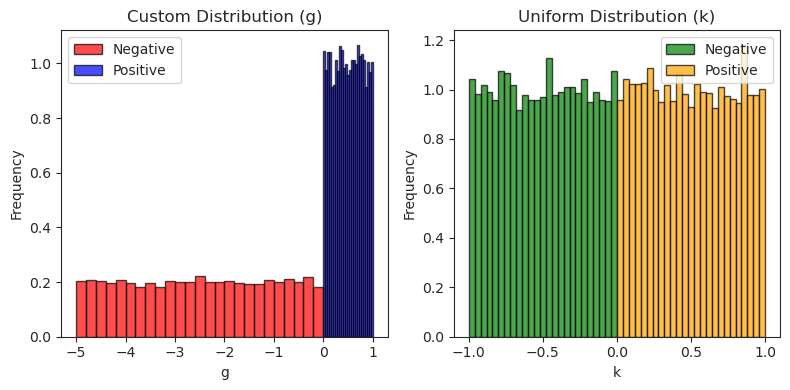

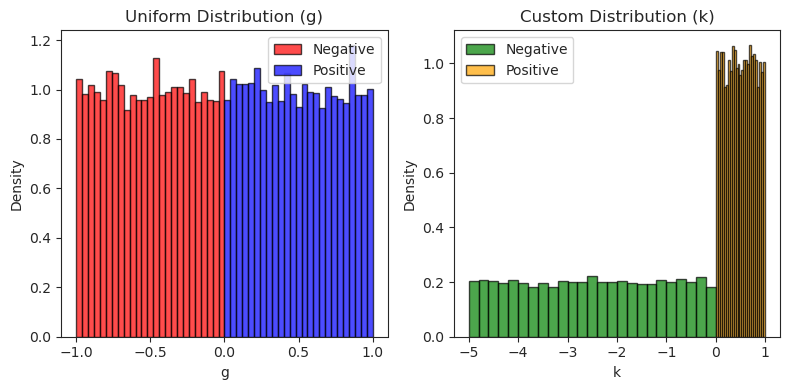

In [5]:
# Generate samples
num_samples = 20000
custom_samples = [custom_distribution(5, 1) for _ in range(num_samples)]
uniform_samples = np.random.uniform(-1, 1, num_samples)

# Create subplots
fig, axs = plt.subplots(1, 2, figsize=(8, 4))

# Custom distribution plot
custom_neg = [x for x in custom_samples if x < 0]
custom_pos = [x for x in custom_samples if x >= 0]

axs[0].hist(custom_neg, bins=25, color='red', edgecolor='black', alpha=0.7, label='Negative', density=True)
axs[0].hist(custom_pos, bins=25, color='blue', edgecolor='black', alpha=0.7, label='Positive', density=True)
axs[0].set_title('Custom Distribution (g)')
axs[0].set_xlabel('g')
axs[0].set_ylabel('Frequency')
axs[0].legend()

# Uniform distribution plot
uniform_neg = [x for x in uniform_samples if x < 0]
uniform_pos = [x for x in uniform_samples if x >= 0]

axs[1].hist(uniform_neg, bins=25, color='green', edgecolor='black', alpha=0.7, label='Negative', density=True)
axs[1].hist(uniform_pos, bins=25, color='orange', edgecolor='black', alpha=0.7, label='Positive', density=True)
axs[1].set_title('Uniform Distribution (k)')
axs[1].set_xlabel('k')
axs[1].set_ylabel('Frequency')
axs[1].legend()

# Show plots
plt.tight_layout()
plt.show()



# Create subplots
fig, axs = plt.subplots(1, 2, figsize=(8, 4))

# Uniform distribution plot (g)
uniform_neg = [x for x in uniform_samples if x < 0]
uniform_pos = [x for x in uniform_samples if x >= 0]

axs[0].hist(uniform_neg, bins=25, color='red', edgecolor='black', alpha=0.7, label='Negative', density=True)
axs[0].hist(uniform_pos, bins=25, color='blue', edgecolor='black', alpha=0.7, label='Positive', density=True)
axs[0].set_title('Uniform Distribution (g)')
axs[0].set_xlabel('g')
axs[0].set_ylabel('Density')
axs[0].legend()

# Custom distribution plot (k)
custom_neg = [x for x in custom_samples if x < 0]
custom_pos = [x for x in custom_samples if x >= 0]

axs[1].hist(custom_neg, bins=25, color='green', edgecolor='black', alpha=0.7, label='Negative', density=True)
axs[1].hist(custom_pos, bins=25, color='orange', edgecolor='black', alpha=0.7, label='Positive', density=True)
axs[1].set_title('Custom Distribution (k)')
axs[1].set_xlabel('k')
axs[1].set_ylabel('Density')
axs[1].legend()

# Show plots
plt.tight_layout()
plt.show()

In [29]:
def plot_states_from_cfg(system_config):
    for i in range(12):
        y_out_list=[]
        y0_species=one_hot_vector(12,i)
        y0_env=[0]
        t=np.linspace(0, 2000, 10000)

        y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=True)

        y_out_list.append(y_out)
    #print(np.sum(y_out['species']), np.sum(y_out['env']) )
    num_datasets = len(y_out_list)

    # Prepare subplots
    fig, axs = plt.subplots(2, 1, figsize=(8, 8))

    # Data for plots
    species_matrix = np.array([y_out['species'] for y_out in y_out_list])
    env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

    # Normalize species data
    species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
    species_sums = np.sum(species_matrix, axis=1, keepdims=True)
    normalized_species = species_matrix / species_sums

    # Bar width
    bar_width = 0.8 / num_datasets  # Adjust bar width based on the number of datasets

    # Plotting species composition
    for i in range(normalized_species.shape[1]):  # Loop through each species
        axs[0].bar(np.arange(num_datasets) + i * bar_width, normalized_species[:, i], bar_width, label=f'Species {i+1}')

    axs[0].set_title('Normalized Species Composition')
    axs[0].set_xlabel('Dataset Index')
    axs[0].set_ylabel('Proportion')
    axs[0].legend()

    # Plotting environmental factors
    axs[1].bar(np.arange(num_datasets), env_data, color='red', width=0.8)
    axs[1].set_title('Environmental Variable')
    axs[1].set_xlabel('Dataset Index')
    axs[1].set_ylabel('Environmental Value')

    plt.tight_layout()
    plt.show()

{'species': array([ 3.56771598e-01, -2.81085428e-64,  5.88391694e-30,  9.44635522e-01,
        1.30389039e+00, -3.80417298e-72,  4.30384915e-01, -8.11067703e-23,
        2.02231695e-22, -3.36888407e-51, -4.82520095e-48, -2.05631768e-45]), 'env': array([1.07576379])}
{'species': array([ 3.56771598e-01,  1.85972129e-74, -7.95529855e-40,  9.44635522e-01,
        1.30389039e+00,  7.26342211e-97,  4.30384915e-01,  3.64416273e-27,
       -3.07054168e-32,  3.49546606e-77, -3.48873851e-58, -4.76391719e-63]), 'env': array([1.07576379])}
{'species': array([ 3.56771598e-01,  1.03110418e-62, -4.35858830e-32,  9.44635522e-01,
        1.30389039e+00, -8.94999967e-78,  4.30384915e-01, -9.92609601e-25,
        8.65189866e-28, -1.44536918e-56, -7.69294088e-49, -1.02542015e-49]), 'env': array([1.07576379])}
{'species': array([ 3.56771598e-01,  8.33138365e-66,  6.02147359e-35,  9.44635522e-01,
        1.30389039e+00, -2.53706444e-86,  4.30384915e-01,  8.83989981e-24,
       -5.73811158e-25, -9.09102436e-

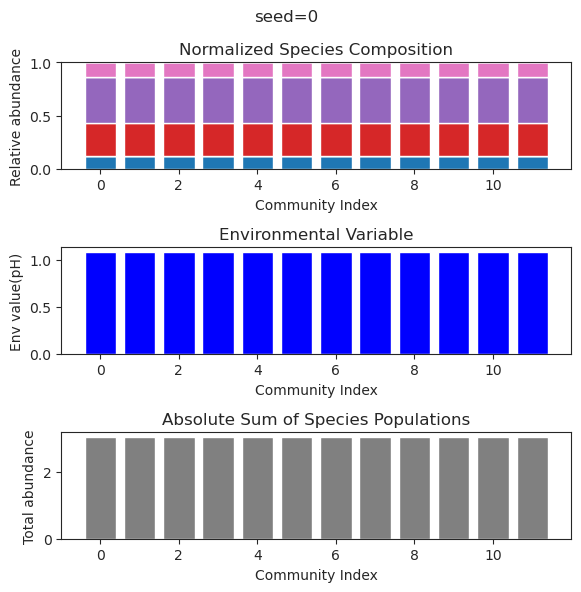

{'species': array([ 1.27142518e-58,  2.31896643e-01, -8.43916819e-36,  2.41508884e-01,
       -3.48011338e-26, -1.15900331e-23, -5.61031830e-55, -2.27123008e-32,
        8.81023433e-01,  2.10101799e-42,  9.49192250e-01,  2.91745396e-51]), 'env': array([0.46856582])}
{'species': array([-1.30996987e-68,  2.31896643e-01,  2.57977627e-42,  2.41508884e-01,
        2.78325816e-26, -1.57286160e-24, -8.59477696e-62,  4.29015170e-36,
        8.81023433e-01,  2.31608687e-42,  9.49192250e-01, -2.66251377e-59]), 'env': array([0.46856582])}
{'species': array([-2.41219069e-47,  2.31896643e-01,  3.90412574e-39,  2.41508884e-01,
       -4.78052424e-23, -5.82736876e-26,  2.18245500e-45, -7.50000892e-30,
        8.81023433e-01, -4.65445282e-34,  9.49192250e-01,  6.47656130e-43]), 'env': array([0.46856582])}
{'species': array([ 4.50616135e-69,  2.31896643e-01, -4.62095060e-42,  2.41508884e-01,
       -1.90358032e-27, -5.78252007e-28, -6.19283754e-56,  1.99134579e-38,
        8.81023433e-01,  1.88329972e-

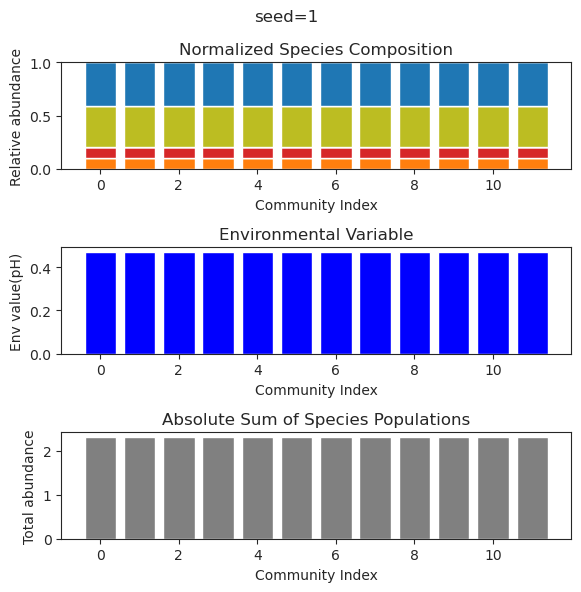

{'species': array([-1.24571806e-34,  8.62860578e-01,  1.75086310e-01,  2.19100660e-21,
        2.70440600e-34,  2.50883722e-44, -4.56061062e-37,  4.15109422e-01,
        2.92979912e-22,  1.02844924e-33,  1.66753331e-01,  8.01445601e-01]), 'env': array([0.38868498])}
{'species': array([ 5.82923723e-40,  8.62860578e-01,  1.75086310e-01,  2.16311346e-27,
       -1.07385546e-38, -1.65951531e-47, -1.33400587e-42,  4.15109422e-01,
       -7.35922079e-28, -2.56877389e-37,  1.66753331e-01,  8.01445601e-01]), 'env': array([0.38868498])}
{'species': array([-1.79227627e-61,  8.62860578e-01,  1.75086310e-01, -4.29950645e-30,
        9.13813304e-50, -2.19629082e-65,  1.63993395e-65,  4.15109422e-01,
       -6.21118751e-30,  2.21656507e-54,  1.66753331e-01,  8.01445601e-01]), 'env': array([0.38868498])}
{'species': array([ 4.16056853e-61,  8.62860578e-01,  1.75086310e-01, -5.46989554e-26,
       -4.99107689e-40, -4.19303884e-66, -1.27585298e-66,  4.15109422e-01,
       -7.07292777e-29, -7.03987592e-

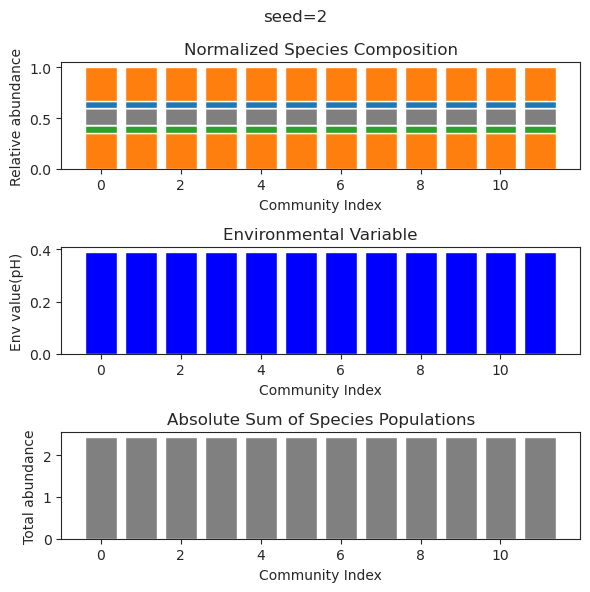

{'species': array([ 3.64994021e-01, -1.98848185e-25,  1.67395494e+00,  4.96137246e-01,
        9.09788868e-39,  5.26603781e-30,  2.72001663e-60, -6.26137492e-48,
       -5.71116554e-36,  3.27501727e-37, -1.17100860e-33,  6.37954918e-01]), 'env': array([1.07922716])}
{'species': array([ 3.64994021e-01, -2.39610653e-32,  1.67395494e+00,  4.96137246e-01,
        5.99283334e-43, -1.47088644e-35, -1.09001511e-62, -4.01380699e-53,
        1.65990048e-57, -1.41798864e-38,  4.89041737e-39,  6.37954918e-01]), 'env': array([1.07922716])}
{'species': array([ 3.64994021e-01,  3.59069506e-23,  1.67395494e+00,  4.96137246e-01,
       -3.35880691e-32, -2.54665237e-27,  1.07583337e-52, -1.53695290e-43,
       -5.53211553e-41, -9.72550249e-27, -1.41592930e-32,  6.37954918e-01]), 'env': array([1.07922716])}
{'species': array([ 3.64994021e-01,  5.93302882e-25,  1.67395494e+00,  4.96137246e-01,
       -1.25367173e-32,  7.84635932e-28,  7.08499937e-52,  1.20475068e-42,
       -8.56878312e-48,  2.14418214e-

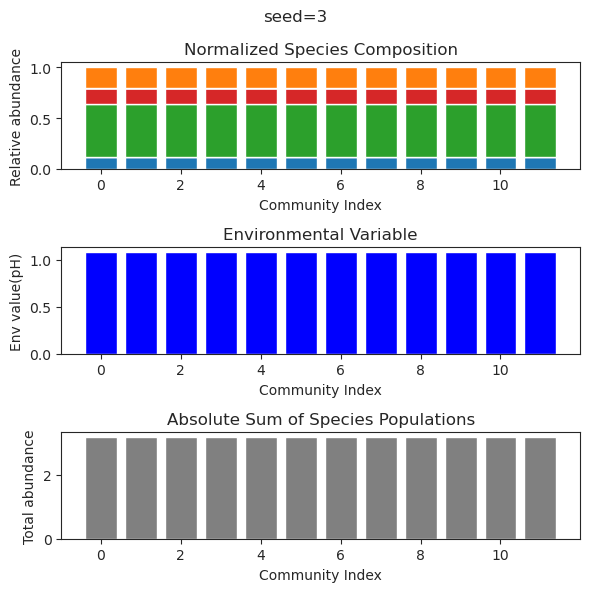

{'species': array([ 8.66437252e-01, -2.35304030e-38, -1.83302880e-48,  3.48551372e-43,
        8.60242025e-01,  1.88771977e-19,  5.11279165e-21,  6.36469892e-01,
        2.96606632e-01,  1.30264302e-41,  6.23694802e-24,  2.10688138e-52]), 'env': array([0.79284751])}
{'species': array([ 8.66437252e-01, -1.67670680e-39, -2.25984806e-53,  1.82444469e-52,
        8.60242025e-01,  1.54153255e-17,  1.43823357e-24,  6.36469892e-01,
        2.96606632e-01, -2.04953396e-42, -3.46660518e-26,  5.70237743e-61]), 'env': array([0.79284751])}
{'species': array([ 8.66437252e-01, -4.65798026e-53,  2.40622077e-78,  5.12960772e-67,
        8.60242025e-01, -5.07496449e-18,  5.54337673e-28,  6.36469892e-01,
        2.96606632e-01,  4.25091861e-57,  2.30443973e-35,  1.17345734e-85]), 'env': array([0.79284751])}
{'species': array([ 8.66437252e-01, -2.37381271e-52, -6.18049157e-76, -8.72533653e-64,
        8.60242025e-01, -3.52631263e-16,  3.91870048e-24,  6.36469892e-01,
        2.96606632e-01,  4.43294100e-

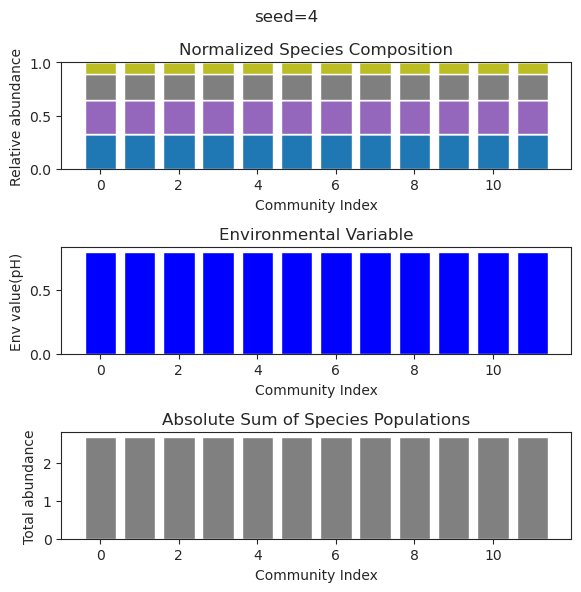

{'species': array([ 1.24415130e-070,  1.95174026e-030,  2.77710563e-060,
        4.29199274e-014,  6.13288889e-001,  1.42221106e-104,
       -1.56903185e-039,  7.69454977e-001, -4.30659577e-089,
       -2.35325947e-023, -8.99090817e-097,  9.04658391e-001]), 'env': array([0.40395112])}
{'species': array([-7.95125868e-39, -7.58420176e-31, -1.80642531e-46,  2.38192945e-14,
        6.13288889e-01,  7.91196713e-45,  5.74510833e-40,  7.69454977e-01,
        7.50791812e-68, -1.63124222e-22, -6.34656591e-49,  9.04658391e-01]), 'env': array([0.40395112])}
{'species': array([-9.07082939e-51,  2.84349996e-34, -2.22391597e-43,  3.67022432e-15,
        6.13288889e-01,  1.07300169e-39,  4.24672871e-43,  7.69454977e-01,
        3.11792663e-45,  8.95804977e-28, -2.90822609e-66,  9.04658391e-01]), 'env': array([0.40395112])}
{'species': array([ 6.81179375e-34, -6.13126199e-34,  4.24916839e-42,  1.98062111e-15,
        6.13288889e-01, -5.92594788e-39, -3.76613815e-40,  7.69454977e-01,
       -3.07499806

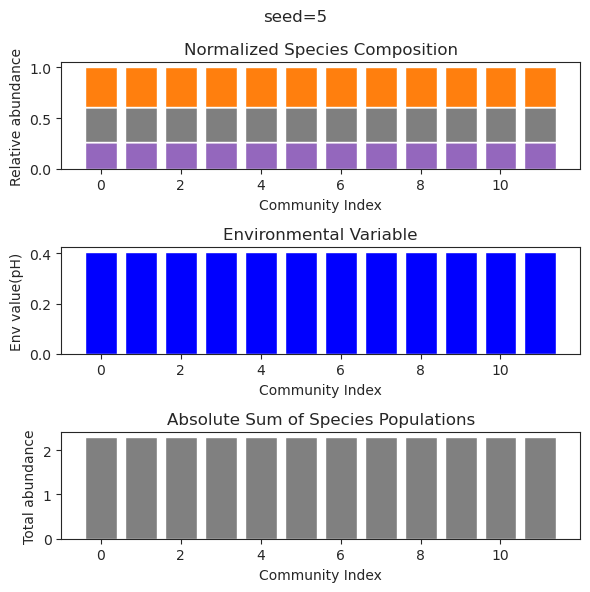

{'species': array([ 4.25341876e-01,  4.18741565e-74,  1.59217138e-69,  3.49466251e-30,
       -1.65536449e-87, -1.48559917e-42,  5.06484489e-01, -2.32079085e-17,
        3.36473964e-01,  2.09058312e-25,  5.31617914e-01,  2.17802186e-01]), 'env': array([0.21381583])}
{'species': array([ 4.25341876e-01, -1.84808100e-68,  2.11946070e-64,  2.06604078e-29,
       -3.24557855e-81, -4.40411008e-41,  5.06484489e-01, -6.25251419e-17,
        3.36473964e-01, -1.12331674e-25,  5.31617914e-01,  2.17802186e-01]), 'env': array([0.21381583])}
{'species': array([ 4.25341876e-01,  2.82612953e-47, -2.28559737e-44,  3.14130364e-22,
       -6.48388441e-50, -3.24902205e-26,  5.06484489e-01,  2.40301966e-17,
        3.36473964e-01,  4.27141634e-20,  5.31617914e-01,  2.17802186e-01]), 'env': array([0.21381583])}
{'species': array([ 4.25341876e-01,  8.89289120e-53,  1.48558920e-52, -1.70837563e-20,
        5.35718990e-59,  3.85627591e-31,  5.06484489e-01, -2.15284008e-17,
        3.36473964e-01, -8.80882382e-

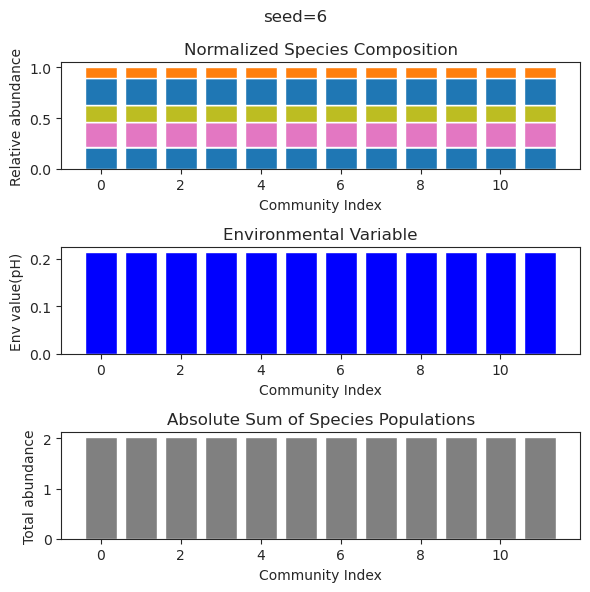

{'species': array([ 1.47080552e-014,  1.30066791e-030, -1.09569394e-069,
        2.52543270e-001,  6.91991925e-001,  2.50712368e-001,
       -2.01252733e-058, -3.39352811e-022,  3.91800788e-001,
        4.31196078e-001,  4.13576309e-080,  2.77124829e-100]), 'env': array([0.3149686])}
{'species': array([ 5.09946342e-15,  7.52927523e-30, -5.10222976e-46,  2.52543270e-01,
        6.91991925e-01,  2.50712368e-01, -6.30508305e-54, -1.41724960e-26,
        3.91800788e-01,  4.31196078e-01,  1.30437079e-52, -2.26240949e-65]), 'env': array([0.3149686])}
{'species': array([ 9.94175893e-16,  2.15039116e-27,  5.25713045e-48,  2.52543270e-01,
        6.91991925e-01,  2.50712368e-01,  1.71785657e-46,  6.42912623e-24,
        3.91800788e-01,  4.31196078e-01, -1.22028414e-52, -7.22662860e-63]), 'env': array([0.3149686])}
{'species': array([ 1.45933468e-13,  1.11183846e-26,  6.63519768e-48,  2.52543270e-01,
        6.91991925e-01,  2.50712368e-01,  1.23833007e-42, -6.77788479e-22,
        3.91800788e-0

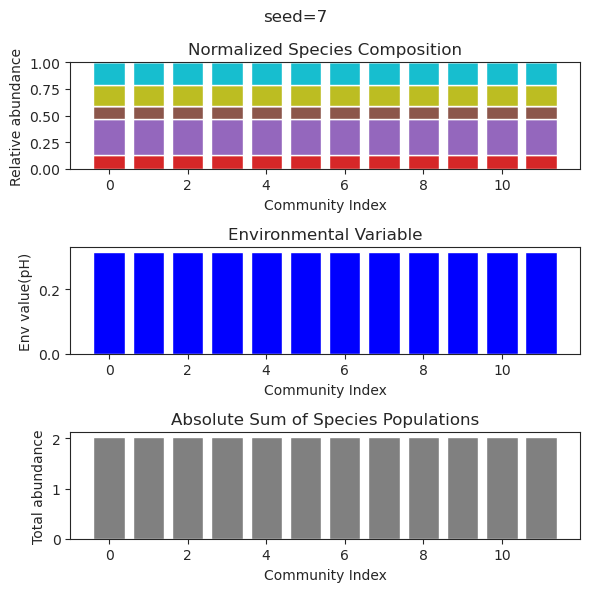

{'species': array([ 1.30449300e-28,  7.30008794e-01, -1.75265159e-82,  2.80055375e-01,
       -7.68757716e-29, -8.51932475e-30, -4.76812821e-18,  5.67684531e-01,
       -3.79508629e-22,  2.45108547e-73,  2.62083991e-01,  6.25474273e-01]), 'env': array([0.6397037])}
{'species': array([-1.30405497e-25,  7.30008794e-01,  5.13248189e-75,  2.80055375e-01,
       -2.61442070e-23, -4.79947848e-26,  8.10011985e-16,  5.67684531e-01,
       -7.18274076e-21, -9.95109082e-68,  2.62083991e-01,  6.25474273e-01]), 'env': array([0.6397037])}
{'species': array([ 5.40368479e-24,  7.30008794e-01,  2.60971000e-79,  2.80055375e-01,
       -1.13022069e-25,  4.61124187e-29,  1.34550249e-16,  5.67684531e-01,
        1.20027244e-19, -2.35801131e-67,  2.62083991e-01,  6.25474273e-01]), 'env': array([0.6397037])}
{'species': array([ 3.23086399e-25,  7.30008794e-01,  1.16388378e-78,  2.80055375e-01,
        1.13306085e-27, -2.42383277e-28,  6.43132004e-17,  5.67684531e-01,
        1.37625818e-20, -1.86733198e-67,

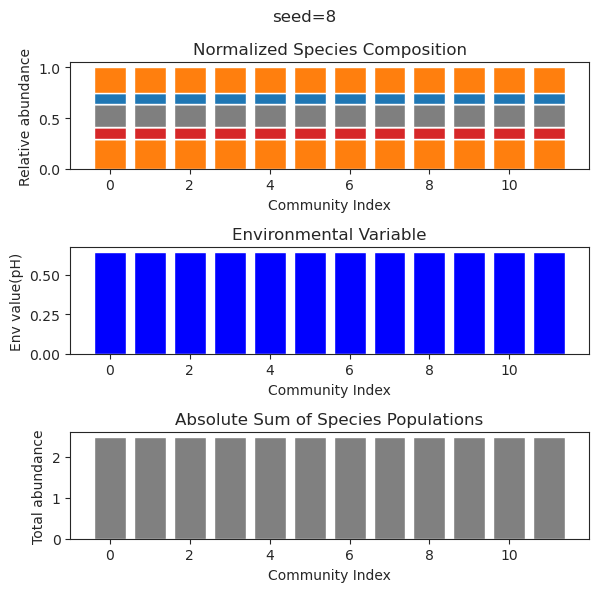

{'species': array([ 9.41992900e-01,  1.19198707e-43, -1.26373843e-72, -1.51315748e-72,
        5.37289206e-78,  5.07805972e-01, -1.35638486e-16,  1.16673341e+00,
       -1.80184332e-27,  1.09066554e-72,  1.78543660e-01, -2.75043287e-71]), 'env': array([0.80283753])}
{'species': array([ 9.41992900e-01, -2.61299213e-74, -8.26931941e-79,  6.02052937e-69,
        6.07657622e-74,  5.07805972e-01,  3.66764857e-19,  1.16673341e+00,
       -6.73642618e-28,  6.62691250e-66,  1.78543660e-01,  5.33536402e-74]), 'env': array([0.80283753])}
{'species': array([ 9.41992900e-01, -8.16199993e-38, -2.30818955e-37,  2.93850842e-41,
       -1.86561057e-34,  5.07805972e-01,  2.21169551e-18,  1.16673341e+00,
        2.63284338e-25,  2.91394925e-65,  1.78543660e-01, -2.93711599e-67]), 'env': array([0.80283753])}
{'species': array([ 9.41992900e-01,  4.85910946e-63,  7.93406459e-62,  5.26105566e-62,
       -1.28500144e-56,  5.07805972e-01,  1.12797250e-16,  1.16673341e+00,
        2.27849491e-38, -1.53613623e-

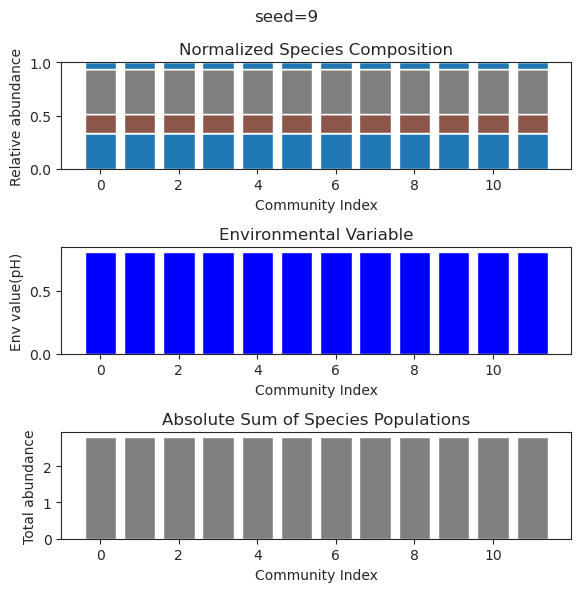

{'species': array([ 2.01671372e-002,  2.60313366e-103,  3.94914836e-087,
        6.95948072e-109,  6.34767576e-107, -3.84316118e-052,
        1.70112068e-001,  7.92054838e-001,  3.58469515e-001,
        1.20050295e-001,  6.36540436e-001, -6.15223167e-082]), 'env': array([0.27781153])}
{'species': array([ 2.01671372e-02, -1.35533623e-50,  3.09974729e-49,  2.33900996e-52,
        1.83714054e-51,  4.35120726e-36,  1.70112068e-01,  7.92054838e-01,
        3.58469515e-01,  1.20050295e-01,  6.36540436e-01,  2.50355693e-45]), 'env': array([0.27781153])}
{'species': array([ 2.01671372e-02,  7.45480367e-95,  9.58471557e-81, -3.62546968e-98,
        1.76933382e-97, -3.98911012e-45,  1.70112068e-01,  7.92054838e-01,
        3.58469515e-01,  1.20050295e-01,  6.36540436e-01, -5.08697446e-72]), 'env': array([0.27781153])}
{'species': array([ 2.01671372e-02, -7.90847959e-54, -5.88392067e-52, -3.16127783e-52,
       -1.30949455e-35, -7.70188955e-38,  1.70112068e-01,  7.92054838e-01,
        3.58469515

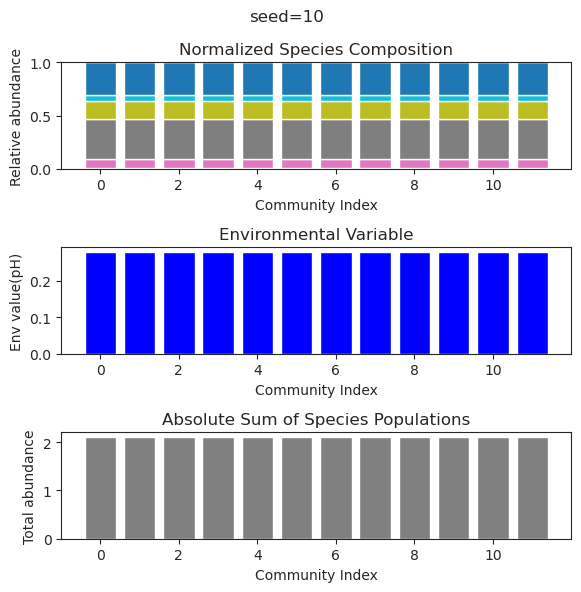

{'species': array([-4.70373780e-57,  2.34721790e-52,  2.26358947e-26,  9.15700951e-01,
        3.07135909e-01,  2.56642046e-17,  1.51485662e-01, -4.70464609e-43,
        2.87067964e-01,  3.00780751e-01, -1.73300895e-75, -1.16327676e-40]), 'env': array([0.21541235])}
{'species': array([ 4.45948965e-60, -1.28812241e-57,  2.21045071e-29,  9.15700951e-01,
        3.07135909e-01,  2.29385005e-19,  1.51485662e-01,  1.28741717e-38,
        2.87067964e-01,  3.00780751e-01, -4.09846266e-71,  2.86306479e-44]), 'env': array([0.21541235])}
{'species': array([ 2.30129706e-45,  1.81582332e-45, -8.14791159e-31,  9.15700951e-01,
        3.07135909e-01,  3.18316167e-18,  1.51485662e-01, -1.84435425e-32,
        2.87067964e-01,  3.00780751e-01, -2.67758368e-59, -1.83429899e-38]), 'env': array([0.21541235])}
{'species': array([-7.53704305e-63,  1.04432612e-60,  7.75625312e-32,  9.15700951e-01,
        3.07135909e-01, -1.68444284e-17,  1.51485662e-01, -1.14180772e-35,
        2.87067964e-01,  3.00780751e-

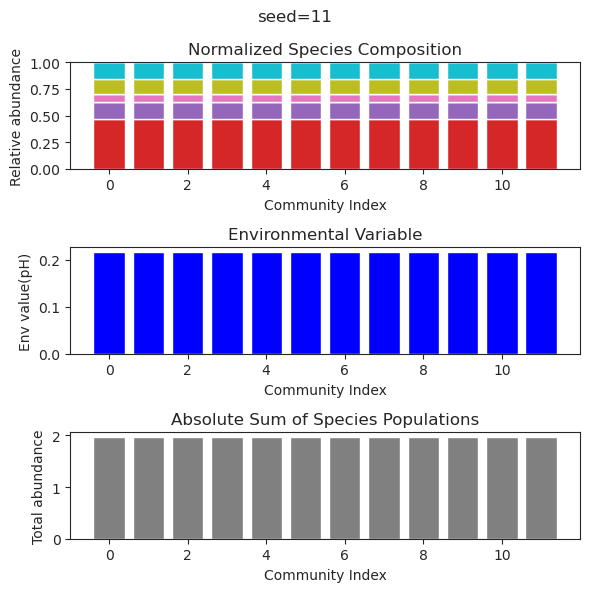

{'species': array([ 6.30689098e-01,  3.11803341e-36,  4.56152592e-01, -6.78313439e-50,
        9.72751418e-01, -1.28295672e-34, -2.56754792e-46,  6.87911262e-38,
       -3.14236080e-22, -7.19868150e-19,  7.49957680e-01, -1.45119769e-19]), 'env': array([0.64959971])}
{'species': array([ 6.30689098e-01, -4.92192950e-46,  4.56152592e-01,  1.38794011e-59,
        9.72751418e-01, -6.40570564e-47,  4.67843459e-56, -4.87629550e-49,
       -2.38062060e-29,  2.54038712e-23,  7.49957680e-01,  2.12098630e-23]), 'env': array([0.64959971])}
{'species': array([ 6.30689098e-01, -1.12466015e-43,  4.56152592e-01,  1.55360694e-58,
        9.72751418e-01, -1.92865901e-38,  1.06467603e-53,  1.17577370e-40,
       -1.12523821e-22,  2.09803356e-17,  7.49957680e-01,  2.31448409e-16]), 'env': array([0.64959971])}
{'species': array([ 6.30689098e-01, -4.43294094e-41,  4.56152592e-01, -2.45015304e-52,
        9.72751418e-01,  2.08296033e-38, -9.74623739e-53, -3.52365123e-39,
       -9.38705822e-26, -1.16361185e-

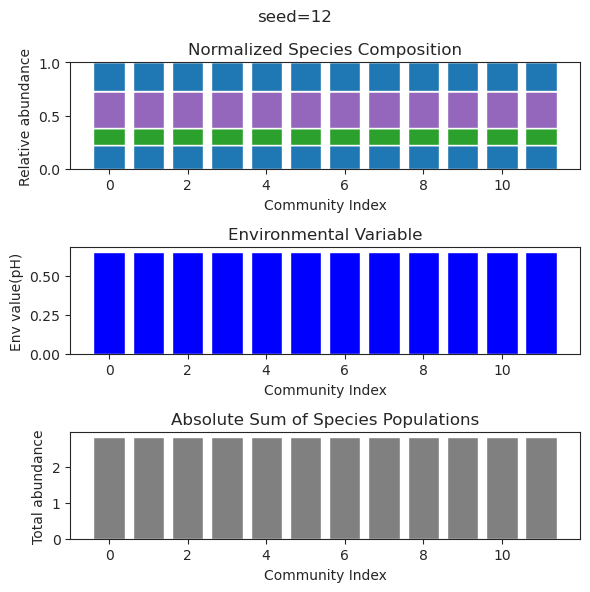

{'species': array([ 2.21916975e-022,  2.18267719e-035,  1.50930453e-001,
       -1.90717106e-100,  1.08797728e+000,  2.34089268e-001,
        1.09982171e+000, -8.21610460e-111, -1.29074131e-059,
        2.74063083e-047, -7.59714079e-035,  1.80784311e-081]), 'env': array([0.58429349])}
{'species': array([-3.14083396e-28,  5.80325112e-87,  1.50930453e-01, -2.85308937e-86,
        1.08797728e+00,  2.34089268e-01,  1.09982171e+00,  2.99305731e-75,
        9.11655062e-47, -3.27988380e-37,  2.38895629e-49,  3.33376874e-75]), 'env': array([0.58429349])}
{'species': array([ 7.81855139e-027, -1.87957961e-102,  1.50930453e-001,
       -4.32687402e-105,  1.08797728e+000,  2.34089268e-001,
        1.09982171e+000,  3.72223228e-106,  2.65411277e-064,
       -2.52558232e-031,  4.60397499e-049, -5.80765085e-081]), 'env': array([0.58429349])}
{'species': array([-2.74944236e-026, -6.68910224e-131,  1.50930453e-001,
        1.47644784e-121,  1.08797728e+000,  2.34089268e-001,
        1.09982171e+000, -4

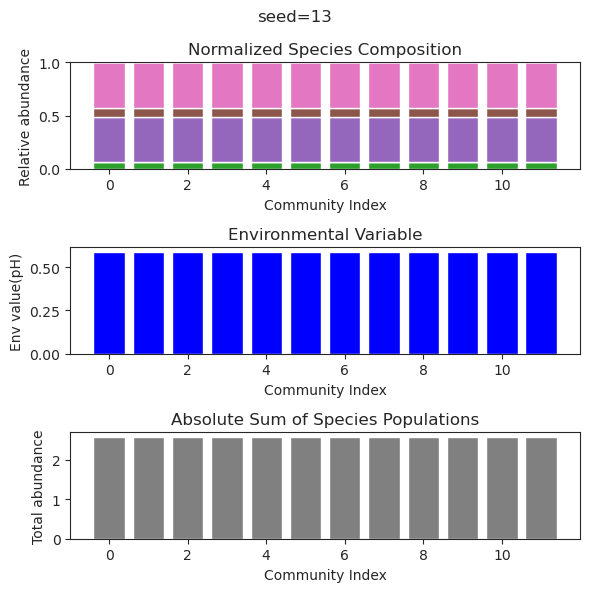

{'species': array([ 6.12394530e-001,  7.12472855e-052, -1.04479402e-014,
       -7.09871183e-029, -1.28752797e-024,  2.83836593e-043,
        5.46427315e-001, -4.66980618e-088,  7.08313048e-001,
        6.54569409e-001,  2.49478163e-116, -1.79625662e-059]), 'env': array([0.46816373])}
{'species': array([ 6.12394530e-01, -5.13538611e-48,  1.90010859e-18, -3.42044456e-31,
        1.23746040e-25,  3.60306317e-39,  5.46427315e-01,  7.41710657e-60,
        7.08313048e-01,  6.54569409e-01,  1.76715722e-78, -4.87431142e-52]), 'env': array([0.46816373])}
{'species': array([ 1.13589195e+000,  0.00000000e+000,  1.32432890e-001,
        6.18686147e-001,  0.00000000e+000,  3.57070277e-003,
        2.42632028e-003,  5.33213246e-002,  1.19696700e-237,
        1.28623623e-005, -2.00243631e-274, -6.81827747e-252]), 'env': array([0.31204026])}
{'species': array([ 6.12394530e-01, -6.41465889e-39,  1.68402989e-15, -4.07586842e-30,
        1.22716274e-23,  1.00109063e-36,  5.46427315e-01,  1.13843465e-53,

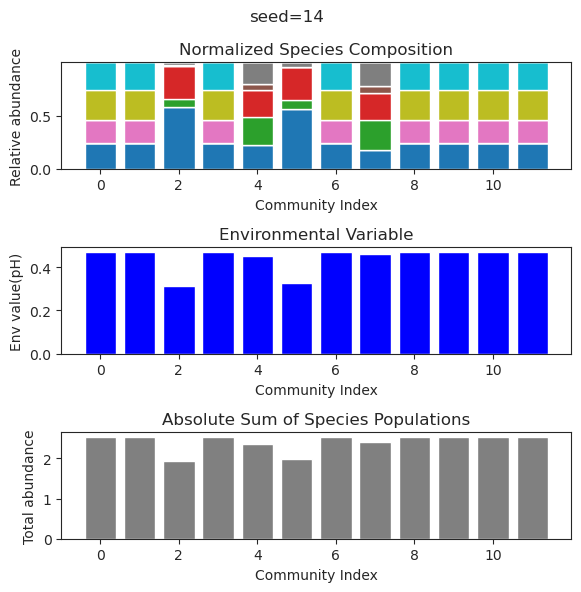

{'species': array([-1.17506487e-43, -1.32176683e-46,  4.82103886e-01,  6.33598144e-01,
       -6.06791508e-22,  8.88356903e-02, -4.89891278e-52, -3.29302952e-29,
        6.57135597e-34,  3.76951389e-01,  6.05662994e-37,  8.43052690e-01]), 'env': array([0.51984282])}
{'species': array([-4.13615621e-51, -3.87802680e-49,  4.82103886e-01,  6.33598144e-01,
        3.09549894e-22,  8.88356903e-02, -2.05978090e-56, -4.23212953e-21,
        2.94135461e-31,  3.76951389e-01,  4.50875925e-35,  8.43052690e-01]), 'env': array([0.51984282])}
{'species': array([ 1.42600099e-74,  1.28472886e-84,  4.82103886e-01,  6.33598144e-01,
       -1.56710297e-24,  8.88356903e-02,  2.59644790e-83, -1.56594083e-28,
       -7.39823600e-45,  3.76951389e-01,  1.95867183e-52,  8.43052690e-01]), 'env': array([0.51984282])}
{'species': array([-1.21784644e-49, -4.56600602e-52,  4.82103886e-01,  6.33598144e-01,
        4.31081648e-22,  8.88356903e-02, -2.23275935e-63, -2.19524056e-22,
       -1.21690853e-29,  3.76951389e-

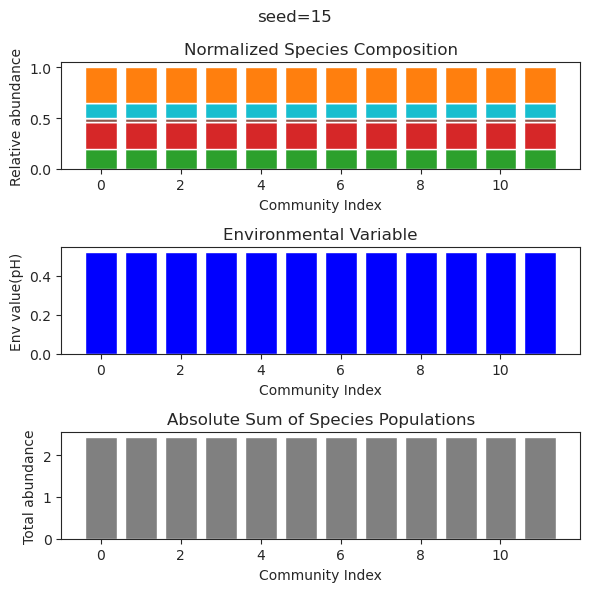

{'species': array([ 4.76549677e-60,  2.74232338e-01,  4.12409423e-01,  3.34653454e-26,
        8.72791383e-01,  1.90661372e-01, -9.72333165e-81,  3.49549946e-78,
        3.31793050e-01, -1.77220051e-17,  2.43393529e-69,  8.46245894e-33]), 'env': array([0.46167948])}
{'species': array([-5.28119513e-47,  2.74232338e-01,  4.12409423e-01,  9.24123306e-29,
        8.72791383e-01,  1.90661372e-01,  4.20331842e-65, -1.12653437e-58,
        3.31793050e-01,  7.78721538e-19, -1.21927315e-48,  9.99128158e-29]), 'env': array([0.46167948])}
{'species': array([-3.85616592e-61,  2.74232338e-01,  4.12409423e-01, -2.11016545e-22,
        8.72791383e-01,  1.90661372e-01,  2.57755456e-79,  1.54718374e-75,
        3.31793050e-01, -4.46095616e-18,  6.28210288e-68, -1.01015621e-30]), 'env': array([0.46167948])}
{'species': array([ 4.65249177e-63,  2.74232338e-01,  4.12409423e-01,  4.48945692e-27,
        8.72791383e-01,  1.90661372e-01, -2.80575198e-80, -2.75640088e-81,
        3.31793050e-01,  1.46418652e-

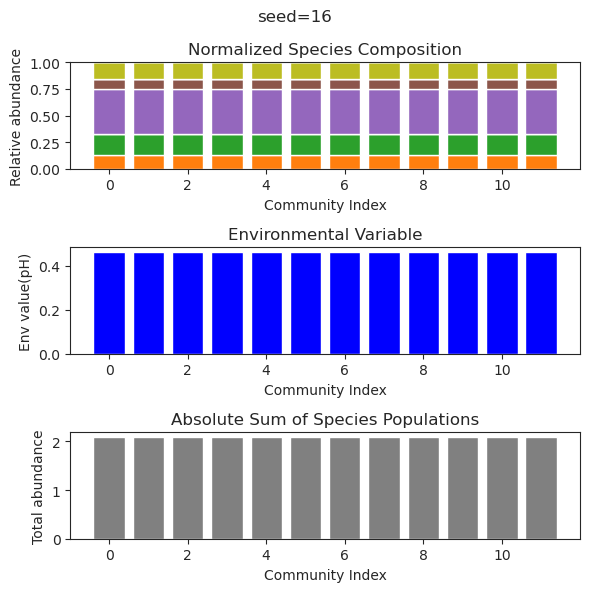

{'species': array([ 5.18157312e-33,  1.58793740e+00,  1.48160047e+00,  6.75287797e-46,
       -5.64403013e-59,  2.63052494e-26, -9.42918482e-25, -5.06688940e-21,
       -4.02986172e-21,  1.58810556e-39, -1.86081873e-51, -1.94902074e-29]), 'env': array([0.75888138])}
{'species': array([ 2.38610547e-42,  1.58793740e+00,  1.48160047e+00,  2.58806138e-65,
       -1.05324781e-85,  2.01381404e-23,  1.40434797e-23,  1.97801269e-22,
        5.66835618e-23, -7.25448019e-50, -9.97514396e-67,  1.72116540e-36]), 'env': array([0.75888138])}
{'species': array([-3.42216674e-42,  1.58793740e+00,  1.48160047e+00, -3.14334912e-52,
       -7.14814135e-69,  2.63865193e-34, -6.05978941e-33,  1.68850952e-33,
        3.16737364e-33, -7.55135765e-48,  7.88302912e-58,  3.46731929e-39]), 'env': array([0.75888138])}
{'species': array([-3.38483112e-41,  1.58793740e+00,  1.48160047e+00, -2.60834082e-56,
        2.67182308e-73, -1.89996934e-30, -6.60171450e-31,  4.67590177e-31,
        2.36686388e-32, -2.53340132e-

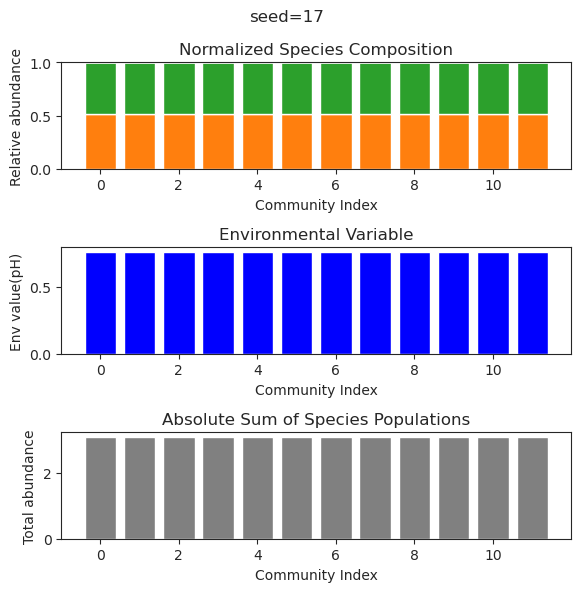

{'species': array([ 4.77872438e-027, -6.46338779e-104, -1.29263775e-053,
       -5.49221007e-074,  3.36718457e-001,  1.60525652e+000,
        5.35575551e-002,  1.69855092e+000, -6.67682700e-106,
        1.60315375e-048, -6.04925125e-067,  2.37170001e-001]), 'env': array([1.26935784])}
{'species': array([-8.81900026e-24, -3.84003852e-76, -3.25584595e-46,  3.02023103e-50,
        3.36718457e-01,  1.60525652e+00,  5.35575551e-02,  1.69855092e+00,
       -1.54967023e-78, -2.83820482e-41,  7.83766528e-53,  2.37170001e-01]), 'env': array([1.26935784])}
{'species': array([ 2.36973875e-25,  1.77936462e-38,  7.09197334e-47, -1.91010477e-49,
        3.36718457e-01,  1.60525652e+00,  5.35575551e-02,  1.69855092e+00,
        1.24191775e-99, -4.63362638e-50, -3.18319788e-56,  2.37170001e-01]), 'env': array([1.26935784])}
{'species': array([ 3.19048282e-24,  8.73209340e-96,  5.05084630e-45,  2.84601273e-73,
        3.36718457e-01,  1.60525652e+00,  5.35575551e-02,  1.69855092e+00,
       -1.53078639

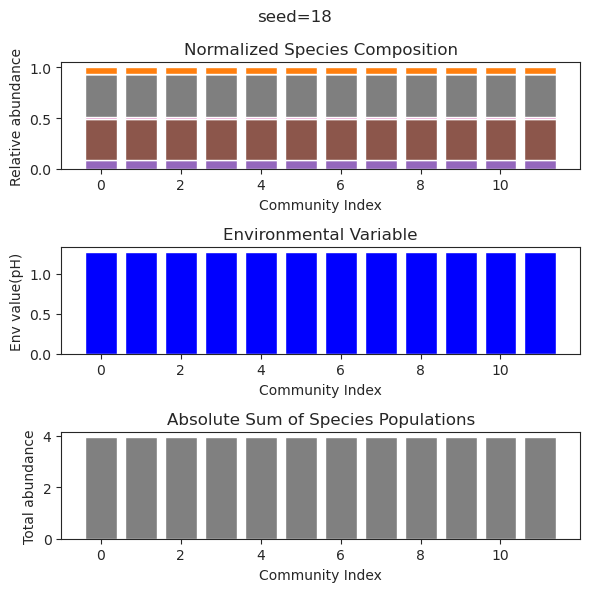

{'species': array([-5.47435774e-116, -3.02624903e-114,  2.19298976e-001,
        1.03315567e-001,  4.15442457e-001,  1.45382075e-081,
        2.68379628e-124,  6.04473986e-001,  2.43343118e-125,
       -1.99917196e-150,  4.62418512e-001,  1.48804753e-001]), 'env': array([0.26957669])}
{'species': array([ 3.59360707e-108,  6.77571048e-108,  2.19298976e-001,
        1.03315567e-001,  4.15442457e-001, -1.41182309e-076,
        8.41124076e-114,  6.04473986e-001,  1.81613483e-116,
        1.00157075e-137,  4.62418512e-001,  1.48804753e-001]), 'env': array([0.26957669])}
{'species': array([ 6.65609673e-108,  8.70948869e-108,  2.19298976e-001,
        1.03315567e-001,  4.15442457e-001,  4.88943789e-068,
        7.75291015e-122,  6.04473986e-001,  7.99803529e-121,
       -3.87217501e-148,  4.62418512e-001,  1.48804753e-001]), 'env': array([0.26957669])}
{'species': array([-3.29994926e-65, -6.40734999e-87,  2.19298976e-01,  1.03315567e-01,
        4.15442457e-01, -3.44240094e-55, -5.25506316e-7

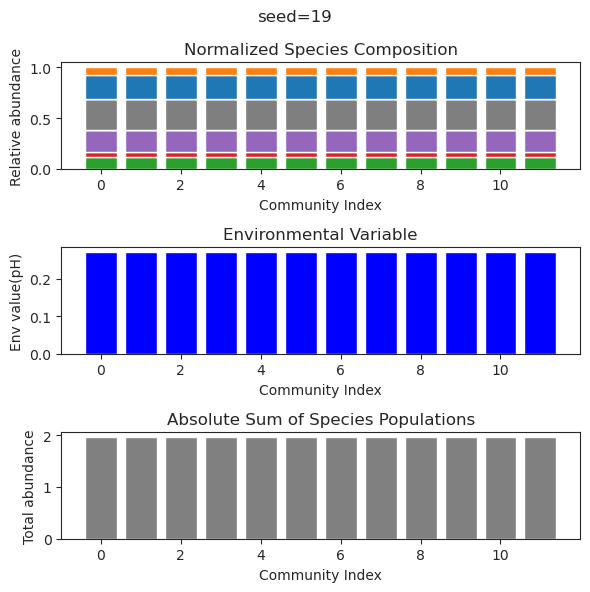

{'species': array([ 7.56344873e-39,  3.77291809e-65, -6.00468252e-28,  1.14147338e+00,
        6.54401535e-29,  6.68482784e-01,  4.25846071e-01, -9.83482260e-62,
        5.68567526e-01, -3.38384698e-57, -4.85265328e-25,  1.26449996e-51]), 'env': array([0.88988598])}
{'species': array([-3.64705670e-055, -4.04811278e-103, -4.26158392e-023,
        1.14147338e+000,  2.37226223e-027,  6.68482784e-001,
        4.25846071e-001, -1.87775635e-096,  5.68567526e-001,
        7.22458282e-105, -1.15532123e-021, -7.65563486e-090]), 'env': array([0.88988598])}
{'species': array([ 2.13451851e-42,  1.80433844e-59,  2.10609236e-23,  1.14147338e+00,
       -1.20385429e-29,  6.68482784e-01,  4.25846071e-01, -1.71359186e-61,
        5.68567526e-01,  2.28116231e-61, -6.46150048e-23, -4.43667985e-55]), 'env': array([0.88988598])}
{'species': array([ 4.17040257e-052,  9.51816271e-099,  6.66279226e-024,
        1.14147338e+000,  3.21970388e-027,  6.68482784e-001,
        4.25846071e-001,  1.41423954e-096,  5.

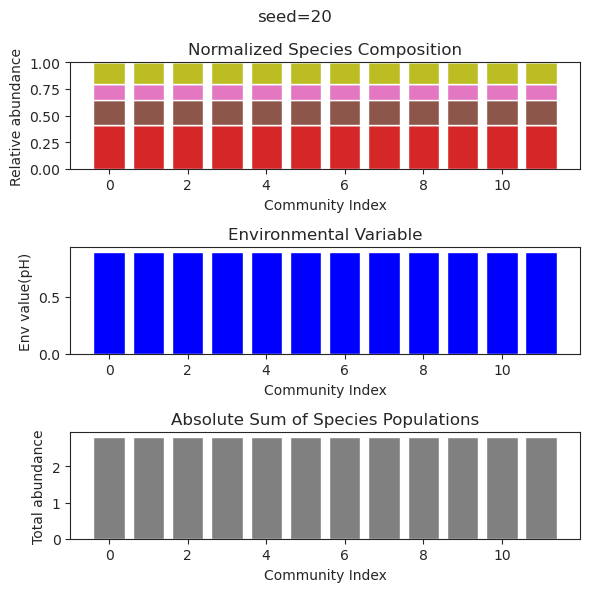

{'species': array([ 5.26873180e-001,  9.02108585e-105,  2.35789904e-001,
       -3.48907312e-069,  4.47339115e-001, -6.17417460e-054,
        4.26862474e-002,  3.12842842e-001,  1.16138472e-001,
        1.23678601e-001, -2.30687318e-024,  1.36023778e-036]), 'env': array([0.34811818])}
{'species': array([ 5.26873180e-01,  4.46847538e-95,  2.35789904e-01,  2.41686219e-64,
        4.47339115e-01, -5.06512908e-53,  4.26862474e-02,  3.12842842e-01,
        1.16138472e-01,  1.23678601e-01,  6.46485435e-24, -6.79505589e-33]), 'env': array([0.34811818])}
{'species': array([ 5.26873180e-01, -1.99836743e-97,  2.35789904e-01,  6.54850469e-66,
        4.47339115e-01,  7.06412816e-52,  4.26862474e-02,  3.12842842e-01,
        1.16138472e-01,  1.23678601e-01, -1.33948774e-23,  1.16576214e-32]), 'env': array([0.34811818])}
{'species': array([ 5.26873180e-01, -9.94892589e-97,  2.35789904e-01, -5.53639515e-64,
        4.47339115e-01, -2.30833071e-52,  4.26862474e-02,  3.12842842e-01,
        1.16138472

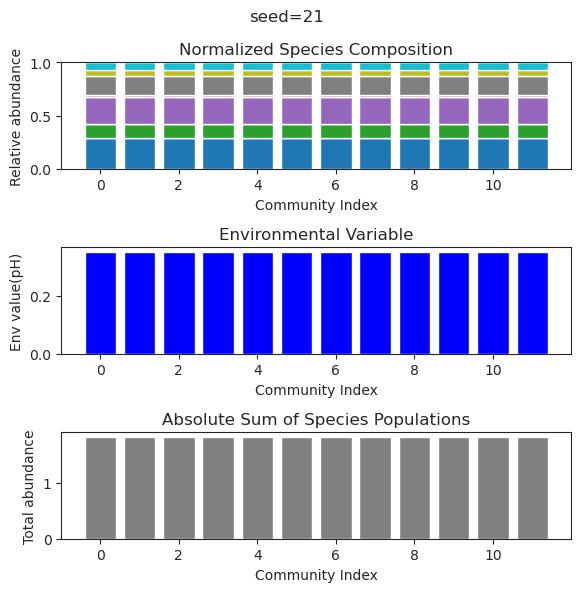

{'species': array([ 2.98039131e-01,  7.20079546e-33, -6.50642904e-33, -2.54079910e-34,
        9.66753695e-01,  2.41718546e-03,  2.00173078e-76,  1.15209043e-36,
        1.17911760e-02,  5.98104920e-01, -6.27504542e-51,  4.40871180e-02]), 'env': array([0.12313341])}
{'species': array([ 2.98438881e-001, -3.67363941e-046, -1.30956121e-041,
       -7.70201480e-043,  9.66698603e-001,  2.85677511e-003,
        1.07440393e-140, -1.18495828e-128,  1.13710680e-002,
        5.97537718e-001, -6.16905928e-075,  4.41135977e-002]), 'env': array([0.12314645])}
{'species': array([ 2.98230027e-01, -4.91682350e-32,  4.28744231e-35, -3.80451416e-38,
        9.66727582e-01,  2.62529223e-03, -2.16739538e-30, -3.65730043e-30,
        1.15978155e-02,  5.97836887e-01, -7.28951379e-55,  4.40937920e-02]), 'env': array([0.12313921])}
{'species': array([ 2.98460271e-01,  4.27778194e-43,  5.51293844e-42, -1.30163748e-41,
        9.66695591e-01,  2.88085322e-03,  4.10518529e-33, -4.32402825e-34,
        1.13465594

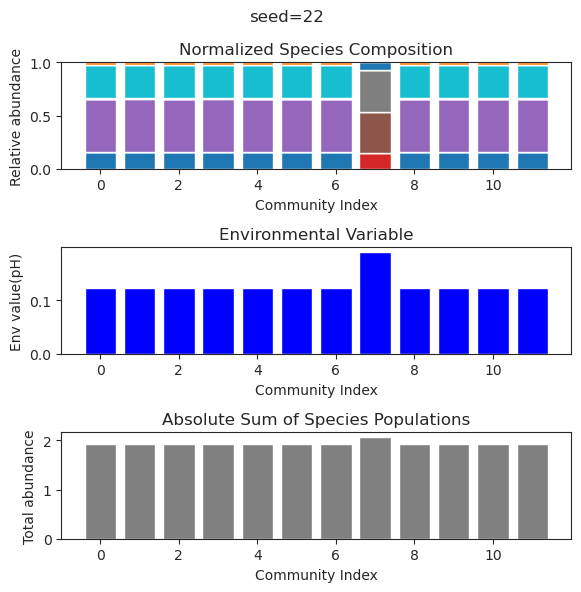

{'species': array([ 1.22603526e-49,  9.62856086e-01, -3.10198860e-23, -7.85316093e-41,
       -1.34459530e-46,  1.54668540e-01,  5.99982724e-01, -6.56268982e-46,
       -6.49449760e-46, -2.28219548e-59,  3.58855766e-01,  3.67593728e-30]), 'env': array([0.42597795])}
{'species': array([ 2.56211741e-35,  9.62856086e-01, -1.18619065e-16, -3.54580054e-23,
        3.07124122e-33,  1.54668540e-01,  5.99982724e-01,  4.39276116e-30,
       -2.72273948e-30,  9.17955745e-38,  3.58855766e-01,  4.00468861e-21]), 'env': array([0.42597795])}
{'species': array([-7.01631761e-44,  9.62856086e-01, -2.53148869e-18, -9.20533784e-31,
       -3.31717939e-36,  1.54668540e-01,  5.99982724e-01,  1.90339596e-38,
       -4.11214444e-35,  1.58482717e-43,  3.58855766e-01, -1.93005351e-24]), 'env': array([0.42597795])}
{'species': array([-1.44592229e-44,  9.62856086e-01, -3.55882063e-21, -2.02081913e-35,
       -3.97641294e-43,  1.54668540e-01,  5.99982724e-01,  9.11564251e-43,
       -9.24459671e-42,  2.12476740e-

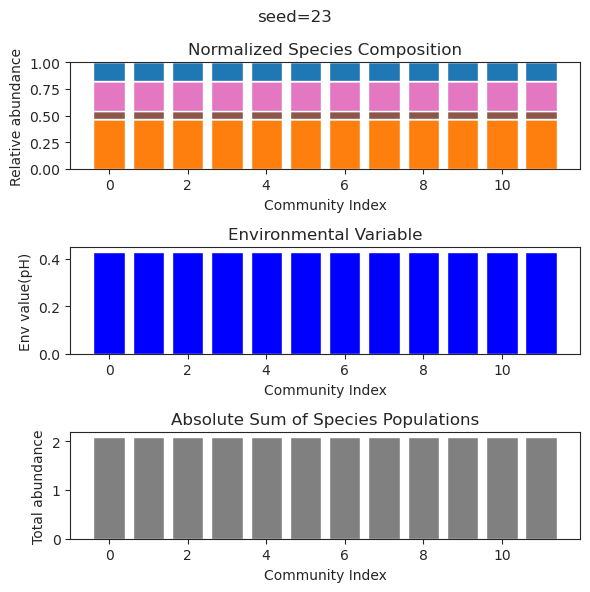

{'species': array([-3.16789690e-44,  4.05463140e-52,  3.69242431e-44,  7.11358226e-14,
        4.49172829e-34,  1.05756545e-42,  1.61308128e+00, -6.89644897e-50,
        4.31732120e-01,  1.27329285e+00, -5.29583390e-50,  1.38836261e-52]), 'env': array([0.93576924])}
{'species': array([-4.66400486e-88, -2.40370351e-54,  4.35064685e-94,  2.48537585e-14,
       -1.01393854e-29, -2.20531063e-73,  1.61308128e+00, -4.49886055e-96,
        4.31732120e-01,  1.27329285e+00, -2.14587976e-94,  2.02513443e-90]), 'env': array([0.93576924])}
{'species': array([ 2.33773091e-39, -1.36716149e-48, -6.65629072e-44, -2.56140211e-16,
        1.82085651e-36,  3.92123859e-40,  1.61308128e+00, -1.99082537e-46,
        4.31732120e-01,  1.27329285e+00,  3.56694956e-60, -3.39658344e-61]), 'env': array([0.93576924])}
{'species': array([-9.91778835e-61,  3.03210801e-54, -3.32926952e-56,  3.93869858e-16,
        1.41505824e-39, -1.48224794e-58,  1.61308128e+00, -2.03887587e-73,
        4.31732120e-01,  1.27329285e+

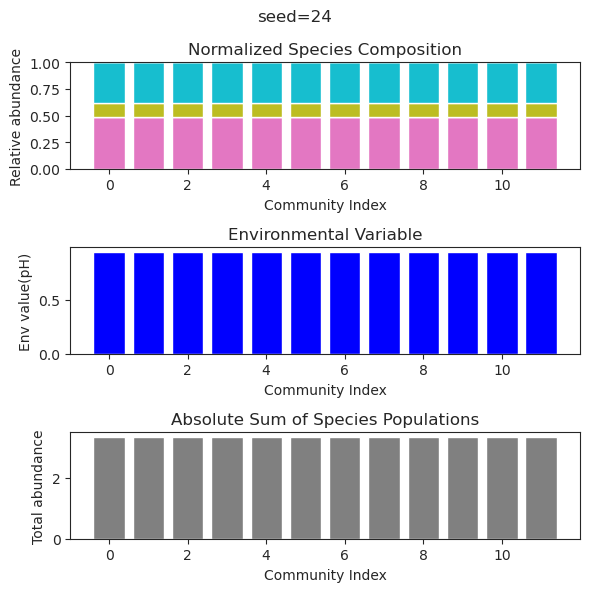

{'species': array([-1.68834912e-27,  2.66859956e-18,  9.89917274e-01, -2.87322617e-25,
        5.47204262e-01,  6.07005785e-46, -2.31920219e-38,  1.49882812e-55,
        5.42109258e-49,  6.64110272e-01, -9.45411050e-65, -3.42974843e-41]), 'env': array([0.60535379])}
{'species': array([-8.78896974e-31,  3.86506476e-18,  9.89917274e-01, -1.06526240e-26,
        5.47204262e-01, -2.68121014e-45, -7.87228498e-41,  1.01651138e-57,
        2.78866099e-52,  6.64110272e-01, -1.26582838e-63, -2.27949911e-41]), 'env': array([0.60535379])}
{'species': array([-2.89024137e-30, -2.69943074e-19,  9.89917274e-01,  6.50413538e-28,
        5.47204262e-01, -1.43726242e-47, -2.04167319e-41,  1.85907252e-53,
        2.37959399e-45,  6.64110272e-01, -4.76767191e-66,  1.88327497e-42]), 'env': array([0.60535379])}
{'species': array([ 2.01098829e-24,  9.59407011e-17,  9.89917274e-01, -1.49003205e-22,
        5.47204262e-01,  5.82621509e-35,  2.96277228e-36, -2.76803659e-46,
        4.10009228e-39,  6.64110272e-

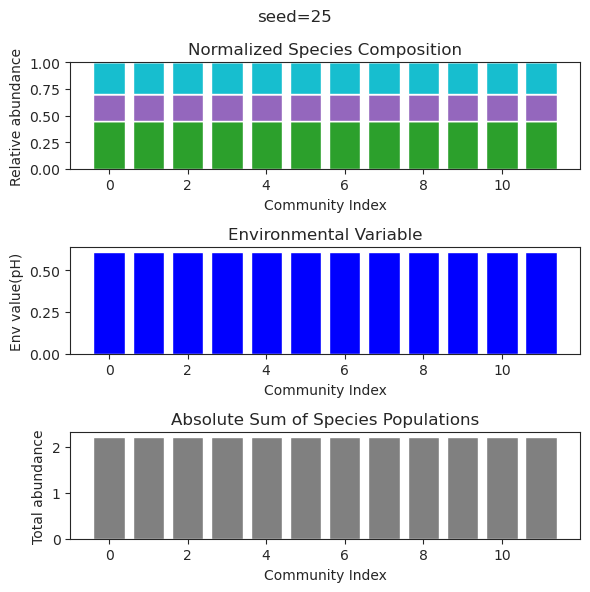

{'species': array([ 3.25621025e-02,  4.17040491e-01, -9.41339295e-57,  6.40076554e-01,
       -3.68735211e-81, -5.84099655e-91,  5.00704060e-01,  6.97805994e-01,
       -4.61797236e-66,  1.72831377e-69, -5.81092566e-39, -2.92949323e-45]), 'env': array([0.25185099])}
{'species': array([ 3.25621025e-02,  4.17040491e-01, -1.96981721e-45,  6.40076554e-01,
        4.23673567e-55,  9.13347373e-60,  5.00704060e-01,  6.97805994e-01,
        6.98857595e-50,  4.22375303e-57,  2.62849407e-34, -9.09306067e-22]), 'env': array([0.25185099])}
{'species': array([ 3.25621025e-02,  4.17040491e-01, -9.55734712e-44,  6.40076554e-01,
       -4.89964299e-56,  3.35783176e-64,  5.00704060e-01,  6.97805994e-01,
        1.80435389e-49, -9.17976056e-50, -6.86269161e-37,  7.25999290e-36]), 'env': array([0.25185099])}
{'species': array([ 3.25621025e-02,  4.17040491e-01, -2.57785992e-42,  6.40076554e-01,
        4.79775962e-63,  9.26930602e-73,  5.00704060e-01,  6.97805994e-01,
       -2.21821928e-59,  6.11870069e-

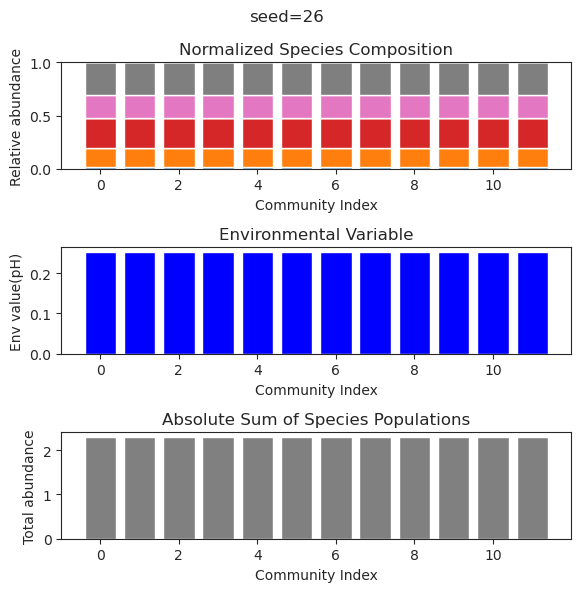

{'species': array([6.84599778e-77, 5.66575135e-01, 1.50999185e-74, 1.11230872e-01,
       8.76464600e-45, 2.11458498e-02, 1.12588451e-89, 4.33400822e-01,
       1.96865756e-34, 2.64280906e-01, 7.27995207e-01, 6.39606964e-02]), 'env': array([0.47213345])}
{'species': array([-5.24531139e-100,  5.66575135e-001, -1.20667365e-097,
        1.11230872e-001, -2.38042329e-052,  2.11458498e-002,
        4.15019999e-124,  4.33400822e-001, -2.86603957e-026,
        2.64280906e-001,  7.27995207e-001,  6.39606964e-002]), 'env': array([0.47213345])}
{'species': array([-1.44807763e-74,  5.66575135e-01, -2.09562968e-70,  1.11230872e-01,
        8.65163505e-43,  2.11458498e-02,  1.19504428e-87,  4.33400822e-01,
       -5.60921676e-28,  2.64280906e-01,  7.27995207e-01,  6.39606964e-02]), 'env': array([0.47213345])}
{'species': array([ 1.35044791e-102,  5.66575135e-001,  2.03038101e-096,
        1.11230872e-001, -6.24971661e-050,  2.11458498e-002,
        2.20570624e-122,  4.33400822e-001,  3.34877376e-02

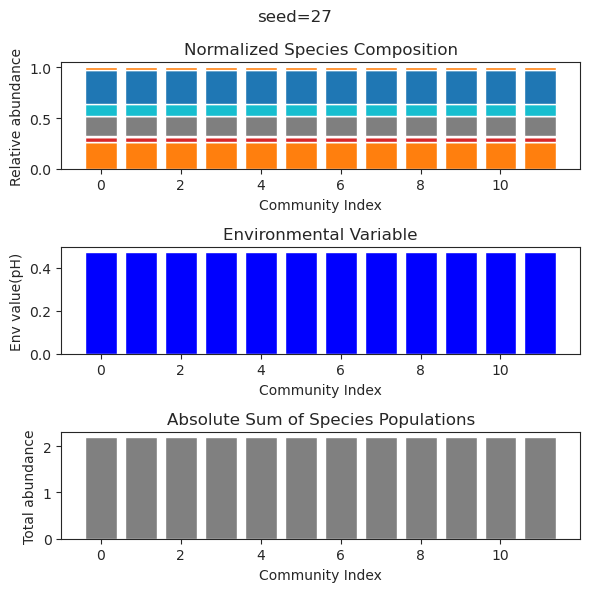

{'species': array([-5.15112576e-21,  1.99670107e-01, -1.06068998e-75, -9.20393816e-19,
        1.31205801e-57, -1.81591325e-35,  9.44490129e-80,  3.39728750e-01,
        9.68644023e-01,  4.25946726e-72,  3.75065793e-68,  3.80500443e-01]), 'env': array([0.33354389])}
{'species': array([ 5.69453003e-26,  1.99670107e-01, -9.35668876e-68,  1.24152823e-23,
       -1.97002543e-48, -1.50281158e-38,  5.65489008e-68,  3.39728750e-01,
        9.68644023e-01, -2.96531435e-61, -1.57791508e-58,  3.80500443e-01]), 'env': array([0.33354389])}
{'species': array([ 3.95136147e-24,  1.99670107e-01, -3.57446641e-71, -2.38466931e-17,
        6.19421218e-67,  2.79457918e-31,  1.12986788e-99,  3.39728750e-01,
        9.68644023e-01, -1.98493275e-75,  1.84925313e-77,  3.80500443e-01]), 'env': array([0.33354389])}
{'species': array([-1.08050898e-176,  1.99670107e-001,  4.80086083e-061,
        1.72155470e-016,  3.01188808e-067,  9.27826677e-028,
        4.79460872e-191,  3.39728750e-001,  9.68644023e-001,
    

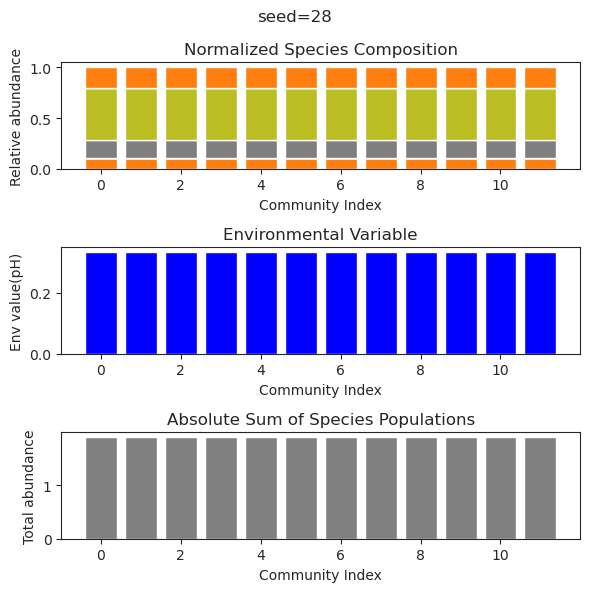

{'species': array([ 5.57188703e-23, -7.34646986e-39, -1.20243912e-42, -3.84113259e-61,
        5.27749513e-01, -9.91701485e-72, -7.14033821e-59,  1.12878299e+00,
        6.57682557e-31, -1.47829473e-46,  2.50840587e-51,  6.29700728e-01]), 'env': array([0.66427111])}
{'species': array([ 1.79305982e-27,  2.57071603e-36,  2.80597828e-37, -9.49784203e-46,
        5.27749513e-01, -9.60031553e-51, -4.82355758e-43,  1.12878299e+00,
        2.30643299e-31,  4.62601665e-47, -9.32175333e-42,  6.29700728e-01]), 'env': array([0.66427111])}
{'species': array([-7.02563199e-26, -3.85617424e-35, -7.64404410e-36,  5.62504878e-50,
        5.27749513e-01, -1.03594552e-64,  1.79618803e-50,  1.12878299e+00,
        3.48583308e-26,  1.56278062e-48,  1.35772972e-43,  6.29700728e-01]), 'env': array([0.66427111])}
{'species': array([ 2.37906465e-25, -1.14765564e-31,  5.37774536e-31, -3.71466632e-36,
        5.27749513e-01, -1.37896800e-38, -3.70909567e-33,  1.12878299e+00,
        1.50418203e-26, -7.18172695e-

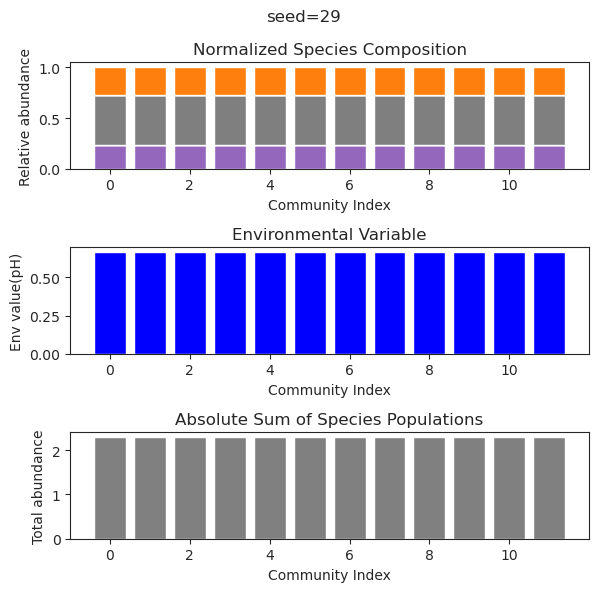

{'species': array([-7.12326555e-23,  7.63686880e-51,  5.50659308e-39,  1.48345551e-44,
        4.15527961e-53,  5.77310453e-01,  9.05509782e-01,  7.35486626e-01,
        4.21257981e-01, -3.59991923e-51,  8.63996287e-42,  2.27047506e-17]), 'env': array([0.71143307])}
{'species': array([-1.71078458e-22, -1.15054766e-48,  1.50370869e-39,  3.55895034e-45,
       -3.24690852e-50,  5.77310453e-01,  9.05509782e-01,  7.35486626e-01,
        4.21257981e-01, -2.00719595e-50,  2.20158592e-39,  4.94436475e-17]), 'env': array([0.71143307])}
{'species': array([ 7.74135931e-25,  5.08534823e-80,  3.28675239e-70,  1.64270050e-63,
        2.14454471e-81,  5.77310453e-01,  9.05509782e-01,  7.35486626e-01,
        4.21257981e-01,  1.06451007e-81, -3.15920016e-57, -6.09739353e-25]), 'env': array([0.71143307])}
{'species': array([-9.50808513e-27,  2.09636142e-49,  1.54035450e-42,  2.85207192e-43,
        3.28097955e-50,  5.77310453e-01,  9.05509782e-01,  7.35486626e-01,
        4.21257981e-01,  1.92025080e-

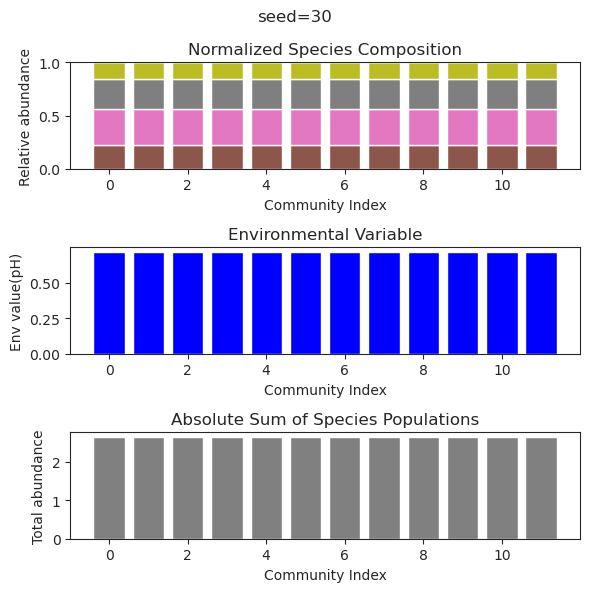

{'species': array([ 6.71492324e-01,  8.59786191e-02,  1.34752324e-01, -1.34845427e-27,
        6.31795067e-01,  3.60491484e-01, -1.35619313e-60,  1.81302310e-01,
        4.56316255e-35, -7.74820028e-32, -1.30426640e-62, -1.10988066e-57]), 'env': array([0.37086197])}
{'species': array([ 6.71492324e-01,  8.59786191e-02,  1.34752324e-01,  1.73637001e-30,
        6.31795067e-01,  3.60491484e-01,  2.22265450e-81,  1.81302310e-01,
       -6.60740144e-40,  1.08585952e-36, -1.75298489e-76,  2.49866640e-77]), 'env': array([0.37086197])}
{'species': array([ 6.71492324e-001,  8.59786191e-002,  1.34752324e-001,
       -1.92651303e-031,  6.31795067e-001,  3.60491484e-001,
       -1.83235412e-125,  1.81302310e-001, -2.94253630e-027,
       -3.83670031e-039, -2.82753452e-108, -1.38691010e-102]), 'env': array([0.37086197])}
{'species': array([ 6.71492324e-01,  8.59786191e-02,  1.34752324e-01,  1.20707556e-30,
        6.31795067e-01,  3.60491484e-01, -6.02391377e-92,  1.81302310e-01,
       -9.28358457

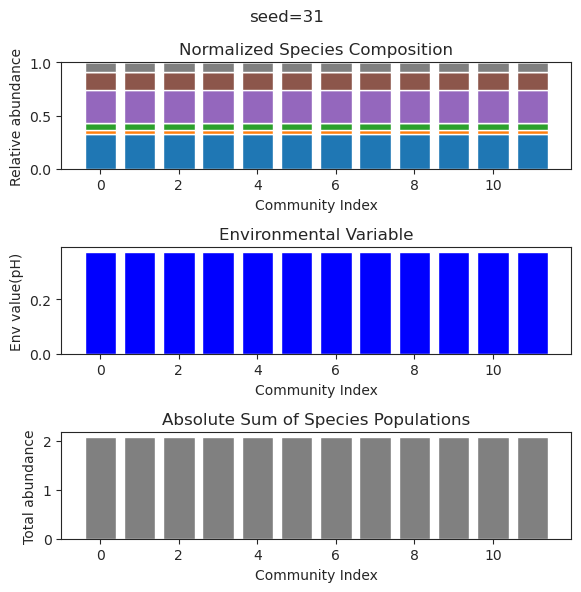

{'species': array([ 8.98949944e-75,  1.48382756e-33,  1.07738182e-71,  1.55468925e+00,
       -2.74510372e-26,  4.62402582e-70,  1.02995415e+00,  6.01713491e-38,
        2.95576454e-75,  8.94276167e-73, -6.70064876e-46,  7.43297587e-64]), 'env': array([1.0924217])}
{'species': array([ 1.05857444e-59, -2.24219512e-28,  7.01568514e-60,  1.55468925e+00,
       -1.05017476e-29,  5.99599484e-58,  1.02995415e+00,  7.66889917e-30,
       -3.02674852e-67, -1.87069980e-63,  2.43450169e-37, -3.65656568e-52]), 'env': array([1.0924217])}
{'species': array([-1.96622740e-63, -2.26962331e-29, -1.99430135e-59,  1.55468925e+00,
        9.27493376e-29, -6.91084603e-59,  1.02995415e+00,  4.08782879e-31,
        1.14503007e-66,  1.39784823e-67, -5.97283388e-39, -2.67146705e-54]), 'env': array([1.0924217])}
{'species': array([-2.31373795e-53,  2.03444431e-37, -7.71331465e-54,  1.55468925e+00,
       -2.63826899e-35, -3.56153850e-50,  1.02995415e+00, -5.23009059e-39,
        3.68160162e-68, -2.24733704e-66,

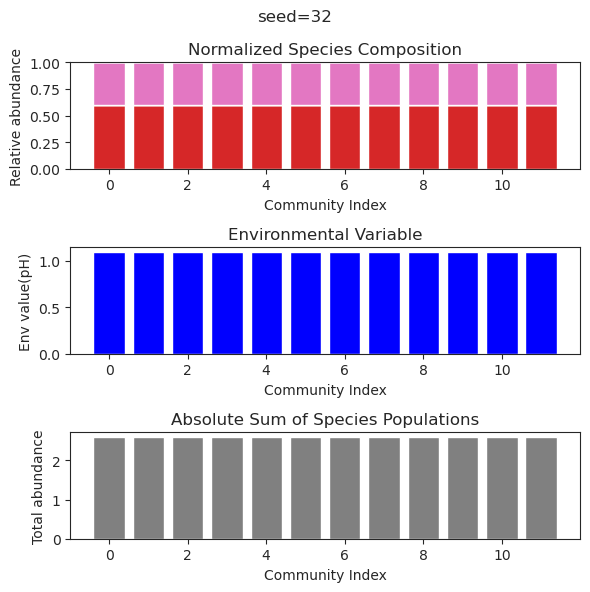

{'species': array([ 2.96914256e-001, -1.53728987e-031, -8.26038697e-044,
        4.84475996e-001,  6.30944266e-001,  6.12392026e-001,
       -5.80130972e-081, -1.01520633e-081,  1.15330689e-096,
        7.36002709e-002,  5.74536450e-102,  6.33641970e-008]), 'env': array([0.15034787])}
{'species': array([ 2.96914268e-01, -1.19596385e-50,  2.22447235e-45,  4.84475954e-01,
        6.30944242e-01,  6.12392054e-01,  1.93784427e-51, -2.61816526e-50,
       -5.43619740e-55,  7.36003195e-02,  1.49881984e-60,  2.03125784e-08]), 'env': array([0.15034786])}
{'species': array([ 2.96914257e-01,  1.15468583e-29,  5.24808810e-40,  4.84475992e-01,
        6.30944263e-01,  6.12392029e-01, -1.06165249e-74, -7.56038539e-76,
       -6.08286474e-95,  7.36002757e-02,  6.24413466e-99,  5.90839266e-08]), 'env': array([0.15034787])}
{'species': array([ 2.96914267e-01, -6.81888008e-30,  4.58326381e-42,  4.84475957e-01,
        6.30944244e-01,  6.12392051e-01, -1.80182544e-51,  2.05024242e-49,
        9.97105456

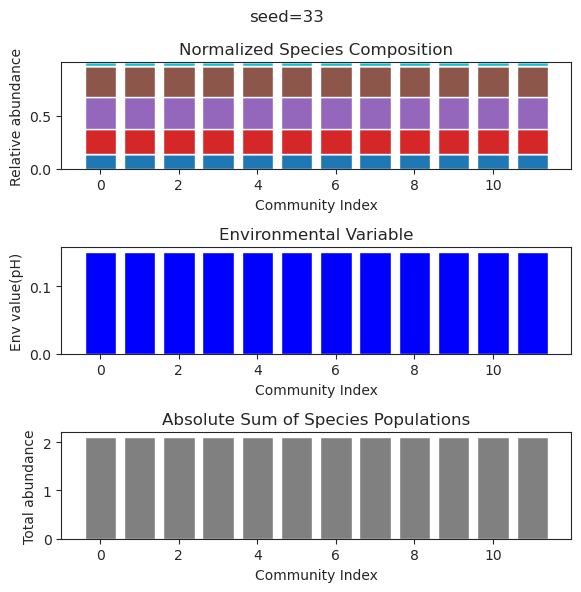

{'species': array([ 1.40716948e+00,  5.01976847e-51, -1.75489368e-25,  3.56628180e-54,
        1.52044182e-31,  3.89214290e-45, -6.00045920e-57,  3.67680057e-02,
       -1.08869710e-46, -2.39006778e-55,  1.21195795e+00,  4.03276923e-54]), 'env': array([0.65216878])}
{'species': array([ 1.40716948e+00, -5.36755940e-48, -2.40603280e-26, -1.31224191e-57,
       -5.24399681e-37, -3.92548251e-46,  3.15356214e-58,  3.67680057e-02,
        2.69033544e-46, -1.35370025e-56,  1.21195795e+00, -2.26594451e-61]), 'env': array([0.65216878])}
{'species': array([ 1.40716948e+00, -4.01365649e-53,  3.56542633e-26, -2.17953180e-57,
       -1.31767863e-29, -7.61678543e-51, -6.61734993e-56,  3.67680057e-02,
       -1.43780478e-50, -3.32186430e-59,  1.21195795e+00, -2.08809216e-56]), 'env': array([0.65216878])}
{'species': array([ 1.40716948e+00, -3.99961685e-68,  5.59628384e-30,  4.31679448e-74,
        3.52604556e-38,  1.29557466e-57, -5.32072449e-80,  3.67680057e-02,
        2.21441851e-53,  1.36582618e-

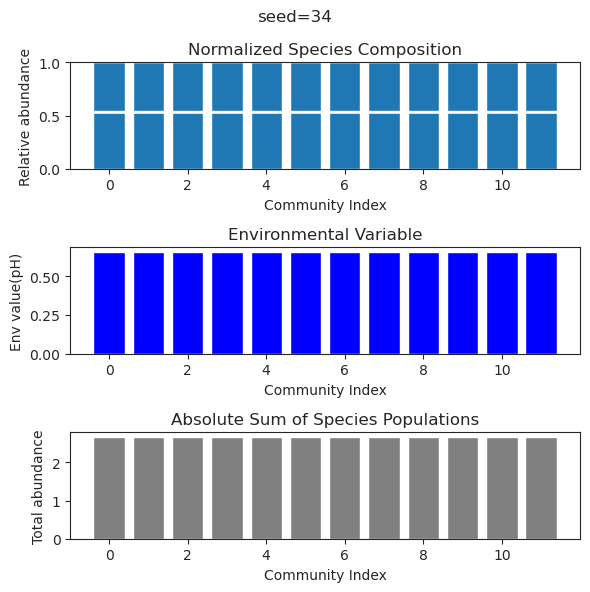

{'species': array([-3.14574600e-34, -1.84183014e-71,  5.95407705e-70,  5.32166285e-01,
       -1.00028172e-56,  1.33673202e+00,  1.58508992e+00,  8.38157238e-72,
        1.05524117e+00, -4.07435994e-65, -1.93839951e-75, -2.42988808e-36]), 'env': array([1.59792939])}
{'species': array([-1.37004275e-28, -1.75039368e-60, -5.89211365e-59,  5.32166285e-01,
       -1.76846204e-53,  1.33673202e+00,  1.58508992e+00, -9.28961362e-64,
        1.05524117e+00, -1.26909361e-53, -1.56438686e-64, -4.41727422e-32]), 'env': array([1.59792939])}
{'species': array([-3.08665179e-31,  1.01526229e-41,  1.63334388e-41,  5.32166285e-01,
        1.09045684e-42,  1.33673202e+00,  1.58508992e+00,  4.94054884e-44,
        1.05524117e+00,  4.79257647e-43,  1.33151958e-45, -2.70293451e-33]), 'env': array([1.59792939])}
{'species': array([ 6.71127214e-30, -5.31393035e-70,  6.81317282e-44,  5.32166285e-01,
       -7.99768658e-57,  1.33673202e+00,  1.58508992e+00,  5.50193694e-71,
        1.05524117e+00, -1.35958789e-

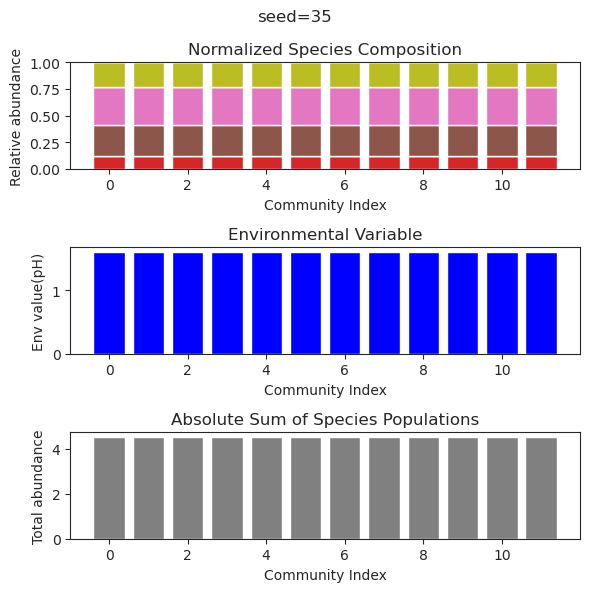

{'species': array([ 2.24985348e-01, -1.37754233e-34,  2.82251419e-37,  1.14267510e-01,
       -1.42817060e-87,  7.81033192e-01,  2.28300967e-40,  2.46323598e-01,
        1.57248886e-82,  2.54726440e-41,  7.63032321e-03,  6.56411266e-01]), 'env': array([0.29553066])}
{'species': array([ 2.24985340e-01, -6.60929273e-41,  9.59705823e-43,  1.14267516e-01,
        8.89265739e-71,  7.81033190e-01, -8.89333484e-35,  2.46323596e-01,
        1.11713427e-70, -8.72445223e-49,  7.63032954e-03,  6.56411268e-01]), 'env': array([0.29553066])}
{'species': array([ 2.24985342e-01, -6.18055751e-37, -1.12020183e-37,  1.14267514e-01,
        5.65000669e-34,  7.81033191e-01, -3.62861764e-41,  2.46323597e-01,
        2.18377220e-64,  1.25869366e-42,  7.63032815e-03,  6.56411268e-01]), 'env': array([0.29553066])}
{'species': array([ 2.24985340e-01, -3.88068902e-28,  1.23851163e-27,  1.14267515e-01,
       -9.81748602e-38,  7.81033190e-01, -3.89005725e-31,  2.46323596e-01,
        1.60873341e-29, -5.39349947e-

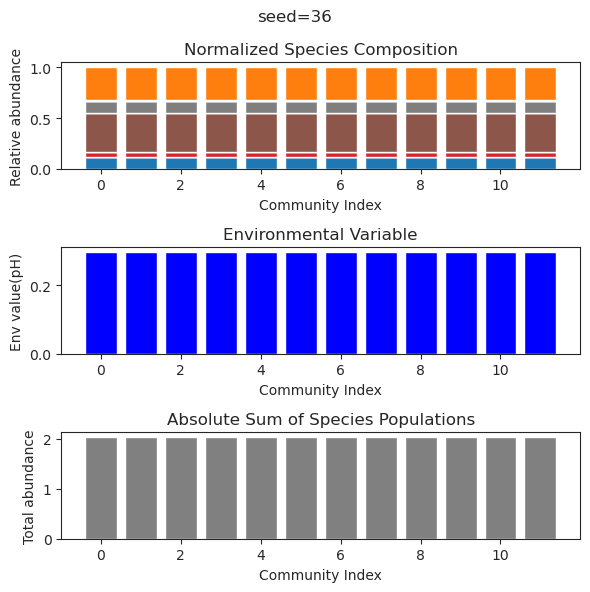

{'species': array([ 4.70292585e-015,  2.91609194e-001,  3.40837280e-094,
        1.29027138e+000,  5.34104301e-001,  4.18660984e-015,
       -3.63808633e-038,  5.64424072e-001,  1.60856368e-109,
        4.27457976e-115, -3.06666161e-029, -1.45502926e-115]), 'env': array([0.79621781])}
{'species': array([-1.30326573e-14,  2.91609194e-01,  1.45220358e-42,  1.29027138e+00,
        5.34104301e-01, -3.27572319e-25, -6.35882622e-82,  5.64424072e-01,
       -2.39111123e-73, -3.20263133e-73,  1.44744242e-27, -1.07426186e-72]), 'env': array([0.79621781])}
{'species': array([-2.83796073e-016,  2.91609194e-001, -5.43303705e-038,
        1.29027138e+000,  5.34104301e-001, -3.32309783e-016,
       -2.64412580e-116,  5.64424072e-001, -4.52313976e-117,
       -1.73139340e-125, -2.00330409e-037, -6.99202345e-128]), 'env': array([0.79621781])}
{'species': array([-4.49608585e-14,  2.91609194e-01, -2.28958526e-38,  1.29027138e+00,
        5.34104301e-01, -6.26620989e-19, -6.92307352e-36,  5.64424072e-01,

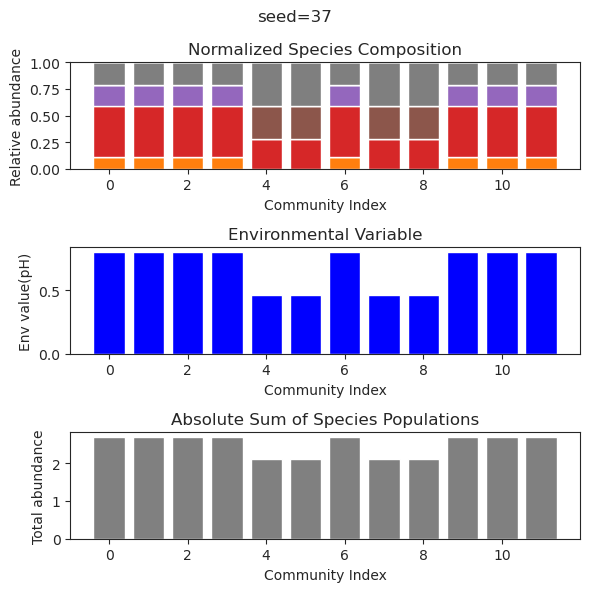

{'species': array([-6.33706528e-39, -8.15287921e-40,  1.68537350e-01,  7.36655572e-01,
        4.32236097e-01,  7.61963874e-34,  1.19732864e-01,  1.98123947e-88,
        9.05464373e-63,  3.07648627e-01,  2.80072844e-82,  9.78678513e-02]), 'env': array([0.30522785])}
{'species': array([ 8.11600984e-34,  6.16058766e-33,  1.68537350e-01,  7.36655572e-01,
        4.32236097e-01, -2.62339292e-32,  1.19732864e-01,  2.60252699e-63,
       -4.90515490e-46,  3.07648627e-01,  5.65629255e-70,  9.78678513e-02]), 'env': array([0.30522785])}
{'species': array([ 1.83697197e-39,  3.82461802e-38,  1.68537350e-01,  7.36655572e-01,
        4.32236097e-01, -1.04245704e-31,  1.19732864e-01, -8.55449495e-81,
       -8.65355556e-61,  3.07648627e-01,  1.13801983e-80,  9.78678513e-02]), 'env': array([0.30522785])}
{'species': array([-6.56796685e-38, -3.01224369e-37,  1.68537350e-01,  7.36655572e-01,
        4.32236097e-01, -2.99558293e-32,  1.19732864e-01,  1.57161398e-76,
       -3.21150700e-55,  3.07648627e-

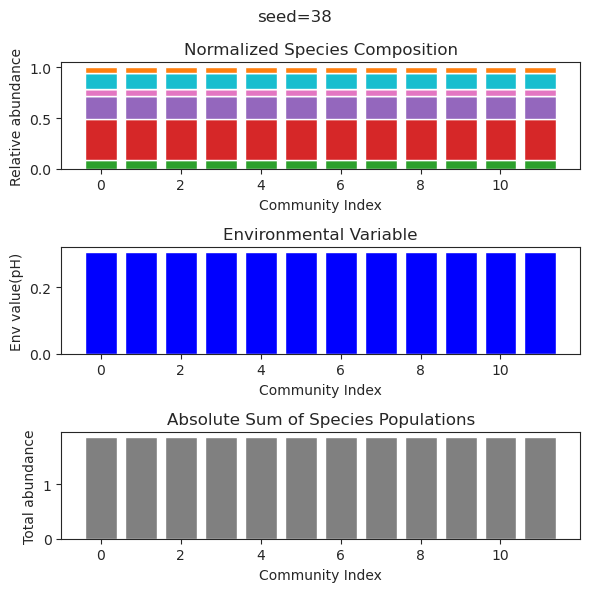

{'species': array([ 8.40635426e-025, -4.36570182e-056,  6.45695282e-054,
        8.61054305e-001, -6.29956115e-026,  3.47856344e-059,
        1.29921114e-075,  1.56670307e-001,  7.62553346e-146,
        3.84088826e-001,  1.19386421e-041,  4.20724686e-001]), 'env': array([0.55564582])}
{'species': array([-4.46835759e-020,  1.09665811e-057,  7.50944806e-045,
        8.61054305e-001,  9.91042295e-030,  2.10475465e-074,
        2.67018337e-066,  1.56670307e-001,  2.92416708e-151,
        3.84088826e-001, -2.17608889e-038,  4.20724686e-001]), 'env': array([0.55564582])}
{'species': array([ 1.55041352e-30, -1.20151884e-35, -1.53022580e-37,  8.61054305e-01,
       -4.21751872e-24, -2.48597999e-32, -3.63970753e-45,  1.56670307e-01,
        4.07738838e-49,  3.84088826e-01, -1.92098390e-34,  4.20724686e-01]), 'env': array([0.55564582])}
{'species': array([ 1.13726771e-41,  1.92090809e-45,  1.99339243e-54,  8.61054305e-01,
        2.30975405e-26,  2.22838329e-33, -1.22607602e-64,  1.56670307e-01,

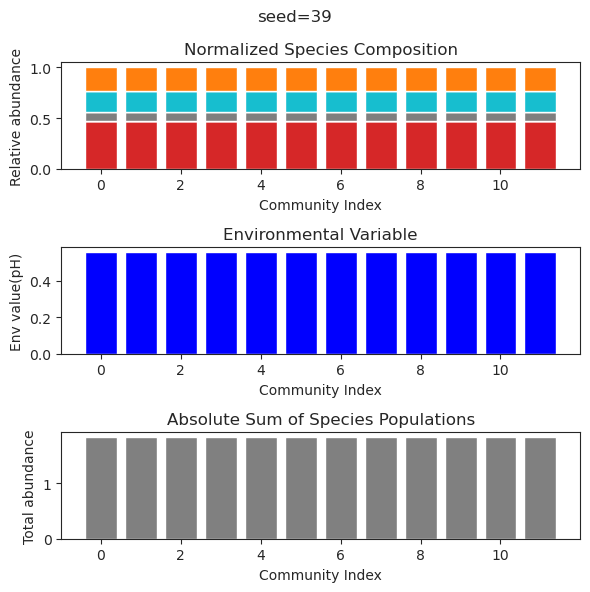

{'species': array([ 3.44151970e-28, -6.10130132e-25,  1.36173564e+00,  1.18147518e-48,
       -6.62765304e-55,  8.29019387e-41,  1.87188662e-53,  2.16257932e-53,
       -6.63033936e-40,  3.07981713e-01,  4.80389073e-51,  1.19794270e+00]), 'env': array([0.81735921])}
{'species': array([ 5.00392120e-25, -1.95460894e-30,  1.36173564e+00,  6.16219002e-57,
        2.48903417e-63,  8.29711713e-44,  1.26100001e-59,  1.29086819e-57,
        4.69588263e-48,  3.07981713e-01, -7.94569393e-58,  1.19794270e+00]), 'env': array([0.81735921])}
{'species': array([ 6.12633286e-26, -3.96649593e-28,  1.36173564e+00,  7.86971968e-58,
        1.39633395e-64,  1.34836268e-39,  2.46168002e-63, -8.97110067e-59,
       -1.86131911e-48,  3.07981713e-01,  5.14656406e-59,  1.19794270e+00]), 'env': array([0.81735921])}
{'species': array([-4.65784932e-29,  1.65691228e-27,  1.36173564e+00, -2.39476396e-47,
        2.72021612e-49,  9.63769413e-39, -5.23620955e-49,  1.38139401e-48,
       -1.05069229e-38,  3.07981713e-

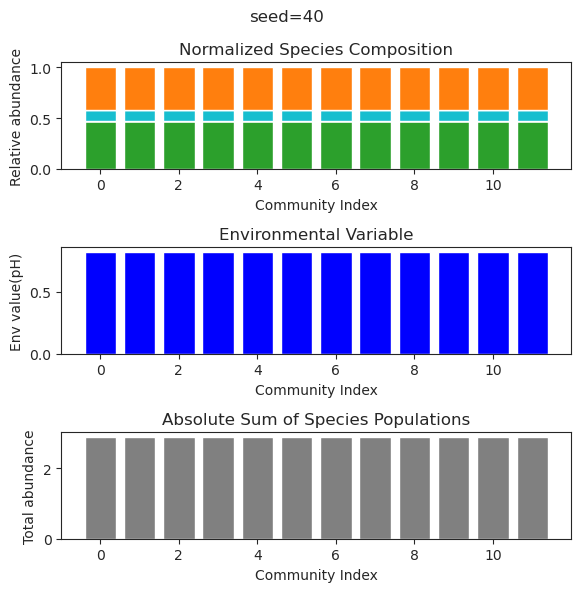

{'species': array([ 3.73488631e-44,  6.02233666e-02,  7.96556160e-01,  1.96310549e-52,
        9.24623606e-34,  2.95744971e-52,  4.67229796e-02,  4.59150075e-25,
        6.10042928e-01, -3.66573667e-53, -5.32391953e-48,  1.07826904e+00]), 'env': array([0.44970865])}
{'species': array([-2.57682230e-80,  6.02233666e-02,  7.96556160e-01, -1.97658011e-86,
       -5.40381333e-50, -1.53851186e-86,  4.67229796e-02, -2.50157020e-29,
        6.10042928e-01, -3.66075154e-84,  3.30720143e-73,  1.07826904e+00]), 'env': array([0.44970865])}
{'species': array([-1.09301925e-50,  6.02233666e-02,  7.96556160e-01, -3.32889577e-53,
       -2.34536365e-36, -1.32580203e-38,  4.67229796e-02, -2.17294282e-23,
        6.10042928e-01, -2.53497465e-52,  5.00158577e-48,  1.07826904e+00]), 'env': array([0.44970865])}
{'species': array([ 2.04893557e-120,  6.02233666e-002,  7.96556160e-001,
        6.94271037e-114, -2.06599411e-062,  6.87388981e-122,
        4.67229796e-002, -2.49337622e-030,  6.10042928e-001,
    

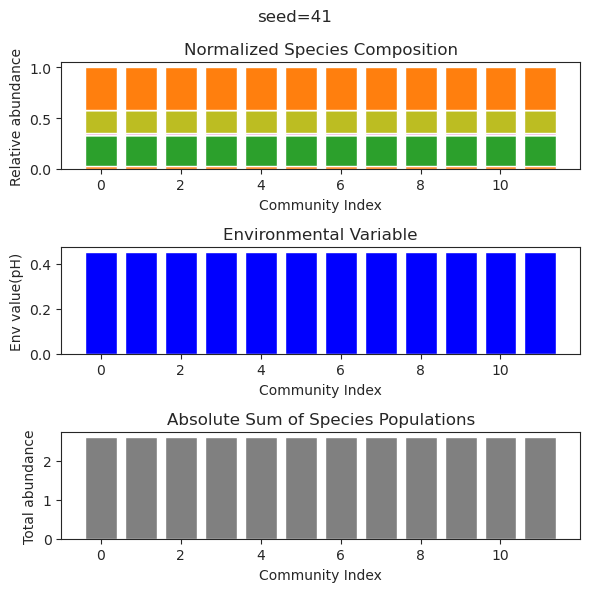

{'species': array([ 6.84842247e-001,  1.75619923e-121,  4.83028954e-106,
        8.13585683e-001,  3.18554093e-082, -2.30129980e-022,
       -3.35641520e-111, -1.24977167e-106,  4.24837803e-001,
        4.39873702e-029,  5.88414302e-001,  3.97927355e-002]), 'env': array([0.62759174])}
{'species': array([ 6.84842247e-01,  6.22165611e-31, -8.73329334e-58,  8.13585683e-01,
       -2.83855312e-57, -6.66330002e-27,  2.03835654e-63,  3.23921295e-67,
        4.24837803e-01,  2.60631820e-43,  5.88414302e-01,  3.97927355e-02]), 'env': array([0.62759174])}
{'species': array([ 6.84842247e-01, -2.22560936e-38, -5.77721447e-56,  8.13585683e-01,
        1.95945027e-52,  2.66917451e-29, -3.37034953e-58, -9.96451224e-37,
        4.24837803e-01,  6.88716084e-40,  5.88414302e-01,  3.97927355e-02]), 'env': array([0.62759174])}
{'species': array([ 6.84842247e-01, -5.97171858e-37,  1.82732298e-35,  8.13585683e-01,
       -3.08990336e-44, -2.18094847e-20, -2.79248427e-34,  2.88058609e-38,
        4.24837803

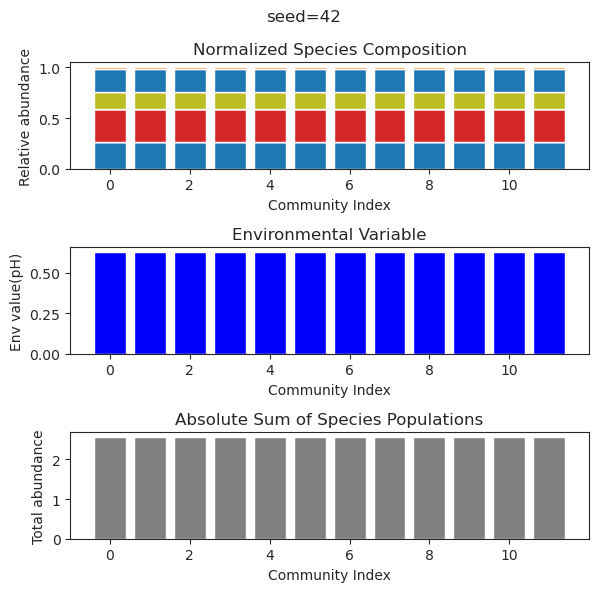

{'species': array([ 7.84839853e-01,  2.11404576e-59,  5.09790170e-01, -6.16743120e-34,
       -3.91343277e-61,  4.80389004e-01,  2.75253352e-02, -1.11063595e-59,
        1.30862141e-01,  6.97771537e-52, -1.32744950e-54, -1.43643409e-34]), 'env': array([0.28919221])}
{'species': array([ 7.84839853e-01, -2.09168012e-93,  5.09790170e-01, -2.42507965e-42,
       -4.72840668e-92,  4.80389004e-01,  2.75253352e-02, -2.03767807e-92,
        1.30862141e-01, -2.30445077e-80, -1.23485831e-75, -2.40461314e-36]), 'env': array([0.28919221])}
{'species': array([ 7.84839853e-01,  2.98150808e-57,  5.09790170e-01, -6.60952677e-35,
       -3.01874171e-54,  4.80389004e-01,  2.75253352e-02,  5.57295605e-53,
        1.30862141e-01,  5.93679724e-54, -9.23344409e-50,  3.97477799e-36]), 'env': array([0.28919221])}
{'species': array([ 7.84839853e-01, -1.12383867e-37,  5.09790170e-01,  1.30648571e-41,
       -3.15419657e-83,  4.80389004e-01,  2.75253352e-02, -2.03851386e-85,
        1.30862141e-01,  2.25933904e-

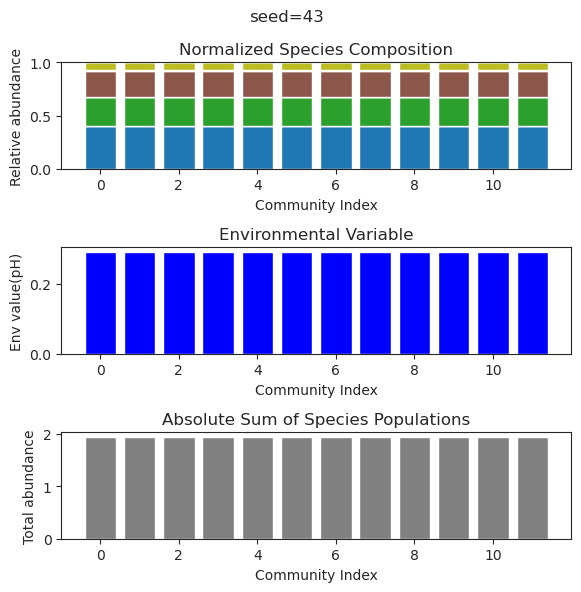

{'species': array([-3.19049888e-64, -2.12066675e-30, -3.42830381e-68, -9.64768200e-34,
        9.97295382e-01, -5.68881199e-21,  8.93469461e-36,  1.12360792e+00,
        3.19776520e-50,  4.01904775e-54,  1.06224625e+00, -8.95570763e-27]), 'env': array([0.90946655])}
{'species': array([-5.81878406e-80, -9.91542292e-41, -2.00061811e-84,  1.75534167e-34,
        9.97295382e-01, -7.76161129e-26, -4.05877215e-37,  1.12360792e+00,
        1.86123352e-68,  4.59426600e-74,  1.06224625e+00, -6.24529448e-28]), 'env': array([0.90946655])}
{'species': array([-7.74870372e-66, -3.84915501e-33, -1.62356641e-66,  1.31256382e-31,
        9.97295382e-01,  5.87961609e-25, -9.29144870e-35,  1.12360792e+00,
       -1.82354026e-51, -7.29693934e-56,  1.06224625e+00, -1.94125736e-25]), 'env': array([0.90946655])}
{'species': array([-4.72900288e-59, -5.61358186e-40, -3.51270196e-60,  3.48474504e-31,
        9.97295382e-01, -6.64922745e-29, -2.70272221e-35,  1.12360792e+00,
        3.08255342e-51, -2.11849783e-

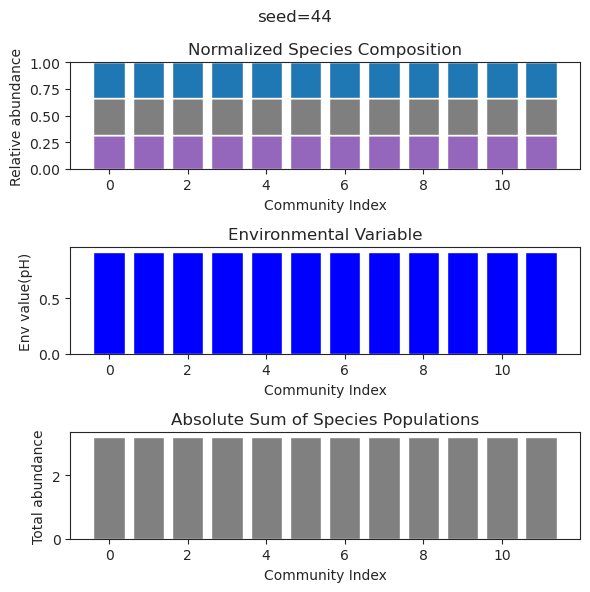

{'species': array([-1.95317767e-44,  4.88117030e-01,  4.14191561e-01, -9.60013775e-20,
       -3.50984459e-30,  4.37407658e-01, -4.53170358e-29, -3.72944544e-40,
        4.01343306e-01,  6.37031938e-01,  1.04289840e-40,  8.22810324e-02]), 'env': array([0.68494367])}
{'species': array([ 4.70527656e-48,  4.88117030e-01,  4.14191561e-01,  5.32756409e-24,
       -9.09769639e-30,  4.37407658e-01,  3.41350719e-28, -2.04755241e-42,
        4.01343306e-01,  6.37031938e-01,  4.84287167e-46,  8.22810324e-02]), 'env': array([0.68494367])}
{'species': array([-1.00370113e-42,  4.88117030e-01,  4.14191561e-01, -1.11916827e-24,
       -6.55444463e-33,  4.37407658e-01,  1.27425087e-30, -6.05271661e-41,
        4.01343306e-01,  6.37031938e-01,  6.24454751e-42,  8.22810324e-02]), 'env': array([0.68494367])}
{'species': array([ 2.31710740e-50,  4.88117030e-01,  4.14191561e-01,  1.76490359e-23,
       -2.53074582e-35,  4.37407658e-01,  3.85888692e-32, -7.31399353e-47,
        4.01343306e-01,  6.37031938e-

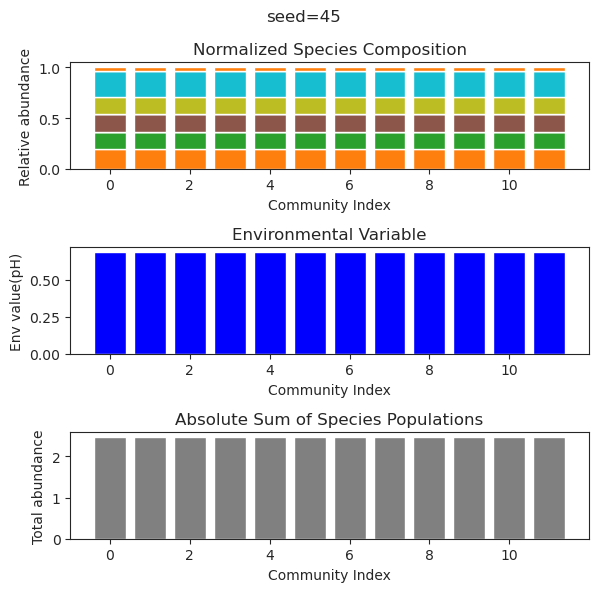

{'species': array([-1.87708845e-23,  1.19382825e+00, -5.78922941e-38,  1.11930832e+00,
       -3.19540435e-43, -6.98233769e-35,  3.10030038e-58,  1.54302227e-01,
        3.10925693e-36,  4.24257167e-22,  4.77086800e-01,  4.33303003e-45]), 'env': array([0.75934203])}
{'species': array([-2.67395377e-24,  1.19382825e+00,  7.35576635e-46,  1.11930832e+00,
        5.44589087e-53, -4.90852713e-40,  2.10552695e-82,  1.54302227e-01,
        8.01241539e-38,  1.52681071e-23,  4.77086800e-01, -8.47788870e-58]), 'env': array([0.75934203])}
{'species': array([ 1.15698972e-27,  1.19382825e+00,  4.61384168e-37,  1.11930832e+00,
        1.06891798e-45,  3.78262052e-33,  9.52936706e-65,  1.54302227e-01,
       -3.21473321e-40, -5.29966302e-21,  4.77086800e-01,  6.60978653e-52]), 'env': array([0.75934203])}
{'species': array([ 1.09428471e-20,  1.19382825e+00,  3.38029943e-40,  1.11930832e+00,
       -2.77510780e-55,  2.90947659e-36,  3.67918898e-83,  1.54302227e-01,
        1.07719426e-41,  2.46193011e-

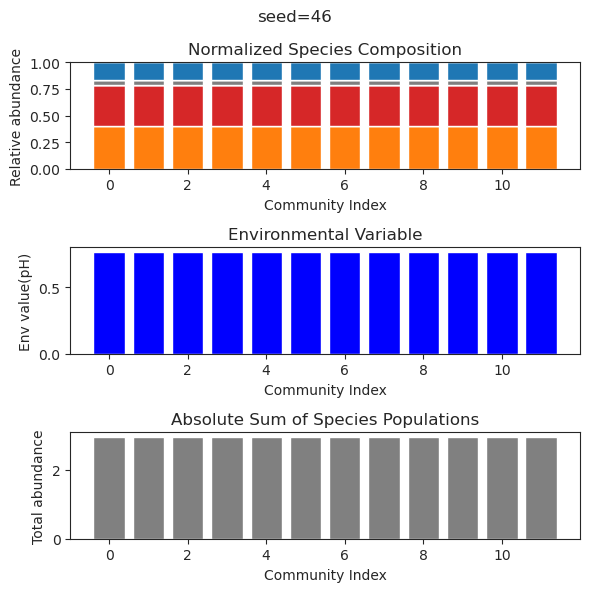

{'species': array([ 4.53218469e-44,  3.15841937e-22,  5.69313311e-50, -3.85988873e-39,
        1.00567284e-26,  1.09143169e+00,  6.99356596e-01,  2.29110787e-45,
        5.89393330e-01, -4.95134437e-56,  1.54076053e-62,  3.48546919e-02]), 'env': array([0.90490829])}
{'species': array([ 4.70343916e-44,  5.20497751e-23, -1.55138673e-42,  3.58557089e-36,
       -2.21869974e-24,  1.09143169e+00,  6.99356596e-01,  4.18833326e-44,
        5.89393330e-01, -8.77386261e-58, -2.23244901e-59,  3.48546919e-02]), 'env': array([0.90490829])}
{'species': array([-3.38935001e-59, -3.90722483e-25,  4.14562784e-61, -4.74616798e-39,
        1.35514642e-29,  1.09143169e+00,  6.99356596e-01,  7.98257237e-55,
        5.89393330e-01,  7.65572567e-82,  4.09234638e-89,  3.48546919e-02]), 'env': array([0.90490829])}
{'species': array([ 8.15809674e-41, -2.61764583e-22, -8.31833786e-59, -8.78767881e-39,
       -1.86677529e-24,  1.09143169e+00,  6.99356596e-01,  8.31520170e-53,
        5.89393330e-01, -1.86585806e-

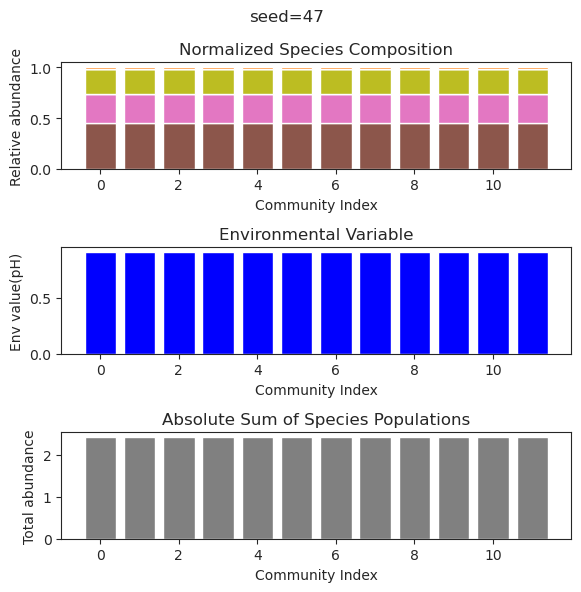

{'species': array([ 1.33796095e-082,  1.38157623e+000,  2.62337781e-073,
       -3.89104624e-031,  3.19147450e-101,  1.12573200e+000,
        2.37402288e-029,  1.58881152e+000, -5.01640265e-089,
        3.66469745e-001, -4.19808460e-106, -1.43946931e-060]), 'env': array([1.71366052])}
{'species': array([-5.72631825e-48,  1.38157623e+00,  1.07247880e-45,  4.89603141e-29,
       -4.42757111e-54,  1.12573200e+00,  1.51626429e-26,  1.58881152e+00,
       -8.64573181e-51,  3.66469745e-01, -3.16529525e-55,  2.21329505e-41]), 'env': array([1.71366052])}
{'species': array([ 4.77839012e-60,  1.38157623e+00,  2.38470888e-55,  1.42647105e-28,
       -1.94815722e-68,  1.12573200e+00,  6.56828062e-32,  1.58881152e+00,
        1.62234879e-65,  3.66469745e-01,  1.63925358e-76,  3.70831752e-49]), 'env': array([1.71366052])}
{'species': array([-1.26425769e-63,  1.38157623e+00, -1.04816893e-60, -7.27871074e-31,
        2.08602205e-70,  1.12573200e+00, -4.77785832e-32,  1.58881152e+00,
        4.26481144

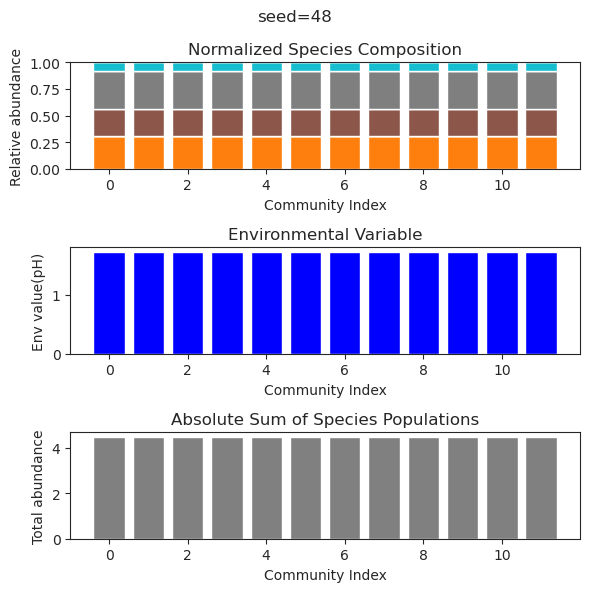

{'species': array([-1.20507135e-37,  2.04781316e-01,  2.91916601e-58,  4.68215796e-25,
       -4.57500050e-28,  2.06562156e-16,  3.37785401e-62, -3.80386217e-53,
       -7.18547644e-27,  1.70941131e-01,  7.75346373e-46,  1.35689564e+00]), 'env': array([0.55215777])}
{'species': array([-1.23409648e-45,  2.04781316e-01, -8.84447289e-87,  4.69766854e-28,
        5.72114874e-32,  1.78951278e-16, -8.11329335e-91, -5.42939168e-81,
       -5.48048499e-27,  1.70941131e-01, -1.58609755e-60,  1.35689564e+00]), 'env': array([0.55215777])}
{'species': array([-1.03906790e-36,  2.04781316e-01, -1.03589571e-52, -9.35407072e-22,
       -3.22505007e-27,  1.17516807e-20,  1.62871858e-55, -9.04397650e-48,
        7.38086278e-29,  1.70941131e-01, -1.38135077e-41,  1.35689564e+00]), 'env': array([0.55215777])}
{'species': array([-2.65624343e-44,  2.04781316e-01,  3.96325755e-68, -1.04466773e-22,
        1.27968333e-31, -7.20636387e-17,  1.73542124e-73, -1.40474356e-60,
       -1.09717686e-24,  1.70941131e-

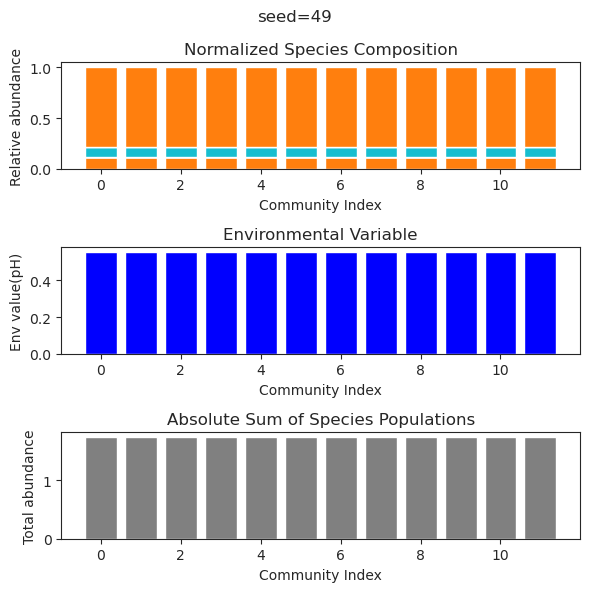

{'species': array([ 3.23620077e-02,  5.97888211e-01,  1.70893169e-25, -1.56203832e-32,
       -8.32230064e-36,  2.44339352e-01,  7.10904177e-01,  8.90809586e-68,
       -2.14390242e-37,  1.00318932e-86,  4.26249358e-02,  3.75145842e-01]), 'env': array([0.57889468])}
{'species': array([ 3.23620077e-002,  5.97888211e-001, -9.43359731e-033,
        4.69563568e-039,  4.57093171e-041,  2.44339352e-001,
        7.10904177e-001,  1.24414233e-072, -5.01694793e-043,
       -1.86203098e-101,  4.26249358e-002,  3.75145842e-001]), 'env': array([0.57889468])}
{'species': array([ 3.23620077e-02,  5.97888211e-01, -1.24468240e-27, -1.20393405e-31,
        1.18018441e-33,  2.44339352e-01,  7.10904177e-01,  1.79984370e-50,
        2.66732665e-32, -1.45914650e-62,  4.26249358e-02,  3.75145842e-01]), 'env': array([0.57889468])}
{'species': array([ 3.23620077e-02,  5.97888211e-01, -1.21210196e-26,  2.01182835e-33,
        6.46658026e-39,  2.44339352e-01,  7.10904177e-01, -1.85157284e-71,
       -5.40418812

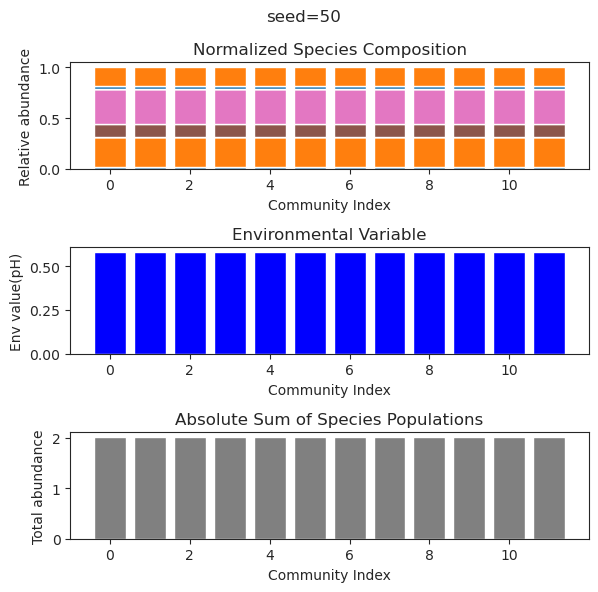

{'species': array([ 1.64536904e-67,  1.01309285e+00, -7.99227854e-50, -2.67666328e-65,
        5.60789007e-01,  8.51781723e-01,  7.31135458e-01, -5.56602704e-46,
        1.75376775e-23, -5.76708378e-56,  3.64862556e-12, -5.79325572e-67]), 'env': array([0.77101101])}
{'species': array([ 3.23660639e-38,  1.01309285e+00, -6.59549620e-56, -3.31365519e-41,
        5.60789007e-01,  8.51781723e-01,  7.31135458e-01, -4.33897078e-54,
       -3.77959460e-21, -1.50870710e-61,  4.20321892e-12, -1.90370518e-78]), 'env': array([0.77101101])}
{'species': array([-1.97462102e-75,  1.01309285e+00,  3.73756108e-55, -3.75954130e-71,
        5.60789007e-01,  8.51781723e-01,  7.31135458e-01,  1.79219368e-54,
        5.89407052e-24,  6.35101417e-62,  3.91791781e-12,  4.35900365e-75]), 'env': array([0.77101101])}
{'species': array([-1.57751599e-77,  1.01309285e+00, -3.10127152e-52,  5.54462902e-73,
        5.60789007e-01,  8.51781723e-01,  7.31135458e-01, -3.08720881e-49,
        1.66520864e-30,  1.85321765e-

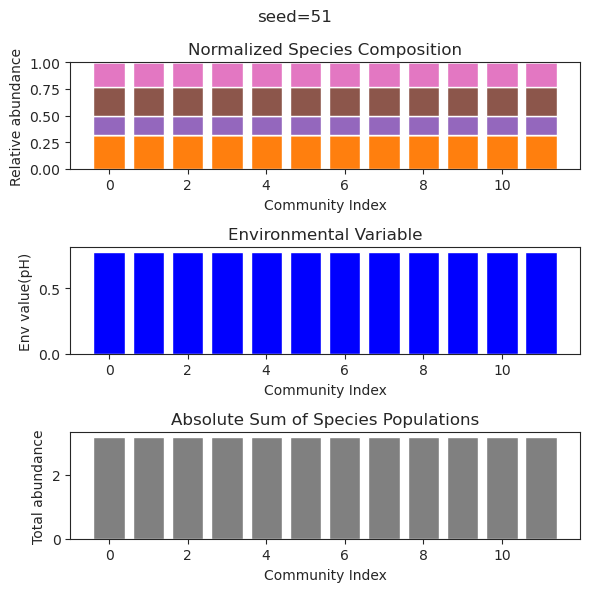

{'species': array([-1.43708298e-32,  5.34401545e-01, -3.08500918e-26, -1.13468746e-38,
        5.37149426e-01,  1.55038961e-29,  3.99305415e-38,  1.67991269e-34,
       -1.09885154e-25,  1.02985134e+00,  7.20145520e-25, -1.24484638e-37]), 'env': array([0.59059147])}
{'species': array([ 8.95277458e-52,  5.34401545e-01, -4.41094221e-25, -2.86400514e-54,
        5.37149426e-01,  3.46623455e-38, -3.80125657e-42,  3.33558160e-49,
        8.82821857e-31,  1.02985134e+00,  9.91772394e-29, -9.98901952e-45]), 'env': array([0.59059147])}
{'species': array([-2.29937099e-51,  5.34401545e-01, -5.15202122e-21, -1.07853983e-56,
        5.37149426e-01, -1.92728131e-38,  3.34297182e-41,  1.72191216e-49,
        5.38203759e-30,  1.02985134e+00,  1.15181388e-26, -4.96079435e-44]), 'env': array([0.59059147])}
{'species': array([-1.37092439e-56,  5.34401545e-01,  1.09480062e-24, -1.67940958e-60,
        5.37149426e-01,  9.79133227e-42,  9.60011031e-44, -1.95257539e-50,
        1.82065533e-34,  1.02985134e+

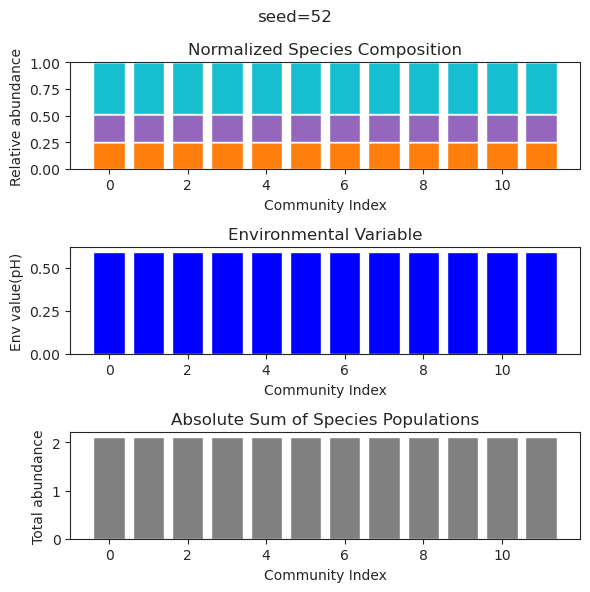

{'species': array([ 2.35691008e-01,  2.03374068e-92,  3.73594383e-49, -9.68717036e-75,
       -8.52543603e-32,  4.14702864e-66,  3.43855399e-02,  9.15977337e-01,
        3.79688096e-01, -4.64941813e-44,  1.17442739e-01,  4.20658982e-52]), 'env': array([0.3599287])}
{'species': array([ 2.35691008e-001, -7.15738086e-102, -9.82369695e-054,
       -3.26907765e-087,  2.32941732e-035,  1.25830679e-072,
        3.43855399e-002,  9.15977337e-001,  3.79688096e-001,
        5.99503464e-055,  1.17442739e-001,  2.20852120e-059]), 'env': array([0.3599287])}
{'species': array([ 2.35691008e-01,  1.13866573e-74, -5.00339491e-37, -2.36423422e-59,
        9.84474893e-31,  1.31357041e-49,  3.43855399e-02,  9.15977337e-01,
        3.79688096e-01, -5.06432928e-45,  1.17442739e-01, -6.94540084e-44]), 'env': array([0.3599287])}
{'species': array([ 2.35691008e-001, -6.95947378e-102, -2.00992487e-051,
        3.11300952e-081,  6.79020255e-033,  2.72741257e-070,
        3.43855399e-002,  9.15977337e-001,  3.796

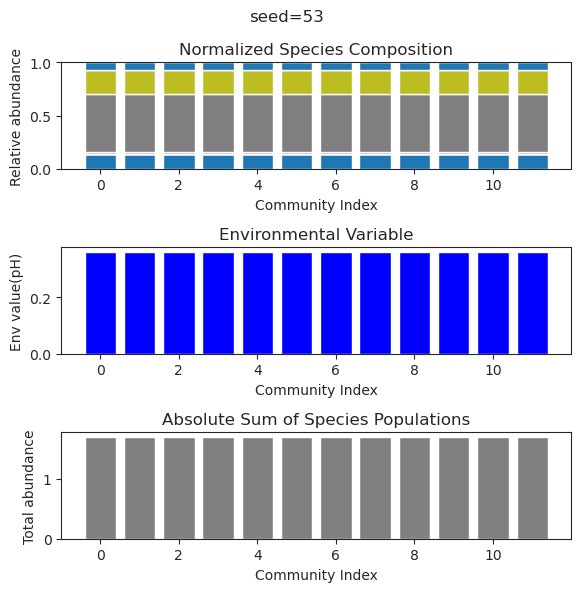

{'species': array([ 1.52415945e-45,  1.73269944e-24,  2.69312228e-01,  4.06808989e-01,
        2.72367469e-80, -7.75822622e-34,  8.25629885e-01,  8.82233450e-02,
        5.19798359e-01,  1.53357348e-27,  6.72626485e-01, -7.53880760e-32]), 'env': array([0.85307147])}
{'species': array([ 1.99941975e-35, -4.85034983e-18,  2.69312228e-01,  4.06808989e-01,
        2.09699067e-27,  3.12303480e-30,  8.25629885e-01,  8.82233450e-02,
        5.19798359e-01,  4.56820620e-25,  6.72626485e-01, -7.92043274e-30]), 'env': array([0.85307147])}
{'species': array([ 1.41280204e-80, -4.32182736e-24,  2.69312228e-01,  4.06808989e-01,
        1.54859612e-96,  7.92627178e-33,  8.25629885e-01,  8.82233450e-02,
        5.19798359e-01,  1.54824364e-24,  6.72626485e-01, -7.22580077e-28]), 'env': array([0.85307147])}
{'species': array([-3.37469827e-72,  7.79081230e-25,  2.69312228e-01,  4.06808989e-01,
       -1.60764508e-37,  2.25704799e-34,  8.25629885e-01,  8.82233450e-02,
        5.19798359e-01,  5.10690877e-

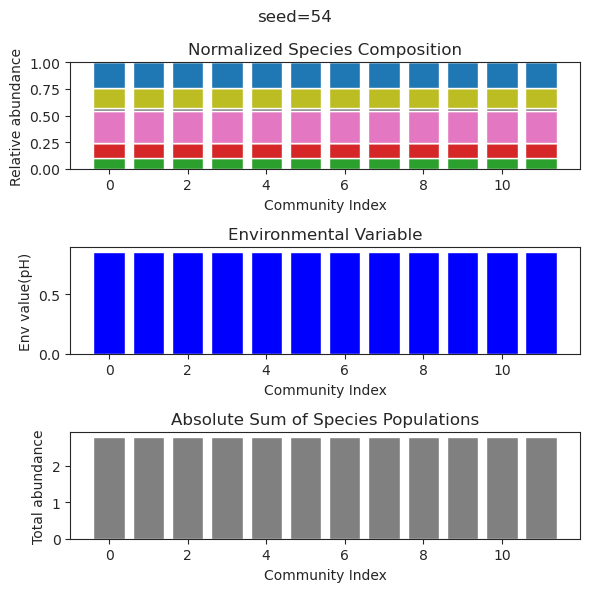

{'species': array([ 1.78374380e-001,  2.78662360e-069, -6.30760130e-025,
        8.22694857e-001,  5.05175565e-090,  2.29117622e-001,
        1.03347572e-037,  7.68589949e-039,  6.12851333e-001,
        1.04322897e-001, -1.42441284e-113,  1.53047923e-087]), 'env': array([0.32492925])}
{'species': array([ 6.13630369e-36,  7.50964134e-69,  3.03288749e-02,  3.65961347e-01,
       -2.84662477e-56,  6.59523622e-01,  2.85432654e-01, -3.78600392e-23,
        7.46397430e-17,  5.46311171e-01,  2.48427363e-59, -3.54010180e-60]), 'env': array([0.19130572])}
{'species': array([ 1.78374380e-01,  9.86261146e-35,  3.04401895e-25,  8.22694857e-01,
       -2.54083653e-62,  2.29117622e-01, -2.97228501e-27, -1.61280169e-27,
        6.12851333e-01,  1.04322897e-01, -8.10021996e-64, -1.07305423e-61]), 'env': array([0.32492925])}
{'species': array([ 1.78374380e-001,  2.49601358e-050,  2.87699225e-027,
        8.22694857e-001, -5.48959230e-074,  2.29117622e-001,
       -6.15154263e-039, -5.37470032e-038,  6.

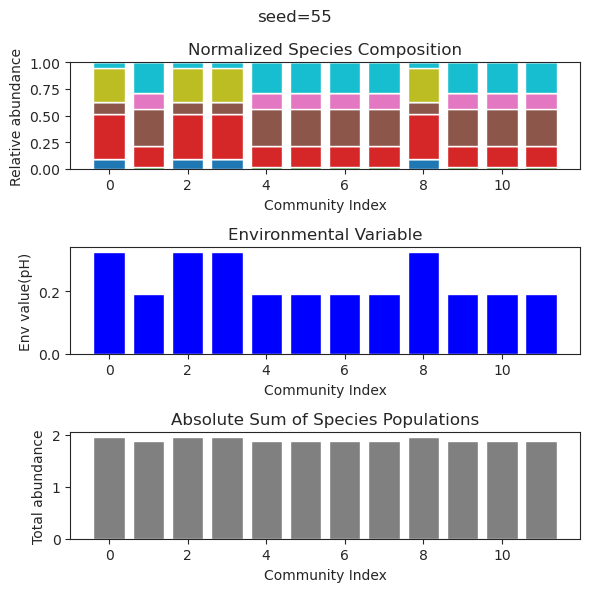

{'species': array([ 6.46240659e-02, -1.15589607e-23,  1.82912822e-59, -9.75274560e-48,
        6.62948776e-01,  2.23627408e-27, -7.92634755e-41, -1.36240345e-63,
        1.16093442e-60,  7.53430166e-01,  1.17675648e-01,  1.77280238e-59]), 'env': array([0.50156422])}
{'species': array([ 6.46240659e-02, -1.29590678e-17, -2.50639697e-43,  5.54753630e-44,
        6.62948776e-01, -9.91418254e-26,  1.57562022e-38,  1.82277596e-53,
       -7.25448361e-51,  7.53430166e-01,  1.17675648e-01, -9.32174062e-48]), 'env': array([0.50156422])}
{'species': array([ 6.46240659e-02, -3.50297988e-23,  3.01742295e-52,  1.19896794e-59,
        6.62948776e-01,  2.10257184e-27,  3.03785057e-41,  4.84300007e-61,
        1.75941685e-59,  7.53430166e-01,  1.17675648e-01, -1.61676718e-59]), 'env': array([0.50156422])}
{'species': array([ 6.46240659e-02, -3.06511696e-19, -6.80317626e-58,  4.36039966e-59,
        6.62948776e-01,  1.06697222e-23,  2.85445035e-34,  8.55899363e-60,
       -6.09554965e-54,  7.53430166e-

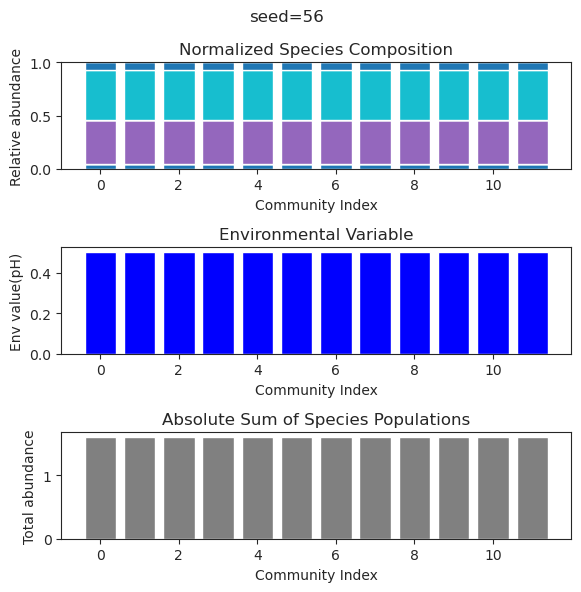

{'species': array([ 8.71196458e-01,  2.04710369e-40,  3.98699444e-01,  2.52936402e-01,
       -6.24025713e-64,  3.53363302e-01, -4.54926227e-16, -5.33969430e-72,
        3.07093999e-31, -9.90776887e-91,  9.49009470e-01, -2.04478133e-63]), 'env': array([0.8040194])}
{'species': array([ 8.71196458e-01,  1.88607870e-39,  3.98699444e-01,  2.52936402e-01,
       -5.54905481e-66,  3.53363302e-01,  5.56516643e-21,  2.41056081e-73,
       -4.46240447e-28,  2.81723120e-89,  9.49009470e-01, -1.45834758e-67]), 'env': array([0.8040194])}
{'species': array([ 8.71196458e-01, -2.41971191e-41,  3.98699444e-01,  2.52936402e-01,
        1.53574102e-63,  3.53363302e-01,  4.86326573e-20, -2.91083957e-79,
        5.95268620e-28, -1.04522982e-91,  9.49009470e-01, -5.48861530e-64]), 'env': array([0.8040194])}
{'species': array([ 8.71196458e-01,  1.87363944e-31,  3.98699444e-01,  2.52936402e-01,
        2.22858537e-59,  3.53363302e-01, -4.85346142e-17,  6.39972858e-63,
       -8.37942691e-25,  1.56548702e-81,

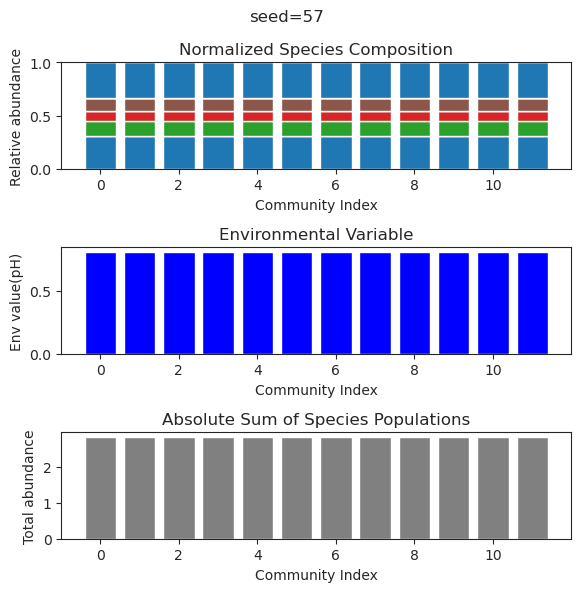

{'species': array([ 4.85637194e-20,  3.16198935e-01,  9.42277985e-01, -5.51163850e-34,
        5.82251189e-52, -2.50558660e-37,  8.58262090e-42, -5.55269323e-27,
        1.44108013e+00, -9.82577124e-55,  1.83880525e-38,  2.72213645e-42]), 'env': array([0.80492152])}
{'species': array([-8.85877453e-23,  3.16198935e-01,  9.42277985e-01,  2.46991984e-35,
       -6.80245523e-43,  5.29332170e-41,  6.37534134e-45,  5.84844353e-26,
        1.44108013e+00,  2.55082160e-51, -8.81306259e-30,  9.08497324e-33]), 'env': array([0.80492152])}
{'species': array([ 1.06249300e-21,  3.16198935e-01,  9.42277985e-01, -5.32044782e-43,
        1.87299492e-59,  7.72996656e-57,  9.27850454e-64,  1.87096249e-23,
        1.44108013e+00, -2.02425518e-79, -6.93746544e-41, -5.48517060e-46]), 'env': array([0.80492152])}
{'species': array([ 2.96069312e-23,  3.16198935e-01,  9.42277985e-01,  3.29716450e-34,
       -4.11437782e-45, -1.81910762e-41,  1.38080125e-43,  1.38576134e-24,
        1.44108013e+00, -1.02800824e-

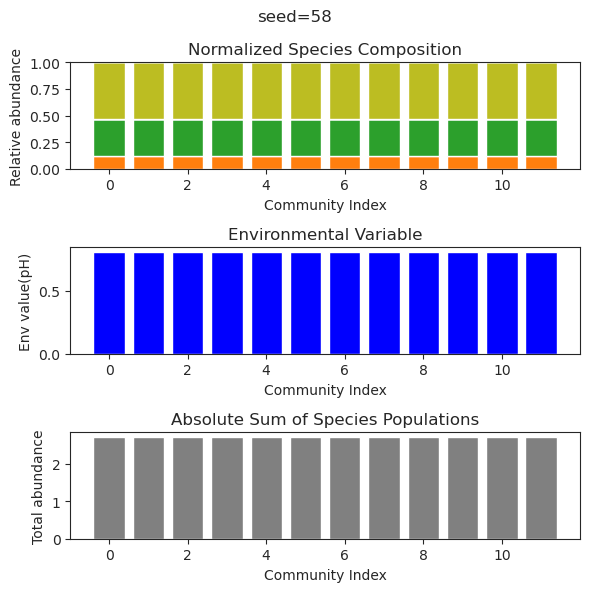

{'species': array([-1.24848748e-55, -1.78831573e-50,  4.65520419e-32, -4.17490050e-28,
       -1.39695831e-50,  6.45305389e-39,  1.23669397e+00,  7.36800263e-33,
        5.33543541e-01,  1.21951466e-52, -2.09487210e-48,  1.05445691e+00]), 'env': array([1.00795232])}
{'species': array([-6.74460141e-73, -3.80727042e-72, -2.31818074e-25, -1.94879030e-25,
       -5.91602397e-66,  1.05435339e-38,  1.23669397e+00, -1.37161242e-33,
        5.33543541e-01, -1.28997922e-68,  9.79010415e-55,  1.05445691e+00]), 'env': array([1.00795232])}
{'species': array([-3.73714922e-81, -3.67946467e-77, -5.31847301e-37,  7.77582827e-36,
       -1.31325990e-67,  1.28168240e-44,  1.23669397e+00, -2.60999790e-41,
        5.33543541e-01, -8.70873669e-72, -2.08278607e-62,  1.05445691e+00]), 'env': array([1.00795232])}
{'species': array([ 7.35277760e-93, -3.18081591e-88, -4.52700853e-37, -6.39456463e-34,
       -1.41870932e-74,  4.88591162e-46,  1.23669397e+00, -4.69847460e-46,
        5.33543541e-01, -4.48617319e-

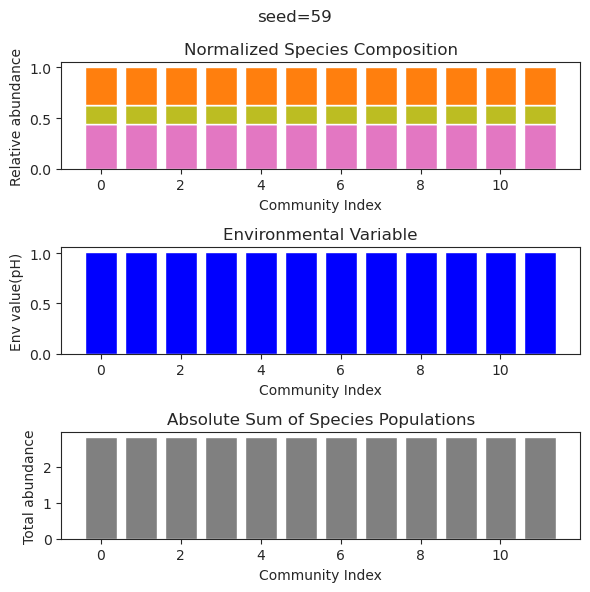

{'species': array([-2.07610771e-57, -1.42839892e-41,  1.19493428e+00,  6.78316854e-16,
        2.45695923e-51,  1.66593490e-27,  2.89465247e-50,  1.16314705e-28,
        1.23853457e-52,  1.90517232e+00,  7.62426392e-59, -3.82233264e-52]), 'env': array([1.29425297])}
{'species': array([ 2.67935056e-43, -5.90571345e-51,  1.19493428e+00,  2.71974396e-15,
        6.81075494e-69,  8.75310538e-75, -6.87254118e-53,  5.43897477e-30,
       -5.41026934e-39,  1.90517232e+00, -2.61098556e-68, -3.42704954e-66]), 'env': array([1.29425297])}
{'species': array([ 9.12819783e-68, -7.15351757e-54,  1.19493428e+00,  3.58802257e-14,
        1.17664353e-63,  1.77342805e-71, -7.94890201e-56, -8.37176960e-31,
        2.59064157e-67,  1.90517232e+00, -3.51661472e-69, -3.48322473e-61]), 'env': array([1.29425297])}
{'species': array([ 1.34190250e-38,  1.00129767e-48,  1.19493428e+00,  1.36222595e-14,
        3.24606557e-64,  1.58781305e-65,  4.73188834e-54,  7.79764832e-31,
       -7.47300983e-66,  1.90517232e+

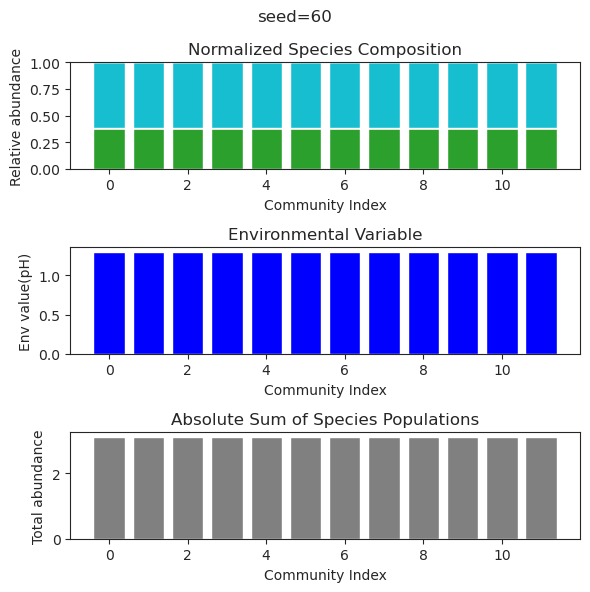

{'species': array([-1.45895127e-074,  1.89048732e-069,  2.97901696e-145,
        9.69336489e-014,  2.76379016e-125,  1.03736139e-028,
        4.85334955e-089,  7.51611255e-001,  1.17404600e+000,
        4.17121424e-001,  3.90426424e-026,  7.72901962e-084]), 'env': array([0.9212148])}
{'species': array([ 4.57472972e-034,  2.81104659e-050, -2.07306587e-128,
       -2.00728150e-014, -2.79488353e-115,  1.81822903e-026,
        3.81247854e-080,  7.51611255e-001,  1.17404600e+000,
        4.17121424e-001, -2.39021693e-026,  7.73141382e-077]), 'env': array([0.9212148])}
{'species': array([ 3.11869351e-51,  6.85567226e-48,  6.05705106e-66,  3.58476435e-13,
        1.25385248e-59, -2.92678975e-30,  5.76627866e-63,  7.51611255e-01,
        1.17404600e+00,  4.17121424e-01, -5.05111350e-23, -1.06863066e-62]), 'env': array([0.9212148])}
{'species': array([-5.44233318e-32, -2.86940004e-43,  1.28393231e-68, -1.24226640e-14,
       -3.02312413e-62,  2.62542822e-28,  7.73988243e-63,  7.51611255e-01,
  

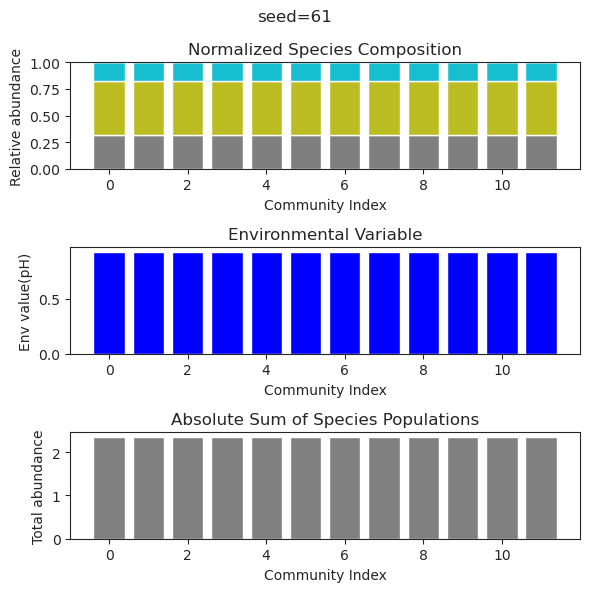

{'species': array([ 8.22697362e-096,  1.22277160e-070,  1.90913545e-027,
        1.59133407e-069,  6.66708606e-001,  4.76845080e-001,
        3.76426215e-064,  3.28121891e-001,  4.13121464e-002,
        5.09510837e-001,  8.83343786e-101, -3.16455856e-040]), 'env': array([0.43776014])}
{'species': array([-1.21988817e-80, -1.61900269e-39, -1.95374116e-26,  3.93739447e-57,
        6.66708606e-01,  4.76845080e-01, -4.70223462e-50,  3.28121891e-01,
        4.13121464e-02,  5.09510837e-01,  2.19390667e-74, -4.11166661e-39]), 'env': array([0.43776014])}
{'species': array([ 4.22128029e-134, -1.32600793e-091,  6.83870219e-032,
       -1.27795854e-094,  6.66708606e-001,  4.76845080e-001,
       -3.34912521e-081,  3.28121891e-001,  4.13121464e-002,
        5.09510837e-001,  2.11381425e-136, -3.70209396e-051]), 'env': array([0.43776014])}
{'species': array([ 2.35566652e-85, -1.37204561e-57, -5.66022085e-26, -6.38654620e-57,
        6.66708606e-01,  4.76845080e-01, -8.13325299e-54,  3.28121891e-01,

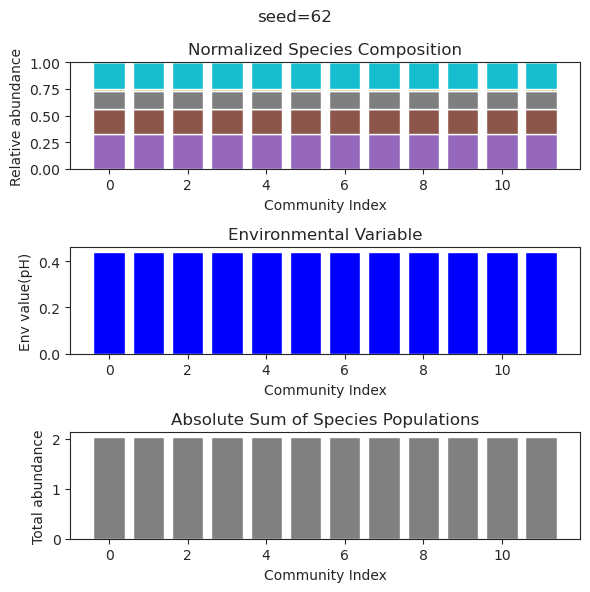

{'species': array([ 7.99681003e-45,  4.66971947e-26,  8.09294225e-01, -9.24010065e-67,
        9.90430025e-64,  5.21132212e-65,  9.56313204e-78,  9.68458954e-17,
        1.17220186e+00, -9.58735501e-51,  2.86548521e-34, -4.48323536e-59]), 'env': array([0.44312432])}
{'species': array([ 1.14827051e-38,  1.62778194e-22,  8.09294225e-01,  9.82494802e-59,
        1.77398622e-55,  1.75920345e-55,  7.22360452e-67,  3.91479882e-14,
        1.17220186e+00, -8.06084804e-48,  1.11292455e-28,  3.38125100e-54]), 'env': array([0.44312432])}
{'species': array([-1.66105765e-39,  1.81937709e-26,  8.09294225e-01,  7.28455470e-60,
        2.59986109e-52, -2.16970636e-54, -7.33759591e-67,  6.35554258e-15,
        1.17220186e+00,  1.96044370e-48, -4.99596899e-32, -3.74751396e-56]), 'env': array([0.44312432])}
{'species': array([ 6.66142138e-50, -5.47760903e-30,  8.09294225e-01, -1.31999062e-70,
       -4.94739423e-66, -4.18526665e-66, -4.49055019e-79, -1.21541634e-16,
        1.17220186e+00,  6.68126687e-

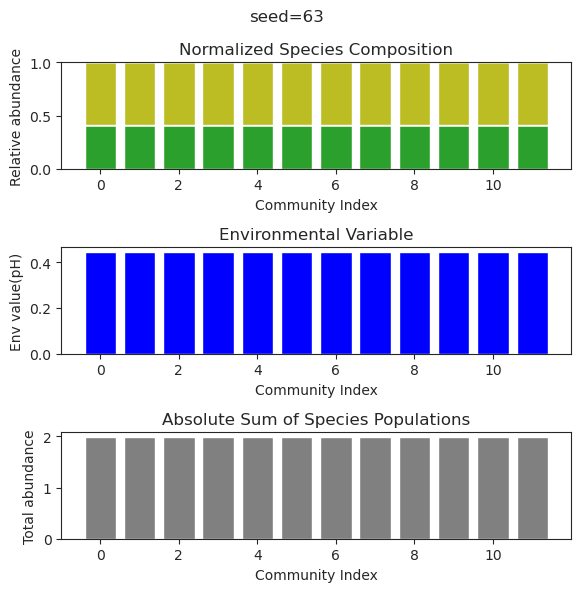

{'species': array([-5.77409176e-55,  8.19320283e-01,  4.16069143e-01, -3.05141117e-44,
        1.92720120e-50,  2.85859227e-01,  5.61610792e-01,  4.03306369e-40,
       -1.43103225e-41,  2.82841104e-01,  6.38607888e-28, -1.55203783e-32]), 'env': array([0.42859135])}
{'species': array([-8.68868507e-42,  8.19320283e-01,  4.16069143e-01, -2.29525764e-27,
       -6.15028926e-37,  2.85859227e-01,  5.61610792e-01,  1.00559467e-25,
        2.09301657e-31,  2.82841104e-01,  1.48839356e-21,  5.75796048e-23]), 'env': array([0.42859135])}
{'species': array([-1.62862436e-38,  8.19320283e-01,  4.16069143e-01,  1.07254561e-27,
        9.90018012e-34,  2.85859227e-01,  5.61610792e-01, -6.51116370e-27,
        1.23561852e-31,  2.82841104e-01,  8.39153740e-21, -4.68095206e-23]), 'env': array([0.42859135])}
{'species': array([ 1.12324258e-45,  8.19320283e-01,  4.16069143e-01,  7.81949955e-31,
        9.92047881e-41,  2.85859227e-01,  5.61610792e-01, -2.14029545e-31,
        1.24193725e-33,  2.82841104e-

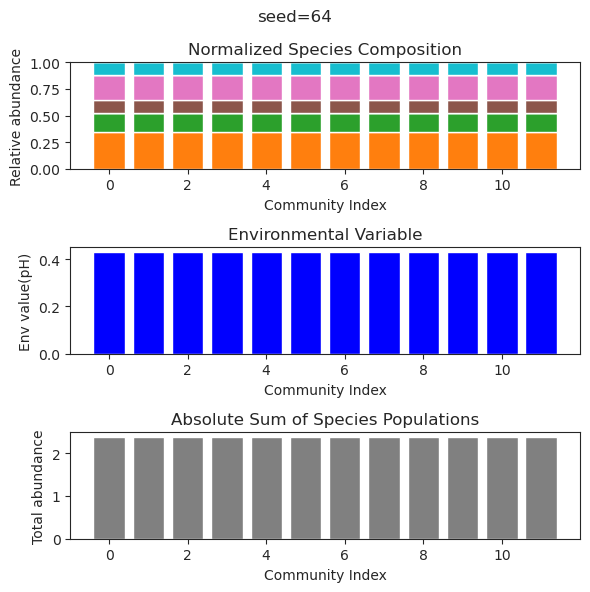

{'species': array([-8.94274951e-017,  9.14642123e-104,  3.33107498e-027,
       -4.98324135e-022,  4.25641560e-001,  1.19997867e+000,
        7.80750107e-002,  2.85970077e-001, -2.73180953e-055,
        5.42393490e-023,  7.34690381e-063, -6.65316679e-107]), 'env': array([0.64579377])}
{'species': array([-1.08952562e-16,  2.61636547e-42,  3.07718569e-33, -5.45479208e-21,
        4.25641560e-01,  1.19997867e+00,  7.80750107e-02,  2.85970077e-01,
        3.80438872e-53,  2.19833303e-30,  2.91974132e-56, -2.76395522e-76]), 'env': array([0.64579377])}
{'species': array([ 3.37603953e-016, -8.31401654e-108,  6.16860605e-025,
        2.42809109e-019,  4.25641560e-001,  1.19997867e+000,
        7.80750107e-002,  2.85970077e-001, -9.30576381e-058,
       -1.84502119e-026,  3.08413181e-068,  1.36444848e-115]), 'env': array([0.64579377])}
{'species': array([ 5.46948957e-17, -4.32976885e-65,  4.55510532e-26,  6.22134728e-18,
        4.25641560e-01,  1.19997867e+00,  7.80750107e-02,  2.85970077e-01,

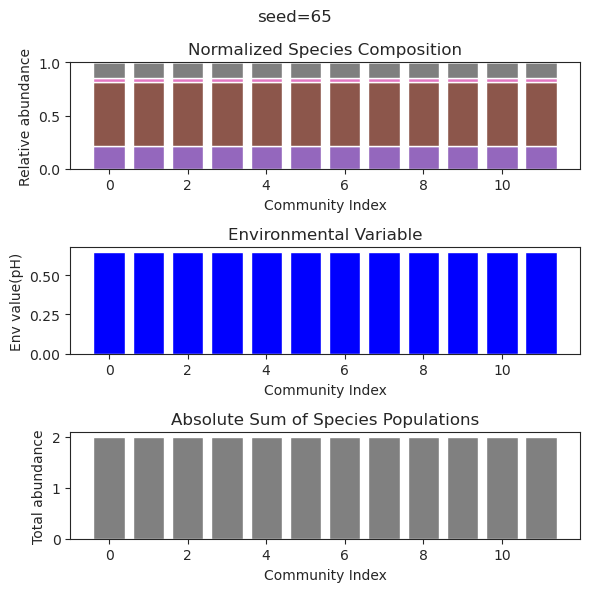

{'species': array([ 1.45139127e-23, -3.19898443e-44,  8.97753297e-01,  1.36990734e+00,
        1.81983613e-01, -1.05282930e-32,  3.22046217e-22, -2.01465922e-23,
       -1.65474704e-27,  1.96362537e-22, -2.69668132e-18, -6.43958307e-31]), 'env': array([0.74221865])}
{'species': array([-1.68542292e-25,  2.38912467e-49,  8.97753297e-01,  1.36990734e+00,
        1.81983613e-01,  4.18829753e-38, -3.95124077e-24, -6.78237460e-33,
       -2.89635742e-31, -7.73190894e-26,  9.85024813e-19,  2.82434432e-37]), 'env': array([0.74221865])}
{'species': array([ 2.18395917e-26, -2.58539276e-82,  8.97753297e-01,  1.36990734e+00,
        1.81983613e-01, -1.44595698e-48,  1.05848217e-23,  2.02555261e-33,
       -6.83958411e-31, -1.18255406e-23,  2.08584537e-19, -3.80530672e-53]), 'env': array([0.74221865])}
{'species': array([-6.26955171e-30, -1.48869801e-65,  8.97753297e-01,  1.36990734e+00,
        1.81983613e-01, -2.21423374e-44, -1.70622749e-28, -1.59071812e-35,
        1.46644459e-33, -9.44270116e-

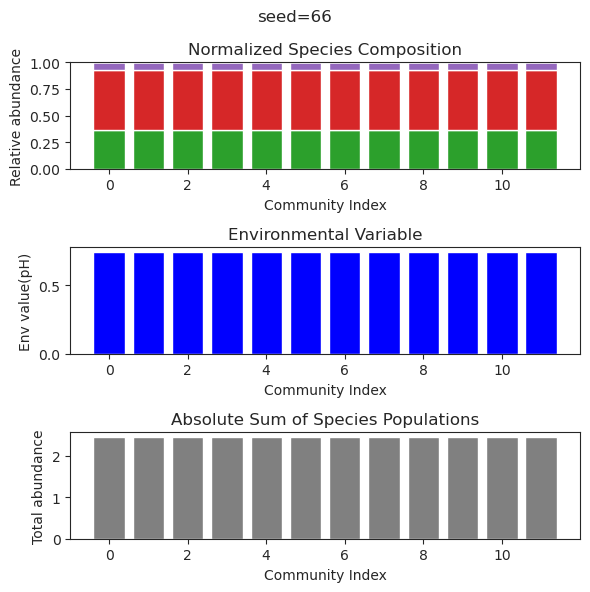

{'species': array([ 2.53692682e-82,  1.77538046e+00,  3.63596803e-70, -1.32292954e-66,
        1.07182762e-28,  3.11048550e-01,  3.28235084e-01,  1.05451683e+00,
       -4.29270217e-74,  5.21259086e-99, -6.27015522e-48, -1.97823717e-69]), 'env': array([1.483654])}
{'species': array([ 7.50885282e-77,  1.77538046e+00, -1.87174302e-73,  2.79410791e-61,
        2.38396085e-23,  3.11048550e-01,  3.28235084e-01,  1.05451683e+00,
        5.70964785e-68, -3.01211818e-93,  1.29113278e-47,  1.60254104e-62]), 'env': array([1.483654])}
{'species': array([ 1.16851792e-76,  1.77538046e+00,  1.23421128e-67,  1.08005706e-63,
        1.02858495e-21,  3.11048550e-01,  3.28235084e-01,  1.05451683e+00,
        1.32004502e-70, -7.18699308e-90,  7.56305422e-45,  7.51731832e-65]), 'env': array([1.483654])}
{'species': array([-6.52888469e-79,  1.77538046e+00, -1.76699403e-69,  9.24274070e-65,
        6.10743399e-25,  3.11048550e-01,  3.28235084e-01,  1.05451683e+00,
       -1.88357975e-73,  1.82669872e-97,  3

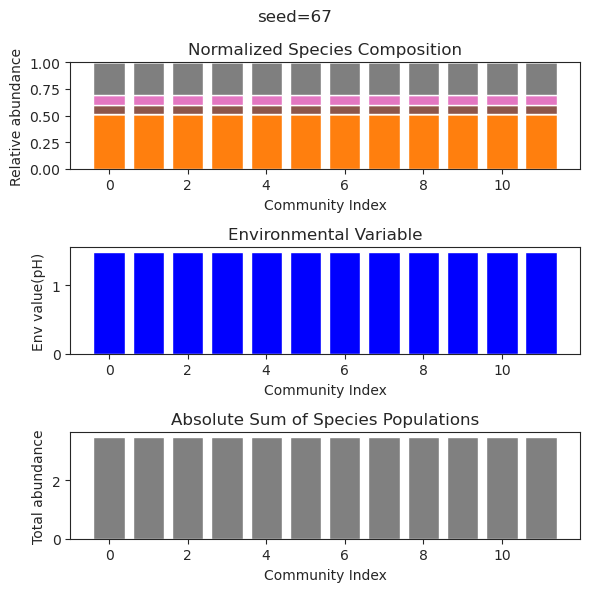

{'species': array([ 4.76590889e-43, -3.78676619e-69,  2.36286569e-01, -1.83894378e-71,
        1.06701554e-44,  1.36052336e-16,  4.95230890e-01,  6.15702474e-01,
       -1.60398639e-26, -3.84038068e-67, -2.42557808e-37,  4.58336382e-01]), 'env': array([0.6778273])}
{'species': array([ 6.61568336e-69,  1.64005335e-74,  2.36286569e-01, -2.04724287e-76,
       -4.13724251e-85,  5.40903965e-17,  4.95230890e-01,  6.15702474e-01,
        6.22353035e-25, -3.78763791e-73, -6.00627889e-36,  4.58336382e-01]), 'env': array([0.6778273])}
{'species': array([-2.62140372e-76, -1.22607598e-78,  2.36286569e-01, -2.45993530e-76,
       -7.14669801e-44,  1.51665198e-16,  4.95230890e-01,  6.15702474e-01,
       -4.39443957e-27, -3.33793686e-74, -4.41179200e-38,  4.58336382e-01]), 'env': array([0.6778273])}
{'species': array([-5.44652815e-71, -2.55926806e-77,  2.36286569e-01,  5.93610648e-85,
       -9.46047426e-90, -1.03087765e-18,  4.95230890e-01,  6.15702474e-01,
        1.16466601e-23,  7.72393070e-79,

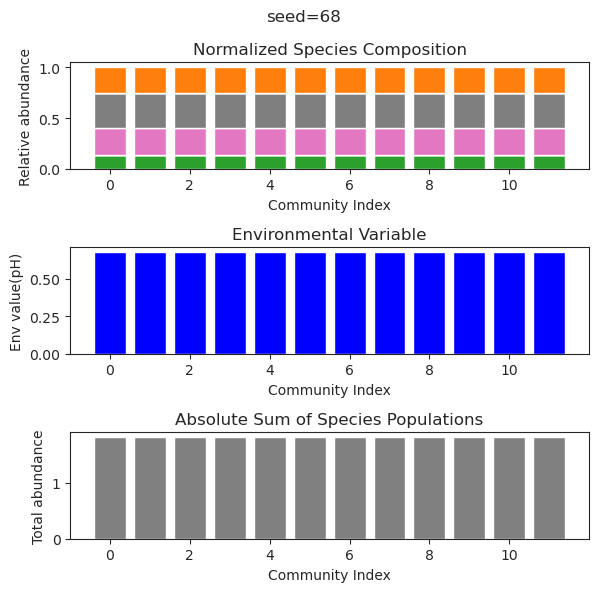

{'species': array([ 3.07839238e-36,  1.50986743e-42,  6.70966730e-27,  2.27883049e+00,
       -1.23552991e-30,  6.10055189e-29,  1.57208325e+00, -5.75737607e-39,
        2.61016332e-44,  4.28885150e-46,  1.25367898e+00, -1.68427610e-22]), 'env': array([1.80826596])}
{'species': array([ 1.30316267e-45,  2.06706560e-53, -1.88752144e-45,  2.27883049e+00,
        1.68898524e-38, -2.40825049e-37,  1.57208325e+00,  2.16296842e-44,
        6.79254467e-54, -1.31935997e-55,  1.25367898e+00,  3.33150990e-26]), 'env': array([1.80826596])}
{'species': array([ 8.53058204e-38, -1.11559953e-45, -7.71650166e-38,  2.27883049e+00,
       -5.18913670e-32, -4.26918510e-48,  1.57208325e+00, -2.66047087e-39,
       -2.27765914e-47,  1.16130024e-49,  1.25367898e+00, -3.10681776e-23]), 'env': array([1.80826596])}
{'species': array([-1.79649258e-43, -3.07803292e-50,  2.36276355e-33,  2.27883049e+00,
        8.53520419e-39,  2.63686932e-55,  1.57208325e+00,  3.84448517e-44,
        1.13304213e-51, -4.52160860e-

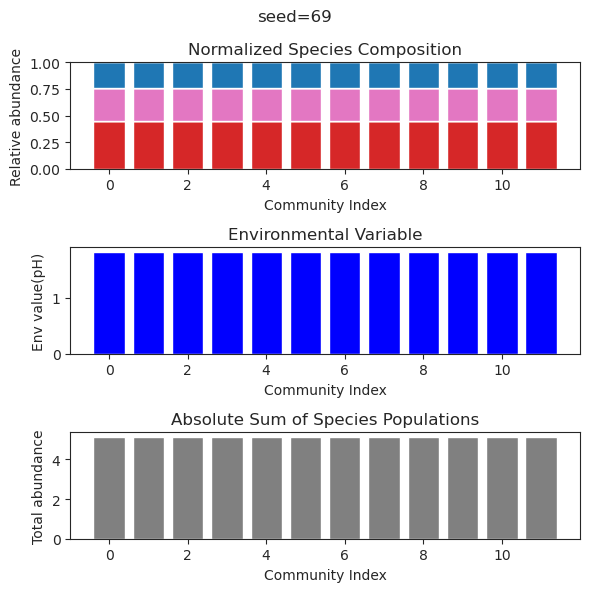

{'species': array([-5.59930694e-76,  1.33626061e+00,  9.39548645e-01,  1.48152409e-29,
        2.53844482e-67,  1.66890810e-70, -3.50302915e-61,  4.69706933e-01,
        1.68833944e-29, -1.51239812e-71,  6.36505649e-78,  1.15053934e-74]), 'env': array([0.85790777])}
{'species': array([ 7.61487451e-44,  1.33626061e+00,  9.39548645e-01,  5.68500973e-23,
       -3.98089114e-41,  6.40279154e-39,  1.67338681e-41,  4.69706933e-01,
       -1.97937621e-25,  5.84345416e-41, -5.97600546e-42, -6.00981859e-42]), 'env': array([0.85790777])}
{'species': array([ 2.23732968e-74,  1.33626061e+00,  9.39548645e-01,  3.14665098e-25,
       -8.17383628e-62,  7.02249466e-66, -1.78481539e-58,  4.69706933e-01,
       -2.85154298e-29,  3.14269244e-70, -1.28399875e-80,  4.32137564e-72]), 'env': array([0.85790777])}
{'species': array([ 7.09101184e-36,  1.33626061e+00,  9.39548645e-01,  6.52707812e-22,
        1.30195409e-38,  8.50278627e-35, -2.97314433e-37,  4.69706933e-01,
       -2.15329984e-22,  9.96309860e-

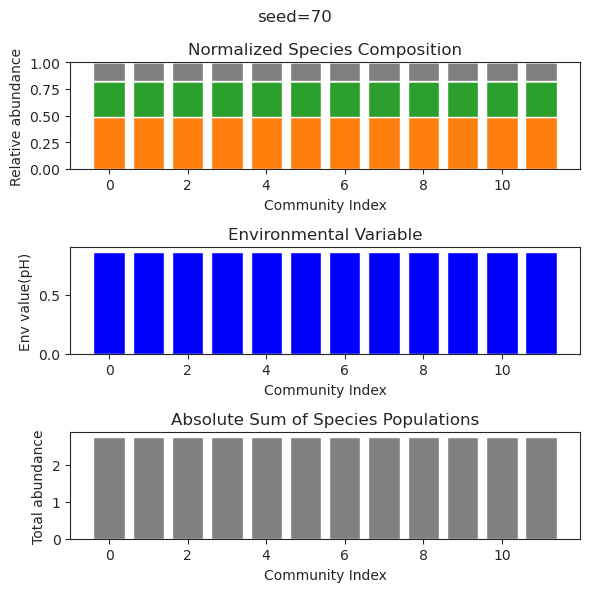

{'species': array([-9.50975735e-47, -7.21461453e-40, -3.14006612e-78, -2.49680901e-47,
        5.69027930e-01, -3.15186775e-74,  4.92638837e-01, -5.59852268e-66,
        1.29518524e-79, -2.55769742e-78,  9.85626405e-01,  1.19448710e-16]), 'env': array([0.42926539])}
{'species': array([ 3.80738124e-43, -2.51409110e-35, -3.14692882e-43, -7.52158306e-35,
        5.69027930e-01,  9.70893226e-59,  4.92638837e-01,  1.23618571e-51,
        3.79461608e-61, -1.95989166e-60,  9.85626405e-01,  3.87054453e-16]), 'env': array([0.42926539])}
{'species': array([-6.73394136e-76, -1.03245267e-33,  7.08914220e-72, -1.31507909e-46,
        5.69027930e-01,  1.95960109e-72,  4.92638837e-01,  1.80011548e-64,
       -1.47676187e-74,  2.03093139e-72,  9.85626405e-01,  1.45509987e-16]), 'env': array([0.42926539])}
{'species': array([-8.98674667e-123,  7.41944357e-042,  6.48138514e-123,
        1.52538532e-049,  5.69027930e-001,  1.41059946e-120,
        4.92638837e-001,  4.11895913e-102, -1.00110861e-119,
    

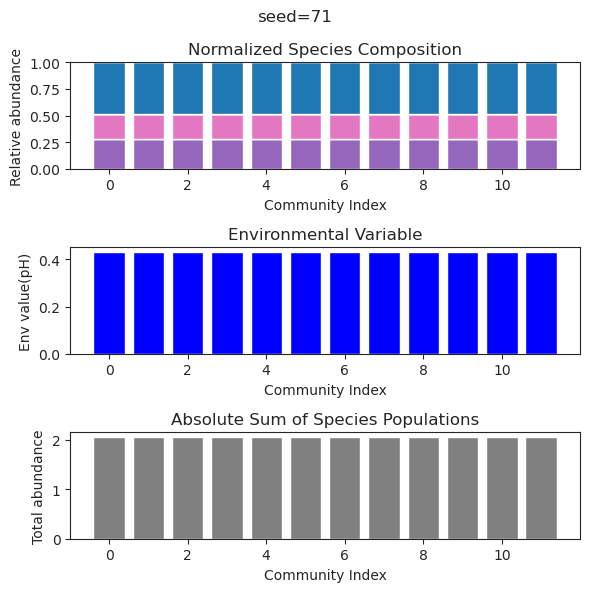

{'species': array([-4.62675526e-51,  1.81254777e-01,  8.57822150e-02, -1.19689331e-43,
       -1.56754498e-31,  4.86793177e-16,  1.19578149e+00,  4.40993109e-22,
        3.69985497e-51, -1.70917321e-33,  3.19568005e-01,  4.13116155e-01]), 'env': array([0.41639037])}
{'species': array([-9.63165680e-67,  1.81254777e-01,  8.57822150e-02, -1.40416840e-60,
       -8.09986769e-32,  1.08822608e-19,  1.19578149e+00, -8.30094303e-23,
       -5.39686997e-71,  3.31563604e-33,  3.19568005e-01,  4.13116155e-01]), 'env': array([0.41639037])}
{'species': array([ 2.50145615e-57,  1.81254777e-01,  8.57822150e-02, -1.07051376e-44,
        3.50543168e-29,  9.50671620e-20,  1.19578149e+00, -6.60369981e-23,
       -7.74354098e-54, -1.12115439e-30,  3.19568005e-01,  4.13116155e-01]), 'env': array([0.41639037])}
{'species': array([ 6.71314978e-51,  1.81254777e-01,  8.57822150e-02,  1.07877569e-41,
        1.51500710e-31, -4.96055539e-18,  1.19578149e+00,  2.91839933e-25,
        1.19336340e-51,  3.74890363e-

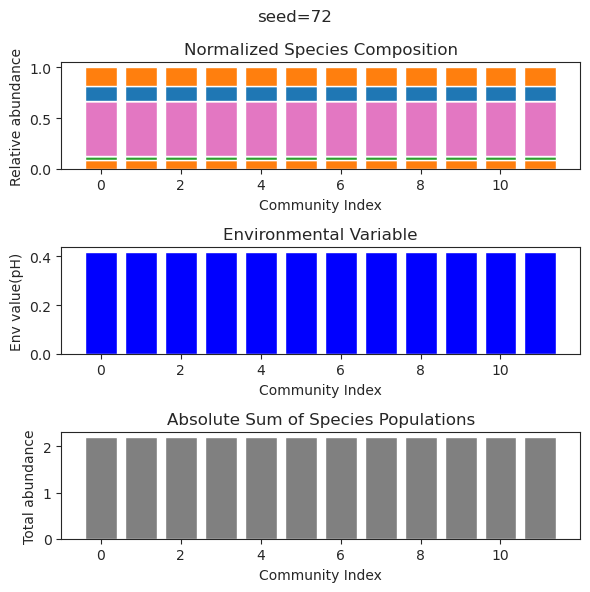

{'species': array([-4.38646273e-51,  2.21541103e-40,  3.56989834e-02,  8.12121782e-01,
        2.32068766e-28, -5.03484611e-31,  1.10241173e-01,  4.69592962e-27,
       -1.01404290e-36,  4.02313356e-01,  6.39639874e-01, -8.54073661e-45]), 'env': array([0.24996551])}
{'species': array([ 1.07798118e-37, -3.84067096e-39,  3.56821808e-02,  8.12114368e-01,
       -5.94518979e-38,  1.48622619e-42,  1.10259839e-01,  2.32136568e-26,
        2.60947364e-37,  4.02318330e-01,  6.39635989e-01, -1.15087213e-45]), 'env': array([0.24995936])}
{'species': array([-1.87578911e-28,  1.68540721e-29,  3.57193349e-02,  8.12130763e-01,
        4.14925768e-34, -2.15754394e-49,  1.10218562e-01,  8.37069444e-25,
        7.78149883e-39,  4.02307332e-01,  6.39644578e-01, -1.71027957e-39]), 'env': array([0.24997296])}
{'species': array([-5.40807501e-65,  3.11766039e-47,  3.56908597e-02,  8.12118197e-01,
        1.89915335e-32, -1.04860482e-49,  1.10250197e-01,  3.70163554e-21,
        3.53819243e-44,  4.02315760e-

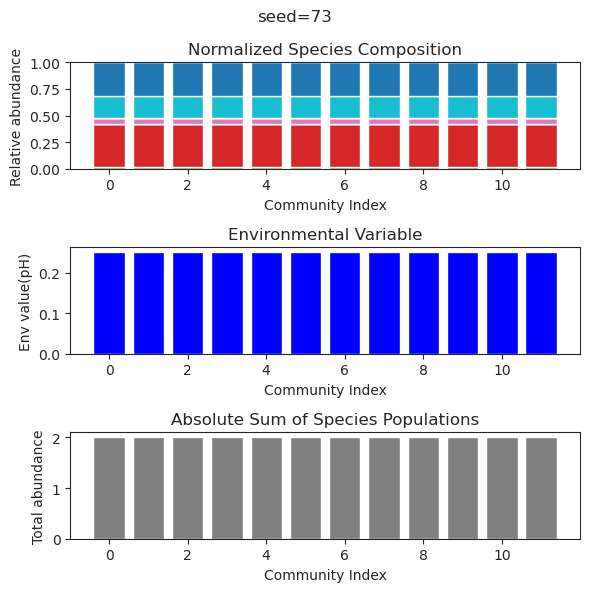

{'species': array([-1.08131545e-50, -9.53397309e-64,  2.70503369e-40, -1.85593851e-23,
        1.30379377e-48, -1.08494772e-50,  1.23685243e+00,  1.27572744e+00,
        1.14462025e-66,  1.08249151e-81, -3.09976452e-26, -1.47850770e-19]), 'env': array([0.51725098])}
{'species': array([-1.40734549e-43,  3.18421331e-48, -4.14066276e-37,  9.23480067e-24,
       -6.65110922e-38, -1.19790345e-40,  1.23685243e+00,  1.27572744e+00,
        4.88647316e-50,  8.05438443e-61,  9.69980552e-27, -1.88932346e-18]), 'env': array([0.51725098])}
{'species': array([-1.60761304e-39,  3.76237707e-46, -2.52419614e-32,  8.36089870e-21,
       -2.93527310e-38, -4.23434038e-35,  1.23685243e+00,  1.27572744e+00,
       -1.34455151e-43, -1.87152309e-50, -5.76122266e-31,  2.72452458e-17]), 'env': array([0.51725098])}
{'species': array([ 1.03960636e-59,  3.02159120e-60, -6.31310170e-47,  9.96772049e-30,
        7.71929246e-43, -1.58201054e-57,  1.23685243e+00,  1.27572744e+00,
       -4.58733543e-72, -4.31954790e-

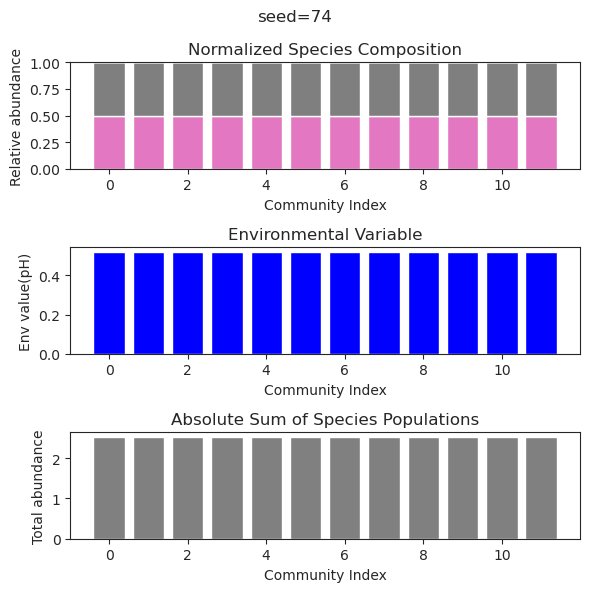

{'species': array([-1.67422094e-34, -1.93635765e-53,  2.98227833e-53,  6.24496928e-01,
        2.03226046e+00,  6.14177974e-63,  1.11325034e-67, -6.32310292e-61,
        1.19823649e+00,  9.58276595e-01, -2.45509954e-69, -1.01646980e-68]), 'env': array([1.89291335])}
{'species': array([ 1.78314417e-26,  6.00657324e-36,  6.63731403e-28,  6.24496928e-01,
        2.03226046e+00, -6.23185537e-29,  1.39259811e-28,  1.31340121e-41,
        1.19823649e+00,  9.58276595e-01,  1.06823130e-55, -3.21541600e-58]), 'env': array([1.89291335])}
{'species': array([-1.14132019e-31,  2.89580767e-44, -1.15957801e-56,  6.24496928e-01,
        2.03226046e+00, -1.81581851e-72,  2.66406791e-78,  8.65552008e-51,
        1.19823649e+00,  9.58276595e-01,  2.69278375e-87, -4.55557277e-78]), 'env': array([1.89291335])}
{'species': array([-5.06576008e-24,  8.14771321e-34, -1.82431174e-55,  6.24496928e-01,
        2.03226046e+00,  3.95331587e-36, -5.76355406e-73,  6.82052349e-43,
        1.19823649e+00,  9.58276595e-

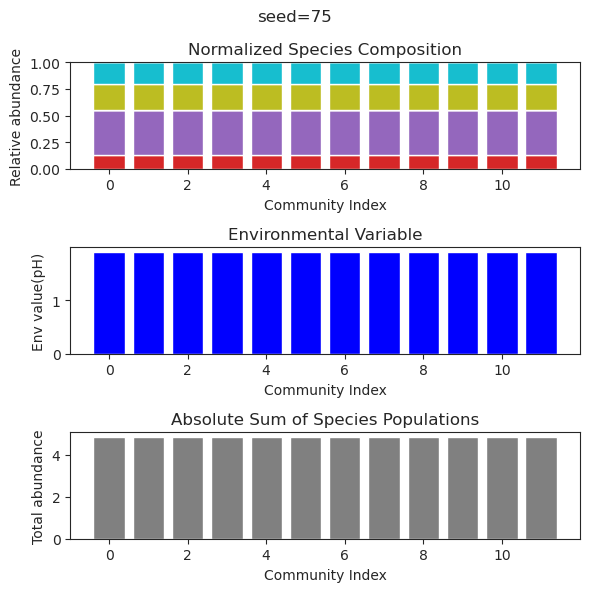

{'species': array([-2.06353553e-15,  9.20751733e-01, -6.75301819e-15, -2.10988867e-37,
        1.19938652e-69, -2.90953585e-26,  1.79658974e-44,  4.34164418e-34,
       -6.67207997e-59,  6.03627671e-01,  1.23480081e-38,  4.34223625e-66]), 'env': array([0.32312101])}
{'species': array([ 4.34417924e-20,  9.20751733e-01,  5.59854807e-15, -5.03757628e-37,
        8.82823406e-63, -8.52347065e-28, -4.91860252e-42, -8.79672164e-33,
        2.25260686e-52,  6.03627671e-01, -3.24727209e-41, -2.50131215e-60]), 'env': array([0.32312101])}
{'species': array([-1.25539931e-15,  9.20751733e-01,  5.79518877e-15,  7.11600428e-32,
       -5.43090794e-63,  3.55705139e-26, -4.12516369e-44,  1.22606411e-28,
       -1.35091755e-53,  6.03627671e-01, -4.60241956e-34, -6.65311367e-61]), 'env': array([0.32312101])}
{'species': array([ 6.88080228e-18,  9.20751733e-01, -7.74328886e-24,  8.20631110e-42,
       -7.61669075e-94,  3.22612858e-33,  8.19934366e-67,  1.15219932e-37,
       -7.52655178e-93,  6.03627671e-

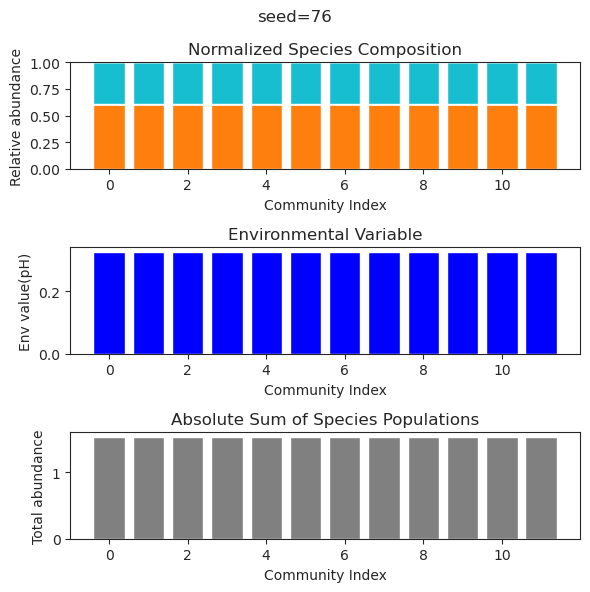

{'species': array([ 5.43242201e-23, -1.92404756e-50,  2.01510981e-27,  1.21502552e-19,
       -3.78398219e-67,  7.71641629e-02,  7.66028830e-28, -1.09589167e-46,
        5.95302202e-01,  7.72942302e-24,  1.04300038e+00,  9.90276296e-01]), 'env': array([0.5790208])}
{'species': array([-1.17588893e-24,  1.88705745e-37,  5.63092842e-29,  1.36695362e-19,
        4.51516489e-59,  7.71641629e-02,  2.24846790e-28,  7.31358039e-39,
        5.95302202e-01, -4.37595533e-25,  1.04300038e+00,  9.90276296e-01]), 'env': array([0.5790208])}
{'species': array([ 1.07408932e-25, -4.17281530e-48,  1.40662017e-29,  8.29590978e-19,
        1.66615287e-74,  7.71641629e-02,  2.69695037e-28, -1.14393166e-47,
        5.95302202e-01,  7.10243996e-26,  1.04300038e+00,  9.90276296e-01]), 'env': array([0.5790208])}
{'species': array([-3.04421259e-26,  1.22018509e-43,  5.12956971e-31, -1.21064008e-20,
       -4.57563409e-62,  7.71641629e-02,  2.93935727e-30,  2.19802249e-37,
        5.95302202e-01, -2.32015497e-27,

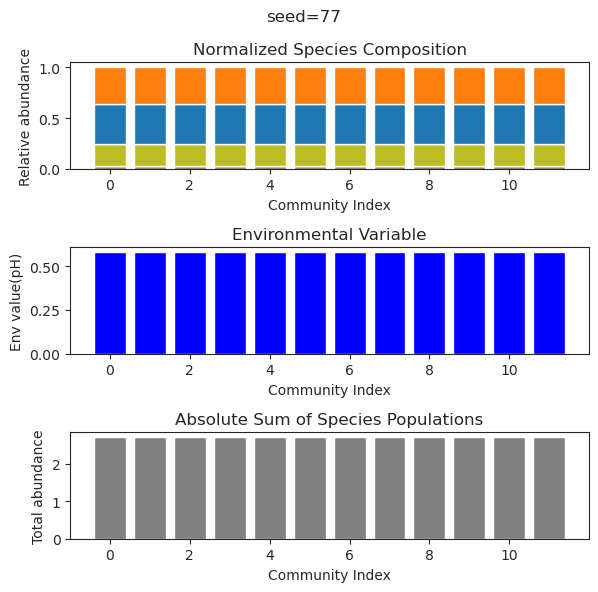

{'species': array([ 1.87450686e-25,  1.19381834e-59,  4.48909015e-01,  3.75175905e-01,
       -2.58131082e-37,  9.81287966e-02,  7.29988158e-58,  4.36983169e-52,
        2.28455828e-33,  4.26158376e-01,  5.68087747e-54,  5.11458257e-01]), 'env': array([0.63511985])}
{'species': array([ 4.56937300e-026,  5.18015773e-153,  4.48909015e-001,
        3.75175905e-001, -1.53946992e-062,  9.81287966e-002,
       -2.39066260e-122, -4.39038070e-142,  4.97655848e-044,
        4.26158376e-001,  4.25459492e-112,  5.11458257e-001]), 'env': array([0.63511985])}
{'species': array([-2.93423392e-29, -1.35068472e-56,  4.48909015e-01,  3.75175905e-01,
       -2.80946545e-37,  9.81287966e-02, -2.84022492e-53, -7.74350974e-48,
        1.55986973e-33,  4.26158376e-01, -4.97682483e-51,  5.11458257e-01]), 'env': array([0.63511985])}
{'species': array([ 5.32259853e-027,  8.83123700e-111,  4.48909015e-001,
        3.75175905e-001,  2.06367371e-049,  9.81287966e-002,
       -3.31872186e-101,  5.95667939e-102, -3.

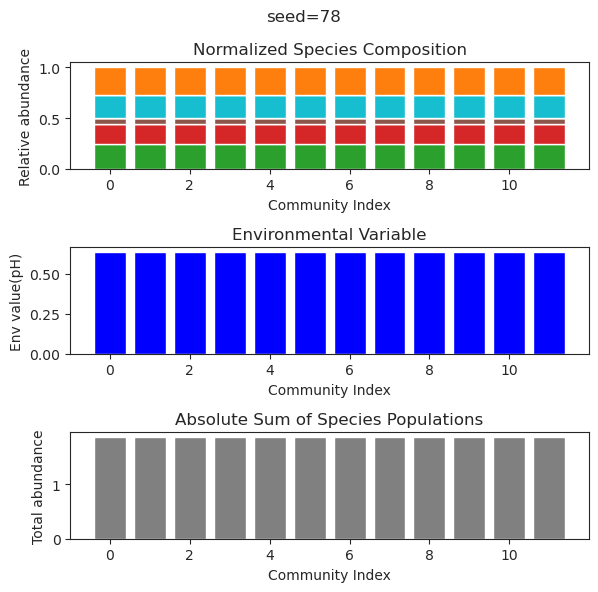

{'species': array([ 4.25457967e-34,  9.22602617e-01, -6.99491115e-82, -2.16841215e-41,
       -3.94329280e-16,  7.02285845e-01,  1.26704303e-01,  9.38924912e-62,
       -1.41946661e-60,  2.19196648e-28,  2.49466445e-58,  8.83806357e-01]), 'env': array([0.62246545])}
{'species': array([ 6.36543367e-29,  9.22602617e-01, -1.24823891e-45, -4.82322133e-45,
       -1.04760480e-14,  7.02285845e-01,  1.26704303e-01,  2.09938832e-50,
        1.47911072e-40, -6.08401150e-25, -8.68081220e-41,  8.83806357e-01]), 'env': array([0.62246545])}
{'species': array([ 3.95119298e-30,  9.22602617e-01, -2.86750825e-71,  6.37786026e-77,
        1.97423815e-14,  7.02285845e-01,  1.26704303e-01, -7.73753966e-47,
       -3.96576359e-63,  2.99446713e-24,  4.78046943e-55,  8.83806357e-01]), 'env': array([0.62246545])}
{'species': array([ 2.06611318e-33,  9.22602617e-01, -1.14647268e-59,  7.11692351e-51,
        9.36022749e-15,  7.02285845e-01,  1.26704303e-01,  5.22451648e-57,
       -1.02154570e-44,  2.08419884e-

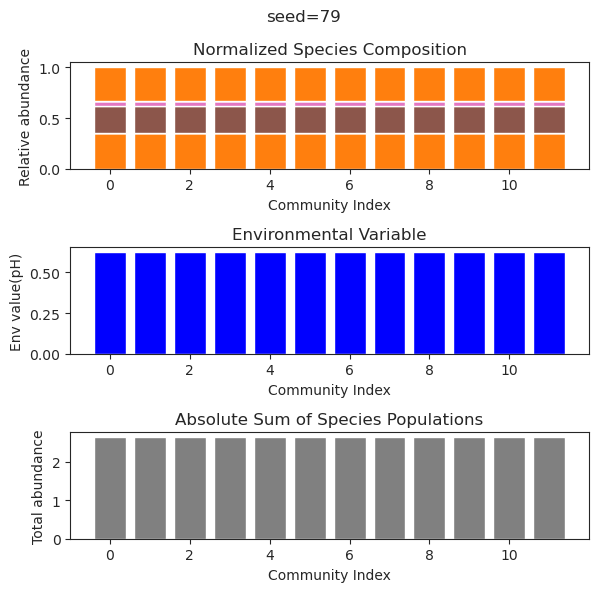

{'species': array([-1.52611721e-44,  4.72167038e-01,  1.23495536e-65, -5.61473081e-97,
       -7.75094559e-38,  6.72981148e-12,  7.89013171e-01,  5.24306370e-80,
       -4.37862492e-18,  2.41916344e-31,  8.37433407e-01,  3.25790770e-56]), 'env': array([0.52558898])}
{'species': array([ 1.52234902e-43,  4.72167038e-01,  1.03832541e-43, -1.06799969e-48,
       -2.66824106e-43,  2.98141837e-11,  7.89013171e-01, -1.51284871e-45,
        2.46123356e-20,  2.64327641e-46,  8.37433407e-01, -1.44523881e-44]), 'env': array([0.52558898])}
{'species': array([-6.58977628e-44,  4.72167038e-01,  8.79991445e-43, -7.94813977e-51,
        8.65735573e-45,  4.77376369e-11,  7.89013171e-01,  4.11539781e-45,
        3.06093191e-20, -2.75154743e-36,  8.37433407e-01, -2.95973375e-44]), 'env': array([0.52558898])}
{'species': array([ 2.82639462e-46,  4.72167038e-01, -3.81924939e-50, -1.57849072e-67,
        2.48804526e-36,  1.62873239e-11,  7.89013171e-01,  4.26090281e-60,
       -2.83203533e-21, -1.35707319e-

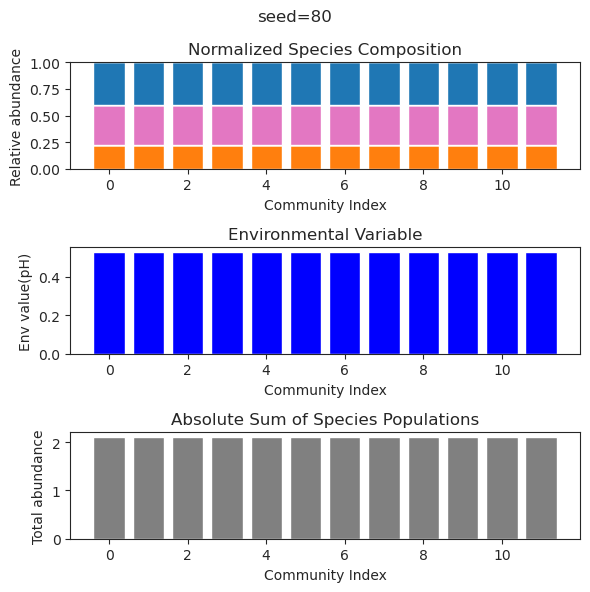

{'species': array([ 7.55884998e-01, -2.47329782e-40, -4.72766634e-33,  1.52929843e-20,
       -3.43999072e-46, -9.73632173e-30, -3.46698596e-54,  8.71582092e-01,
        4.56059430e-01, -1.84221688e-42,  1.48767150e-20, -8.09901495e-26]), 'env': array([0.56072963])}
{'species': array([ 7.55884998e-01,  1.32226132e-48,  2.39970420e-43,  7.55980004e-27,
        8.57337221e-60, -3.00764221e-39, -1.53006283e-59,  8.71582092e-01,
        4.56059430e-01, -5.79770816e-45,  5.91153628e-25,  7.19796741e-27]), 'env': array([0.56072963])}
{'species': array([ 7.55884998e-01, -7.01639589e-51, -3.75458633e-40, -8.63739965e-28,
        2.38350818e-60, -1.10235042e-40, -9.74641681e-54,  8.71582092e-01,
        4.56059430e-01, -5.96389831e-38, -2.35594230e-24, -6.81540624e-26]), 'env': array([0.56072963])}
{'species': array([ 7.55884998e-01, -1.98983270e-31,  1.08977608e-28, -1.35615291e-22,
       -9.18815918e-37,  2.02567892e-27, -6.27797821e-41,  8.71582092e-01,
        4.56059430e-01,  9.82286006e-

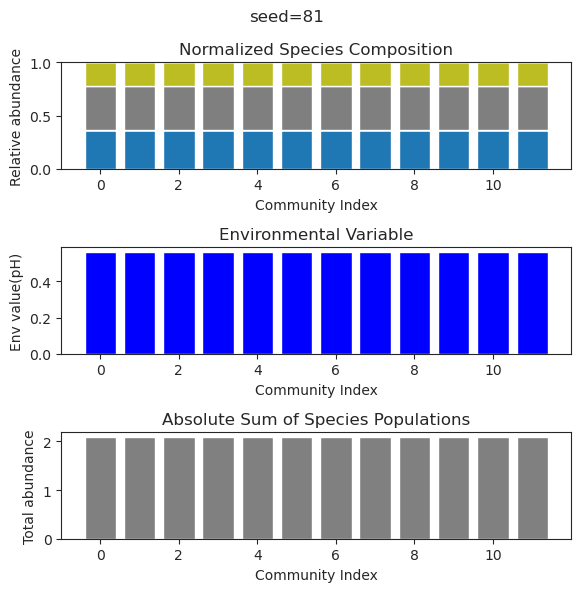

{'species': array([-8.43859076e-49,  3.59937028e-01, -2.40630179e-19,  1.13498693e-34,
        4.42489047e-35,  7.71252262e-01,  1.16148276e+00,  9.91965024e-68,
       -1.81052878e-63, -5.71546840e-67,  1.81576535e-41,  1.23815064e+00]), 'env': array([0.82960705])}
{'species': array([-5.78710987e-46,  3.59937028e-01, -1.55630360e-27, -7.18666154e-37,
        1.39652601e-31,  7.71252262e-01,  1.16148276e+00,  3.10896045e-45,
        4.91789637e-42,  4.30666738e-44, -4.69458743e-42,  1.23815064e+00]), 'env': array([0.82960705])}
{'species': array([-2.73571725e-71,  3.59937028e-01, -3.37615054e-30, -2.03516334e-54,
        4.58783332e-46,  7.71252262e-01,  1.16148276e+00, -2.24357229e-80,
       -1.78509006e-76,  7.28301435e-80,  1.69080311e-61,  1.23815064e+00]), 'env': array([0.82960705])}
{'species': array([ 2.60532532e-41,  3.59937028e-01, -2.38257552e-20,  8.37551478e-31,
        2.80819731e-28,  7.71252262e-01,  1.16148276e+00, -1.64685814e-46,
        3.77369159e-39,  8.10650230e-

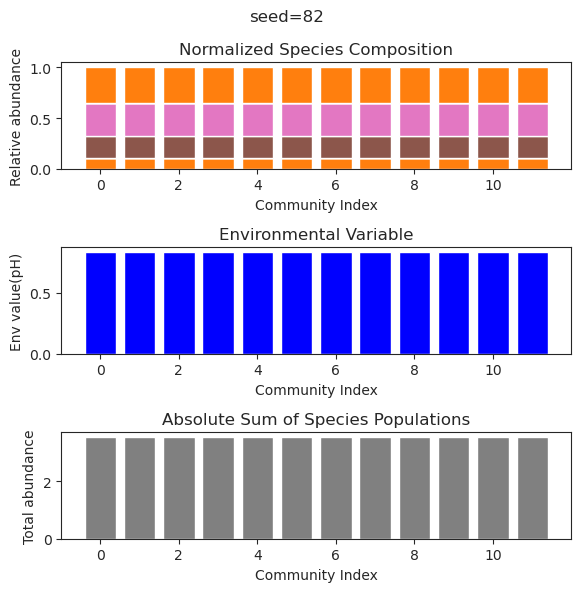

{'species': array([ 3.37451170e-01,  5.15330656e-58,  6.96839701e-01,  1.55166880e-68,
        2.36834446e-24,  3.49652607e-18,  6.71136153e-02,  8.50863276e-72,
        6.61074092e-51,  5.52825778e-01, -8.45483653e-69,  3.22973953e-01]), 'env': array([0.23793497])}
{'species': array([ 3.37451170e-01,  2.10489785e-67,  6.96839701e-01,  1.59227468e-83,
        8.14414151e-30, -6.30487044e-18,  6.71136153e-02,  5.92682089e-83,
        1.49167367e-60,  5.52825778e-01,  2.44304361e-84,  3.22973953e-01]), 'env': array([0.23793497])}
{'species': array([ 3.37451170e-01,  8.00973874e-44,  6.96839701e-01, -4.55887532e-59,
       -2.21307953e-24, -3.85721712e-17,  6.71136153e-02, -4.46286462e-58,
        8.00352049e-42,  5.52825778e-01,  1.17672138e-66,  3.22973953e-01]), 'env': array([0.23793497])}
{'species': array([ 3.37451170e-01,  4.81326836e-51,  6.96839701e-01,  9.40602759e-72,
       -4.16351238e-24,  1.26361506e-15,  6.71136153e-02,  5.74700781e-67,
        5.12933102e-44,  5.52825778e-

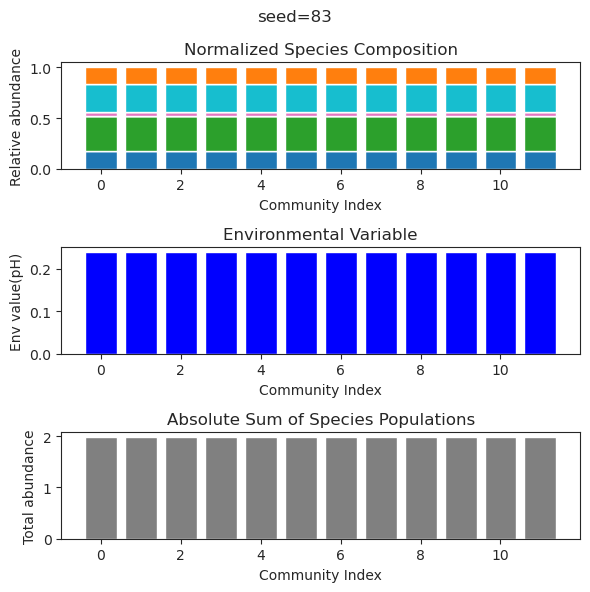

{'species': array([ 1.45232010e+00,  2.36312814e-45, -1.00669824e-63,  2.53327178e-01,
        8.35933582e-61,  3.18446686e-26, -1.29371979e-36,  9.52862775e-01,
        1.90900410e-62, -1.57859009e-47,  1.37696241e-44, -1.83740562e-56]), 'env': array([1.07807643])}
{'species': array([ 1.45232010e+00,  2.02338320e-81,  6.78010424e-94,  2.53327178e-01,
       -3.23644375e-82,  2.85950344e-27, -2.18712998e-32,  9.52862775e-01,
       -2.66854247e-94, -5.81913047e-64, -2.18632542e-57,  1.12043005e-77]), 'env': array([1.07807643])}
{'species': array([ 1.45232010e+00, -7.99247436e-62,  9.61149709e-61,  2.53327178e-01,
       -4.25206274e-57,  7.29335155e-28, -3.60937851e-33,  9.52862775e-01,
        5.83061791e-62,  4.50523458e-49,  1.05128758e-43,  9.49867232e-59]), 'env': array([1.07807643])}
{'species': array([ 1.45232010e+000, -6.97534018e-102, -3.38029658e-117,
        2.53327178e-001,  1.21202708e-104, -1.56105915e-027,
       -4.47247116e-035,  9.52862775e-001, -4.57514697e-124,
    

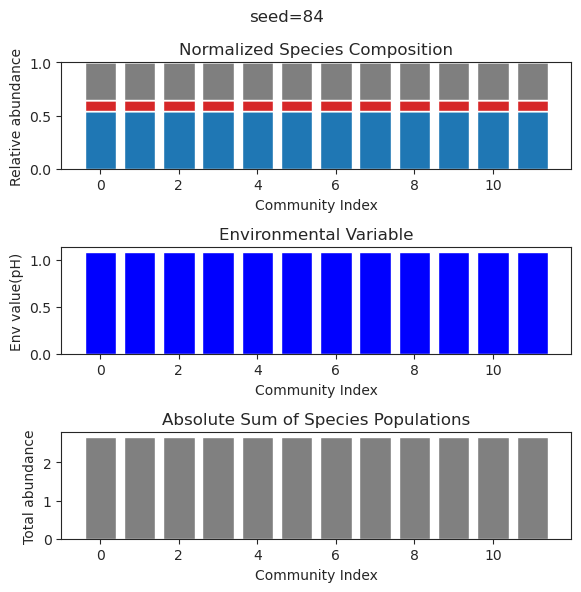

{'species': array([ 6.53930792e-50,  4.24970442e-33,  7.95404402e-25, -3.91547316e-49,
        7.06846493e-26,  6.95231081e-35,  6.25877739e-01,  8.40413705e-27,
        5.69619302e-01,  1.39758340e-01,  6.07664100e-01, -9.81605701e-26]), 'env': array([0.57371855])}
{'species': array([-5.24735730e-56, -1.74156901e-34,  1.75728561e-24, -5.11827762e-57,
        1.20578255e-23,  1.94660189e-32,  6.25877739e-01,  3.54811833e-21,
        5.69619302e-01,  1.39758340e-01,  6.07664100e-01,  2.14655625e-21]), 'env': array([0.57371855])}
{'species': array([-1.88517480e-72, -3.22240399e-44,  4.17834114e-28,  1.02850947e-64,
        2.72319472e-25,  8.71330674e-40,  6.25877739e-01,  6.92747080e-24,
        5.69619302e-01,  1.39758340e-01,  6.07664100e-01,  3.89996083e-25]), 'env': array([0.57371855])}
{'species': array([-7.70595808e-70, -4.41229607e-41, -2.10010203e-26, -2.26292602e-62,
       -2.18034977e-21,  2.50699849e-31,  6.25877739e-01, -3.75294825e-22,
        5.69619302e-01,  1.39758340e-

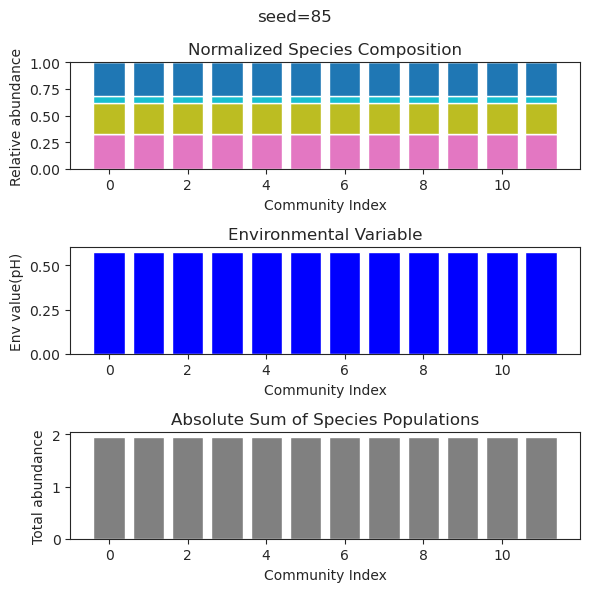

{'species': array([ 5.06065303e-45,  3.86652527e-02, -1.52246133e-59,  9.64940186e-01,
        6.10458055e-19,  1.59466009e-38, -2.58212224e-40,  7.83558085e-01,
       -2.22543756e-57,  1.30297780e-54,  2.09637550e-23,  3.93658723e-01]), 'env': array([0.77162226])}
{'species': array([-2.05053580e-46,  3.86652527e-02, -1.00464648e-50,  9.64940186e-01,
       -7.92925858e-21, -9.50807418e-35,  1.26640004e-43,  7.83558085e-01,
       -1.89057154e-48,  7.92436477e-47, -1.96108577e-31,  3.93658723e-01]), 'env': array([0.77162226])}
{'species': array([ 1.22671915e-72,  3.86652527e-02, -1.68356222e-74,  9.64940186e-01,
       -2.21504834e-19, -7.23516396e-37,  4.48804056e-58,  7.83558085e-01,
       -1.14155032e-70,  3.50086408e-66,  1.42007548e-27,  3.93658723e-01]), 'env': array([0.77162226])}
{'species': array([ 6.40877573e-111,  3.86652527e-002, -2.66639472e-100,
        9.64940186e-001, -1.11925410e-024,  1.01733158e-049,
       -2.30931392e-081,  7.83558085e-001, -7.72609104e-089,
    

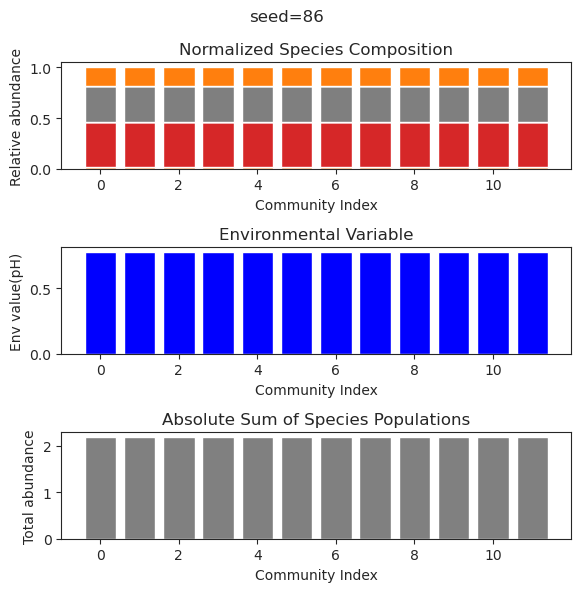

{'species': array([-1.73318930e-60,  4.80028441e-01,  7.81137058e-01, -2.51895447e-79,
        9.31037190e-79,  1.69068820e+00, -1.50560490e-28, -1.23240103e-58,
       -5.51680990e-20, -9.52142076e-58, -1.00955610e-47, -1.59476310e-53]), 'env': array([1.01403101])}
{'species': array([-7.73883898e-52,  4.80028441e-01,  7.81137058e-01, -9.49547888e-59,
       -2.44160450e-60,  1.69068820e+00,  3.86062478e-30,  1.69972538e-48,
        2.58639842e-25,  3.32693780e-48, -1.12476475e-43, -5.54147388e-48]), 'env': array([1.01403101])}
{'species': array([-3.09003752e-48,  4.80028441e-01,  7.81137058e-01, -3.51859258e-55,
        2.96000375e-56,  1.69068820e+00, -1.46097836e-26, -5.35618838e-48,
        4.12096556e-19,  1.14350897e-46, -1.43950762e-37, -2.97034404e-42]), 'env': array([1.01403101])}
{'species': array([ 3.88064765e-53,  4.80028441e-01,  7.81137058e-01, -1.50914814e-68,
       -4.32009432e-66,  1.69068820e+00, -6.07868905e-26, -2.08626349e-53,
        5.56826533e-18,  4.66201128e-

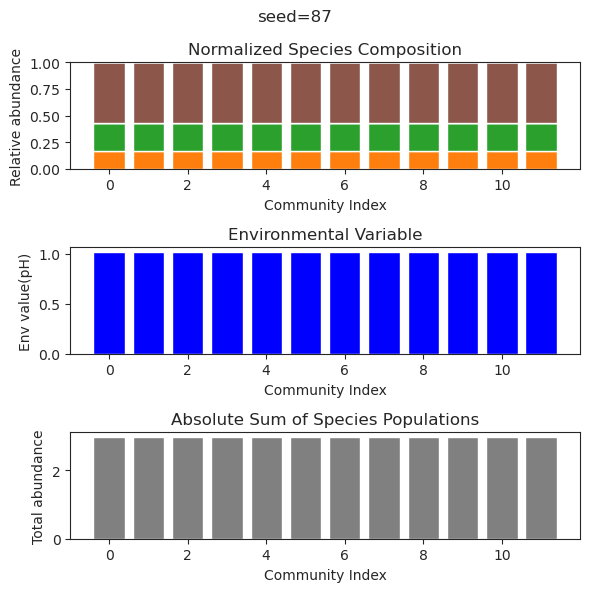

{'species': array([ 2.35288692e-001,  1.28824032e+000,  3.43562308e-001,
       -2.12375655e-023,  8.98522507e-030,  1.80259206e-052,
       -1.50702215e-083,  9.02885093e-001, -2.92136183e-102,
       -9.09910285e-096, -7.45419113e-101,  2.00036181e-017]), 'env': array([0.6944982])}
{'species': array([ 2.35288692e-01,  1.28824032e+00,  3.43562308e-01,  4.77823245e-21,
        1.34863412e-49,  3.55361273e-55,  8.77171119e-60,  9.02885093e-01,
        9.79336991e-60, -7.25410581e-61, -2.81093374e-60, -1.18012511e-17]), 'env': array([0.6944982])}
{'species': array([ 2.35288692e-01,  1.28824032e+00,  3.43562308e-01,  2.75825454e-28,
        2.89317867e-27, -3.97117013e-43, -2.60256064e-70,  9.02885093e-01,
       -9.93013798e-85,  2.70724811e-76,  2.34124425e-83,  1.70320131e-19]), 'env': array([0.6944982])}
{'species': array([ 2.35288692e-01,  1.28824032e+00,  3.43562308e-01, -2.39694215e-20,
        1.40705911e-26, -1.92709885e-46, -2.60111551e-75,  9.02885093e-01,
        2.77574950e-8

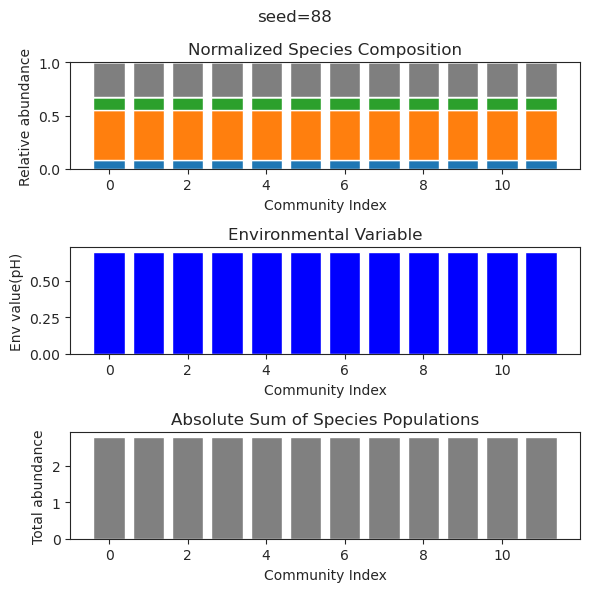

{'species': array([ 1.00272954e-01,  1.04749121e-01,  3.26903337e-46, -3.61396863e-37,
       -3.86213243e-31,  5.48259530e-01,  7.67471651e-01, -6.65987589e-47,
       -7.68276104e-52, -5.21842442e-26,  2.73425482e-24, -1.55600435e-29]), 'env': array([0.29737916])}
{'species': array([ 1.00272954e-01,  1.04749121e-01,  1.98882297e-54, -1.36482492e-41,
       -9.49788529e-33,  5.48259530e-01,  7.67471651e-01,  6.39462937e-58,
       -2.06266640e-62, -1.17817079e-26, -7.09690385e-22,  1.04651630e-29]), 'env': array([0.29737916])}
{'species': array([ 1.00272954e-01,  1.04749121e-01, -5.46508269e-53, -1.74707705e-41,
        3.81824082e-33,  5.48259530e-01,  7.67471651e-01, -4.03008128e-52,
        2.24284247e-64, -1.49195398e-27, -3.62913249e-21,  1.25582401e-33]), 'env': array([0.29737916])}
{'species': array([ 1.00272954e-01,  1.04749121e-01,  4.75849855e-53,  8.37955961e-41,
       -3.15975751e-32,  5.48259530e-01,  7.67471651e-01, -4.43877019e-49,
        3.91645061e-56,  4.46182358e-

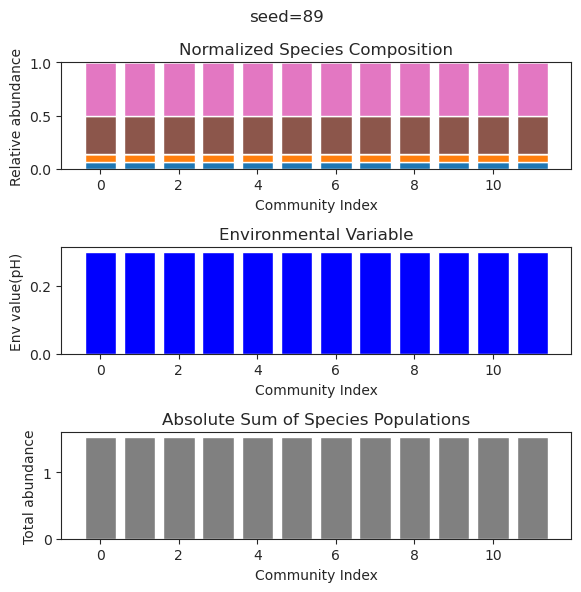

{'species': array([ 2.07158315e-31, -8.17944513e-48,  5.44357218e-28,  1.91498167e-01,
        2.00244047e-28,  5.12419418e-01,  3.53164752e-73, -1.35029018e-53,
        8.76627877e-76,  6.87598830e-01, -3.64764538e-76,  1.01169995e+00]), 'env': array([0.66091596])}
{'species': array([ 1.25666370e-32,  5.47960663e-43,  1.59042005e-28,  1.91498167e-01,
       -5.52044165e-28,  5.12419418e-01, -7.36367322e-71,  1.46359166e-53,
        2.57311124e-76,  6.87598830e-01,  1.83558898e-77,  1.01169995e+00]), 'env': array([0.66091596])}
{'species': array([-9.82904727e-29,  3.64501969e-40, -3.66582659e-27,  1.91498167e-01,
       -8.15172000e-25,  5.12419418e-01, -2.27974955e-67, -6.52971584e-48,
        5.12050402e-73,  6.87598830e-01, -5.23561123e-72,  1.01169995e+00]), 'env': array([0.66091596])}
{'species': array([-2.58621179e-31,  2.11183418e-36,  2.91453077e-32,  1.91498167e-01,
       -2.13059910e-28,  5.12419418e-01,  1.01886935e-47,  3.27365811e-42,
        1.35677926e-51,  6.87598830e-

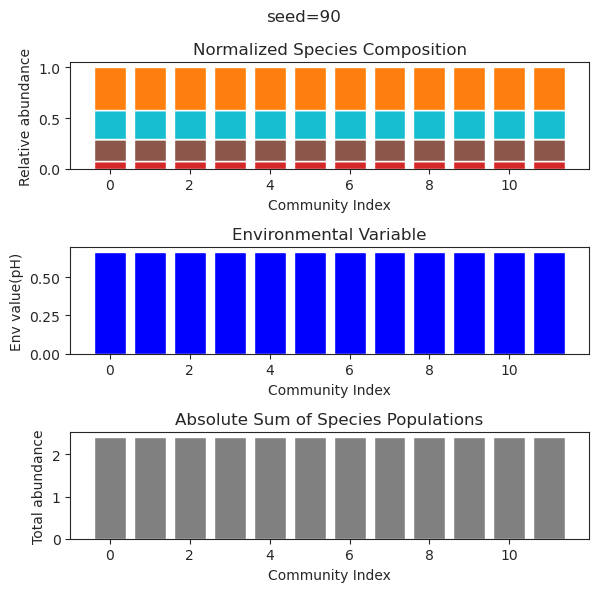

{'species': array([ 8.27031118e-60,  6.25347219e-01,  7.17208537e-01,  1.99276580e-61,
       -1.12507702e-34,  2.61363431e-01,  5.42102746e-30,  2.29777252e-47,
        7.77759086e-01, -5.32386586e-33,  3.49440880e-61, -8.10820343e-23]), 'env': array([0.53997741])}
{'species': array([-4.76126037e-64,  6.25347219e-01,  7.17208537e-01,  6.20903938e-64,
        5.75898154e-37,  2.61363431e-01, -2.79850558e-26, -2.29730056e-51,
        7.77759086e-01, -1.24804509e-33,  2.97459308e-66,  1.29923256e-20]), 'env': array([0.53997741])}
{'species': array([-1.30348862e-76,  6.25347219e-01,  7.17208537e-01, -5.15181719e-77,
       -7.15499256e-34,  2.61363431e-01,  3.11732528e-20,  8.38028260e-56,
        7.77759086e-01, -3.62844951e-32,  1.14378335e-76,  3.60636465e-18]), 'env': array([0.53997741])}
{'species': array([ 1.94087389e-44,  6.25347219e-01,  7.17208537e-01, -4.60232954e-57,
        1.14869037e-26,  2.61363431e-01, -2.06992114e-25,  1.64314455e-41,
        7.77759086e-01, -1.06477334e-

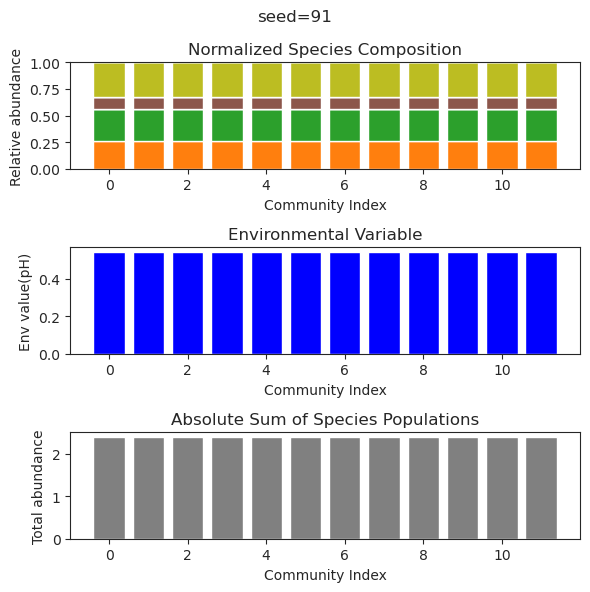

{'species': array([ 1.23149414e-25, -2.14031327e-49,  1.18290055e+00, -1.17719478e-53,
       -9.83286577e-53, -2.13356608e-49, -2.94845234e-51,  1.57662483e-55,
        2.08647848e-24,  4.44780346e-49,  2.99935580e-02,  1.98925320e+00]), 'env': array([1.38028174])}
{'species': array([ 2.40802711e-32, -1.86146275e-41,  1.18290055e+00, -1.30348020e-51,
       -2.08328640e-50, -1.21249828e-49, -8.00923150e-45,  3.11740988e-51,
        5.41074772e-28,  3.89020429e-50,  2.99935580e-02,  1.98925320e+00]), 'env': array([1.38028174])}
{'species': array([-1.41687264e-016,  3.27935153e-037,  1.18290055e+000,
       -3.12819930e-097,  1.22638698e-099, -1.11984478e-056,
       -2.23419950e-044,  1.18264809e-110, -1.92081069e-013,
       -2.78875745e-057,  2.99935580e-002,  1.98925320e+000]), 'env': array([1.38028174])}
{'species': array([ 9.82804784e-033,  2.83524914e-051,  1.18290055e+000,
        1.91469400e-105,  7.41748499e-110, -3.57825004e-072,
        1.45961665e-057, -5.77847425e-123,  1.

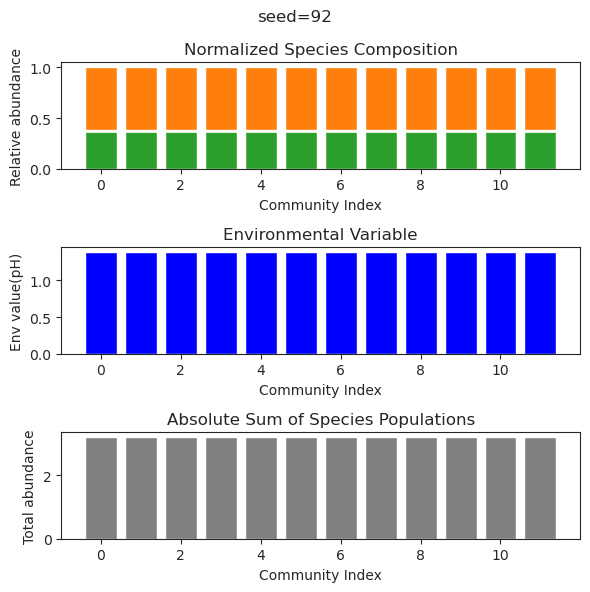

{'species': array([ 1.56482764e-68,  1.80308028e-32,  2.59266598e-75, -5.69291650e-48,
        8.62812323e-01, -8.70582524e-48,  6.62611401e-01,  9.68726875e-74,
        4.99532417e-01,  3.44837784e-78, -5.56612788e-74, -1.81381044e-73]), 'env': array([0.71160932])}
{'species': array([ 1.57230275e-47,  1.96800700e-25,  1.06789968e-53, -7.57378511e-37,
        8.62812323e-01, -1.03212176e-35,  6.62611401e-01, -4.85332504e-54,
        4.99532417e-01, -2.27899797e-60,  8.59573355e-50, -9.32260649e-55]), 'env': array([0.71160932])}
{'species': array([ 1.95998566e-55,  1.31253472e-21,  1.22725325e-64,  1.37831558e-34,
        8.62812323e-01,  2.97018398e-33,  6.62611401e-01, -1.97760679e-57,
        4.99532417e-01, -1.35065397e-65, -3.51213734e-60, -1.40599489e-58]), 'env': array([0.71160932])}
{'species': array([ 6.66303519e-41,  1.89392875e-25, -4.05997865e-40, -4.43882388e-32,
        8.62812323e-01, -8.27994049e-32,  6.62611401e-01, -2.64193646e-45,
        4.99532417e-01, -1.16156725e-

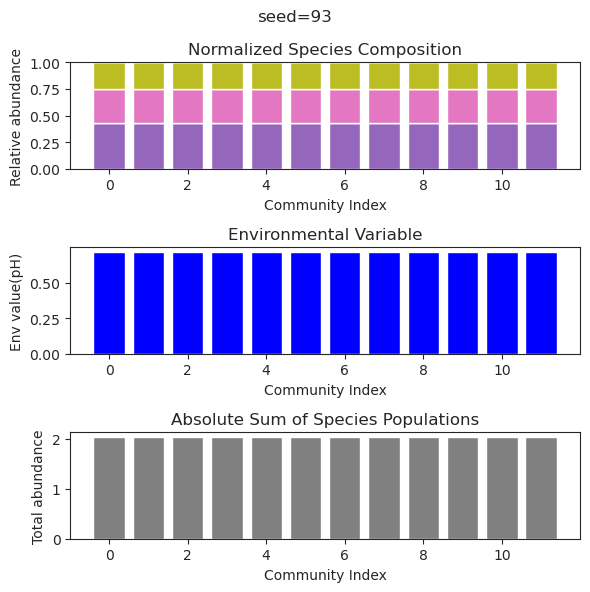

{'species': array([ 4.27081324e-01,  6.22926583e-38,  8.85350360e-01, -4.49383981e-23,
       -3.76066014e-21, -1.51738317e-23, -1.97116588e-21,  6.48361471e-01,
        1.34460663e-39,  1.27857182e-01,  3.68820579e-20, -3.10643997e-25]), 'env': array([0.35122013])}
{'species': array([ 4.27081324e-01,  3.44397447e-49,  8.85350360e-01, -1.40534326e-26,
       -3.24123998e-29,  1.59743537e-35, -1.19610172e-29,  6.48361471e-01,
        3.58225154e-51,  1.27857182e-01, -2.17450564e-25, -2.74471804e-28]), 'env': array([0.35122013])}
{'species': array([4.27081324e-01, 3.19582597e-36, 8.85350360e-01, 2.36116430e-22,
       1.48679035e-25, 5.63872090e-26, 1.23425908e-25, 6.48361471e-01,
       1.06145083e-35, 1.27857182e-01, 4.03037713e-23, 5.55795776e-26]), 'env': array([0.35122013])}
{'species': array([ 4.27081324e-01, -2.79984507e-46,  8.85350360e-01,  5.76363388e-26,
        2.42948368e-28,  1.31765802e-32,  3.65578694e-30,  6.48361471e-01,
       -1.89888458e-45,  1.27857182e-01, -6.53172

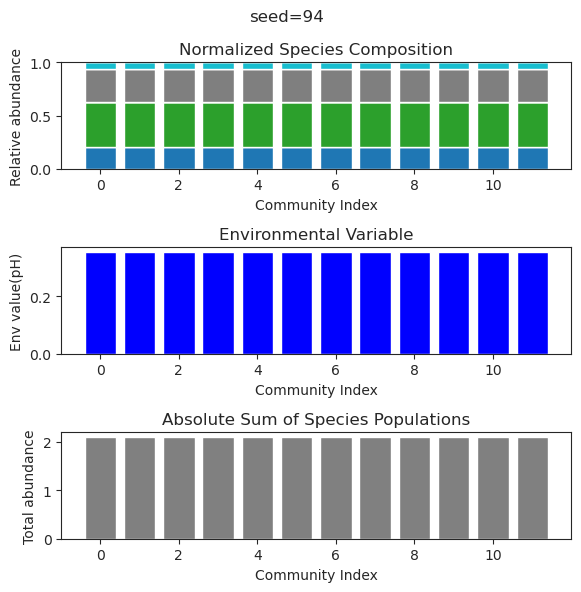

{'species': array([ 3.98656838e-48,  1.23434524e-01,  5.85803984e-01, -6.79902294e-49,
        2.09381945e-01,  2.27507848e-57,  7.11609059e-01,  1.33367869e-58,
        5.93573452e-02,  5.51536118e-01, -3.24456870e-33,  5.16638393e-01]), 'env': array([0.52346985])}
{'species': array([-6.10106965e-31,  1.23434524e-01,  5.85803984e-01, -2.72392934e-38,
        2.09381945e-01,  4.13622773e-58,  7.11609059e-01,  1.84023116e-60,
        5.93573452e-02,  5.51536118e-01,  3.12183659e-33,  5.16638393e-01]), 'env': array([0.52346985])}
{'species': array([ 6.07607507e-26,  1.00139671e-01,  5.40648536e-01,  4.94992492e-27,
        6.42506596e-04,  1.79474389e-27,  7.07407491e-01, -2.63221560e-27,
        4.03958926e-01,  5.88577731e-01,  6.83597484e-02,  3.22095876e-01]), 'env': array([0.55026165])}
{'species': array([ 7.54847526e-69,  1.23434524e-01,  5.85803984e-01, -3.33003989e-64,
        2.09381945e-01, -5.22150314e-32,  7.11609059e-01,  9.04184401e-99,
        5.93573452e-02,  5.51536118e-

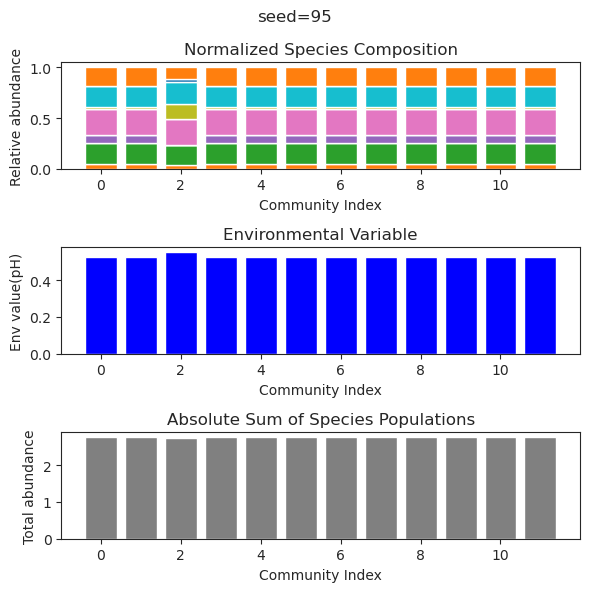

{'species': array([-3.21449007e-15,  2.46395103e-52,  4.66320136e-38,  2.73239955e-85,
       -3.73905754e-80,  9.38182894e-01,  8.92732020e-02,  1.57458921e+00,
        1.34616653e-01,  4.45348942e-84,  2.14694148e-40, -1.99716868e-65]), 'env': array([0.97699118])}
{'species': array([-2.96526827e-22,  7.46905537e-45,  3.57605300e-26,  2.96022939e-93,
        7.98815652e-82,  9.38182894e-01,  8.92732020e-02,  1.57458921e+00,
        1.34616653e-01, -4.75247555e-79, -1.94460317e-46, -4.84307216e-90]), 'env': array([0.97699118])}
{'species': array([-1.38261906e-017, -4.68326120e-053, -5.48640508e-035,
        8.73796590e-100,  3.27482849e-089,  9.38182894e-001,
        8.92732020e-002,  1.57458921e+000,  1.34616653e-001,
       -7.90666409e-089, -3.30819605e-055, -1.68168873e-086]), 'env': array([0.97699118])}
{'species': array([-2.42389263e-017, -1.84934732e-068, -2.56237197e-042,
       -3.00646219e-129, -1.04224157e-105,  9.38182894e-001,
        8.92732020e-002,  1.57458921e+000,  1.

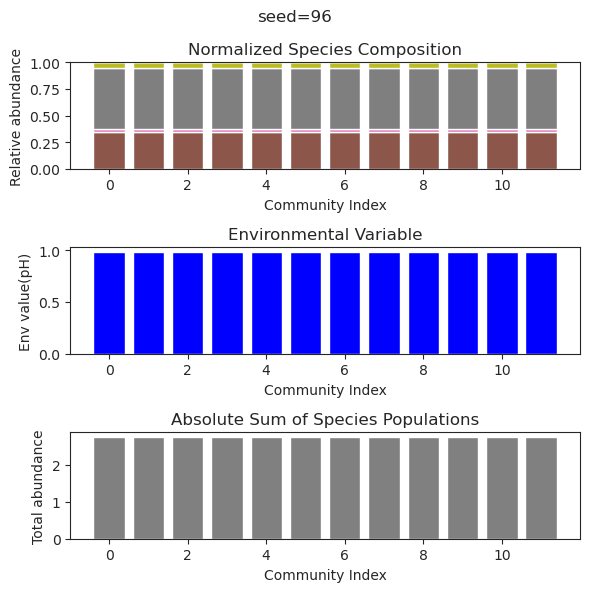

{'species': array([ 5.76689498e-047, -2.34924183e-053,  3.57538204e-104,
        9.86642327e-001,  2.95082861e-040, -1.50146440e-045,
        1.65871269e-002,  5.44817908e-051, -2.40132932e-021,
        1.15649100e+000, -1.22269529e-034,  5.75590633e-001]), 'env': array([0.90937284])}
{'species': array([ 1.98486408e-019, -1.46747530e-045,  1.99741065e-147,
        9.86642327e-001, -1.00075184e-076, -2.63160478e-078,
        1.65871270e-002,  1.74960439e-073,  3.79125471e-020,
        1.15649100e+000, -2.06767823e-084,  5.75590633e-001]), 'env': array([0.90937284])}
{'species': array([-6.18070270e-35, -5.80947146e-44, -7.92033329e-40,  9.86642327e-01,
        1.12179425e-42, -6.50429457e-44,  1.65871269e-02,  3.40740586e-42,
       -8.25330229e-25,  1.15649100e+00, -1.89943692e-52,  5.75590633e-01]), 'env': array([0.90937284])}
{'species': array([-3.90512140e-020,  1.75510960e-045, -1.06376331e-141,
        9.86642327e-001,  1.70710863e-044,  1.98574294e-074,
        1.65871270e-002, -5

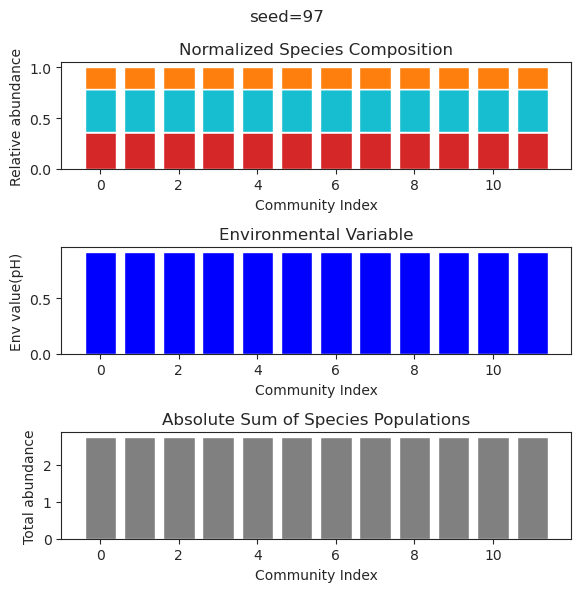

{'species': array([ 3.57192250e-01,  3.54898548e-25,  5.37761714e-01,  2.92257460e-01,
        6.87458651e-80,  5.38362171e-01, -8.43270962e-68,  9.82796771e-76,
        4.45262881e-78, -5.56731228e-80,  6.21128459e-01,  6.90703006e-59]), 'env': array([0.47171953])}
{'species': array([ 3.57192250e-01,  5.93876317e-29,  5.37761714e-01,  2.92257460e-01,
        8.42948501e-83,  5.38362171e-01,  3.36823616e-72,  1.90097311e-81,
       -1.89599765e-82,  2.41856176e-85,  6.21128459e-01, -2.48776165e-61]), 'env': array([0.47171953])}
{'species': array([ 3.57192250e-01, -2.34390495e-23,  5.37761714e-01,  2.92257460e-01,
        1.86352839e-44,  5.38362171e-01, -1.98283861e-35, -2.45457751e-43,
       -4.23000540e-46, -5.20339289e-46,  6.21128459e-01, -2.67939154e-35]), 'env': array([0.47171953])}
{'species': array([ 3.57192250e-01, -2.56287284e-27,  5.37761714e-01,  2.92257460e-01,
       -2.17429572e-83,  5.38362171e-01, -1.28512701e-73,  1.75751651e-85,
        4.23800281e-83, -1.23103956e-

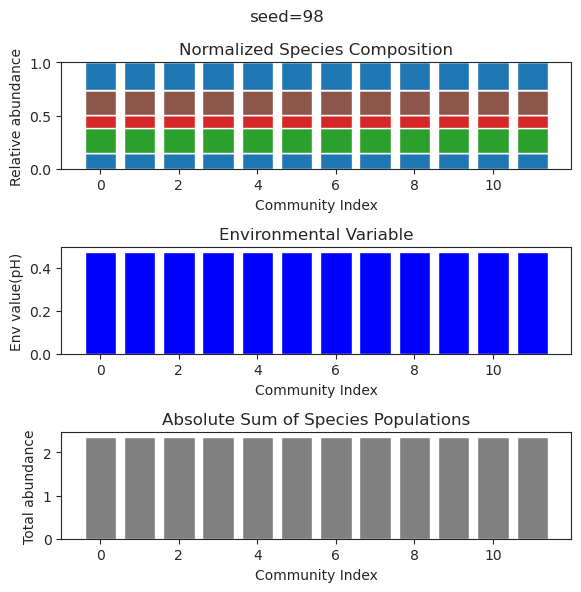

{'species': array([ 4.19618796e-01, -1.38752785e-64,  9.41145823e-01,  8.51013844e-01,
       -5.49377606e-31, -5.90521830e-29, -2.04598327e-55,  1.56156860e-60,
       -2.63021986e-22, -1.43054112e-64,  9.00934174e-52,  2.08638119e-53]), 'env': array([0.53955889])}
{'species': array([ 4.19618796e-01,  6.07011363e-68,  9.41145823e-01,  8.51013844e-01,
        1.11215369e-28, -8.65811392e-32,  9.67660205e-56,  1.29352953e-58,
        4.28837109e-23,  5.85398441e-64,  3.97293744e-49,  7.09508258e-45]), 'env': array([0.53955889])}
{'species': array([ 4.19618796e-01, -1.07902489e-81,  9.41145823e-01,  8.51013844e-01,
       -9.45094129e-29, -5.29545497e-40, -1.56446653e-70,  1.17747887e-68,
       -2.99867837e-27,  7.67691503e-73,  4.81088957e-56,  9.48918434e-48]), 'env': array([0.53955889])}
{'species': array([ 4.19618796e-01,  2.00816075e-65,  9.41145823e-01,  8.51013844e-01,
       -9.14200223e-29, -1.88197459e-28, -3.98373864e-54,  1.03166415e-58,
       -8.96994876e-21, -7.34872622e-

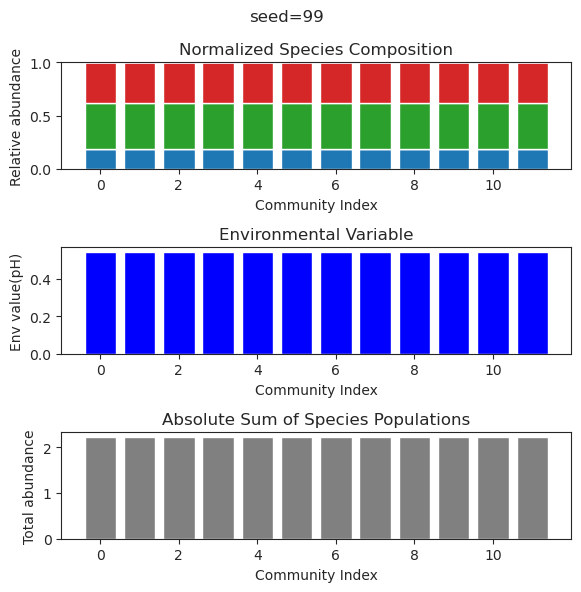

In [8]:
session_path='Results_qtailed/Session_Test1'
to_save={}
description=''
simulated_result={}

for seed_num in range(100):
    if not os.path.isdir(session_path):
        os.mkdir(session_path)
    # functions for uniform 

    f_I = lambda : uniform_distribution(0.5,0.5)
    f_g = lambda : np.ones(1)
    f_k = lambda : np.ones(1)
    f_p = lambda : uniform_distribution(0.5,0.5)
    f_q = lambda : custom_distribution(3,1)
    f_beta = lambda : np.ones(1)
    seed_num=seed_num
    to_plot=True

    np.random.seed(seed_num)

    N=12
    N_env=1


    I = np.zeros((N, N))
    for i in range(N):
        for j in range(N):
            I[i,j] = f_I()
    for i in range(N):
        I[i,i] =1

    g = np.zeros((N))
    for i in range(N):
        g[i] = f_g()

    k = np.zeros((N))
    for i in range(N):
        k[i] = f_k()   

    p = np.zeros((N_env, N))
    for i in range(N_env):
        for j in range(N):
            p[i,j] = f_p()

    #p[0,2]=-10

    q = np.zeros((N, N_env))
    for i in range(N):
        for j in range(N_env):
            q[i,j] = f_q()

    #q[2,0]=0.2



    beta = np.zeros(N_env)
    for i in range(N_env):
        beta[i]=f_beta()

    delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
    migration_rate=0#1e-7
    system_config = {
        'I': I,
        'g': g,
        'k': k,
        'p': p,
        'q': q,
        'beta': beta,
        'delta': delta,
        'migration_rate' : migration_rate,
        'N': N,
        'N_env': N_env,
        'seed_num':seed_num,
    } 

    file_path = f'{session_path}/system_config.json'

    label="test"
    sys
    ##

    y_out_list=[]
    system_config['beta'] = np.array([0.5])*delta

    for i in range(12):

        species_index=np.arange(0,12)
        env_index=np.array([0])
        y0_species=one_hot_vector(12,i)
        y0_env=[0]
        t=np.linspace(0, 2000, 10000)

        y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False)

        y_out_list.append(y_out)

    num_datasets = len(y_out_list)

    # Prepare subplots
    fig, axs = plt.subplots(3, 1, figsize=(6, 6))

    # Data for plots
    species_matrix = np.array([y_out['species'] for y_out in y_out_list])
    env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

    # Normalize species data
    species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
    species_sums = np.sum(species_matrix, axis=1, keepdims=True)
    normalized_species = species_matrix / species_sums

    # Absolute sums of species data (sum across all species for each dataset)
    absolute_sums = np.sum(species_matrix, axis=1)
    simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

    if to_plot:
        plt.suptitle(f'seed={seed_num}')

        # Plotting species composition as stacked bars
        bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
        for i in range(normalized_species.shape[1]):  # Loop through each species
            axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
            bottom_values += normalized_species[:, i]  # Update bottom values for stacking

        axs[0].set_title('Normalized Species Composition')
        axs[0].set_xlabel('Community Index')
        axs[0].set_ylabel('Relative abundance')
        #axs[0].legend()

        # Plotting environmental factors
        colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
        axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
        axs[1].set_title('Environmental Variable')
        axs[1].set_xlabel('Community Index')
        axs[1].set_ylabel('Env value(pH)')

        # Plotting absolute sums of species data
        axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
        axs[2].set_title('Absolute Sum of Species Populations')
        axs[2].set_xlabel('Community Index')
        axs[2].set_ylabel('Total abundance')

        plt.tight_layout()
        plt.savefig(session_path+f'/diagram_{seed_num}.png')

        #if to_plot:
        #    plt.savefig()


        plt.show()
#simulated_result = {'a': 1, 'b': 2, 'c': 3}  # Your existing dictionary
#description = "This is a description of the simulated result."

# Combine both into a new dictionary
data_to_save = {
    'result': simulated_result,
    'description': description
}
# Serialize the combined data to a pickle file
with open(session_path+'/result_and_description.pkl', 'wb') as file:
    pickle.dump(data_to_save, file)


{'species': array([-5.14836023e-31,  3.58389091e-45,  4.26607330e-01, -7.75111089e-60,
        9.54786792e-44,  3.72940623e-66,  1.00823518e-45,  1.88384778e-70,
        1.13015075e+00, -1.24715194e-59, -2.79194786e-65,  1.44585544e-45,
        9.54348895e-01,  7.06082610e-01,  8.90947534e-24, -1.24426917e-29,
       -1.91708899e-70,  5.87006655e-02,  1.04142812e-60,  5.78335685e-02,
        4.40152126e-48,  2.76188757e-44, -1.47239920e-64,  3.31248591e-56]), 'env': array([0.88271291])}
{'species': array([ 4.45316231e-030,  7.56148280e-048,  4.26607330e-001,
       -1.61086349e-093,  2.64442147e-049,  1.49410041e-106,
        1.36648043e-055,  5.38510945e-124,  1.13015075e+000,
        4.74888231e-081, -2.70698929e-115,  7.86578449e-043,
        9.54348895e-001,  7.06082610e-001, -1.07106969e-022,
       -5.16819577e-030,  2.89617084e-131,  5.87006655e-002,
        7.72992025e-094,  5.78335685e-002,  4.15380355e-055,
        6.75041912e-046,  9.71746777e-100,  1.28709153e-066]), 'env':

{'species': array([ 3.93129816e-01, -3.11611373e-56,  5.48815966e-59,  5.96190607e-33,
       -2.05668854e-90,  4.35865915e-30,  3.03302771e-44,  4.97912970e-75,
       -6.82986637e-25,  1.75087761e-87,  1.49775053e-88, -2.70046290e-85,
        1.27021568e-66,  5.18285522e-01,  9.10097841e-01,  1.65571636e-70,
        1.33286412e-50,  9.38564339e-01,  3.86958085e-51, -5.58926894e-42,
        1.37467967e-54,  4.31875846e-85,  2.95973933e-74, -2.25773166e-66]), 'env': array([0.49706023])}
{'species': array([ 3.93129816e-01,  6.82652456e-38, -1.02467924e-36, -1.49961587e-28,
        1.23442558e-63, -2.63965664e-24,  1.50005321e-30,  3.62901278e-42,
        1.52899171e-21,  6.49230011e-62, -2.25889925e-57, -1.43627720e-54,
       -6.28090213e-42,  5.18285522e-01,  9.10097841e-01, -1.89958840e-50,
       -3.26859626e-35,  9.38564339e-01,  1.21030060e-37,  2.95939931e-32,
       -6.30616306e-36, -2.03450196e-56, -9.26594604e-50,  5.10674010e-42]), 'env': array([0.49706023])}
{'species': arra

/tmp/ipykernel_923834/1502582528.py:101: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(3, 1, figsize=(6, 6))


{'species': array([ 2.60017599e-33,  3.13777286e-87,  2.98832441e-37,  1.26512798e-72,
        3.49286831e-38, -5.65167985e-22,  2.36267988e-65,  1.61956472e-75,
        1.19056986e-62,  2.72610636e-01, -4.45839682e-23,  5.51361314e-88,
        1.32621995e+00, -2.51928617e-28,  2.75900750e-01, -1.48916079e-88,
        1.11048768e+00,  6.18929453e-33, -1.58813182e-79,  9.17479714e-65,
       -1.50812269e-54,  7.37156195e-01,  5.60914791e-89, -2.35174431e-68]), 'env': array([1.1186442])}
{'species': array([ 1.09336503e-083, -4.74896540e-106, -2.47185275e-038,
        9.08050222e-092,  7.50585670e-039,  5.86827631e-029,
       -2.66174363e-067, -4.44222502e-100, -1.68830543e-066,
        2.72610636e-001,  9.48816099e-024,  2.77691465e-107,
        1.32621995e+000,  1.75887547e-026,  2.75900750e-001,
        2.79901460e-118,  1.11048768e+000, -3.53290784e-039,
        1.28609807e-097, -1.81700826e-070,  4.55098806e-060,
        7.37156195e-001, -6.48213125e-114,  7.44119546e-089]), 'env': 

/state/partition1/llgrid/pkg/anaconda/anaconda3-2023a-pytorch/lib/python3.9/site-packages/scipy/integrate/_odepack_py.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


{'species': array([ 0.00000000e+000,  5.70880160e-001, -6.40226181e-288,
        9.23409064e-078,  0.00000000e+000,  0.00000000e+000,
       -4.60003214e-196,  1.15047533e-298,  4.09424792e-001,
        5.97884798e-001,  7.50828332e-002,  0.00000000e+000,
        0.00000000e+000,  2.82411296e-001,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  3.00497844e-002,
       -2.65856015e-291,  0.00000000e+000,  3.14208405e-182,
        2.21018455e-061,  1.28848221e-233,  5.84628745e-001]), 'env': array([0.80587444])}
{'species': array([ 0.00000000e+000,  5.70880159e-001,  0.00000000e+000,
       -1.19656291e-023,  0.00000000e+000,  0.00000000e+000,
        9.76378343e-191, -8.26278590e-307,  4.09424792e-001,
        5.97884798e-001,  7.50828334e-002,  0.00000000e+000,
        0.00000000e+000,  2.82411297e-001,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  3.00497850e-002,
        0.00000000e+000,  0.00000000e+000, -5.19724920e-180,
        3.77070707e-058,  3.663

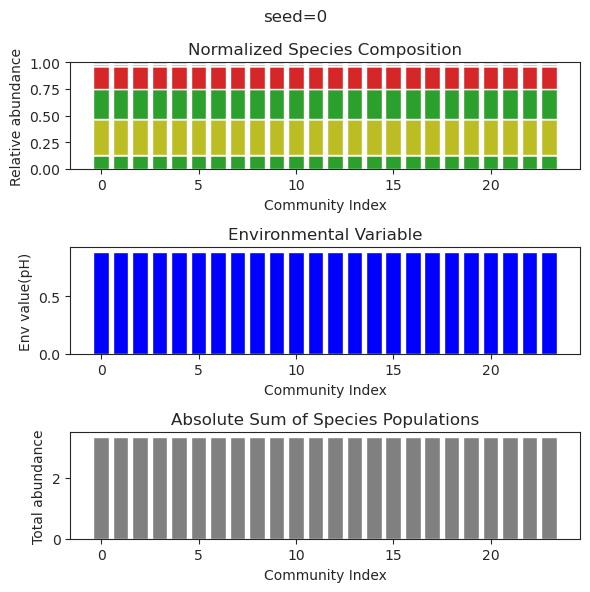

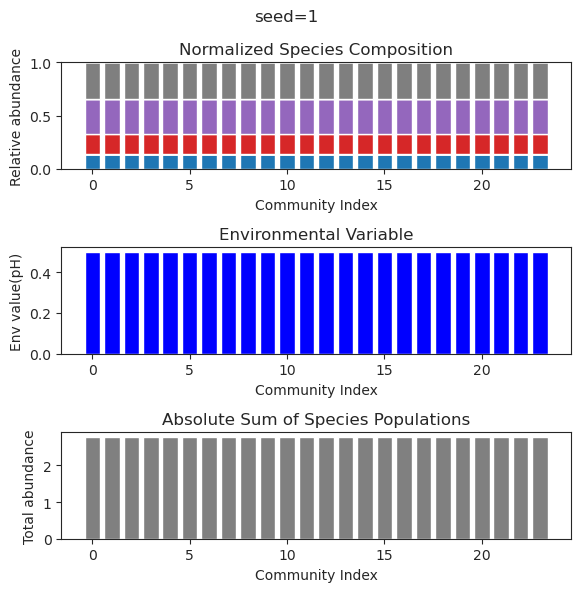

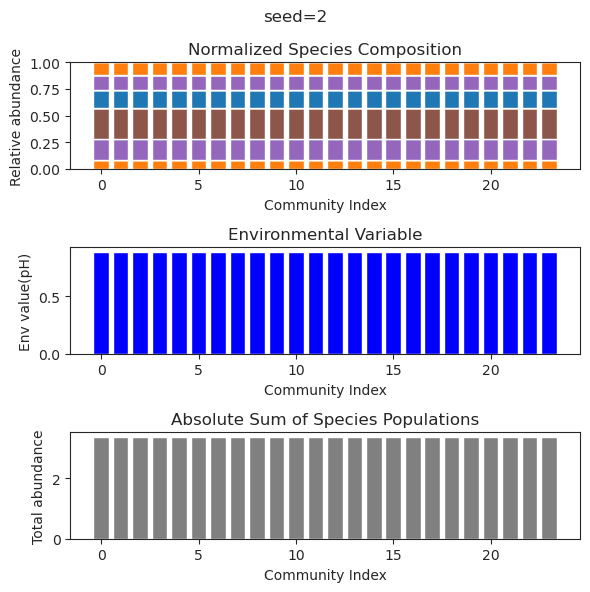

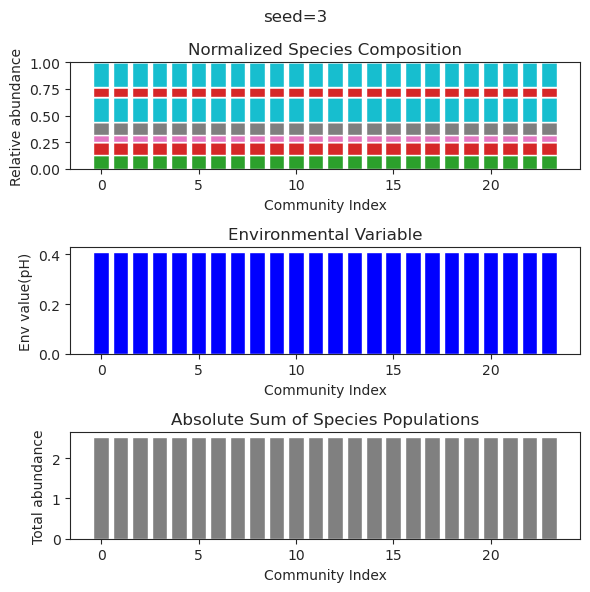

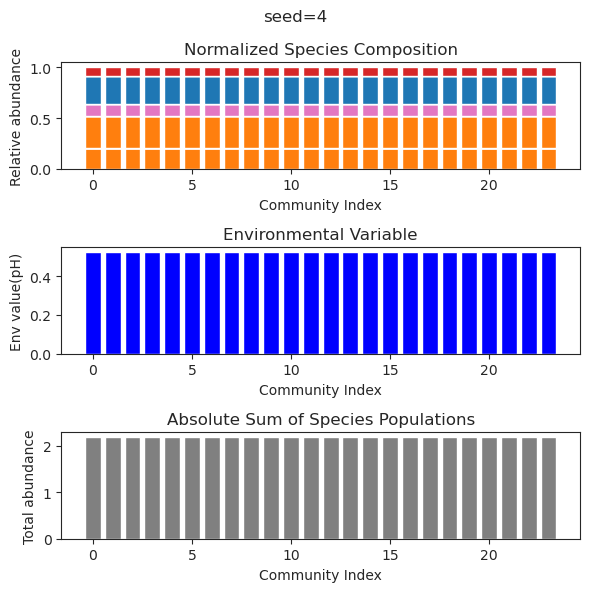

...

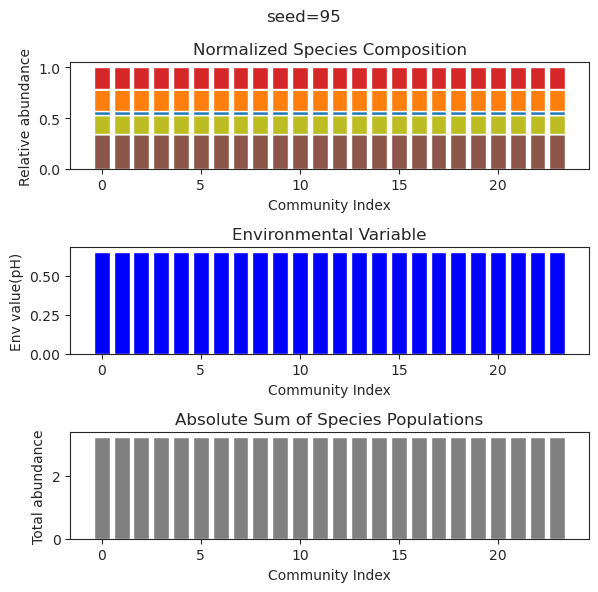

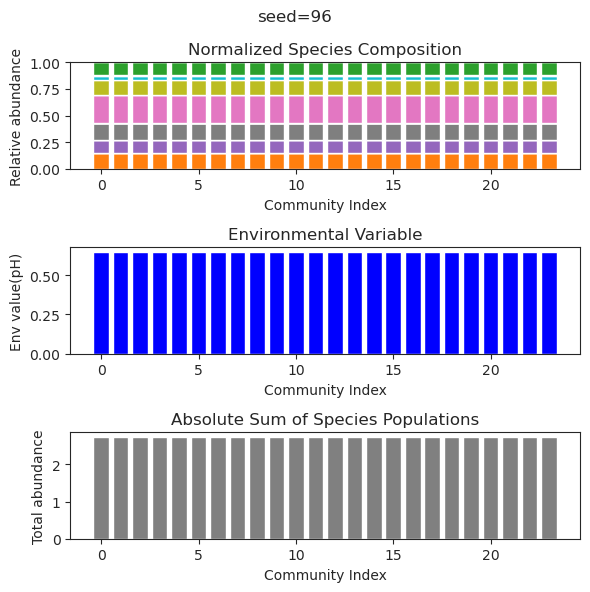

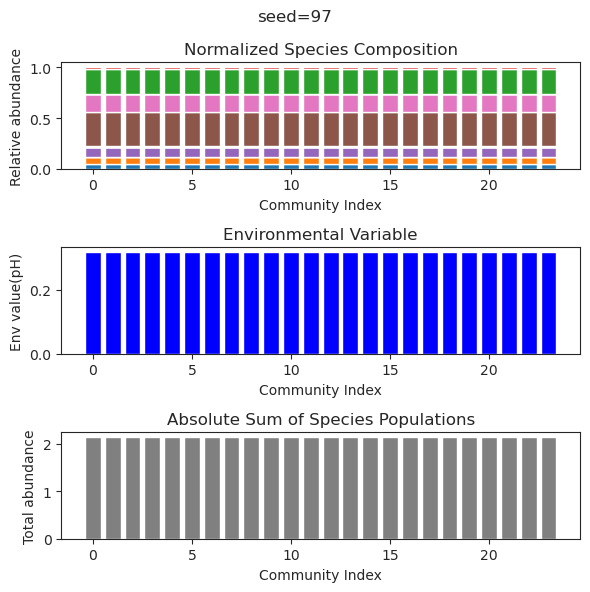

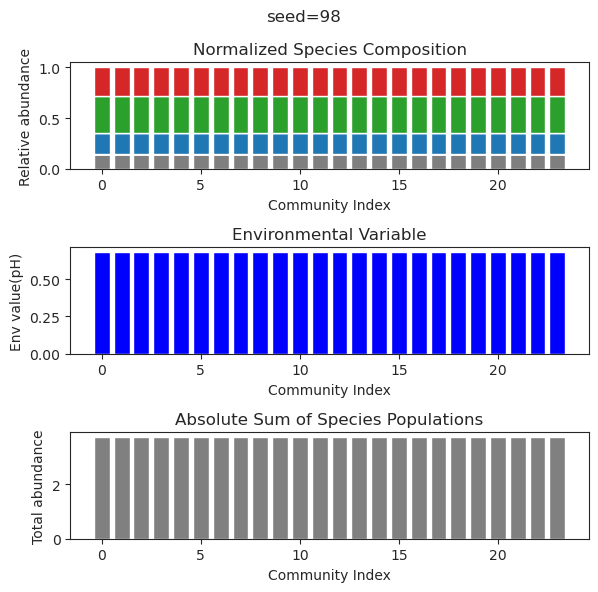

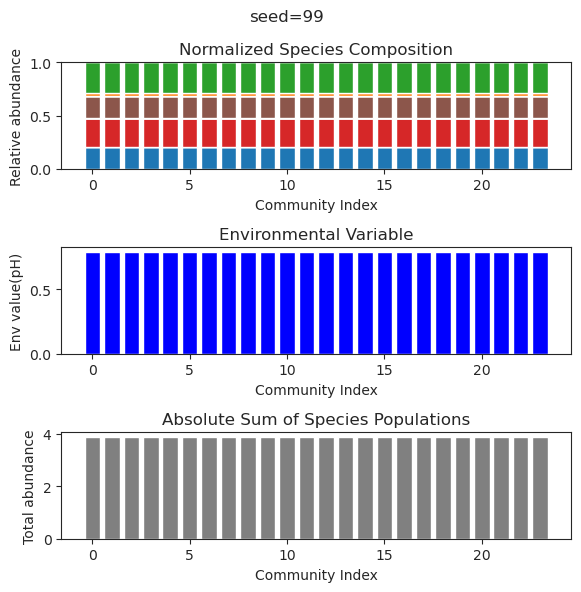

In [9]:
session_path='Results_qtailed/Session_Test2'
to_save={}
description=''
simulated_result={}

for seed_num in range(100):
    if not os.path.isdir(session_path):
        os.mkdir(session_path)
    # functions for uniform 

    f_I = lambda : uniform_distribution(0.5,0.5)
    f_g = lambda : np.ones(1)
    f_k = lambda : np.ones(1)
    f_p = lambda : uniform_distribution(0.5,0.5)
    f_q = lambda : custom_distribution(3,1)
    f_beta = lambda : np.ones(1)
    seed_num=seed_num
    to_plot=True

    np.random.seed(seed_num)

    N=24
    N_env=1


    I = np.zeros((N, N))
    for i in range(N):
        for j in range(N):
            I[i,j] = f_I()
    for i in range(N):
        I[i,i] =1

    g = np.zeros((N))
    for i in range(N):
        g[i] = f_g()

    k = np.zeros((N))
    for i in range(N):
        k[i] = f_k()   

    p = np.zeros((N_env, N))
    for i in range(N_env):
        for j in range(N):
            p[i,j] = f_p()

    #p[0,2]=-10

    q = np.zeros((N, N_env))
    for i in range(N):
        for j in range(N_env):
            q[i,j] = f_q()

    #q[2,0]=0.2



    beta = np.zeros(N_env)
    for i in range(N_env):
        beta[i]=f_beta()

    delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
    migration_rate=0#1e-7
    system_config = {
        'I': I,
        'g': g,
        'k': k,
        'p': p,
        'q': q,
        'beta': beta,
        'delta': delta,
        'migration_rate' : migration_rate,
        'N': N,
        'N_env': N_env,
        'seed_num':seed_num,
    } 

    file_path = f'{session_path}/system_config.json'

    label="test"
    sys
    ##

    y_out_list=[]
    system_config['beta'] = np.array([0.5])*delta

    for i in range(24):

        species_index=np.arange(0,24)
        env_index=np.array([0])
        y0_species=one_hot_vector(24,i)
        y0_env=[0]
        t=np.linspace(0, 2000, 10000)

        y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False)

        y_out_list.append(y_out)

    num_datasets = len(y_out_list)

    # Prepare subplots
    fig, axs = plt.subplots(3, 1, figsize=(6, 6))

    # Data for plots
    species_matrix = np.array([y_out['species'] for y_out in y_out_list])
    env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

    # Normalize species data
    species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
    species_sums = np.sum(species_matrix, axis=1, keepdims=True)
    normalized_species = species_matrix / species_sums

    # Absolute sums of species data (sum across all species for each dataset)
    absolute_sums = np.sum(species_matrix, axis=1)
    simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

    if to_plot:
        plt.suptitle(f'seed={seed_num}')

        # Plotting species composition as stacked bars
        bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
        for i in range(normalized_species.shape[1]):  # Loop through each species
            axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
            bottom_values += normalized_species[:, i]  # Update bottom values for stacking

        axs[0].set_title('Normalized Species Composition')
        axs[0].set_xlabel('Community Index')
        axs[0].set_ylabel('Relative abundance')
        #axs[0].legend()

        # Plotting environmental factors
        colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
        axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
        axs[1].set_title('Environmental Variable')
        axs[1].set_xlabel('Community Index')
        axs[1].set_ylabel('Env value(pH)')

        # Plotting absolute sums of species data
        axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
        axs[2].set_title('Absolute Sum of Species Populations')
        axs[2].set_xlabel('Community Index')
        axs[2].set_ylabel('Total abundance')

        plt.tight_layout()
        plt.savefig(session_path+f'/diagram_{seed_num}.png')

        #if to_plot:
        #    plt.savefig()


        #plt.show()
#simulated_result = {'a': 1, 'b': 2, 'c': 3}  # Your existing dictionary
#description = "This is a description of the simulated result."

# Combine both into a new dictionary
data_to_save = {
    'result': simulated_result,
    'description': description
}
# Serialize the combined data to a pickle file
with open(session_path+'/result_and_description.pkl', 'wb') as file:
    pickle.dump(data_to_save, file)

{'species': array([ 1.51547761e-143,  1.47220965e-001,  3.45361334e-001,
        5.47784805e-001,  5.23510102e-003,  8.84585949e-104,
        5.48106608e-028,  3.17874685e-001, -1.11826602e-030,
       -7.21147628e-144,  6.31455115e-001,  4.06209492e-002,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([ 1.32521210e-036,  1.47220965e-001,  3.45361333e-001,
        5.47784805e-001,  5.23510082e-003, -7.17228411e-049,
        8.56281132e-035,  3.17874684e-001,  6.37576677e-040,
       -5.07780987e-147,  6.31455116e-001,  4.06209484e-002,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+0

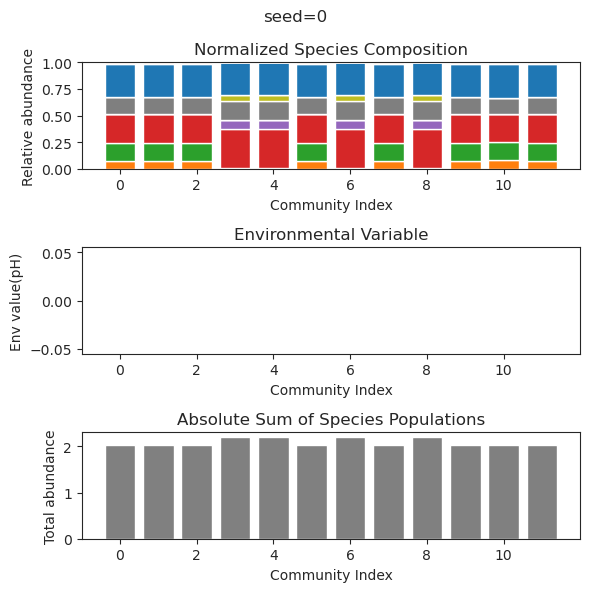

{'species': array([ 5.29390407e-01,  5.73184420e-29,  2.71823400e-01, -2.25996306e-30,
        3.72935408e-40,  3.90388110e-01,  8.02617429e-01,  4.87653120e-23,
        9.56448508e-44,  5.29001613e-01,  2.88216931e-20,  2.24785395e-36,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 5.29390407e-01, -3.47161766e-27,  2.71823400e-01,  7.36207278e-32,
       -4.40940162e-42,  3.90388110e-01,  8.02617429e-01,  1.42859561e-24,
       -2.86873273e-46,  5.29001613e-01,  2.38546632e-18, -7.95776302e-37,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 5.29390407e-

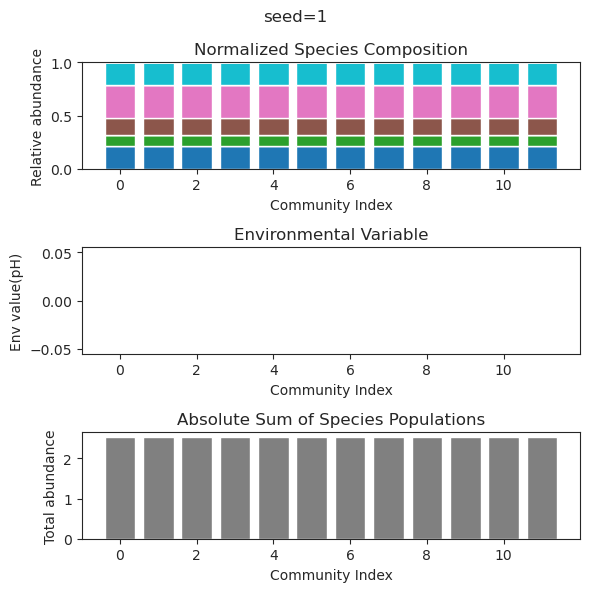

{'species': array([ 5.47962155e-001,  5.87880349e-001, -1.18803220e-103,
        3.11481294e-001,  6.72369926e-089,  1.30501029e-001,
        4.12854560e-002,  4.88326884e-002,  1.40792793e-001,
       -5.09914681e-043,  2.85306645e-001, -2.18057756e-041,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([ 5.47962155e-001,  5.87880349e-001, -6.89707884e-107,
        3.11481294e-001, -1.35375869e-093,  1.30501029e-001,
        4.12854559e-002,  4.88326883e-002,  1.40792793e-001,
       -1.74440406e-045,  2.85306645e-001, -3.43615123e-045,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+0

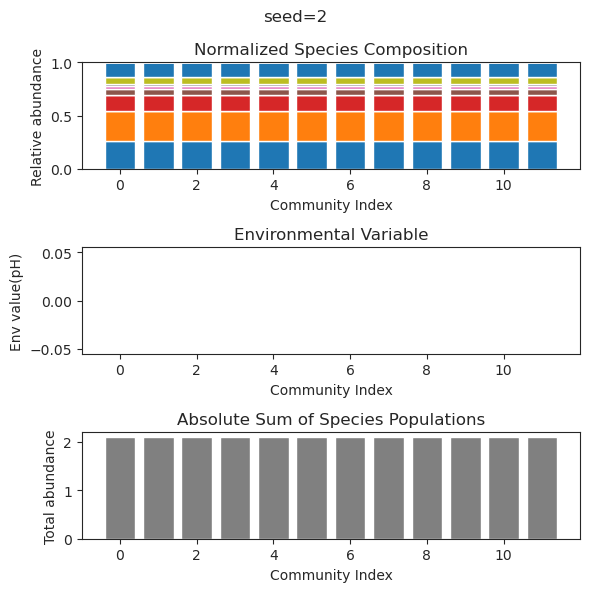

{'species': array([ 1.71912158e-01,  2.43745216e-62, -4.71784144e-41,  1.64343233e-13,
       -2.02557332e-57,  4.10543861e-01,  3.08734944e-41, -6.58678408e-42,
        7.34867262e-01,  4.43656683e-01, -1.66886215e-32,  4.96308956e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.71912158e-001, -3.05063950e-120,  1.59679261e-092,
       -8.27527256e-018, -1.14393875e-125,  4.10543861e-001,
        1.19036062e-097,  9.73258041e-066,  7.34867262e-001,
        4.43656683e-001, -1.82050151e-043,  4.96308956e-001,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([

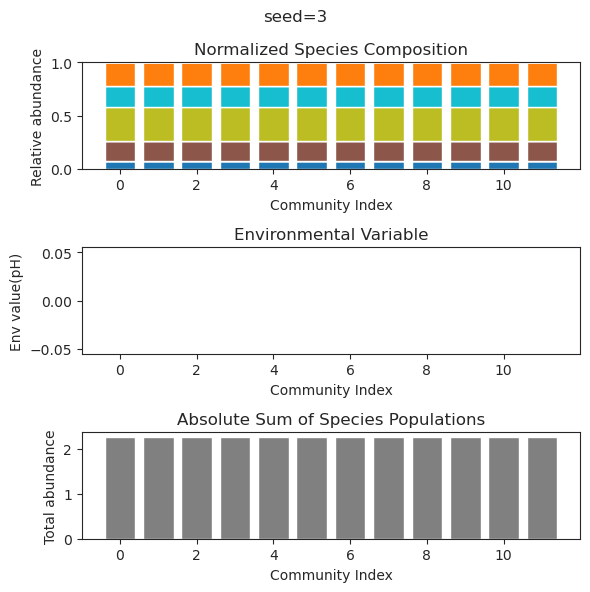

{'species': array([-5.69797826e-19,  1.01076632e-01,  1.10847102e-37,  1.00075045e-42,
        1.64807474e-01,  6.95255688e-32,  2.74991144e-01,  2.51496572e-01,
        7.10814055e-38, -2.95066906e-69,  6.21927382e-01,  5.47845968e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.25965199e-16,  1.01076632e-01,  5.39665613e-34, -1.21733096e-49,
        1.64807474e-01, -2.20444091e-27,  2.74991144e-01,  2.51496572e-01,
        9.55698885e-42,  3.89900652e-73,  6.21927382e-01,  5.47845968e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.04947618e-

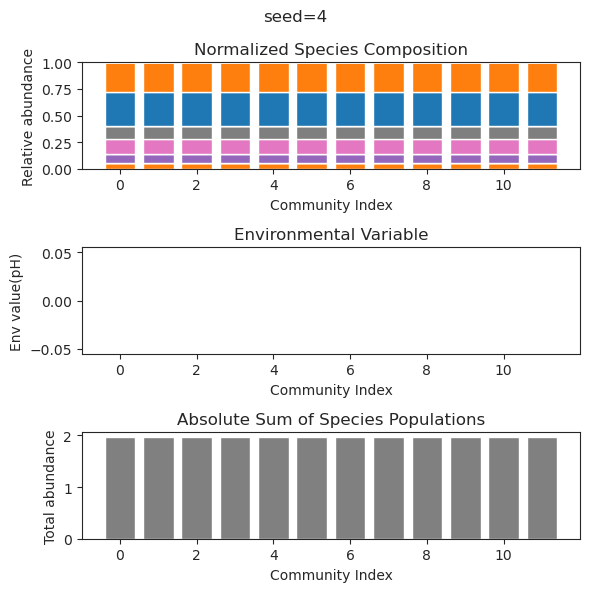

{'species': array([1.68908569e-01, 3.89919880e-01, 2.73273974e-28, 1.91331528e-45,
       2.62614376e-01, 3.61029637e-01, 2.35267957e-60, 2.07051888e-02,
       3.13399899e-01, 6.56919188e-73, 4.79345212e-01, 1.03331786e-35,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.68908569e-01,  3.89919880e-01, -1.16331772e-31,  2.76798476e-40,
        2.62614376e-01,  3.61029637e-01,  4.01130733e-44,  2.07051888e-02,
        3.13399899e-01,  4.75653385e-49,  4.79345212e-01, -2.09269465e-35,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.68908569e-01,  3.89919880e-01,  1.

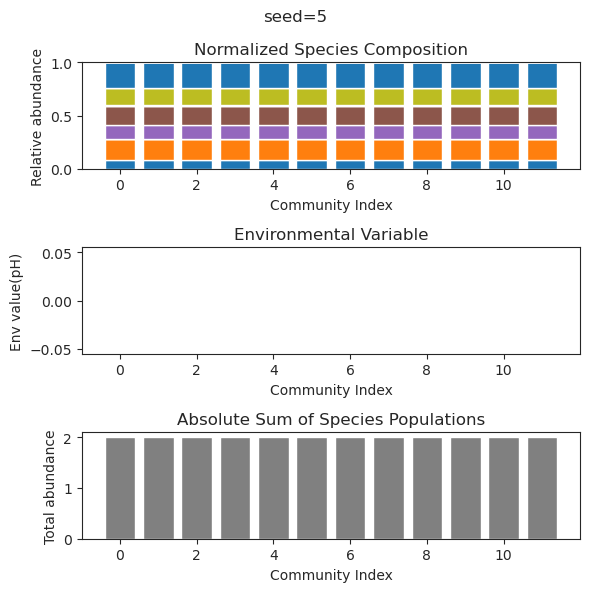

{'species': array([ 2.53480564e-01,  1.00752368e-76,  1.33205048e-01,  3.81728488e-01,
       -3.38836775e-21,  2.65881255e-01, -1.38895259e-18,  4.23341075e-01,
        1.22642392e-57,  9.33502950e-02, -1.05746533e-33,  3.09270779e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.53480564e-01, -2.81641826e-70,  1.33205048e-01,  3.81728488e-01,
       -1.21836339e-20,  2.65881255e-01,  2.83992087e-32,  4.23341075e-01,
       -1.64837248e-55,  9.33502950e-02, -7.98718580e-33,  3.09270779e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.05835748e-

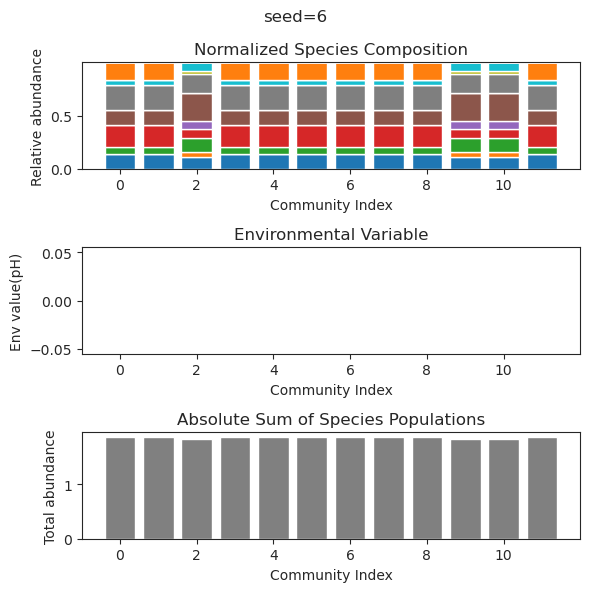

{'species': array([4.41346196e-01, 1.26358643e-37, 8.10668407e-01, 2.16676276e-08,
       1.19902766e-03, 1.20596555e-02, 1.99200011e-01, 5.54256550e-01,
       2.07957139e-01, 5.55146468e-50, 2.19681748e-54, 3.01931645e-27,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.17923984e-008,  1.53782834e-001,  1.83547120e-001,
        2.41029585e-001, -1.77393904e-113, -6.59999963e-047,
        5.50610414e-001,  2.66610773e-001,  2.06079998e-002,
        3.11351410e-001,  3.36750393e-002,  1.87374878e-001,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array(

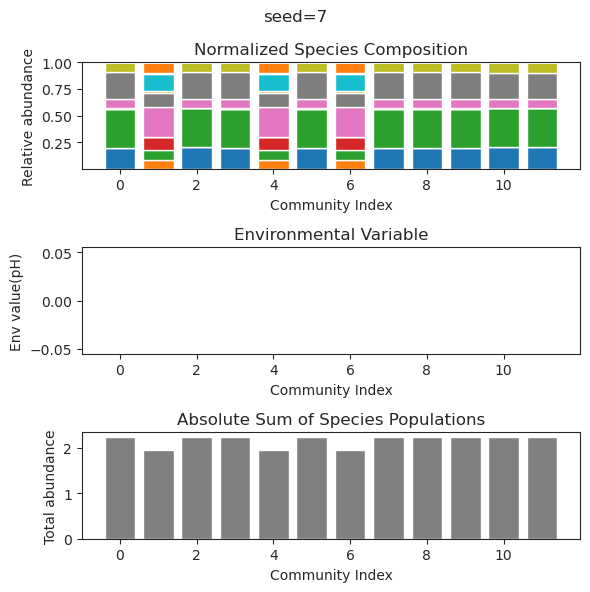

{'species': array([ 1.73388095e-042,  4.70106643e-001,  2.67123986e-001,
        7.00683646e-083,  1.76031422e-038,  1.81163687e-001,
        3.05334265e-001,  1.81082269e-001,  3.99162335e-001,
       -1.85768968e-118,  2.32444667e-002,  1.97296221e-008,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([-1.81994357e-059,  4.70106635e-001,  2.67123988e-001,
        2.23631553e-102, -6.88719765e-081,  1.81163693e-001,
        3.05334270e-001,  1.81082280e-001,  3.99162337e-001,
       -3.36461810e-155,  2.32444681e-002,  1.95871095e-009,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+0

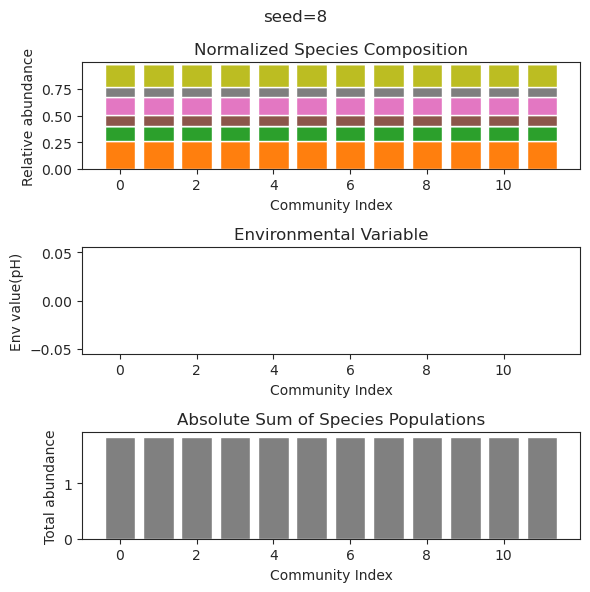

{'species': array([ 6.90758498e-001,  1.82531741e-100,  4.16323115e-002,
        2.93349836e-001, -1.23392675e-064,  5.34861516e-001,
        1.05579522e-080,  1.88728423e-040, -6.01484586e-065,
        5.16997698e-002,  6.87037586e-001, -5.27936786e-075,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([ 6.90758498e-01,  2.93346605e-44,  4.16323115e-02,  2.93349836e-01,
       -1.97014862e-38,  5.34861516e-01,  1.88633315e-39, -6.97436904e-32,
       -4.68114360e-35,  5.16997698e-02,  6.87037586e-01, -1.17696076e-38,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([

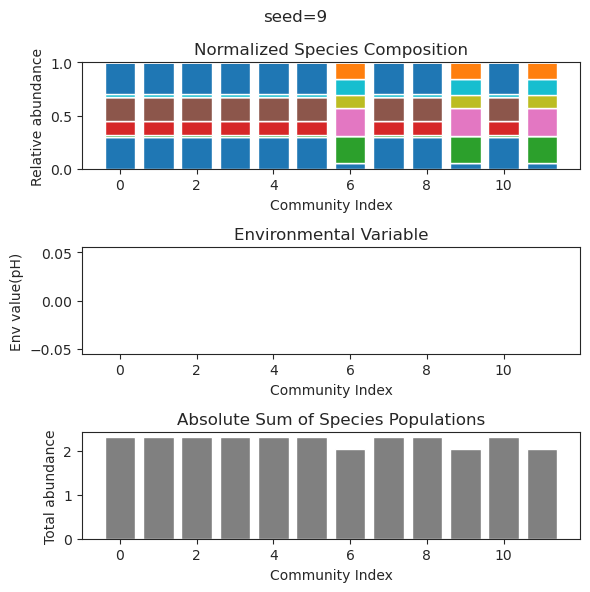

{'species': array([ 3.71957963e-01, -1.53180229e-40,  5.22581468e-01,  4.13873180e-42,
        1.54167006e-31,  7.70590223e-01,  6.24463928e-01, -7.04043952e-45,
       -4.95282569e-22, -1.20903447e-17,  2.00251641e-45, -5.21524552e-45,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.71957963e-01,  7.20920030e-48,  5.22581468e-01,  9.73611409e-48,
        3.56303849e-34,  7.70590223e-01,  6.24463928e-01, -2.66303252e-46,
       -1.45966075e-27, -2.41674881e-18,  1.03719540e-51, -4.91140062e-49,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.71957963e-

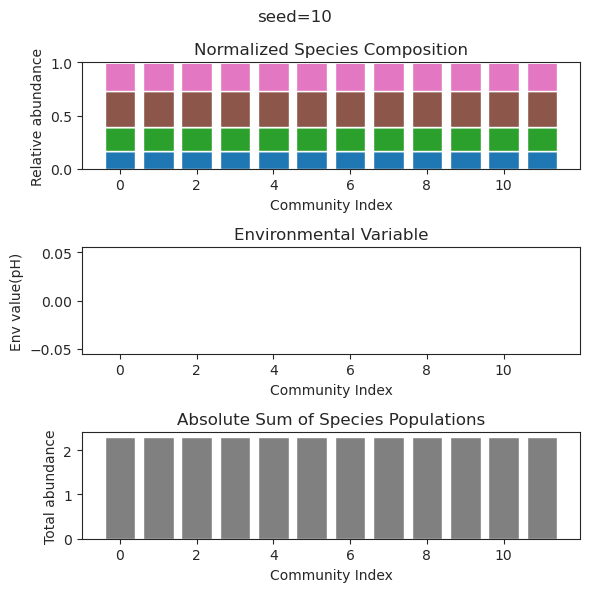

{'species': array([1.90487769e-001, 2.01255922e-001, 1.12306403e-001, 5.23349305e-017,
       1.53408380e-001, 7.33591518e-251, 4.26706918e-001, 1.61057652e-006,
       4.32906351e-001, 2.80167377e-001, 1.13288234e-001, 1.82763055e-002,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000]), 'env': array([0.])}
{'species': array([3.10963218e-002, 3.25317168e-002, 2.59424374e-001, 7.08509195e-014,
       1.74278882e-001, 7.46257909e-253, 3.97213944e-001, 8.34526444e-002,
       2.52977937e-001, 2.43535386e-001, 3.90473912e-001, 4.60641987e-002,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000]), 'env': array([0.])}
{'species': array([2.94217145e-0

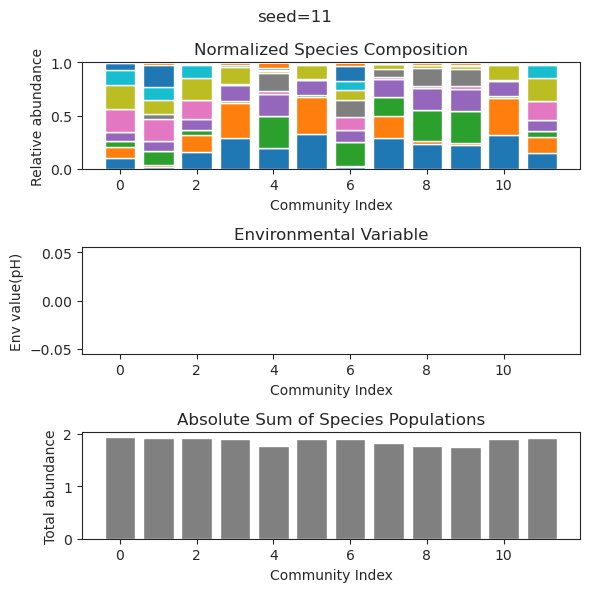

{'species': array([ 1.36216478e-001, -7.59714247e-105,  5.81833876e-001,
       -4.62657124e-057,  2.71759356e-012,  3.55034011e-023,
        2.73775876e-002, -1.13243773e-079,  2.47087147e-001,
        2.70193517e-001,  4.03151418e-001,  4.91631810e-001,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([ 1.36216478e-01, -1.47376747e-58,  5.81833876e-01, -6.98450934e-48,
        5.49521453e-12, -2.87158058e-22,  2.73775876e-02,  1.45193113e-41,
        2.47087147e-01,  2.70193517e-01,  4.03151418e-01,  4.91631810e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([

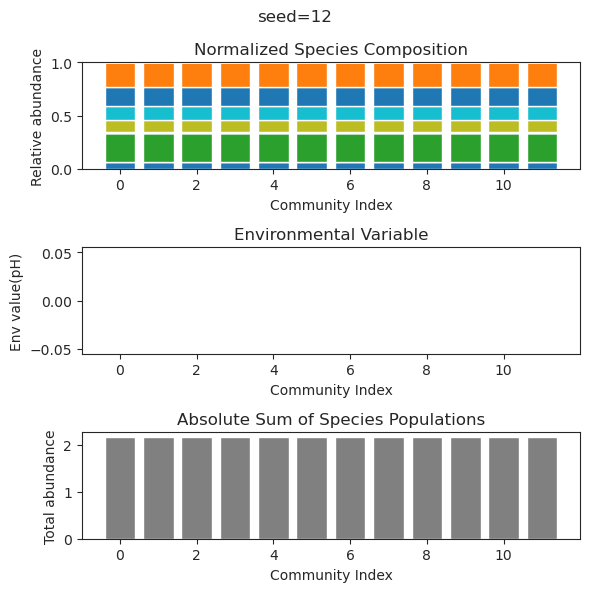

{'species': array([ 2.22743944e-40,  1.14592847e-37,  2.72473088e-01, -3.32839355e-24,
       -1.12620753e-27,  2.99350314e-01,  5.36634346e-01,  1.92156353e-01,
        5.79941776e-01, -4.24631630e-24, -1.33675198e-18, -5.78368682e-34,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.37050500e-29,  9.49707063e-26,  2.72473088e-01, -3.23459276e-18,
       -3.51891347e-19,  2.99350314e-01,  5.36634346e-01,  1.92156353e-01,
        5.79941776e-01, -1.12049800e-17,  7.53550180e-17, -3.95464296e-27,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-8.72768274e-

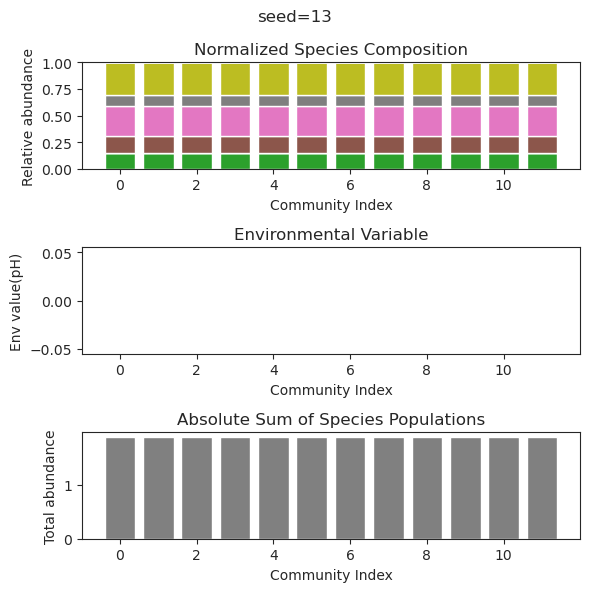

{'species': array([5.97386827e-204, 4.94065646e-324, 4.81586664e-001, 1.63979140e-001,
       1.44024197e-001, 1.16396215e-001, 1.16326327e-001, 7.13220068e-002,
       6.26405925e-001, 2.22387789e-003, 2.13936854e-001, 1.89440599e-001,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000]), 'env': array([0.])}
{'species': array([1.54864786e-205, 4.94065646e-324, 4.75561553e-001, 1.70557899e-001,
       1.42779005e-001, 1.18103762e-001, 1.23048811e-001, 7.02898009e-002,
       6.21314218e-001, 2.52190980e-003, 2.12348708e-001, 1.88187998e-001,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000]), 'env': array([0.])}
{'species': array([5.36139196e-2

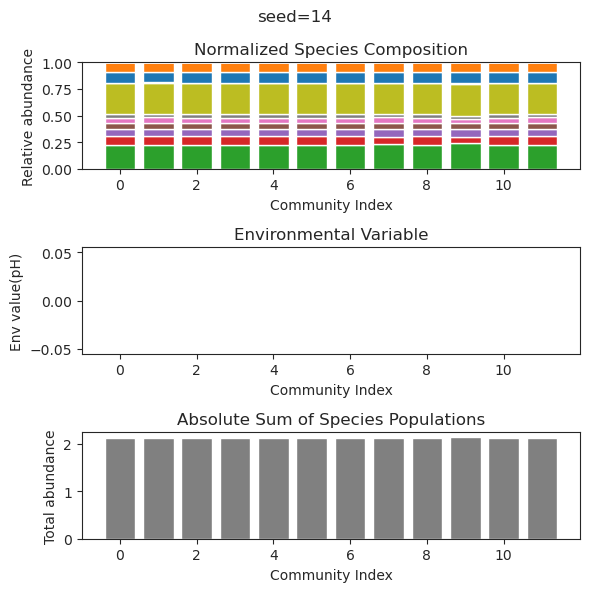

{'species': array([ 3.84610040e-01,  4.26900645e-02,  4.78965108e-05,  5.39707448e-01,
        3.64438567e-09,  3.04944016e-01, -3.32867862e-36,  1.78781097e-01,
        1.73961436e-01,  7.13489086e-02,  1.73601505e-01,  5.29505777e-09,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.84610031e-01,  4.26824870e-02,  2.87480904e-06,  5.39711247e-01,
        3.47677183e-13,  3.04972133e-01, -1.02156038e-54,  1.78806758e-01,
        1.73940018e-01,  7.13860177e-02,  1.73571913e-01,  1.28896994e-12,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([3.84610031e-0

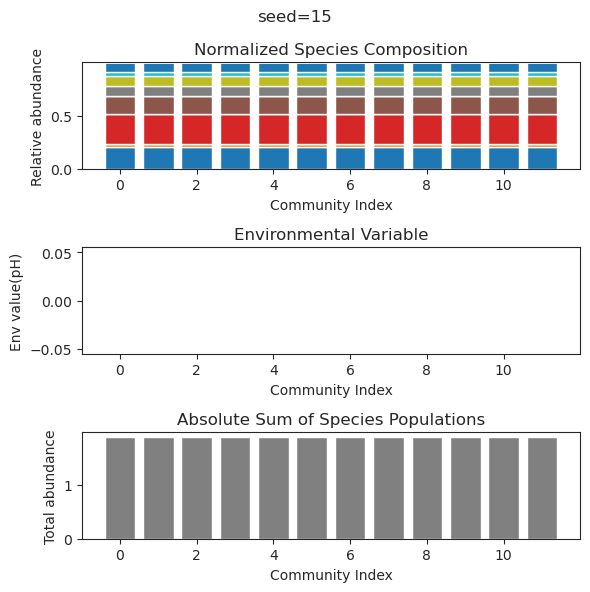

{'species': array([ 3.10736491e-09,  1.36595584e-01, -4.78503637e-47,  8.01164275e-45,
        6.58155883e-39,  3.16163314e-01,  4.73481027e-01, -2.78056737e-43,
       -7.88793861e-71,  5.35551586e-01, -1.02725488e-54,  4.53918543e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 4.34011039e-09,  1.36595584e-01,  3.78212946e-40,  2.86463133e-41,
       -1.72247012e-95,  3.16163312e-01,  4.73481026e-01,  5.23408300e-42,
        1.05042068e-95,  5.35551587e-01, -5.41488404e-67,  4.53918544e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.16746867e-

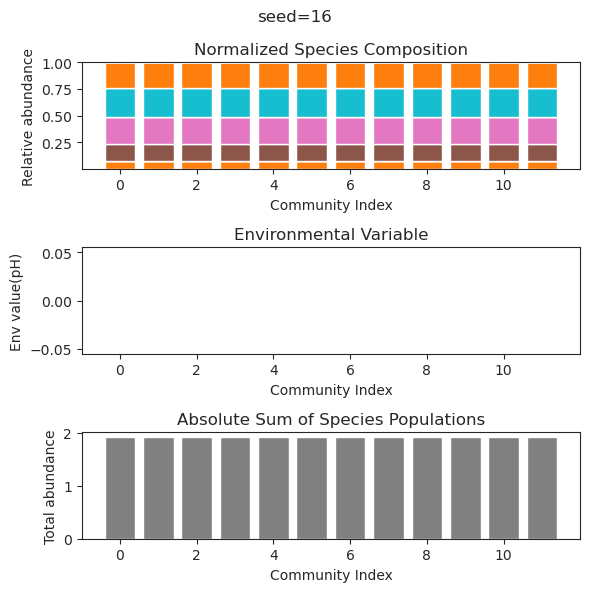

{'species': array([ 1.69566150e-01,  3.34863252e-01,  4.12778619e-41,  1.39307944e-01,
        2.46479744e-51,  2.45740466e-15,  4.07441362e-01,  5.29593904e-01,
        6.34388832e-40,  1.65533864e-01, -1.06025272e-55,  3.24464208e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.69566150e-01,  3.34863252e-01, -1.52497461e-52,  1.39307944e-01,
       -3.51757180e-42,  1.51503390e-14,  4.07441362e-01,  5.29593904e-01,
        9.64405502e-41,  1.65533864e-01, -1.84791022e-71,  3.24464208e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.69566150e-

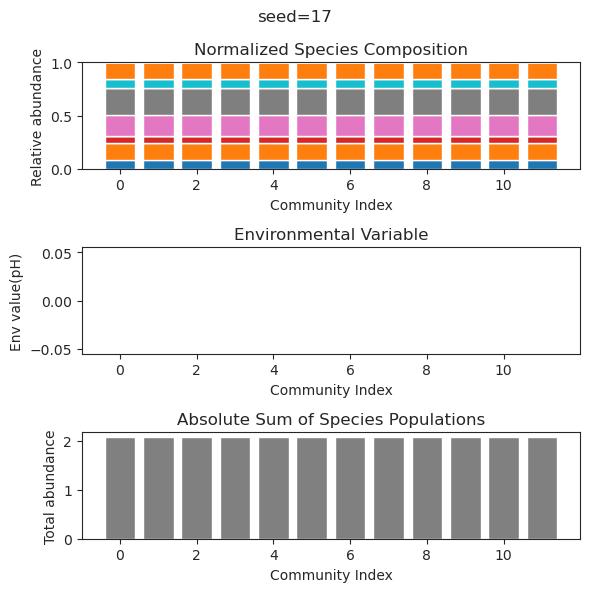

{'species': array([2.78207093e-001, 7.98149453e-002, 2.16651907e-001, 4.57302627e-103,
       5.09967401e-047, 4.38475085e-002, 1.39449076e-094, 2.13373500e-087,
       1.06293256e-001, 7.26766769e-001, 2.10369716e-051, 4.84263033e-001,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000]), 'env': array([0.])}
{'species': array([ 2.78207093e-001,  7.98149453e-002,  2.16651907e-001,
       -4.74689974e-125, -8.73450712e-058,  4.38475085e-002,
        1.22968369e-116,  8.29830833e-096,  1.06293256e-001,
        7.26766769e-001, -7.43039237e-059,  4.84263033e-001,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([

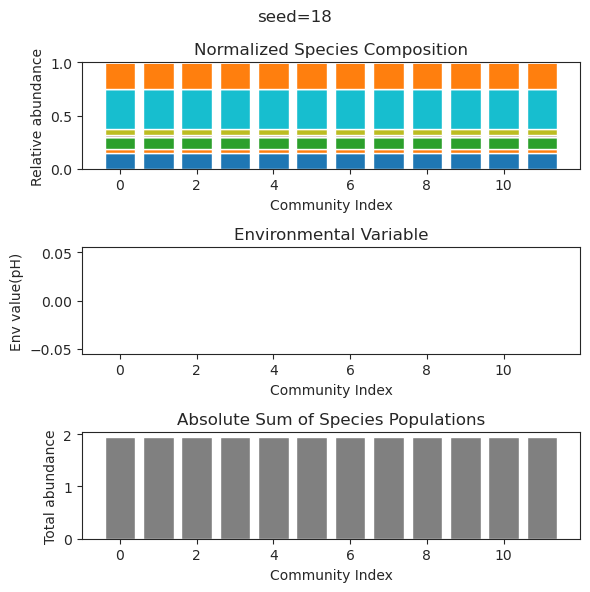

{'species': array([-7.22636975e-40,  1.72161536e-05,  1.20137526e-56,  5.58097166e-23,
        1.25082296e-46,  4.60433196e-01,  5.55386531e-01,  7.62995297e-01,
        2.02265523e-01,  1.32049975e-18, -8.83682483e-33, -5.07145653e-47,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 8.25347407e-48,  3.48488855e-01, -1.48505583e-60, -6.85059468e-30,
       -1.74692045e-60,  2.72336359e-01,  2.46820788e-01, -1.33397340e-22,
        4.99910486e-01,  1.67427825e-01,  4.34817878e-02,  3.38928150e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-8.21580177e-

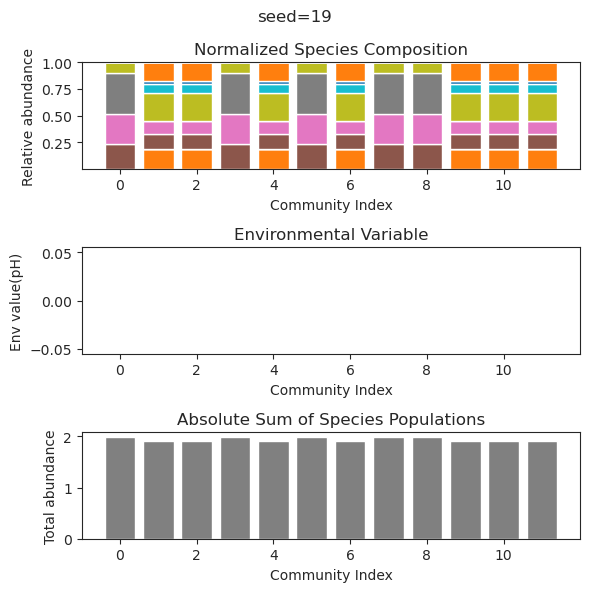

{'species': array([ 3.94521249e-01, -7.36234431e-35,  3.56463981e-02,  3.21649525e-01,
        5.33681703e-02, -3.09858727e-42,  7.05906765e-53,  1.94508266e-02,
        2.14177243e-01,  1.86809010e-01,  4.48570588e-01,  4.38667180e-47,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.94521248e-01,  1.43971703e-33,  3.56463996e-02,  3.21649524e-01,
        5.33681708e-02,  2.77508316e-41, -9.04594916e-57,  1.94508288e-02,
        2.14177242e-01,  1.86809010e-01,  4.48570587e-01,  6.93697332e-59,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.94521248e-

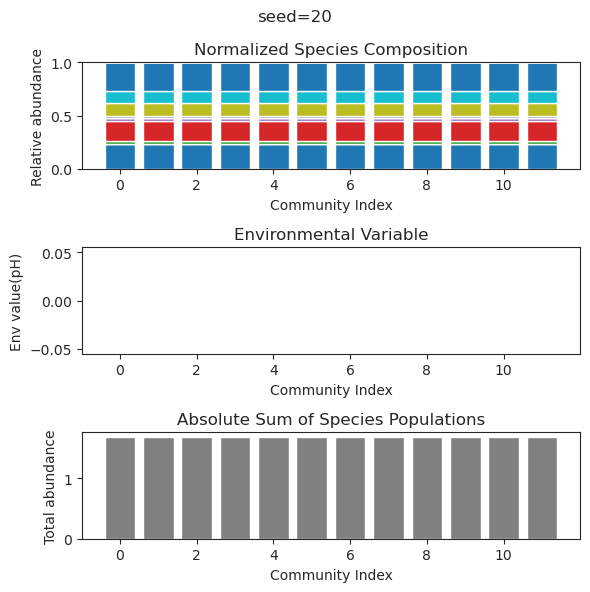

{'species': array([4.77294875e-001, 8.69994524e-002, 5.60895127e-002, 1.54470397e-102,
       3.90785771e-015, 2.11970157e-001, 3.28013126e-001, 1.22383636e-077,
       2.48816033e-001, 2.99953850e-001, 2.45759710e-095, 1.10085062e-001,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000]), 'env': array([0.])}
{'species': array([ 4.77294875e-01,  8.69994524e-02,  5.60895127e-02, -2.40188220e-90,
        1.70046985e-15,  2.11970157e-01,  3.28013126e-01, -4.78104160e-78,
        2.48816033e-01,  2.99953850e-01, -1.38398537e-77,  1.10085062e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 4.77294875e-

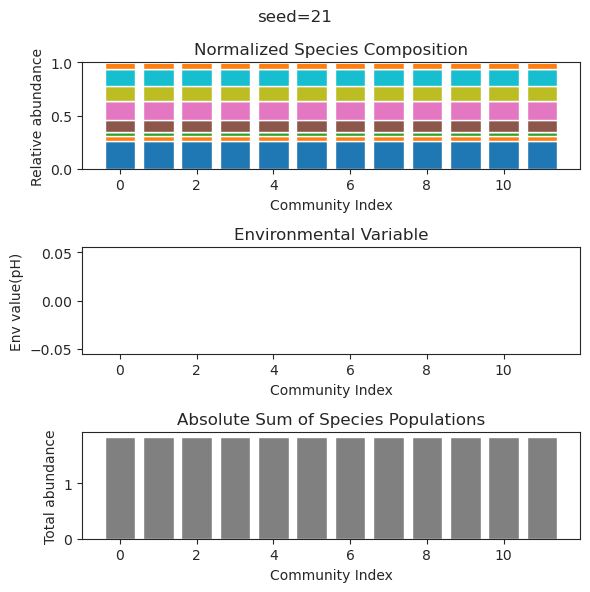

{'species': array([ 7.46671780e-18,  2.71064720e-02, -1.38948011e-43,  4.02187400e-01,
        8.39781215e-13,  1.80943874e-01,  2.90342125e-01,  3.09720322e-01,
        3.90931756e-01, -1.42211088e-68, -1.66262841e-76,  3.95514374e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-6.62093043e-19,  2.71064720e-02, -3.55174402e-43,  4.02187400e-01,
        1.86454893e-17,  1.80943874e-01,  2.90342125e-01,  3.09720322e-01,
        3.90931756e-01, -7.78864744e-47,  5.20271548e-49,  3.95514374e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 4.27732273e-

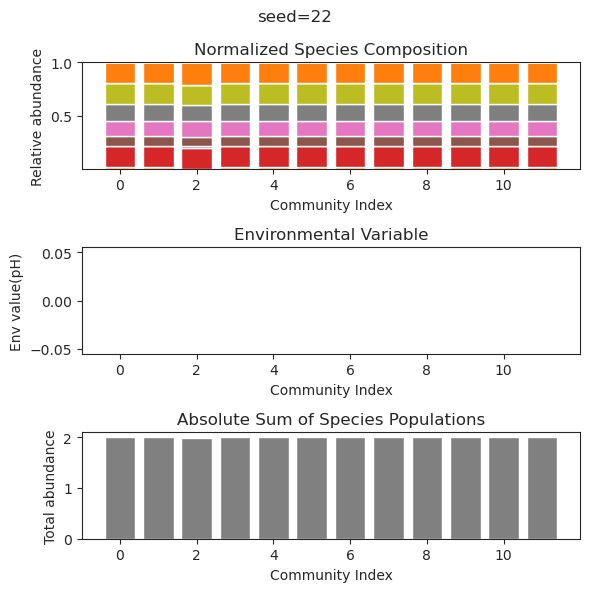

{'species': array([ 7.09285903e-01, -1.61819189e-28,  4.01877105e-44,  2.32550294e-01,
        7.95525055e-01, -1.38295235e-32,  2.94339735e-01, -7.38544203e-44,
        1.19120420e-37, -9.76649314e-47,  1.42464576e-05,  3.11649574e-43,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 7.29914224e-35,  6.85406681e-24,  6.32787562e-01,  1.22532808e-01,
       -1.61318556e-51, -1.31895205e-43,  3.18974740e-01,  6.61853075e-01,
        1.02884127e-57,  3.55425738e-29,  4.83992731e-01,  4.65198763e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.03342029e-

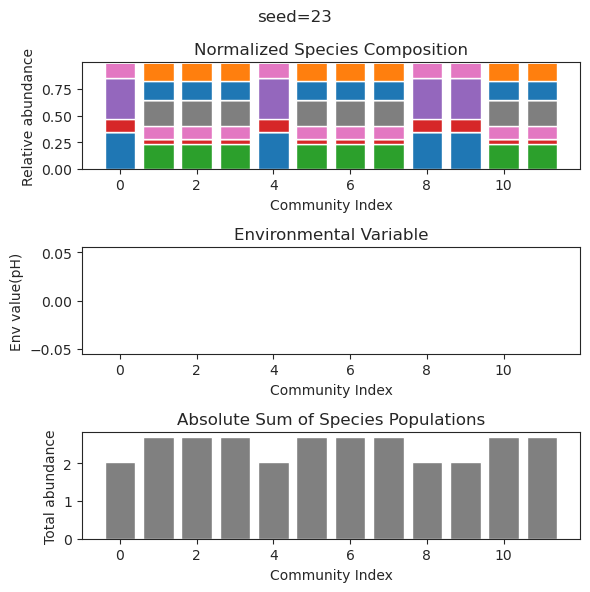

{'species': array([ 7.96222217e-02, -4.12822194e-19,  4.99051989e-47,  3.66999772e-01,
        3.32073598e-01,  2.89954879e-01,  2.33471083e-01,  6.02281289e-53,
        3.83358925e-22,  7.09807117e-01,  1.89455472e-51, -1.69624180e-32,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 7.96222217e-02, -6.33448102e-19, -2.31114969e-49,  3.66999772e-01,
        3.32073598e-01,  2.89954879e-01,  2.33471083e-01, -3.30299595e-55,
       -5.50158163e-25,  7.09807117e-01,  1.34383812e-54, -5.31349777e-32,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 7.96222217e-

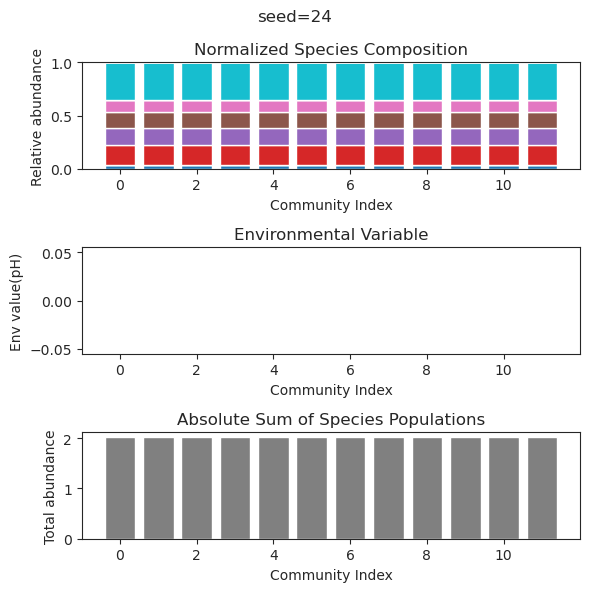

{'species': array([ 1.67463432e-01,  7.94735089e-03,  1.19990374e-18,  2.00189096e-01,
        2.76906526e-01, -2.25465703e-31,  4.75997862e-01,  4.33064411e-01,
        1.89446496e-02, -2.65428634e-40,  3.74684714e-01,  6.37032834e-45,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.67465575e-01,  7.94664882e-03,  2.51457458e-20,  2.00175518e-01,
        2.76925377e-01, -7.82794979e-42,  4.75998115e-01,  4.33058103e-01,
        1.89216881e-02,  4.61355389e-96,  3.74705973e-01,  1.54696234e-48,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([1.67463668e-0

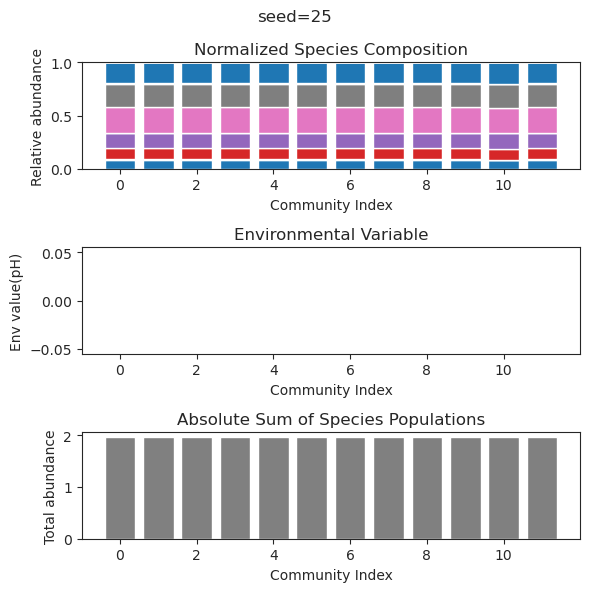

{'species': array([ 7.35004466e-35, -1.75791552e-37, -6.71207084e-37,  8.49807380e-03,
        5.79635031e-01,  6.07531458e-02,  7.89054673e-01,  5.47197661e-44,
        1.05494817e-01,  1.00236966e-36,  4.87482883e-01,  2.90787851e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-5.91556345e-37,  3.83274102e-28,  6.71720132e-46,  8.49806742e-03,
        5.79635036e-01,  6.07531459e-02,  7.89054674e-01, -1.97721459e-48,
        1.05494819e-01,  6.50951120e-35,  4.87482882e-01,  2.90787851e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 6.95733150e-

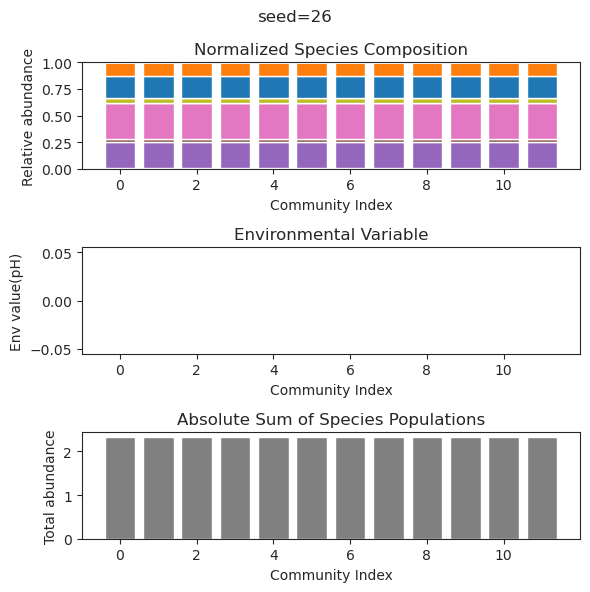

{'species': array([ 2.96456234e-34,  1.58225586e-01, -2.43628591e-30,  3.25370214e-01,
       -1.32436647e-32,  5.54265543e-04,  6.03731896e-01,  1.33810309e-58,
        8.95863727e-02,  1.74530455e-01,  2.57033710e-01,  1.80499675e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.11892398e-126,  1.58129027e-001, -5.64918614e-090,
        3.25362784e-001, -4.16667733e-069,  6.45693880e-004,
        6.03730261e-001, -3.33154068e-061,  8.96700794e-002,
        1.74564163e-001,  2.56965958e-001,  1.80502921e-001,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([

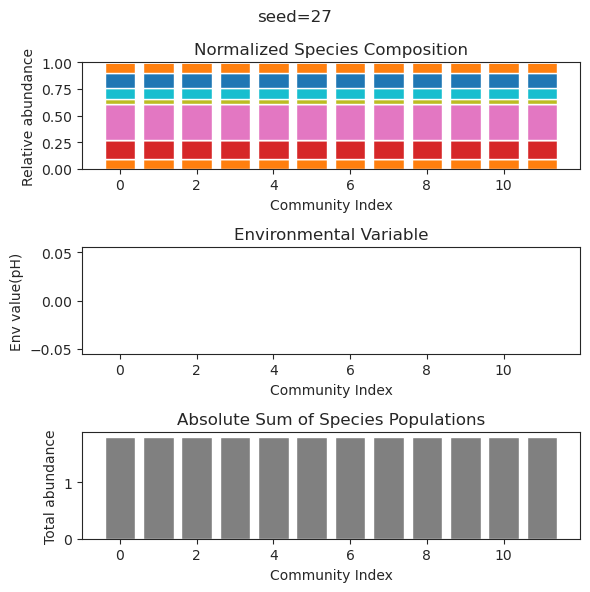

{'species': array([-1.41615795e-85,  1.83267288e-01,  7.51498798e-02, -2.48809728e-38,
        2.15129261e-01,  3.90000706e-01,  7.09127915e-02, -7.15838273e-82,
        3.45165826e-01,  3.47986911e-77,  5.15827769e-01,  3.87981580e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-5.58287793e-78,  1.83267288e-01,  7.51498798e-02, -3.32979221e-35,
        2.15129261e-01,  3.90000706e-01,  7.09127915e-02,  5.79997986e-70,
        3.45165826e-01,  2.49272729e-70,  5.15827769e-01,  3.87981580e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-4.29254010e-

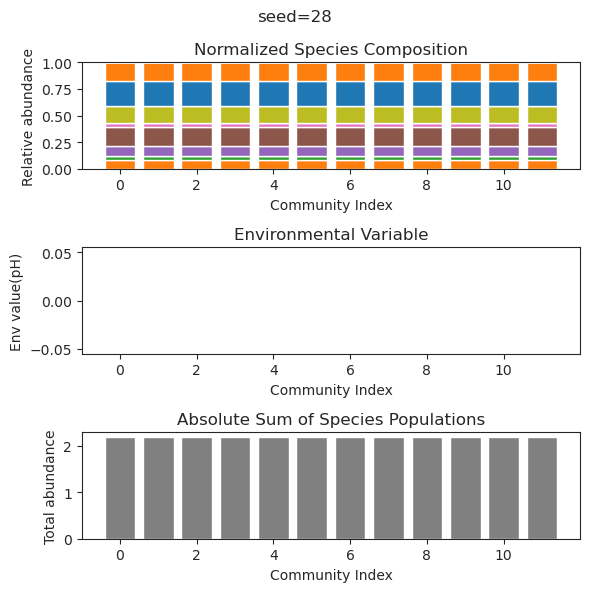

{'species': array([ 1.71630652e-08,  3.58397863e-01, -3.11036207e-32,  7.81575725e-40,
        9.09307668e-44, -4.27452219e-42,  1.56535926e-01,  2.20392274e-35,
        4.29051376e-02,  6.92499805e-01,  6.16737692e-01,  1.41190036e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.49132579e-08,  3.58397863e-01,  3.00275149e-32, -4.92396125e-41,
        1.43621946e-41, -3.78406978e-59,  1.56535926e-01, -1.44488419e-73,
        4.29051373e-02,  6.92499807e-01,  6.16737694e-01,  1.41190036e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.78982614e-

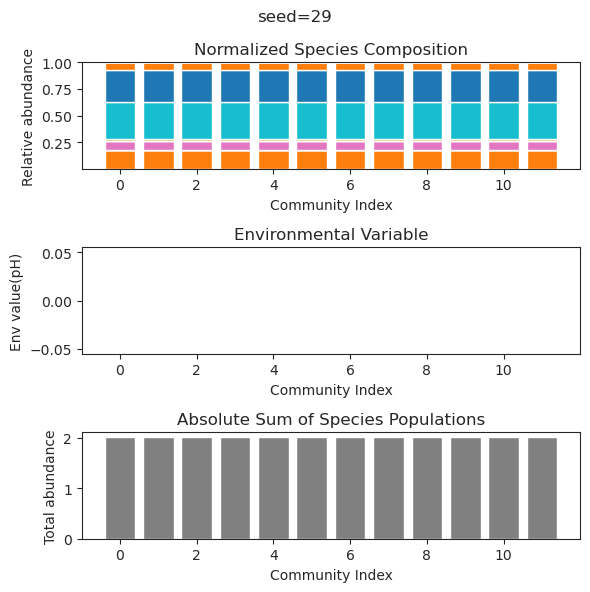

{'species': array([ 3.35789052e-57,  2.19920181e-01, -1.58307679e-41,  4.35721370e-01,
        4.17585734e-01,  4.36199441e-01,  2.84951407e-01, -2.53009671e-43,
        2.94047280e-01,  2.81404904e-36,  2.30015713e-18, -2.63682419e-51,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 9.69321922e-36,  2.19920181e-01,  8.44448151e-26,  4.35721370e-01,
        4.17585734e-01,  4.36199441e-01,  2.84951407e-01,  4.64170127e-31,
        2.94047280e-01, -4.00929629e-25,  2.05481114e-14, -3.63440566e-30,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 6.97854522e-

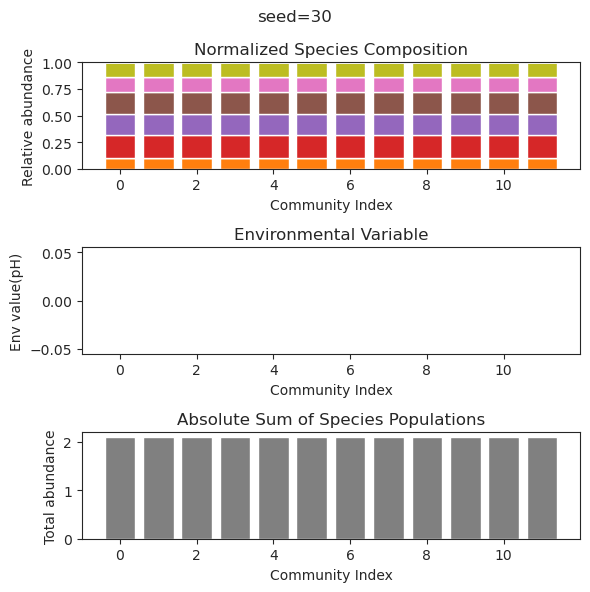

{'species': array([ 7.62585520e-01,  6.73405653e-02,  1.83355213e-24, -2.26799136e-57,
        3.66782080e-50,  3.79763171e-01,  3.05177105e-41,  5.99616482e-01,
        3.79154136e-01, -1.11037187e-51,  5.72480080e-01, -1.07626109e-52,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 7.62585520e-01,  6.73405653e-02, -3.60520260e-27,  8.41606968e-66,
       -1.03497615e-66,  3.79763171e-01,  3.33341108e-42,  5.99616482e-01,
        3.79154136e-01,  8.57932209e-58,  5.72480080e-01, -2.43949146e-54,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 7.62585520e-

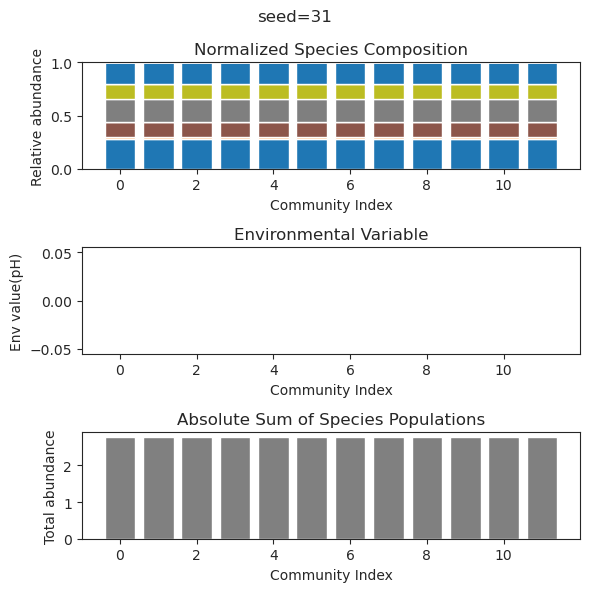

{'species': array([ 9.20375375e-037,  4.92443083e-001,  3.32917198e-001,
        1.48114887e-001,  9.34333188e-118, -1.53319270e-060,
        2.00465181e-001,  3.75570606e-001,  1.11747124e-023,
        3.97002231e-002,  3.00141271e-076,  5.37511606e-001,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([ 2.53945522e-30,  4.44313929e-01,  1.95031125e-01,  3.90480317e-01,
        4.26259832e-29,  1.27296292e-01, -3.89177878e-29,  1.21277756e-02,
        2.31749685e-01,  2.71099093e-29,  1.11352229e-01,  3.92805282e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([

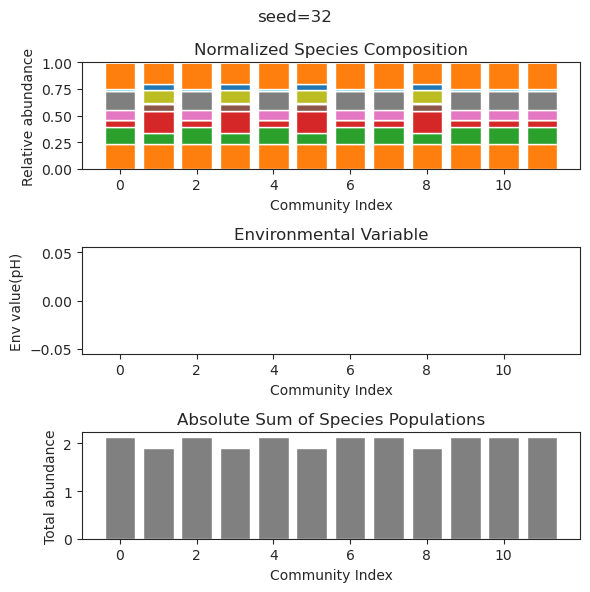

{'species': array([ 3.65093411e-01, -3.32627641e-53,  7.11382585e-01,  2.15628616e-26,
        5.74850969e-22,  7.78420656e-67,  7.00266125e-01,  3.44926858e-01,
        5.82004304e-33,  6.34757499e-18,  1.59351720e-31,  8.08920858e-26,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.65093411e-01, -1.29066058e-55,  7.11382585e-01,  1.71064854e-23,
       -1.45938104e-20,  9.16077827e-62,  7.00266125e-01,  3.44926858e-01,
       -1.98136142e-36, -1.38530700e-17,  8.48848611e-35,  8.86183862e-28,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.65093411e-

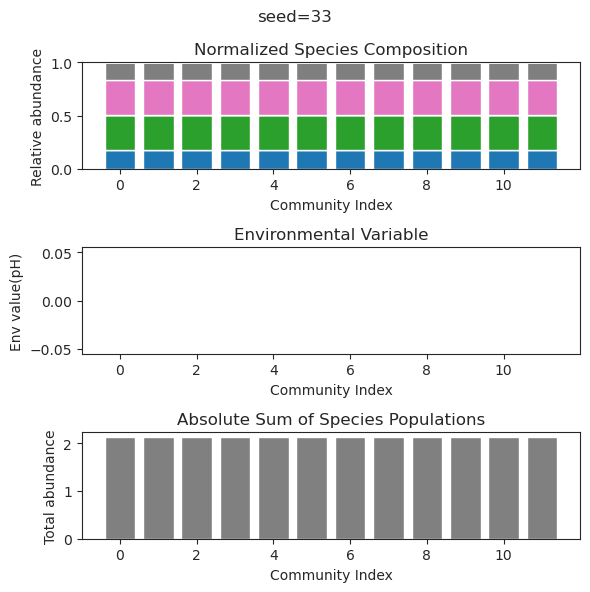

{'species': array([2.75630105e-77, 1.11821580e-01, 2.54610064e-01, 8.75977326e-12,
       9.44314065e-90, 6.55957295e-01, 2.51336599e-01, 2.58649208e-01,
       5.17592153e-76, 1.48566510e-54, 2.25993932e-02, 6.39536107e-01,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00]), 'env': array([0.])}
{'species': array([-3.32840857e-57,  1.16450191e-01,  2.61161335e-01,  5.97650120e-02,
        3.46368543e-75,  6.39009864e-01,  1.91713735e-01,  2.71609697e-01,
       -4.86901055e-59,  8.53949170e-50,  2.42002708e-10,  6.51972362e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.03366001e-35,  1.11821581e-01,  2.

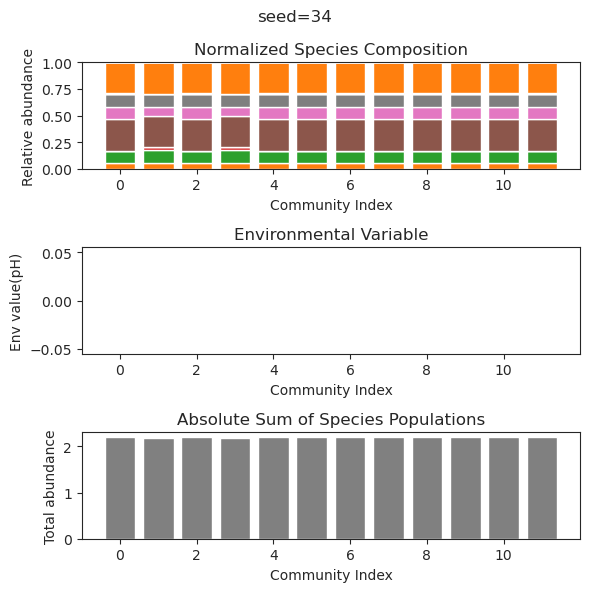

{'species': array([ 7.03933552e-01,  6.29804186e-40,  8.37620514e-08, -4.36559434e-35,
       -5.78415535e-92, -2.41338868e-67, -2.50848619e-99, -8.10655453e-76,
        3.78075894e-01,  2.66800385e-37,  1.07819260e-43,  8.32987505e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-1.53108697e-24, -1.48175714e-62,  6.34096045e-02, -1.12859979e-24,
        1.87879519e-19,  3.24618844e-74,  6.58975981e-01,  3.92183359e-34,
        1.18338512e-36,  3.26616803e-31,  8.19684874e-01,  4.94994624e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 7.03933555e-

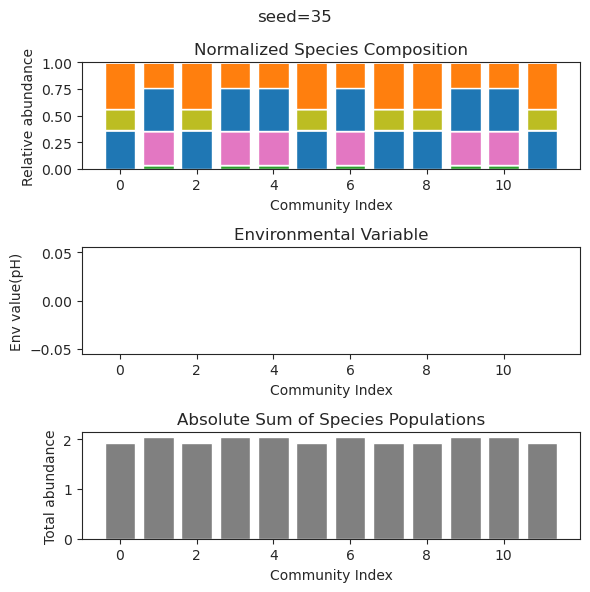

{'species': array([ 1.56549101e-075,  7.82475864e-001, -1.77320392e-016,
        7.66056167e-151,  8.70233696e-002,  5.82056743e-001,
        1.07628327e-001,  2.80705968e-127,  3.63254009e-001,
       -1.09041206e-031,  1.52400965e-001,  1.96285439e-002,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([-3.24486047e-065,  7.82475864e-001,  6.87722892e-018,
       -2.09678930e-140,  8.70233696e-002,  5.82056743e-001,
        1.07628327e-001, -1.02597735e-111,  3.63254009e-001,
        3.26005918e-033,  1.52400965e-001,  1.96285439e-002,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+0

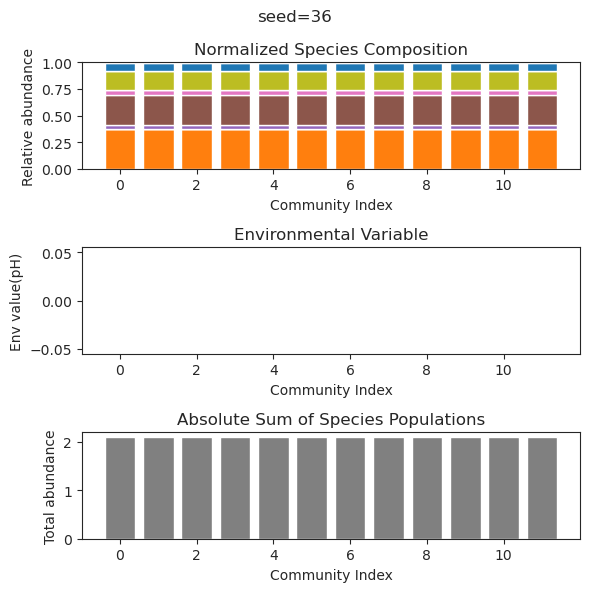

{'species': array([ 1.82572436e-001,  3.76046454e-001,  1.37803728e-042,
       -6.58175991e-079, -9.97703798e-068,  7.44858840e-002,
       -1.70104596e-109,  4.26893477e-001,  5.83401351e-001,
        8.03361455e-002,  3.81385589e-113,  7.75694526e-002,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([ 1.82572436e-01,  3.76046454e-01,  1.35699986e-35, -3.02719940e-58,
        5.05171103e-52,  7.44858840e-02, -5.50400811e-79,  4.26893477e-01,
        5.83401351e-01,  8.03361455e-02, -2.12074015e-86,  7.75694526e-02,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([

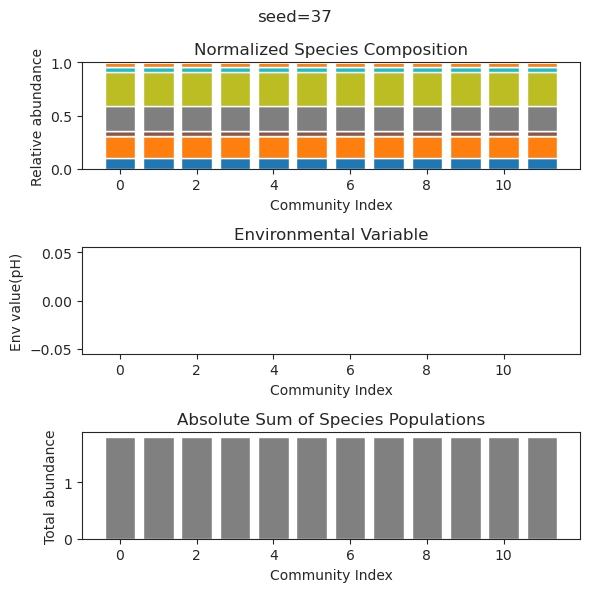

{'species': array([ 1.09938294e-28, -1.53837598e-19,  1.86362673e-01,  3.27373172e-01,
        3.91010515e-01,  1.36485361e-76,  2.61321942e-01,  2.44858620e-01,
        9.58996023e-49,  1.50245398e-78,  2.62069779e-01,  4.92213918e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-3.67303073e-33, -7.59378177e-17,  1.86362673e-01,  3.27373172e-01,
        3.91010515e-01,  3.66508408e-64,  2.61321942e-01,  2.44858620e-01,
       -1.63655619e-48,  1.21495215e-67,  2.62069779e-01,  4.92213918e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-7.27354669e-

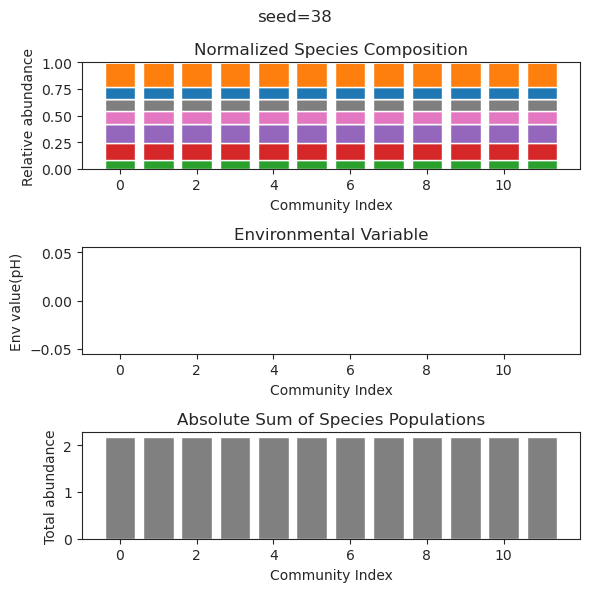

{'species': array([ 2.96514806e-57,  2.00406503e-01,  3.51359881e-01,  1.32877365e-01,
        3.31055935e-01,  2.44164356e-01, -1.50877483e-68,  1.58325561e-06,
        1.55484594e-18,  2.40503102e-01,  2.60363677e-45,  1.88149286e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-4.53279104e-30,  2.00368548e-01,  3.51375424e-01,  1.32878433e-01,
        3.31063049e-01,  2.44121437e-01,  8.14941002e-63,  1.62775861e-05,
        5.99297752e-19,  2.40514473e-01,  8.28017528e-29,  1.88170204e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 6.72402434e-

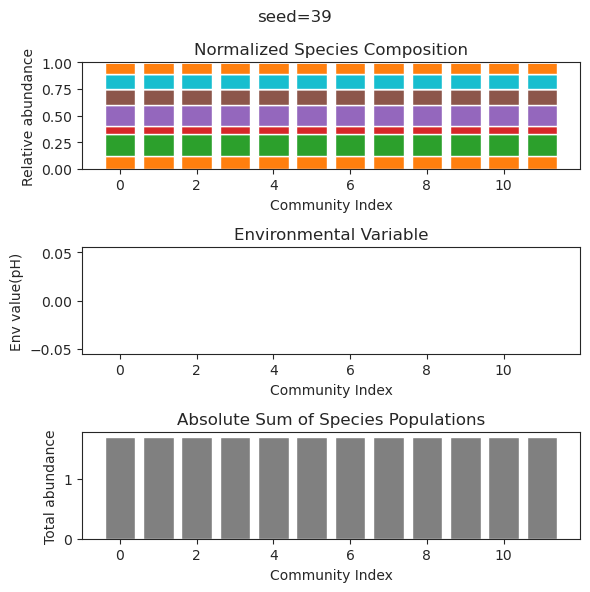

{'species': array([-1.48124910e-44,  1.56036715e-01,  4.87335437e-95,  2.71193865e-01,
        1.63918146e-01,  3.10665021e-01,  2.73262174e-01,  1.65013350e-01,
        5.03616393e-01, -7.50661445e-17,  2.08055015e-01,  7.95469146e-94,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-1.12875832e-39,  1.56036715e-01, -3.51445302e-74,  2.71193865e-01,
        1.63918146e-01,  3.10665021e-01,  2.73262174e-01,  1.65013350e-01,
        5.03616393e-01,  2.28123947e-21,  2.08055015e-01, -2.44849444e-70,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.82678521e-

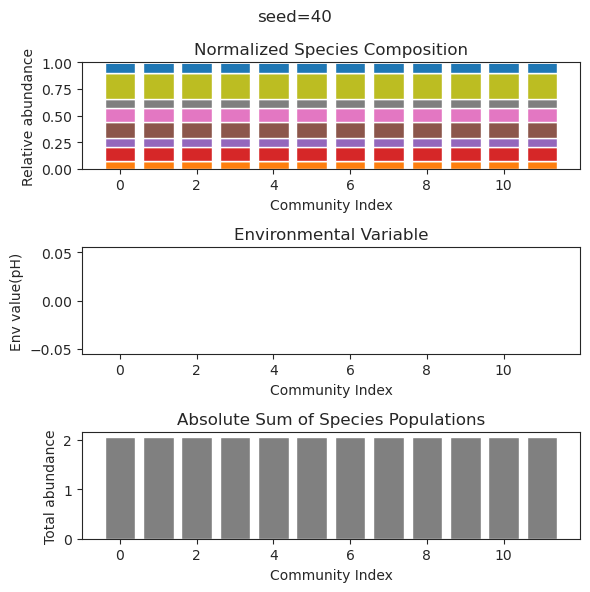

{'species': array([ 2.95728004e-001,  4.22809337e-001,  1.76566048e-001,
        1.80595360e-001,  4.44162896e-001,  2.06803158e-001,
        2.80769448e-002, -6.60838372e-039,  4.00707500e-001,
       -6.69972922e-105, -6.57992212e-017,  2.77270624e-002,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([ 2.95728004e-001,  4.22809337e-001,  1.76566048e-001,
        1.80595360e-001,  4.44162896e-001,  2.06803158e-001,
        2.80769448e-002, -4.30505371e-040,  4.00707500e-001,
        1.07777615e-103, -1.37627931e-019,  2.77270624e-002,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+0

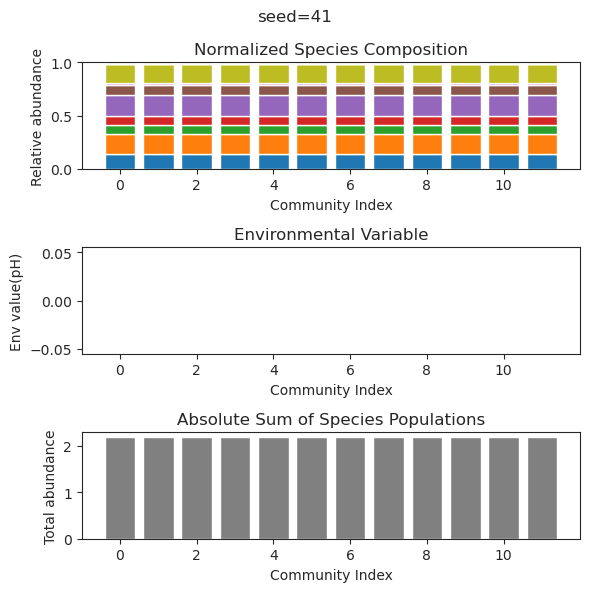

{'species': array([ 2.93338758e-01, -7.77333751e-27,  9.07044443e-63,  3.20550940e-01,
        4.19928043e-01, -1.46844544e-42,  5.65448463e-01,  3.32954675e-01,
        1.31844156e-63,  1.80777250e-01, -1.17426720e-28,  4.51282095e-63,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.93338758e-01, -4.21576693e-32,  2.11120553e-73,  3.20550940e-01,
        4.19928043e-01, -1.10581238e-47,  5.65448463e-01,  3.32954675e-01,
       -8.53944219e-77,  1.80777250e-01, -3.98385870e-32,  1.39995773e-79,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.93338758e-

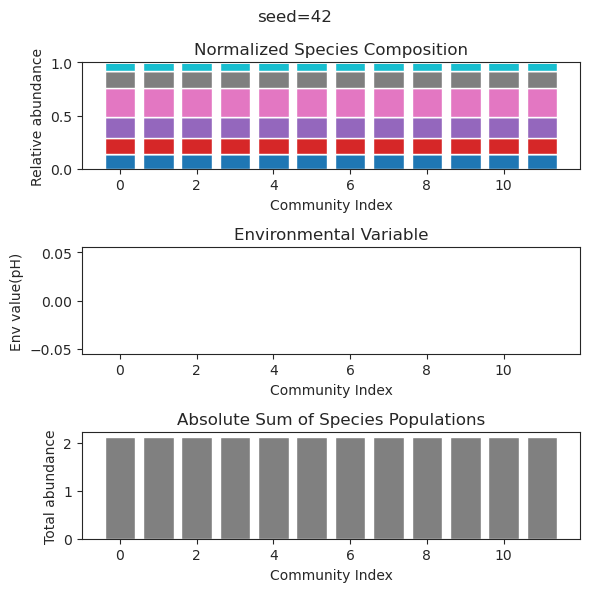

{'species': array([-1.63376318e-28,  2.50225711e-03, -5.18206703e-29,  5.12997483e-02,
       -8.64402760e-28,  1.72624601e-01,  3.13170578e-01,  4.06497270e-46,
        1.70078633e-01,  4.01905371e-01,  7.61239628e-02,  5.43116477e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-2.10849805e-28,  2.31003192e-03, -1.20229524e-28,  5.14006383e-02,
       -2.41578654e-23,  1.72652765e-01,  3.13209448e-01,  2.29049144e-30,
        1.70049025e-01,  4.01990138e-01,  7.60529304e-02,  5.43074449e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-6.81108787e-

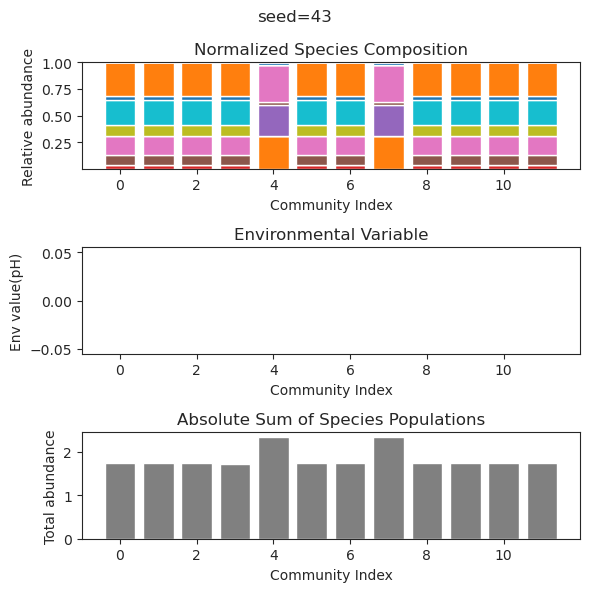

{'species': array([ 6.39520923e-31,  5.43969485e-28,  7.24526916e-01, -3.39259331e-35,
        1.16333061e-01,  1.89345896e-28,  2.46902072e-30,  1.28099721e-01,
        4.34431999e-02,  6.30274453e-05,  2.76075225e-01,  4.80482384e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-1.63171905e-28,  7.13005875e-67,  7.24538443e-01, -3.42293630e-33,
        1.16285736e-01, -1.38992339e-33,  1.12972668e-59,  1.28176371e-01,
        4.34055545e-02,  8.84523547e-07,  2.76113446e-01,  4.80519418e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-9.42052773e-

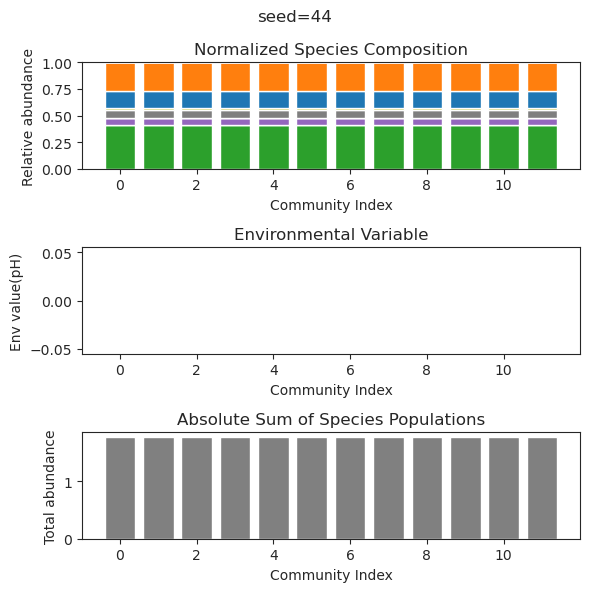

{'species': array([2.80449779e-01, 5.48599787e-01, 1.77640115e-01, 5.16787630e-02,
       4.77663173e-02, 6.60922639e-01, 3.07563020e-02, 1.76746481e-01,
       1.67132072e-58, 1.81738512e-69, 1.47781925e-29, 1.69203468e-52,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.80449779e-001,  5.48599787e-001,  1.77640115e-001,
        5.16787630e-002,  4.77663173e-002,  6.60922639e-001,
        3.07563020e-002,  1.76746481e-001,  1.99938152e-156,
       -2.75286227e-165,  8.94762380e-028, -9.09806104e-110,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array(

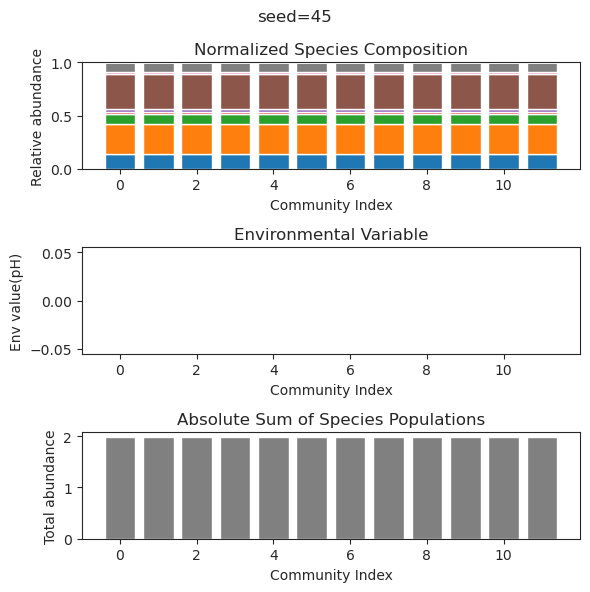

{'species': array([ 4.65142499e-001,  5.05993860e-001,  1.54168009e-001,
       -9.79475278e-037, -1.72125192e-081,  1.10778770e-087,
        5.88580081e-001,  6.13256427e-108,  1.24916889e-001,
        3.22715004e-002,  1.91867989e-093,  2.51015687e-001,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([4.65142499e-01, 5.05993860e-01, 1.54168009e-01, 1.15716483e-30,
       1.22455440e-39, 8.76144861e-43, 5.88580081e-01, 2.11928696e-47,
       1.24916889e-01, 3.22715004e-02, 4.37142743e-44, 2.51015687e-01,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00]), 'env': array([0.])}
{'species': array(

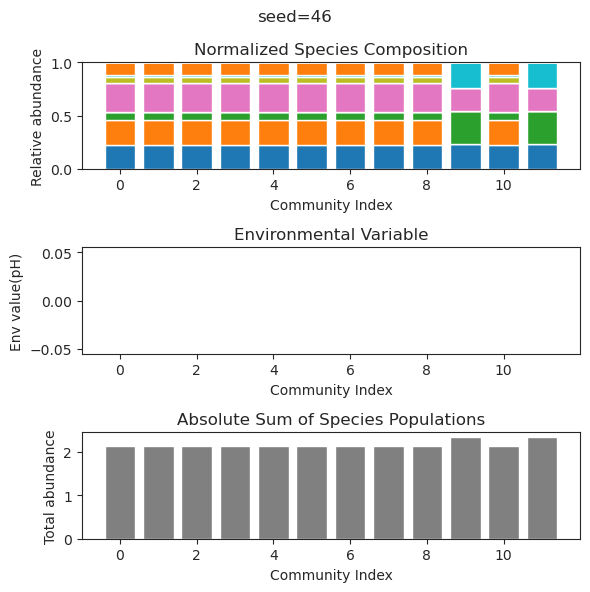

{'species': array([ 6.07861522e-001, -2.11558296e-095,  3.59162908e-001,
        2.73640847e-001, -8.83170208e-089,  2.33761672e-046,
       -2.02009977e-039,  2.19453749e-002,  1.18851062e-002,
       -1.42233315e-106,  2.11146427e-058,  6.97098661e-001,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([ 6.07861522e-01,  3.27330137e-32,  3.59162908e-01,  2.73640847e-01,
       -4.61408229e-84,  1.77090695e-48, -9.02072006e-36,  2.19453747e-02,
        1.18851061e-02, -8.64094630e-32, -6.44968072e-38,  6.97098661e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([

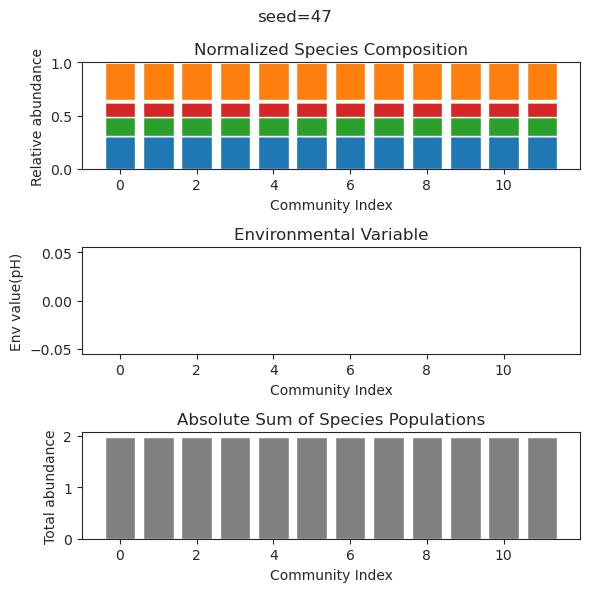

{'species': array([ 2.73958873e-01,  1.96669199e-01, -5.57333742e-41, -1.11327808e-48,
        4.17308114e-01,  3.66163436e-43,  2.87036052e-58,  1.77364684e-01,
        1.59438740e-11,  2.60047248e-43,  4.79816824e-01,  6.12497605e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.73958873e-01,  1.96669199e-01,  8.53604637e-30,  1.00139588e-42,
        4.17308114e-01, -1.32969380e-96, -5.90114825e-92,  1.77364684e-01,
        4.20656969e-13,  5.73697471e-82,  4.79816824e-01,  6.12497605e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.73958873e-

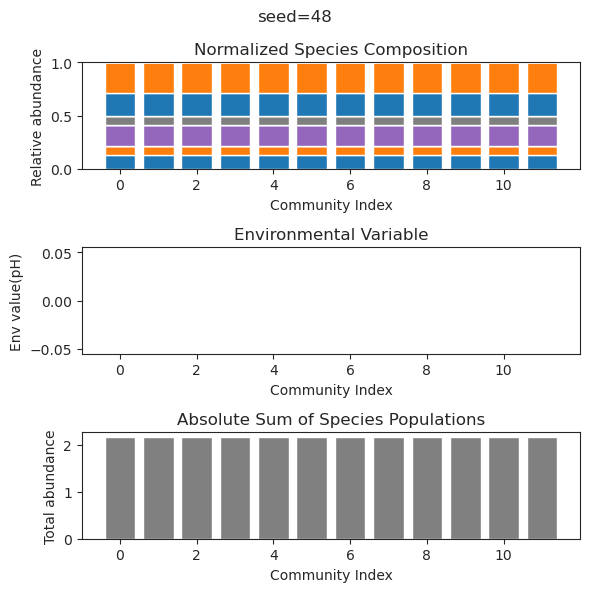

{'species': array([-9.87097286e-60, -1.75854589e-71,  1.33891980e-01,  3.57677938e-01,
        3.34970965e-18, -4.64957479e-90,  3.04522163e-01,  5.41314386e-01,
        4.67791816e-01,  1.64046479e-01,  8.91864656e-15, -2.29001809e-82,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-9.89614846e-71,  1.16709630e-01,  3.29539899e-01, -1.00487933e-51,
        8.99613958e-66,  8.13260819e-01, -8.93116821e-20, -9.09127214e-36,
        1.12328385e-62,  7.78459050e-01,  2.69528996e-02,  4.51090698e-63,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.13939361e-

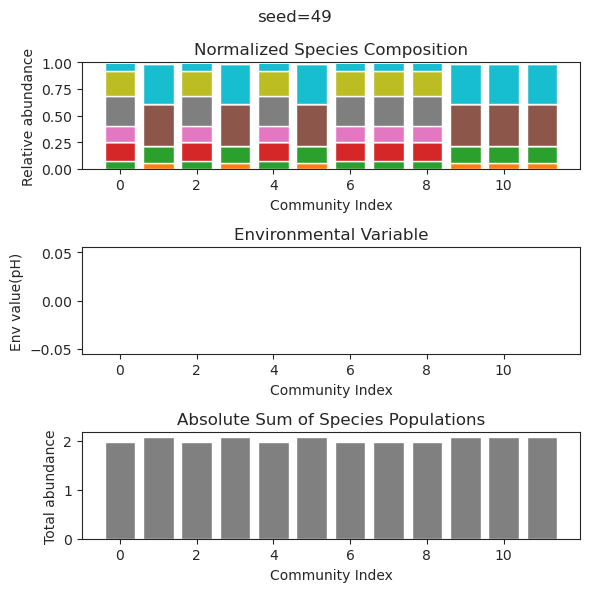

{'species': array([ 3.59703823e-02,  1.17787240e-01,  6.03987787e-01,  2.44313708e-01,
        4.14921370e-31,  3.64486874e-01, -1.57610511e-31,  3.57751274e-01,
        3.79827346e-08, -1.07846811e-42, -4.31349675e-29,  1.32611505e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.59703633e-002,  1.17787249e-001,  6.03987784e-001,
        2.44313727e-001,  3.06678132e-037,  3.64486844e-001,
        1.02860742e-109,  3.57751283e-001,  1.06364847e-007,
        1.88906392e-035, -9.78132973e-035,  1.32611445e-001,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([

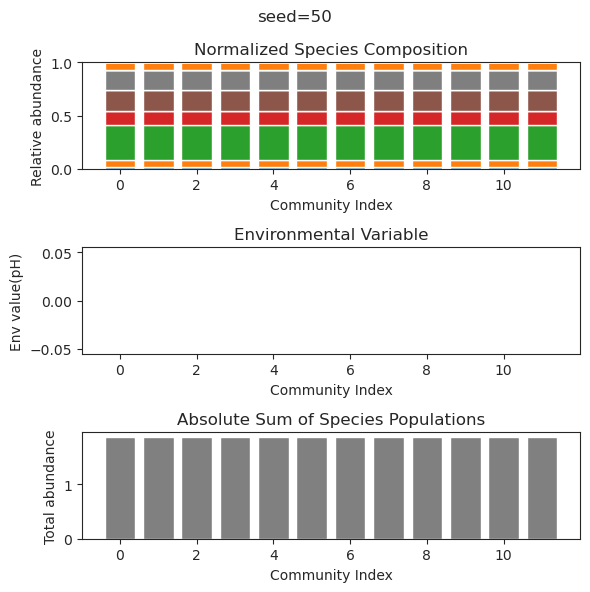

{'species': array([ 4.03157512e-01, -1.40408838e-34,  4.65052556e-01,  3.91782380e-01,
        4.92649563e-02,  2.41200131e-35, -7.65531758e-60,  2.66878137e-07,
        1.51184542e-40,  1.38979321e-01,  2.44655085e-01,  2.76939123e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 4.03157555e-01, -1.42371076e-78,  4.65052329e-01,  3.91782294e-01,
        4.92652850e-02, -1.29389104e-38, -4.71254772e-81,  1.89855101e-08,
       -1.31942652e-33,  1.38979497e-01,  2.44655091e-01,  2.76939153e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 4.03157470e-

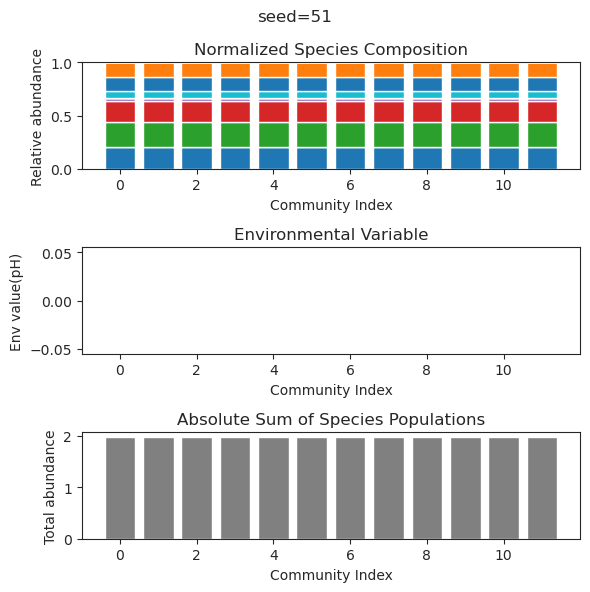

{'species': array([-1.83110073e-40,  8.94256443e-19, -8.63311189e-36,  1.28680810e-22,
        1.77230765e-01,  4.44667468e-01,  1.31656123e-01,  3.08149954e-01,
        3.38856915e-01, -1.67762497e-40,  7.82958538e-23,  5.87029954e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-4.77882476e-50,  2.28408815e-17,  3.47617474e-41,  2.08384149e-20,
        1.77230765e-01,  4.44667468e-01,  1.31656123e-01,  3.08149954e-01,
        3.38856915e-01, -9.11984857e-51,  3.43893541e-23,  5.87029954e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-9.10191513e-

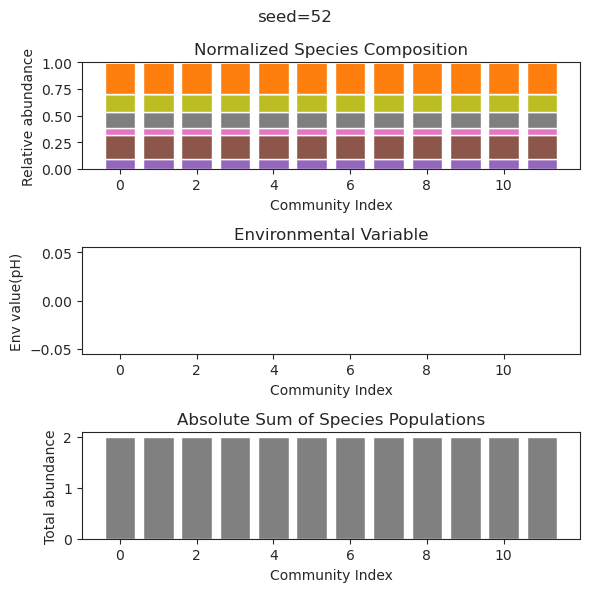

{'species': array([ 4.94603800e-01, -1.11463564e-28,  3.31655887e-01, -1.04157187e-26,
       -7.34487222e-27,  1.76434212e-01,  3.08049704e-03, -4.50764404e-37,
       -1.64466909e-29,  3.57784614e-01,  1.65705968e-01,  4.25975191e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 4.94585528e-01, -2.38990888e-28,  3.31639571e-01,  1.32981373e-54,
       -6.47772758e-28,  1.76437573e-01,  3.11588984e-03,  1.45214096e-39,
        7.47337737e-28,  3.57772599e-01,  1.65716241e-01,  4.25965034e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 4.94605434e-

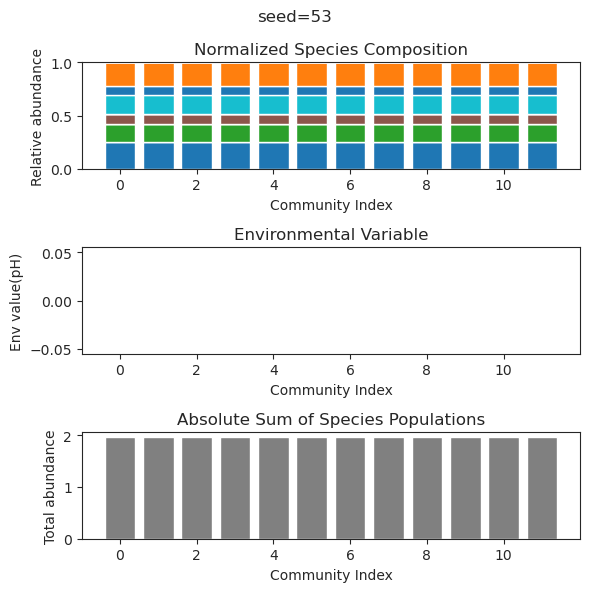

{'species': array([ 1.48648708e-01,  3.56200162e-01,  2.46626744e-01,  1.62525349e-01,
        2.79459270e-01,  3.33397193e-02,  2.89344717e-01, -8.64854008e-90,
        4.52108628e-01,  2.38067535e-54,  5.61022106e-02,  2.53290314e-29,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.48648707e-01,  3.56200165e-01,  2.46626746e-01,  1.62525346e-01,
        2.79459269e-01,  3.33397177e-02,  2.89344719e-01, -9.68278551e-85,
        4.52108628e-01, -6.50093057e-41,  5.61022092e-02,  1.51652053e-27,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.48648707e-

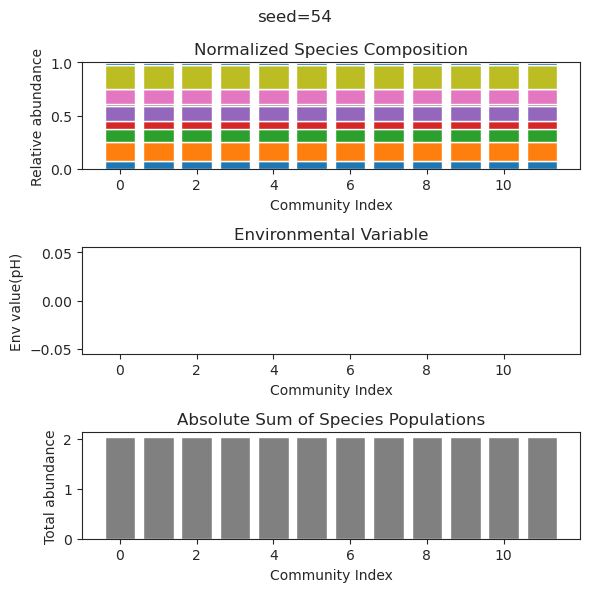

{'species': array([-5.75962954e-43,  4.73804290e-43,  4.02286030e-01,  9.34761299e-02,
        3.44787076e-01,  2.22140306e-01,  4.84775521e-01,  4.08054062e-13,
        3.60113097e-39, -1.12256382e-39, -2.58569989e-45,  3.44996461e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.48499815e-41,  2.39784123e-70,  4.02286030e-01,  9.34761299e-02,
        3.44787076e-01,  2.22140306e-01,  4.84775521e-01,  1.44663813e-13,
       -4.10968375e-34, -1.41195558e-29, -1.09186488e-36,  3.44996461e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-1.50327719e-

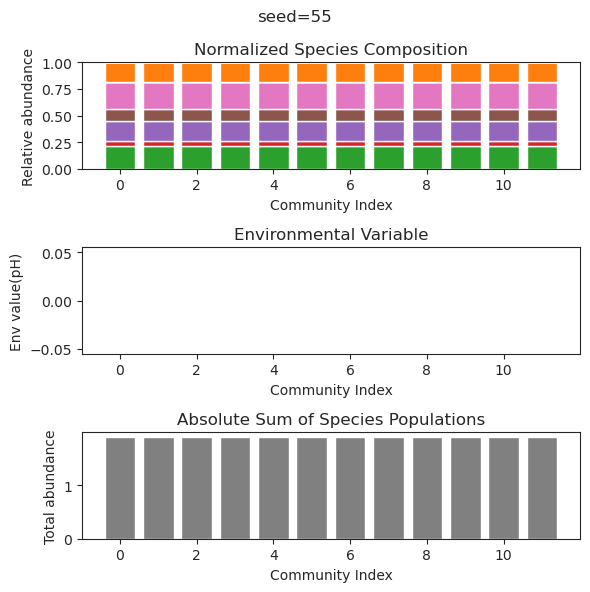

{'species': array([ 1.07018332e-01, -3.97690198e-28,  5.68581240e-01,  1.93371178e-06,
        2.87232464e-01, -2.05198945e-34,  2.29894483e-50,  8.37964945e-01,
        5.73082408e-17, -2.58579144e-31,  7.30328284e-02, -7.31573075e-45,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.07018403e-01,  1.71537311e-27,  5.68581051e-01,  2.49240874e-06,
        2.87232584e-01,  2.24155571e-40,  2.75528550e-29,  8.37964815e-01,
        2.09907683e-17,  1.08797069e-35,  7.30327298e-02, -4.46123772e-52,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.07018373e-

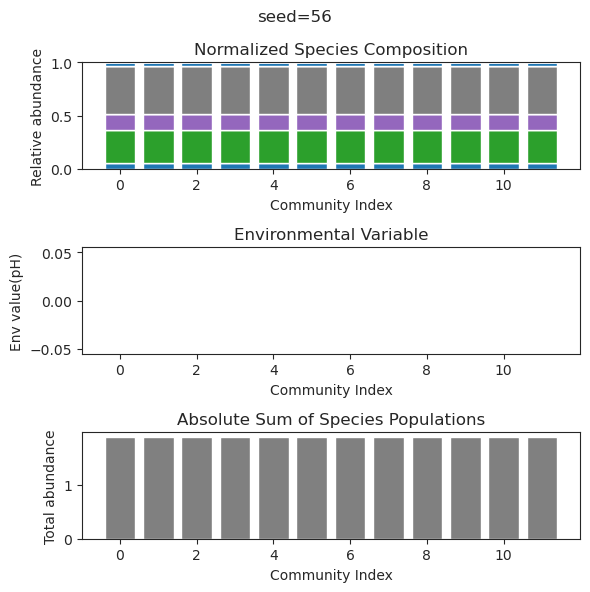

{'species': array([ 4.94310717e-03,  4.93090476e-01, -7.52405098e-36,  5.04845035e-73,
        2.19580395e-01,  1.13832643e-01,  2.15115608e-79,  1.70796280e-01,
        4.88961121e-01,  9.88523739e-02,  1.33112076e-01,  2.57590721e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 4.94171653e-03,  4.93091031e-01, -2.31886434e-32, -3.28980006e-33,
        2.19581066e-01,  1.13832028e-01,  3.33207670e-80,  1.70796150e-01,
        4.88961317e-01,  9.88530043e-02,  1.33112527e-01,  2.57590310e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 4.94142808e-

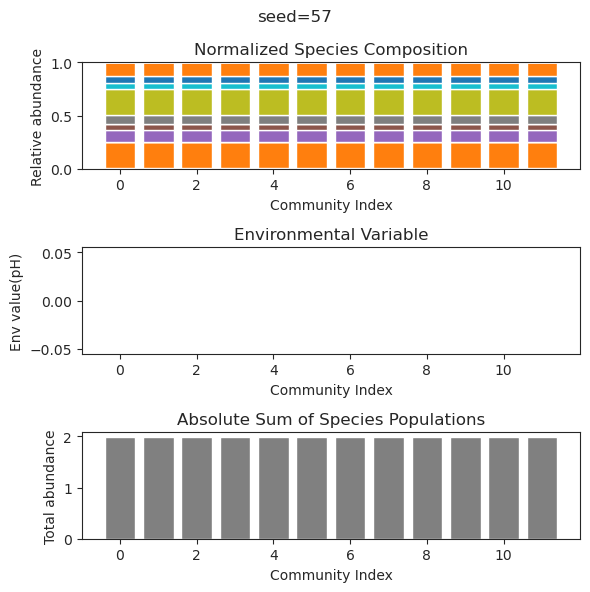

{'species': array([-3.63778207e-17,  5.02556539e-01,  2.86937612e-39,  1.38262136e-30,
        6.12876485e-01, -3.05070436e-34, -1.94330809e-51,  4.30936595e-01,
        3.92426292e-75, -1.70039324e-45,  3.39739394e-01,  1.00711563e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-8.72959114e-17,  5.02556539e-01, -8.67629445e-31, -1.43146392e-25,
        6.12876485e-01, -5.61346433e-29,  4.35578183e-39,  4.30936595e-01,
        3.42086630e-56,  9.93304901e-35,  3.39739394e-01,  1.00711563e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 9.67621461e-

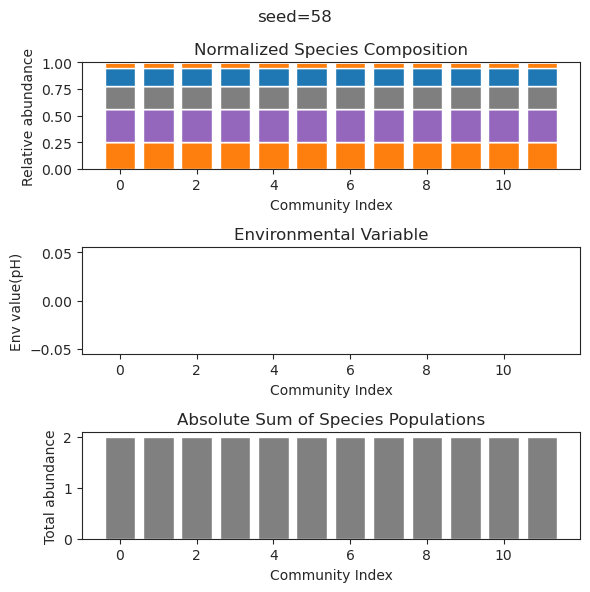

{'species': array([-6.67754323e-27,  1.87787418e-32,  7.22547849e-01,  1.44413499e-01,
        1.21755014e-42, -2.78321349e-73, -1.51949526e-36,  2.33543084e-01,
        2.04594325e-01,  5.06630631e-38,  5.95999691e-01, -6.33298800e-26,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.05218420e-22,  9.71566968e-25,  7.22547849e-01,  1.44413499e-01,
        3.15483367e-32, -1.12946024e-41,  1.62053970e-23,  2.33543084e-01,
        2.04594325e-01,  5.88478163e-17,  5.95999691e-01, -8.62822754e-22,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-3.25128040e-

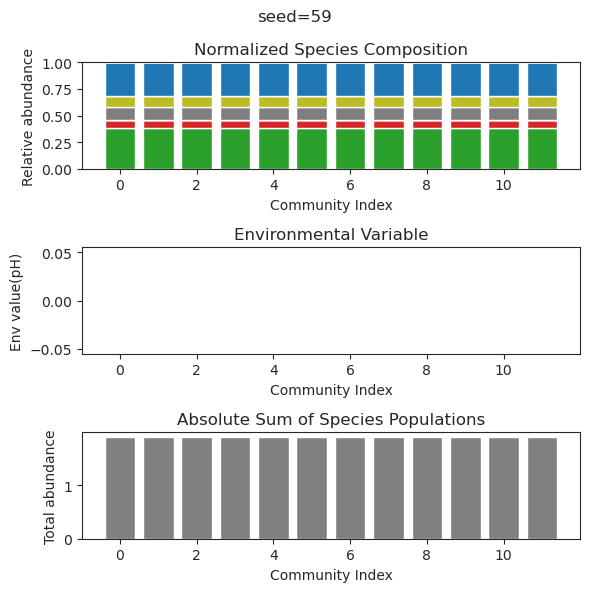

{'species': array([ 3.73340456e-01,  4.20166874e-01, -5.78846517e-30,  1.98203951e-33,
        7.02978860e-01,  3.71896203e-01, -4.22412767e-36,  1.35225868e-01,
        8.84769610e-39,  1.65197614e-39,  3.69825146e-06, -7.61496237e-52,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.73340601e-01,  4.20166821e-01, -6.71869452e-34, -1.05405394e-38,
        7.02978863e-01,  3.71896211e-01,  2.18629402e-37,  1.35225908e-01,
       -7.98095255e-40, -6.33574616e-39,  3.49566248e-06,  6.42216606e-54,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.73340392e-

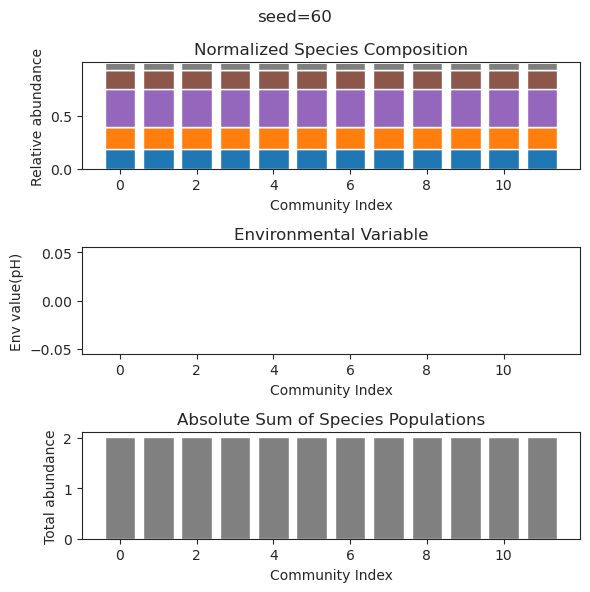

{'species': array([-8.73789503e-25,  1.12580198e-01,  6.08994695e-01, -4.87645475e-29,
        1.46173629e-56, -5.41082127e-22,  2.55769722e-01, -1.12254063e-39,
        3.55289188e-01,  3.99677173e-01,  2.37168669e-01,  7.33106670e-02,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-5.52480002e-25,  1.12580198e-01,  6.08994695e-01, -7.01902783e-28,
        2.94582243e-55, -8.03640919e-22,  2.55769722e-01, -2.58779771e-39,
        3.55289188e-01,  3.99677173e-01,  2.37168669e-01,  7.33106670e-02,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([2.85600149e-2

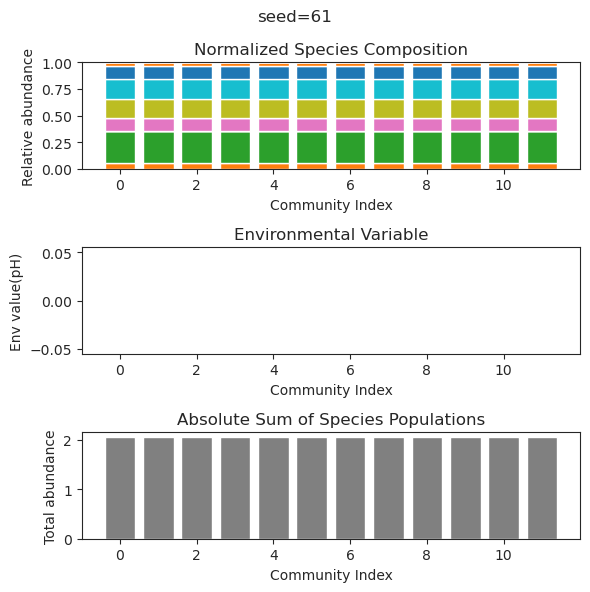

{'species': array([ 5.87822096e-01,  1.59587169e-02,  1.68269738e-71,  1.25970100e-75,
       -1.19767983e-73,  3.91835710e-01,  4.47349982e-74,  3.17395498e-02,
       -3.25994837e-42,  2.53241960e-64,  4.18271156e-01,  7.28233430e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 5.87822096e-01,  1.59587170e-02, -5.17743631e-41,  1.34893924e-56,
       -2.73416249e-58,  3.91835710e-01,  3.69904199e-56,  3.17395498e-02,
        3.28920320e-42,  3.77426604e-43,  4.18271156e-01,  7.28233430e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 5.87822096e-

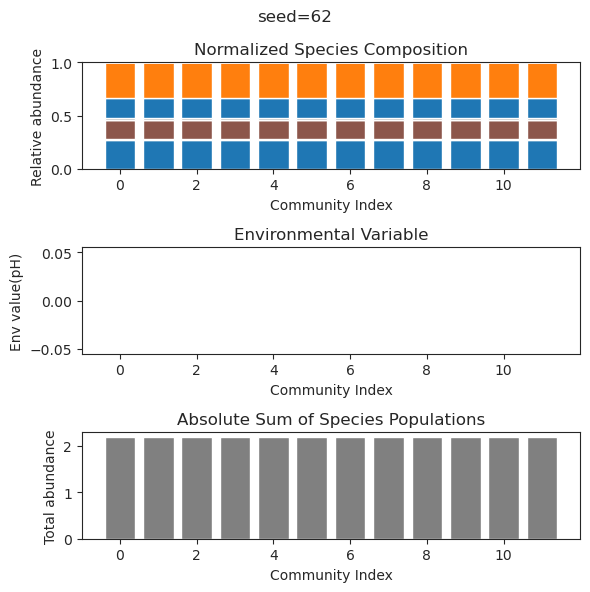

{'species': array([ 5.08045366e-01, -4.68623583e-17, -5.84693397e-61,  1.01979992e-51,
       -7.13869111e-90,  2.29228618e-01,  2.57776157e-01,  3.55108352e-29,
        3.18571112e-38,  6.26445159e-02,  6.89972889e-01,  5.21395902e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 5.08045366e-001,  5.51006374e-021,  1.13874749e-108,
        7.79868469e-061, -1.15294966e-147,  2.29228618e-001,
        2.57776157e-001, -1.66600181e-047, -3.19980291e-063,
        6.26445159e-002,  6.89972889e-001,  5.21395902e-001,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([

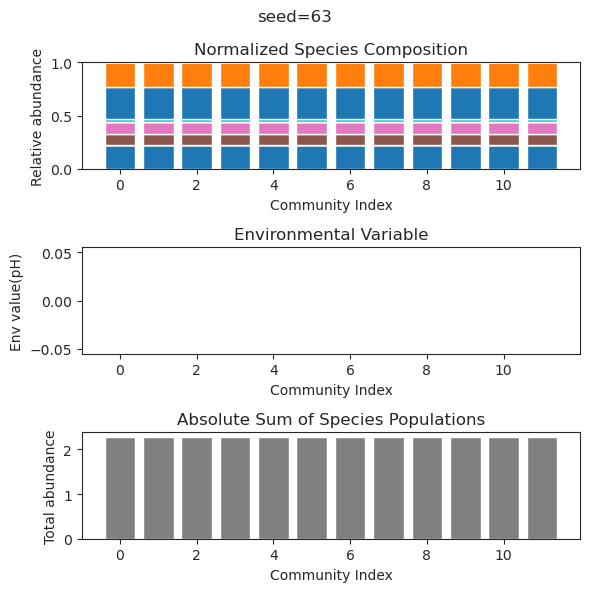

{'species': array([ 2.65344142e-01,  5.74051308e-01, -1.43867844e-38, -4.58886535e-32,
        1.43600014e-01,  1.57956382e-01,  3.93444783e-01, -1.09125315e-33,
        3.26210414e-46,  2.42361840e-01,  5.00314977e-27,  1.36741729e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.65344142e-01,  5.74051308e-01,  8.53382865e-32, -2.85844384e-27,
        1.43600014e-01,  1.57956382e-01,  3.93444783e-01,  3.33693056e-30,
        2.87604580e-35,  2.42361840e-01, -1.87069190e-24,  1.36741729e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.65344142e-

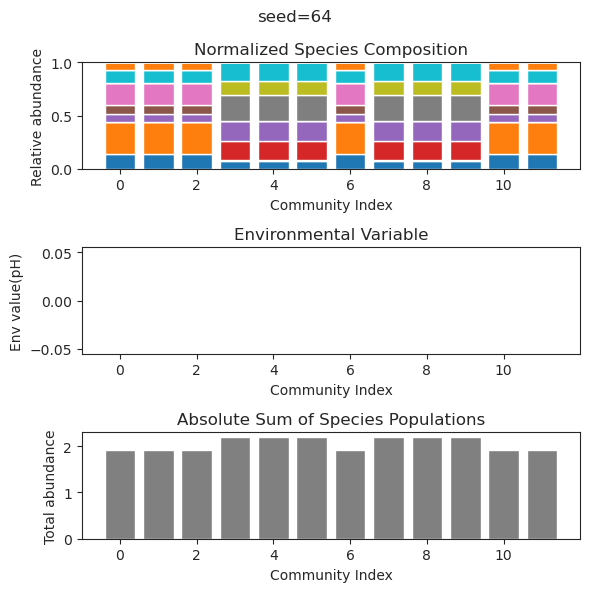

{'species': array([ 3.17858180e-01,  1.84414216e-01,  4.60180078e-01,  1.70115831e-01,
        3.63509529e-51, -4.90528625e-34,  4.95082568e-01, -8.61383530e-20,
       -3.44092458e-19,  7.15134925e-01, -2.24303122e-37, -1.57965841e-14,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.17858180e-01,  1.84414216e-01,  4.60180078e-01,  1.70115831e-01,
       -1.94865392e-82,  2.00526920e-44,  4.95082568e-01, -4.25842719e-25,
       -3.80640350e-23,  7.15134925e-01,  8.26689436e-57,  9.60081919e-19,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.17858180e-

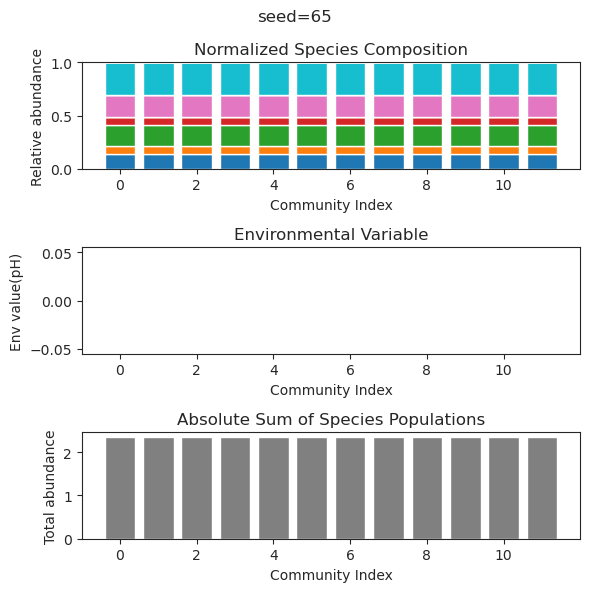

{'species': array([ 3.81681223e-01,  8.76263048e-01,  1.31221539e-01, -4.47961963e-39,
       -6.78982541e-42,  1.56333960e-01,  4.04827036e-01, -1.54578863e-49,
        1.00666825e-01,  1.18526966e-01, -3.40731617e-82,  3.19441597e-74,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.81681223e-01,  8.76263048e-01,  1.31221539e-01, -1.40634549e-32,
       -3.96356318e-36,  1.56333960e-01,  4.04827036e-01,  1.31930099e-40,
        1.00666825e-01,  1.18526966e-01,  1.38982481e-66, -1.28455065e-61,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.81681223e-

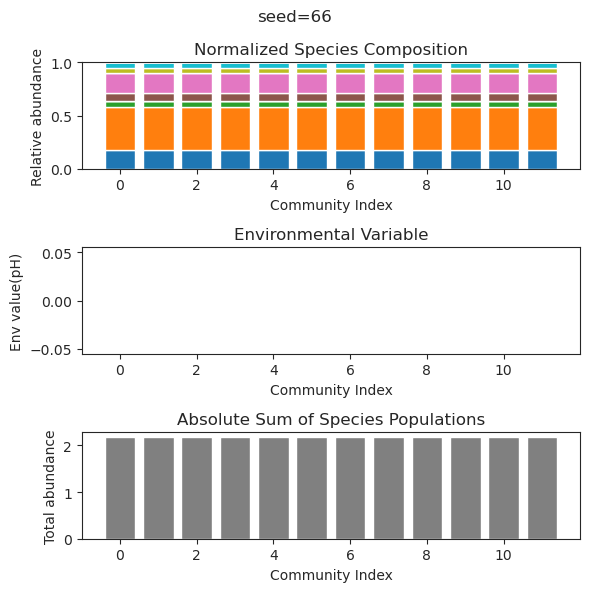

{'species': array([ 1.28261751e-01, -3.88386676e-32, -2.23033985e-33,  2.90339758e-01,
        2.62433719e-01,  2.07254037e-02,  1.71102103e-33,  8.89397251e-02,
        4.93977535e-01,  1.88979692e-01,  3.68745920e-01,  1.65152279e-43,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.27919784e-01, -2.12270318e-27,  6.63318381e-27,  2.90740302e-01,
        2.62247492e-01,  2.14610614e-02, -1.70440958e-27,  8.90685276e-02,
        4.93718570e-01,  1.88447426e-01,  3.68772602e-01,  3.89491700e-48,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.28078444e-

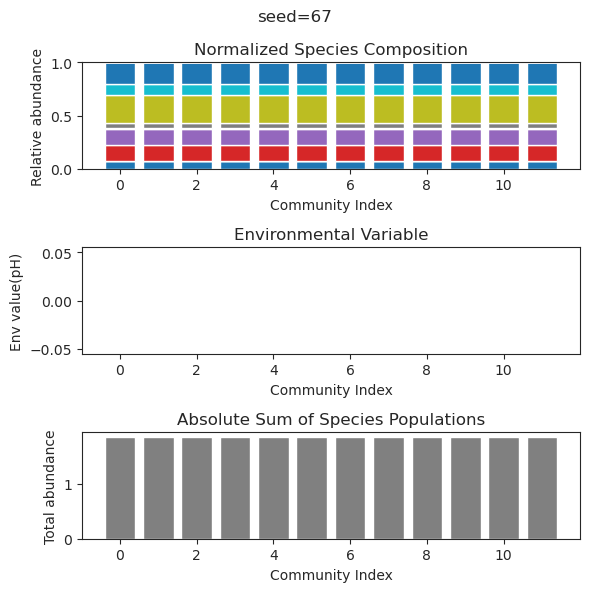

{'species': array([ 1.95453476e-01,  8.03747270e-76,  5.82363837e-01,  4.03789058e-01,
        3.15045632e-01,  3.47106397e-01,  1.47696921e-01,  5.93913520e-02,
        1.60468075e-17,  1.72808959e-78, -3.21421814e-67,  8.11599281e-57,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.95453476e-01, -1.16835866e-64,  5.82363837e-01,  4.03789058e-01,
        3.15045632e-01,  3.47106397e-01,  1.47696921e-01,  5.93913520e-02,
        3.91932948e-17,  1.44065225e-65, -6.41222465e-51,  4.76707020e-46,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.95453476e-

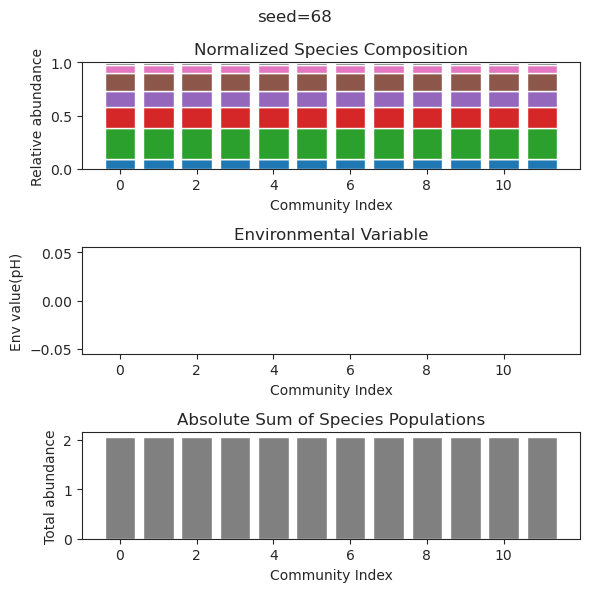

{'species': array([-8.89492411e-29,  1.29781113e-30, -2.54547442e-32,  3.75838279e-01,
        4.20918523e-02,  4.87653546e-01,  3.54545607e-01, -7.71915675e-84,
        8.24802549e-01,  1.59018678e-29,  8.32089899e-02,  1.08259359e-03,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-2.06587862e-26, -4.26799555e-27, -3.58324984e-28,  3.75834738e-01,
        4.20941162e-02,  4.87630934e-01,  3.54524994e-01,  7.75230467e-78,
        8.24770507e-01, -7.59363348e-75,  8.32329000e-02,  1.12094845e-03,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.90973140e-

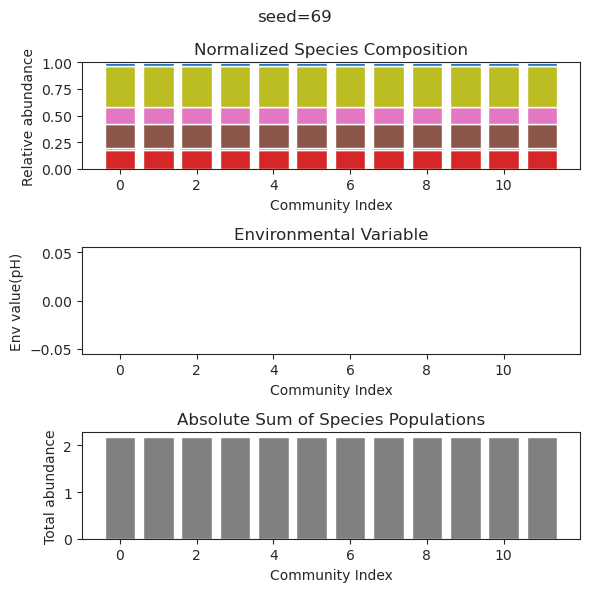

{'species': array([ 1.41183222e-01,  6.88019251e-01, -1.41775603e-84, -2.46009981e-66,
        1.55726613e-77,  4.62523177e-01, -5.75587598e-32, -1.86100952e-59,
       -3.20330249e-45, -1.96451461e-17, -3.75125580e-27,  7.24836558e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.41183222e-01,  6.88019251e-01, -1.22871306e-91,  3.69090147e-71,
       -2.36216586e-82,  4.62523177e-01, -2.73716013e-31,  2.38817510e-63,
       -2.84202516e-48,  6.14600441e-18, -2.54306494e-26,  7.24836558e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-1.30879544e-

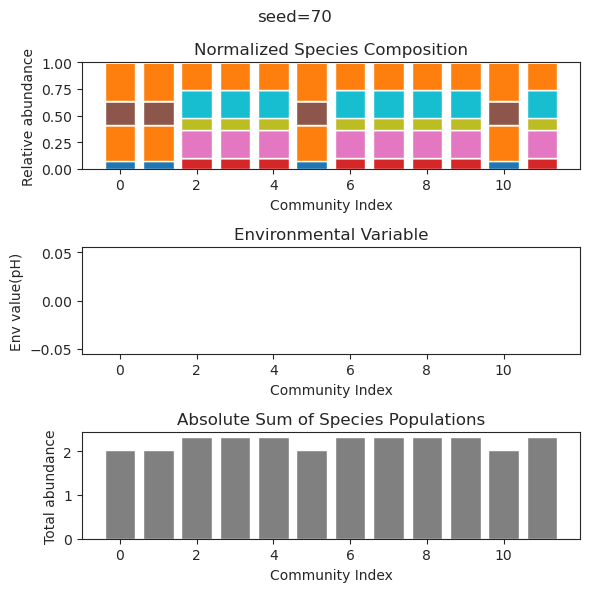

{'species': array([ 1.12953739e-089,  5.02132793e-001,  2.71323734e-001,
        1.94472199e-001,  5.50850259e-002,  2.26420444e-001,
        3.14777576e-001, -1.68714801e-157,  2.22719388e-001,
        1.38947755e-001, -3.75718538e-139, -4.12981804e-155,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([-2.06948849e-072,  5.02132793e-001,  2.71323734e-001,
        1.94472199e-001,  5.50850259e-002,  2.26420444e-001,
        3.14777576e-001, -2.97756175e-127,  2.22719388e-001,
        1.38947755e-001,  2.41334197e-116, -3.75060727e-125,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+0

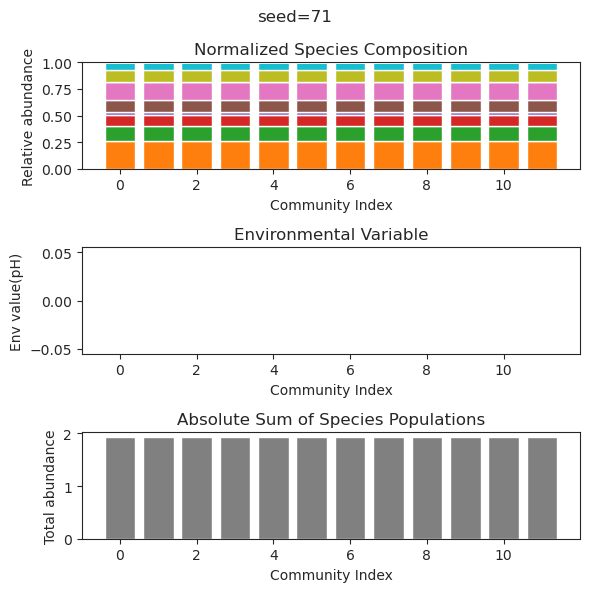

{'species': array([ 3.37794812e-49,  5.26510252e-01,  4.04695504e-01,  4.28436226e-01,
        4.00419063e-01, -2.07881237e-73,  2.88167872e-01, -1.78657884e-35,
       -1.75419284e-45, -6.12836956e-75, -1.50678541e-34,  1.57025457e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-3.77425023e-31,  5.26510252e-01,  4.04695504e-01,  4.28436226e-01,
        4.00419063e-01, -1.30125562e-38,  2.88167872e-01,  2.49974195e-21,
        2.81201237e-26,  1.08901165e-43,  1.81885941e-24,  1.57025457e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.37350001e-

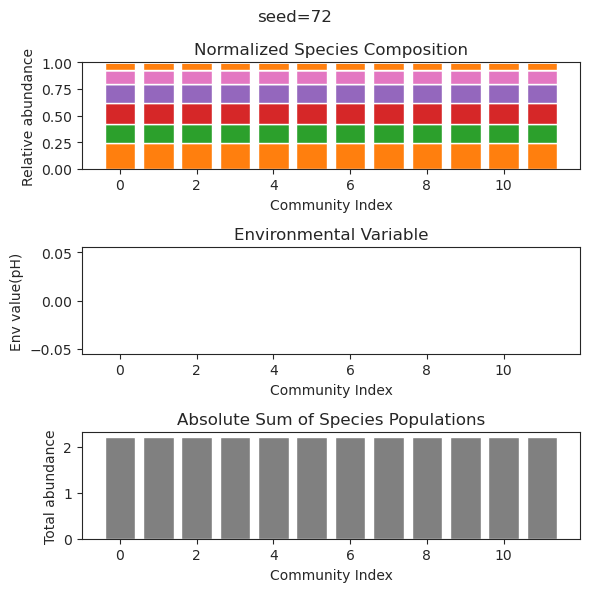

{'species': array([-5.15614258e-43, -1.52749429e-45, -1.33851608e-45,  7.47835791e-44,
        7.65159808e-01,  2.39974697e-42,  1.50259027e-46,  6.39984260e-13,
        5.01455730e-01,  1.23687065e-01,  2.72438813e-01,  4.24340351e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-5.14776376e-38, -7.80498479e-41,  2.67586388e-45, -9.14313735e-39,
        7.65159808e-01,  4.92094778e-39, -1.19216767e-54,  8.36950698e-13,
        5.01455730e-01,  1.23687065e-01,  2.72438813e-01,  4.24340351e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.40359416e-

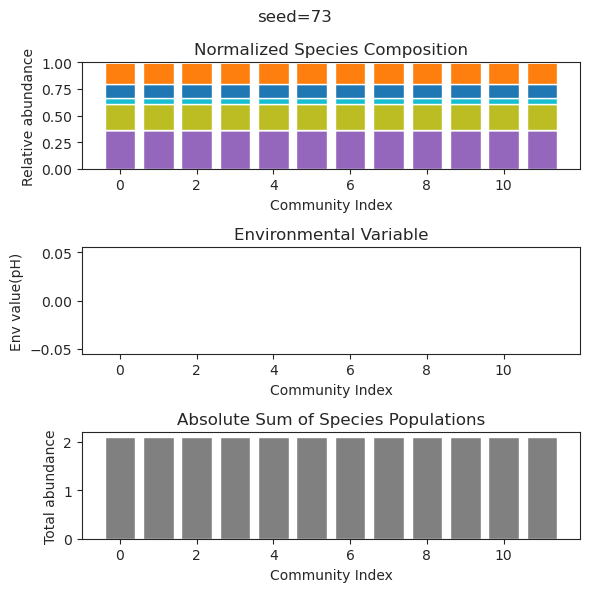

{'species': array([-6.28412598e-52,  6.06625206e-01,  9.54130625e-29,  3.59738076e-04,
       -1.85270327e-34, -4.31922688e-37,  2.28867217e-47,  5.12213956e-01,
       -5.61321863e-45,  4.37453437e-56,  6.14167048e-01, -2.32504255e-36,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-3.73661184e-38,  6.06625836e-01, -5.41201249e-31,  3.40162222e-04,
        2.11653925e-33,  2.60239094e-34,  6.10902303e-49,  5.12231073e-01,
        1.80606612e-45, -1.44995922e-67,  6.14161745e-01, -1.57263121e-37,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-4.00136137e-

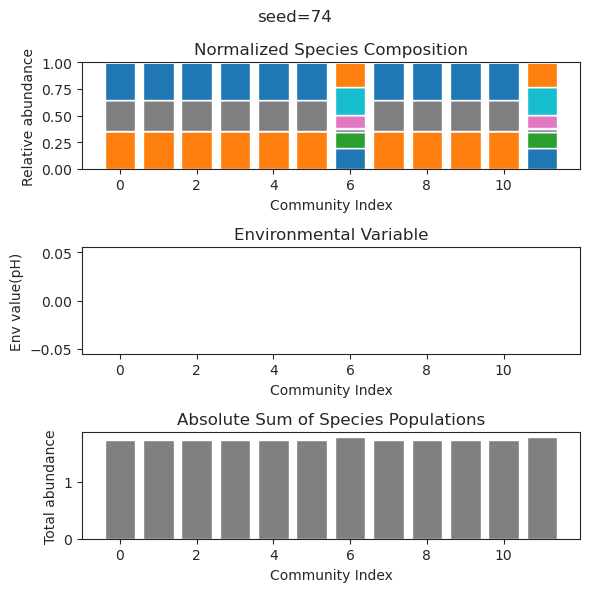

{'species': array([-1.72113968e-108,  3.37208058e-002, -5.46565012e-054,
        2.88380665e-001,  3.58113596e-001,  3.27507938e-001,
        3.35608066e-099,  1.05318338e-001,  1.06300156e-001,
        3.55658299e-001,  5.57688970e-001, -9.62666142e-113,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([-1.00071369e-92,  3.37208058e-02, -1.43488426e-43,  2.88380665e-01,
        3.58113596e-01,  3.27507938e-01, -2.49357415e-82,  1.05318338e-01,
        1.06300156e-01,  3.55658299e-01,  5.57688970e-01, -1.71995326e-91,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([

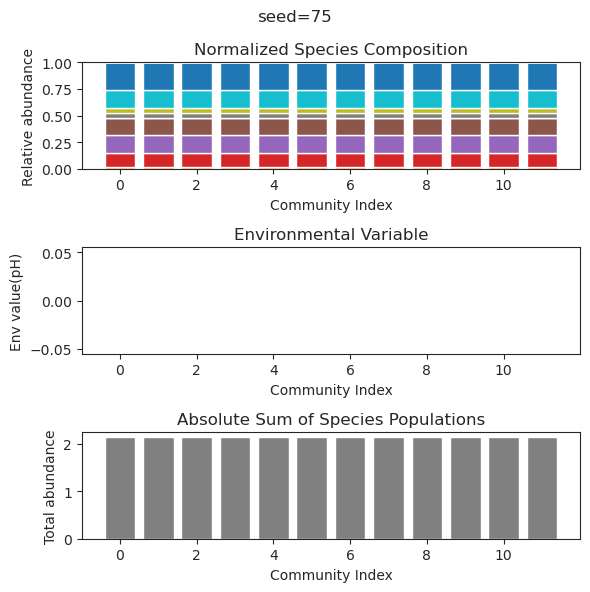

{'species': array([2.04577496e-01, 2.39840246e-19, 5.63026043e-43, 5.94837173e-01,
       2.01632318e-29, 4.05982664e-46, 2.54983783e-47, 3.15969307e-01,
       6.25630592e-01, 4.74688428e-01, 1.52077979e-47, 4.20458371e-37,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.04577496e-01, -5.28735818e-28, -2.62170462e-43,  5.94837173e-01,
        1.98677187e-26,  5.26119566e-63,  1.65988242e-56,  3.15969307e-01,
        6.25630592e-01,  4.74688428e-01, -5.50448655e-62,  1.56144183e-32,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.04577496e-01, -5.87264308e-18, -6.

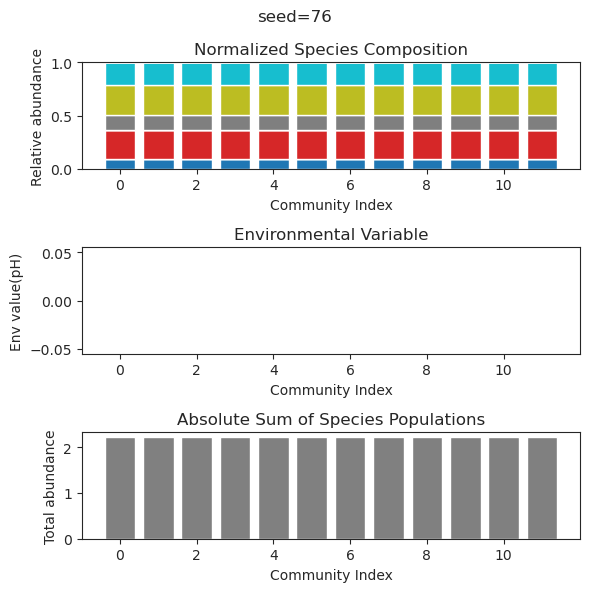

{'species': array([ 9.79415611e-35,  6.60156010e-01,  2.38550095e-02,  4.13521330e-01,
       -3.30722224e-51,  3.91602604e-01, -5.16795528e-16,  3.47368419e-58,
        1.32246029e-37,  1.36564031e-56,  1.66311152e-01,  3.24024496e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-1.28722705e-041,  6.60156010e-001,  2.38550095e-002,
        4.13521330e-001,  1.32539011e-071,  3.91602604e-001,
        2.51690233e-014,  5.19580735e-098,  1.06591383e-048,
       -5.14244228e-102,  1.66311152e-001,  3.24024496e-001,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([

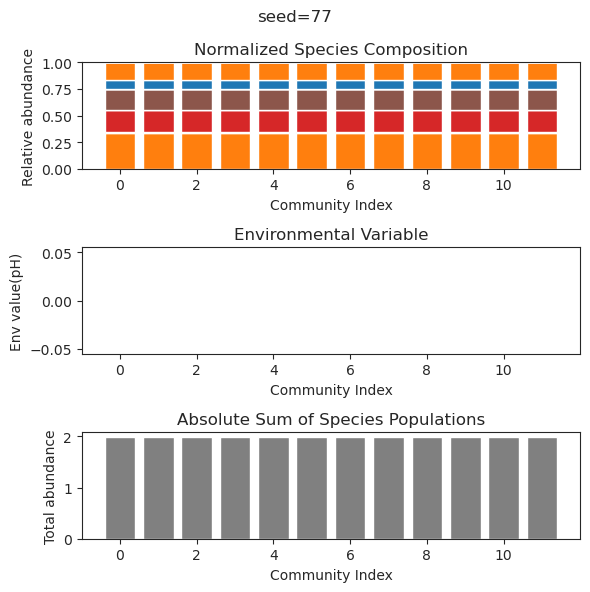

{'species': array([ 3.84283859e-40,  7.53794561e-01, -4.95624475e-43,  1.19294561e-38,
        5.08205659e-01, -7.01457704e-34,  3.33468518e-42,  1.46014350e-01,
        1.07260955e-37,  2.33283201e-02,  7.35588539e-01,  1.12861964e-32,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-2.03633648e-61,  7.53794561e-01,  8.40984421e-63,  4.96398928e-59,
        5.08205659e-01, -8.01292437e-44, -5.03371077e-61,  1.46014350e-01,
        8.60864607e-57,  2.33283201e-02,  7.35588539e-01, -1.01525991e-44,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.43011667e-

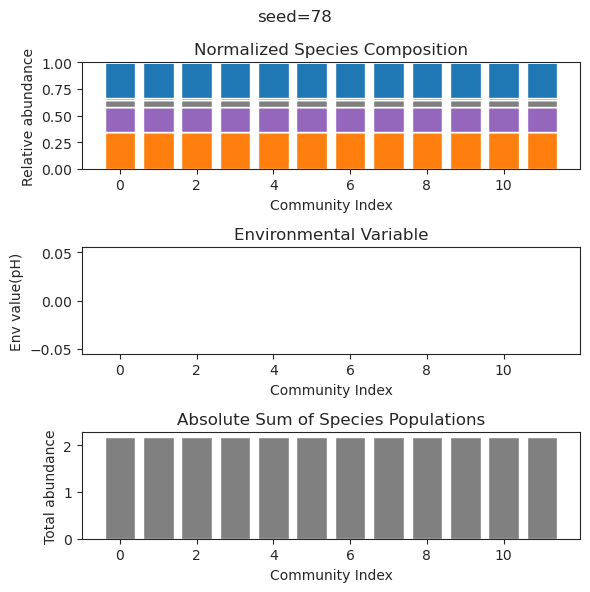

{'species': array([ 4.57682120e-01, -2.47717920e-28,  3.78455083e-01,  3.14231185e-40,
        2.46126940e-01,  5.89432029e-06, -4.64388102e-35,  7.24199187e-34,
        1.76379261e-01,  6.51591278e-01, -2.85108106e-54,  8.59723183e-77,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.95074835e-01, -7.98935707e-46,  2.16596005e-23,  1.11584121e-37,
        2.97459513e-01,  7.34575819e-18,  5.70030375e-28,  3.94514722e-01,
        4.32499370e-01,  2.67377631e-01,  2.41822635e-01,  1.55591991e-28,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.95074835e-

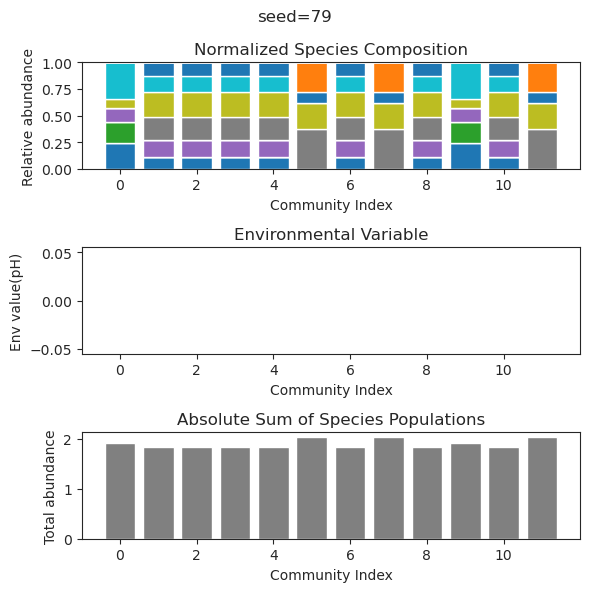

{'species': array([ 7.73148882e-002, -1.56461150e-060,  3.11297226e-064,
        1.74963982e-133,  2.00981465e-001,  5.11240826e-001,
        2.80911245e-001,  7.18339328e-001,  4.07761481e-003,
        6.47189076e-002,  9.39487383e-002,  2.22107751e-104,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([ 7.73249189e-002,  1.56545287e-186,  1.32078649e-060,
       -4.94065646e-324,  2.00966791e-001,  5.11238360e-001,
        2.80911268e-001,  7.18324001e-001,  4.07999539e-003,
        6.47190000e-002,  9.39594586e-002,  1.87808188e-240,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+0

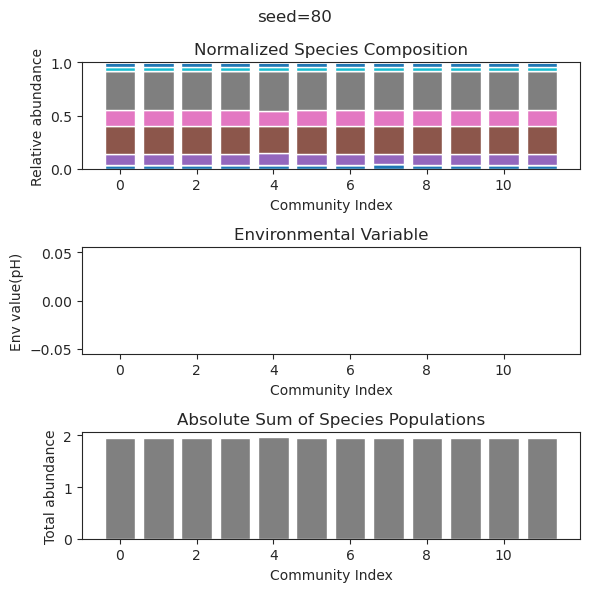

{'species': array([ 5.72351158e-01,  5.66730644e-01, -6.53680171e-74,  1.58387101e-20,
       -5.67326068e-72,  1.96371049e-01, -2.90243424e-16,  8.49090404e-02,
        1.81954768e-01,  9.10357689e-02,  2.30008283e-01,  7.40301809e-48,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 5.72351158e-01,  5.66730644e-01,  1.54476922e-87, -8.06587403e-24,
        3.25457134e-80,  1.96371049e-01, -1.90568979e-21,  8.49090404e-02,
        1.81954768e-01,  9.10357689e-02,  2.30008283e-01, -2.89318709e-52,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 5.72351158e-

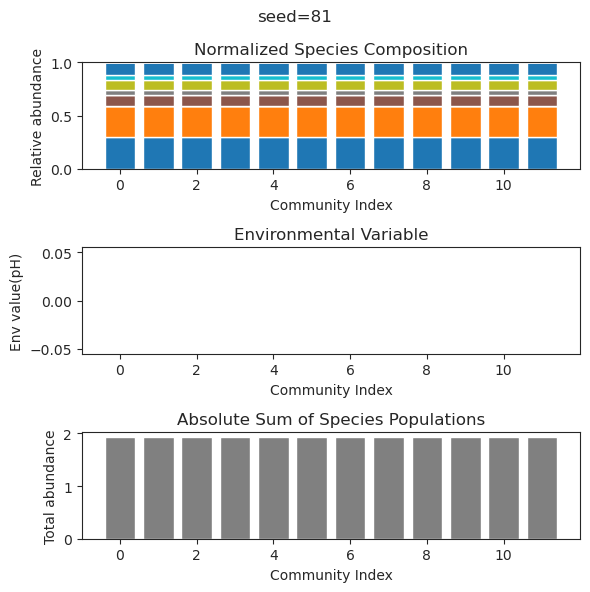

{'species': array([ 3.96343604e-47,  5.94167189e-01,  5.19932135e-01,  1.89531106e-02,
        7.78166908e-49,  2.63600943e-01,  3.05768101e-01,  3.32658059e-38,
        5.45867954e-02, -1.54704865e-42,  3.27688883e-30, -2.15604244e-63,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-3.48678674e-39,  5.94167189e-01,  5.19932135e-01,  1.89531106e-02,
       -3.19844342e-38,  2.63600943e-01,  3.05768101e-01,  3.69691184e-38,
        5.45867954e-02, -1.65531714e-37, -2.92109617e-32, -3.38539577e-44,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-2.02088481e-

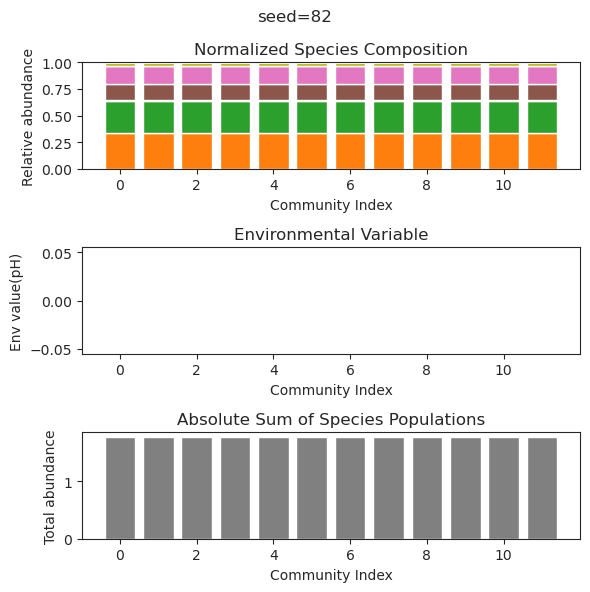

{'species': array([1.00813488e-008, 1.94023167e-001, 5.36729095e-001, 6.94469423e-003,
       3.32300079e-001, 1.05685188e-133, 3.28139646e-001, 2.55287860e-001,
       6.14864252e-003, 2.49732387e-115, 8.54638131e-021, 3.77305299e-002,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000]), 'env': array([0.])}
{'species': array([1.13979901e-004, 3.75672227e-001, 5.46735419e-001, 1.18811443e-001,
       3.96384209e-003, 4.70045481e-138, 5.20500765e-002, 5.86728166e-001,
       3.97740401e-002, 8.30667714e-116, 4.59549953e-023, 6.84843205e-007,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000,
       0.00000000e+000, 0.00000000e+000, 0.00000000e+000, 0.00000000e+000]), 'env': array([0.])}
{'species': array([1.07710247e-0

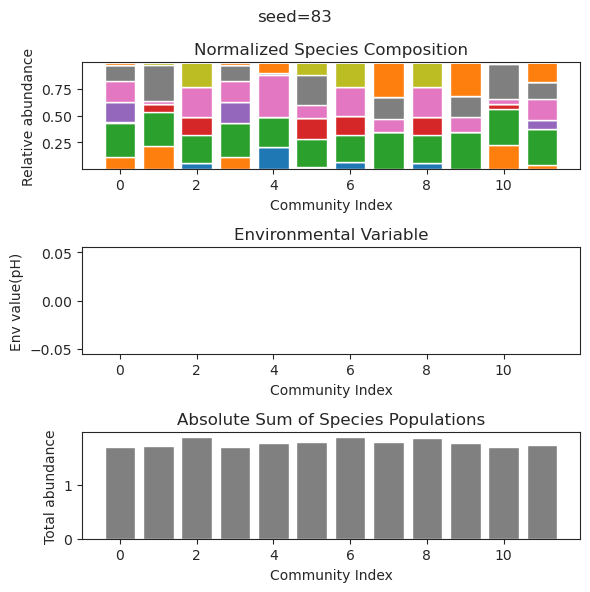

{'species': array([ 4.91460043e-07,  1.67207343e-01,  1.49791139e-02,  4.14414069e-01,
        4.54748135e-01,  2.03398227e-01,  5.60380523e-06,  4.09693385e-01,
        2.50408851e-29,  1.68461518e-41, -5.53192746e-70,  1.87619848e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 6.02765845e-07,  1.67560606e-01,  1.50103949e-02,  4.13640851e-01,
        4.54002534e-01,  2.03604672e-01,  8.43636231e-04,  4.10291691e-01,
        9.71898886e-28,  9.46220061e-41, -6.65959153e-58,  1.87442159e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([2.27940278e-0

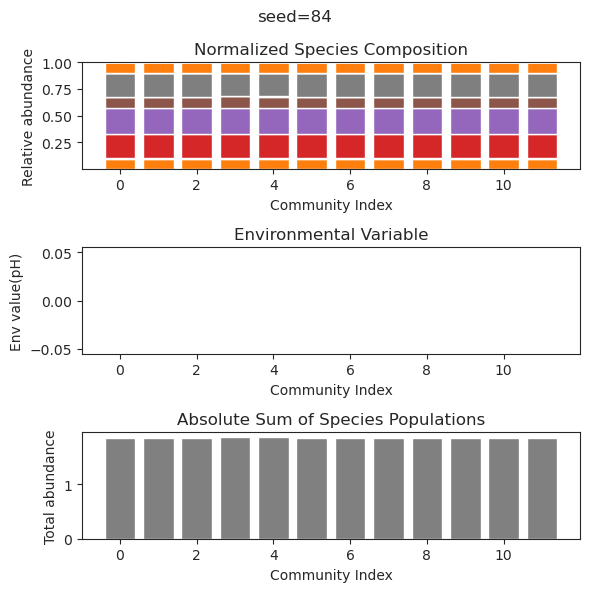

{'species': array([ 1.79533350e-001,  5.50834948e-055, -1.02121717e-064,
        1.05158558e-001,  3.74447598e-075,  4.87485062e-001,
       -5.12268667e-108,  7.57958078e-001,  3.21683433e-013,
        4.52224801e-002,  7.47917308e-002,  5.20476542e-001,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([ 1.79533350e-01,  1.42062689e-38, -4.87296385e-47,  1.05158558e-01,
       -4.09860502e-53,  4.87485062e-01, -1.84083718e-73,  7.57958078e-01,
        2.77958404e-14,  4.52224801e-02,  7.47917308e-02,  5.20476542e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([

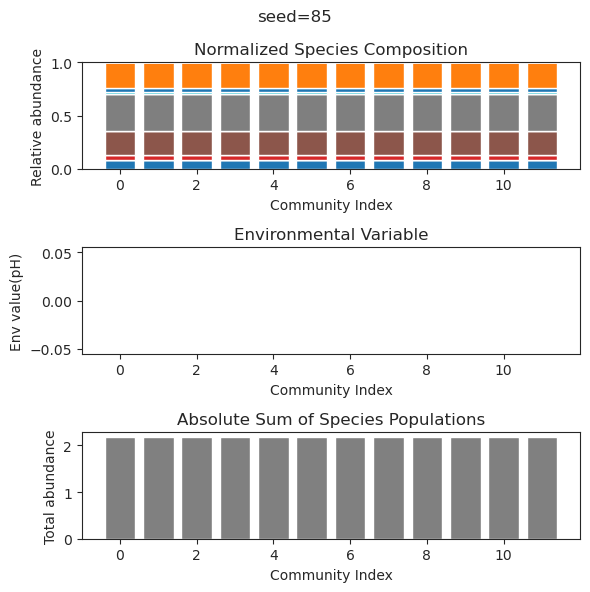

{'species': array([ 1.18479572e-16,  1.44065383e-33, -2.02752663e-70,  3.08529466e-01,
        5.58255366e-01, -2.38394794e-30, -1.65580615e-45,  4.99615597e-01,
        3.23800214e-27,  2.77178935e-02,  2.20203722e-45,  5.14583322e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-8.16938300e-19, -2.83141333e-33, -6.46329410e-73,  3.08529466e-01,
        5.58255366e-01, -2.69389212e-29, -1.17468312e-47,  4.99615597e-01,
       -7.25524862e-28,  2.77178935e-02, -1.70866894e-54,  5.14583322e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 7.23718652e-

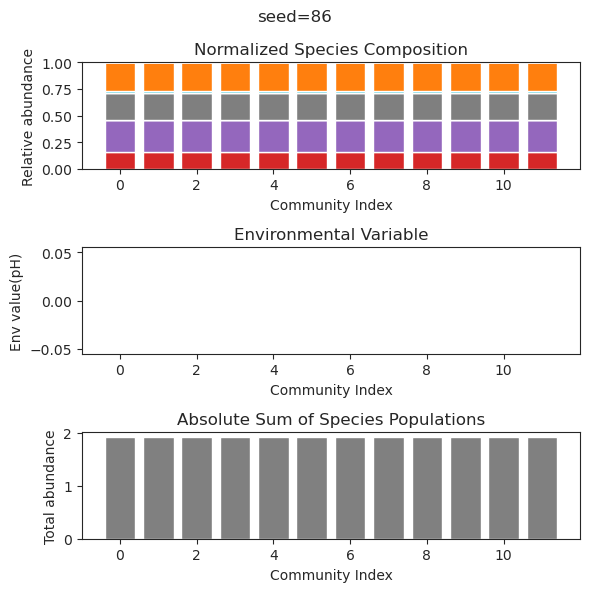

{'species': array([ 2.86440602e-01,  1.30464177e-40,  2.84894113e-35,  5.47248064e-01,
        6.35250060e-29,  1.99610150e-31,  3.63731259e-01,  4.61273904e-01,
        1.35913411e-11, -1.75042234e-27,  1.93696526e-01,  1.98712099e-46,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.86440602e-01,  3.15068825e-51, -1.14712389e-31,  5.47248064e-01,
       -2.00184579e-28, -6.78304504e-20,  3.63731259e-01,  4.61273904e-01,
        3.38555880e-15, -3.90363599e-16,  1.93696526e-01, -7.22053360e-83,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.86440602e-

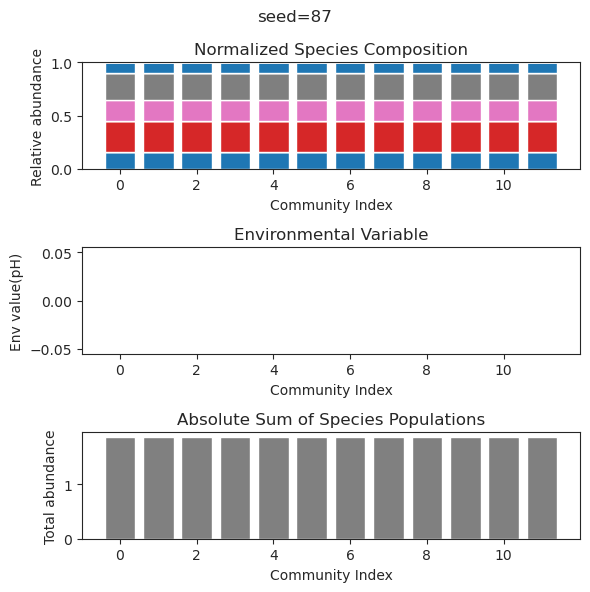

{'species': array([-1.57744245e-68, -1.80925166e-34,  7.74768004e-01,  1.70297911e-01,
        7.08924389e-01,  2.43343205e-01,  3.85349080e-01, -3.96229105e-57,
       -1.56898071e-24, -1.06608408e-59, -2.62437154e-16,  1.23906986e-73,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 8.35902662e-51, -6.53113303e-32,  7.74768004e-01,  1.70297911e-01,
        7.08924389e-01,  2.43343205e-01,  3.85349080e-01, -1.02876630e-49,
        8.66033676e-19,  2.00635106e-47,  8.66014605e-17,  1.22056387e-41,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.71027546e-

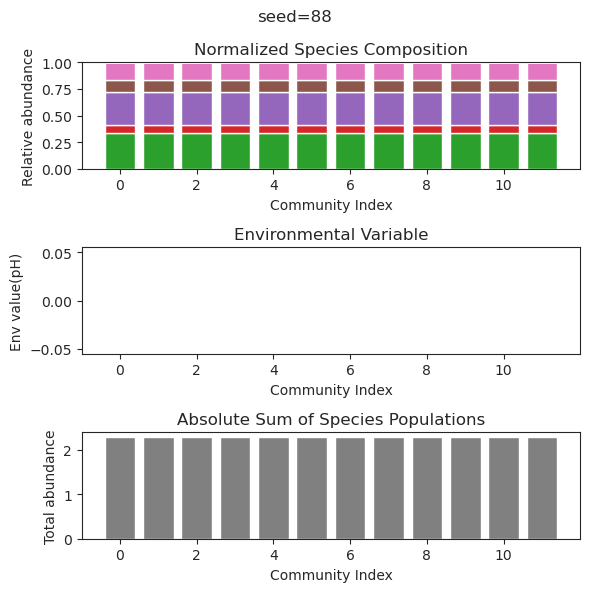

{'species': array([-1.85942018e-25,  4.74563982e-01,  2.09884192e-37,  6.88999321e-37,
        1.50485506e-01,  1.44775493e-43,  3.42790739e-43,  5.08921828e-01,
        7.38924368e-01,  1.77450782e-01,  6.41734445e-01,  5.58618627e-48,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-1.07663886e-23,  4.74563982e-01,  1.26571970e-35,  8.30327414e-35,
        1.50485506e-01, -5.76169863e-36, -1.13516116e-39,  5.08921828e-01,
        7.38924368e-01,  1.77450782e-01,  6.41734445e-01, -1.68046257e-41,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-1.58894179e-

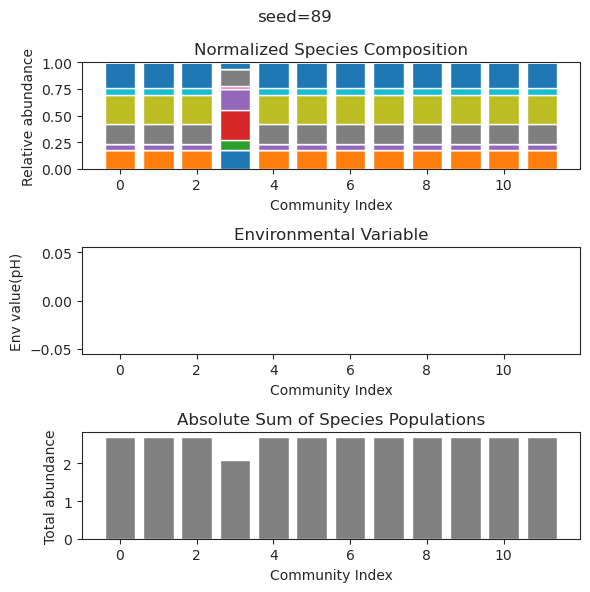

{'species': array([ 1.39410791e-01,  8.24279189e-62,  4.11802704e-46,  2.23352229e-01,
        1.43000910e-38,  4.67163328e-01, -1.00799395e-24,  3.30789931e-02,
        6.24446854e-01,  2.69649383e-02,  4.94015828e-01,  8.34391236e-02,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 1.39410791e-001, -1.01502820e-142,  6.17921102e-083,
        2.23352229e-001,  9.20801036e-050,  4.67163328e-001,
        4.35154876e-028,  3.30789931e-002,  6.24446854e-001,
        2.69649383e-002,  4.94015828e-001,  8.34391236e-002,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([

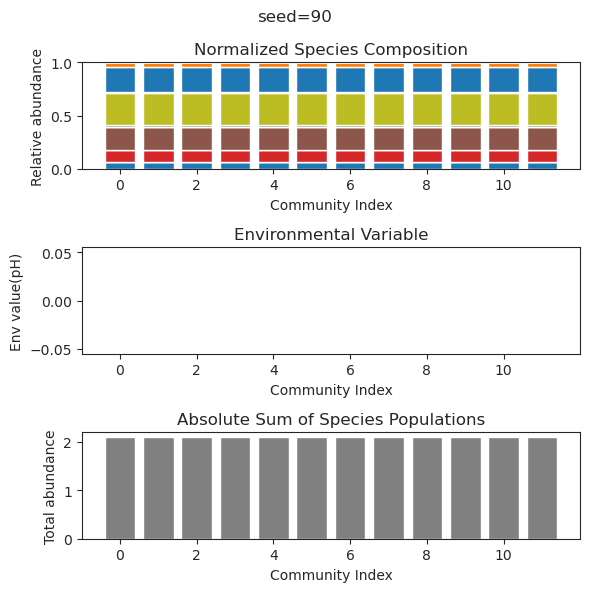

{'species': array([ 1.64105725e-47, -8.53357087e-30, -5.67394706e-33, -2.93517942e-32,
        1.09184500e-39, -1.51303101e-32,  4.30661052e-01,  3.12648689e-46,
        5.11432272e-01,  1.51563061e-19,  8.83598230e-01,  3.42250599e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-2.94025986e-48, -1.82551194e-34,  1.46085957e-30, -2.74543119e-40,
        8.53036964e-43,  5.91674298e-31,  4.30661052e-01, -7.12073006e-51,
        5.11432272e-01, -4.35932648e-19,  8.83598230e-01,  3.42250599e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-2.29554330e-

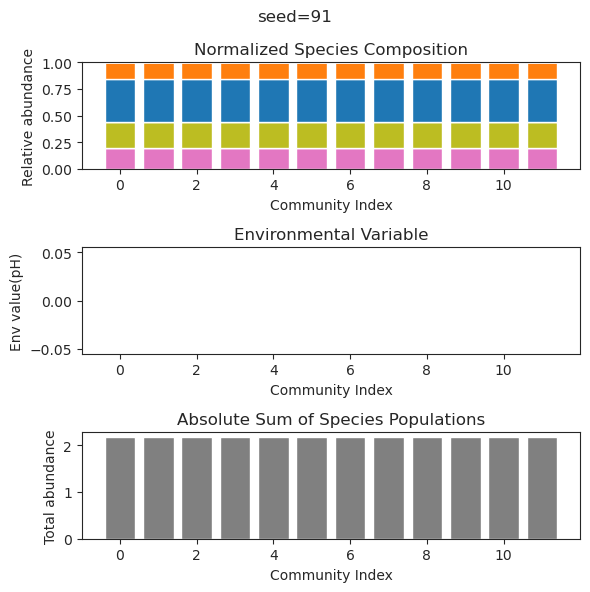

{'species': array([ 4.71825859e-01, -6.26852877e-36, -1.62979864e-31, -2.71144204e-31,
        7.90893221e-01, -1.37404103e-30, -1.50527634e-28,  5.33515351e-01,
        6.07800534e-01, -1.27481113e-22,  1.36071908e-33,  2.72952636e-35,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 9.71767074e-74,  5.84723606e-01,  8.38424591e-01, -8.14746062e-16,
        9.77732843e-49, -5.10530378e-29,  7.81427134e-38,  1.00713481e-23,
        2.53205823e-74,  6.45084343e-01,  7.42684863e-02, -1.89492641e-67,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 4.71825859e-

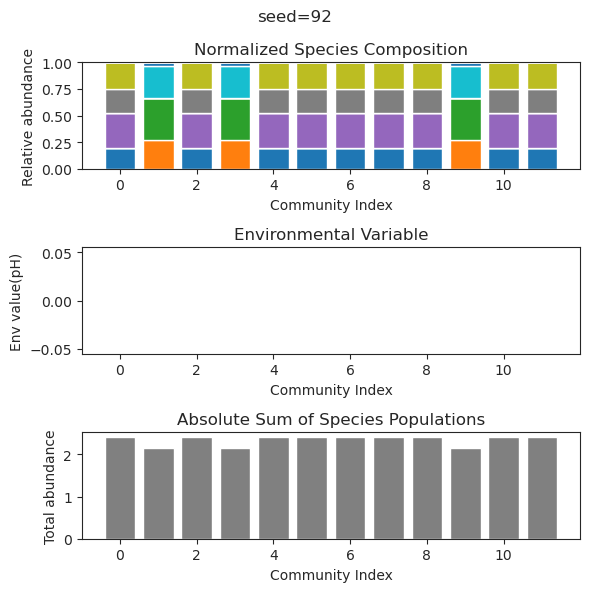

{'species': array([ 1.78196332e-212,  4.93739609e-238,  3.50409044e-037,
        1.27241815e-001,  6.17570589e-001,  3.97672036e-001,
       -2.79443587e-228,  3.01716826e-001,  1.31855490e-001,
        3.72310535e-001,  1.06430098e-236,  2.80746787e-001,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([-8.32211175e-228,  3.06830738e-249, -1.65589206e-033,
        1.27241815e-001,  6.17570589e-001,  3.97672036e-001,
        1.76873061e-242,  3.01716826e-001,  1.31855490e-001,
        3.72310535e-001, -7.97140386e-249,  2.80746787e-001,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+0

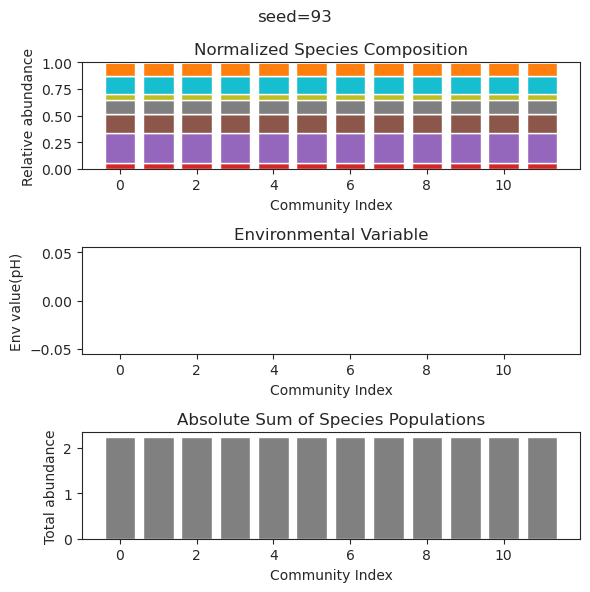

{'species': array([ 3.91140862e-017,  1.53352419e-047,  2.50180639e-002,
       -5.80351602e-083,  5.71497720e-001,  7.82986893e-001,
        2.98300240e-001,  2.39801871e-001,  1.52882947e-001,
        5.17139574e-037,  1.34578208e-001, -2.47210608e-123,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([-1.63176997e-39,  4.24370020e-41,  2.50180639e-02, -1.41553782e-40,
        5.71497720e-01,  7.82986893e-01,  2.98300240e-01,  2.39801871e-01,
        1.52882947e-01, -2.23817640e-58,  1.34578208e-01, -1.02103747e-84,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([

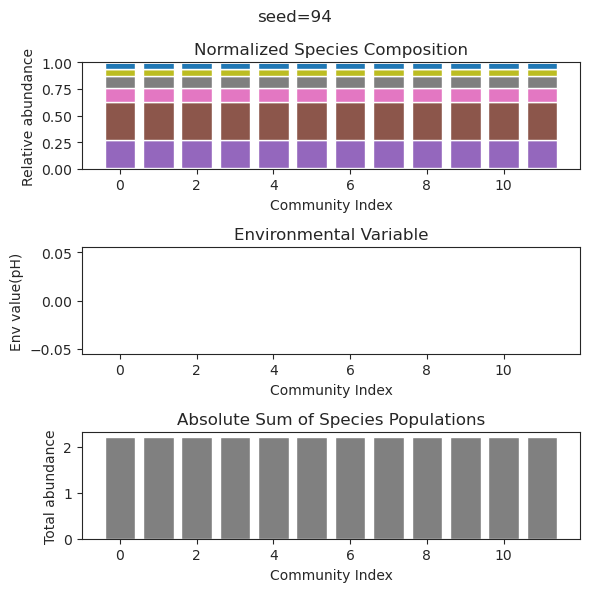

{'species': array([ 8.07192293e-35,  5.11812275e-01,  2.79147137e-01,  7.96412275e-01,
        2.87695454e-20, -9.59109576e-33,  6.98810051e-01,  1.28001528e-68,
        3.49192584e-70,  1.89962582e-55, -6.53043308e-62,  8.33184633e-03,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-1.51382169e-33,  5.11812244e-01,  2.79147044e-01,  7.96412348e-01,
        3.88766741e-19, -1.07161230e-54,  6.98810169e-01, -6.93178950e-57,
       -2.22887198e-58,  1.34281438e-53, -4.12781259e-54,  8.33171741e-03,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 4.55166038e-

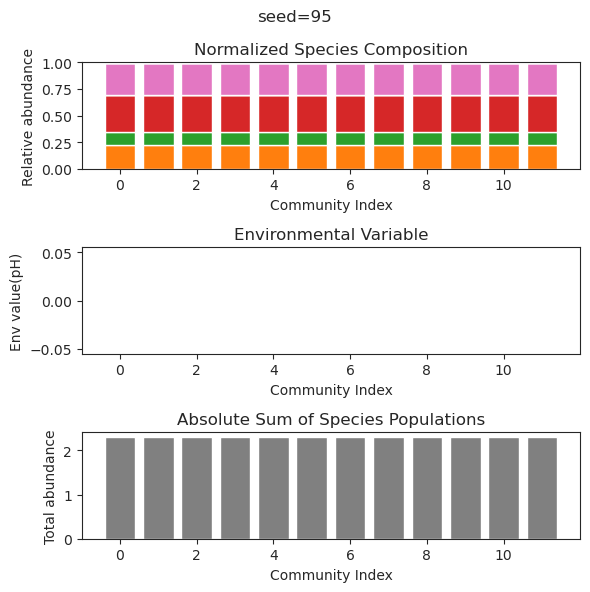

{'species': array([ 3.56474341e-02,  3.88479102e-29, -9.69848156e-28,  6.19237674e-01,
        3.61562977e-01,  4.17973432e-01,  1.23480626e-02, -3.85117108e-31,
       -3.96574207e-33,  2.11810384e-01,  2.76944502e-01,  3.06612679e-15,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 3.45972137e-48,  3.44261547e-01,  6.00495979e-01, -2.50396179e-37,
        6.28152349e-01, -5.47926468e-35, -6.04085637e-26, -2.34034787e-14,
       -2.68360781e-93,  2.65662523e-01,  1.26593094e-01, -8.33857781e-53,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([-6.97831232e-

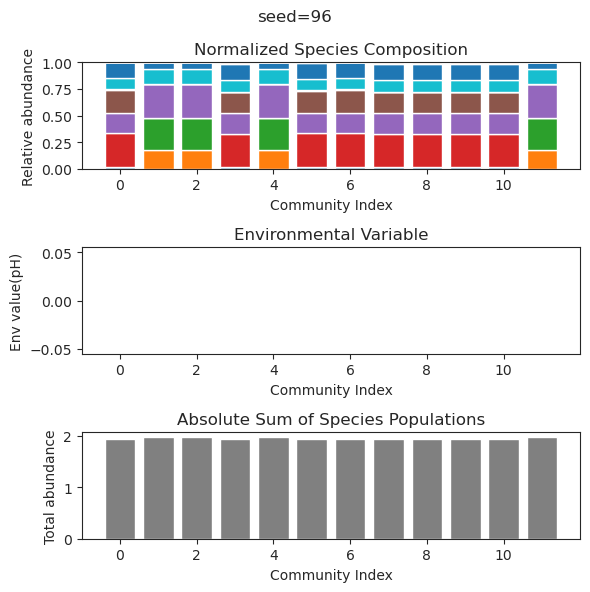

{'species': array([ 2.26491198e-01,  2.30561388e-10,  5.70060223e-97,  1.98646936e-01,
        2.79219584e-01,  5.81810370e-02, -1.53070544e-89,  3.47629455e-01,
        4.76154776e-01,  6.49949025e-24,  3.00324331e-01,  1.27658839e-83,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.26491198e-01,  1.88460691e-09, -3.77923708e-89,  1.98646936e-01,
        2.79219582e-01,  5.81810375e-02, -7.90974220e-84,  3.47629455e-01,
        4.76154775e-01, -3.78984256e-23,  3.00324331e-01,  9.10801342e-83,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}
{'species': array([ 2.26491198e-

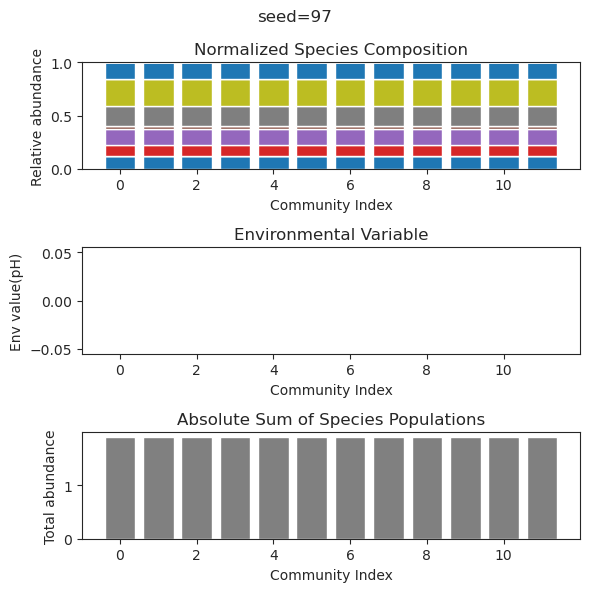

{'species': array([ 7.45908026e-002,  1.20654218e-001,  5.96718396e-001,
        5.11640402e-001, -1.48165643e-072, -7.33865630e-111,
       -2.47328507e-021,  2.07010648e-001, -6.91455614e-098,
       -3.02204418e-020,  4.54147209e-001,  7.41102667e-002,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([ 7.45908026e-02,  1.20654218e-01,  5.96718396e-01,  5.11640402e-01,
        3.40888215e-63, -7.54355068e-95, -6.58954621e-18,  2.07010648e-01,
        7.02308173e-86, -1.40183229e-20,  4.54147209e-01,  7.41102667e-02,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([

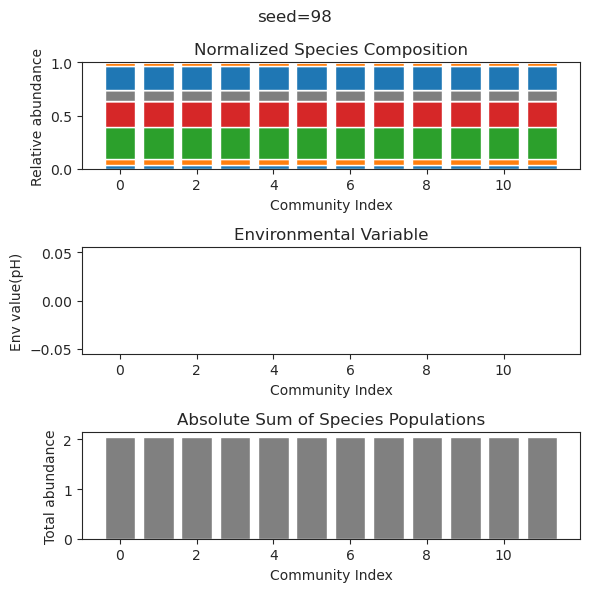

{'species': array([ 4.98226484e-083,  6.82067470e-001,  3.76343094e-002,
        6.84038814e-033,  3.77354741e-001, -6.27067239e-180,
        3.06194511e-001,  3.61055996e-001,  9.02424286e-074,
        5.69615346e-002,  4.25907663e-002,  4.85238510e-001,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000]), 'env': array([0.])}
{'species': array([-8.10372081e-070,  6.82067470e-001,  3.76343094e-002,
        1.82723181e-032,  3.77354741e-001,  1.60205174e-140,
        3.06194511e-001,  3.61055996e-001,  3.89642610e-062,
        5.69615346e-002,  4.25907663e-002,  4.85238510e-001,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  0.00000000e+0

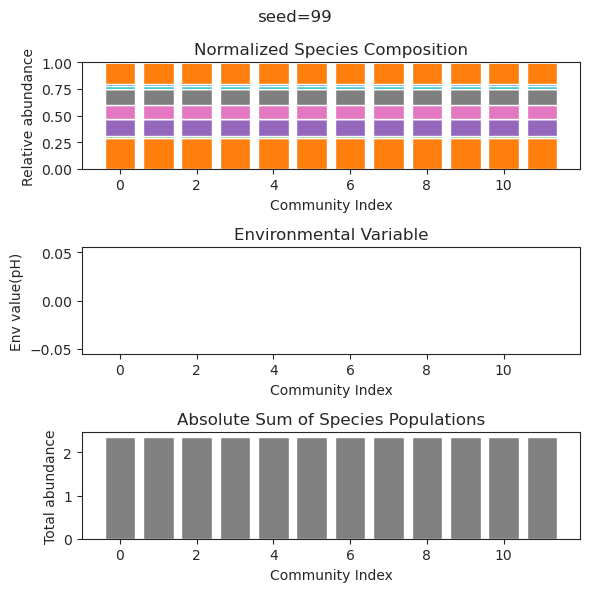

In [10]:
session_path='Results_ptailed/Session_Test3'
to_save={}
description=''
simulated_result={}

for seed_num in range(100):
    if not os.path.isdir(session_path):
        os.mkdir(session_path)
    # functions for uniform 

    f_I = lambda : uniform_distribution(0.5,0.5)
    f_g = lambda : np.ones(1)
    f_k = lambda : np.ones(1)
    f_p = lambda : custom_distribution(3,1)
    f_q = lambda : uniform_distribution(0.5,0.5)
    f_beta = lambda : np.ones(1)
    seed_num=seed_num
    to_plot=True

    np.random.seed(seed_num)

    N=24
    N_env=1


    I = np.zeros((N, N))
    for i in range(N):
        for j in range(N):
            I[i,j] = f_I()
    for i in range(N):
        I[i,i] =1

    g = np.zeros((N))
    for i in range(N):
        g[i] = f_g()

    k = np.zeros((N))
    for i in range(N):
        k[i] = f_k()   

    p = np.zeros((N_env, N))
    for i in range(N_env):
        for j in range(N):
            p[i,j] = f_p()

    #p[0,2]=-10

    q = np.zeros((N, N_env))
    for i in range(N):
        for j in range(N_env):
            q[i,j] = f_q()

    #q[2,0]=0.2



    beta = np.zeros(N_env)
    for i in range(N_env):
        beta[i]=f_beta()

    delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
    migration_rate=0#1e-7
    system_config = {
        'I': I,
        'g': g,
        'k': k,
        'p': p,
        'q': q,
        'beta': beta,
        'delta': delta,
        'migration_rate' : migration_rate,
        'N': N,
        'N_env': N_env,
        'seed_num':seed_num,
    } 

    file_path = f'{session_path}/system_config.json'

    label="test"
    sys
    ##

    y_out_list=[]
    system_config['beta'] = np.array([0])*delta

    for i in range(12):

        species_index=np.arange(0,12)
        env_index=np.array([0])
        y0_species=one_hot_vector(12,i)
        y0_env=[0]
        t=np.linspace(0, 2000, 10000)

        y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False)

        y_out_list.append(y_out)

    num_datasets = len(y_out_list)

    # Prepare subplots
    fig, axs = plt.subplots(3, 1, figsize=(6, 6))

    # Data for plots
    species_matrix = np.array([y_out['species'] for y_out in y_out_list])
    env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

    # Normalize species data
    species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
    species_sums = np.sum(species_matrix, axis=1, keepdims=True)
    normalized_species = species_matrix / species_sums

    # Absolute sums of species data (sum across all species for each dataset)
    absolute_sums = np.sum(species_matrix, axis=1)
    simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

    if to_plot:
        plt.suptitle(f'seed={seed_num}')

        # Plotting species composition as stacked bars
        bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
        for i in range(normalized_species.shape[1]):  # Loop through each species
            axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
            bottom_values += normalized_species[:, i]  # Update bottom values for stacking

        axs[0].set_title('Normalized Species Composition')
        axs[0].set_xlabel('Community Index')
        axs[0].set_ylabel('Relative abundance')
        #axs[0].legend()

        # Plotting environmental factors
        colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
        axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
        axs[1].set_title('Environmental Variable')
        axs[1].set_xlabel('Community Index')
        axs[1].set_ylabel('Env value(pH)')

        # Plotting absolute sums of species data
        axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
        axs[2].set_title('Absolute Sum of Species Populations')
        axs[2].set_xlabel('Community Index')
        axs[2].set_ylabel('Total abundance')

        plt.tight_layout()
        plt.savefig(session_path+f'/diagram_{seed_num}.png')

        #if to_plot:
        #    plt.savefig()


        plt.show()
#simulated_result = {'a': 1, 'b': 2, 'c': 3}  # Your existing dictionary
#description = "This is a description of the simulated result."

# Combine both into a new dictionary
data_to_save = {
    'result': simulated_result,
    'description': description
}
# Serialize the combined data to a pickle file
with open(session_path+'/result_and_description.pkl', 'wb') as file:
    pickle.dump(data_to_save, file)

{'species': array([-5.71888438e-063,  5.54557030e-002, -3.04323431e-100,
        3.25800275e-001,  4.65038544e-001,  6.82869358e-001,
       -1.48334571e-022, -6.40308374e-061,  1.88541205e-001,
       -1.15379530e-028, -3.29035402e-081,  3.72643134e-038]), 'env': array([-0.89538566])}
{'species': array([-2.94935674e-60,  5.54557030e-02, -3.17627454e-91,  3.25800275e-01,
        4.65038544e-01,  6.82869358e-01,  1.88249780e-18,  3.93437679e-55,
        1.88541205e-01, -1.06573612e-29, -1.50012320e-74,  3.42834483e-38]), 'env': array([-0.89538566])}
{'species': array([-1.94995260e-37,  5.54557030e-02, -4.24592293e-39,  3.25800275e-01,
        4.65038544e-01,  6.82869358e-01, -1.44970562e-23, -2.86830495e-47,
        1.88541205e-01,  2.95195945e-26,  7.66618632e-61,  3.71452957e-31]), 'env': array([-0.89538566])}
{'species': array([-5.20969274e-49,  5.54557030e-02, -1.63415186e-66,  3.25800275e-01,
        4.65038544e-01,  6.82869358e-01,  1.81603954e-18, -4.52797409e-39,
        1.88541

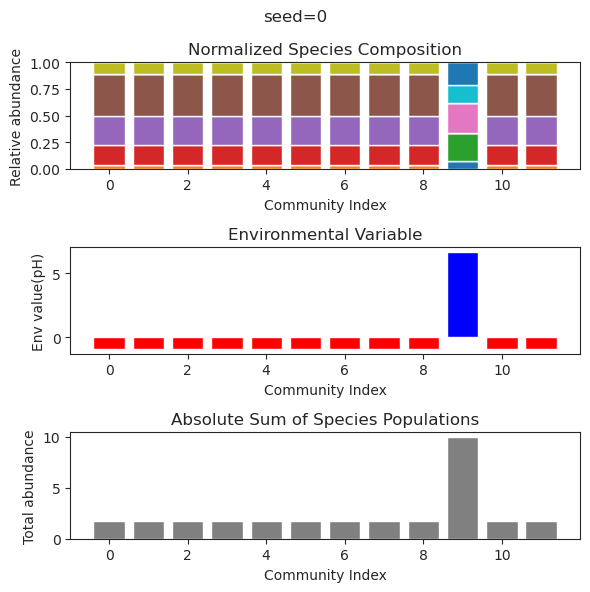

{'species': array([-1.71875977e-53, -1.23666967e-51,  2.48550634e-40,  2.83396099e-26,
       -1.11536588e-54,  1.75967393e-48, -2.09001072e-54, -1.76110616e-55,
       -8.86090018e-55,  2.74807385e-32,  7.59035141e-01,  8.84088229e-02]), 'env': array([-2.34030945])}
{'species': array([-7.09462125e-53,  5.28666046e-50,  6.56005575e-38, -1.07486603e-26,
        4.88576879e-53, -2.80918123e-44,  5.67442683e-53,  6.48109325e-56,
        5.36331920e-52,  6.20878214e-29,  7.59035141e-01,  8.84088229e-02]), 'env': array([-2.34030945])}
{'species': array([-6.33164522e-116, -1.81605383e-096, -1.50556579e-052,
       -4.83224168e-023, -1.34294605e-118, -4.74942975e-091,
        1.47853978e-122,  4.16972227e-113, -5.97028102e-101,
       -1.79209415e-035,  7.59035141e-001,  8.84088229e-002]), 'env': array([-2.34030945])}
{'species': array([ 1.15419217e-52, -1.31572364e-53,  2.90914941e-36, -4.18618529e-26,
        7.71719892e-53, -6.88747068e-47,  1.51464389e-52,  6.15339577e-55,
       -5.68850

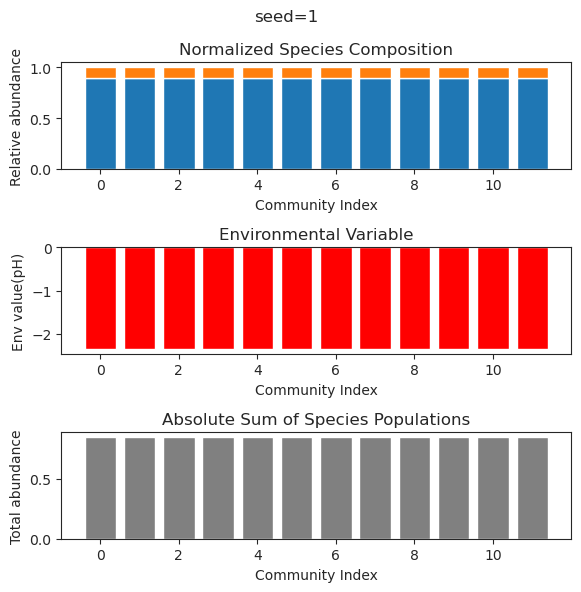

{'species': array([ 5.19947826e-01,  4.88949307e-01,  2.42953121e-01,  4.92271797e-79,
       -1.17248907e-48,  1.01114995e-40,  1.83372714e-01,  2.31705067e-11,
       -1.95246083e-87, -4.35724633e-44,  2.93159064e-02,  1.36199475e-01]), 'env': array([-0.48435411])}
{'species': array([ 5.19947826e-01,  4.88949307e-01,  2.42953121e-01, -2.87016827e-35,
        5.61197606e-40, -5.63565510e-37,  1.83372714e-01,  2.42886542e-11,
       -3.90232323e-31,  4.77363730e-39,  2.93159064e-02,  1.36199475e-01]), 'env': array([-0.48435411])}
{'species': array([ 5.19947826e-01,  4.88949307e-01,  2.42953121e-01,  5.87558115e-38,
       -8.07964277e-45, -3.68040453e-41,  1.83372714e-01,  1.08823290e-11,
        2.43608243e-67,  6.67544404e-42,  2.93159064e-02,  1.36199475e-01]), 'env': array([-0.48435411])}
{'species': array([ 5.73057579e-30, -1.65077532e-62,  2.63371113e-37, -3.93433088e-73,
        4.62499096e-01,  5.30399158e-01, -1.14384399e-18, -1.27257168e-76,
       -1.41430776e-75, -3.8478110

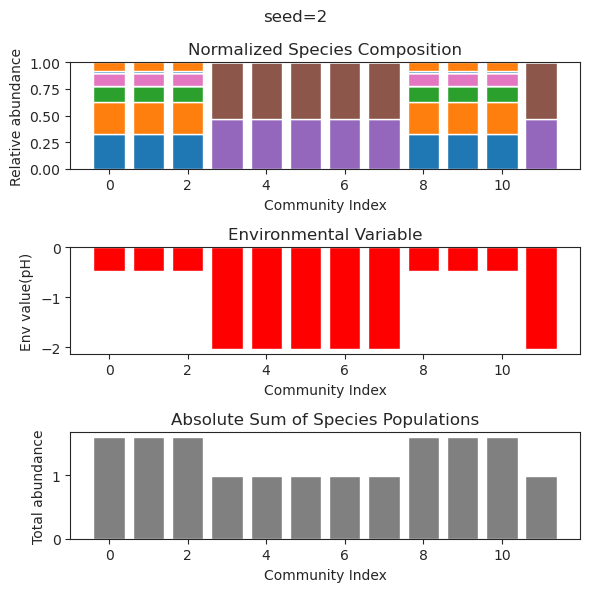

{'species': array([-7.36827096e-33,  2.31885739e+00,  2.22487141e-58,  6.30980776e-44,
       -2.14605252e-53,  4.76957089e-55,  1.01341461e+00,  2.90113955e-70,
        1.39268920e+00,  3.37364628e-46,  1.35910763e-01,  1.15185232e-68]), 'env': array([2.44819378])}
{'species': array([ 6.31177379e-44,  2.31885739e+00, -9.77349619e-76, -6.61464000e-50,
       -2.45957508e-63, -1.06464422e-65,  1.01341461e+00, -1.16778275e-75,
        1.39268920e+00,  2.17546225e-53,  1.35910763e-01, -9.49352512e-75]), 'env': array([2.44819378])}
{'species': array([-2.81990567e-33,  2.31885739e+00, -1.33909808e-42, -6.20847086e-40,
        2.09450561e-48,  2.71918632e-43,  1.01341461e+00,  3.34044541e-63,
        1.39268920e+00, -3.01348100e-40,  1.35910763e-01,  1.76025761e-57]), 'env': array([2.44819378])}
{'species': array([ 2.77793264e-40,  2.31885739e+00,  2.19028389e-74, -1.18231540e-48,
        2.44258253e-58,  2.91735817e-42,  1.01341461e+00,  1.30042914e-79,
        1.39268920e+00, -3.79613464e-

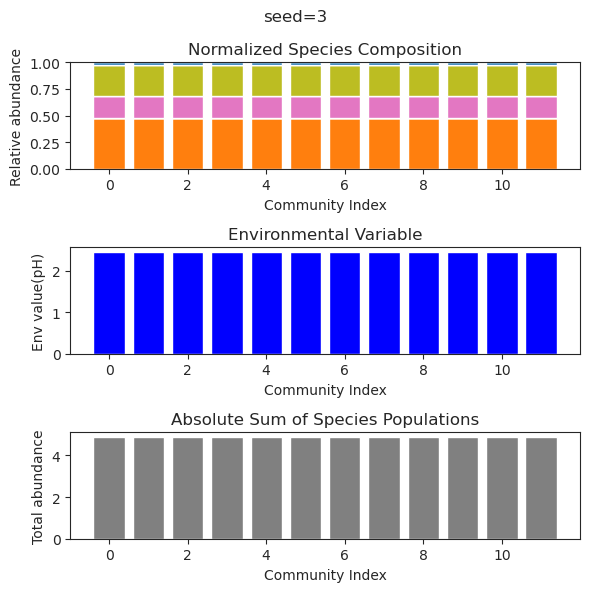

{'species': array([ 8.90738588e-38,  2.31885739e+00,  2.91354433e-62,  3.03181580e-47,
        4.45236054e-57, -7.66116892e-59,  1.01341461e+00,  1.40654299e-42,
        1.39268920e+00, -1.41091452e-49,  1.35910763e-01, -1.11874671e-64]), 'env': array([2.44819378])}
{'species': array([ 8.90738588e-38,  2.31885739e+00,  2.91354433e-62,  3.03181580e-47,
        4.45236054e-57, -7.66116892e-59,  1.01341461e+00,  1.40654299e-42,
        1.39268920e+00, -1.41091452e-49,  1.35910763e-01, -1.11874671e-64]), 'env': array([2.44819378])}
{'species': array([ 1.77201188e-001,  5.92530964e-001,  3.71894943e-001,
       -1.02197507e-163, -6.92034740e-079, -3.56814610e-103,
        1.10246851e-107,  5.63111232e-125,  2.94484959e-001,
        8.86693138e-166,  7.26074165e-026,  2.56844702e-045]), 'env': array([-0.71691217])}
{'species': array([1.23671034e-001, 5.82644320e-001, 4.39330931e-001, 5.93861400e-194,
       1.89072687e-189, 7.83857115e-091, 3.44918567e-079, 5.95434971e-015,
       2.48295041

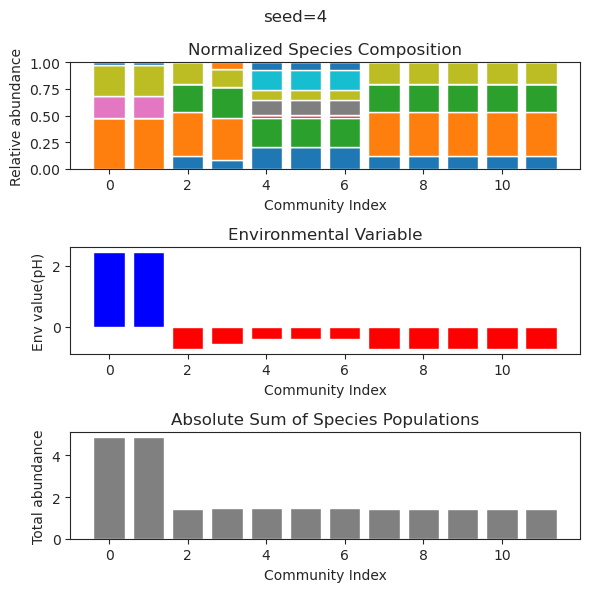

{'species': array([ 4.19711547e-015,  5.29697971e-036,  2.89273786e-001,
       -9.30495196e-165,  1.53424208e-001,  3.94048225e-001,
       -5.92847590e-207,  4.02369915e-001,  1.25839353e-022,
        2.94606777e-057,  3.00706942e-001,  3.18740150e-001]), 'env': array([-0.28554382])}
{'species': array([ 1.89675371e-014,  2.53479287e-036,  2.89273786e-001,
       -1.02514614e-169,  1.53424208e-001,  3.94048225e-001,
       -2.32110348e-220,  4.02369915e-001,  1.71032400e-021,
       -1.43930908e-056,  3.00706942e-001,  3.18740150e-001]), 'env': array([-0.28554382])}
{'species': array([ 1.32494469e-71, -1.07988064e-70,  3.76983782e-51,  2.05809064e-28,
        3.72657798e-01,  9.42911464e-02, -1.25052964e-58,  2.54800150e-01,
       -1.52708969e-34, -1.30420255e-66, -4.13513508e-23,  5.38453878e-01]), 'env': array([-1.14581144])}
{'species': array([ 1.23822325e-66, -1.95717520e-61,  8.31896341e-46,  5.62321485e-22,
        3.72657798e-01,  9.42911464e-02,  5.57151180e-44,  2.54800150e-

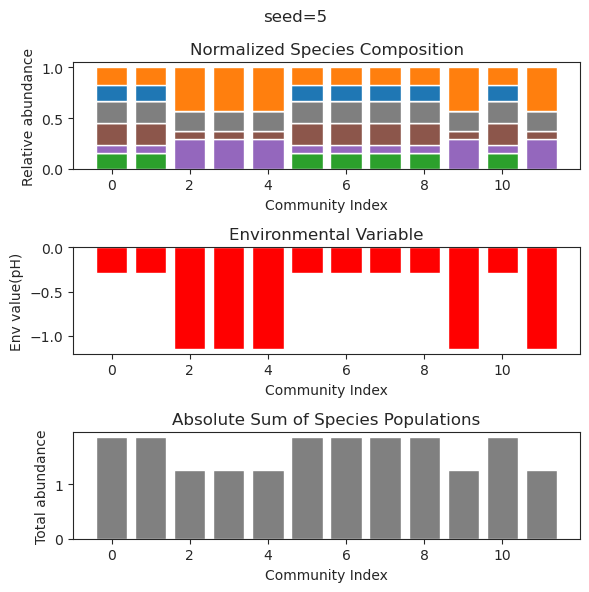

{'species': array([-1.19286273e-30, -2.27581393e-59,  5.97874795e-32,  4.74269096e-01,
        1.52934172e-46,  4.43260615e-01,  2.43110563e-19,  1.28446940e-62,
        1.83090761e-01,  3.94477213e-25,  1.02718552e-51,  1.07821202e-56]), 'env': array([-2.06108836])}
{'species': array([ 4.40696103e-34, -1.09131160e-50,  5.49807948e-31,  4.74269096e-01,
        1.31738367e-45,  4.43260615e-01,  1.49508159e-18, -1.71790866e-53,
        1.83090761e-01,  5.51260959e-29,  2.41807305e-42,  1.50567945e-47]), 'env': array([-2.06108836])}
{'species': array([ 4.70629557e-29, -2.52173381e-42,  6.86557069e-23,  4.74269096e-01,
        3.06214818e-35,  4.43260615e-01,  3.89491996e-17,  1.43741414e-44,
        1.83090761e-01,  4.81463473e-25, -6.98006384e-37, -9.10083157e-41]), 'env': array([-2.06108836])}
{'species': array([-2.85896368e-28, -5.32674855e-54,  5.29670527e-33,  4.74269096e-01,
        3.18864591e-40,  4.43260615e-01, -4.05579000e-18,  3.58435821e-62,
        1.83090761e-01,  6.1791655

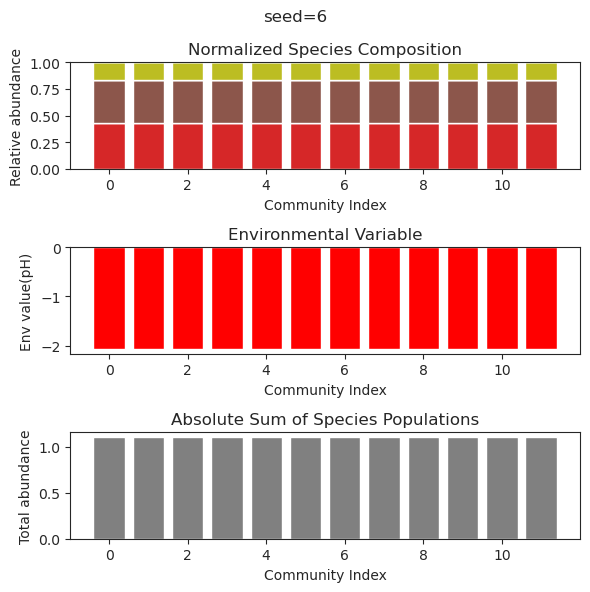

{'species': array([-1.27593808e-48, -2.27542258e-70, -5.61335696e-49,  2.87256418e-77,
        3.85801574e+00,  1.31804025e-43,  3.72339287e+00,  2.10476859e-41,
        5.77335644e-45,  4.31460976e-75,  1.42487434e-70,  5.30877288e-77]), 'env': array([4.83445063])}
{'species': array([ 5.37073766e-53,  1.73781589e-33, -1.21955080e-44,  1.88079665e-58,
       -9.19916254e-71,  5.63611006e-01,  2.26802226e-30,  2.90172723e-38,
        6.66421407e-64,  3.84920492e-01,  1.78105812e-01,  7.69067836e-01]), 'env': array([-0.12736631])}
{'species': array([-1.19482209e-36,  1.47619118e-25, -5.68712881e-32, -3.84421564e-40,
        3.49979551e-50,  5.63611006e-01,  1.81621778e-25,  5.58331339e-29,
       -2.88068429e-47,  3.84920492e-01,  1.78105812e-01,  7.69067836e-01]), 'env': array([-0.12736631])}
{'species': array([-7.32811188e-42, -1.56463511e-29, -2.72604871e-36, -4.14560071e-46,
       -9.31366290e-60,  5.63611006e-01,  5.26833701e-27, -2.45813905e-29,
       -1.93582532e-50,  3.84920492

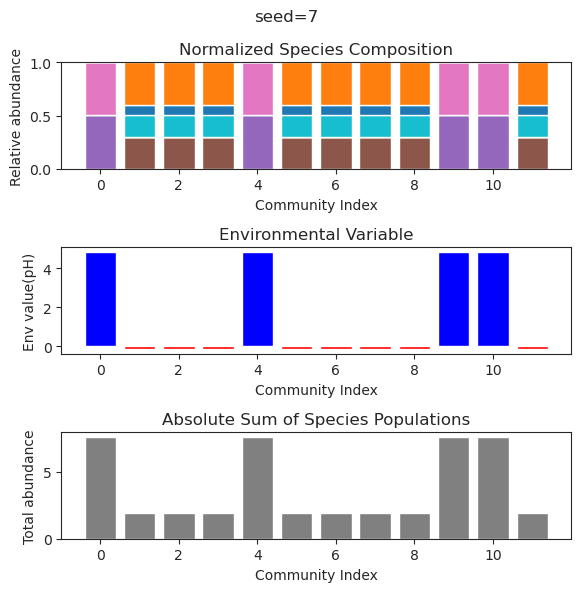

{'species': array([ 3.88160833e-01,  2.19556641e-26,  1.15490973e-24, -1.73460725e-41,
        3.20213662e-01,  3.84113160e-01,  3.48881895e-01, -1.01300576e-43,
       -8.05260355e-60,  9.18406788e-02, -1.09275399e-29,  4.00149946e-26]), 'env': array([-0.53701639])}
{'species': array([ 3.88160833e-01,  2.85289837e-22,  3.36134118e-20, -1.22186912e-42,
        3.20213662e-01,  3.84113160e-01,  3.48881895e-01, -7.14252438e-37,
       -2.33613935e-59,  9.18406788e-02,  3.22575842e-24,  1.49376631e-20]), 'env': array([-0.53701639])}
{'species': array([ 3.88160833e-01,  2.20781173e-24,  1.81387856e-21, -6.39810946e-43,
        3.20213662e-01,  3.84113160e-01,  3.48881895e-01, -6.36301511e-41,
        3.43790427e-55,  9.18406788e-02,  7.90157965e-27,  6.92275183e-22]), 'env': array([-0.53701639])}
{'species': array([ 3.88160833e-01, -2.20619995e-25, -7.28480194e-24,  8.62689834e-47,
        3.20213662e-01,  3.84113160e-01,  3.48881895e-01, -1.16659472e-42,
       -6.89906817e-65,  9.1840678

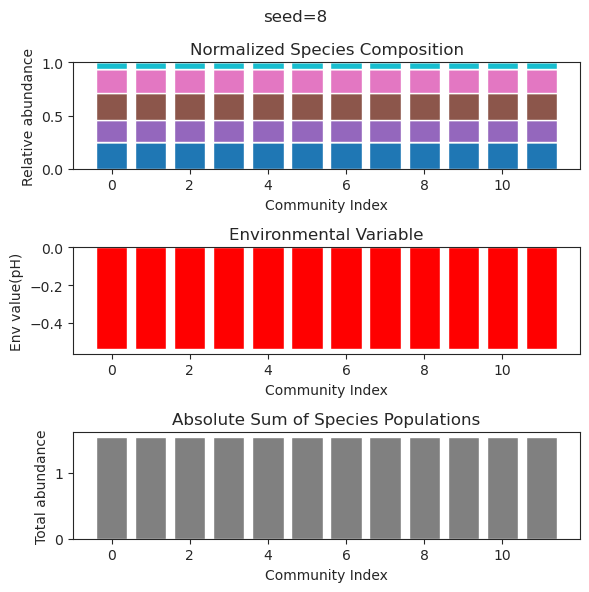

{'species': array([ 1.12040489e+00,  2.10842535e-68, -5.95688336e-50,  5.54451676e-42,
        3.96470292e-02, -5.62452901e-35,  3.33485080e-01,  1.31843873e+00,
        1.93623000e-01,  4.97929447e-01, -1.31435887e-52,  1.93750560e-97]), 'env': array([1.38367686])}
{'species': array([ 1.12040489e+00, -1.76037756e-51, -8.38574656e-43,  5.36161521e-36,
        3.96470292e-02, -1.42301221e-30,  3.33485080e-01,  1.31843873e+00,
        1.93623000e-01,  4.97929447e-01,  9.08273120e-46,  1.14366795e-74]), 'env': array([1.38367686])}
{'species': array([ 1.12040489e+00,  2.70469171e-35,  8.41223846e-42, -1.69821237e-35,
        3.96470292e-02,  6.09604337e-33,  3.33485080e-01,  1.31843873e+00,
        1.93623000e-01,  4.97929447e-01,  9.18749721e-48, -1.59535246e-84]), 'env': array([1.38367686])}
{'species': array([ 1.12040489e+00, -1.50858276e-31, -3.04638836e-42,  1.64251849e-45,
        3.96470292e-02,  1.95222780e-40,  3.33485080e-01,  1.31843873e+00,
        1.93623000e-01,  4.97929447e-

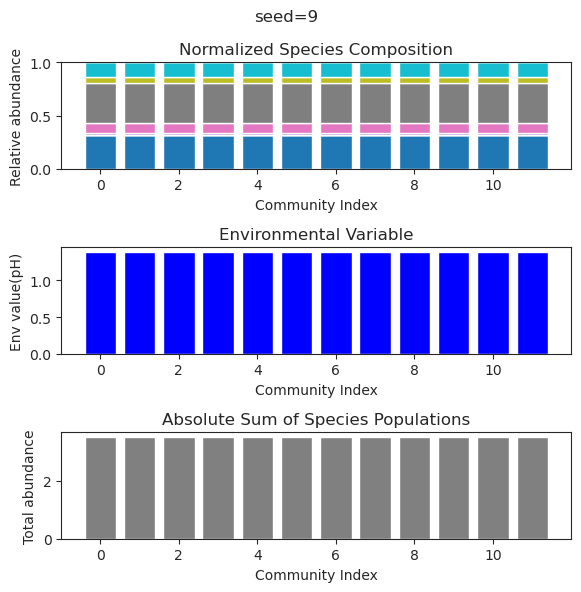

{'species': array([-3.55439235e-32, -2.27208098e-35, -4.73562219e-40, -8.69336479e-24,
       -7.62332601e-35, -1.15533341e-40, -3.18720144e-37,  5.50337305e-01,
        3.17080103e-39,  3.32448241e-01,  2.84509465e-01,  1.21545071e-39]), 'env': array([-1.3043064])}
{'species': array([ 2.22450775e-30,  1.06340284e-31, -3.85648685e-38,  1.39686181e-25,
       -1.48852114e-32,  7.40651898e-39,  6.78699453e-34,  5.50337305e-01,
        2.80153820e-35,  3.32448241e-01,  2.84509465e-01,  2.42307994e-35]), 'env': array([-1.3043064])}
{'species': array([ 1.59906337e-39,  2.15812940e-52, -4.70489829e-53, -1.12971596e-22,
        7.08158812e-45, -1.78732555e-52, -4.39944616e-54,  5.50337305e-01,
        2.71227364e-50,  3.32448241e-01,  2.84509465e-01,  1.49765687e-53]), 'env': array([-1.3043064])}
{'species': array([ 1.27291378e-37,  6.72245282e-46,  3.38108333e-50,  3.56396693e-18,
       -1.44993326e-38, -2.75611647e-49, -6.88707809e-48,  5.50337305e-01,
       -1.71059484e-43,  3.32448241e-

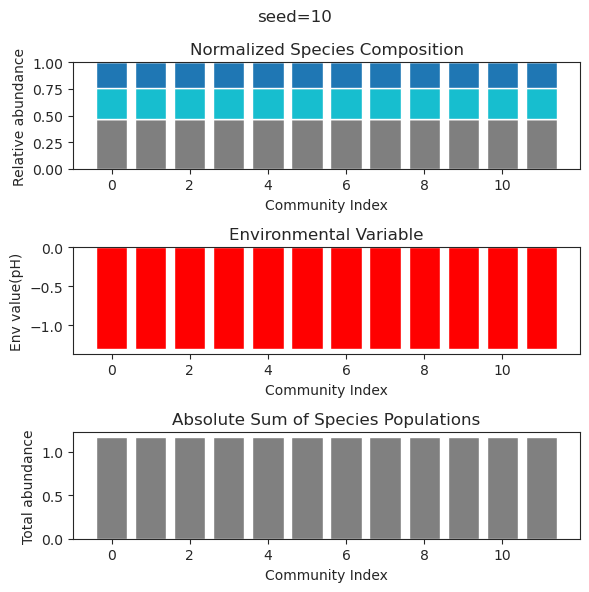

{'species': array([2.92522844e-001, 3.75577444e-001, 3.67489045e-001, 3.87617399e-001,
       1.32342543e-003, 1.02217133e-160, 6.90649456e-090, 3.09096017e-001,
       1.80264537e-001, 1.58051603e-294, 2.26508826e-284, 9.54722689e-133]), 'env': array([0.13992432])}
{'species': array([4.30880054e-001, 3.96075367e-001, 6.35910402e-001, 2.39257976e-001,
       2.70345173e-002, 1.54668421e-157, 1.06437425e-081, 1.56158731e-001,
       7.05947246e-002, 1.30347207e-294, 5.07613060e-285, 1.73271907e-131]), 'env': array([0.12697783])}
{'species': array([4.11957985e-001, 4.05291631e-001, 6.74394953e-001, 2.85179256e-001,
       4.57474085e-002, 1.92959592e-157, 1.21099811e-082, 8.75206253e-002,
       5.89006405e-002, 2.25711667e-296, 9.36811908e-286, 4.27313164e-132]), 'env': array([0.14091874])}
{'species': array([3.27650669e-001, 3.71486175e-001, 4.60102879e-001, 3.46875709e-001,
       3.74373889e-002, 5.64668143e-158, 7.21087916e-083, 2.35160727e-001,
       1.41884607e-001, 2.03142324e-2

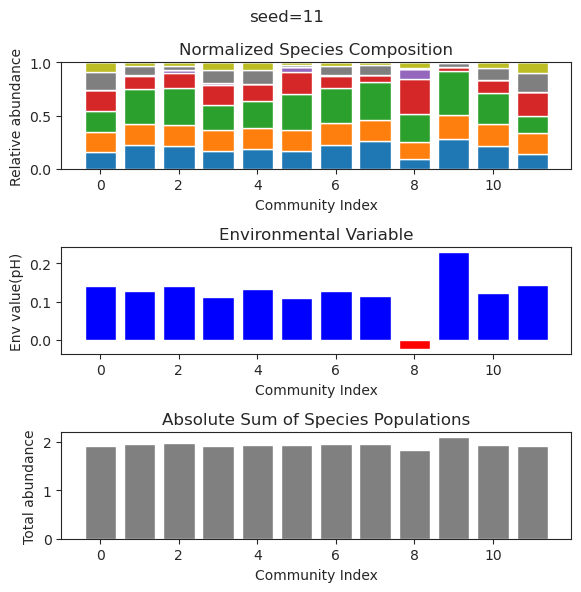

{'species': array([ 5.78376303e-01, -2.22644815e-15,  4.14882293e-46,  1.09619097e-01,
        1.02790796e-01, -2.56632363e-35,  5.81481587e-50,  3.86137209e-63,
        6.79875098e-50,  8.07907908e-45,  7.51024962e-01, -1.43734932e-67]), 'env': array([-0.60200498])}
{'species': array([ 5.78376303e-01,  1.49035813e-14, -8.90105224e-49,  1.09619097e-01,
        1.02790796e-01, -5.51115097e-37,  1.69479994e-65, -2.95265106e-82,
        6.58128648e-65, -1.71140895e-47,  7.51024962e-01, -1.32018941e-86]), 'env': array([-0.60200498])}
{'species': array([ 5.78376303e-01,  8.20000520e-14, -2.28158255e-45,  1.09619097e-01,
        1.02790796e-01,  1.32804520e-32,  6.13507733e-59,  6.34001424e-78,
        4.70810016e-59, -1.13379230e-44,  7.51024962e-01,  1.10644563e-83]), 'env': array([-0.60200498])}
{'species': array([ 5.78376303e-01,  4.83179501e-15, -5.74745509e-52,  1.09619097e-01,
        1.02790796e-01, -1.85616949e-34, -3.37495212e-52,  5.42809260e-78,
       -3.72759931e-52, -9.1281076

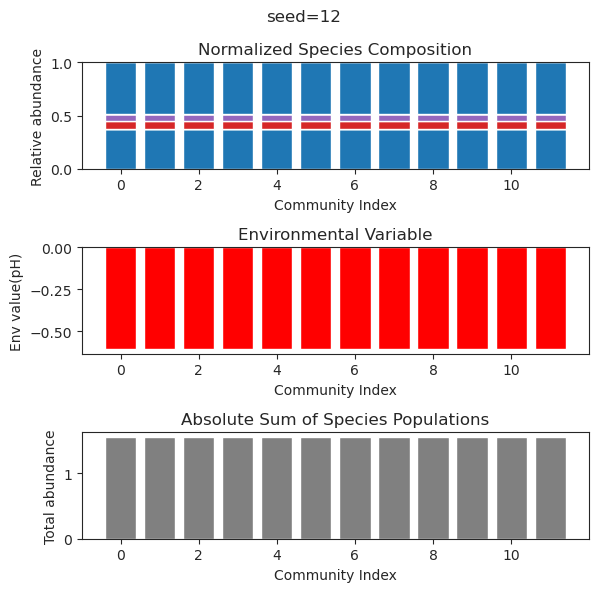

{'species': array([4.09756255e-27, 5.50911885e-05, 9.49293572e-27, 3.16952685e-01,
       9.31108262e-02, 1.67621325e-67, 1.49985213e-02, 1.60259967e-01,
       2.66334248e-01, 5.73750110e-01, 2.70009868e-01, 1.61105848e-68]), 'env': array([-0.41645645])}
{'species': array([ 1.26005711e-27,  2.83857351e-05,  1.39846998e-27,  3.17048294e-01,
        9.31041733e-02, -2.07151980e-84,  1.49567415e-02,  1.60290055e-01,
        2.66294384e-01,  5.73728666e-01,  2.70069055e-01,  1.21928143e-71]), 'env': array([-0.41635997])}
{'species': array([ 4.26853730e-118,  7.07387667e-009,  1.60770982e-029,
        3.17886328e-001,  9.31208789e-002, -1.02284141e-119,
        1.44000565e-002,  1.60528331e-001,  2.65861924e-001,
        5.73648491e-001,  2.70436968e-001,  6.50212658e-088]), 'env': array([-0.4158412])}
{'species': array([-4.09987678e-26,  5.08280355e-05,  6.15266230e-27,  3.16968599e-01,
        9.31097849e-02, -4.18124575e-27,  1.49914004e-02,  1.60264952e-01,
        2.66327539e-01,  5.7

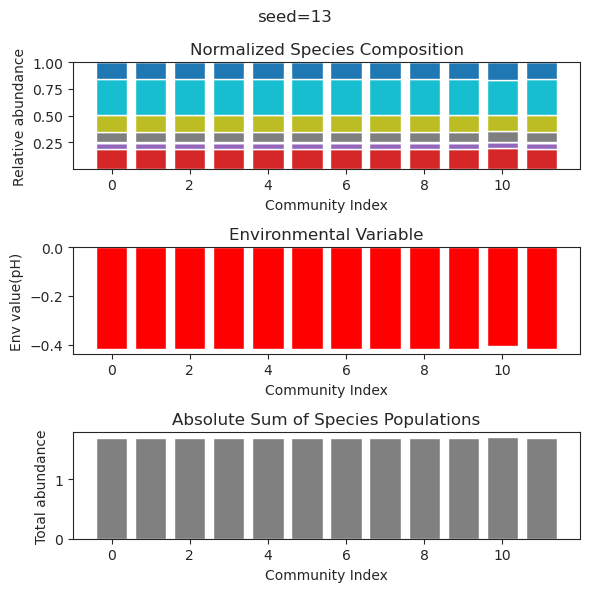

{'species': array([ 9.55017800e-48,  8.42456995e-02, -2.84088610e-85,  1.59439638e-01,
        2.08855097e-14,  6.21424467e-02,  6.27700084e-02, -2.49236378e-74,
        5.32460772e-01,  5.27464825e-64,  4.59459760e-01,  3.72933823e-01]), 'env': array([-0.36387332])}
{'species': array([-1.15601184e-49,  8.42456995e-02, -2.30311150e-88,  1.59439638e-01,
        1.54316889e-13,  6.21424467e-02,  6.27700084e-02,  5.82501842e-68,
        5.32460772e-01,  5.08440513e-62,  4.59459760e-01,  3.72933823e-01]), 'env': array([-0.36387332])}
{'species': array([-2.16083046e-39,  8.42456995e-02,  2.46285191e-38,  1.59439638e-01,
        4.00401826e-14,  6.21424467e-02,  6.27700084e-02,  1.61191056e-38,
        5.32460772e-01,  6.68975766e-61,  4.59459760e-01,  3.72933823e-01]), 'env': array([-0.36387332])}
{'species': array([6.87363557e-50, 8.42456995e-02, 1.40832454e-96, 1.59439638e-01,
       4.42953240e-15, 6.21424467e-02, 6.27700084e-02, 1.28532720e-77,
       5.32460772e-01, 1.33558679e-69, 4.5

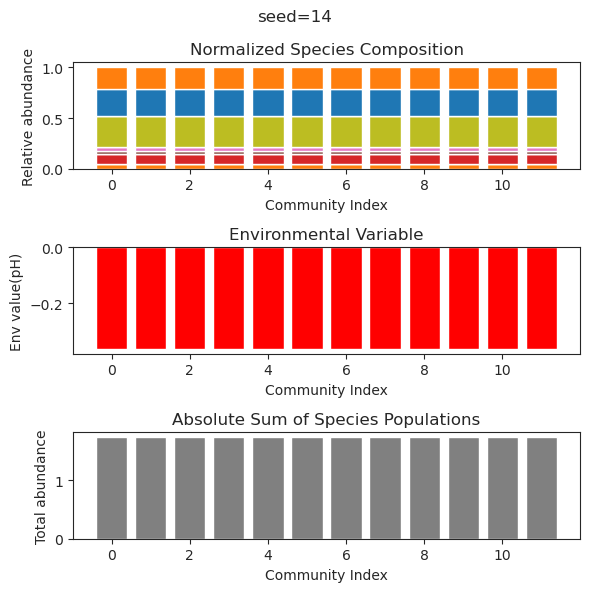

{'species': array([ 4.94126325e-001,  2.67511562e-001, -9.52952154e-038,
        5.88123224e-001,  3.66964731e-002,  4.61011170e-002,
        3.09569859e-001,  6.29707801e-002,  1.23879573e-001,
       -4.22733721e-165, -5.70249243e-038,  3.66958590e-108]), 'env': array([-0.1895723])}
{'species': array([ 4.94126325e-001,  2.67511562e-001,  6.73347605e-043,
        5.88123224e-001,  3.66964731e-002,  4.61011170e-002,
        3.09569859e-001,  6.29707801e-002,  1.23879573e-001,
       -4.89674205e-127,  5.42103209e-046, -2.21867315e-095]), 'env': array([-0.1895723])}
{'species': array([ 4.94126325e-001,  2.67511562e-001,  1.36445155e-046,
        5.88123224e-001,  3.66964731e-002,  4.61011170e-002,
        3.09569859e-001,  6.29707801e-002,  1.23879573e-001,
       -1.06181244e-133, -6.75087597e-050, -3.15010829e-101]), 'env': array([-0.1895723])}
{'species': array([ 4.94126325e-001,  2.67511562e-001,  4.01415867e-042,
        5.88123224e-001,  3.66964731e-002,  4.61011170e-002,
        

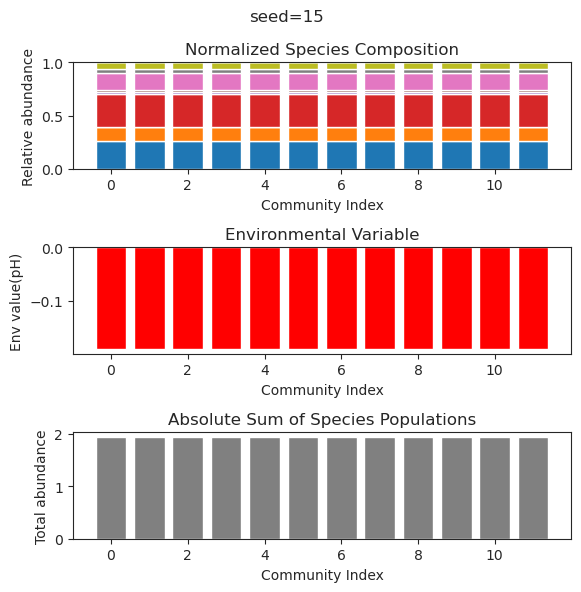

{'species': array([ 1.47382720e-42,  3.04753929e-01,  2.59318314e-01,  8.50527084e-19,
        2.29074100e-38,  6.49649788e-46,  2.89233084e-01, -2.26464222e-26,
        5.86186736e-51, -1.69601913e-21,  6.51001837e-01,  6.67417939e-38]), 'env': array([-1.07516169])}
{'species': array([ 7.53906766e-51,  3.04753929e-01,  2.59318314e-01, -2.70055169e-20,
        9.95054875e-37,  3.30142613e-54,  2.89233084e-01, -2.99657772e-29,
        2.36987848e-49, -1.01912065e-20,  6.51001837e-01,  2.51385614e-39]), 'env': array([-1.07516169])}
{'species': array([-1.00100991e-55,  3.04753929e-01,  2.59318314e-01, -5.73626003e-18,
       -2.95629766e-35,  1.02223593e-51,  2.89233084e-01,  1.39042940e-25,
        1.10991204e-49, -2.67927060e-20,  6.51001837e-01, -4.41424392e-41]), 'env': array([-1.07516169])}
{'species': array([ 8.14595707e-60,  3.04753929e-01,  2.59318314e-01, -1.53641657e-18,
        1.73123213e-37,  3.94914253e-56,  2.89233084e-01,  2.32386633e-25,
        2.24325819e-54, -4.8988262

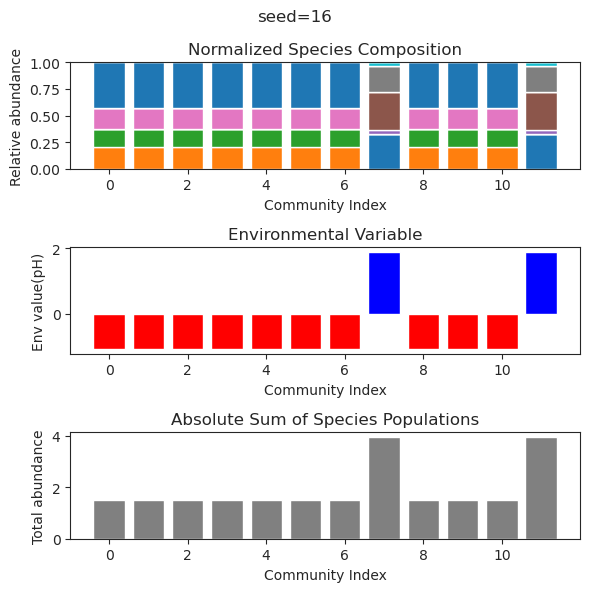

{'species': array([ 6.26869312e-26,  4.81622174e-01,  4.83848168e-01,  5.87541770e-01,
        1.34818027e-24, -2.78833557e-14,  1.50490680e-61,  1.11371075e-63,
        1.06472667e-69,  4.83464290e-69,  2.02450643e-21, -7.32766318e-37]), 'env': array([-1.32017977])}
{'species': array([-6.94668951e-25,  4.81622174e-01,  4.83848168e-01,  5.87541770e-01,
        1.78294310e-26, -9.69878188e-15,  1.08258834e-45, -3.90764336e-47,
        2.48142059e-56, -4.64377955e-54, -1.78543516e-23,  2.09105046e-35]), 'env': array([-1.32017977])}
{'species': array([-1.78353672e-34,  4.81622174e-01,  4.83848168e-01,  5.87541770e-01,
       -6.27072573e-35,  2.64069210e-17,  2.63041042e-71,  1.13039170e-69,
       -4.21523721e-75,  7.11525223e-77, -1.50276484e-26,  7.00782207e-47]), 'env': array([-1.32017977])}
{'species': array([ 2.31295464e-26,  4.81622174e-01,  4.83848168e-01,  5.87541770e-01,
        4.84683649e-24, -1.01539783e-14,  3.28404982e-71,  8.09614052e-63,
       -1.79126638e-75,  2.8554752

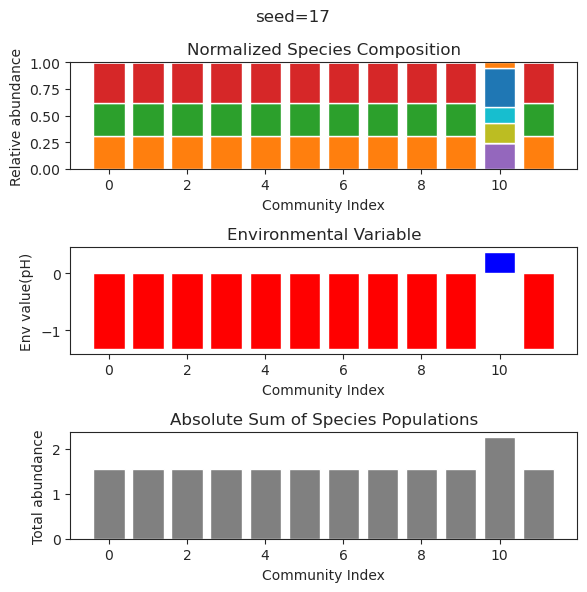

{'species': array([-8.88124303e-34,  4.35692469e-59,  7.36476562e-02,  7.88937187e-24,
        9.91553828e-36,  3.78597893e-51,  3.35512247e-01,  3.33734613e-03,
        5.13217451e-01,  5.13375812e-29,  3.27232634e-23, -1.98781506e-63]), 'env': array([-0.93935572])}
{'species': array([-9.35604821e-34, -4.31321652e-33,  7.36464056e-02,  6.35723619e-25,
       -9.16979929e-36, -6.22872342e-57,  3.35516196e-01,  3.33030943e-03,
        5.13220735e-01, -1.29580736e-27,  1.77495002e-24,  1.03819473e-74]), 'env': array([-0.93935718])}
{'species': array([ 8.05945363e-30,  3.31232636e-52,  7.36455299e-02,  4.27072476e-26,
        8.84882988e-32, -1.11494199e-40,  3.35518961e-01,  3.32538161e-03,
        5.13223034e-01, -1.68685211e-52,  9.55708351e-20,  7.26275002e-53]), 'env': array([-0.9393582])}
{'species': array([-1.58183330e-29, -1.30112683e-63,  7.36470619e-02,  2.61433223e-24,
       -1.21721492e-38,  6.60144089e-54,  3.35514123e-01,  3.33400256e-03,
        5.13219011e-01, -2.15916811

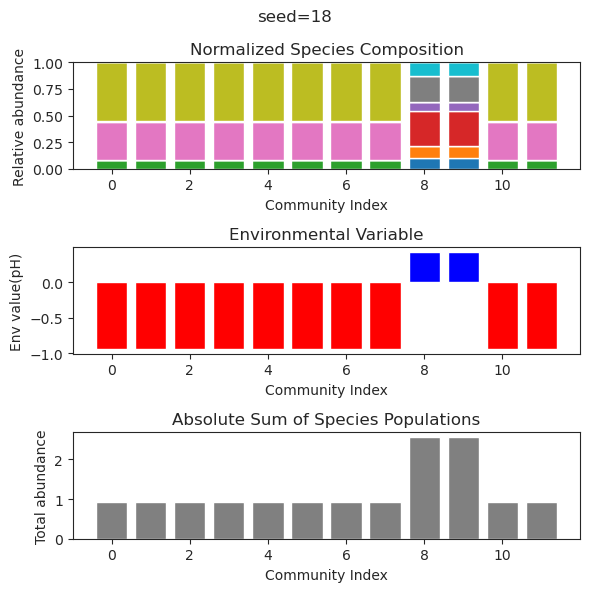

{'species': array([ 9.09878539e-002,  1.55928022e-201,  5.14407980e-126,
        5.10843453e-001, -1.33254725e-024,  2.43104161e-184,
        5.42215652e-001,  2.19454116e-002,  2.15050976e-001,
        1.77252964e-192,  3.16275679e-001,  4.18825479e-042]), 'env': array([-0.64807646])}
{'species': array([ 9.09878539e-002, -3.26399586e-179, -6.70400669e-114,
        5.10843453e-001, -1.83225820e-029,  1.11077485e-165,
        5.42215652e-001,  2.19454116e-002,  2.15050976e-001,
        4.03660592e-176,  3.16275679e-001,  1.35544039e-039]), 'env': array([-0.64807646])}
{'species': array([ 9.09878539e-002,  5.44273627e-173,  7.30212599e-105,
        5.10843453e-001, -1.92250992e-042, -8.33323518e-034,
        5.42215652e-001,  2.19454116e-002,  2.15050976e-001,
        5.33511162e-176,  3.16275679e-001,  6.65638160e-043]), 'env': array([-0.64807646])}
{'species': array([ 9.09878539e-002,  1.81240630e-180, -1.11501677e-114,
        5.10843453e-001,  4.08270706e-029, -3.82339027e-166,
     

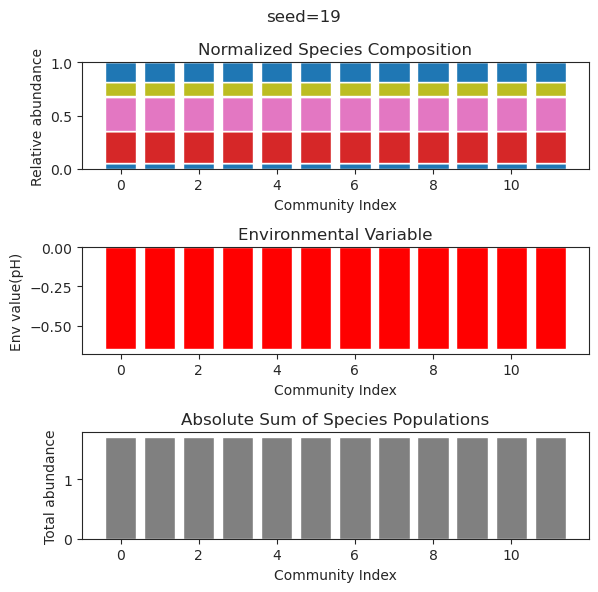

{'species': array([ 4.54866385e-48, -2.93060237e-41, -5.05378608e-15,  6.30468334e-01,
       -1.51320993e-72, -1.98551141e-36,  3.08247239e-18, -3.65266578e-33,
       -4.25787826e-56, -1.01323975e-37,  1.45135683e-01,  3.59431086e-26]), 'env': array([-1.27273237])}
{'species': array([ 3.23233050e-47,  4.24590564e-32, -9.90178189e-18,  6.30468334e-01,
       -1.12709915e-61, -2.34034936e-33,  5.83742194e-16,  2.11126565e-30,
        2.25202743e-44,  3.13705117e-30,  1.45135683e-01,  8.70699057e-21]), 'env': array([-1.27273237])}
{'species': array([-5.90852496e-67,  3.56655162e-43,  2.31719536e-24,  6.30468334e-01,
        3.38076407e-92, -1.80668580e-55,  3.01645308e-15,  7.56668678e-51,
       -1.75267965e-73,  1.77353465e-46,  1.45135683e-01, -7.06700694e-27]), 'env': array([-1.27273237])}
{'species': array([-1.87444937e-37,  4.33544123e-35, -2.29159102e-21,  6.30468334e-01,
        1.79360538e-48, -1.98339200e-38,  9.46807836e-15,  1.41313520e-34,
       -5.75774052e-42,  4.2685184

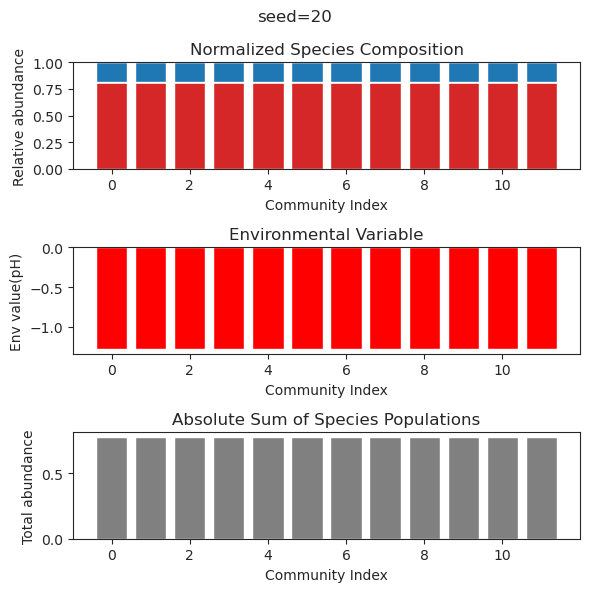

{'species': array([-1.15655417e-41,  4.27841988e-01, -4.17179377e-33,  1.29864281e-48,
        8.76650188e-57,  3.80493004e-48, -2.75273335e-51,  5.69650935e-01,
        6.02660865e-01,  1.83654400e-66, -1.04589320e-59, -2.06296996e-63]), 'env': array([-0.80297557])}
{'species': array([-1.66698583e-28,  4.27841988e-01,  4.26905267e-35,  6.16633229e-47,
       -2.73889081e-38, -3.61637746e-37,  2.86658543e-46,  5.69650935e-01,
        6.02660865e-01,  1.12789261e-52,  1.75788437e-40,  7.30471071e-48]), 'env': array([-0.80297557])}
{'species': array([-1.86640615e-17,  4.27841988e-01, -6.78297827e-27, -4.47789918e-29,
       -1.62925409e-30,  2.52328796e-31,  7.92121894e-36,  5.69650935e-01,
        6.02660865e-01,  8.84545792e-35, -1.33263038e-31, -1.06725011e-37]), 'env': array([-0.80297557])}
{'species': array([-1.01360137e-25,  4.27841988e-01, -6.26714371e-29,  3.69406149e-34,
        5.16997602e-45, -6.80954322e-40, -7.12366550e-43,  5.69650935e-01,
        6.02660865e-01, -1.2584516

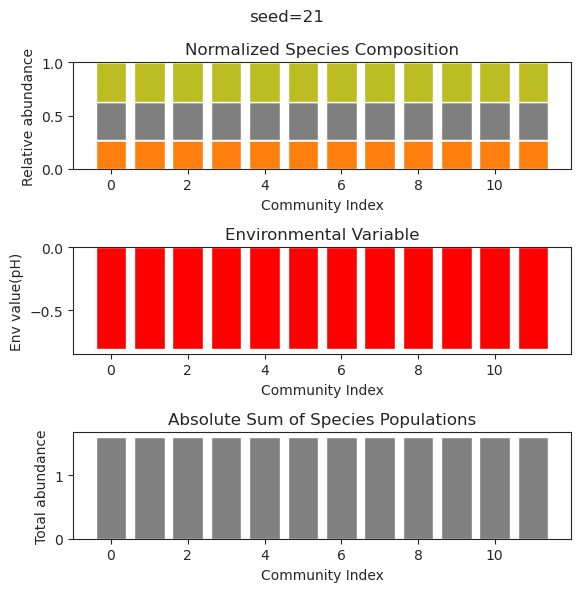

{'species': array([ 3.51828003e-001,  2.63832722e-001, -3.94052554e-092,
       -2.15745301e-051, -2.30197934e-118,  2.75284835e-037,
        1.30102165e-001, -1.08031054e-026, -1.69641259e-075,
        2.55867871e-001,  1.59607921e-001,  1.16698862e-001]), 'env': array([-1.12294301])}
{'species': array([ 3.51828003e-01,  2.63832722e-01,  5.95940077e-93, -1.03276395e-68,
        5.44457736e-35,  1.21805049e-31,  1.30102165e-01,  1.04194494e-22,
        4.02375455e-55,  2.55867871e-01,  1.59607921e-01,  1.16698862e-01]), 'env': array([-1.12294301])}
{'species': array([ 3.51828003e-01,  2.63832722e-01,  1.50790401e-61,  1.03416888e-44,
       -1.20182433e-75, -1.05676148e-30,  1.30102165e-01, -7.06668081e-27,
        4.51875899e-48,  2.55867871e-01,  1.59607921e-01,  1.16698862e-01]), 'env': array([-1.12294301])}
{'species': array([ 3.51828003e-001,  2.63832722e-001,  1.21272163e-076,
       -5.40445220e-051, -3.51491544e-100, -5.46066177e-032,
        1.30102165e-001, -3.01502744e-019, 

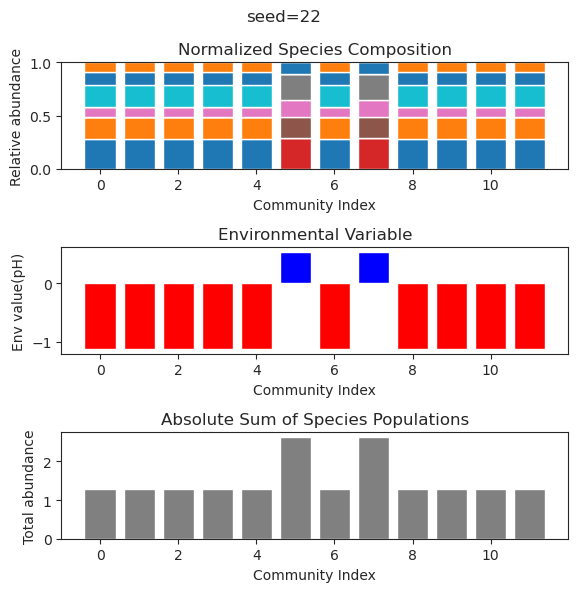

{'species': array([-1.00384343e-26,  2.28393064e-01,  4.81835506e-01,  3.41396810e-02,
       -2.16801916e-65,  8.88816782e-78,  4.61979047e-01, -3.44397452e-49,
        1.12118249e-79,  8.00827681e-41,  7.60053206e-33,  5.29159996e-02]), 'env': array([-1.73684624])}
{'species': array([ 1.55851407e-23,  2.28393064e-01,  4.81835506e-01,  3.41396810e-02,
       -1.01240359e-68, -9.02236151e-76,  4.61979047e-01,  2.16014133e-50,
       -2.71516935e-76,  3.79909108e-40,  3.26223968e-37,  5.29159996e-02]), 'env': array([-1.73684624])}
{'species': array([ 2.31001816e-26,  2.28393064e-01,  4.81835506e-01,  3.41396810e-02,
       -2.39463474e-44,  3.75195131e-51,  4.61979047e-01, -2.76824950e-38,
       -6.09361773e-51,  1.17204328e-32,  2.55955525e-33,  5.29159996e-02]), 'env': array([-1.73684624])}
{'species': array([ 1.14344747e-22,  2.28393064e-01,  4.81835506e-01,  3.41396810e-02,
       -4.63585508e-55, -1.84442776e-64,  4.61979047e-01, -9.99235248e-44,
       -5.93946067e-59,  2.1044531

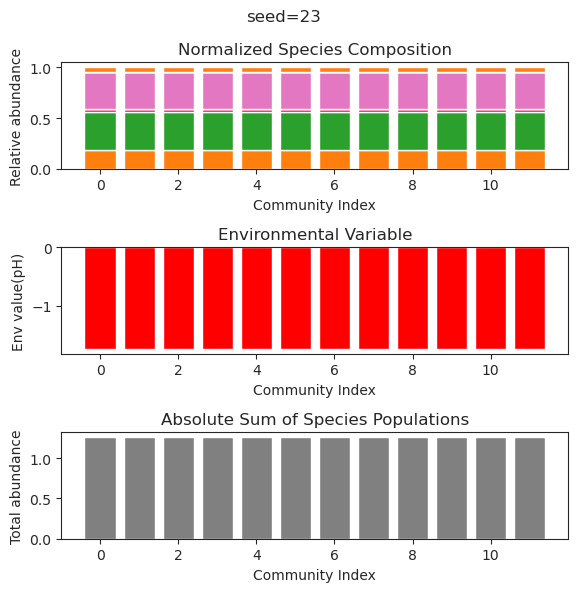

{'species': array([ 2.34226840e-001, -9.81721443e-287,  4.63934340e-037,
        4.77613615e-002,  4.56466719e-024,  5.27813029e-124,
        7.02759361e-002,  1.50316071e-001,  4.17044813e-001,
        1.77751433e-001,  5.96561806e-002,  1.24548535e-001]), 'env': array([-0.48012808])}
{'species': array([ 2.20077090e-001, -6.47808282e-278,  7.18712299e-043,
        4.06126550e-002,  1.78984524e-033,  5.10878594e-097,
        7.88929733e-002,  1.34062728e-001,  4.38431113e-001,
        1.69717730e-001,  5.19433633e-002,  1.33007069e-001]), 'env': array([-0.49413473])}
{'species': array([ 2.54946488e-001,  8.22160398e-161,  1.84790689e-027,
        1.50432761e-004,  4.04162183e-008, -1.84876755e-100,
        4.54508143e-026,  1.61470028e-001,  4.34214009e-001,
        1.25307092e-001,  4.86409467e-002,  1.83987988e-001]), 'env': array([-0.54147965])}
{'species': array([ 2.54825192e-001,  2.04643458e-133, -3.03339730e-035,
        7.93299983e-006,  6.10334311e-013,  1.36781099e-035,
     

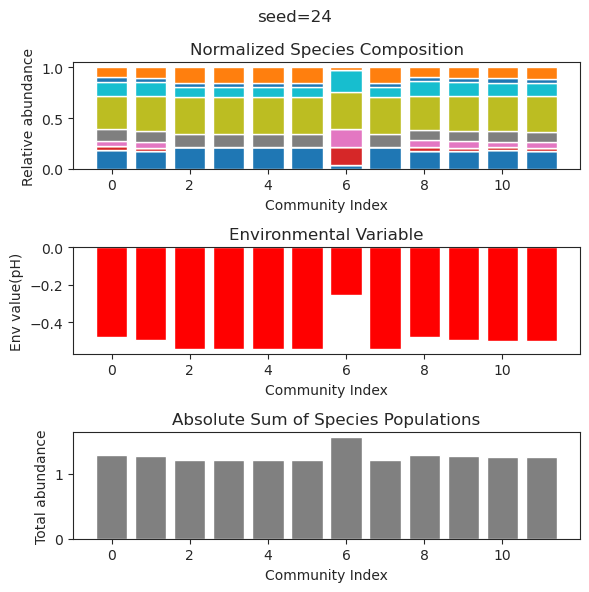

{'species': array([ 6.65704433e-001,  2.71574946e-102,  4.67972584e-020,
        1.70778649e-001,  2.35237829e-001,  4.07256354e-002,
        1.16706726e-100,  3.67130837e-001,  4.40650607e-002,
        1.00792036e-106, -1.04564583e-074, -3.21084323e-031]), 'env': array([-1.03570212])}
{'species': array([ 6.65704433e-001,  4.38856282e-108, -2.83284439e-018,
        1.70778649e-001,  2.35237829e-001,  4.07256354e-002,
        1.76473764e-107,  3.67130837e-001,  4.40650607e-002,
       -5.15539721e-112, -3.06947672e-079, -1.06025468e-030]), 'env': array([-1.03570212])}
{'species': array([ 6.65704433e-001, -1.31036794e-106, -3.20131133e-018,
        1.70778649e-001,  2.35237829e-001,  4.07256354e-002,
       -1.21705403e-103,  3.67130837e-001,  4.40650607e-002,
        3.16292083e-109,  1.76239893e-075, -1.80411766e-032]), 'env': array([-1.03570212])}
{'species': array([ 6.65704433e-001,  1.38731387e-105, -2.11435893e-021,
        1.70778649e-001,  2.35237829e-001,  4.07256354e-002,
     

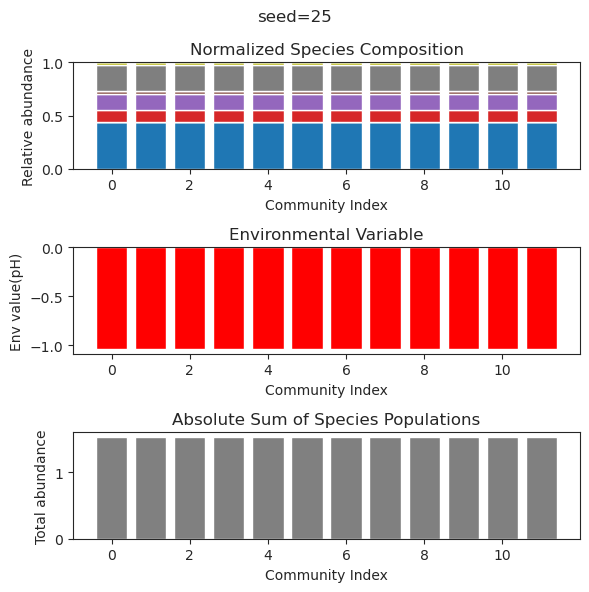

{'species': array([ 1.59184872e-27,  1.61815133e-24, -6.90148100e-40,  2.18002181e-29,
        1.93536709e-01, -1.07554369e-32,  1.33304262e-31, -6.12827708e-28,
       -6.19646203e-36,  1.59984896e-33,  4.05075675e-01,  5.93795628e-01]), 'env': array([-1.13926205])}
{'species': array([-3.08542919e-30,  2.08096351e-23,  2.20695172e-40,  2.45573991e-35,
        1.93536709e-01, -2.23438629e-36, -6.41840393e-30,  3.32944437e-34,
       -6.99868573e-35,  3.25451119e-40,  4.05075675e-01,  5.93795628e-01]), 'env': array([-1.13926205])}
{'species': array([ 1.84871226e-28, -3.29402739e-22,  9.44147612e-36, -7.12005267e-30,
        1.93536709e-01, -1.48281576e-34,  1.84654771e-27,  8.76388488e-26,
       -2.03246427e-33,  1.01023537e-30,  4.05075675e-01,  5.93795628e-01]), 'env': array([-1.13926205])}
{'species': array([ 2.17870677e-28, -3.83315934e-20, -7.10589482e-33,  2.05970674e-24,
        1.93536709e-01, -1.96241572e-32,  1.96833611e-27,  1.50768850e-23,
       -2.39948380e-33, -4.5598341

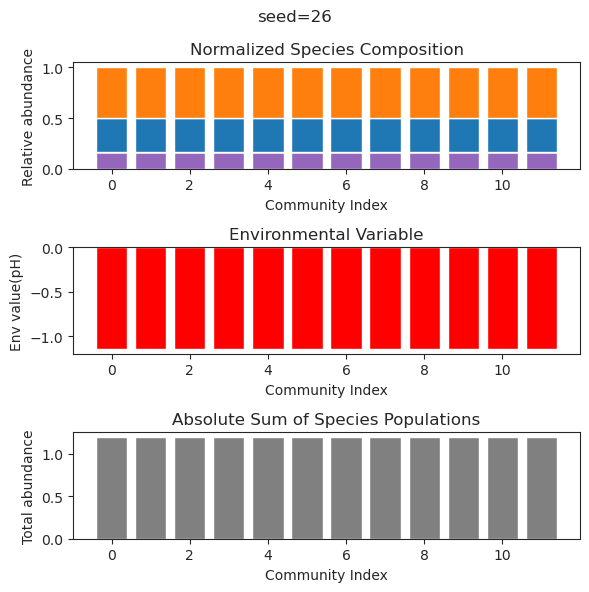

{'species': array([-2.19931476e-61,  4.73777556e-01,  1.17014549e-36, -7.23332613e-43,
        6.83090844e-53, -9.77038056e-54,  1.47997591e-45, -7.06107213e-76,
        1.15329006e-37,  2.68890096e+00,  3.30231652e+00,  8.40437095e-02]), 'env': array([4.45442511])}
{'species': array([ 1.63274115e-32,  4.73777556e-01,  2.02847131e-48,  1.65088503e-42,
       -1.95067066e-35,  1.99768322e-38,  1.54252628e-53, -8.06292536e-63,
       -5.04576768e-42,  2.68890096e+00,  3.30231652e+00,  8.40437095e-02]), 'env': array([4.45442511])}
{'species': array([ 1.60804787e-059,  4.73777556e-001, -4.13638719e-074,
        1.55131161e-042, -4.55183159e-037,  1.62695369e-123,
        6.02212099e-054,  1.51090372e-083,  5.71281244e-046,
        2.68890096e+000,  3.30231652e+000,  8.40437095e-002]), 'env': array([4.45442511])}
{'species': array([-2.73691655e-34,  4.73777556e-01,  2.29212176e-48,  1.01657059e-43,
        4.57989667e-34, -6.83433370e-45,  9.72287010e-50,  3.05482602e-60,
        3.42074463

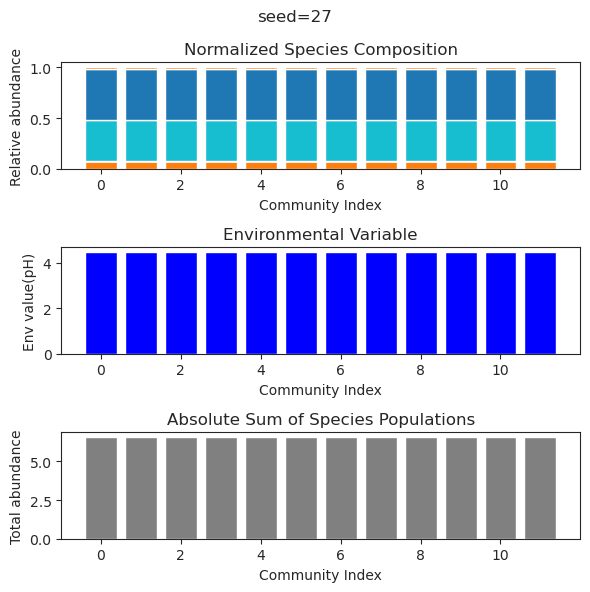

{'species': array([ 1.86348516e-01, -1.21684377e-22,  6.78092336e-01, -3.34516433e-38,
        3.30016810e-46, -3.57926192e-24, -8.61378278e-23, -1.43953741e-42,
        5.12976929e-01, -9.99016537e-45, -6.59615072e-44,  1.30265446e-35]), 'env': array([-1.69210899])}
{'species': array([ 1.86348516e-01, -8.11380964e-19,  6.78092336e-01,  1.74680448e-40,
        2.83990402e-44, -5.88692719e-23,  3.42404292e-22,  1.26123173e-41,
        5.12976929e-01,  1.92256966e-63, -4.56068549e-64,  6.18644814e-47]), 'env': array([-1.69210899])}
{'species': array([ 1.86348516e-01, -4.86549157e-24,  6.78092336e-01, -1.40675829e-44,
        2.26638549e-51,  4.65246850e-28, -1.66745131e-20, -4.94906415e-48,
        5.12976929e-01,  7.88209673e-51,  3.83755510e-50,  6.28925902e-41]), 'env': array([-1.69210899])}
{'species': array([ 1.86348516e-01,  4.59822946e-19,  6.78092336e-01, -1.30508727e-33,
        1.22029321e-37, -8.11241253e-27, -7.01935371e-18,  1.34366260e-40,
        5.12976929e-01, -3.5866844

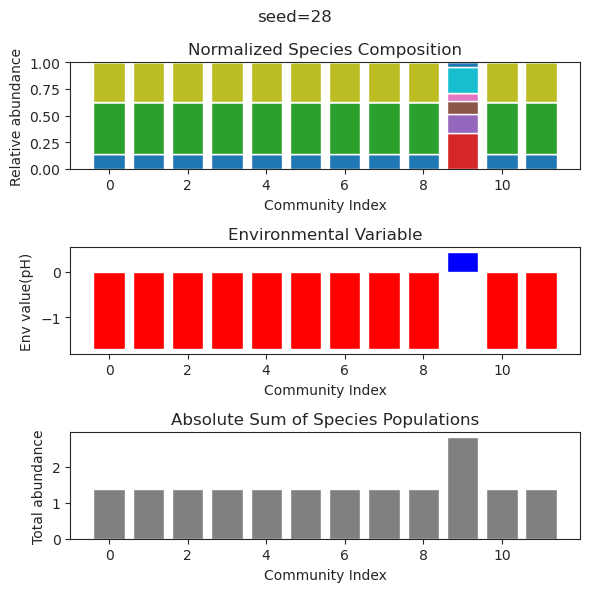

{'species': array([ 4.36324583e-01,  2.82996207e-37, -9.07465396e-81, -6.05632657e-97,
       -2.86094226e-93,  2.72567033e-02,  6.48601987e-01, -1.98291059e-61,
        1.02296148e-37, -4.40145419e-93,  1.30305290e-52,  3.08868765e-25]), 'env': array([-1.63944053])}
{'species': array([ 4.36324583e-01, -8.02440372e-44, -1.29907553e-90,  4.34430933e-86,
       -1.72068867e-95,  2.72567033e-02,  6.48601987e-01, -1.06564910e-63,
       -7.74668415e-42,  1.70234240e-92, -5.54179081e-78, -3.86390440e-71]), 'env': array([-1.63944053])}
{'species': array([ 4.36324583e-01, -9.87628078e-37,  1.19101883e-74, -3.50346729e-84,
       -4.06550254e-88,  2.72567033e-02,  6.48601987e-01, -5.47806424e-60,
       -1.30949979e-34, -1.05444282e-82,  2.45518975e-50, -5.59219824e-28]), 'env': array([-1.63944053])}
{'species': array([ 4.36324583e-01,  3.18635576e-39,  6.25389221e-74, -2.35475772e-76,
        5.89265872e-86,  2.72567033e-02,  6.48601987e-01,  1.34579724e-57,
        4.49326103e-38, -3.5418263

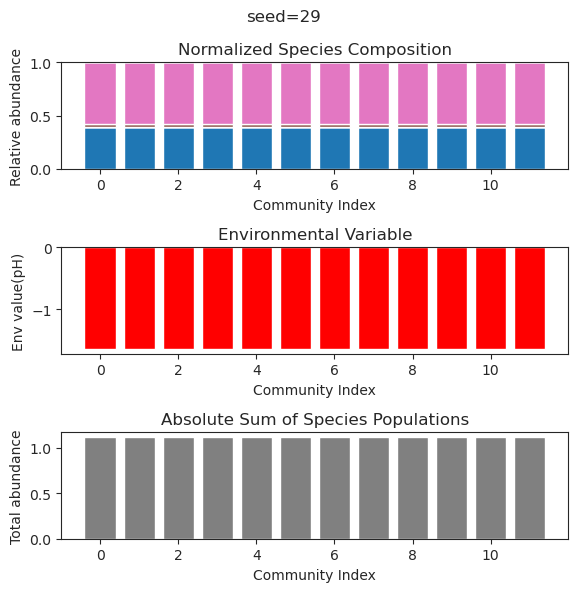

{'species': array([ 2.10166000e-01,  6.37629184e-02,  5.79066873e-03,  4.86732533e-01,
       -1.01200887e-38, -5.16148513e-28, -1.33431162e-28,  2.06017038e-01,
        6.00648097e-01,  2.92429431e-36, -2.43985443e-25, -4.31550585e-49]), 'env': array([-0.40513365])}
{'species': array([ 2.10165922e-01,  6.37621979e-02,  5.79339713e-03,  4.86732573e-01,
        1.45633519e-31, -1.54505767e-32, -2.35271961e-57,  2.06018890e-01,
        6.00647151e-01, -5.09466828e-34,  2.89998834e-28, -1.40962531e-54]), 'env': array([-0.40513172])}
{'species': array([ 2.10165979e-01,  6.37627250e-02,  5.79140136e-03,  4.86732544e-01,
       -8.39598111e-46, -2.50856306e-37, -1.47203857e-34,  2.06017535e-01,
        6.00647843e-01, -2.56413365e-47,  4.87072660e-29,  6.45501696e-39]), 'env': array([-0.40513313])}
{'species': array([ 2.10165959e-01,  6.37625383e-02,  5.79210834e-03,  4.86732554e-01,
       -9.23943650e-32, -2.21791220e-30, -3.12986114e-29,  2.06018015e-01,
        6.00647598e-01, -2.8162949

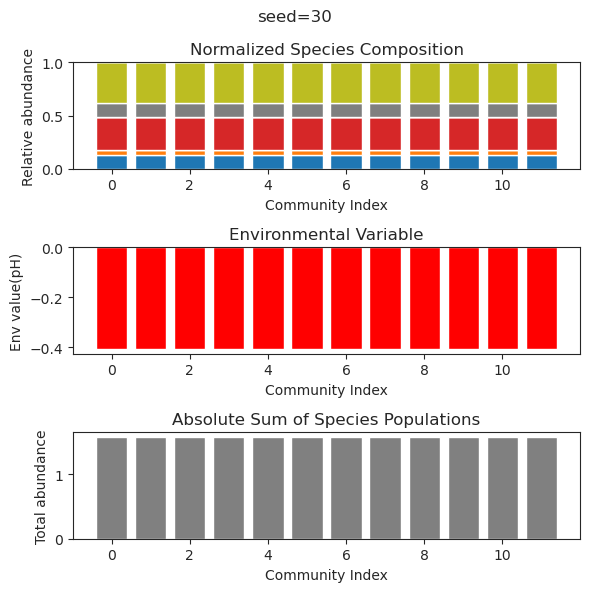

{'species': array([ 2.94570586e-001,  2.78453319e-001,  1.17047075e-100,
        2.15591893e-001,  6.49085513e-002,  3.26934234e-001,
        5.25043765e-056,  2.78484373e-001, -3.35210688e-113,
        1.34401070e-014,  1.34495967e-001,  8.81785956e-003]), 'env': array([-0.56772036])}
{'species': array([ 2.94790113e-01,  2.78588286e-01, -5.24291672e-28,  2.15326733e-01,
        6.48499049e-02,  3.27042844e-01,  9.27134652e-29,  2.78608330e-01,
        4.48709654e-45,  1.58526791e-18,  1.34377538e-01,  8.41156870e-03]), 'env': array([-0.56803313])}
{'species': array([2.94571808e-01, 2.78454072e-01, 4.53972098e-38, 2.15590414e-01,
       6.49082189e-02, 3.26934842e-01, 5.52941669e-64, 2.78485061e-01,
       5.57570008e-98, 2.69492458e-17, 1.34495303e-01, 8.81560395e-03]), 'env': array([-0.5677221])}
{'species': array([ 2.94571330e-01,  2.78453777e-01,  2.31637208e-31,  2.15590993e-01,
        6.49083490e-02,  3.26934604e-01, -5.07432036e-56,  2.78484792e-01,
        1.52341017e-31,  3.2

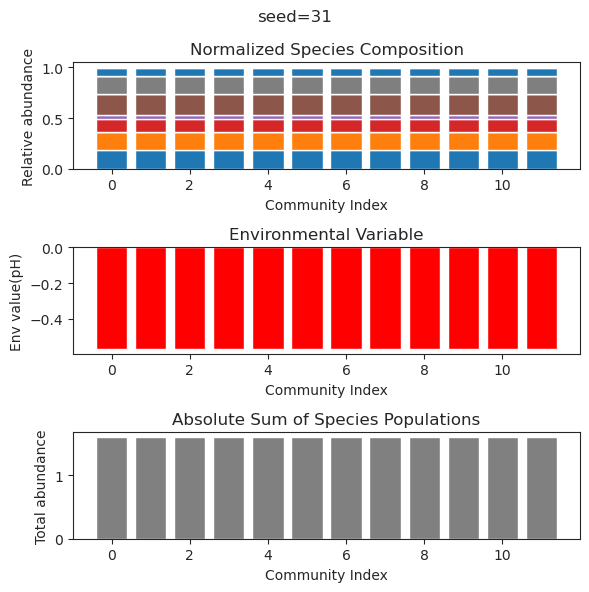

{'species': array([ 8.21558635e-25,  9.93941927e-50, -5.68460317e-22,  7.86971499e-55,
        5.82548203e-01,  5.66486242e-01,  1.32790745e-23,  6.46998868e-01,
       -3.22658482e-36, -2.67817095e-50, -2.42634948e-35,  8.78202365e-17]), 'env': array([-1.05302647])}
{'species': array([-2.31283932e-25,  4.30088142e-46,  4.02825159e-22,  5.01011944e-52,
        5.82548203e-01,  5.66486242e-01, -5.66475238e-23,  6.46998868e-01,
       -2.02919653e-35,  8.93659260e-48,  1.36227295e-35,  1.54022764e-16]), 'env': array([-1.05302647])}
{'species': array([-1.19423324e-22, -4.68163327e-44,  1.43789677e-20,  6.35774926e-46,
        5.82548203e-01,  5.66486242e-01, -5.80014856e-22,  6.46998868e-01,
       -2.88652980e-34, -1.33381973e-44,  1.34452914e-31,  8.32988499e-17]), 'env': array([-1.05302647])}
{'species': array([ 3.81392850e-24,  6.43002520e-42, -1.79636275e-22, -1.01812989e-48,
        5.82548203e-01,  5.66486242e-01,  7.04703425e-25,  6.46998868e-01,
        2.53480595e-31,  2.8853466

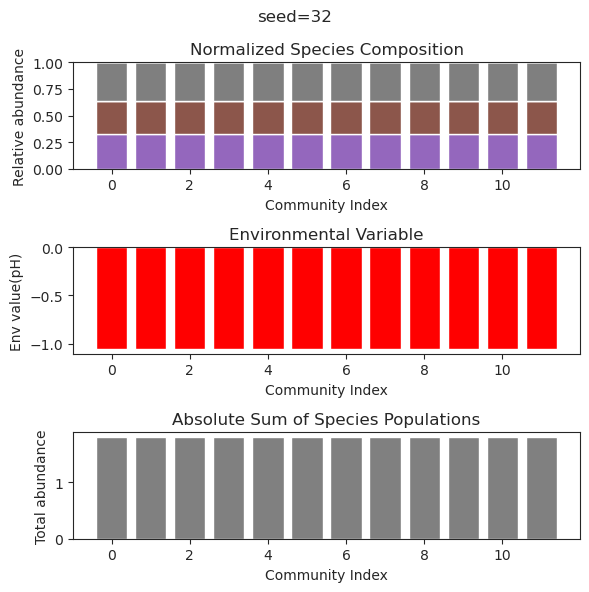

{'species': array([-7.74454092e-45,  4.11780972e-01,  4.05348909e-01,  7.66810656e-18,
        4.93540106e-19,  6.90163544e-27,  2.35704308e-34, -8.29717242e-35,
       -3.91216759e-26,  2.85134901e-01,  3.22925315e-32,  7.41314935e-49]), 'env': array([-2.07627595])}
{'species': array([-1.39567899e-46,  4.11780972e-01,  4.05348909e-01,  2.37084483e-18,
       -1.69482967e-18,  1.16331578e-24, -4.37616149e-33, -1.63373340e-33,
       -1.57622977e-24,  2.85134901e-01, -3.96096749e-32,  1.13764972e-50]), 'env': array([-2.07627595])}
{'species': array([-1.15361371e-44,  4.11780972e-01,  4.05348909e-01,  6.51832429e-18,
       -1.17910174e-19,  2.91986124e-26,  1.70900730e-32,  9.45914333e-33,
       -1.21369197e-24,  2.85134901e-01, -2.21240813e-31,  8.27757489e-48]), 'env': array([-2.07627595])}
{'species': array([ 9.24848400e-002, -1.22623541e-033,  2.06608259e-001,
        2.58797909e-001,  4.96482913e-001,  4.71579253e-001,
        1.29507845e-130,  0.00000000e+000,  1.19920477e-293,
 

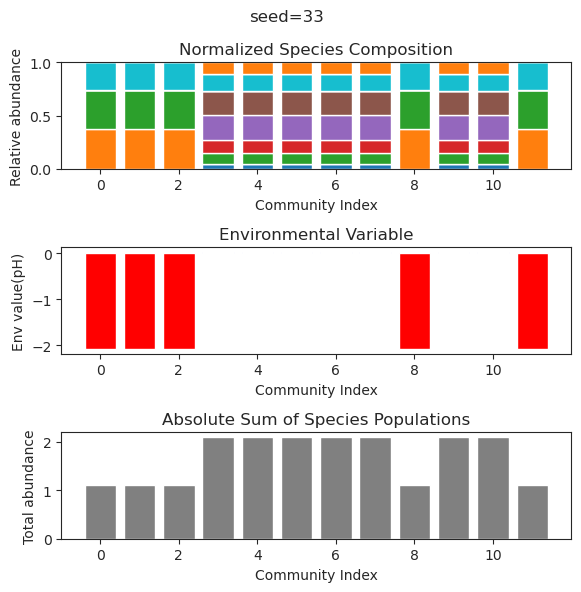

{'species': array([-1.75277854e-61,  4.93339525e-01,  2.26540262e-66,  3.07986165e-32,
        1.44463939e-29,  4.30246211e-02, -1.42756486e-71,  4.82288224e-01,
        4.04355005e-28,  3.59816306e-59,  4.16333661e-01,  1.82647652e-01]), 'env': array([-1.11428379])}
{'species': array([ 4.22646876e-61,  4.93339525e-01, -7.79253945e-88, -1.73823918e-33,
       -3.33562296e-29,  4.30246211e-02,  8.94483474e-63,  4.82288224e-01,
       -1.31061003e-37, -7.64460198e-62,  4.16333661e-01,  1.82647652e-01]), 'env': array([-1.11428379])}
{'species': array([-6.56536813e-083,  4.93339525e-001,  7.47949042e-102,
       -4.51227071e-035, -1.28102285e-031,  4.30246211e-002,
       -8.79976730e-091,  4.82288224e-001,  2.43524641e-027,
       -6.33202151e-076,  4.16333661e-001,  1.82647652e-001]), 'env': array([-1.11428379])}
{'species': array([ 1.92747268e-77,  4.93339525e-01, -2.57961675e-87, -9.59723322e-32,
       -3.06702982e-29,  4.30246211e-02,  3.67196928e-87,  4.82288224e-01,
        2.88366

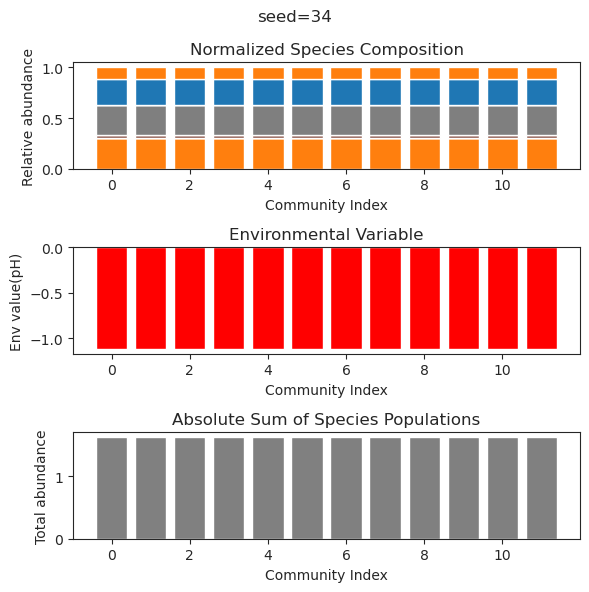

{'species': array([1.02297158e+00, 4.95814081e-37, 2.49926269e-01, 9.07920636e-98,
       1.71414735e-49, 4.20174423e-01, 2.27458074e-30, 1.78009343e-01,
       2.05272185e-01, 3.96640746e-07, 2.68145572e-78, 4.59257240e-01]), 'env': array([0.56439607])}
{'species': array([ 1.02295098e+000, -2.70319086e-031,  2.49946769e-001,
       -2.10395244e-031,  1.44090526e-056,  4.20160383e-001,
        6.67034839e-033,  1.78007592e-001,  2.05259645e-001,
        2.38955343e-005,  1.13517915e-170,  4.59241181e-001]), 'env': array([0.5643775])}
{'species': array([ 1.02297030e+000,  6.00211871e-036,  2.49927543e-001,
        3.80942024e-171, -3.14166589e-036,  4.20173550e-001,
       -3.30897286e-038,  1.78009234e-001,  2.05271405e-001,
        1.85784365e-006,  4.09428630e-028,  4.59256241e-001]), 'env': array([0.56439491])}
{'species': array([ 1.02297193e+000, -9.97460989e-050,  2.49925923e-001,
       -3.41767185e-091, -4.02664642e-044,  4.20174660e-001,
       -5.29397729e-017,  1.78009372e-00

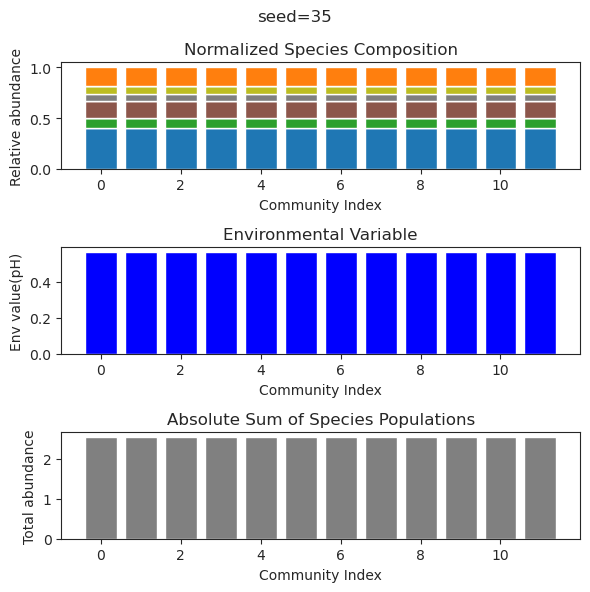

{'species': array([ 5.96433885e-36,  4.17138504e-41,  2.47357955e-03, -9.44713697e-36,
        5.86082047e-01,  3.99961167e-02,  7.08139412e-44,  6.58791068e-01,
       -4.09973872e-55,  3.98441658e-52, -4.32625855e-19, -6.72831440e-28]), 'env': array([-0.83759586])}
{'species': array([ 2.22445240e-33,  3.22081323e-35,  2.47360904e-03, -5.11600529e-31,
        5.86082023e-01,  3.99960954e-02, -1.65583872e-44,  6.58791076e-01,
        9.05527136e-66, -4.31400170e-63, -7.64514728e-15,  5.14716023e-27]), 'env': array([-0.83759589])}
{'species': array([ 2.26460151e-30, -2.90682599e-34,  2.47342835e-03, -7.20362728e-30,
        5.86082170e-01,  3.99962261e-02,  2.26551090e-38,  6.58791031e-01,
        1.45501316e-59,  1.11730653e-55,  7.24909873e-15,  6.34994871e-27]), 'env': array([-0.8375957])}
{'species': array([ 1.51278516e-31,  1.65463550e-38,  2.47340068e-03, -3.98450369e-34,
        5.86082192e-01,  3.99962461e-02,  5.69919332e-41,  6.58791025e-01,
        5.52570785e-64, -1.50506183

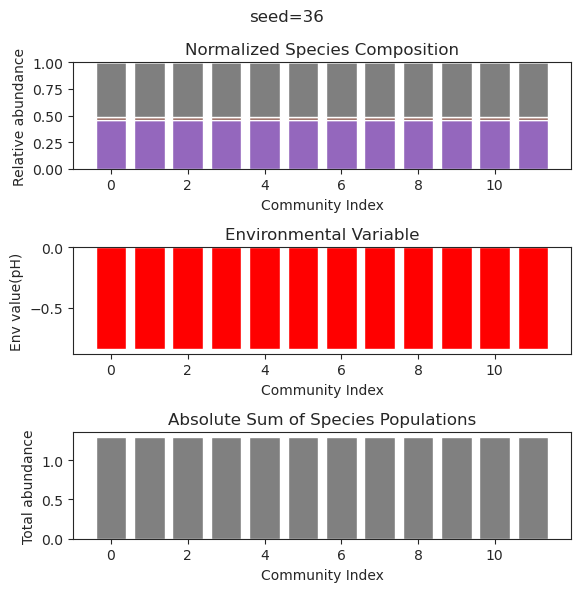

{'species': array([ 6.61038776e-47,  3.49474846e-01, -5.39090799e-18,  2.79825298e-01,
        3.55890178e-01, -1.69909829e-66,  1.90888005e-36,  1.36658183e-01,
       -1.13612592e-21,  3.05880226e-01,  2.57272588e-01,  2.59307491e-01]), 'env': array([-0.13893002])}
{'species': array([-5.39162972e-40,  3.49474846e-01,  1.46712721e-18,  2.79825298e-01,
        3.55890178e-01,  5.32566857e-56,  1.38953279e-31,  1.36658183e-01,
        3.60279170e-21,  3.05880226e-01,  2.57272588e-01,  2.59307491e-01]), 'env': array([-0.13893002])}
{'species': array([-4.41732623e-53,  3.49474846e-01, -4.92660278e-20,  2.79825298e-01,
        3.55890178e-01, -3.19019227e-72,  3.22955119e-42,  1.36658183e-01,
       -6.70590653e-24,  3.05880226e-01,  2.57272588e-01,  2.59307491e-01]), 'env': array([-0.13893002])}
{'species': array([-6.26128420e-41,  3.49474846e-01, -2.74261844e-17,  2.79825298e-01,
        3.55890178e-01, -1.22366455e-59, -2.53556906e-32,  1.36658183e-01,
       -1.43189982e-19,  3.0588022

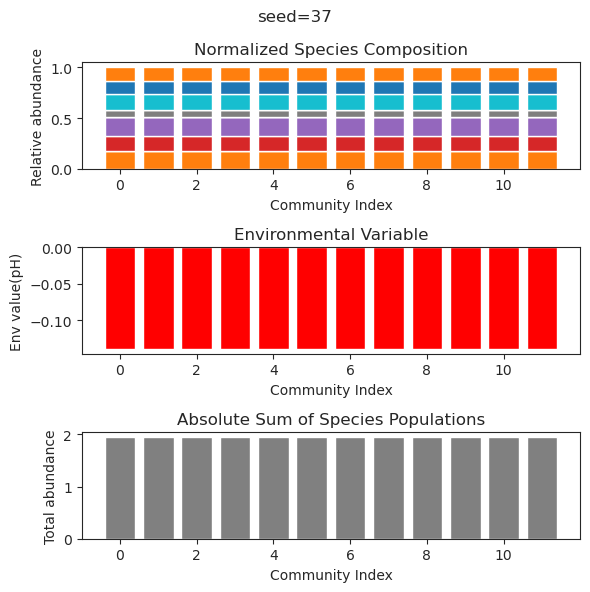

{'species': array([ 6.72437005e-02, -1.63644152e-62, -5.36803929e-22,  3.55213433e-01,
        3.25525957e-01,  7.91424165e-69,  1.45053598e-01,  4.67975464e-70,
        2.73575667e-01,  3.81016882e-01, -4.35901661e-58,  6.11525717e-20]), 'env': array([-0.525798])}
{'species': array([ 6.72437005e-02, -1.50101301e-42,  7.72666897e-27,  3.55213433e-01,
        3.25525957e-01,  7.33040747e-43,  1.45053598e-01,  4.97324011e-49,
        2.73575667e-01,  3.81016882e-01,  1.45296874e-44,  4.26998284e-21]), 'env': array([-0.525798])}
{'species': array([ 6.72437005e-02,  1.52185680e-54,  2.64514164e-22,  3.55213433e-01,
        3.25525957e-01,  5.72663935e-61,  1.45053598e-01,  1.38095490e-68,
        2.73575667e-01,  3.81016882e-01, -1.10919351e-54,  2.93228032e-20]), 'env': array([-0.525798])}
{'species': array([ 6.72437005e-02,  3.49310528e-72, -3.02154954e-25,  3.55213433e-01,
        3.25525957e-01,  3.08017396e-78,  1.45053598e-01,  6.02877234e-83,
        2.73575667e-01,  3.81016882e-01,

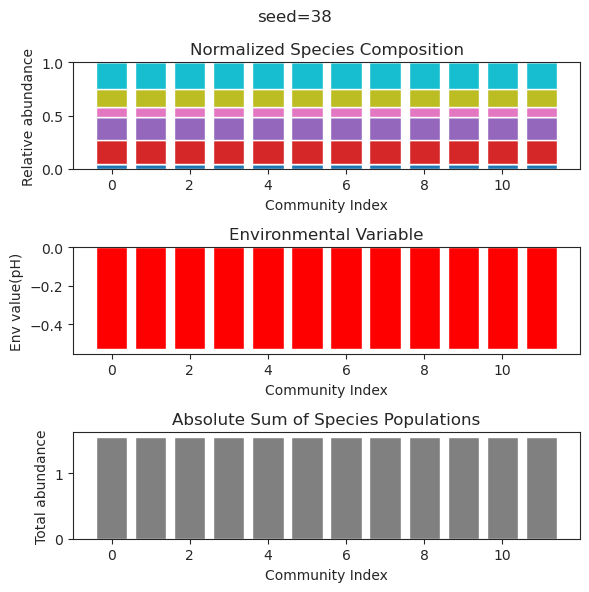

{'species': array([ 4.83119871e-47, -3.52255019e-28,  1.02331209e-31,  8.30994831e-30,
        3.86472998e-01,  3.68754567e-45, -1.58055359e-34,  1.63600437e-17,
        1.07474449e-01,  1.93147169e-01,  4.56101342e-01, -5.90058872e-42]), 'env': array([-1.01797638])}
{'species': array([-6.33858953e-52,  1.02468747e-24, -3.15631266e-25,  3.92834857e-29,
        3.86472998e-01, -3.35554031e-51,  4.99891394e-25, -6.59602075e-17,
        1.07474449e-01,  1.93147169e-01,  4.56101342e-01, -1.94799010e-48]), 'env': array([-1.01797638])}
{'species': array([ 1.48479043e-37,  4.08310505e-43,  2.81965432e-01,  6.08753780e-01,
        1.78732325e-70,  3.83006437e-01,  2.03242953e-30,  9.27532771e-61,
        6.43329616e-02, -1.43093007e-66, -5.04984306e-60,  4.90343418e-01]), 'env': array([-0.26116182])}
{'species': array([9.69980015e-31, 2.72743629e-34, 2.81965432e-01, 6.08753780e-01,
       1.83542677e-57, 3.83006437e-01, 1.09197274e-27, 1.04317973e-51,
       6.43329616e-02, 3.25056724e-54, 9.9

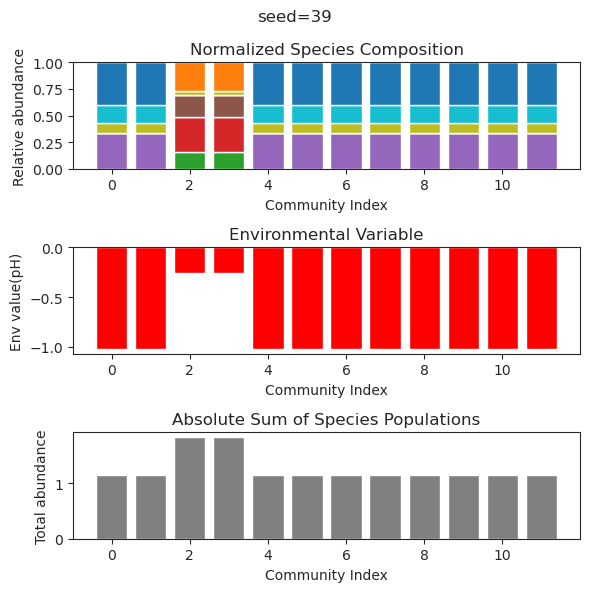

{'species': array([-7.37381490e-35, -2.66017630e-29,  3.16255681e-01,  3.86895116e-01,
        9.66102318e-30,  1.88811249e-34,  1.41665513e-37,  3.05130481e-26,
        5.38485476e-01,  3.36898333e-10,  2.49795285e-01, -2.32108405e-39]), 'env': array([-0.83745907])}
{'species': array([ 2.71851589e-38,  2.59399089e-34,  3.16255680e-01,  3.86895116e-01,
       -2.04054432e-47,  9.12051304e-41, -1.41914772e-57, -5.53263231e-36,
        5.38485475e-01,  2.11374669e-09,  2.49795285e-01, -7.92888150e-72]), 'env': array([-0.83745907])}
{'species': array([ 2.41620253e-38, -7.82798157e-33,  3.16255680e-01,  3.86895116e-01,
        2.34724559e-42, -2.58368595e-41,  1.30682751e-54, -2.23396901e-33,
        5.38485475e-01,  1.47133971e-09,  2.49795285e-01,  2.97151688e-59]), 'env': array([-0.83745907])}
{'species': array([-2.00593662e-53,  8.06721051e-63,  3.16255680e-01,  3.86895116e-01,
        3.09744916e-43, -3.53229785e-51, -3.00245936e-51,  9.41623190e-34,
        5.38485475e-01,  1.8320083

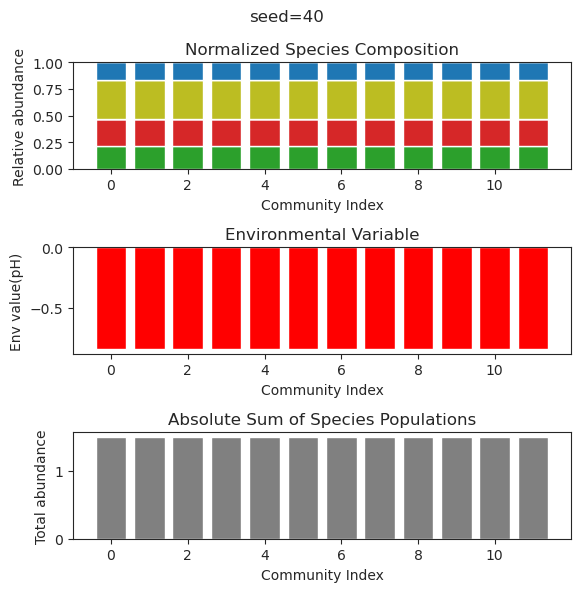

{'species': array([-5.84387649e-29, -5.67705646e-27,  6.38842041e-01, -2.13333055e-23,
        1.03917965e-17,  2.30772483e-25,  2.85790630e-01,  3.78651606e-34,
        7.64389855e-01, -2.45220820e-31, -1.36135964e-27, -4.48808897e-23]), 'env': array([-1.03029623])}
{'species': array([ 1.16980356e-34,  1.76144298e-31,  6.38842041e-01, -1.21707645e-31,
        9.44817110e-20, -2.91296287e-28,  2.85790630e-01,  9.26165309e-39,
        7.64389855e-01,  1.17921370e-34,  7.36153797e-32, -1.94163928e-27]), 'env': array([-1.03029623])}
{'species': array([-2.00675345e-34,  1.63643648e-30,  6.38842041e-01, -6.77311401e-24,
        9.47169467e-19, -1.75488806e-24,  2.85790630e-01, -2.08656055e-37,
        7.64389855e-01,  7.80801121e-35,  1.75485456e-29, -8.34173018e-23]), 'env': array([-1.03029623])}
{'species': array([ 1.33214181e-27, -1.14650141e-25,  6.38842041e-01,  8.75151682e-25,
       -1.11129051e-17,  5.30043819e-24,  2.85790630e-01, -5.55136513e-32,
        7.64389855e-01,  6.4222174

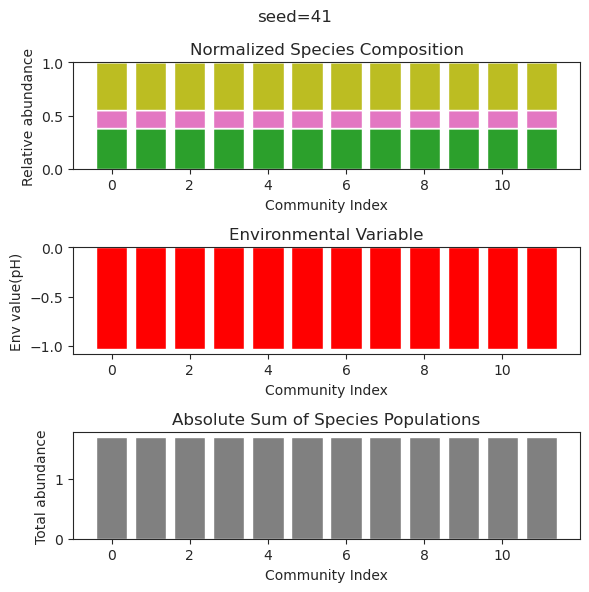

{'species': array([ 2.03085195e-01, -3.40467278e-48,  3.68221319e-37,  5.17149557e-01,
       -2.74227363e-38,  3.35419762e-01, -1.87284749e-43,  6.34737293e-02,
        1.13166291e-38,  1.08714068e-38,  2.86880243e-43,  3.39313394e-01]), 'env': array([-1.24861262])}
{'species': array([ 2.03086116e-01,  2.15644614e-70, -6.61117107e-47,  5.17154453e-01,
       -6.39714622e-60,  3.35425125e-01,  1.82569734e-80,  6.34620231e-02,
       -1.41466608e-61,  1.71949017e-29, -1.13774940e-27,  3.39318881e-01]), 'env': array([-1.24861717])}
{'species': array([-1.11953902e-80,  3.68074394e-01, -5.24629283e-89,  3.57673244e-01,
        2.56995722e-43,  2.28149854e-01,  1.16440144e-35,  1.87932450e-01,
        5.85236453e-13,  2.42144983e-01, -3.89313073e-70,  2.98228174e-01]), 'env': array([-0.42111697])}
{'species': array([ 2.03085195e-01,  9.07296722e-33, -1.03372579e-72,  5.17149558e-01,
       -2.53641108e-64,  3.35419764e-01,  3.56967268e-76,  6.34737265e-02,
       -1.02686567e-30,  2.3319093

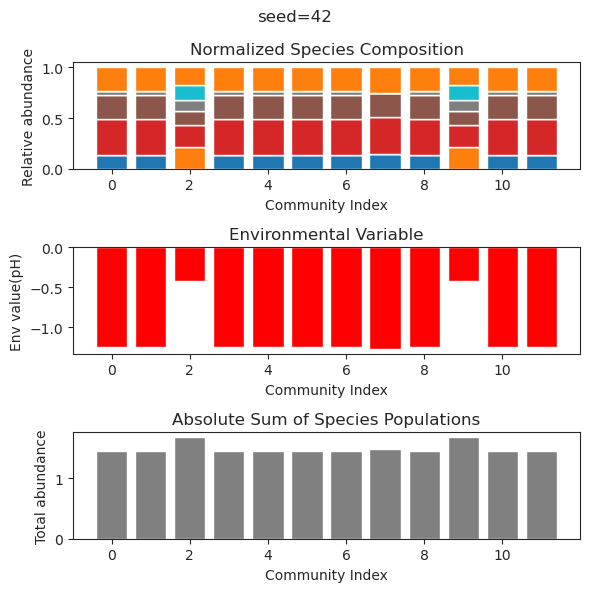

{'species': array([ 1.34932321e-35, -2.10693768e-23,  5.62981772e-35,  2.53067476e-26,
        2.23404049e-40,  9.87906598e-38,  1.24998960e-17,  8.99713501e-01,
       -1.76478047e-22, -1.15388039e-53, -6.07107154e-52, -3.46953739e-52]), 'env': array([-2.24125467])}
{'species': array([ 2.58902887e-150, -7.83526011e-026, -5.33233256e-046,
        1.95004605e-039,  7.01084821e-115, -7.27450724e-156,
       -6.18030305e-018,  8.99713501e-001,  1.25705988e-023,
       -1.05420558e-149,  1.01414727e-165, -4.09336189e-152]), 'env': array([-2.24125467])}
{'species': array([-1.39902928e-34, -2.80161378e-25,  2.15243660e-35, -9.07632223e-27,
        4.09195104e-40, -9.43194119e-38, -5.96682067e-19,  8.99713501e-01,
       -2.64833951e-25, -5.08002066e-50,  4.08690235e-49,  3.94167883e-49]), 'env': array([-2.24125467])}
{'species': array([-1.72944074e-53, -8.35543265e-24, -1.55428844e-36, -1.26987347e-29,
        1.86185643e-64,  1.02979737e-59,  5.66656497e-17,  8.99713501e-01,
       -1.84591

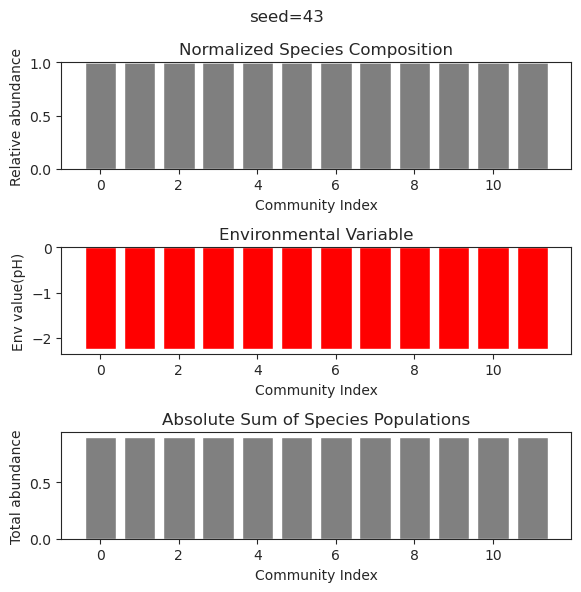

{'species': array([-2.76051039e-016,  1.49386715e-001,  3.52423637e-001,
       -2.53498890e-103,  3.14125965e-001,  6.26007820e-099,
        1.79627212e-096,  7.48094453e-001,  2.51642807e-001,
       -2.34648533e-039,  1.77135028e-001, -1.04982300e-090]), 'env': array([-0.14410967])}
{'species': array([-3.87387604e-016,  1.49386715e-001,  3.52423637e-001,
       -9.43949179e-121,  3.14125965e-001, -1.15594444e-118,
        1.29108547e-118,  7.48094453e-001,  2.51642807e-001,
        2.01037227e-040,  1.77135028e-001,  2.95568371e-111]), 'env': array([-0.14410967])}
{'species': array([-8.81573541e-16,  1.49386715e-01,  3.52423637e-01,  5.21545379e-71,
        3.14125965e-01, -1.39539654e-66, -1.09921322e-67,  7.48094453e-01,
        2.51642807e-01,  6.62344639e-34,  1.77135028e-01,  2.27508528e-62]), 'env': array([-0.14410967])}
{'species': array([ 2.85073932e-017,  1.49386715e-001,  3.52423637e-001,
       -1.08625063e-111,  3.14125965e-001, -1.97630164e-105,
        8.60893342e-107,

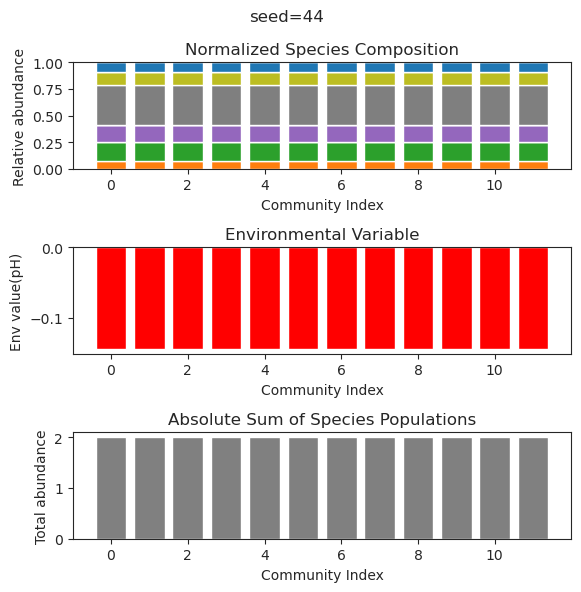

{'species': array([ 4.47442900e-01,  1.36032826e-32,  3.68706350e-01,  9.59116048e-02,
        4.59463362e-33,  2.47832666e-01, -7.42995461e-52, -2.76717590e-51,
        1.32467510e-01, -2.48425989e-40,  1.54210175e-13, -7.32725800e-32]), 'env': array([-0.69268227])}
{'species': array([ 4.47442900e-01,  9.09753973e-31,  3.68706350e-01,  9.59116048e-02,
        9.66821152e-38,  2.47832666e-01, -3.14079960e-53, -8.63263403e-53,
        1.32467510e-01, -2.14853915e-35,  3.55107582e-16,  1.64297682e-27]), 'env': array([-0.69268227])}
{'species': array([ 4.47442900e-01,  2.43542989e-55,  3.68706350e-01,  9.59116048e-02,
        3.05460797e-53,  2.47832666e-01,  4.43628639e-77, -9.58501352e-83,
        1.32467510e-01,  4.15865885e-75,  7.37326864e-15,  4.44608721e-50]), 'env': array([-0.69268227])}
{'species': array([ 4.47442900e-01,  1.60076100e-63,  3.68706350e-01,  9.59116048e-02,
        8.24132976e-62,  2.47832666e-01,  1.11868020e-80, -3.97784859e-89,
        1.32467510e-01, -1.4442596

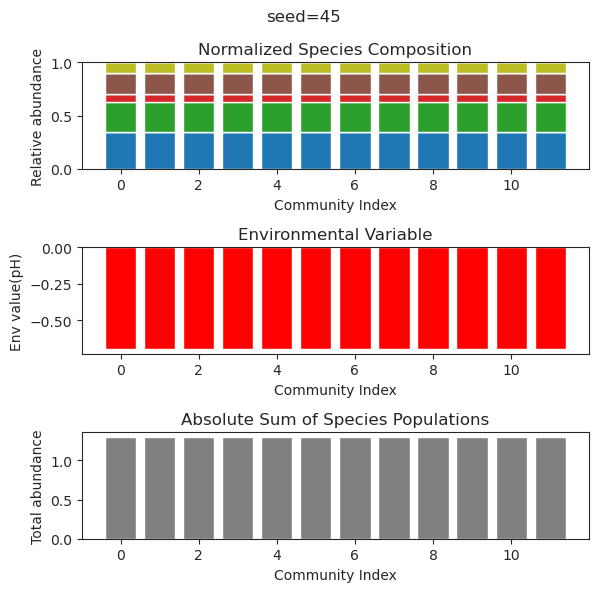

{'species': array([-2.09556645e-126, -3.49006284e-083, -1.37241647e-110,
        6.27136400e-001,  3.11044431e-001,  3.46391093e-001,
       -7.13405980e-024, -8.08796512e-059,  1.08035388e-103,
       -4.25274373e-061,  1.94199900e-002,  9.45910593e-002]), 'env': array([-1.29392379])}
{'species': array([ 7.26711389e-97, -6.90627389e-75, -8.45057902e-82,  6.27136400e-01,
        3.11044431e-01,  3.46391093e-01, -1.02956697e-33, -2.69435472e-56,
       -4.51511788e-89,  3.35955524e-56,  1.94199900e-02,  9.45910593e-02]), 'env': array([-1.29392379])}
{'species': array([ 2.24044726e-87,  4.37971747e-65,  6.93273807e-73,  6.27136400e-01,
        3.11044431e-01,  3.46391093e-01, -1.13142511e-25,  5.23401601e-49,
       -4.63732970e-78,  1.08190514e-48,  1.94199900e-02,  9.45910593e-02]), 'env': array([-1.29392379])}
{'species': array([ 6.93123926e-138,  3.53070203e-090, -1.78560642e-119,
        6.27136400e-001,  3.11044431e-001,  3.46391093e-001,
       -7.26207361e-029,  5.55952366e-062, 

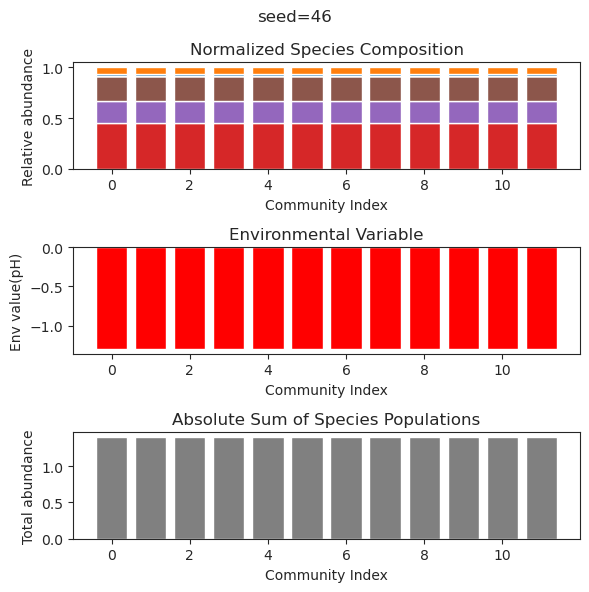

{'species': array([1.00404129e-001, 1.12915888e-006, 5.62823460e-311, 5.97271037e-001,
       1.87133983e-002, 1.21737859e-031, 1.54701444e-033, 4.20738052e-080,
       2.90439160e-004, 3.82718546e-001, 2.73369444e-001, 6.59843164e-003]), 'env': array([-0.67632921])}
{'species': array([ 6.37388781e-004,  2.65246414e-004, -1.47168732e-193,
        6.50544218e-001,  2.57321651e-002,  2.55763169e-047,
        3.75166141e-034,  5.55840828e-103,  5.69369675e-014,
        3.79413243e-001,  2.93377139e-001,  4.77484814e-003]), 'env': array([-0.73210708])}
{'species': array([3.92500394e-003, 1.64627682e-005, 1.42784972e-321, 6.58866574e-001,
       1.56062854e-002, 3.64948777e-031, 3.98222429e-035, 4.54064828e-080,
       1.42280657e-004, 3.78519995e-001, 2.92091118e-001, 9.12693749e-004]), 'env': array([-0.73692595])}
{'species': array([1.28365982e-001, 6.44074519e-007, 4.00632892e-319, 5.59843219e-001,
       2.00461870e-002, 3.68428926e-032, 2.42240024e-032, 2.41655951e-081,
       8.999416

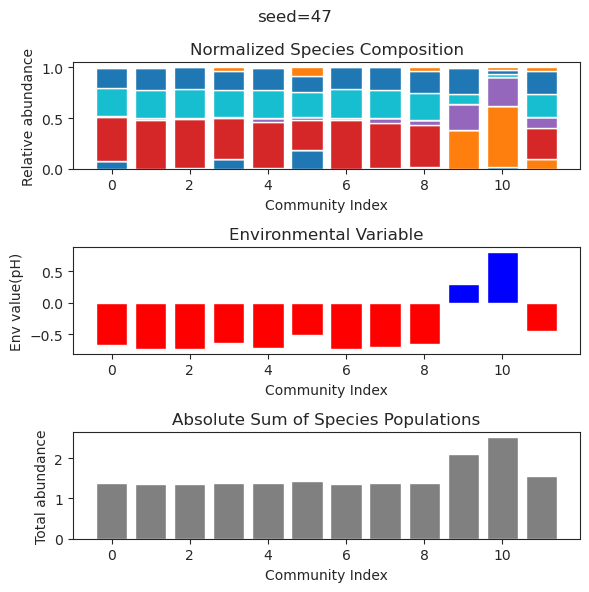

{'species': array([ 6.81169346e-034,  7.91349861e-001, -2.79695172e-023,
        1.69502818e-029,  1.50889618e-110,  1.15252291e-001,
        5.19260763e-111,  7.63588755e-136,  4.87499699e-135,
        3.94224137e-001,  3.27306983e-084, -1.47066282e-018]), 'env': array([-2.92553321])}
{'species': array([ 4.92994428e-45,  7.90299798e-01,  3.26523145e-20,  2.33933882e-19,
       -7.71267150e-41,  1.14697308e-01,  5.08979263e-40,  7.83103573e-42,
       -1.92202611e-44,  3.84966244e-01,  1.13985151e-29,  1.35262510e-02]), 'env': array([-2.89989484])}
{'species': array([ 4.10247259e-24,  7.90348380e-01,  7.12347473e-21,  8.32555996e-20,
       -8.36155232e-49,  1.14715161e-01, -3.92325699e-44, -4.21923990e-46,
        7.00452586e-48,  3.85386128e-01, -1.67585128e-38,  1.29190816e-02]), 'env': array([-2.90108089])}
{'species': array([ 4.10626965e-41,  7.90649455e-01,  6.31625220e-30, -1.31941165e-29,
       -9.06674492e-71,  1.14843098e-01, -2.28911051e-70, -7.91932105e-82,
       -1.03352

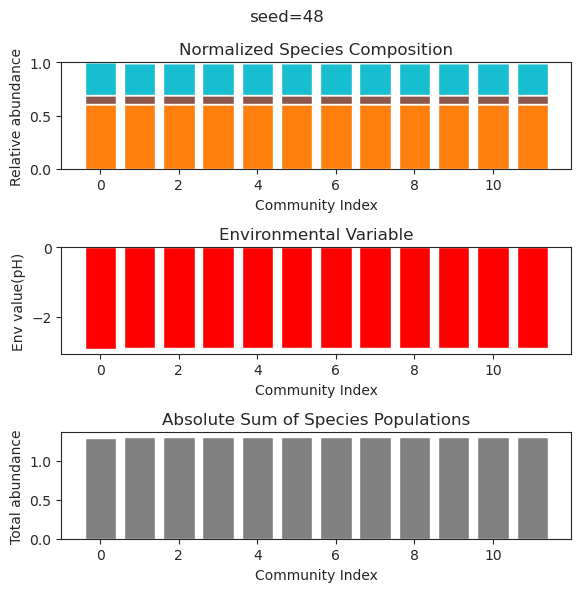

{'species': array([-1.76479385e-48,  1.33972365e-04,  2.71760029e-01,  2.58501223e-01,
       -4.28590183e-21, -7.56406254e-53, -3.36824369e-17,  6.64431117e-30,
        7.85480838e-01,  1.17557981e-43, -2.21606837e-48, -9.90685756e-58]), 'env': array([-0.63938777])}
{'species': array([-1.02055745e-26,  6.23120808e-04,  2.71440038e-01,  2.58173935e-01,
       -1.40619817e-26,  9.71657144e-32,  3.30984499e-30, -1.47359438e-34,
        7.85713037e-01, -4.68652202e-29,  5.83912315e-27, -4.07610850e-34]), 'env': array([-0.6394627])}
{'species': array([ 1.26906682e-27,  1.83145725e-04,  2.71727923e-01,  2.58468336e-01,
       -1.72822942e-19,  1.18067815e-50, -6.56371191e-15, -9.63568879e-41,
        7.85504144e-01,  7.18761083e-30, -6.13732468e-43,  6.85206548e-53]), 'env': array([-0.63939528])}
{'species': array([-6.55691818e-29,  7.03741004e-04,  2.71387164e-01,  2.58119962e-01,
        7.65781572e-32,  6.99725430e-51,  2.08220011e-32,  9.68937555e-48,
        7.85751386e-01,  1.66951473

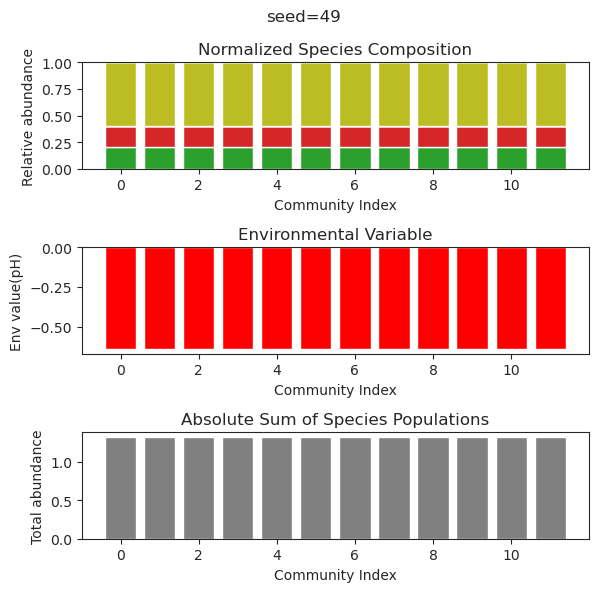

{'species': array([-2.53363325e-27,  4.89991403e-39,  1.06359391e-39,  3.69962385e-40,
       -1.18790018e-30, -7.16237388e-32,  9.24487448e-01,  4.18491934e-40,
        2.96550341e-01,  7.99137746e-39,  3.32085897e-23,  4.75611275e-01]), 'env': array([-0.90285842])}
{'species': array([-4.86625050e-26, -4.38506951e-36, -7.77193350e-35, -5.34715916e-36,
       -3.26595916e-27,  3.45636060e-27,  9.24487448e-01, -5.31594425e-37,
        2.96550341e-01, -1.40876021e-37,  7.53695974e-21,  4.75611275e-01]), 'env': array([-0.90285842])}
{'species': array([-3.09899572e-26,  8.06349783e-37,  1.55128696e-34,  2.35424554e-35,
       -9.01454286e-28,  1.41423956e-30,  9.24487448e-01,  3.02897110e-37,
        2.96550341e-01,  2.68812891e-37,  5.65486343e-22,  4.75611275e-01]), 'env': array([-0.90285842])}
{'species': array([-8.71897109e-26,  1.92477197e-37,  2.06008961e-35,  7.91406467e-36,
       -7.13853354e-27,  9.50402579e-30,  9.24487448e-01,  4.56211524e-38,
        2.96550341e-01,  5.8672354

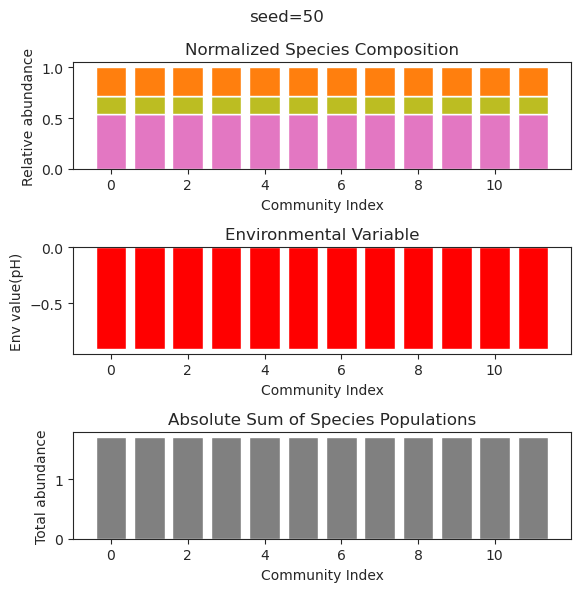

{'species': array([-1.14943436e-45,  4.71878244e-35,  5.58693695e-19, -3.57645361e-27,
        2.12627595e-01,  4.96332728e-01,  5.50409603e-01, -8.60954039e-22,
       -1.01542571e-42,  5.42721288e-30,  3.61234519e-01,  1.24499405e-44]), 'env': array([-0.73989881])}
{'species': array([-1.34387634e-59, -3.31970703e-53, -8.92767867e-24, -2.27996262e-38,
        2.12627595e-01,  4.96332728e-01,  5.50409603e-01,  3.19464595e-30,
       -4.70439187e-59, -1.83189370e-48,  3.61234519e-01, -6.36248290e-57]), 'env': array([-0.73989881])}
{'species': array([ 1.43651356e-67, -2.27864329e-56, -1.39339590e-24,  3.80939626e-39,
        2.12627595e-01,  4.96332728e-01,  5.50409603e-01,  6.93609548e-30,
       -1.58376740e-66,  1.25616746e-52,  3.61234519e-01, -1.27956601e-62]), 'env': array([-0.73989881])}
{'species': array([ 7.28026451e-45, -2.01039782e-37, -8.62698297e-19, -6.27588079e-27,
        2.12627595e-01,  4.96332728e-01,  5.50409603e-01,  1.85337290e-22,
       -1.81977981e-41,  1.7245840

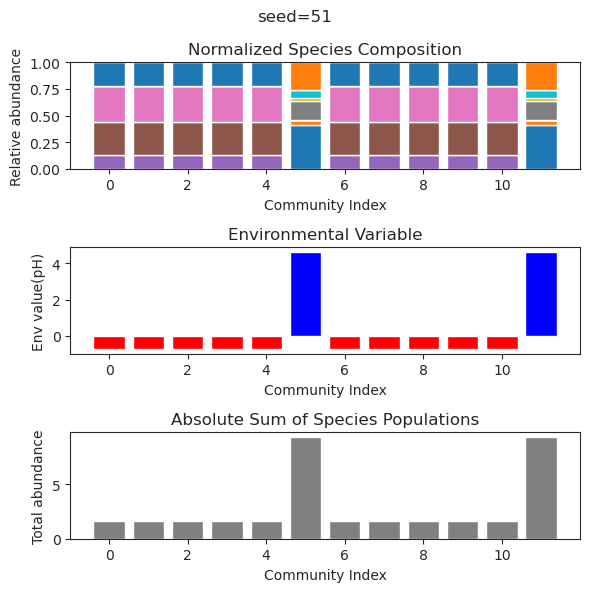

{'species': array([ 4.31866645e-002,  1.69948392e-001,  1.09511821e-176,
        5.86334918e-001,  1.65649933e-001,  1.14334891e-191,
        1.14902187e-001, -2.33339288e-047,  1.41051823e-001,
       -1.97280095e-067,  1.35115226e-001,  2.30086130e-001]), 'env': array([-0.41690395])}
{'species': array([ 4.31866645e-002,  1.69948392e-001, -1.46283697e-174,
        5.86334918e-001,  1.65649933e-001,  5.06586370e-182,
        1.14902187e-001,  4.95193980e-045,  1.41051823e-001,
       -6.11210785e-064,  1.35115226e-001,  2.30086130e-001]), 'env': array([-0.41690395])}
{'species': array([ 4.31866645e-002,  1.69948392e-001, -4.62052547e-183,
        5.86334918e-001,  1.65649933e-001, -4.98131317e-200,
        1.14902187e-001, -1.47164747e-049,  1.41051823e-001,
       -4.18369710e-067,  1.35115226e-001,  2.30086130e-001]), 'env': array([-0.41690395])}
{'species': array([ 4.31866645e-002,  1.69948392e-001,  4.10793613e-146,
        5.86334918e-001,  1.65649933e-001, -4.32162994e-153,
     

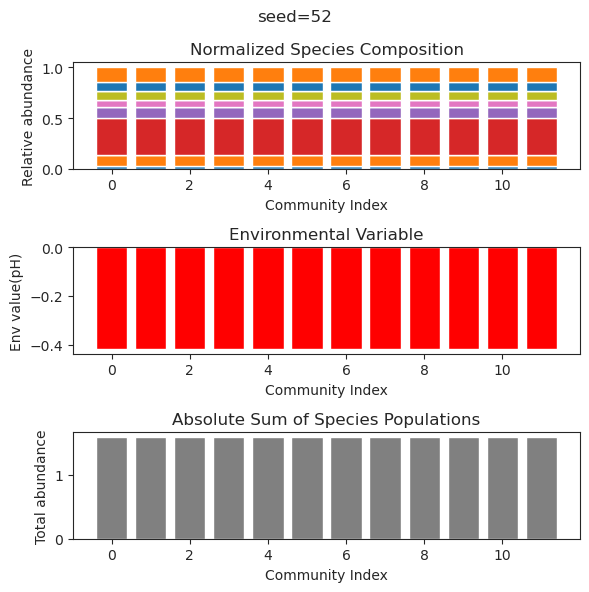

{'species': array([ 4.83141639e-32,  6.24933142e-01,  1.01154810e-32, -3.30970009e-55,
        7.61695022e-39,  6.06243422e-01, -3.79201351e-51, -2.52513223e-58,
       -6.49101624e-23,  1.79298483e-02,  2.59610505e-01, -7.84857501e-16]), 'env': array([-1.31959134])}
{'species': array([-8.03918640e-34,  6.24933172e-01,  3.91482912e-35,  6.33293831e-87,
       -1.41462300e-38,  6.06243482e-01,  8.90659069e-54, -3.70644702e-68,
       -2.94645222e-23,  1.79297742e-02,  2.59610503e-01, -8.24957349e-16]), 'env': array([-1.31959139])}
{'species': array([-3.95930749e-29,  6.24933535e-01,  1.16382185e-30, -1.28655361e-58,
        6.61666801e-36,  6.06244224e-01, -2.74922933e-46, -2.07414019e-43,
       -5.29949995e-22,  1.79288546e-02,  2.59610477e-01,  3.57813767e-21]), 'env': array([-1.31959191])}
{'species': array([ 1.29201623e-51,  6.24933176e-01, -1.02107037e-42, -1.09266619e-52,
        1.93526010e-40,  6.06243492e-01, -1.20600796e-46,  1.05557198e-46,
       -6.69857483e-18,  1.7929762

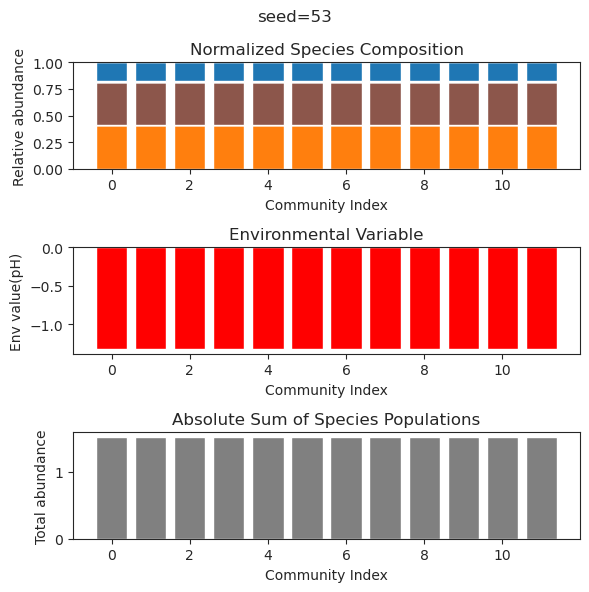

{'species': array([ 1.25863848e-23, -5.19271662e-40,  6.18410158e-46,  4.85348957e-01,
        4.05824109e-55,  2.21508532e-01,  4.31535716e-01,  3.80083237e-01,
       -2.43355261e-39, -1.18637738e-35,  1.57936998e-86, -8.11184339e-17]), 'env': array([-0.92213877])}
{'species': array([-3.55228825e-23,  1.50992017e-33,  1.46234243e-38,  4.85348957e-01,
        2.52491172e-43,  2.21508532e-01,  4.31535716e-01,  3.80083237e-01,
       -1.91642283e-35,  1.26292284e-33, -2.24490204e-60, -7.68056811e-17]), 'env': array([-0.92213877])}
{'species': array([-3.64558390e-21, -1.03488735e-36, -8.40239523e-34,  4.85348957e-01,
       -1.12484481e-45,  2.21508532e-01,  4.31535716e-01,  3.80083237e-01,
        2.96769014e-30, -2.67485381e-27,  1.28923725e-57,  1.42223836e-14]), 'env': array([-0.92213877])}
{'species': array([ 3.94784545e-20,  3.47091467e-33, -4.66933276e-33,  4.85348957e-01,
        3.04355730e-40,  2.21508532e-01,  4.31535716e-01,  3.80083237e-01,
       -2.09873380e-30, -8.9868078

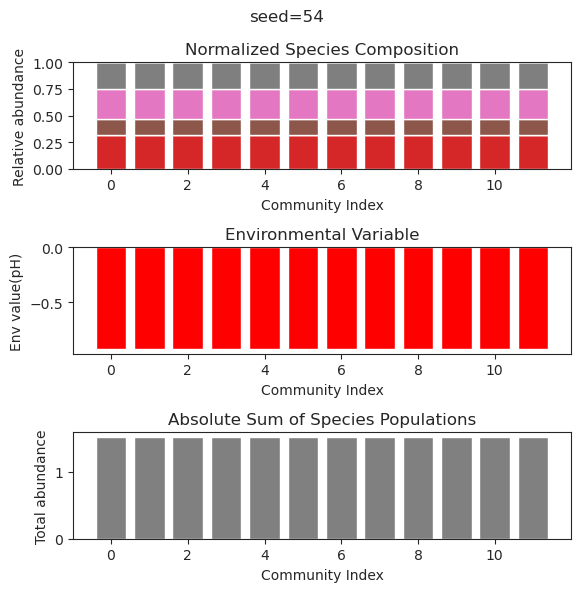

{'species': array([ 2.47295317e-01, -5.81521420e-81,  2.76420299e-01,  5.21806955e-30,
        1.83201379e-44, -5.67315164e-44,  4.19045729e-78,  5.61707880e-74,
        3.70619240e-02, -1.09094612e-43,  4.88451401e-01,  3.02489640e-01]), 'env': array([-1.5177415])}
{'species': array([ 2.47295317e-01, -7.26063906e-74,  2.76420299e-01,  1.49226379e-22,
        5.26698287e-42, -4.30177833e-36, -6.36636917e-64, -9.65587584e-69,
        3.70619240e-02,  3.07578496e-35,  4.88451401e-01,  3.02489640e-01]), 'env': array([-1.5177415])}
{'species': array([ 2.47295317e-01, -2.31644390e-68,  2.76420299e-01,  5.79395822e-22,
       -7.94269157e-39,  4.43926338e-35,  2.79853639e-64, -1.88035563e-62,
        3.70619240e-02,  2.20557696e-35,  4.88451401e-01,  3.02489640e-01]), 'env': array([-1.5177415])}
{'species': array([ 2.47295317e-01, -1.19525175e-51,  2.76420299e-01,  6.55714897e-22,
       -2.06663403e-31,  2.97312848e-31,  2.89669885e-45,  3.17479593e-47,
        3.70619240e-02,  6.13519003e-

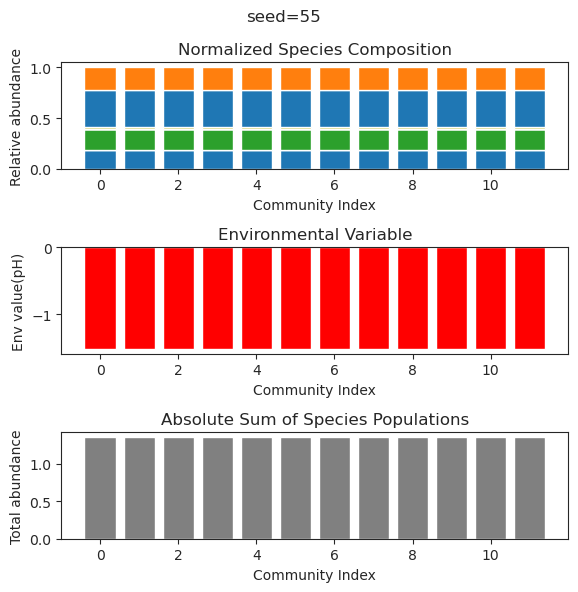

{'species': array([ 5.02452064e-01,  1.94521568e-61, -3.67922250e-29,  5.46521000e-17,
        7.02013531e-01,  9.12285713e-51,  3.71637675e-01, -1.67054817e-25,
        5.63037177e-18,  1.25635207e-01, -6.24104229e-37,  1.56454705e-37]), 'env': array([-0.44854651])}
{'species': array([5.02452064e-01, 5.82305624e-62, 3.94590087e-31, 4.80611328e-18,
       7.02013531e-01, 1.15765947e-48, 3.71637675e-01, 4.00238589e-27,
       9.23552223e-18, 1.25635207e-01, 3.01475902e-40, 2.98202196e-33]), 'env': array([-0.44854651])}
{'species': array([ 5.02452064e-01, -2.46901630e-63,  3.87294857e-29, -9.08102804e-20,
        7.02013531e-01, -7.84058324e-47,  3.71637675e-01,  2.82069767e-27,
        1.04403851e-20,  1.25635207e-01,  6.56240236e-37, -2.27119130e-34]), 'env': array([-0.44854651])}
{'species': array([ 5.02452064e-01, -7.21163858e-46, -1.40172093e-27, -7.69653234e-15,
        7.02013531e-01, -2.71886627e-40,  3.71637675e-01,  2.12472174e-23,
        2.10566662e-15,  1.25635207e-01, -2.12

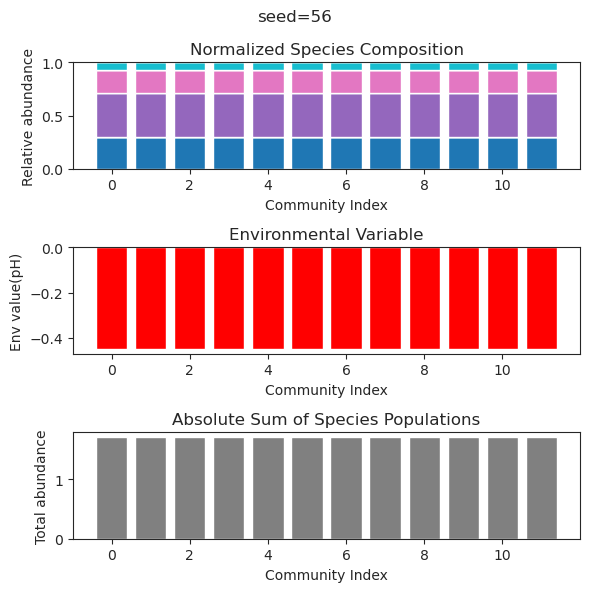

{'species': array([-5.96018027e-068,  2.90550346e-001,  4.86703886e-001,
        1.49207598e-001, -1.03915127e-054,  1.40727309e-028,
        5.17313197e-001,  1.44664447e-124,  1.83371713e-002,
        3.53192494e-145,  2.58059720e-009,  5.03359428e-001]), 'env': array([0.02248402])}
{'species': array([ 1.02818574e-49,  2.90550347e-01,  4.86703886e-01,  1.49207598e-01,
        1.80970843e-42,  1.15036804e-26,  5.17313197e-01, -4.37943183e-84,
        1.83371725e-02, -3.16374924e-35,  3.77451560e-10,  5.03359428e-01]), 'env': array([0.02248402])}
{'species': array([-2.32067869e-46,  2.90550339e-01,  4.86703883e-01,  1.49207597e-01,
       -5.45062678e-36, -1.14617442e-34,  5.17313199e-01,  3.48672130e-58,
        1.83371646e-02,  6.10928591e-31,  1.57575878e-08,  5.03359429e-01]), 'env': array([0.02248403])}
{'species': array([ 1.96128261e-14, -3.52492015e-17,  1.04829561e-01,  2.93996844e-01,
        9.39723681e-34, -1.47052923e-19,  2.85961972e-01, -4.44585754e-40,
        3.06197376

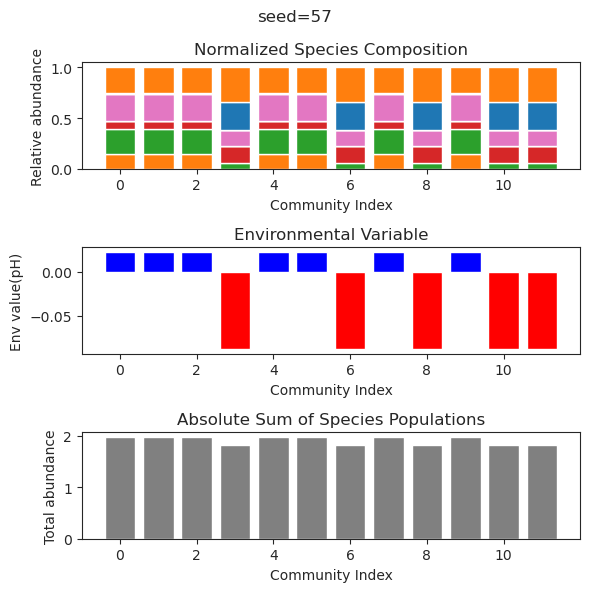

{'species': array([ 8.32771624e-02, -3.14879416e-44,  3.99378659e-01, -2.56782488e-65,
        5.52732184e-01,  1.98258083e-48,  2.68467600e-49,  1.09192954e+00,
        9.45002442e-01,  5.40421906e-82,  1.05937009e-70,  1.32410043e-02]), 'env': array([1.15812067])}
{'species': array([ 8.32771624e-02, -1.05482466e-47,  3.99378659e-01, -3.09977709e-49,
        5.52732184e-01,  9.51473597e-67,  7.07513463e-48,  1.09192954e+00,
        9.45002442e-01,  1.24550030e-99,  1.36728820e-88,  1.32410043e-02]), 'env': array([1.15812067])}
{'species': array([ 8.32771624e-02, -1.02515053e-49,  3.99378659e-01,  2.39323673e-50,
        5.52732184e-01,  9.49072311e-46, -5.04107201e-48,  1.09192954e+00,
        9.45002442e-01,  4.73154922e-41,  6.62136506e-54,  1.32410043e-02]), 'env': array([1.15812067])}
{'species': array([ 8.32771624e-02,  2.83405648e-43,  3.99378659e-01, -4.83690121e-47,
        5.52732184e-01,  1.79985122e-46,  7.70132281e-50,  1.09192954e+00,
        9.45002442e-01,  8.94259777e-

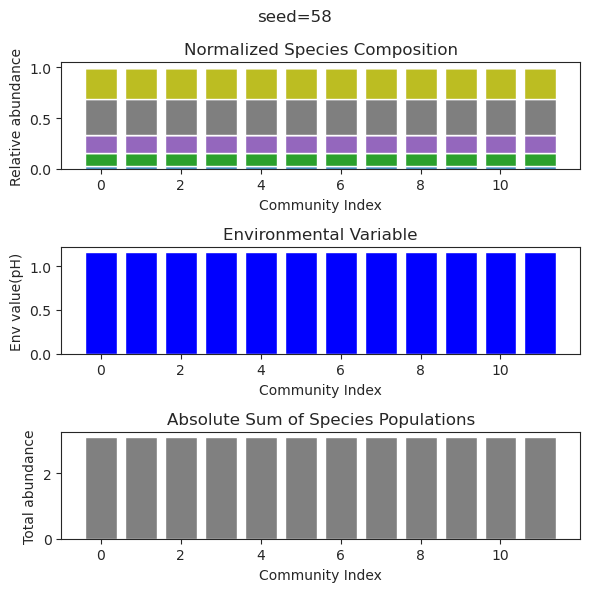

{'species': array([ 3.47646878e-01, -1.01423211e-24,  4.39462555e-19, -8.55913661e-23,
        7.75009549e-45,  1.67915409e-51,  6.23916083e-01, -4.50182320e-18,
        6.00270550e-01,  2.03198233e-36,  2.11697950e-54, -3.96055507e-53]), 'env': array([-0.61738804])}
{'species': array([ 6.27821375e-02,  3.86857305e-01,  1.13300020e-12,  4.06838988e-01,
        3.92515987e-01,  6.93869726e-34,  6.81650847e-25, -1.29716461e-75,
       -4.66341736e-49,  4.48541982e-01, -8.79865423e-20, -5.24858557e-67]), 'env': array([-0.55801907])}
{'species': array([ 6.27821375e-002,  3.86857305e-001,  3.83237699e-013,
        4.06838988e-001,  3.92515987e-001, -8.71584227e-038,
        1.49058148e-023,  1.71172226e-101, -9.09246029e-066,
        4.48541982e-001,  6.30702052e-022, -2.77750046e-101]), 'env': array([-0.55801907])}
{'species': array([ 6.27821375e-02,  3.86857305e-01,  8.91710471e-13,  4.06838988e-01,
        3.92515987e-01, -1.00641638e-33,  7.31764618e-26, -3.54788489e-69,
        1.23162

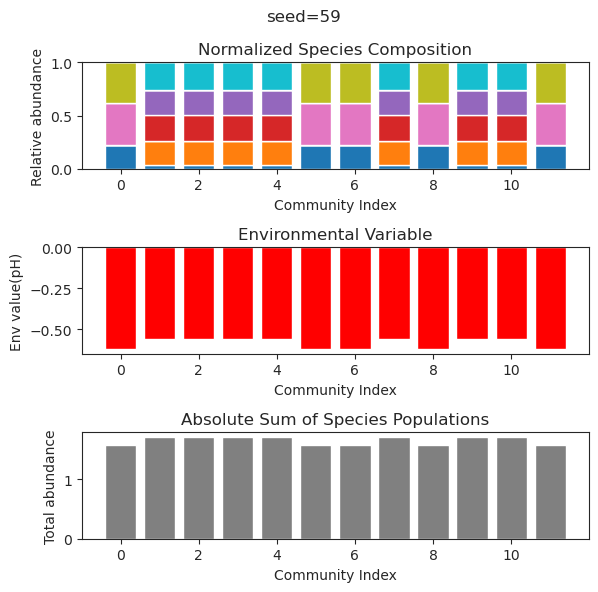

{'species': array([-4.68100311e-36,  2.44161115e-35, -1.25597069e-39,  6.89616569e-01,
       -3.83722712e-21,  1.19104920e-25, -1.08277160e-24,  1.53865491e-29,
       -1.41037217e-23, -2.59175365e-20, -2.17195845e-21,  2.55943207e-01]), 'env': array([-2.11150955])}
{'species': array([ 1.11103975e-39,  2.68914772e-35,  5.61072055e-42,  6.89616569e-01,
        1.89780343e-23,  2.55064298e-29, -3.11311805e-30, -4.84942027e-33,
       -9.49190674e-27, -1.29173226e-23, -6.41022681e-22,  2.55943207e-01]), 'env': array([-2.11150955])}
{'species': array([-1.02004616e-35, -2.59543894e-33, -3.57933094e-38,  6.89616569e-01,
       -1.68897596e-21,  2.73797998e-26, -1.18568629e-24, -4.81744751e-30,
       -6.91193877e-24, -6.61184251e-21, -7.71008479e-22,  2.55943207e-01]), 'env': array([-2.11150955])}
{'species': array([ 5.65260080e-43, -7.75698675e-39,  1.13420970e-44,  6.89616569e-01,
        4.00791017e-26,  8.59030111e-31, -3.77329451e-27,  7.82172504e-33,
       -3.12269150e-27,  1.1837610

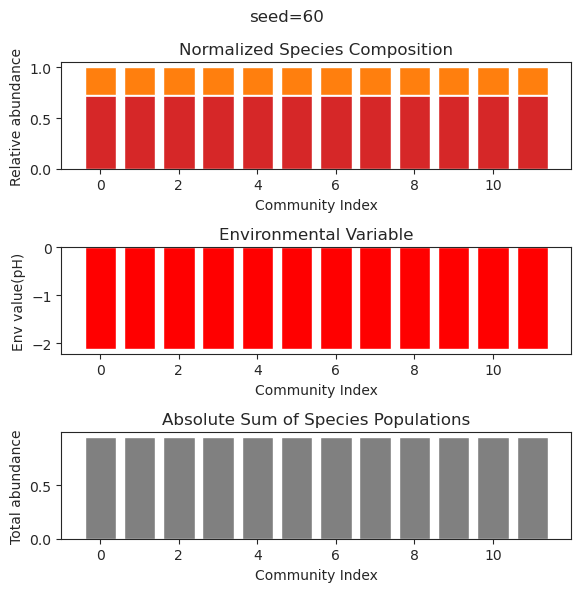

{'species': array([-2.95703132e-50,  8.04279173e-01, -7.09095503e-29, -7.55050469e-30,
        1.32282485e-41, -8.31352354e-36, -2.27358199e-51, -1.43423684e-53,
        1.09396921e-33,  3.69229268e-01,  9.99273117e-43,  8.41067022e-44]), 'env': array([-2.24373054])}
{'species': array([ 7.27088759e-46,  8.04279173e-01, -4.54206435e-26, -5.92944059e-26,
       -5.09257171e-39, -4.44475063e-34,  1.75231089e-46, -1.63358538e-44,
        7.91135238e-31,  3.69229268e-01, -1.97773750e-38, -4.98588208e-39]), 'env': array([-2.24373054])}
{'species': array([-2.62231351e-48,  8.04279173e-01,  2.19411732e-29,  1.45052567e-30,
        1.86758649e-39,  1.37165778e-35,  2.30552843e-48,  1.56300347e-46,
        9.11406214e-35,  3.69229268e-01, -2.93239596e-39, -1.14349663e-41]), 'env': array([-2.24373054])}
{'species': array([3.30129683e-34, 8.04279173e-01, 4.53370424e-23, 2.35671087e-24,
       2.51709402e-31, 1.91466179e-23, 6.66419450e-38, 2.50818436e-35,
       3.25074418e-25, 3.69229268e-01, 1.2

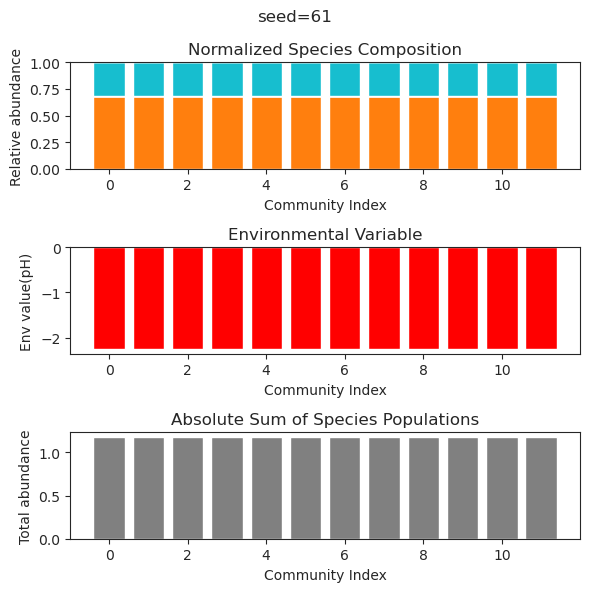

{'species': array([ 6.22593515e-01,  1.85106087e-29, -1.12120402e-63,  4.05972273e-01,
        3.50890388e-02,  1.24014078e-38, -6.40180933e-33,  1.74729133e-57,
       -3.25950493e-66,  1.76824051e-01,  3.72617369e-45,  4.39366986e-01]), 'env': array([-0.8107003])}
{'species': array([-4.33611045e-69, -8.10382844e-81,  3.77425423e+00,  3.48488055e-51,
        3.72033816e-64,  6.19751168e+00, -9.54745899e-48,  5.46677926e-77,
        2.72834992e-36, -4.81162433e-76,  3.31193933e+00, -1.25493658e-68]), 'env': array([7.90858418])}
{'species': array([-5.56372299e-71,  6.43899423e-77,  3.77425423e+00,  1.80099422e-52,
        1.18898971e-60,  6.19751168e+00, -1.54168728e-46,  3.81133619e-78,
       -1.85240295e-36,  2.18564124e-73,  3.31193933e+00,  3.61849156e-67]), 'env': array([7.90858418])}
{'species': array([ 6.22593515e-01,  1.85901441e-29,  1.81248543e-77,  4.05972273e-01,
        3.50890388e-02, -2.00607399e-45, -3.87744222e-33, -2.57200953e-68,
       -1.32225821e-78,  1.76824051e-

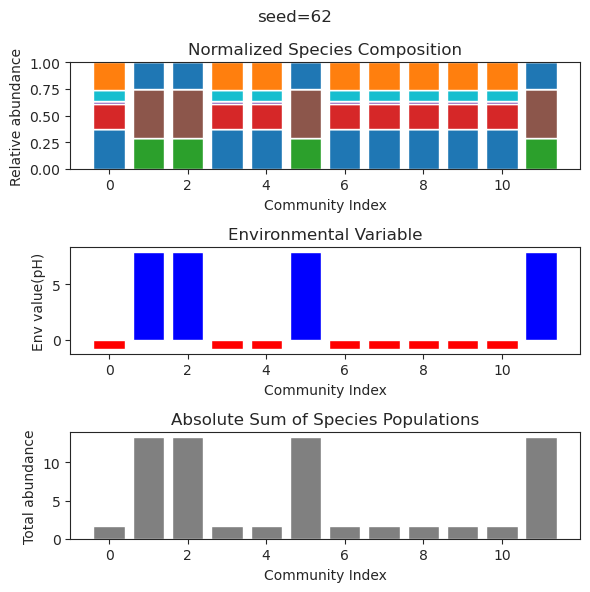

{'species': array([ 2.41056753e-01,  3.53531266e-39, -8.40016965e-41,  6.86457907e-01,
        1.57823641e-38,  2.62210974e-34,  1.03896416e-02,  6.17946607e-42,
        1.40279993e-44,  2.32265008e-01, -1.22100398e-48,  5.35586440e-01]), 'env': array([-0.48072529])}
{'species': array([ 2.41056753e-01,  1.64176099e-33,  3.37602789e-33,  6.86457907e-01,
       -2.64602406e-45,  6.47448111e-51,  1.03896420e-02,  1.43271225e-43,
        1.64889177e-37,  2.32265008e-01, -8.72829419e-54,  5.35586440e-01]), 'env': array([-0.48072529])}
{'species': array([ 2.41056841e-01,  3.26198125e-35, -4.09799581e-41,  6.86457816e-01,
        1.58895323e-34, -1.29134677e-29,  1.03890807e-02,  9.58513221e-32,
       -9.85478238e-33,  2.32265158e-01,  5.98932676e-63,  5.35586646e-01]), 'env': array([-0.48072519])}
{'species': array([ 2.41056753e-01, -2.26863340e-35, -3.46328310e-52,  6.86457907e-01,
       -1.96619373e-38, -1.41776763e-47,  1.03896419e-02, -1.83777712e-44,
       -1.18005483e-43,  2.3226500

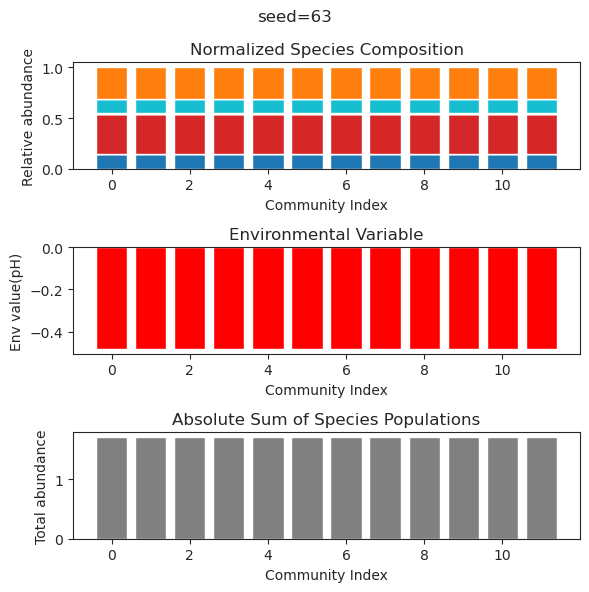

{'species': array([ 5.53521162e-43,  9.95272890e-32,  1.55605989e-15,  1.62022306e-40,
        1.32824209e-01,  6.00057682e-01, -1.74996469e-60,  7.93827888e-59,
        7.72784611e-01, -4.83269230e-17, -1.61769315e-42, -6.18955318e-38]), 'env': array([-1.16908087])}
{'species': array([ 6.02497284e-40, -5.73075902e-30,  1.30032330e-16,  1.18385248e-37,
        1.32824209e-01,  6.00057682e-01, -4.44124401e-50,  4.91332171e-49,
        7.72784611e-01, -4.59882842e-20, -7.96754470e-37,  4.91084480e-33]), 'env': array([-1.16908087])}
{'species': array([ 7.70240341e-45,  8.09743286e-32,  6.86249493e-16,  3.68939388e-41,
        1.32824209e-01,  6.00057682e-01, -2.57694257e-57,  2.41291692e-62,
        7.72784611e-01, -1.36834530e-16, -1.76707648e-45,  4.45679367e-40]), 'env': array([-1.16908087])}
{'species': array([ 1.57140596e-35,  5.31555150e-39,  7.71016771e-18,  2.22082511e-31,
        1.32824209e-01,  6.00057682e-01, -4.91334576e-61, -2.33097756e-50,
        7.72784611e-01, -5.6789384

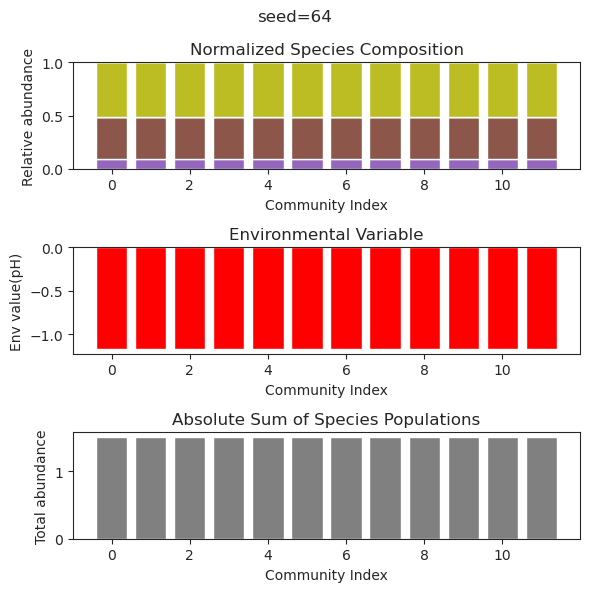

{'species': array([-2.12884522e-62,  8.38425391e-36, -9.25091981e-67,  9.76494131e-39,
        4.20927474e-02,  1.15862857e-27,  5.83957923e-01,  5.83895859e-01,
       -5.49734232e-63, -5.75710147e-61, -9.89548687e-29, -1.14293000e-66]), 'env': array([-1.93354612])}
{'species': array([-2.15391752e-38,  4.81749729e-30,  7.54114693e-39, -1.00053916e-19,
        4.20927474e-02,  5.48140088e-20,  5.83957923e-01,  5.83895859e-01,
        8.87329664e-42,  3.55554799e-38, -2.37190731e-23, -1.44443679e-42]), 'env': array([-1.93354612])}
{'species': array([-1.95120504e-61, -3.12272904e-35,  9.40792280e-64, -2.16760073e-34,
        4.20927474e-02,  2.90504589e-20,  5.83957923e-01,  5.83895859e-01,
        3.17246699e-62, -2.60018475e-61, -1.40266990e-23, -6.55044781e-69]), 'env': array([-1.93354612])}
{'species': array([-1.34939129e-71, -4.26320196e-41,  2.23705244e-67,  2.01811323e-41,
        4.20927474e-02,  7.91391402e-26,  5.83957923e-01,  5.83895859e-01,
       -3.05128914e-67,  6.6413514

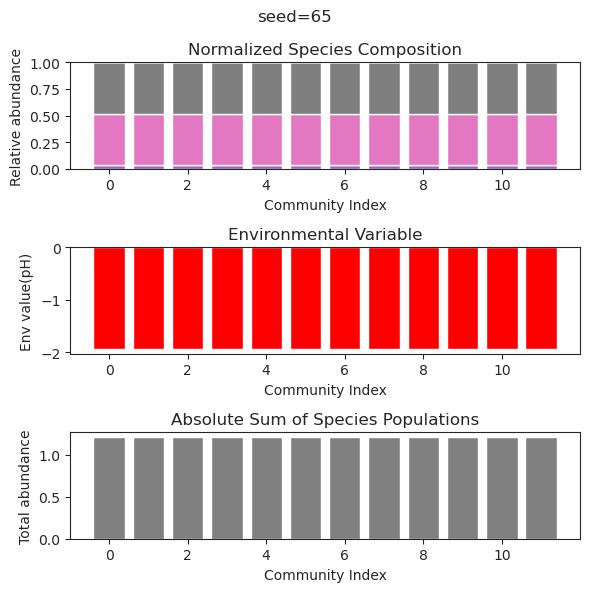

{'species': array([ 3.22054431e-01, -2.56842974e-49,  8.99922340e-01,  3.54041462e-01,
        2.58324951e-01,  5.13321570e-45,  6.13667082e-44,  2.72606636e-39,
        2.12555452e-01, -1.83521134e-64,  1.97848857e-37,  2.12084711e-01]), 'env': array([0.24480125])}
{'species': array([3.22054431e-01, 4.06185052e-43, 8.99922340e-01, 3.54041462e-01,
       2.58324951e-01, 1.52492604e-40, 3.36504835e-40, 7.17489229e-36,
       2.12555452e-01, 6.09892013e-58, 2.81125677e-34, 2.12084711e-01]), 'env': array([0.24480125])}
{'species': array([ 3.22054431e-01,  2.87783262e-40,  8.99922340e-01,  3.54041462e-01,
        2.58324951e-01, -1.14767432e-38, -4.82595347e-38,  1.64246841e-34,
        2.12555452e-01,  1.79316605e-57,  9.24656074e-32,  2.12084711e-01]), 'env': array([0.24480125])}
{'species': array([ 3.22054431e-01, -2.89536414e-45,  8.99922340e-01,  3.54041462e-01,
        2.58324951e-01, -1.16102017e-42, -6.80393392e-41, -6.17678026e-38,
        2.12555452e-01, -2.99715175e-60, -4.39252

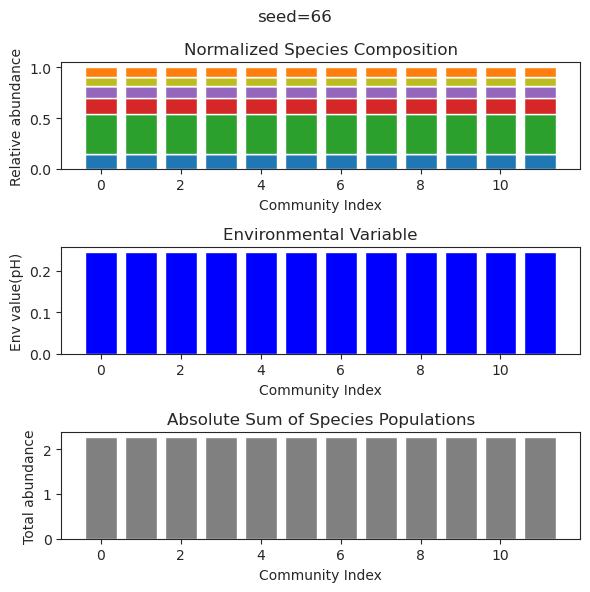

{'species': array([ 6.19364490e-32,  5.39921206e-01, -1.38370665e-54,  6.30432114e-30,
       -1.06354749e-16,  2.56574931e-01,  2.96410322e-01, -5.86014924e-32,
        2.86761279e-25, -2.03569679e-18,  2.03414730e-33,  4.91736450e-06]), 'env': array([-1.23842262])}
{'species': array([ 1.11747007e-26,  5.39880088e-01,  4.49352865e-29,  1.18071914e-33,
       -1.77153846e-14,  2.56526131e-01,  2.96467154e-01,  2.02121052e-27,
       -8.58096853e-38, -3.54383827e-29,  2.69052272e-79,  1.04916239e-04]), 'env': array([-1.23829458])}
{'species': array([ 2.48392180e-001,  1.51172850e-001,  3.91281763e-001,
       -3.90829192e-017,  1.96332821e-001,  1.33489668e-001,
        5.31017831e-001,  4.47605986e-001, -1.15172053e-110,
        3.67756553e-001,  6.38732188e-002, -4.49916989e-069]), 'env': array([0.43482523])}
{'species': array([ 1.20632406e-36,  5.39923069e-01, -8.10496576e-60,  4.09937251e-33,
       -3.16795408e-16,  2.56577142e-01,  2.96407748e-01,  3.72891715e-35,
        1.785831

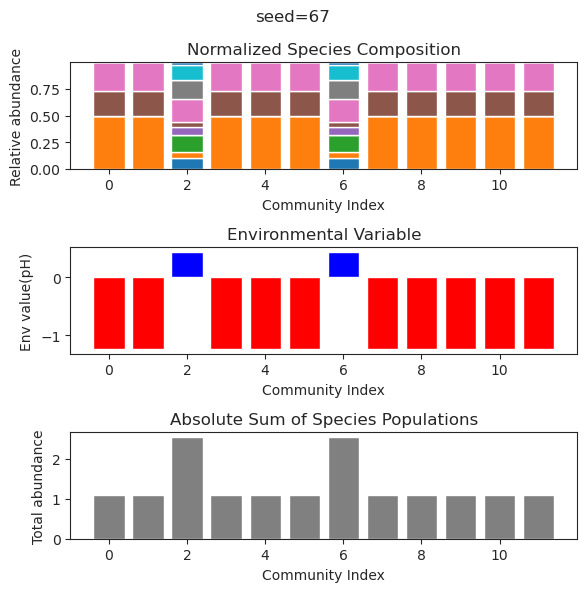

{'species': array([-3.96156550e-82,  1.35739023e-01,  4.59977026e-52,  2.34952587e-30,
        2.27531019e-01,  6.86968312e-01,  1.46986143e-01,  3.34645934e-01,
        2.28789940e-01, -3.31423974e-79,  1.64073577e-75, -2.95463871e-74]), 'env': array([-1.04181185])}
{'species': array([ 2.66149292e-87,  1.35739023e-01, -4.21382535e-59,  7.87427508e-39,
        2.27531019e-01,  6.86968312e-01,  1.46986143e-01,  3.34645934e-01,
        2.28789940e-01, -8.36787004e-99,  4.09881824e-89,  1.35136899e-79]), 'env': array([-1.04181185])}
{'species': array([-2.57643244e-76,  1.35739023e-01,  1.59954132e-52,  3.28617799e-29,
        2.27531019e-01,  6.86968312e-01,  1.46986143e-01,  3.34645934e-01,
        2.28789940e-01,  8.06058112e-75,  8.42578325e-77, -4.08419742e-73]), 'env': array([-1.04181185])}
{'species': array([ 1.69969794e-58,  1.35739023e-01,  1.23766052e-49, -1.08622418e-28,
        2.27531019e-01,  6.86968312e-01,  1.46986143e-01,  3.34645934e-01,
        2.28789940e-01,  6.1799871

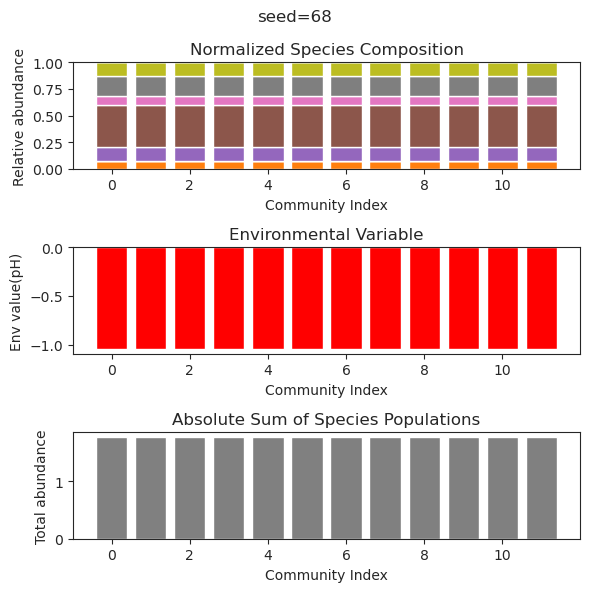

{'species': array([-8.83153727e-39, -4.83538330e-45,  8.91886987e-36,  5.93630626e-01,
        1.49805455e-02, -5.80919290e-32,  3.93844446e-35,  3.82224084e-01,
        5.12778715e-29, -8.07772177e-31,  1.76335813e-01,  6.93545313e-01]), 'env': array([-0.52953354])}
{'species': array([-8.46278258e-79, -2.73965349e-68,  1.19569213e-34,  5.93630626e-01,
        1.49805455e-02,  2.27103819e-32,  3.91791309e-30,  3.82224084e-01,
        3.92599202e-53, -5.64836375e-78,  1.76335813e-01,  6.93545313e-01]), 'env': array([-0.52953354])}
{'species': array([ 1.17468308e-54,  1.74056060e-48,  1.35400382e-34,  5.93630626e-01,
        1.49805455e-02,  8.68247603e-54,  2.65309962e-38,  3.82224084e-01,
       -3.13781640e-49, -2.39658517e-56,  1.76335813e-01,  6.93545313e-01]), 'env': array([-0.52953354])}
{'species': array([ 8.44936990e-35,  8.99715059e-38,  1.61010623e-35,  5.93630626e-01,
        1.49805455e-02,  1.70175583e-32, -6.40347661e-38,  3.82224084e-01,
       -8.09448839e-38, -9.5948975

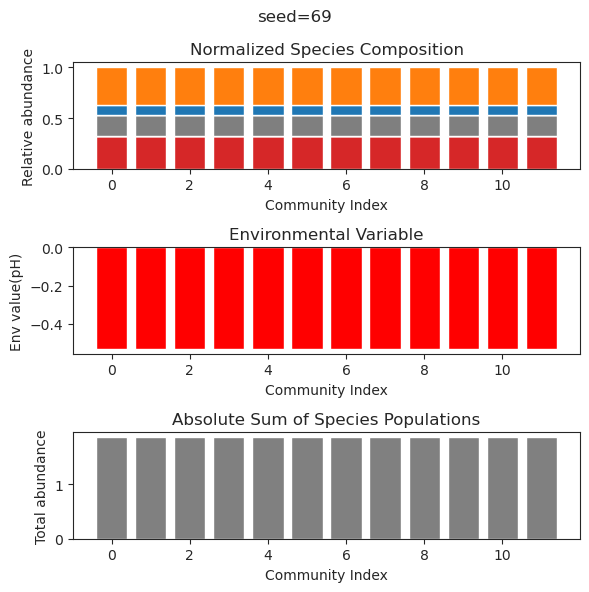

{'species': array([ 4.65882065e-02, -5.11470511e-32,  2.82120524e-01,  4.04702825e-01,
        1.75912225e-01,  1.02654692e-43,  1.33590774e-16,  2.13475546e-01,
        8.63393817e-02,  9.93287302e-02, -3.10896175e-31,  4.52064747e-01]), 'env': array([-0.18127211])}
{'species': array([ 4.65882065e-02, -9.01749994e-33,  2.82120524e-01,  4.04702825e-01,
        1.75912225e-01, -9.71773807e-43, -6.04248244e-17,  2.13475546e-01,
        8.63393817e-02,  9.93287302e-02, -6.42615291e-29,  4.52064747e-01]), 'env': array([-0.18127211])}
{'species': array([ 4.65882065e-02,  8.19459836e-38,  2.82120524e-01,  4.04702825e-01,
        1.75912225e-01, -1.05734314e-62, -9.58055268e-19,  2.13475546e-01,
        8.63393817e-02,  9.93287302e-02, -1.28447328e-35,  4.52064747e-01]), 'env': array([-0.18127211])}
{'species': array([ 4.65882065e-02,  2.78871574e-33,  2.82120524e-01,  4.04702825e-01,
        1.75912225e-01,  2.27561865e-54, -3.06898399e-14,  2.13475546e-01,
        8.63393817e-02,  9.9328730

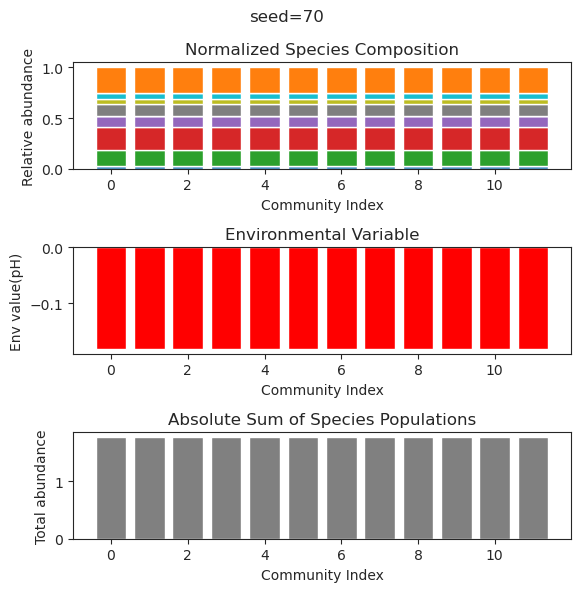

{'species': array([-2.63611947e-83, -5.22467505e-30, -2.11219056e-55,  3.48751729e-01,
       -5.19864771e-57,  4.35936247e-02,  2.10433737e-01,  1.78287077e-01,
       -7.29595011e-65,  9.31907395e-53, -1.16247105e-52, -4.21920208e-53]), 'env': array([-1.31722596])}
{'species': array([ 4.47884821e-61, -3.85247038e-33, -3.63487156e-47,  3.48751729e-01,
       -3.17640103e-50,  4.35936247e-02,  2.10433737e-01,  1.78287077e-01,
       -1.91686796e-53, -5.73363493e-45,  1.21362483e-46, -2.12446655e-46]), 'env': array([-1.31722596])}
{'species': array([ 2.67699469e-66,  3.36318522e-47, -7.29018335e-49,  3.48751729e-01,
       -2.67296016e-50,  4.35936247e-02,  2.10433737e-01,  1.78287077e-01,
       -5.08989988e-60,  5.28902279e-48, -3.61499601e-55, -2.20947759e-50]), 'env': array([-1.31722596])}
{'species': array([-4.26095101e-93,  4.51099638e-25, -2.78751730e-59,  3.48751729e-01,
       -6.83153648e-62,  4.35936247e-02,  2.10433737e-01,  1.78287077e-01,
       -3.52786793e-74, -1.8514053

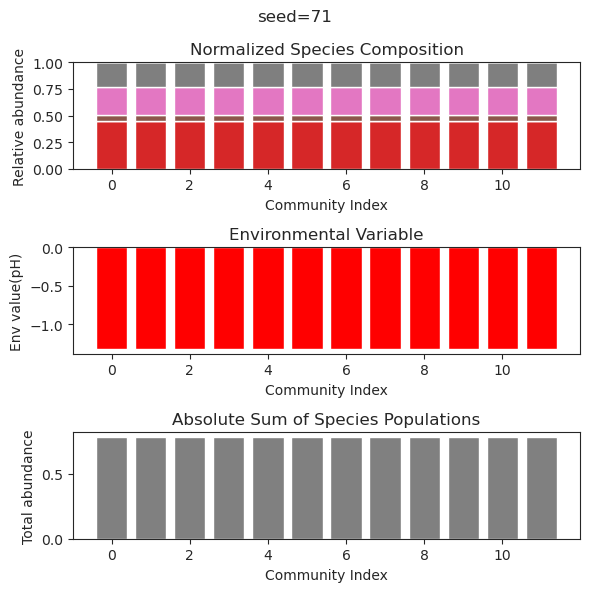

{'species': array([ 2.53669502e-001, -1.71806996e-046,  1.06231511e-001,
        2.66889460e-001,  6.63871613e-002,  5.59984445e-001,
        4.96173471e-048,  6.20957898e-001,  1.87180601e-132,
        1.40925288e-001, -8.00481282e-128,  2.42519573e-085]), 'env': array([-0.05964607])}
{'species': array([ 2.53669502e-001, -1.71550475e-043,  1.06231511e-001,
        2.66889460e-001,  6.63871613e-002,  5.59984445e-001,
        1.16418420e-063,  6.20957898e-001, -1.77315543e-124,
        1.40925288e-001,  1.46437043e-118, -5.20138648e-076]), 'env': array([-0.05964607])}
{'species': array([ 2.32042876e-46,  8.07741445e-30,  6.26142547e-30,  4.24784905e-30,
        9.41767065e-02,  1.26624152e-92,  1.47911779e-01, -2.25956566e-44,
        2.26106978e-01,  3.01836193e-55,  6.43709867e-01,  1.70251373e-64]), 'env': array([-1.97637682])}
{'species': array([ 2.51310283e-001,  8.55057539e-159,  1.01004767e-001,
        2.67714939e-001,  6.51623735e-002,  5.63137409e-001,
       -5.62398311e-089,

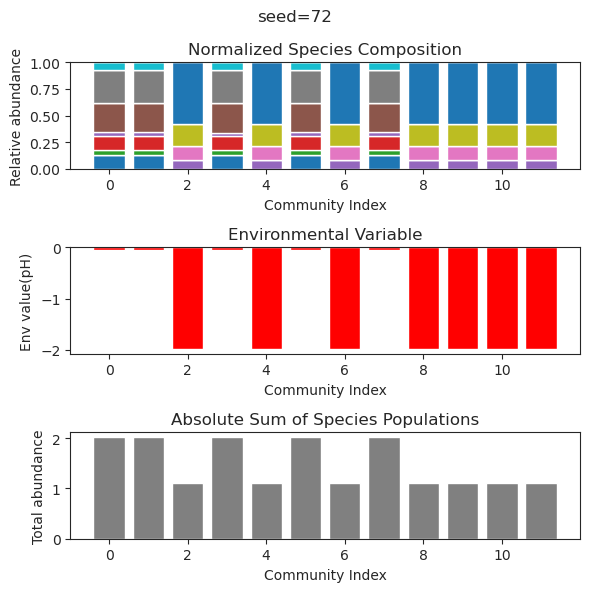

{'species': array([ 2.86946701e-01, -7.53007805e-33,  4.64298426e-01,  3.57617235e-01,
        1.24791469e-26, -5.91446590e-29,  3.74828428e-26, -4.69354062e-32,
       -5.69101428e-31, -5.71011417e-37,  3.91319933e-01, -1.80353520e-31]), 'env': array([-1.45604073])}
{'species': array([ 2.86946701e-01, -1.30660860e-34,  4.64298426e-01,  3.57617235e-01,
       -6.38929256e-28, -2.64985014e-29, -2.21897867e-27, -7.31611142e-33,
        1.57426814e-32, -1.66654304e-34,  3.91319933e-01, -2.24143391e-32]), 'env': array([-1.45604073])}
{'species': array([ 2.86946701e-01, -9.61675547e-35,  4.64298426e-01,  3.57617235e-01,
        5.76944983e-28,  3.14823194e-27, -7.84846700e-26, -1.03550264e-33,
       -1.31238172e-28, -5.92238515e-37,  3.91319933e-01, -6.75140201e-35]), 'env': array([-1.45604073])}
{'species': array([ 2.86946701e-01,  1.59297440e-39,  4.64298426e-01,  3.57617235e-01,
       -2.17906525e-30, -4.82087460e-31, -6.42749108e-28,  4.48516499e-37,
       -1.06849110e-35,  1.5221434

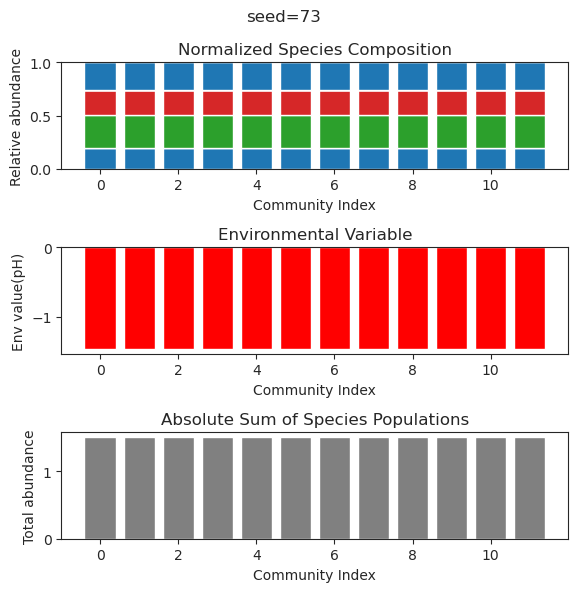

{'species': array([-5.98869356e-60,  3.95798150e-68,  7.90123280e-60, -3.70764249e-66,
       -1.13504111e-27,  1.13851243e-56,  1.38312483e-01,  7.66686183e-01,
        4.57009477e-02, -2.83844525e-25,  4.68261760e-51, -3.55636166e-63]), 'env': array([-2.1363128])}
{'species': array([-1.62446321e-53,  7.07591543e-57, -6.32241292e-49,  1.83547678e-55,
        5.90148627e-25,  1.22569734e-47,  1.38312483e-01,  7.66686183e-01,
        4.57009477e-02, -2.90253201e-22,  1.09221595e-51, -6.75452453e-57]), 'env': array([-2.1363128])}
{'species': array([-8.14455790e-50, -5.21677407e-49, -9.04889609e-45, -7.43921167e-48,
       -1.13245236e-33, -8.37661618e-45,  1.38312483e-01,  7.66686183e-01,
        4.57009477e-02,  1.52794570e-21, -1.35807915e-53, -1.42595772e-48]), 'env': array([-2.1363128])}
{'species': array([ 3.97693838e-77,  1.65443507e-88,  2.36563343e-72,  2.14938087e-86,
        7.63221449e-25,  1.83526858e-69,  1.38312483e-01,  7.66686183e-01,
        4.57009477e-02, -7.21732211e-

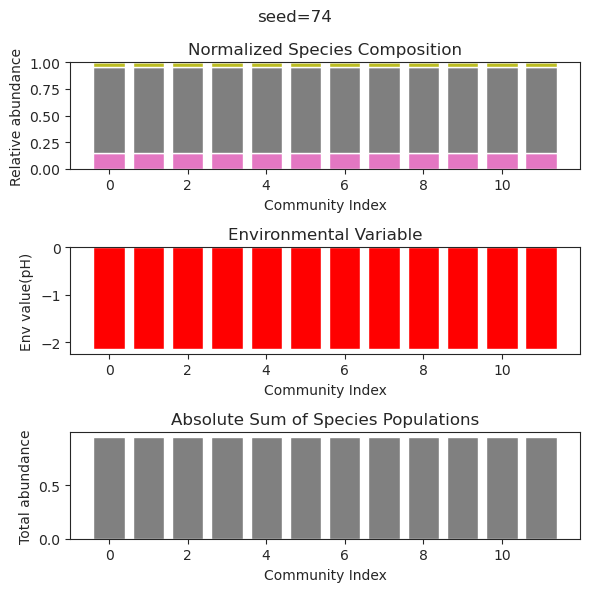

{'species': array([ 1.54567119e-002,  3.29842956e-001, -1.02720509e-259,
        7.47255073e-002,  5.04238466e-156,  3.36817715e-213,
        7.61768967e-257,  2.75812382e-001,  2.43236921e-001,
        2.80707290e-001,  3.71720600e-001,  4.32841999e-158]), 'env': array([-0.58575666])}
{'species': array([ 1.54567000e-002,  3.29842799e-001,  2.86818804e-244,
        7.47254633e-002,  9.00713698e-136, -2.12628762e-217,
        1.11903318e-221,  2.75812803e-001,  2.43236887e-001,
        2.80707633e-001,  3.71720583e-001, -1.02372306e-168]), 'env': array([-0.58575602])}
{'species': array([ 1.54567103e-002,  3.29842960e-001,  1.62490394e-200,
        7.47255127e-002, -1.25993665e-123, -1.57165682e-168,
       -3.36742207e-195,  2.75812348e-001,  2.43236934e-001,
        2.80707254e-001,  3.71720599e-001, -5.08004393e-133]), 'env': array([-0.58575671])}
{'species': array([ 1.54567015e-002,  3.29842916e-001, -3.10440112e-211,
        7.47255120e-002, -1.26740511e-123, -2.22368446e-187,
     

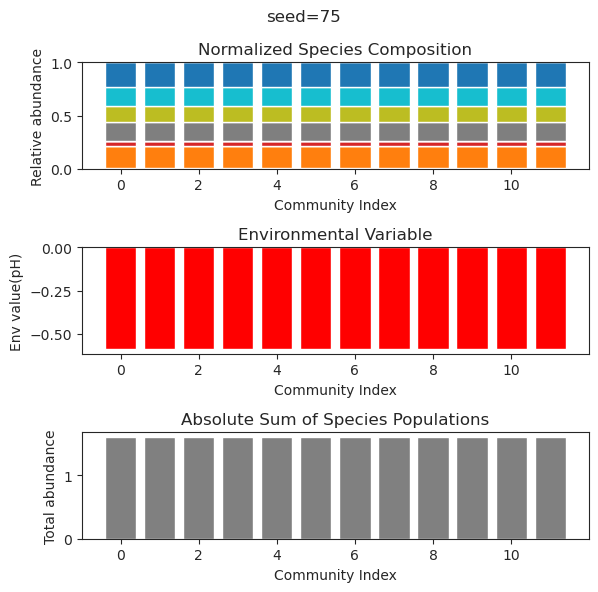

{'species': array([ 9.36431242e-03, -7.69615519e-34,  1.95179398e-01, -6.98459176e-42,
       -1.45985670e-37, -7.67510073e-48,  1.79709278e-01,  5.21660073e-01,
        5.44657750e-01,  3.27626101e-01,  7.68365679e-49,  1.71982570e-01]), 'env': array([-0.16412565])}
{'species': array([ 9.36431242e-03,  3.78798843e-35,  1.95179398e-01, -2.88166412e-43,
       -9.50320277e-39, -3.71673122e-45,  1.79709278e-01,  5.21660073e-01,
        5.44657750e-01,  3.27626101e-01,  9.19484317e-49,  1.71982570e-01]), 'env': array([-0.16412565])}
{'species': array([ 9.36431242e-03, -2.48925785e-82,  1.95179398e-01, -1.66373070e-53,
        1.50087935e-36, -1.04161666e-63,  1.79709278e-01,  5.21660073e-01,
        5.44657750e-01,  3.27626101e-01, -1.71527420e-73,  1.71982570e-01]), 'env': array([-0.16412565])}
{'species': array([ 9.36431242e-03, -7.50045885e-61,  1.95179398e-01,  8.86957446e-42,
       -1.72574679e-37,  2.32872482e-50,  1.79709278e-01,  5.21660073e-01,
        5.44657750e-01,  3.2762610

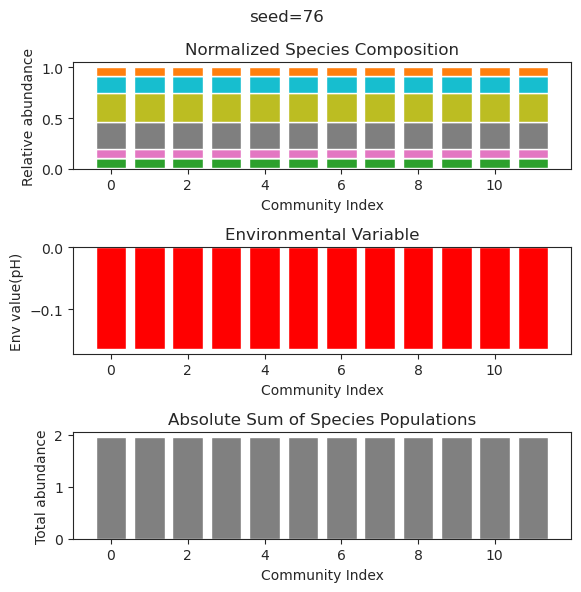

{'species': array([ 1.41648923e-54,  2.25353255e-01,  6.56672680e-01, -9.43474390e-43,
        1.82562713e-53,  5.19704706e-01,  3.50792069e-55,  3.51381709e-02,
        1.68233370e-50, -2.13819184e-56,  2.42953701e-01, -2.40117303e-39]), 'env': array([-0.43035172])}
{'species': array([ 8.38836441e-55,  2.25353255e-01,  6.56672680e-01, -8.53978044e-40,
       -2.12031583e-50,  5.19704706e-01, -2.07151275e-47,  3.51381709e-02,
       -1.71652462e-47, -1.30074709e-51,  2.42953701e-01,  4.71743654e-38]), 'env': array([-0.43035172])}
{'species': array([-9.10049551e-53,  2.25353255e-01,  6.56672680e-01, -2.60659756e-39,
        7.32864792e-47,  5.19704706e-01,  2.47742850e-49,  3.51381709e-02,
        1.78997867e-44,  9.18316931e-54,  2.42953701e-01,  1.18397890e-38]), 'env': array([-0.43035172])}
{'species': array([ 1.24343183e-49,  2.25353255e-01,  6.56672680e-01,  4.36136005e-43,
        6.62700378e-46,  5.19704706e-01,  4.00721607e-50,  3.51381709e-02,
        2.78916676e-44,  2.5554382

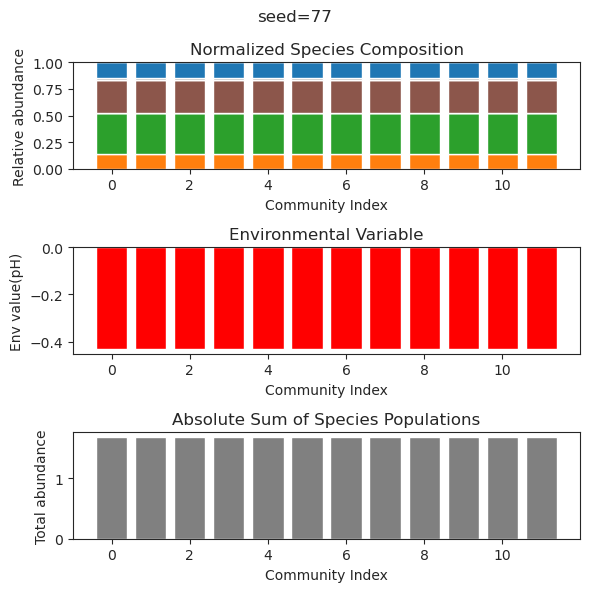

{'species': array([ 2.19860185e-27,  2.19214860e-01,  2.37102476e-17,  1.10661929e-45,
        3.20502884e-01,  1.21650918e-32,  4.42893007e-23,  3.42604234e-01,
        2.51634656e-01,  2.88214274e-01, -1.17623692e-41,  2.94582771e-50]), 'env': array([-1.10989236])}
{'species': array([-8.52339958e-29,  2.19214860e-01, -4.85449471e-18, -1.89980662e-49,
        3.20502884e-01,  6.20104385e-35,  3.63779627e-27,  3.42604234e-01,
        2.51634656e-01,  2.88214274e-01,  1.00869634e-41,  2.15056220e-47]), 'env': array([-1.10989236])}
{'species': array([-2.04393799e-34,  2.19214860e-01,  3.79168207e-17, -2.99223276e-52,
        3.20502884e-01, -1.54658296e-39, -1.40962446e-23,  3.42604234e-01,
        2.51634656e-01,  2.88214274e-01, -1.08622023e-41,  1.94113655e-57]), 'env': array([-1.10989236])}
{'species': array([-2.04393799e-34,  2.19214860e-01,  3.79168207e-17, -2.99223276e-52,
        3.20502884e-01, -1.54658296e-39, -1.40962446e-23,  3.42604234e-01,
        2.51634656e-01,  2.8821427

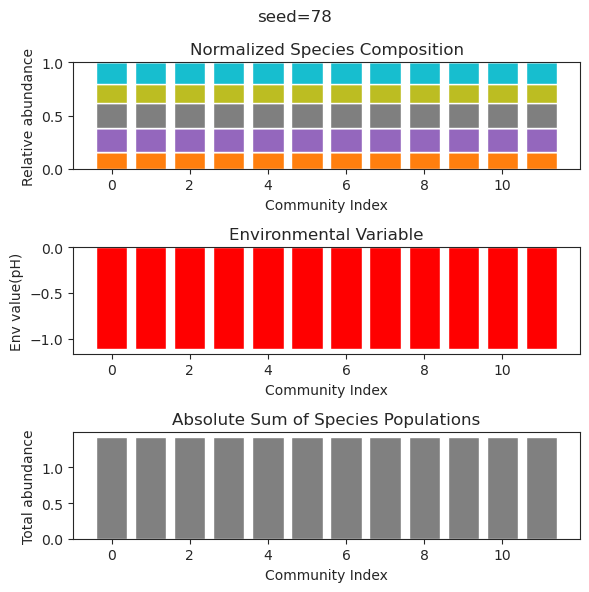

{'species': array([ 6.49536120e-001,  2.67325469e-001,  5.82571125e-173,
        1.74351640e-038,  9.22360784e-002, -6.07242371e-133,
       -1.68565115e-163,  3.03499232e-001,  6.65586924e-001,
        5.10552822e-003, -2.41975135e-141, -4.62029799e-088]), 'env': array([0.14605454])}
{'species': array([-1.09554823e-041,  6.77053887e-001,  1.41379593e-001,
        3.61848219e-001, -1.81907755e-037,  7.56841361e-002,
        3.21081473e-001, -2.73484415e-081, -3.15896246e-116,
        1.27307709e-105,  5.77970437e-127,  8.46152817e-001]), 'env': array([0.40174147])}
{'species': array([ 1.11942292e-047,  6.77053887e-001,  1.41379593e-001,
        3.61848219e-001,  1.18539433e-045,  7.56841361e-002,
        3.21081473e-001, -4.72643014e-088,  2.73577951e-122,
        2.24409989e-113,  6.78966592e-143,  8.46152817e-001]), 'env': array([0.40174147])}
{'species': array([-1.10031649e-040,  6.77053887e-001,  1.41379593e-001,
        3.61848219e-001, -1.63893322e-035,  7.56841361e-002,
        

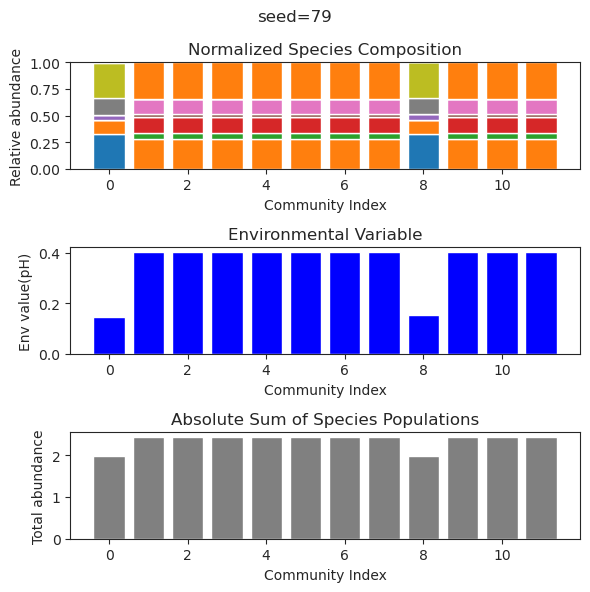

{'species': array([ 5.70032291e-37,  1.30048806e-01, -1.21151357e-35,  1.51567191e-70,
        2.97637333e-01,  2.17284948e-01, -7.88774180e-59,  3.91004682e-01,
        3.77186766e-02,  5.73820386e-01,  1.97164169e-55,  9.64403296e-39]), 'env': array([-0.80393701])}
{'species': array([ 3.82574824e-35,  1.30048808e-01, -7.68348664e-35, -1.84552173e-75,
        2.97637331e-01,  2.17284945e-01,  3.39599637e-35,  3.91004685e-01,
        3.77186724e-02,  5.73820391e-01,  3.99392349e-58, -4.64175509e-41]), 'env': array([-0.80393701])}
{'species': array([ 1.25567394e-35,  1.30048808e-01,  7.35774357e-33,  4.00812866e-78,
        2.97637331e-01,  2.17284945e-01, -3.11002365e-35,  3.91004685e-01,
        3.77186731e-02,  5.73820390e-01,  4.17929520e-62,  9.64116267e-40]), 'env': array([-0.80393701])}
{'species': array([-5.16731649e-37,  1.30048805e-01, -5.82310632e-58, -2.73245774e-73,
        2.97637334e-01,  2.17284950e-01,  2.94672625e-38,  3.91004680e-01,
        3.77186787e-02,  5.7382038

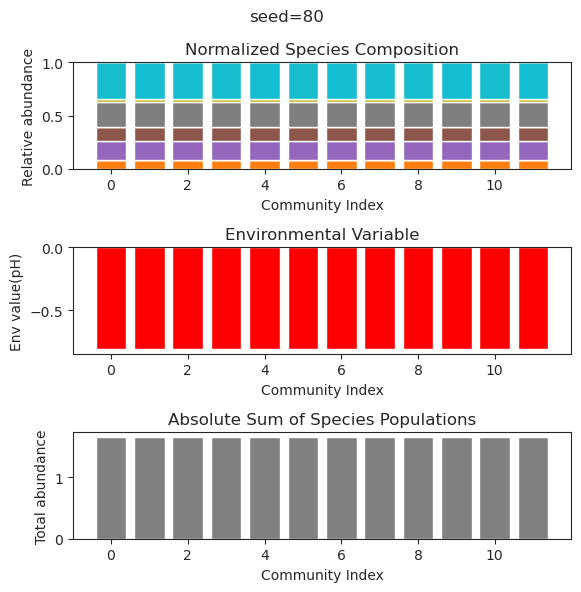

{'species': array([-1.60136565e-063,  2.39837181e-057,  6.01065136e-001,
        1.59872366e-001, -2.69897274e-063,  1.27286977e-023,
       -1.07930029e-101,  3.57238688e-001,  3.13180877e-001,
        2.37246499e-001,  3.62814617e-001, -1.63350242e-029]), 'env': array([-0.21230965])}
{'species': array([-4.27318042e-60,  3.55569311e-55,  6.01065136e-01,  1.59872366e-01,
       -1.39401935e-77, -1.40026992e-26,  2.79197168e-74,  3.57238688e-01,
        3.13180877e-01,  2.37246499e-01,  3.62814617e-01, -2.60418624e-27]), 'env': array([-0.21230965])}
{'species': array([-8.98568621e-59, -1.49846135e-43,  6.01065136e-01,  1.59872366e-01,
        4.23385064e-63,  1.62337926e-20, -2.00300708e-73,  3.57238688e-01,
        3.13180877e-01,  2.37246499e-01,  3.62814617e-01,  7.79251410e-27]), 'env': array([-0.21230965])}
{'species': array([-3.26963361e-59, -1.35244438e-49,  6.01065136e-01,  1.59872366e-01,
       -1.86370573e-69,  1.43159759e-26, -2.12687725e-72,  3.57238688e-01,
        3.13180

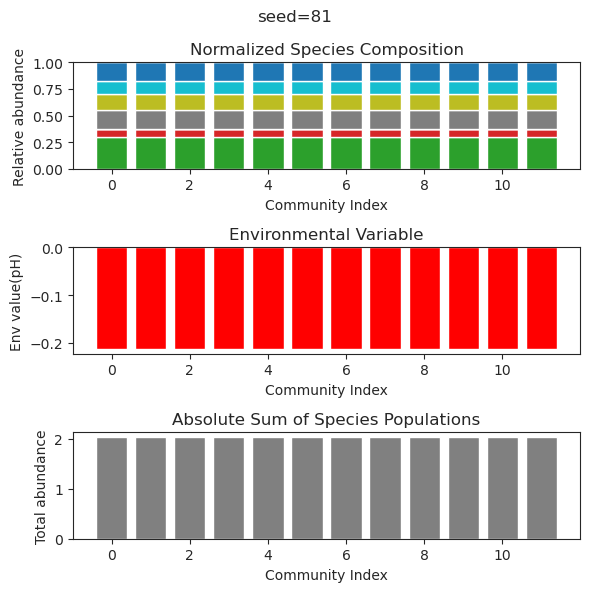

{'species': array([-6.82058153e-78, -1.08650340e-55, -5.82826412e-16,  5.99677388e-01,
        1.03756554e-59, -6.21210617e-53,  5.70584244e-27,  3.22215606e-01,
        3.90481984e-01, -1.58878658e-18,  1.97216146e-69,  2.40517832e-74]), 'env': array([-0.61525601])}
{'species': array([ 1.02738729e-57,  4.69573098e-01,  2.43817029e-02,  5.72486502e-45,
        2.10425764e-01, -1.06481653e-32,  3.28579974e-01,  4.41061772e-01,
       -3.13143829e-23, -1.04453570e-22,  1.91676568e-71, -3.04564018e-66]), 'env': array([-0.54949069])}
{'species': array([-4.28648775e-51, -2.43235191e-39, -2.31528360e-17,  5.99677388e-01,
        1.31059077e-42,  1.57769407e-44, -1.09370333e-22,  3.22215606e-01,
        3.90481984e-01, -1.24232117e-17,  5.92066572e-48,  6.49501497e-52]), 'env': array([-0.61525601])}
{'species': array([-5.23379263e-47, -1.40424106e-34, -7.54534822e-17,  5.99677388e-01,
       -6.11573665e-38,  5.92059674e-46,  7.14763600e-21,  3.22215606e-01,
        3.90481984e-01,  9.6122040

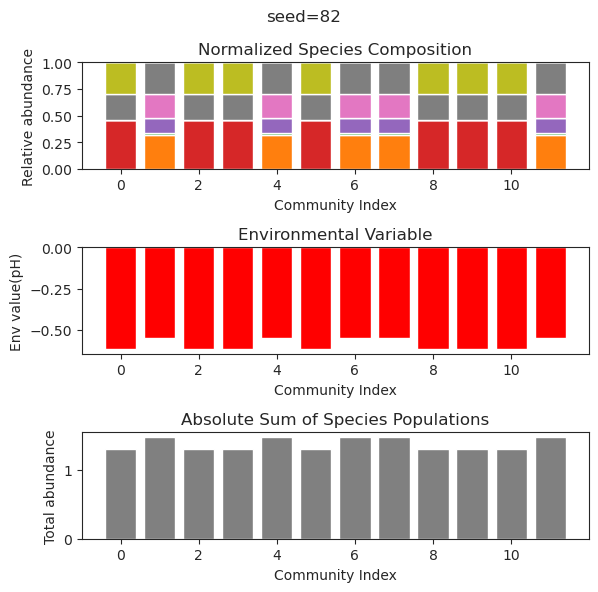

{'species': array([ 1.66435594e-27,  2.51932508e-01, -4.92174897e-36,  2.53185848e-01,
        3.07289744e-01,  4.94530665e-17,  2.96635220e-56, -5.87702725e-37,
        2.54291674e-01,  2.45553068e-24,  1.45763412e-62,  3.97555148e-01]), 'env': array([-0.50418397])}
{'species': array([ 3.95346359e-27,  2.51932508e-01, -3.53460402e-33,  2.53185848e-01,
        3.07289744e-01,  9.32129426e-17,  6.88161178e-45,  5.44531140e-32,
        2.54291674e-01, -2.16541956e-24,  1.43462090e-46,  3.97555148e-01]), 'env': array([-0.50418397])}
{'species': array([-1.30760085e-29,  2.51932508e-01, -2.10491246e-36,  2.53185848e-01,
        3.07289744e-01,  7.16954722e-22,  2.37824191e-52, -1.53515421e-36,
        2.54291674e-01,  2.71729967e-27, -8.95103947e-58,  3.97555148e-01]), 'env': array([-0.50418397])}
{'species': array([-3.62624907e-29,  2.51932508e-01,  3.57488753e-43,  2.53185848e-01,
        3.07289744e-01, -3.36988807e-18,  1.02967539e-48, -2.03663785e-42,
        2.54291674e-01, -7.1584296

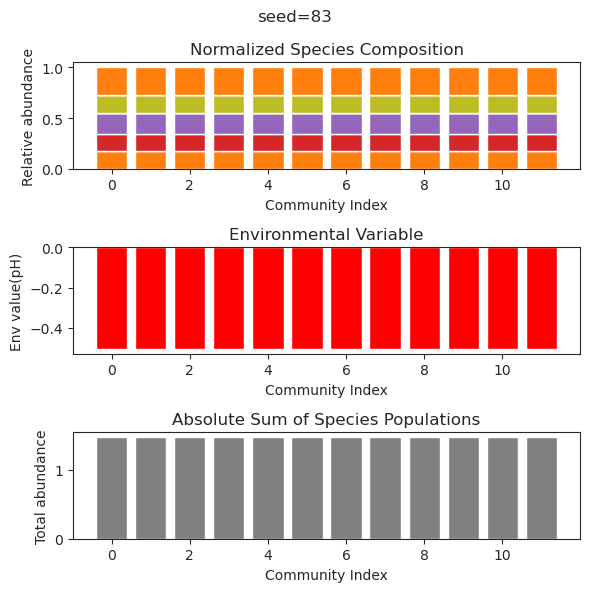

{'species': array([ 2.64382773e-65,  5.70069578e-63,  1.01389362e-72,  1.28447895e-50,
        4.52157406e-77,  2.76652130e-01,  7.72385682e-01,  6.65340783e-17,
        2.12160582e-54, -3.01313400e-76,  6.28603341e-02,  5.27601699e-01]), 'env': array([-1.1505967])}
{'species': array([ 1.48404563e-67,  6.79724461e-61,  2.94534250e-75, -9.18970525e-54,
       -8.26068477e-80,  2.76652130e-01,  7.72385682e-01, -9.99734001e-17,
       -1.44244139e-57, -1.55184876e-72,  6.28603341e-02,  5.27601699e-01]), 'env': array([-1.1505967])}
{'species': array([ 1.89999165e-56,  1.43686350e-57,  1.27533885e-60, -1.95377033e-49,
       -3.17348580e-62,  2.76652130e-01,  7.72385682e-01,  5.34814804e-17,
       -2.00040624e-50,  8.72337988e-59,  6.28603341e-02,  5.27601699e-01]), 'env': array([-1.1505967])}
{'species': array([-4.26464835e-59, -1.99998699e-55, -3.97478063e-66, -4.43122316e-46,
       -1.19194814e-69,  2.76652130e-01,  7.72385682e-01,  1.16254295e-16,
       -5.40004020e-49, -1.25908765e-

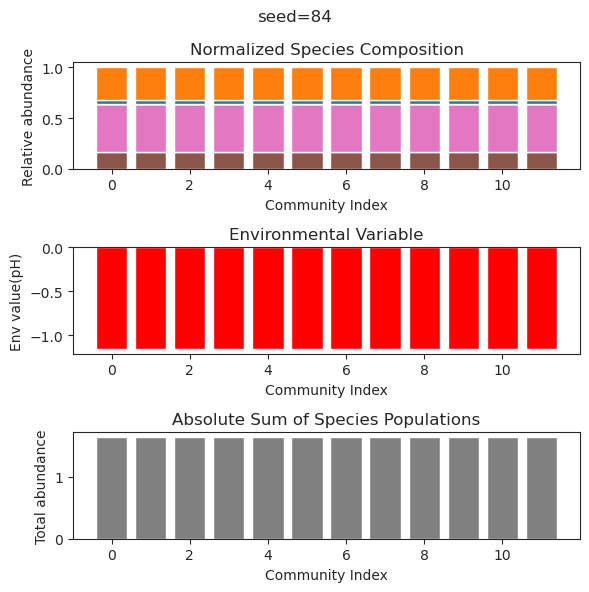

{'species': array([-2.14073758e-65, -5.33356727e-81,  4.37831690e-01,  2.79467044e-01,
        1.67453730e-43,  2.71780232e-01, -4.09873473e-67,  1.08799105e-36,
        3.74029420e-30, -5.18776324e-48,  2.81467069e-01,  1.96869474e-01]), 'env': array([-1.30705785])}
{'species': array([-4.40623621e-43,  1.04942298e-45,  4.37831690e-01,  2.79467044e-01,
        6.29548335e-33,  2.71780232e-01,  5.45891796e-42, -8.79068204e-31,
       -9.98770906e-26, -3.54278288e-33,  2.81467069e-01,  1.96869474e-01]), 'env': array([-1.30705785])}
{'species': array([ 4.13118129e-70,  1.74080437e-84,  4.37831690e-01,  2.79467044e-01,
        1.73729316e-41,  2.71780232e-01, -1.12674310e-70,  5.06435638e-36,
       -1.35905265e-35,  2.37754487e-46,  2.81467069e-01,  1.96869474e-01]), 'env': array([-1.30705785])}
{'species': array([ 3.70104365e-69,  5.46412092e-82,  4.37831690e-01,  2.79467044e-01,
        6.90921952e-43,  2.71780232e-01, -1.88931251e-67, -2.01769351e-35,
        2.29215725e-30, -1.3125074

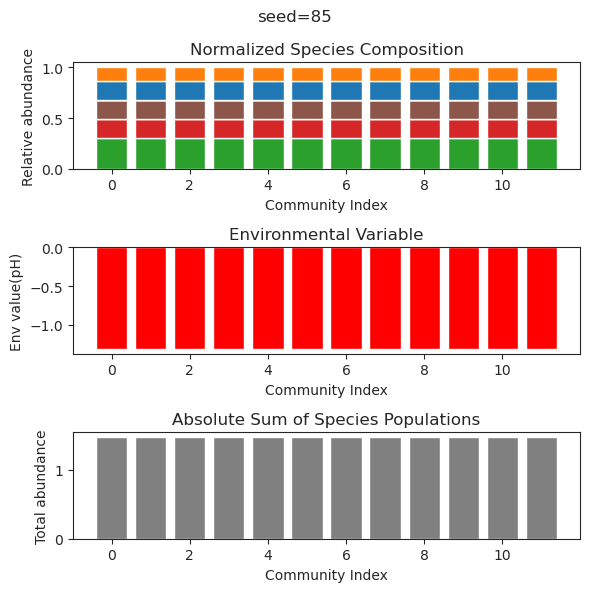

{'species': array([ 4.26444859e-101,  1.42539339e-105,  8.83317878e-041,
       -4.61770015e-095,  1.66079302e-001,  2.10005551e-001,
        4.68507425e-001, -1.71058216e-024,  5.08737460e-001,
        1.82238534e-014,  1.68567979e-082,  1.13422184e-001]), 'env': array([-1.05928996])}
{'species': array([ 6.23379195e-44,  2.39881104e-37,  6.08874735e-36,  3.66743495e-43,
        1.66079302e-01,  2.10005551e-01,  4.68507425e-01, -4.22513136e-25,
        5.08737460e-01,  1.06360603e-14,  7.44921270e-44,  1.13422184e-01]), 'env': array([-1.05928996])}
{'species': array([-3.09491923e-41, -7.39740404e-41, -1.31546128e-38,  2.01219573e-44,
        1.66079302e-01,  2.10005551e-01,  4.68507425e-01,  3.89068084e-22,
        5.08737460e-01, -1.55672997e-14,  2.24345743e-50,  1.13422184e-01]), 'env': array([-1.05928996])}
{'species': array([-4.94004800e-55, -7.06038831e-38, -2.72902749e-37,  1.64127583e-46,
        1.66079302e-01,  2.10005551e-01,  4.68507425e-01,  9.63340740e-26,
        5.08737

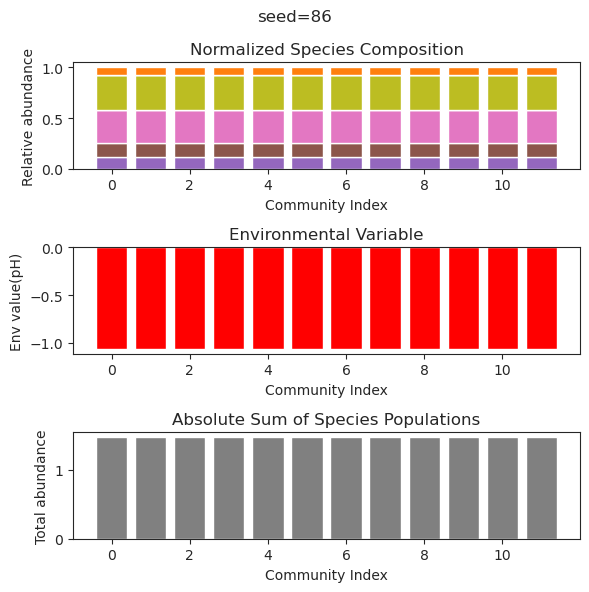

{'species': array([-5.56243771e-43,  3.06264134e-01,  4.12255153e-02,  5.26642742e-01,
        3.95936862e-07,  5.02603623e-01, -1.11245663e-42,  1.28821804e-24,
        8.64959012e-02,  2.01402057e-01,  4.09056549e-02,  5.28612936e-66]), 'env': array([-0.13366623])}
{'species': array([1.28387229e-50, 3.06264051e-01, 4.12257640e-02, 5.26642623e-01,
       6.23940067e-07, 5.02603798e-01, 1.53850741e-46, 9.36657090e-25,
       8.64960104e-02, 2.01402023e-01, 4.09054120e-02, 7.20039769e-72]), 'env': array([-0.13366603])}
{'species': array([-4.19312691e-47,  3.06264272e-01,  4.12251005e-02,  5.26642942e-01,
        1.56266158e-08,  5.02603333e-01, -2.10960482e-40, -1.29058787e-22,
        8.64957190e-02,  2.01402112e-01,  4.09060601e-02,  4.91901892e-66]), 'env': array([-0.13366657])}
{'species': array([ 1.13527488e-32,  3.06263339e-01,  4.12279015e-02,  5.26641595e-01,
        2.58311334e-06,  5.02605295e-01, -6.30962168e-41, -1.65037849e-24,
        8.64969492e-02,  2.01401736e-01,  4.09

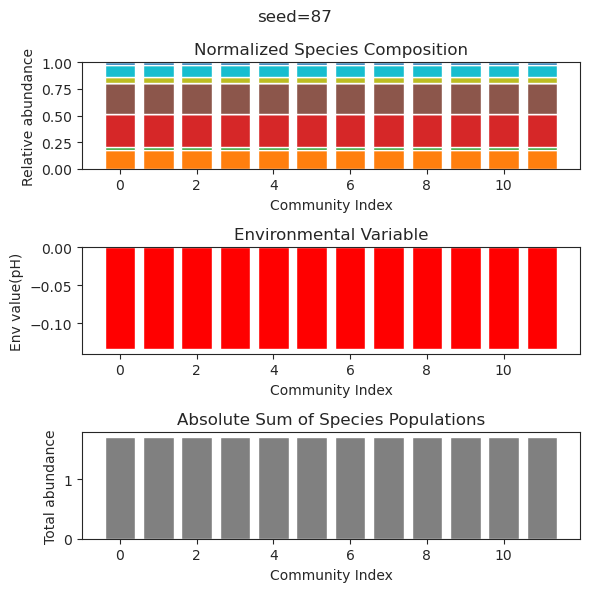

{'species': array([7.69592161e-286, 5.87276135e-007, 6.42285340e-323, 1.69076741e-001,
       4.68526048e-001, 4.34718384e-001, 4.25510580e-010, 5.73771215e-012,
       1.42594179e-006, 1.72125449e-184, 3.24745481e-001, 6.12770050e-021]), 'env': array([-0.72821498])}
{'species': array([7.69592161e-286, 5.87276135e-007, 6.42285340e-323, 1.69076741e-001,
       4.68526048e-001, 4.34718384e-001, 4.25510580e-010, 5.73771215e-012,
       1.42594179e-006, 1.72125449e-184, 3.24745481e-001, 6.12770050e-021]), 'env': array([-0.72821498])}
{'species': array([-1.18575755e-322,  6.99974662e-001, -9.88131292e-324,
        3.29438461e-001,  3.30262280e-015,  1.14539040e-001,
        5.15257780e-013,  5.58443883e-001,  3.88311603e-008,
        8.96743665e-221,  1.01165768e-006,  5.61560527e-001]), 'env': array([0.07351707])}
{'species': array([-1.04099632e-320,  4.46240025e-002, -9.88131292e-324,
        2.65291896e-001,  5.47608355e-001,  6.66954628e-001,
        7.83936095e-003,  1.50435066e-001,  

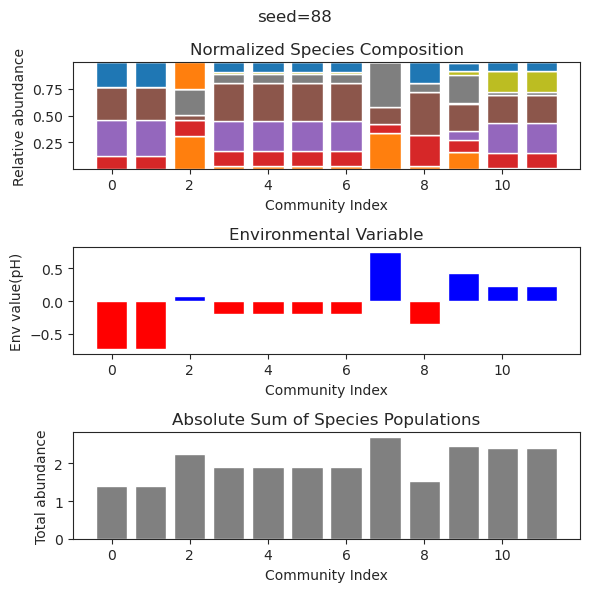

{'species': array([-8.46220210e-64, -1.89575140e-35, -7.97799865e-34,  1.86972966e-76,
        1.81358443e-01,  2.11257944e-29,  1.67972564e-01, -2.44091676e-75,
        6.92234107e-05,  1.04282420e-28,  5.75740589e-01,  2.96818847e-01]), 'env': array([-1.4405894])}
{'species': array([ 4.07428083e-26, -4.51936051e-33,  3.74640596e-31, -2.20361418e-27,
        1.81374569e-01,  3.00670172e-26,  1.67957282e-01,  2.62555360e-76,
        1.13133141e-04,  1.29646283e-26,  5.75725525e-01,  2.96792453e-01]), 'env': array([-1.4406532])}
{'species': array([ 1.58917498e-25,  2.09119366e-29,  1.77436384e-25,  2.71279171e-31,
        1.81369157e-01,  7.08046488e-27,  1.67962411e-01, -1.38299218e-65,
        9.83997264e-05, -2.54210300e-25,  5.75730579e-01,  2.96801310e-01]), 'env': array([-1.44063179])}
{'species': array([3.15408739e-27, 2.46949804e-32, 1.70492749e-29, 1.99108021e-76,
       1.81359969e-01, 2.54987036e-26, 1.67971118e-01, 1.07725365e-65,
       7.33805973e-05, 1.82950474e-25, 5.757

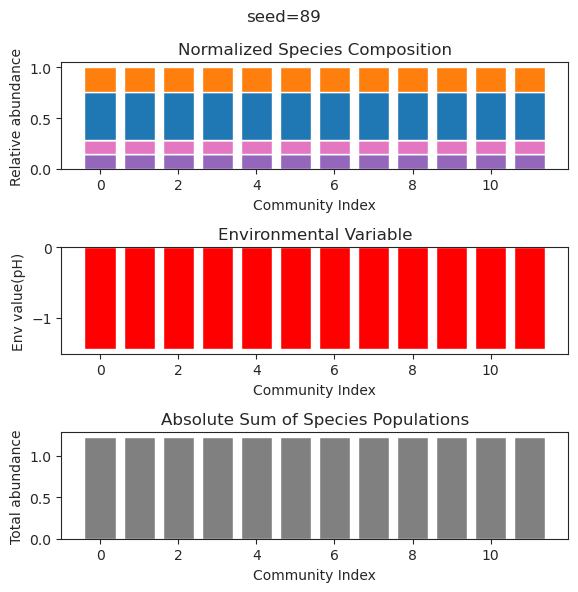

{'species': array([ 5.58969603e-01,  1.73038680e-69, -1.11323770e-44,  7.13479953e-69,
       -2.85304040e-71,  2.85944455e-01,  2.59947381e-01, -1.33226212e-35,
        6.08787181e-01,  3.12348746e-02, -2.06615126e-61,  7.62730537e-58]), 'env': array([-0.48894063])}
{'species': array([ 5.58969614e-01,  4.45273559e-33,  8.69252687e-74, -1.58524747e-93,
       -2.96931722e-35,  2.85944456e-01,  2.59947384e-01,  2.02534888e-52,
        6.08787187e-01,  3.12348502e-02, -7.82104908e-83,  1.11350340e-83]), 'env': array([-0.48894064])}
{'species': array([ 1.45331744e-01, -1.12648475e-18, -1.07595036e-42,  7.08779573e-33,
        9.64962826e-39,  9.57007128e-63,  8.20560025e-41,  6.91115588e-01,
        7.98411273e-01, -1.17203013e-50,  6.17343311e-61,  7.66902627e-58]), 'env': array([-0.9729958])}
{'species': array([ 1.45331744e-01, -2.43609368e-20, -1.45119523e-35,  3.04327126e-33,
       -6.97704281e-35,  2.07672133e-33,  3.26531504e-30,  6.91115588e-01,
        7.98411273e-01,  2.08211626

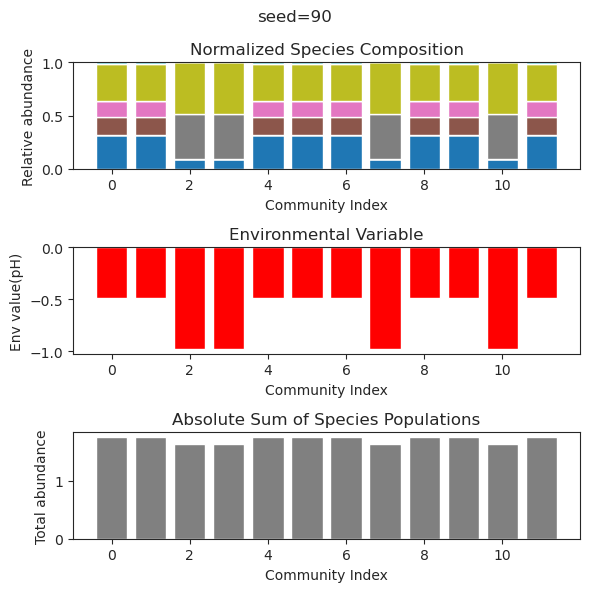

{'species': array([ 1.11067032e-26,  5.50632108e-01,  7.11984319e-01,  5.45245772e-47,
       -1.23252670e-23, -2.12707595e-34,  1.35996643e-36, -1.09542731e-49,
        9.73567841e-01, -1.04766204e-22, -8.92566118e-43,  6.17568975e-20]), 'env': array([0.44896949])}
{'species': array([ 4.56786428e-32,  5.50632108e-01,  7.11984319e-01, -9.10779040e-62,
        9.48245627e-28,  4.26884810e-41,  1.20087765e-41,  1.13566050e-66,
        9.73567841e-01,  2.14061960e-27,  1.25352070e-51,  6.78344727e-20]), 'env': array([0.44896949])}
{'species': array([-4.36386173e-24,  5.50632108e-01,  7.11984319e-01, -1.16540189e-35,
        5.01124013e-22, -1.04657510e-28,  2.32248559e-29, -1.21559980e-40,
        9.73567841e-01,  6.40182386e-22,  1.38959399e-32,  1.30996080e-16]), 'env': array([0.44896949])}
{'species': array([ 1.94161097e-29,  5.50632108e-01,  7.11984319e-01,  8.09066741e-51,
       -1.92408087e-26,  3.26766497e-36,  5.31809381e-48,  6.10281474e-51,
        9.73567841e-01, -1.52635625e-

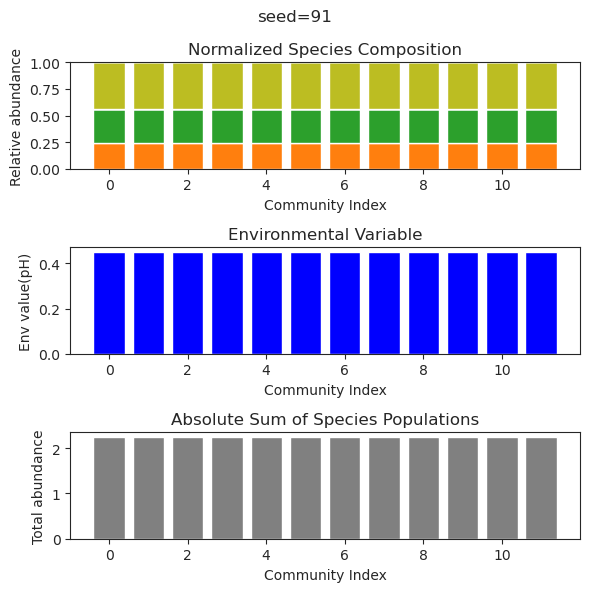

{'species': array([ 4.03725236e-13,  1.49631353e-36,  6.29552031e-01,  3.90281814e-86,
        7.27024641e-01,  1.15095809e-03,  1.54949877e-01,  1.37269545e-79,
        1.55515343e-85, -9.91864350e-40,  2.17044918e-77, -6.19044751e-66]), 'env': array([-0.96829599])}
{'species': array([ 2.69689099e-12,  3.82620330e-40,  6.29551796e-01, -1.60114016e-45,
        7.27025323e-01,  1.14960867e-03,  1.54950085e-01, -3.86469118e-42,
       -6.83486973e-49, -2.74695839e-39,  3.23743920e-43, -2.95331786e-43]), 'env': array([-0.96829822])}
{'species': array([ 2.53238993e-14,  2.42014727e-35,  6.29353435e-01, -5.30934922e-52,
        7.27607294e-01,  1.28281243e-08,  1.55127495e-01, -4.84819642e-43,
       -3.59707208e-36, -1.01057969e-46, -1.14808325e-36,  6.49219831e-32]), 'env': array([-0.97017818])}
{'species': array([ 6.65613328e-16,  1.12983687e-38,  6.29353432e-01, -3.92817823e-64,
        7.27607300e-01,  1.78195168e-13,  1.55127497e-01,  2.41742976e-51,
       -1.15346344e-38,  2.6100724

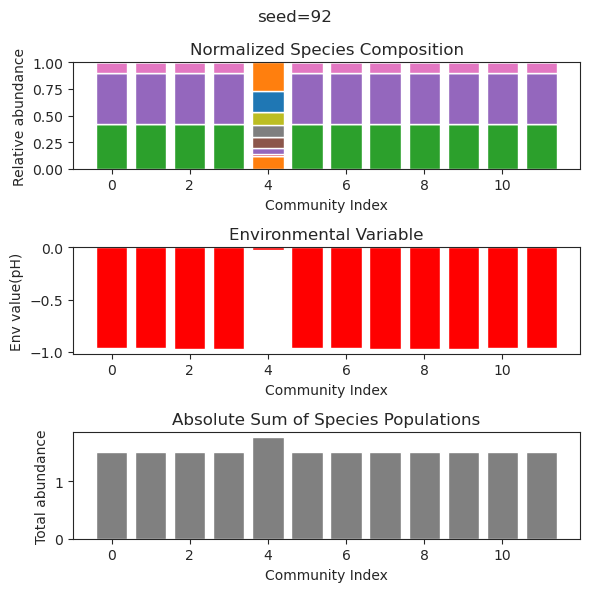

{'species': array([ 6.27333656e-26,  7.32929556e-11,  2.01343127e-44,  1.42191287e-01,
        2.36183134e-42,  6.95767745e-01,  2.61168919e-01,  2.45360981e-38,
        3.57202381e-01, -8.22557470e-85,  1.62629633e-01,  8.64392088e-02]), 'env': array([-1.16616198])}
{'species': array([ 2.36261554e-31,  5.28502845e-10, -3.26215110e-46,  1.42191287e-01,
        3.04765404e-39,  6.95767745e-01,  2.61168919e-01, -1.93519144e-36,
        3.57202381e-01, -5.36504059e-41,  1.62629633e-01,  8.64392090e-02]), 'env': array([-1.16616198])}
{'species': array([ 1.53758717e-23,  7.14437373e-10, -3.96053142e-36,  1.42191286e-01,
        8.37133797e-39,  6.95767744e-01,  2.61168920e-01,  9.03241388e-32,
        3.57202381e-01,  9.75442636e-65,  1.62629633e-01,  8.64392091e-02]), 'env': array([-1.16616198])}
{'species': array([-2.85145659e-24,  6.76237340e-11, -3.51480250e-37,  1.42191287e-01,
        1.04467787e-28,  6.95767745e-01,  2.61168919e-01, -1.20905324e-25,
        3.57202381e-01, -4.4326699

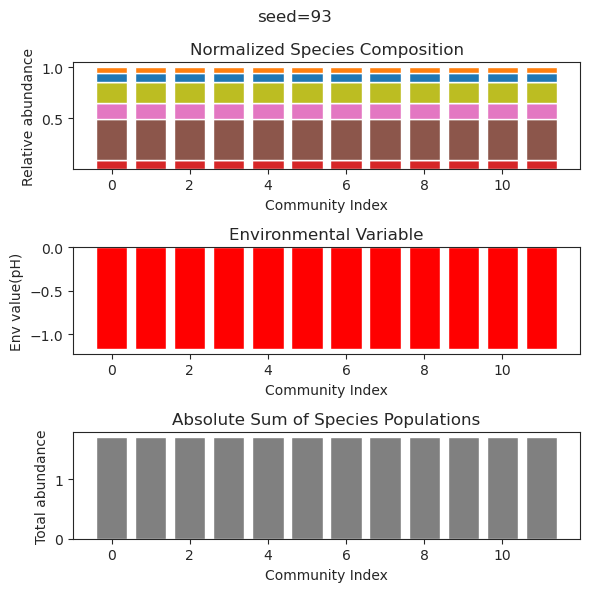

{'species': array([-5.20887806e-51, -7.96402003e-50,  6.48927431e-01,  7.91163300e-35,
        6.41103260e-31,  7.82333241e-17, -1.95453669e-22,  9.11061852e-02,
        4.92975735e-01, -3.89042206e-48,  6.37045530e-25,  1.43394792e-01]), 'env': array([-0.78185733])}
{'species': array([-2.09036541e-45,  3.23238498e-43,  6.48927431e-01, -3.53061939e-33,
       -3.16150855e-28,  1.19713651e-16,  7.28739068e-25,  9.11061852e-02,
        4.92975735e-01,  3.61786639e-44,  5.93585743e-25,  1.43394792e-01]), 'env': array([-0.78185733])}
{'species': array([ 1.06555073e-47,  9.05758057e-47,  6.48927431e-01, -1.62835684e-34,
       -5.55118824e-29,  1.21491597e-16,  5.42446220e-24,  9.11061852e-02,
        4.92975735e-01,  2.43695792e-47,  2.26891810e-24,  1.43394792e-01]), 'env': array([-0.78185733])}
{'species': array([ 2.85817855e-54,  4.04434414e-55,  6.48927431e-01, -4.47836317e-46,
        3.06009918e-32, -1.04000089e-17,  9.21140531e-25,  9.11061852e-02,
        4.92975735e-01,  5.1111774

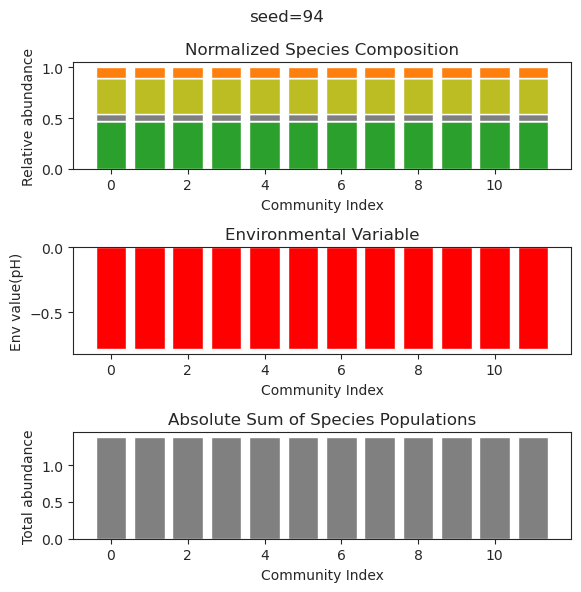

{'species': array([-9.53382491e-24,  6.91881693e-35,  8.78174601e-01,  3.86026597e-50,
        7.20234605e-56,  1.13179001e-38, -2.55300130e-56,  9.84196011e-55,
        1.01085317e-59, -4.98066778e-14, -2.02977886e-47,  5.10661187e-01]), 'env': array([-2.46011124])}
{'species': array([-1.13971029e-29,  4.81968367e-35,  8.78174601e-01,  5.25282027e-42,
        8.41824785e-48,  1.17556701e-39, -6.38193013e-48,  4.61897822e-44,
       -2.70078972e-36,  3.40627001e-16,  3.50611780e-44,  5.10661187e-01]), 'env': array([-2.46011124])}
{'species': array([ 1.52810249e-23, -1.90939426e-37,  8.78174601e-01,  1.21591383e-49,
        1.71982408e-68,  8.92949231e-41,  3.21776503e-64,  4.33696357e-58,
        7.16304933e-74, -3.93158821e-14,  2.50329995e-45,  5.10661187e-01]), 'env': array([-2.46011124])}
{'species': array([ 7.40368872e-27, -1.96558891e-33,  8.78174601e-01,  1.98833216e-48,
       -2.87959752e-58, -7.55083785e-36,  6.36589728e-59, -4.45591818e-37,
        4.42918976e-40, -5.0139252

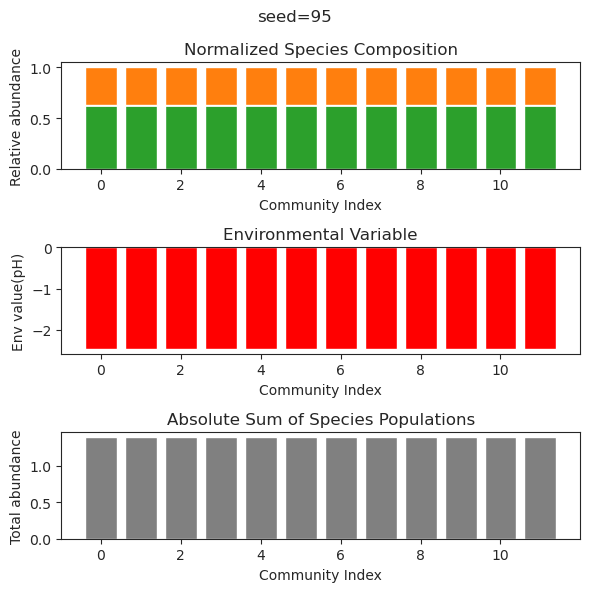

{'species': array([ 4.57976570e-01,  5.32756834e-43, -2.26794387e-43, -5.89872620e-14,
        1.05952518e-42,  1.12421688e-31,  4.40110531e-01,  3.03570267e-41,
        2.47697178e-26, -9.88893042e-57,  6.43853348e-42,  7.84114536e-01]), 'env': array([-0.30351892])}
{'species': array([ 4.57976570e-01, -1.42174193e-64,  2.43319275e-57, -3.29239646e-16,
        6.18118773e-35,  1.30371193e-21,  4.40110531e-01,  6.17102984e-41,
       -6.36205570e-22,  8.88372620e-61,  4.46888434e-34,  7.84114536e-01]), 'env': array([-0.30351892])}
{'species': array([ 4.57976570e-01,  2.12406909e-53,  5.15532331e-46,  1.74359407e-16,
       -3.41128250e-32, -2.90710169e-20,  4.40110531e-01, -6.39550257e-36,
       -2.16223311e-18,  1.53685965e-50, -3.05668845e-30,  7.84114536e-01]), 'env': array([-0.30351892])}
{'species': array([ 4.57976570e-01,  5.84425365e-82, -1.14197202e-80,  2.71970941e-14,
        5.55403868e-47,  5.66529451e-22,  4.40110531e-01, -6.21321043e-47,
       -8.50322135e-16,  8.0595756

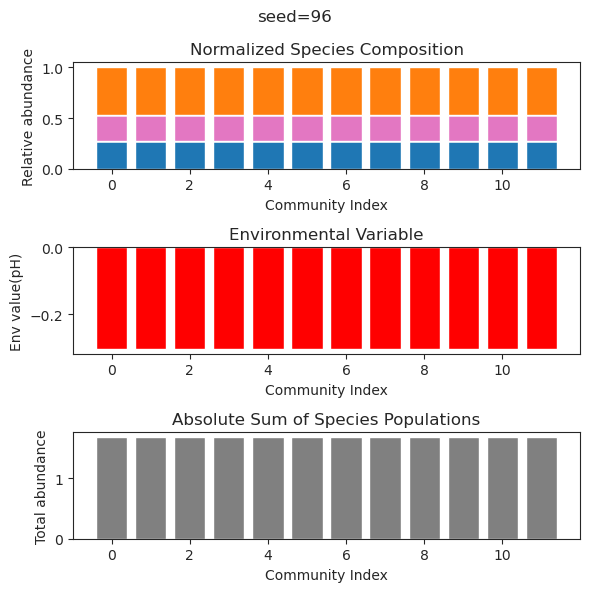

{'species': array([ 7.67263708e-24,  5.84743525e-01,  9.97283994e-02,  3.83612365e-42,
       -3.66645338e-29,  1.98222945e-01, -6.66644265e-42,  1.15341256e-01,
       -1.23439512e-18, -5.82622967e-42, -3.39613137e-38,  1.40636922e-27]), 'env': array([-1.11550533])}
{'species': array([-1.56701589e-20,  5.84743525e-01,  9.97283994e-02,  4.11030238e-52,
       -1.11272529e-35,  1.98222945e-01,  4.03967894e-58,  1.15341256e-01,
        4.23857702e-15,  3.78664251e-58,  3.24029146e-46,  3.29379233e-24]), 'env': array([-1.11550533])}
{'species': array([-1.83405868e-19,  5.84743525e-01,  9.97283994e-02, -2.50746187e-46,
        8.80387334e-37,  1.98222945e-01,  3.34112916e-50,  1.15341256e-01,
       -2.42500775e-14,  7.60057953e-50, -6.13486785e-41, -8.73258470e-24]), 'env': array([-1.11550533])}
{'species': array([-2.19262294e-21,  5.84743525e-01,  9.97283994e-02, -9.52552682e-44,
       -2.85572773e-38,  1.98222945e-01, -5.62638704e-47,  1.15341256e-01,
       -7.92761609e-15,  1.1827997

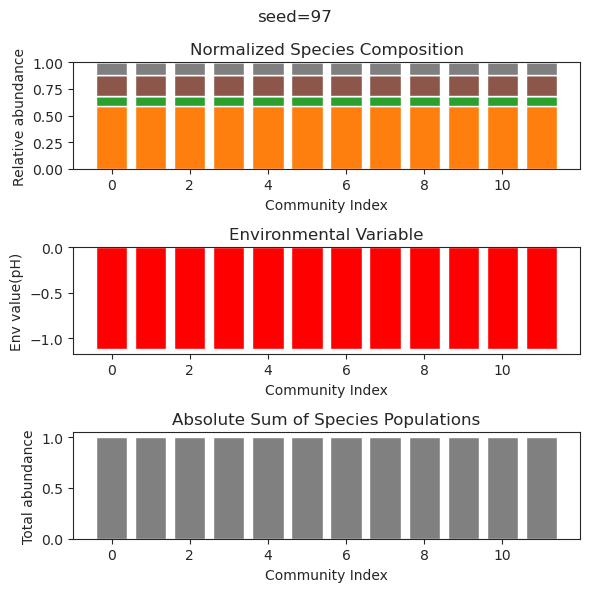

{'species': array([ 2.30604782e-01,  6.95017239e-34,  2.77740847e-48,  2.18563544e-01,
        2.38007423e-01,  2.06328881e-13,  6.09303891e-01,  1.43887696e-01,
       -9.67281223e-87,  2.85462870e-02,  2.51306144e-55,  5.91941222e-02]), 'env': array([-0.59533831])}
{'species': array([ 2.30604785e-01, -1.01062991e-34, -4.68275102e-43,  2.18563543e-01,
        2.38007423e-01,  2.27755316e-09,  6.09303892e-01,  1.43887695e-01,
        2.24659518e-79,  2.85462894e-02,  4.22225561e-64,  5.91941193e-02]), 'env': array([-0.5953383])}
{'species': array([ 2.30603343e-01,  8.42400941e-33,  1.25388740e-36,  2.18563065e-01,
        2.38008564e-01,  8.23251116e-25,  6.09301494e-01,  1.43888875e-01,
       -4.93961261e-92,  2.85445201e-02,  2.49563375e-62,  5.91982758e-02]), 'env': array([-0.59533884])}
{'species': array([ 2.30604782e-01,  8.22607111e-35,  2.19102621e-42,  2.18563536e-01,
        2.38007420e-01,  4.57593297e-15,  6.09303903e-01,  1.43887704e-01,
       -1.06643847e-40,  2.85462825

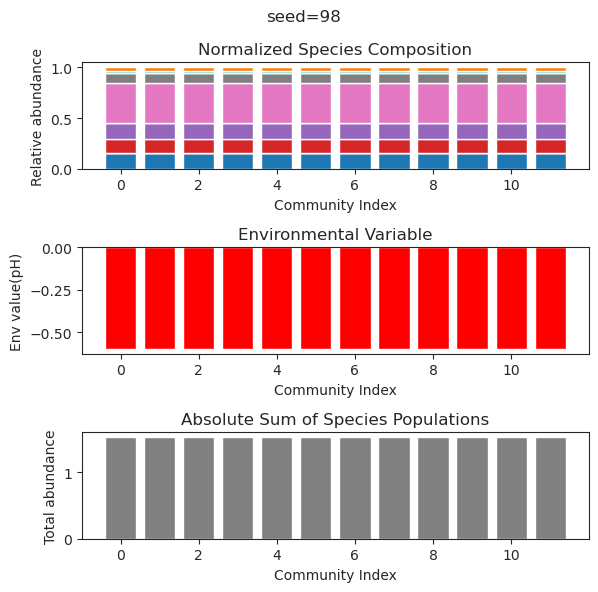

{'species': array([4.93487271e-099, 7.92737751e-147, 7.61923615e-001, 8.71931865e-055,
       1.03833393e-001, 1.34952775e-001, 4.81122289e-154, 3.06324590e-001,
       2.52899492e-001, 1.38708734e-001, 1.16783570e-066, 5.54342172e-001]), 'env': array([0.26592134])}
{'species': array([ 6.40405256e-112, -1.79617778e-175,  7.61923615e-001,
        1.68989916e-056,  1.03833393e-001,  1.34952775e-001,
        5.74014683e-179,  3.06324590e-001,  2.52899492e-001,
        1.38708734e-001,  6.64464028e-075,  5.54342172e-001]), 'env': array([0.26592134])}
{'species': array([ 3.08480213e-127,  3.44333852e-187,  7.61923615e-001,
       -1.38147525e-049,  1.03833393e-001,  1.34952775e-001,
        8.70332684e-198,  3.06324590e-001,  2.52899492e-001,
        1.38708734e-001, -2.36246684e-074,  5.54342172e-001]), 'env': array([0.26592134])}
{'species': array([-1.23216159e-113, -4.05964493e-183,  7.61923615e-001,
       -6.13302422e-058,  1.03833393e-001,  1.34952775e-001,
        8.11868954e-186,  3

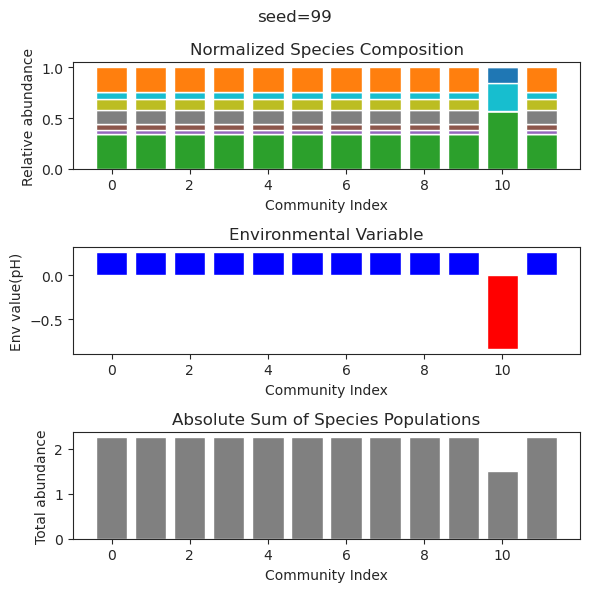

In [11]:
session_path='Results_ptailed/Session_Test4'
to_save={}
description=''
simulated_result={}

for seed_num in range(100):
    if not os.path.isdir(session_path):
        os.mkdir(session_path)
    # functions for uniform 

    f_I = lambda : uniform_distribution(0.5,0.5)
    f_g = lambda : np.ones(1)
    f_k = lambda : np.ones(1)
    f_p = lambda : custom_distribution(3,1)
    f_q = lambda : uniform_distribution(0.5,0.5)
    f_beta = lambda : np.ones(1)
    seed_num=seed_num
    to_plot=True

    np.random.seed(seed_num)

    N=12
    N_env=1


    I = np.zeros((N, N))
    for i in range(N):
        for j in range(N):
            I[i,j] = f_I()
    for i in range(N):
        I[i,i] =1

    g = np.zeros((N))
    for i in range(N):
        g[i] = f_g()

    k = np.zeros((N))
    for i in range(N):
        k[i] = f_k()   

    p = np.zeros((N_env, N))
    for i in range(N_env):
        for j in range(N):
            p[i,j] = f_p()


    q = np.zeros((N, N_env))
    for i in range(N):
        for j in range(N_env):
            q[i,j] = f_q()




    beta = np.zeros(N_env)
    for i in range(N_env):
        beta[i]=f_beta()

    delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
    migration_rate=0#1e-7
    system_config = {
        'I': I,
        'g': g,
        'k': k,
        'p': p,
        'q': q,
        'beta': beta,
        'delta': delta,
        'migration_rate' : migration_rate,
        'N': N,
        'N_env': N_env,
        'seed_num':seed_num,
    } 

    file_path = f'{session_path}/system_config.json'

    label="test"
    sys
    ##

    y_out_list=[]
    system_config['beta'] = np.array([0.99])*delta

    for i in range(N):

        species_index=np.arange(0,N)
        env_index=np.array([0])
        y0_species=one_hot_vector(N,i)
        y0_env=[0]
        t=np.linspace(0, 2000, 10000)

        y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False)

        y_out_list.append(y_out)

    num_datasets = len(y_out_list)

    # Prepare subplots
    fig, axs = plt.subplots(3, 1, figsize=(6, 6))

    # Data for plots
    species_matrix = np.array([y_out['species'] for y_out in y_out_list])
    env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

    # Normalize species data
    species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
    species_sums = np.sum(species_matrix, axis=1, keepdims=True)
    normalized_species = species_matrix / species_sums

    # Absolute sums of species data (sum across all species for each dataset)
    absolute_sums = np.sum(species_matrix, axis=1)
    simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

    if to_plot:
        plt.suptitle(f'seed={seed_num}')

        # Plotting species composition as stacked bars
        bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
        for i in range(normalized_species.shape[1]):  # Loop through each species
            axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
            bottom_values += normalized_species[:, i]  # Update bottom values for stacking

        axs[0].set_title('Normalized Species Composition')
        axs[0].set_xlabel('Community Index')
        axs[0].set_ylabel('Relative abundance')
        #axs[0].legend()

        # Plotting environmental factors
        colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
        axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
        axs[1].set_title('Environmental Variable')
        axs[1].set_xlabel('Community Index')
        axs[1].set_ylabel('Env value(pH)')

        # Plotting absolute sums of species data
        axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
        axs[2].set_title('Absolute Sum of Species Populations')
        axs[2].set_xlabel('Community Index')
        axs[2].set_ylabel('Total abundance')

        plt.tight_layout()
        plt.savefig(session_path+f'/diagram_{seed_num}.png')

        #if to_plot:
        #    plt.savefig()


        plt.show()
#simulated_result = {'a': 1, 'b': 2, 'c': 3}  # Your existing dictionary
#description = "This is a description of the simulated result."

# Combine both into a new dictionary
data_to_save = {
    'result': simulated_result,
    'description': description
}
# Serialize the combined data to a pickle file
with open(session_path+'/result_and_description.pkl', 'wb') as file:
    pickle.dump(data_to_save, file)

{'species': array([-2.12160092e-48,  2.66642290e-01, -1.72609676e-51,  9.21782534e-01,
        1.60004583e-68, -1.53384869e-39, -2.98686343e-46,  9.13944303e-68,
       -3.59189579e-74, -5.16350317e-34,  6.15692094e-01, -1.47435706e-34]), 'env': array([-1.84457124])}
{'species': array([-1.44169713e-50,  2.66642290e-01, -2.00901225e-52,  9.21782534e-01,
       -1.93918154e-73,  4.06512381e-40,  2.86331476e-47,  1.52953130e-71,
       -1.90767302e-71, -2.46680411e-33,  6.15692094e-01,  3.41245747e-34]), 'env': array([-1.84457124])}
{'species': array([ 8.39408688e-43,  2.66642290e-01,  3.11798028e-43,  9.21782534e-01,
        2.61242454e-60, -1.78315193e-36, -4.06004788e-43,  1.80032610e-59,
       -9.14204723e-68,  1.01378836e-33,  6.15692094e-01, -1.12791108e-32]), 'env': array([-1.84457124])}
{'species': array([-4.32808797e-64, -5.23325359e-58,  1.41137532e-44, -1.72102811e-60,
        1.78094896e+00, -4.59533557e-28,  1.75642470e+00,  1.17856054e+00,
        2.45730742e-47,  1.3603415

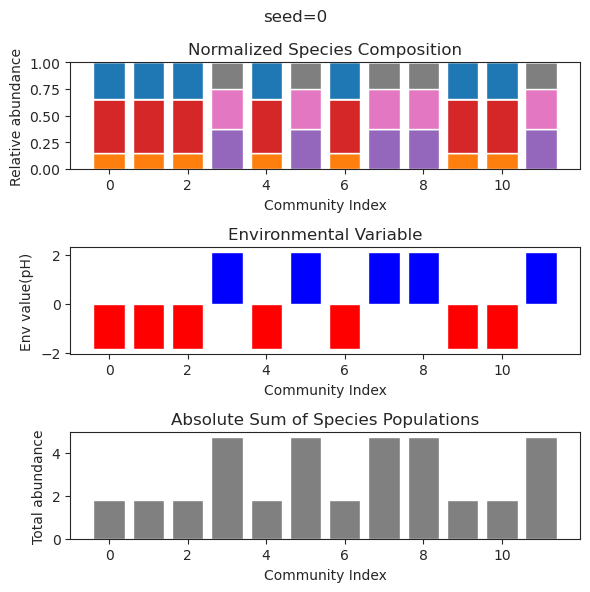

{'species': array([-1.48190309e-77,  8.64079092e-71,  4.13030645e-57, -3.60935060e-75,
        1.78094896e+00,  1.29477064e-32,  1.75642470e+00,  1.17856054e+00,
       -1.60527216e-54, -1.01224153e-46, -5.36198844e-46, -7.21363587e-77]), 'env': array([2.10065594])}
{'species': array([-1.48190309e-77,  8.64079092e-71,  4.13030645e-57, -3.60935060e-75,
        1.78094896e+00,  1.29477064e-32,  1.75642470e+00,  1.17856054e+00,
       -1.60527216e-54, -1.01224153e-46, -5.36198844e-46, -7.21363587e-77]), 'env': array([2.10065594])}


{'species': array([-1.48190309e-77,  8.64079092e-71,  4.13030645e-57, -3.60935060e-75,
        1.78094896e+00,  1.29477064e-32,  1.75642470e+00,  1.17856054e+00,
       -1.60527216e-54, -1.01224153e-46, -5.36198844e-46, -7.21363587e-77]), 'env': array([2.10065594])}
{'species': array([-1.48190309e-77,  8.64079092e-71,  4.13030645e-57, -3.60935060e-75,
        1.78094896e+00,  1.29477064e-32,  1.75642470e+00,  1.17856054e+00,
       -1.60527216e-54, -1.01224153e-46, -5.36198844e-46, -7.21363587e-77]), 'env': array([2.10065594])}
{'species': array([-1.48190309e-77,  8.64079092e-71,  4.13030645e-57, -3.60935060e-75,
        1.78094896e+00,  1.29477064e-32,  1.75642470e+00,  1.17856054e+00,
       -1.60527216e-54, -1.01224153e-46, -5.36198844e-46, -7.21363587e-77]), 'env': array([2.10065594])}
{'species': array([ 1.24136714e-001,  4.09815374e-101,  1.12130915e-032,
        2.43684682e-184,  5.35371603e-041,  6.23551266e-198,
       -6.71247840e-250, -7.51463269e-139,  6.13119612e-001,
    

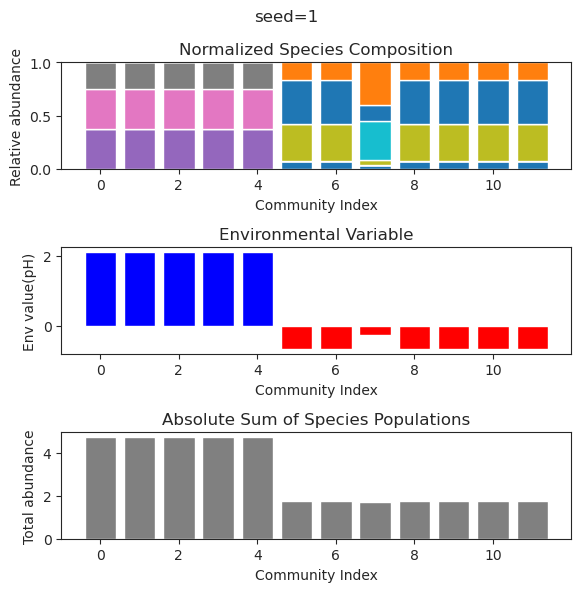

{'species': array([ 3.00268323e-17,  2.50383092e-01, -1.10232108e-68,  1.98458696e-01,
       -2.07998923e-24,  1.04162376e-40, -5.16162314e-67,  1.23790998e-01,
        4.38717362e-62, -5.08674291e-24,  8.01769218e-46,  6.64773062e-01]), 'env': array([-2.59864887])}
{'species': array([-5.25243770e-17,  2.50383092e-01, -9.66191013e-74,  1.98458696e-01,
       -1.06050653e-30,  9.80016799e-46,  2.26364456e-70,  1.23790998e-01,
        3.25834967e-63,  1.15962264e-27, -4.51452086e-51,  6.64773062e-01]), 'env': array([-2.59864887])}
{'species': array([-6.48751915e-18,  2.50383092e-01, -3.43712952e-81,  1.98458696e-01,
       -1.95135126e-34, -8.47514279e-44,  6.62229005e-82,  1.23790998e-01,
        8.93423277e-72, -1.71454037e-31,  5.59894079e-53,  6.64773062e-01]), 'env': array([-2.59864887])}
{'species': array([-1.66647013e-17,  2.50383092e-01,  1.38124898e-97,  1.98458696e-01,
        1.63732754e-33, -1.05876371e-40,  1.38520584e-99,  1.23790998e-01,
       -2.33706453e-88, -3.5161059

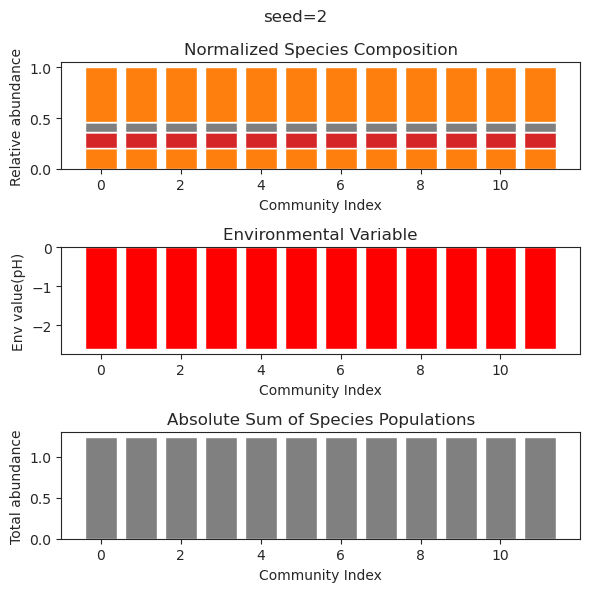

{'species': array([ 1.62398404e-001, -7.83953625e-032,  7.38362574e-001,
        3.76948519e-001,  1.97619174e-063, -3.97275891e-107,
       -3.72525660e-101, -7.49839581e-098,  1.10418324e-013,
        3.87502198e-057, -3.05695115e-065,  7.31471632e-001]), 'env': array([-0.48046086])}
{'species': array([ 1.62398404e-01,  4.58386445e-27,  7.38362574e-01,  3.76948519e-01,
        1.66033066e-43,  1.22890915e-89,  3.13872572e-81, -1.82663009e-79,
        1.14711448e-12,  1.07639656e-45,  2.61945547e-58,  7.31471632e-01]), 'env': array([-0.48046086])}
{'species': array([ 1.62398404e-01,  1.29468759e-26,  7.38362574e-01,  3.76948519e-01,
        9.21423758e-51, -2.21423157e-71, -1.98055464e-70, -2.66922018e-72,
        8.24454174e-13, -2.13119731e-47, -1.00357420e-47,  7.31471632e-01]), 'env': array([-0.48046086])}
{'species': array([ 1.62398404e-01,  1.58521622e-28,  7.38362574e-01,  3.76948519e-01,
       -1.43024434e-54,  1.16701225e-38,  2.08796099e-75,  1.95394221e-76,
        8.24550

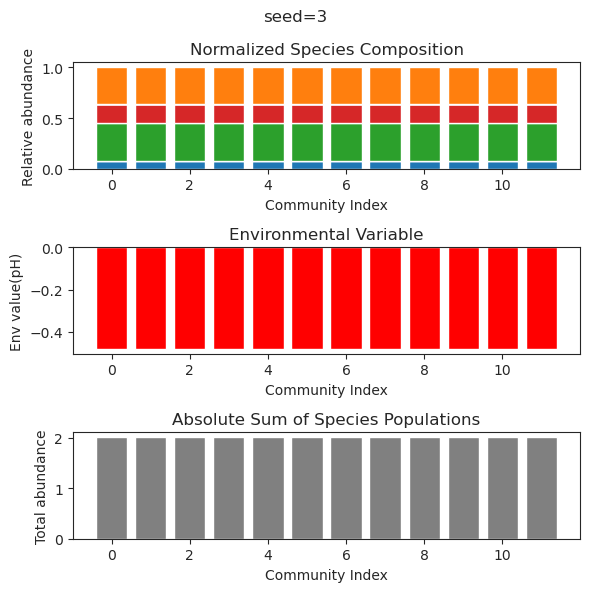

{'species': array([-5.26635266e-28,  3.21738869e-01,  2.23841399e-01,  1.83830082e-46,
        1.95110081e-31,  1.06791488e-58,  1.76509850e-01,  1.40212443e-18,
        9.67900642e-34,  1.11641672e-30, -4.29010261e-25,  2.93522477e-58]), 'env': array([-3.16895885])}
{'species': array([ 7.97712214e-29,  3.21738869e-01,  2.23841399e-01,  1.97175132e-54,
        2.15207340e-33,  8.12624263e-69,  1.76509850e-01, -2.13694547e-20,
       -7.02573677e-42,  6.14210551e-37,  5.76114897e-31,  2.05427573e-69]), 'env': array([-3.16895885])}
{'species': array([-9.21377056e-26,  3.21738869e-01,  2.23841399e-01, -3.02348170e-34,
        3.88795942e-28,  1.53015607e-37,  1.76509850e-01, -4.11437985e-17,
       -6.49549011e-32, -2.09634418e-31,  1.80839520e-31,  5.94590213e-40]), 'env': array([-3.16895885])}
{'species': array([ 4.20264532e-25,  3.21738869e-01,  2.23841399e-01, -4.17890529e-35,
        1.98457092e-24, -9.25261374e-42,  1.76509850e-01,  7.84094809e-19,
        1.42239195e-29, -5.6787157

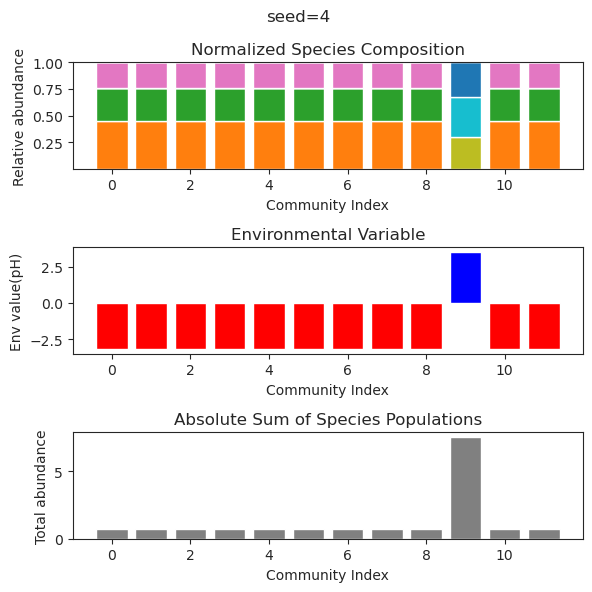

{'species': array([ 9.78759304e-30,  2.74153434e-01, -4.70017836e-18,  9.95002942e-34,
        6.54637053e-40,  2.74177741e-22,  2.57688887e-52, -5.76649934e-42,
       -6.40378788e-30, -6.10653072e-32, -5.05166881e-43,  7.87133417e-01]), 'env': array([-2.63119407])}
{'species': array([-9.12674913e-38,  2.74153434e-01,  6.14290098e-20, -1.04174635e-32,
       -4.56535312e-51, -1.18149765e-25,  2.33625746e-61,  4.97935751e-57,
       -2.90623993e-28, -4.35710600e-29, -1.89543057e-56,  7.87133417e-01]), 'env': array([-2.63119407])}
{'species': array([-3.36762551e-34,  2.74153434e-01,  9.41040566e-21, -2.88911116e-33,
       -9.85657271e-46, -9.34384970e-25,  2.79664599e-57,  4.92368760e-47,
       -1.40698341e-31, -8.94583119e-30,  1.38966192e-48,  7.87133417e-01]), 'env': array([-2.63119407])}
{'species': array([ 3.35704717e-35,  2.74153434e-01,  1.09770126e-19, -1.26919341e-28,
        2.45953620e-43, -3.78194095e-24, -2.48871370e-58,  1.74065380e-48,
        2.17095174e-26,  3.2821007

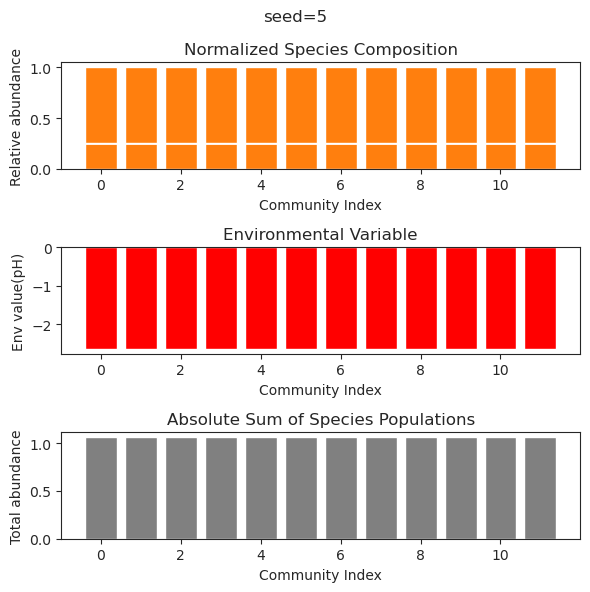

{'species': array([ 5.51199751e-002, -1.05554162e-113,  3.95854445e-102,
       -5.78526364e-087, -2.37784894e-057,  2.79648943e-017,
        5.29297795e-037,  6.09846999e-001,  8.46206294e-020,
        6.72401557e-001,  5.64222687e-001,  6.80444943e-117]), 'env': array([-0.11839601])}
{'species': array([ 5.51199751e-002, -3.82896076e-110, -6.15555229e-099,
        1.75914688e-084, -4.17453070e-056,  5.98732963e-018,
       -2.57005622e-033,  6.09846999e-001, -1.42367543e-019,
        6.72401557e-001,  5.64222687e-001, -4.10771659e-114]), 'env': array([-0.11839601])}
{'species': array([ 5.51199751e-02, -8.80125501e-98,  1.86484294e-93,  1.01034328e-76,
        5.51787835e-51, -4.71239481e-17, -3.51148800e-29,  6.09846999e-01,
       -2.55250331e-17,  6.72401557e-01,  5.64222687e-01, -5.30692021e-95]), 'env': array([-0.11839601])}
{'species': array([ 5.51199751e-002, -9.30028866e-117,  6.19259588e-104,
       -2.39000640e-085,  2.85746865e-058,  1.27995434e-016,
       -2.81863768e-036,

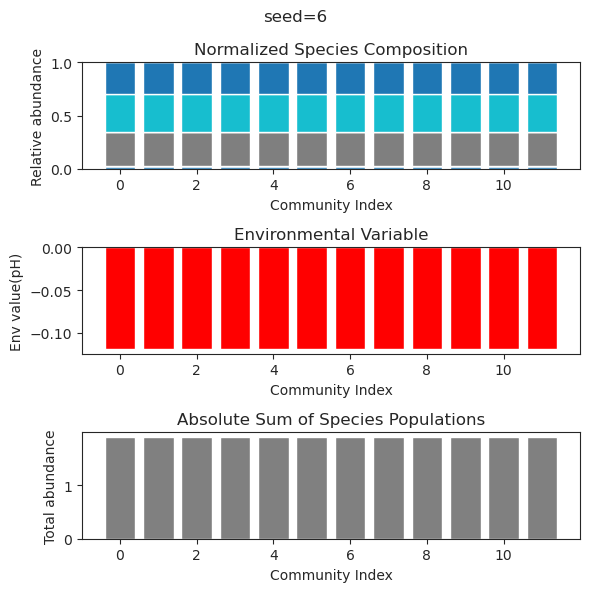

{'species': array([ 4.37828511e-74,  1.54003841e-01,  3.60867169e-31,  3.41994033e-01,
        1.03429178e+00,  6.04805061e-69, -1.03277534e-82, -6.35970305e-79,
       -4.41208106e-74, -4.18095521e-74, -7.24471927e-70,  1.12768475e-36]), 'env': array([-1.57108942])}
{'species': array([-1.78378023e-72,  1.54003841e-01, -1.13954866e-26,  3.41994033e-01,
        1.03429178e+00,  3.40548732e-66,  8.83803435e-80,  7.51032138e-74,
        2.81879071e-69, -2.41252031e-73,  5.86993239e-66, -2.56106137e-31]), 'env': array([-1.57108942])}
{'species': array([1.26432293e-68, 1.54003841e-01, 4.32055203e-31, 3.41994033e-01,
       1.03429178e+00, 3.61714678e-61, 1.56929736e-74, 9.63340749e-72,
       6.06058959e-66, 2.88502663e-65, 5.70807859e-60, 1.74973564e-32]), 'env': array([-1.57108942])}
{'species': array([ 8.93365651e-89,  6.21779525e-87, -6.35525313e-46,  3.73737486e-89,
       -6.97356517e-87,  8.22297720e-01,  6.87166715e-18,  1.60834295e-87,
       -1.27452176e-68,  6.57534156e-01,  4.90

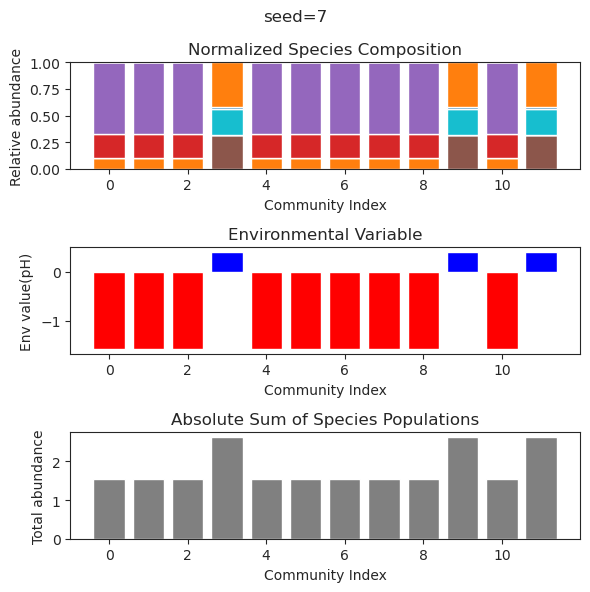

{'species': array([ 1.15060307e-01, -5.82506019e-21,  4.15116685e-75,  1.09908791e-35,
       -9.60187365e-57,  2.05714309e-02, -2.29612290e-49,  5.83743020e-02,
        6.11414391e-01,  6.52070182e-01, -3.59590256e-49, -3.49409100e-26]), 'env': array([-1.14851191])}
{'species': array([1.15060307e-01, 2.14981448e-17, 3.24805889e-75, 4.67044123e-32,
       8.19120197e-58, 2.05714309e-02, 1.23750468e-78, 5.83743020e-02,
       6.11414391e-01, 6.52070182e-01, 7.87286932e-48, 2.54548039e-19]), 'env': array([-1.14851191])}
{'species': array([ 3.19183644e-31,  3.16592110e-32,  1.66937817e+00, -1.47687066e-76,
        6.18610940e-06, -1.98078310e-50,  2.31193494e-23,  2.06941808e-74,
       -1.09381103e-46,  6.64423430e-01,  5.87839705e-34,  6.79481607e-01]), 'env': array([1.51977392])}
{'species': array([ 1.15060307e-001, -9.26624921e-017, -2.11566308e-082,
        1.23904343e-029,  3.70316465e-071,  2.05714309e-002,
        2.44088733e-102,  5.83743020e-002,  6.11414391e-001,
        6.5207

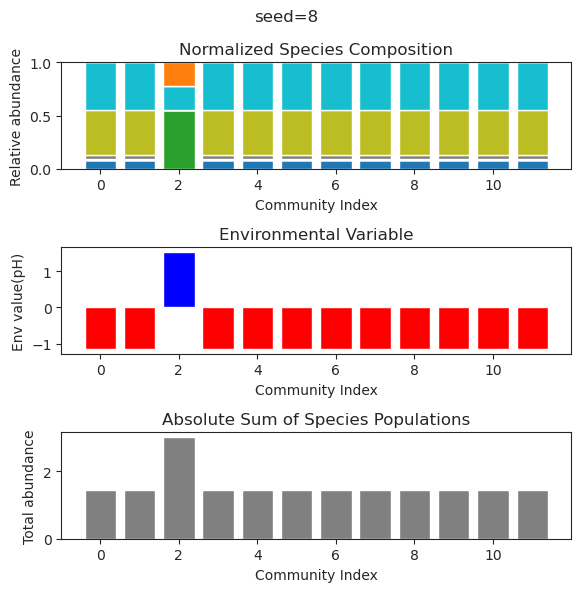

{'species': array([ 2.63462916e-01, -4.14287083e-49, -1.34012912e-31, -1.36519260e-54,
       -2.30473218e-45,  1.36627861e-58, -4.06196545e-44,  1.25790610e+00,
        2.42160327e-01, -7.15252312e-59,  6.08738101e-37, -1.72320405e-44]), 'env': array([-2.02046599])}
{'species': array([ 2.63462916e-01, -1.03000524e-40, -6.10935590e-29, -2.13238390e-46,
        2.61891640e-37, -3.25615651e-51,  1.66574609e-37,  1.25790610e+00,
        2.42160327e-01,  2.57496985e-51, -2.61868423e-34,  4.16028581e-40]), 'env': array([-2.02046599])}
{'species': array([ 2.63462916e-01,  4.78183514e-47,  2.02649357e-31,  2.23491218e-49,
       -7.88305431e-44, -1.66493773e-55, -3.11327041e-43,  1.25790610e+00,
        2.42160327e-01, -1.13844085e-55,  2.48214211e-36, -4.03540070e-44]), 'env': array([-2.02046599])}
{'species': array([ 2.63462916e-01, -1.43493247e-49, -2.30555111e-30,  1.23448048e-51,
        5.94325921e-40, -7.56403655e-54,  1.57457171e-39,  1.25790610e+00,
        2.42160327e-01,  1.7885098

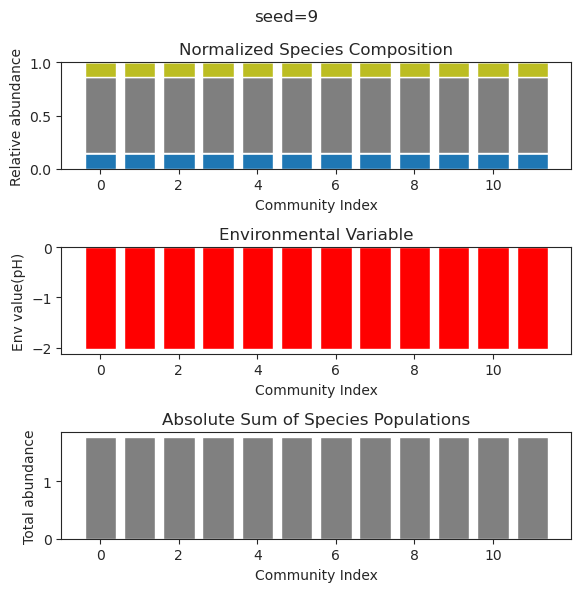

{'species': array([ 1.58133050e-01, -1.30644847e-14,  1.33801758e-35,  1.51583492e-76,
        5.83201343e-01,  1.03785805e+00,  6.48706684e-40, -4.26957620e-69,
        9.26090002e-23, -3.18719909e-44, -3.12740278e-53,  7.78883087e-02]), 'env': array([-1.21785894])}
{'species': array([ 1.58133050e-001,  5.25322136e-017, -3.68182016e-049,
        3.55853858e-107,  5.83201343e-001,  1.03785805e+000,
        3.47739701e-056,  2.67828556e-103,  4.16384451e-029,
        3.23232194e-063,  1.35786963e-079,  7.78883087e-002]), 'env': array([-1.21785894])}
{'species': array([ 1.58133050e-001,  7.21279361e-016, -4.14581171e-048,
        2.04284465e-126,  5.83201343e-001,  1.03785805e+000,
        2.25889933e-047, -1.16759679e-096,  5.71835186e-028,
       -5.40703960e-070, -1.03343155e-074,  7.78883087e-002]), 'env': array([-1.21785894])}
{'species': array([ 1.58133050e-01,  2.19812952e-15,  7.01055267e-42,  3.74806084e-77,
        5.83201343e-01,  1.03785805e+00,  3.04214211e-42, -8.86477526e-

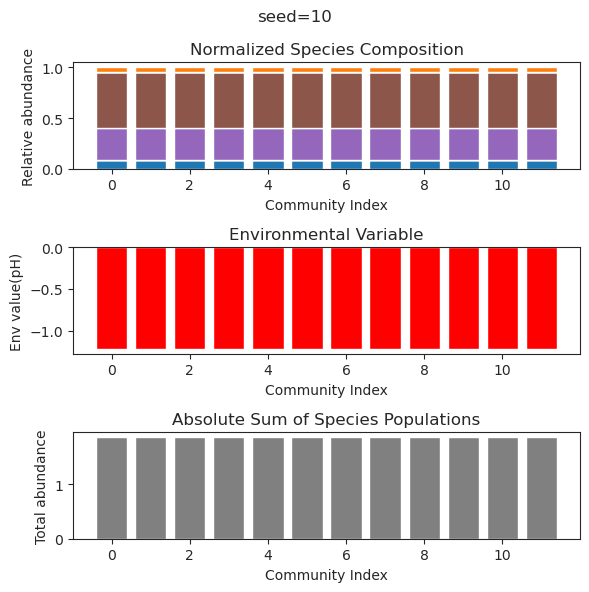

{'species': array([-2.14528618e-56,  1.81379999e-01,  4.11398320e-01, -1.67728087e-39,
        8.36810385e-01,  1.97475855e-32, -3.27665976e-48, -1.33482887e-37,
        5.65310251e-01, -1.33858050e-38, -5.06384292e-39,  2.44382125e-79]), 'env': array([-1.52251901])}
{'species': array([-6.58447945e-59,  1.81379999e-01,  4.11398320e-01, -5.50556276e-43,
        8.36810385e-01, -9.65601766e-35,  8.20460891e-47, -1.15131759e-38,
        5.65310251e-01,  8.64239838e-41, -7.24867662e-42, -1.26871367e-77]), 'env': array([-1.52251901])}
{'species': array([ 7.99070079e-57,  1.81379999e-01,  4.11398320e-01, -3.03584521e-41,
        8.36810385e-01,  1.70658724e-33, -2.36362811e-44, -7.68762574e-39,
        5.65310251e-01,  2.78993283e-36,  5.68516544e-38,  8.35063983e-74]), 'env': array([-1.52251901])}
{'species': array([ 1.25268592e-51,  1.81379999e-01,  4.11398320e-01, -7.74998508e-37,
        8.36810385e-01, -6.90475639e-30,  1.88193673e-39, -2.61582661e-37,
        5.65310251e-01,  2.4638424

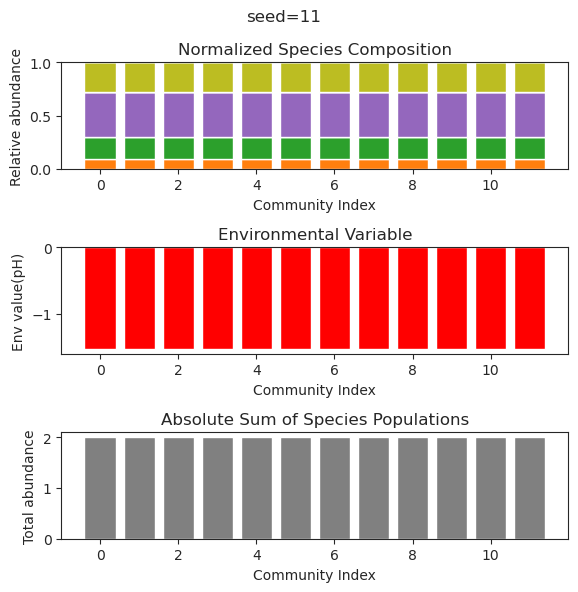

{'species': array([-1.65810444e-092,  1.69106474e-001,  1.35091067e-114,
        1.33219099e-001,  7.57034057e-002, -2.25398010e-105,
        4.88265993e-001,  1.02484510e-070, -2.08001050e-023,
        6.59815941e-112,  1.95230651e-002,  9.52402493e-001]), 'env': array([-1.15616461])}
{'species': array([-6.77311324e-042,  1.69106474e-001, -1.17015388e-134,
        1.33219099e-001,  7.57034057e-002,  3.30577377e-123,
        4.88265993e-001,  7.72033905e-079,  4.21324259e-026,
       -7.24958748e-132,  1.95230651e-002,  9.52402493e-001]), 'env': array([-1.15616461])}
{'species': array([ 2.44053858e-130,  1.69106474e-001, -1.79117262e-131,
        1.33219099e-001,  7.57034057e-002, -1.37761313e-139,
        4.88265993e-001,  1.43545883e-088,  3.85211428e-033,
       -1.95260664e-143,  1.95230651e-002,  9.52402493e-001]), 'env': array([-1.15616461])}
{'species': array([-5.60290160e-116,  1.69106474e-001,  1.20521236e-139,
        1.33219099e-001,  7.57034057e-002, -1.66481764e-128,
     

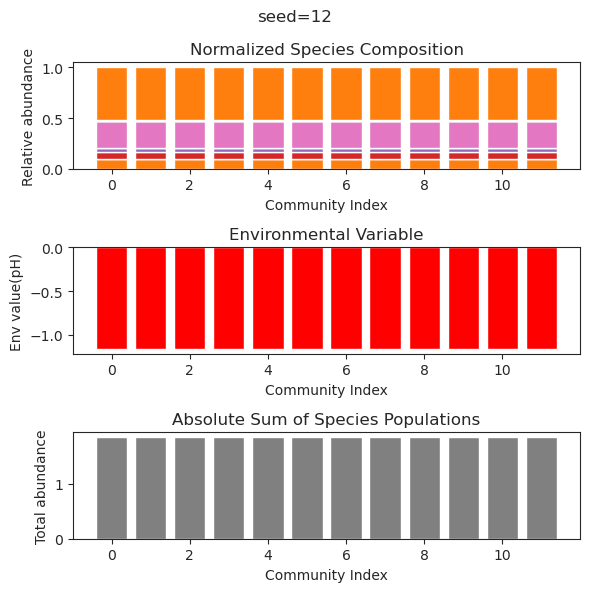

{'species': array([ 8.95730485e-02,  3.05233016e-02, -3.53561753e-41,  2.43737043e-01,
        1.67022363e-78,  4.24165608e-01,  2.15980596e-01, -1.20182848e-51,
       -5.72093457e-88, -2.88554209e-39,  9.61247404e-88,  4.92728140e-01]), 'env': array([-0.98427087])}
{'species': array([ 8.95730485e-002,  3.05233016e-002, -5.22289563e-042,
        2.43737043e-001,  1.79537776e-095,  4.24165608e-001,
        2.15980596e-001,  1.23669784e-060,  3.61444782e-103,
       -8.17786357e-042,  2.48551976e-105,  4.92728140e-001]), 'env': array([-0.98427087])}
{'species': array([ 8.95730485e-002,  3.05233016e-002,  5.35303037e-042,
        2.43737043e-001,  4.67674654e-094,  4.24165608e-001,
        2.15980596e-001,  6.66653933e-061, -6.33361561e-100,
        1.43853826e-042, -8.06466290e-104,  4.92728140e-001]), 'env': array([-0.98427087])}
{'species': array([ 8.95730485e-002,  3.05233016e-002,  1.99585492e-057,
        2.43737043e-001,  2.98043661e-130,  4.24165608e-001,
        2.15980596e-001,

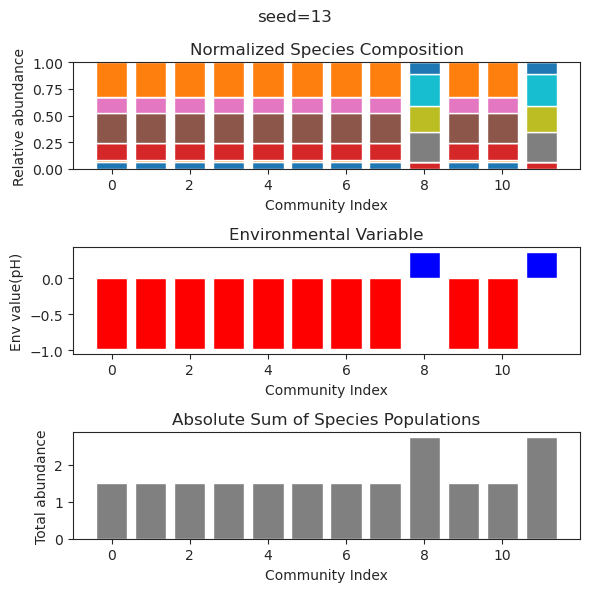

{'species': array([ 2.25554431e-01,  2.57694012e-18,  2.28521144e-58, -5.54578628e-32,
       -9.40036919e-36,  1.11730626e-44, -1.67992825e-59,  9.41282890e-58,
       -5.03059775e-33,  3.99869710e-20, -1.86771061e-55,  1.19694993e+00]), 'env': array([-1.82391959])}
{'species': array([ 2.25554431e-01, -2.06221596e-18,  3.00285134e-85, -3.93306601e-39,
       -2.84714447e-43, -4.83750501e-61, -2.40689070e-87,  9.37210946e-82,
       -8.79524914e-38,  1.73784467e-23, -9.65806493e-84,  1.19694993e+00]), 'env': array([-1.82391959])}
{'species': array([-2.24752196e-31,  6.32572560e-28,  3.71546644e-54, -2.17235736e-61,
        1.44499433e+00,  2.55132970e+00,  1.97845531e-05, -1.78221811e-57,
        4.96690417e-01,  6.29924851e-27,  1.13563960e+00, -9.53512188e-72]), 'env': array([2.61327257])}
{'species': array([ 2.25554431e-01,  7.27308046e-20, -6.44590529e-57, -1.91137516e-34,
       -2.88727242e-36,  2.12884909e-45, -5.04452883e-57, -1.15173073e-55,
       -2.27908712e-36,  1.63092800

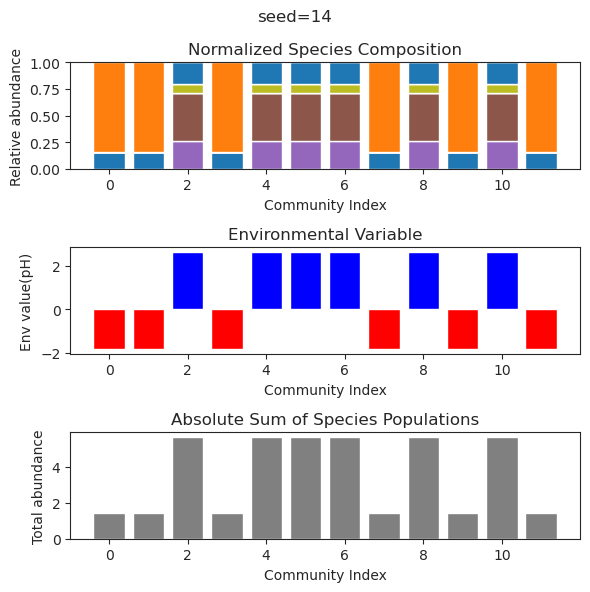

{'species': array([ 2.88208510e-01,  1.19050355e-47,  1.02868719e+00,  1.26479353e-68,
        1.68316606e-46, -3.49732478e-42, -6.71307416e-32,  4.35584237e-01,
        1.57892310e-38, -3.85970513e-73,  1.45682279e-65, -1.16552279e-23]), 'env': array([-2.61622258])}
{'species': array([ 2.88208510e-01,  2.27434301e-45,  1.02868719e+00,  1.79375828e-71,
        2.47211484e-41,  3.08413114e-38,  1.06345575e-26,  4.35584237e-01,
       -4.26255998e-38,  1.46029252e-71,  3.52970023e-59, -1.07454075e-21]), 'env': array([-2.61622258])}
{'species': array([ 2.88208510e-01, -9.34685026e-46,  1.02868719e+00, -9.29563617e-59,
        1.15249479e-43, -9.77000618e-38, -1.37317675e-32,  4.35584237e-01,
       -2.29005514e-38, -5.18173104e-65,  8.67210421e-61,  6.92055998e-23]), 'env': array([-2.61622258])}
{'species': array([ 2.88208510e-01, -1.58208062e-39,  1.02868719e+00, -3.17093304e-52,
       -1.23314583e-42, -8.60138984e-40, -3.58057264e-33,  4.35584237e-01,
        4.11911008e-32,  3.6117933

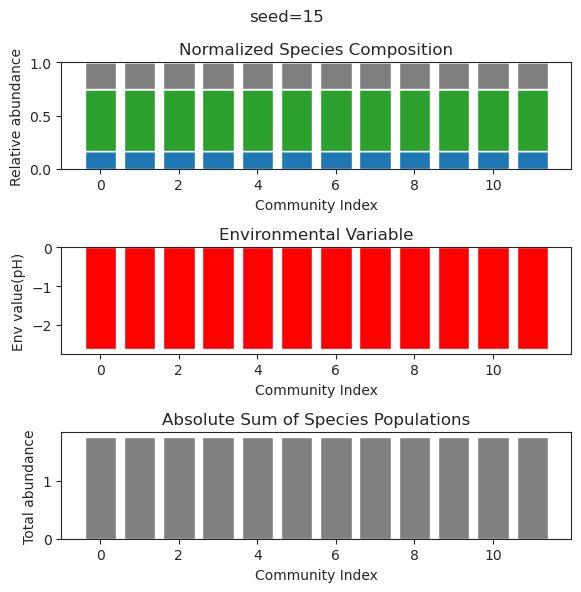

{'species': array([ 2.68390562e-01, -1.17083887e-34,  1.06822261e-27, -1.85744280e-18,
        1.59030748e-65,  8.88767192e-65, -5.12104731e-47,  1.08255029e+00,
        8.37110233e-55,  2.70706780e-63, -1.19966106e-56,  1.04647765e-52]), 'env': array([-2.77180968])}
{'species': array([ 2.68390562e-01,  6.14732009e-35,  7.34591226e-28, -3.84613992e-18,
       -2.32498548e-75, -5.85566609e-78,  3.60598363e-51,  1.08255029e+00,
       -3.59729501e-64,  7.47767109e-76,  5.48680266e-65, -1.39102735e-60]), 'env': array([-2.77180968])}
{'species': array([ 2.68390562e-01, -3.33719565e-34,  4.13016601e-25, -6.38927301e-18,
        2.49652047e-90,  3.32180946e-92, -4.42857019e-56,  1.08255029e+00,
        4.44311475e-81,  3.21772115e-86, -1.10565922e-76,  1.33304383e-72]), 'env': array([-2.77180968])}
{'species': array([ 2.68390562e-001,  4.47575849e-035, -5.08444614e-029,
        7.30422308e-017, -4.76508105e-116, -2.05780502e-119,
        1.15274465e-072,  1.08255029e+000,  8.46652697e-104,
 

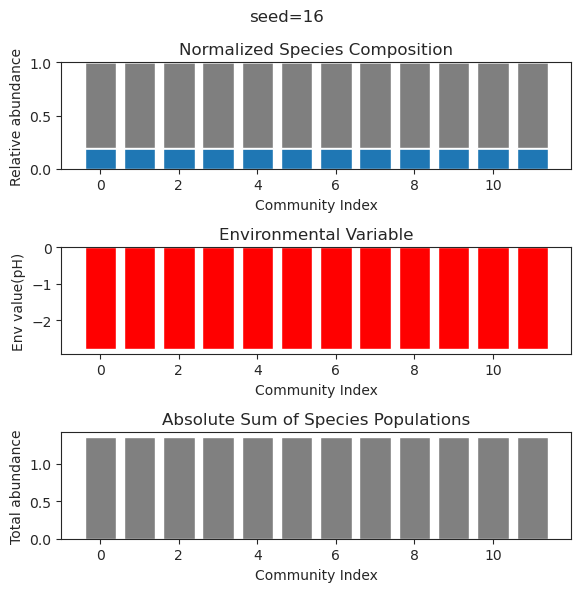

{'species': array([ 3.51382657e-01,  3.92792083e-19,  2.74229543e-52, -8.68149592e-48,
       -8.86336966e-48,  1.59056331e-35, -2.28263607e-43, -6.91405311e-67,
        5.41441773e-01,  1.66668948e-38,  3.22317748e-34,  2.26953977e-61]), 'env': array([-3.13733524])}
{'species': array([ 3.51382657e-01,  1.33937542e-20, -1.47239012e-57, -1.70051947e-44,
       -1.58021801e-44,  1.59434877e-31, -1.22397247e-47,  5.35808579e-77,
        5.41441773e-01, -9.38516935e-35, -3.89208716e-29,  3.50051482e-66]), 'env': array([-3.13733524])}
{'species': array([ 3.51382657e-01,  2.74286153e-19, -6.86931585e-56, -5.26115464e-46,
        1.53881676e-47,  8.46313619e-29, -1.31617006e-45, -9.66206510e-78,
        5.41441773e-01,  1.60474094e-35,  1.00119660e-27, -2.70002872e-63]), 'env': array([-3.13733524])}
{'species': array([ 3.51382657e-01,  4.75072035e-21, -3.95875068e-54,  9.56108984e-40,
       -4.11599565e-40,  6.51250545e-27,  4.71523120e-44,  7.26183714e-71,
        5.41441773e-01, -1.6733166

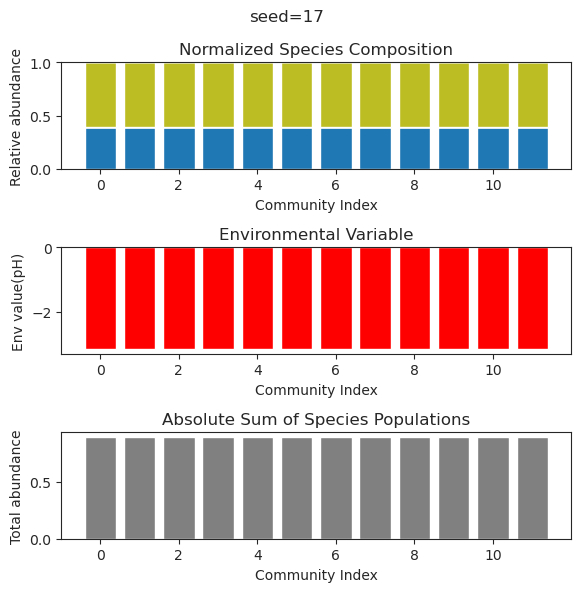

{'species': array([-1.54976302e-48,  3.47570886e-01,  8.34458421e-01,  3.82922286e-73,
       -1.56284428e-79, -1.47744146e-46,  3.34127897e-02, -8.50181538e-77,
       -1.16869488e-20,  1.08275326e-71, -7.26876639e-34, -3.35027112e-50]), 'env': array([-2.76332007])}
{'species': array([-1.90611643e-45,  3.47570886e-01,  8.34458421e-01,  1.00212391e-72,
        2.04285943e-73, -1.24039285e-43,  3.34127897e-02,  3.30556605e-73,
        1.96770379e-18, -2.94813820e-72,  5.60162691e-33, -7.17514131e-52]), 'env': array([-2.76332007])}
{'species': array([-6.58085197e-48,  3.47570886e-01,  8.34458421e-01,  6.25571780e-56,
       -3.44771507e-61, -1.04852577e-50,  3.34127897e-02, -4.79344740e-62,
        3.13972115e-23, -2.04192657e-36,  3.05662024e-33,  1.80451933e-44]), 'env': array([-2.76332007])}
{'species': array([ 1.75044713e-074,  3.47570886e-001,  8.34458421e-001,
       -1.03053852e-116, -3.42555697e-126,  4.15227034e-071,
        3.34127897e-002, -1.00549093e-125,  5.76334232e-024,
 

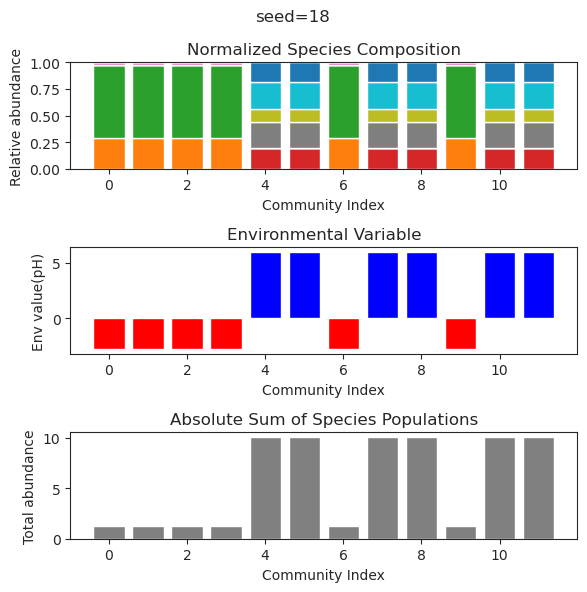

{'species': array([ 1.51054436e-01,  4.48687254e-17,  8.49807079e-01, -1.01448726e-37,
        1.19454558e-29,  1.55326834e-25, -2.69022236e-56, -8.24710570e-46,
       -9.67723098e-24,  3.93107312e-71,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([ 1.51054436e-01,  7.99439634e-18,  8.49807079e-01, -4.58342603e-41,
       -4.76009472e-33, -3.09402488e-29, -1.81624335e-64, -4.72966315e-47,
       -6.98248024e-29, -4.13808991e-78,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([ 1.51054436e-01,  2.22046588e-18,  8.49807079e-01, -1.07708226e-49,
       -1.87449966e-30, -2.12677578e-32, -2.45724293e-79, -2.01610654e-51,
        4.62186799e-28, -5.35239008e-88,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([ 1.51054436e-01,  3.04561142e-17,  8.49807079e-01,  3.16694246e-36,
        1.88336809e-28,  3.37609180e-28, -1.05989434e-53,  5.08547289e-39,
       -4.36429786e-29, -3.7169060

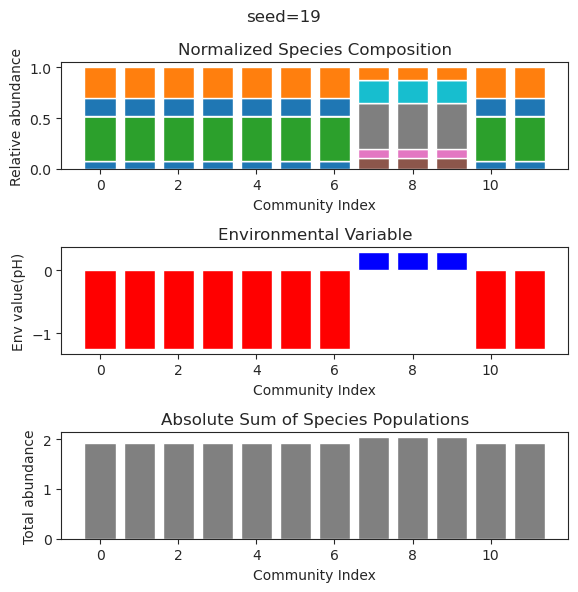

{'species': array([ 1.51054436e-01, -5.30264181e-17,  8.49807079e-01, -5.69202478e-54,
       -1.96782679e-30,  2.03342620e-37, -2.00000239e-76, -2.79876424e-53,
        8.47826085e-29, -2.01016939e-98,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([ 1.51054436e-01, -5.30264181e-17,  8.49807079e-01, -5.69202478e-54,
       -1.96782679e-30,  2.03342620e-37, -2.00000239e-76, -2.79876424e-53,
        8.47826085e-29, -2.01016939e-98,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([-4.70778918e-95, -1.40500331e-38,  7.45362939e-95,  1.02203276e-54,
       -2.34986712e-35,  2.15417685e-66,  1.76757132e+00,  1.64392799e+00,
        9.91183575e-01,  8.96788873e-54,  2.88531537e-73,  3.68411536e+00]), 'env': array([4.47617295])}
{'species': array([ 7.64192478e-119,  7.52927256e-064, -1.62591421e-138,
       -2.32448802e-086, -7.82690232e-043,  5.90306591e-108,
        1.76757132e+000,  1.64392799e+000,  9.91183575e-001,
  

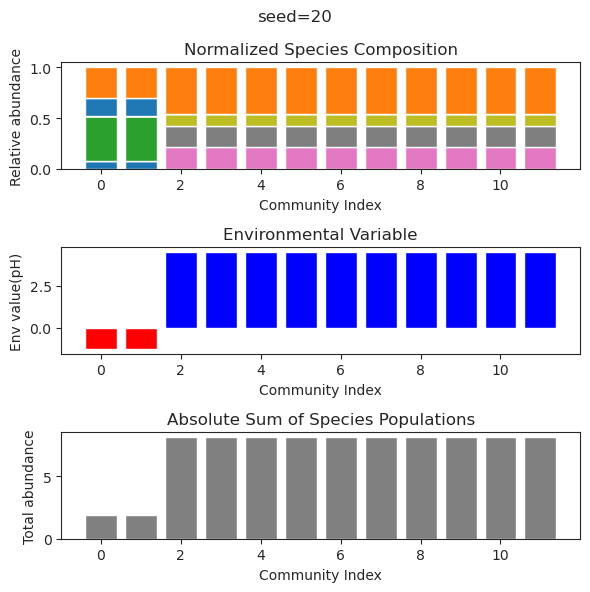

{'species': array([ 9.50010818e-002,  1.15833504e-193,  3.96548460e-001,
        1.78332143e-174,  3.13004570e-165,  2.80802831e-001,
        2.88868261e-001, -3.64102336e-002,  7.44004767e-089,
        0.00000000e+000,  1.55381839e-126,  4.60253403e-001]), 'env': array([-0.7123752])}
{'species': array([-1.39253015e-031,  2.93001070e-109,  4.61112064e-002,
        1.81727051e-138,  5.91639585e-001, -1.47647621e-026,
        1.57975810e-001,  3.54027399e-001,  1.59481192e-001,
        1.30691182e-129,  1.94216406e-083,  6.57886225e-001]), 'env': array([0.0666682])}
{'species': array([-1.42428895e-19,  4.30419317e-52,  4.61112064e-02,  2.87400427e-54,
        5.91639585e-01, -1.44175251e-18,  1.57975810e-01,  3.54027399e-01,
        1.59481192e-01,  4.35124497e-44, -2.13441642e-32,  6.57886225e-01]), 'env': array([0.0666682])}
{'species': array([-5.10001602e-25, -1.48842635e-79,  4.61112064e-02,  4.30371855e-93,
        5.91639585e-01, -4.72810023e-22,  1.57975810e-01,  3.54027399e-01,
 

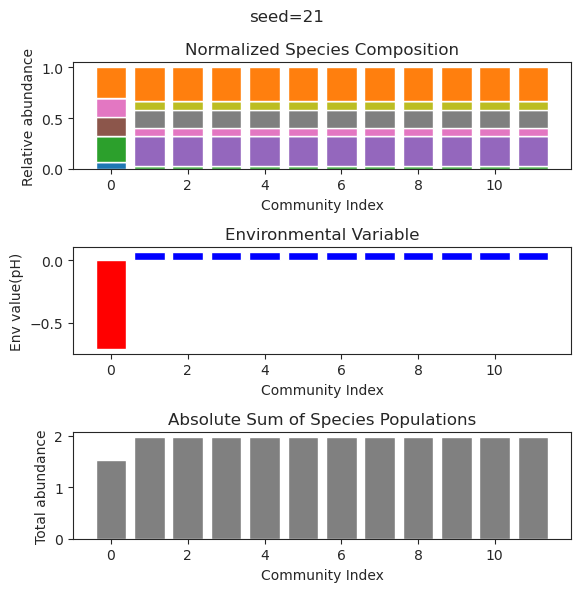

{'species': array([ 5.01830708e-02,  1.47158511e-01,  3.06395067e-51,  7.80500479e-88,
        1.28358894e-43, -3.53910725e-45,  4.12590072e-01,  6.22474388e-01,
       -2.14971709e-28, -7.85619266e-27, -8.13381714e-48,  3.84917051e-20]), 'env': array([-1.68579379])}
{'species': array([ 5.01830708e-02,  1.47158511e-01, -5.53832924e-45,  6.16522872e-68,
        7.21342817e-41,  3.72804476e-38,  4.12590072e-01,  6.22474388e-01,
       -5.06476154e-26, -2.84145347e-26,  1.55654935e-38,  2.67772726e-20]), 'env': array([-1.68579379])}
{'species': array([ 5.01830708e-02,  1.47158511e-01,  2.18163573e-54, -5.42940696e-91,
        3.91431539e-44,  6.60139192e-48,  4.12590072e-01,  6.22474388e-01,
       -3.64916252e-28, -5.31823063e-27,  2.80183262e-49,  2.01262199e-20]), 'env': array([-1.68579379])}
{'species': array([ 5.01830708e-02,  1.47158511e-01,  1.24097412e-45, -2.20720457e-69,
       -2.70939041e-42,  3.47188934e-39,  4.12590072e-01,  6.22474388e-01,
       -1.66594832e-25, -1.6843784

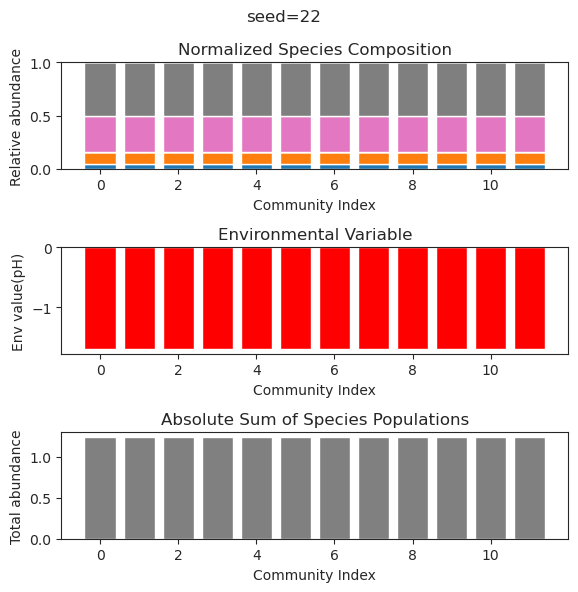

{'species': array([ 1.15069057e-01, -8.42879865e-38, -1.85837434e-56,  5.89464740e-23,
        4.62308461e-01,  2.16325239e-76,  5.44918965e-07,  5.73883555e-01,
        4.06734135e-01, -2.21293174e-73,  7.25002360e-25,  2.14525039e-01]), 'env': array([-0.58246701])}
{'species': array([ 1.15774090e-01,  3.16225419e-28,  3.18294242e-27,  6.58282113e-32,
        4.59688841e-01, -6.01024946e-27,  2.86361706e-03,  5.73321274e-01,
        4.10135744e-01,  5.04568768e-27, -7.64404703e-30,  2.11140442e-01]), 'env': array([-0.58499569])}
{'species': array([ 1.15777224e-01,  2.09815847e-39,  3.48563278e-34,  1.94958414e-29,
        4.59676872e-01,  4.26916227e-30,  2.87580178e-03,  5.73319390e-01,
        4.10151497e-01, -3.44956511e-35,  9.69752037e-31,  2.11124985e-01]), 'env': array([-0.58500712])}
{'species': array([ 1.15777178e-01, -7.18080917e-35,  1.74416894e-32,  5.47954661e-30,
        4.59677047e-01,  1.01086035e-33,  2.87562370e-03,  5.73319417e-01,
        4.10151267e-01,  3.5367287

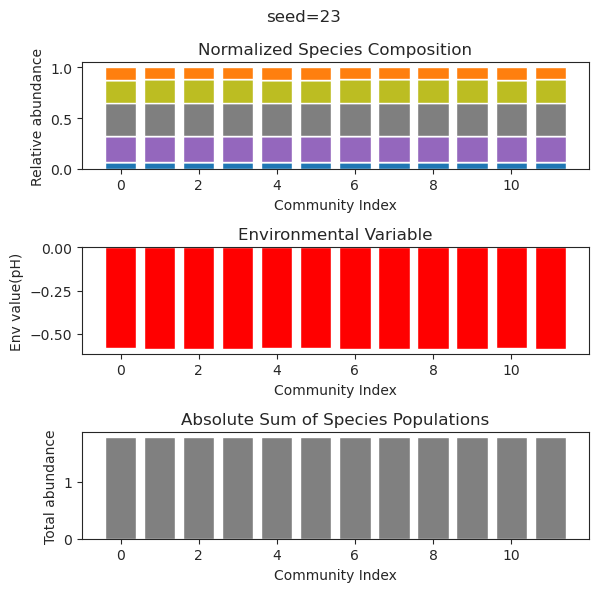

{'species': array([ 1.07390889e-01, -6.30186492e-49, -3.89855582e-73,  3.35934365e-01,
       -9.51502121e-64,  6.42241030e-01, -2.36131424e-68,  5.66868868e-01,
       -3.10840167e-41,  2.79565145e-01, -3.96760372e-31,  5.02373337e-95]), 'env': array([-0.28425011])}
{'species': array([ 1.07390889e-01,  2.71076342e-48,  1.22852953e-73,  3.35934365e-01,
        1.75928030e-64,  6.42241030e-01,  2.45324125e-67,  5.66868868e-01,
       -1.01706965e-40,  2.79565145e-01, -8.90508579e-29,  2.58700436e-98]), 'env': array([-0.28425011])}
{'species': array([ 1.07390889e-01,  7.27038722e-57,  1.34257974e-81,  3.35934365e-01,
        2.84906301e-67,  6.42241030e-01,  2.48591322e-85,  5.66868868e-01,
        2.28703147e-47,  2.79565145e-01, -4.99292025e-38,  3.41369661e-99]), 'env': array([-0.28425011])}
{'species': array([ 1.07390889e-01, -6.86569983e-46,  7.75596258e-69,  3.35934365e-01,
       -9.41920588e-61,  6.42241030e-01,  8.11660693e-64,  5.66868868e-01,
       -2.38875029e-38,  2.7956514

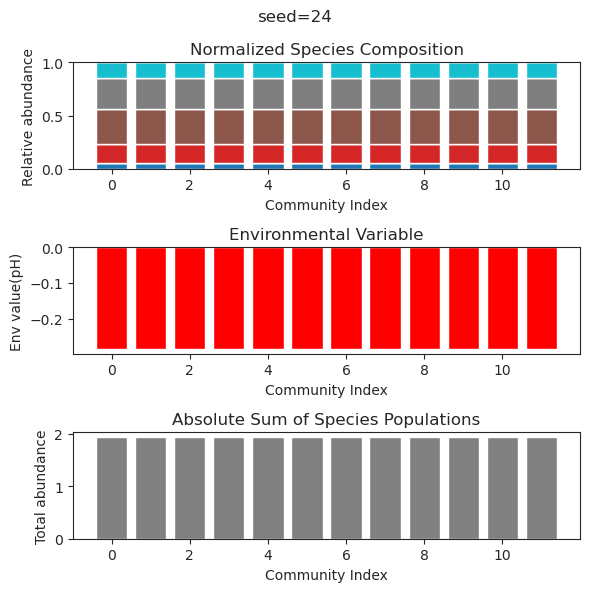

{'species': array([ 3.01207281e-01,  9.08418093e-31,  2.34070212e-24,  5.12947085e-30,
        3.57190002e-55,  1.64209143e-56,  1.01468199e-56, -4.97499719e-54,
        6.05779664e-59,  7.30655263e-01,  4.04116822e-61,  3.49376986e-01]), 'env': array([-1.95544865])}
{'species': array([ 3.01207281e-01, -6.30405686e-31, -4.22927216e-26, -1.67166634e-31,
        5.42528795e-52,  3.75717232e-52,  4.20946650e-54,  4.76251234e-55,
        1.32165391e-56,  7.30655263e-01,  9.63485902e-59,  3.49376986e-01]), 'env': array([-1.95544865])}
{'species': array([ 3.01207281e-01, -3.85240772e-29, -7.80569306e-24, -1.94123961e-32,
        1.29058276e-51,  1.61673752e-53,  1.03451293e-54, -4.09144393e-51,
        8.22849609e-54,  7.30655263e-01, -3.96495313e-54,  3.49376986e-01]), 'env': array([-1.95544865])}
{'species': array([ 3.01207281e-01, -2.85181592e-31,  8.71119113e-26, -8.09977416e-33,
        4.61965915e-53,  3.75599974e-53, -2.94156929e-56, -1.90148384e-57,
       -1.90826885e-57,  7.3065526

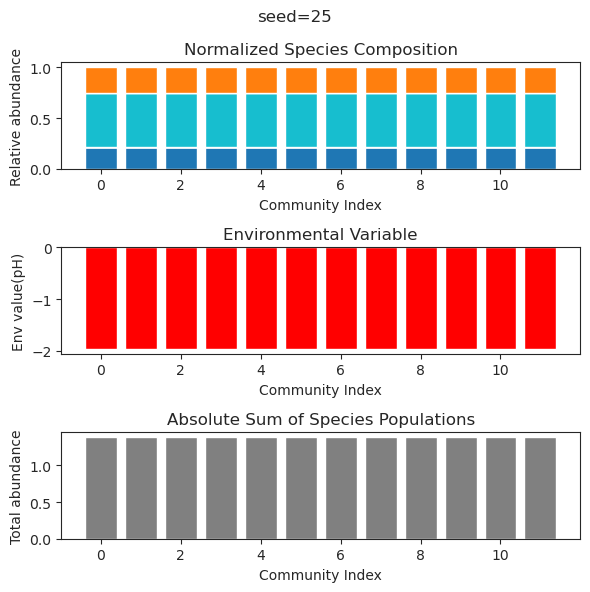

{'species': array([ 3.34311920e-01,  7.34711765e-19,  5.87411822e-35, -2.09714508e-27,
       -6.12900656e-42, -5.25653994e-54, -6.39874486e-57, -1.27345544e-53,
       -9.13339430e-51,  1.07667827e+00, -4.59405702e-44, -3.29929739e-46]), 'env': array([-2.27893754])}
{'species': array([ 3.34311920e-01, -5.21229232e-20, -7.86969594e-41, -2.61524817e-31,
        2.77469012e-47, -2.16555133e-61, -2.27403152e-62, -2.16318095e-62,
        8.97277808e-58,  1.07667827e+00,  6.51588748e-45,  2.67965621e-48]), 'env': array([-2.27893754])}
{'species': array([-5.11001636e-26, -4.19412095e-54,  7.66522086e-53,  6.14882071e-51,
        2.34077578e-01,  3.18016187e-57,  3.74777942e-01, -9.77259273e-27,
        6.14278325e-01, -1.77375685e-50,  6.54477501e-01,  5.28473558e-01]), 'env': array([0.04071568])}
{'species': array([ 3.34311920e-01,  1.70083379e-23,  7.88726489e-38,  2.31276273e-33,
       -1.10121989e-43,  1.80177569e-58,  1.56046352e-58,  1.91571849e-58,
       -4.57133692e-54,  1.07667827

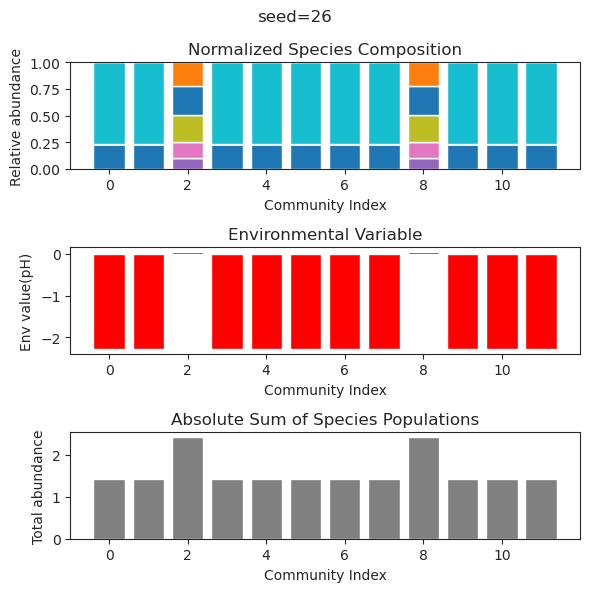

{'species': array([ 1.49354600e-01,  2.01971725e-01,  5.75945073e-62,  4.86892159e-54,
        1.32859101e-62, -5.52721247e-38,  1.45713371e-58, -1.49803775e-50,
        1.44025010e-51,  9.28410553e-25, -4.70951620e-27, -3.86618602e-48]), 'env': array([-3.43061259])}
{'species': array([ 1.49354600e-001,  2.01971725e-001,  8.30991838e-102,
        1.72678733e-089, -2.96886184e-106, -1.21697674e-041,
        3.10453751e-094,  9.00998935e-072,  7.51067016e-085,
        1.84697844e-026,  8.93933531e-029, -8.13996285e-070]), 'env': array([-3.43061259])}
{'species': array([ 1.49354600e-001,  2.01971725e-001,  1.79521489e-138,
        5.54551261e-116, -2.63363215e-150,  1.89921031e-044,
       -5.16875863e-126, -1.09698313e-091,  7.83847868e-112,
       -5.24330195e-026, -6.77226231e-029, -8.92044256e-090]), 'env': array([-3.43061259])}
{'species': array([ 1.49354600e-001,  2.01971725e-001, -1.82151461e-117,
       -1.08175340e-096,  1.46328128e-110, -1.03593255e-035,
        2.35318345e-110,

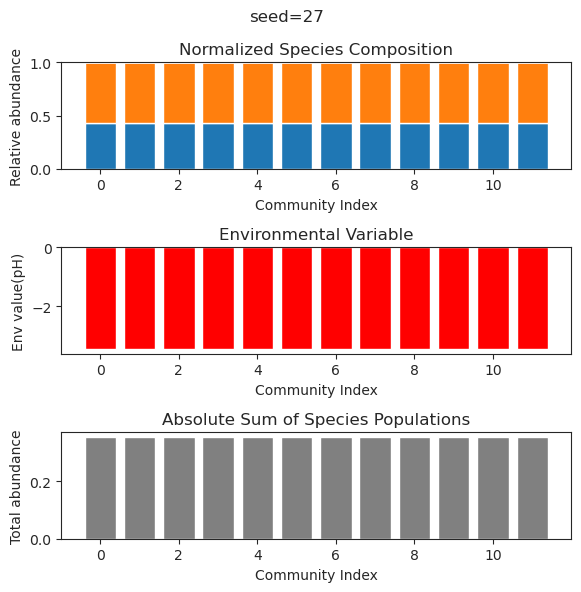

{'species': array([-3.50543397e-66,  1.91057934e-01, -1.15845289e-37, -7.25555002e-57,
        6.43860919e-01,  2.18244141e-01,  7.64760241e-57, -1.87387853e-72,
        7.90518815e-66,  5.36002735e-01,  8.08733987e-78,  3.14442530e-01]), 'env': array([-0.88141885])}
{'species': array([-1.53796020e-64,  1.91057934e-01,  1.29622831e-40, -2.07853565e-58,
        6.43860919e-01,  2.18244141e-01,  4.87941415e-51,  2.61034383e-70,
        3.53671104e-66,  5.36002735e-01,  1.24354150e-73,  3.14442530e-01]), 'env': array([-0.88141885])}
{'species': array([ 6.86089924e-002,  4.24199516e-146,  2.01095189e-001,
        1.13181104e+000,  1.36776569e-054,  8.34520086e-003,
        1.40225744e+000, -1.48219694e-323,  4.65927019e-136,
        2.53448419e-001,  2.33598676e-045,  2.72855453e-002]), 'env': array([0.93397648])}
{'species': array([ 1.58227814e-41, -8.49667427e-68,  1.59339906e-54,  4.50819279e+00,
       -3.33236829e-49,  5.10494433e-67,  5.48702255e+00,  2.33847290e-62,
       -1.313292

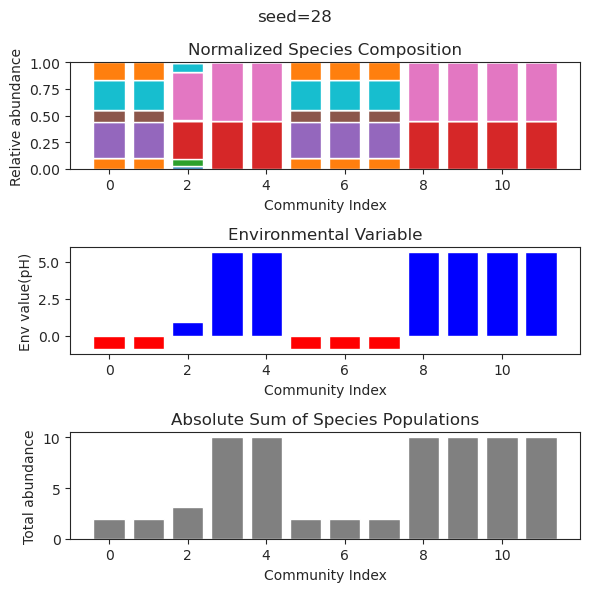

{'species': array([ 3.60112865e-074,  1.53754096e-116,  2.34787430e+000,
       -2.93709360e-077, -3.29688434e-109, -8.14443733e-058,
        1.95815651e+000,  3.44691820e-084,  9.45623716e-001,
       -1.55142394e-028,  3.99329241e-109,  2.59192770e-109]), 'env': array([2.09025217])}
{'species': array([-4.71412593e-70,  1.04815367e-98,  2.34787430e+00, -2.48869385e-69,
       -1.62570578e-98, -3.29650826e-60,  1.95815651e+00, -3.48271936e-76,
        9.45623716e-01,  2.70670635e-25, -7.68711876e-89, -1.20548685e-94]), 'env': array([2.09025217])}
{'species': array([-2.49995882e-080,  8.63909443e-116,  2.34787430e+000,
        1.14696626e-059,  2.64913975e-111,  4.35661727e-050,
        1.95815651e+000,  1.95095209e-085,  9.45623716e-001,
        7.04400916e-026,  2.07277981e-109, -9.39877063e-105]), 'env': array([2.09025217])}
{'species': array([-4.02893534e-72, -1.32594437e-98,  2.34787430e+00,  3.00305230e-46,
        8.80031373e-92,  2.43339486e-43,  1.95815651e+00,  4.57299424e-75,

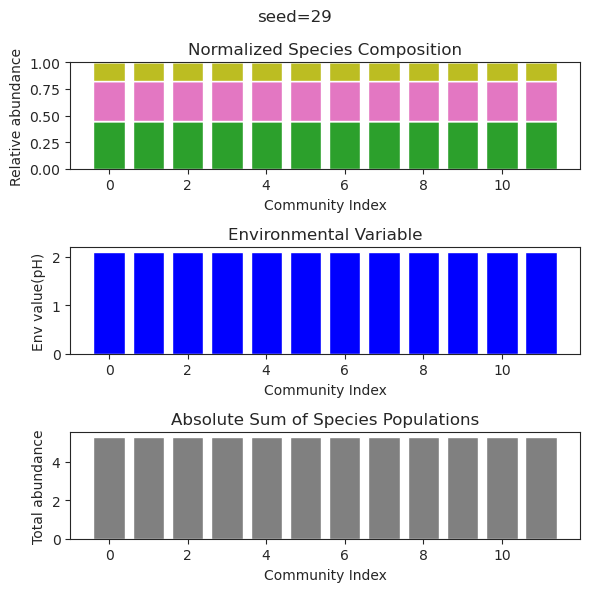

{'species': array([ 5.92400638e-81,  2.99794304e-01, -2.36731465e-86,  8.36479729e-63,
        2.50379792e-01, -1.91999094e-29,  8.02908786e-01,  1.51587248e-01,
       -7.12372423e-20,  1.29412677e-45, -1.41992188e-64, -1.38468741e-68]), 'env': array([-2.13066378])}
{'species': array([ 1.06301668e-57,  2.99794304e-01,  2.02101105e-59, -3.70287239e-46,
        2.50379792e-01,  1.30385429e-27,  8.02908786e-01,  1.51587248e-01,
       -2.65111859e-18,  4.20653718e-37,  1.50816448e-51,  1.44402031e-54]), 'env': array([-2.13066378])}
{'species': array([ 1.33862153e-77,  2.99794304e-01,  2.17265033e-81,  5.07812918e-62,
        2.50379792e-01,  2.75749704e-28,  8.02908786e-01,  1.51587248e-01,
       -1.03767837e-17,  4.60789805e-40,  1.07714159e-61,  1.66845032e-66]), 'env': array([-2.13066378])}
{'species': array([ 1.37669994e-48,  2.99794304e-01, -7.75381414e-48, -9.55448944e-39,
        2.50379792e-01, -2.12936601e-29,  8.02908786e-01,  1.51587248e-01,
       -6.35672604e-18, -1.2580576

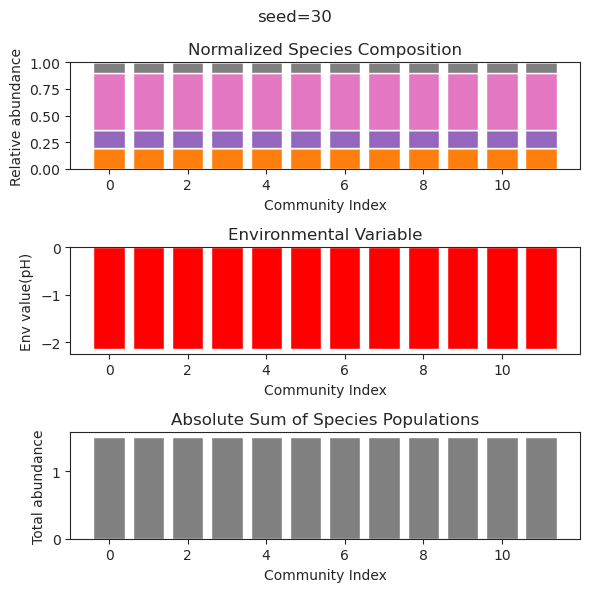

{'species': array([ 4.02541203e-50,  2.16641032e-01, -2.02253285e-28,  8.58459614e-01,
        6.73306924e-01,  2.89262159e-39,  9.66201801e-40,  1.81067446e-49,
        2.00067882e-41,  1.31601348e-01, -4.93821417e-48, -2.15632088e-47]), 'env': array([-1.40302269])}
{'species': array([-4.15551166e-52,  2.16641032e-01, -4.57666194e-31,  8.58459614e-01,
        6.73306924e-01, -9.36584910e-38,  2.40983420e-42, -7.10771593e-50,
        4.39169677e-41,  1.31601348e-01,  1.77257069e-47,  3.68776732e-50]), 'env': array([-1.40302269])}
{'species': array([ 5.69665601e-51,  2.16641032e-01,  7.98145584e-29,  8.58459614e-01,
        6.73306924e-01, -1.13818426e-40,  1.16458261e-38, -4.82037282e-47,
       -6.52093753e-45,  1.31601348e-01, -4.18121881e-45, -3.10714672e-46]), 'env': array([-1.40302269])}
{'species': array([-4.03765182e-52,  2.16641032e-01, -7.83696666e-29,  8.58459614e-01,
        6.73306924e-01,  8.93858478e-37,  3.12510118e-38, -2.83603861e-47,
        9.72077912e-40,  1.3160134

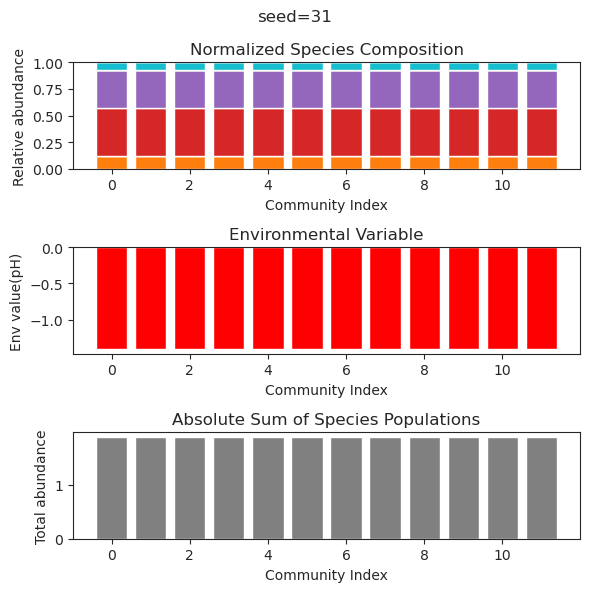

{'species': array([ 6.88979071e-084,  2.05939255e-001, -2.25410928e-131,
       -4.75179375e-132, -4.15559013e-027,  3.05588032e-070,
       -4.56316036e-072, -1.03882271e-035,  2.83786070e-001,
        1.11542333e+000, -7.87469280e-046,  8.40846343e-002]), 'env': array([-1.96582021])}
{'species': array([ 1.99633676e-083,  2.05939255e-001,  5.45626113e-132,
        7.77574987e-131, -4.15996626e-025, -1.72957768e-074,
       -2.44622451e-073, -6.16827181e-036,  2.83786070e-001,
        1.11542333e+000,  1.12421385e-044,  8.40846343e-002]), 'env': array([-1.96582021])}
{'species': array([-3.09634138e-023, -8.59450179e-098,  6.32792263e-083,
        1.04017502e-092,  8.00432138e-001,  1.90484560e+000,
       -2.83591981e-097,  2.23363159e+000,  1.39915674e-077,
       -5.00951154e-104,  1.44682028e-047,  1.37165608e-034]), 'env': array([2.27421335])}
{'species': array([ 9.12587671e-23,  3.05933222e-35,  1.01737646e-44, -2.69111730e-43,
        8.00432138e-01,  1.90484560e+00, -1.43180919e

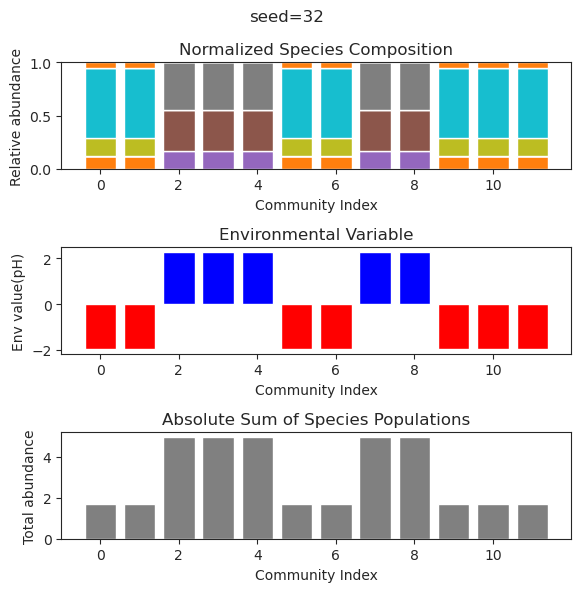

{'species': array([ 2.44050380e-002, -6.82280621e-067,  4.41729884e-001,
        4.99371022e-001,  4.82350812e-001,  2.19557203e-001,
        3.78664638e-121, -8.06418907e-112, -8.45223649e-099,
       -3.35787164e-041, -8.90573793e-122,  4.14571777e-001]), 'env': array([-0.20264538])}
{'species': array([ 2.44050380e-002, -1.30658094e-062,  4.41729884e-001,
        4.99371022e-001,  4.82350812e-001,  2.19557203e-001,
       -7.10542857e-111, -9.13928927e-099, -5.06931605e-091,
        2.23248109e-038, -2.52734998e-108,  4.14571777e-001]), 'env': array([-0.20264538])}
{'species': array([ 2.44050380e-02, -4.44243636e-53,  4.41729884e-01,  4.99371022e-01,
        4.82350812e-01,  2.19557203e-01, -6.19796053e-92,  8.09357822e-89,
       -3.54273289e-75,  4.00998842e-37, -1.11116191e-94,  4.14571777e-01]), 'env': array([-0.20264538])}
{'species': array([ 2.44050380e-002, -2.37175867e-057,  4.41729884e-001,
        4.99371022e-001,  4.82350812e-001,  2.19557203e-001,
        1.23494232e-106,

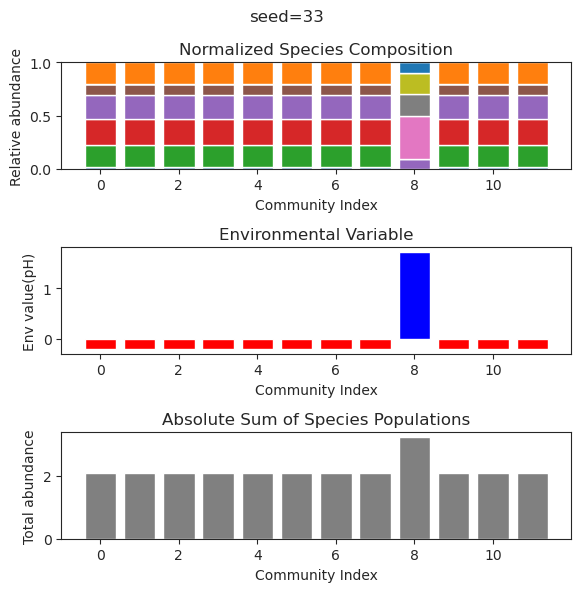

{'species': array([ 3.77933406e-01,  6.17508158e-44, -1.22190316e-39, -1.10744243e-83,
        9.27063194e-01, -1.54904686e-95, -4.62727828e-42,  3.66617330e-59,
        5.88798321e-02, -3.72687199e-51,  1.02125435e+00, -4.37619173e-21]), 'env': array([-2.92148959])}
{'species': array([ 3.77933406e-01,  1.32448444e-63, -1.29305349e-35,  4.96661034e-84,
        9.27063194e-01, -3.78563324e-90, -2.86762719e-38,  7.89222816e-60,
        5.88798321e-02, -2.35688767e-51,  1.02125435e+00, -8.02635910e-26]), 'env': array([-2.92148959])}
{'species': array([ 3.77933406e-01,  1.35609742e-49, -1.55177116e-39, -6.34562076e-60,
        9.27063194e-01, -2.18171707e-65, -8.80591314e-41, -6.12615511e-46,
        5.88798321e-02, -5.30619693e-44,  1.02125435e+00,  5.72040584e-29]), 'env': array([-2.92148959])}
{'species': array([ 3.77933406e-01,  1.91448052e-45, -7.29446200e-34, -2.33574679e-68,
        9.27063194e-01,  3.90909019e-68, -3.75765267e-36, -1.49854775e-58,
        5.88798321e-02,  6.1241519

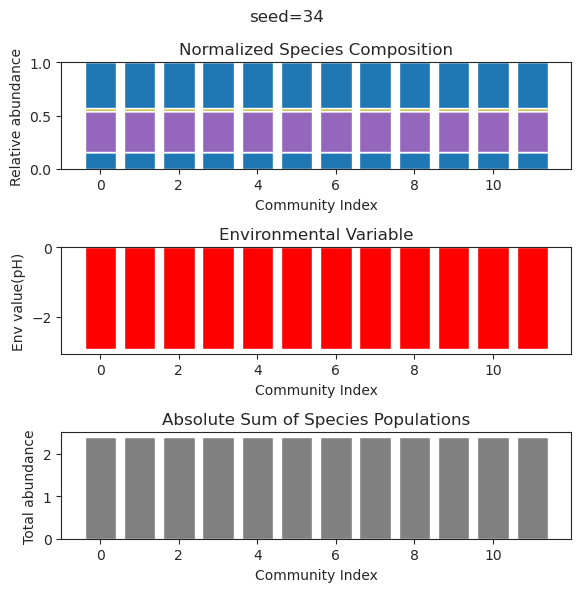

{'species': array([ 3.32868792e-01, -1.06120879e-50, -6.93529838e-94, -1.12700734e-58,
       -5.11862535e-82,  5.20201144e-01, -5.25705917e-83,  1.85427959e-01,
        1.38131241e-95,  2.72731939e-95, -1.82505458e-26,  1.51633671e-50]), 'env': array([-2.78942174])}
{'species': array([ 3.32868792e-01, -2.21360364e-50, -9.51015108e-99, -2.54465956e-58,
       -2.30328753e-85,  5.20201144e-01, -4.94720262e-85,  1.85427959e-01,
       -7.74084953e-99, -2.04144771e-99,  3.21300341e-25, -5.61488388e-58]), 'env': array([-2.78942174])}
{'species': array([ 3.32868792e-01,  6.67248389e-45,  7.73719462e-86,  5.11343240e-55,
       -9.02343019e-74,  5.20201144e-01, -1.75502346e-74,  1.85427959e-01,
        9.99717559e-83,  1.70989680e-83,  9.82891213e-24, -1.00610588e-44]), 'env': array([-2.78942174])}
{'species': array([ 3.32868792e-01,  3.56475270e-39, -5.44928462e-59,  2.83356613e-41,
        9.33560827e-57,  5.20201144e-01,  1.06863669e-55,  1.85427959e-01,
        8.28260817e-60,  5.9758479

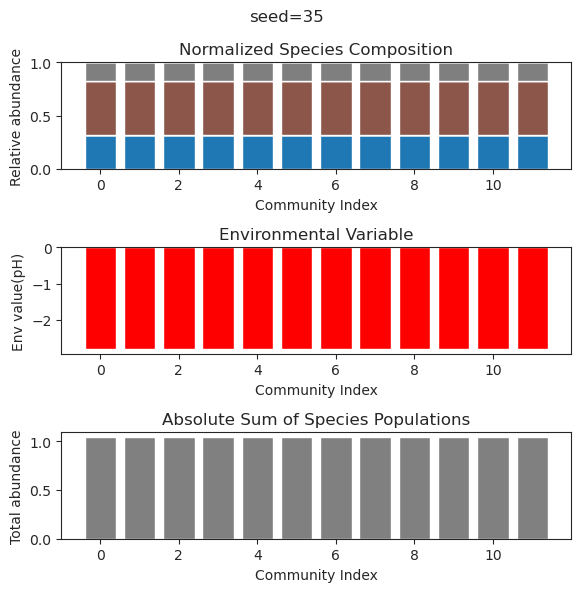

{'species': array([-6.38490710e-52,  1.84982773e-01,  7.85174612e-01,  2.47562990e-02,
        1.73303269e-38,  6.57032478e-01,  1.39106358e-29,  1.73592621e-63,
       -2.24764791e-53, -6.20176817e-49, -6.82102137e-61,  2.24024103e-60]), 'env': array([-1.93079834])}
{'species': array([ 9.16193383e-46,  1.84982773e-01,  7.85174612e-01,  2.47562990e-02,
       -1.52593927e-40,  6.57032478e-01, -7.44943640e-26, -1.12990862e-96,
       -8.99371821e-76,  1.80651348e-64, -1.24203199e-94, -3.34292740e-89]), 'env': array([-1.93079834])}
{'species': array([ 3.96257410e-62,  1.84982773e-01,  7.85174612e-01,  2.47562990e-02,
       -9.16896629e-37,  6.57032478e-01,  1.17257420e-27, -4.11152084e-73,
        3.05096893e-63, -1.00334376e-51,  4.77269995e-78, -3.59995770e-71]), 'env': array([-1.93079834])}
{'species': array([-1.13126266e-48,  1.84982773e-01,  7.85174612e-01,  2.47562990e-02,
       -2.85102356e-35,  6.57032478e-01,  1.35710602e-27, -4.89602752e-60,
       -2.58737414e-49,  3.9797403

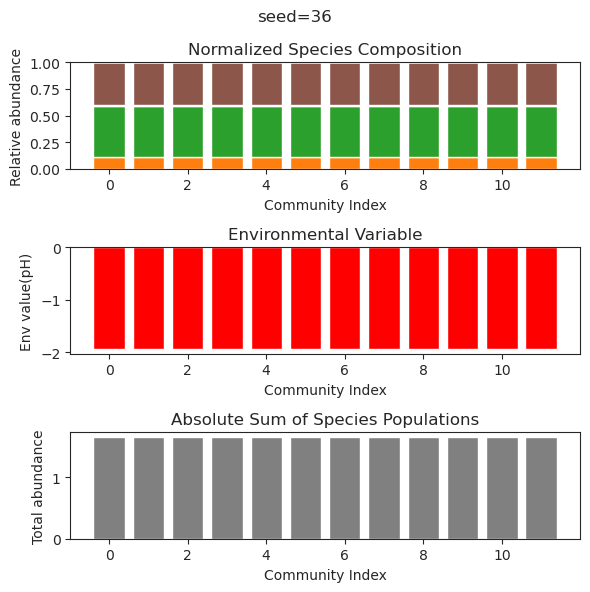

{'species': array([ 4.23181113e-02,  1.75804303e-01, -4.05664371e-52, -4.73306986e-38,
        4.12899143e-18,  6.37485000e-01,  1.87919567e-53, -3.53211028e-75,
       -1.43932315e-24,  1.08015108e-58, -1.60194766e-75,  4.64763158e-73]), 'env': array([-2.19954443])}
{'species': array([ 4.23181113e-02,  1.75804303e-01, -5.51094388e-63, -1.80933935e-40,
        3.10803321e-20,  6.37485000e-01, -2.16230606e-63,  9.30897994e-83,
        2.55354520e-28,  3.09742649e-64,  1.69810675e-80,  7.13799467e-79]), 'env': array([-2.19954443])}
{'species': array([ 4.23181113e-002,  1.75804303e-001, -1.86615350e-071,
        1.16990936e-038,  1.86271964e-019,  6.37485000e-001,
       -5.85789826e-075, -2.28522968e-099, -3.05787045e-025,
       -1.06552207e-081, -1.55873673e-099, -5.77139037e-101]), 'env': array([-2.19954443])}
{'species': array([ 4.23181113e-02,  1.75804303e-01,  2.70163653e-57, -7.68390113e-36,
        7.29615319e-20,  6.37485000e-01, -4.21681654e-58, -1.73288786e-77,
       -2.80091

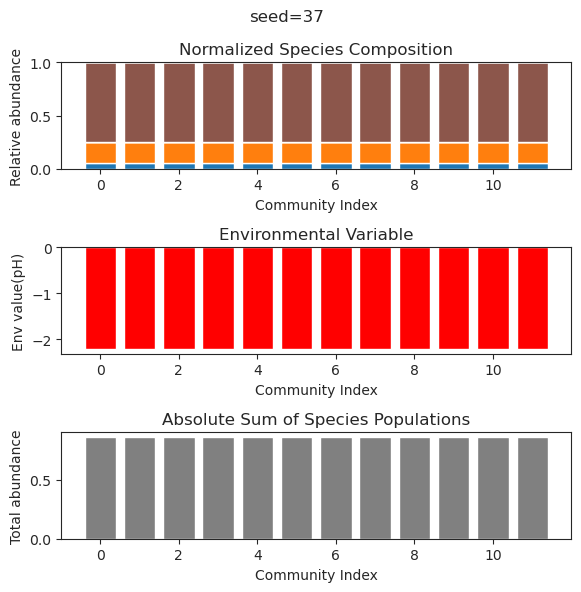

{'species': array([ 1.25842686e-001,  8.83420310e-044,  2.58308511e-001,
        5.25090936e-131,  1.27318268e-122,  2.07115644e-001,
       -3.40294616e-088,  2.17663830e-001,  1.62377018e-080,
        1.48206226e-001,  1.90919652e-003,  5.53587755e-001]), 'env': array([-0.83066344])}
{'species': array([ 1.25842456e-001,  1.62566885e-060,  2.58307540e-001,
        3.97973787e-126, -3.18028503e-122,  2.07117247e-001,
       -2.13526637e-087,  2.17666127e-001,  6.37792524e-078,
        1.48203791e-001,  1.90842835e-003,  5.53587868e-001]), 'env': array([-0.83066158])}
{'species': array([ 1.25471867e-001,  4.35492733e-027,  2.56640782e-001,
       -3.76597461e-131,  2.35854956e-027,  2.09794022e-001,
        1.71212495e-027,  2.21506617e-001, -1.12422673e-027,
        1.44196490e-001,  4.59996959e-004,  5.53862851e-001]), 'env': array([-0.82775213])}
{'species': array([ 1.25841111e-001, -1.45777036e-047,  2.58301856e-001,
       -5.94207313e-121,  4.73402387e-128,  2.07126633e-001,
     

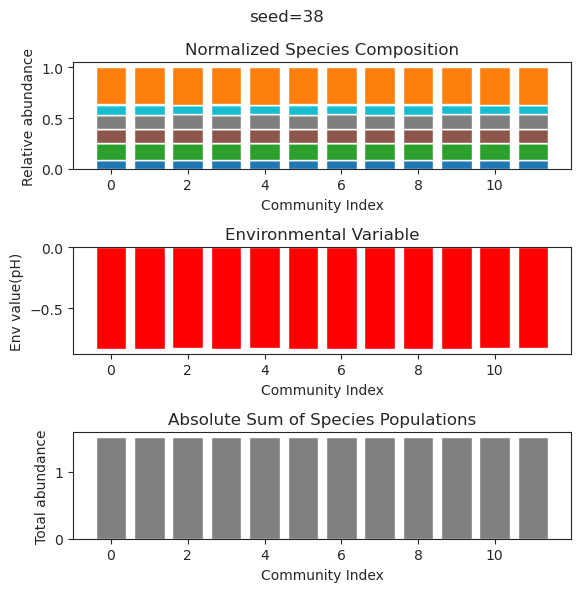

{'species': array([-1.15400924e-091, -4.84094085e-114,  7.86808840e-040,
        1.47479141e-061,  2.53191406e-116,  1.33810718e-088,
        5.23449859e+000,  1.12326453e-101,  1.84364010e-106,
        2.54281343e+000,  1.36756594e-121, -3.19151050e-070]), 'env': array([6.41922629])}
{'species': array([-1.34376583e-087, -9.08951542e-106, -4.53117455e-038,
       -7.15100167e-058,  3.21197873e-108, -4.99089241e-085,
        5.23449859e+000, -3.61171140e-096, -1.82899266e-099,
        2.54281343e+000,  9.80528705e-113,  3.39480077e-067]), 'env': array([6.41922629])}
{'species': array([-3.10513643e-42,  3.52869187e-95,  1.95871713e-35, -1.23116752e-59,
       -3.11170350e-92,  5.11916433e-78,  5.23449859e+00,  3.69172193e-83,
       -5.31199833e-89,  2.54281343e+00,  2.73393646e-94,  1.97858240e-58]), 'env': array([6.41922629])}
{'species': array([ 1.30440737e-080, -1.89386183e-099,  4.45841549e-032,
        4.00865551e-059,  3.25542984e-096, -1.06537054e-067,
        5.23449859e+000,  1

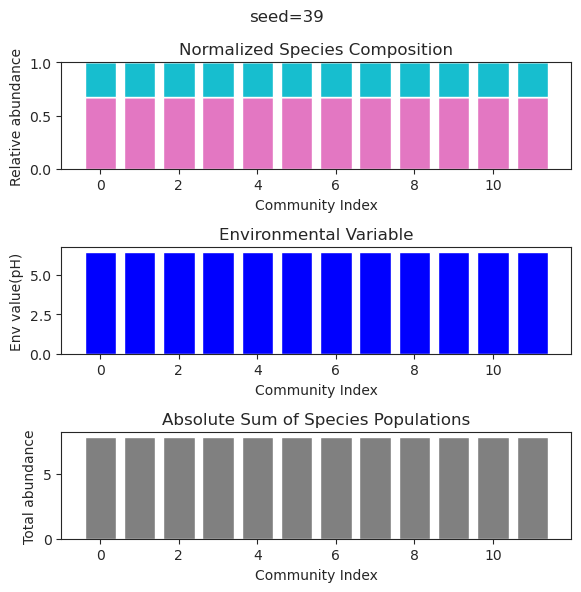

{'species': array([-4.38394115e-028,  3.18502689e-003,  5.39521332e-006,
        4.47739319e-001,  1.69363795e-001,  8.13372496e-001,
       -2.29588521e-101,  9.21251344e-075,  1.54973975e-097,
        2.48148274e-033,  6.69574968e-001,  6.54305350e-002]), 'env': array([0.46054571])}
{'species': array([-2.40717400e-28,  3.18483496e-03,  3.10965138e-06,  4.47740275e-01,
        1.69364775e-01,  8.13374564e-01, -2.25620692e-80, -1.62033140e-61,
       -1.16074675e-28, -2.05672434e-30,  6.69576107e-01,  6.54283127e-02]), 'env': array([0.46054666])}
{'species': array([ 2.09141849e-28,  3.18592777e-03,  1.61238894e-05,  4.47734835e-01,
        1.69359197e-01,  8.13362787e-01, -3.75179621e-35,  3.97308453e-42,
       -1.41717407e-30, -3.23239434e-33,  6.69569624e-01,  6.54409666e-02]), 'env': array([0.46054125])}
{'species': array([-1.18096613e-027,  3.18629309e-003,  2.04746018e-005,
        4.47733016e-001,  1.69357332e-001,  8.13358850e-001,
       -6.13866992e-033, -5.87526667e-070, -3.

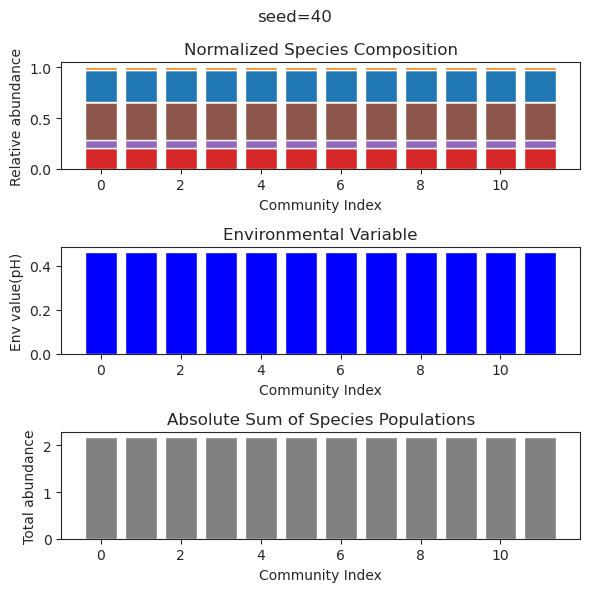

{'species': array([ 6.07914789e-002,  1.90923932e-002,  3.69041555e-001,
        1.68659802e-166, -1.78430582e-089, -1.49486473e-094,
        8.68825636e-036,  2.12693296e-001,  1.62965287e-001,
        4.55587429e-001, -5.36749699e-137,  6.33654466e-001]), 'env': array([-0.13358845])}
{'species': array([ 6.07914789e-002,  1.90923932e-002,  3.69041555e-001,
        3.25607662e-162,  5.99583936e-089,  2.05831234e-090,
       -5.12276880e-037,  2.12693296e-001,  1.62965287e-001,
        4.55587429e-001, -1.21563076e-132,  6.33654466e-001]), 'env': array([-0.13358845])}
{'species': array([ 6.07914789e-002,  1.90923932e-002,  3.69041555e-001,
       -4.65427624e-159,  1.89973884e-088,  3.03485141e-093,
        3.53125078e-035,  2.12693296e-001,  1.62965287e-001,
        4.55587429e-001, -3.25494747e-127,  6.33654466e-001]), 'env': array([-0.13358845])}
{'species': array([ 6.07914789e-002,  1.90923932e-002,  3.69041555e-001,
        2.26062960e-152,  8.69426407e-090,  1.51384677e-090,
     

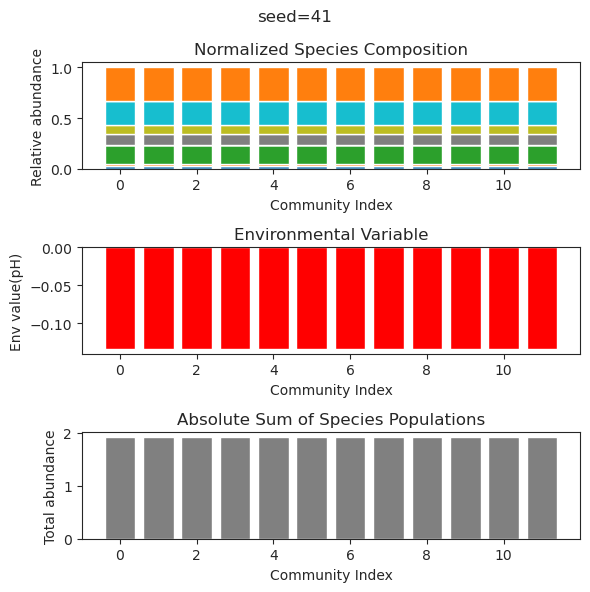

{'species': array([ 1.70219176e-01,  5.84291134e-47,  2.25332336e-16, -3.35532234e-65,
        5.03126153e-01, -8.99580062e-68,  6.83390083e-86, -1.21638839e-78,
        8.05585772e-01, -3.38909086e-32,  5.04967960e-01, -1.88960729e-64]), 'env': array([-1.28319777])}
{'species': array([ 1.70219176e-01,  2.72315667e-36,  3.96842763e-17,  1.00718809e-53,
        5.03126153e-01, -1.48085434e-58,  3.89856694e-94, -2.39752175e-79,
        8.05585772e-01, -1.30742056e-24,  5.04967960e-01,  2.02433831e-58]), 'env': array([-1.28319777])}
{'species': array([ 1.70219176e-001, -5.86548385e-047,  2.56247994e-017,
        1.54603760e-068,  5.03126153e-001,  7.44927152e-075,
        5.53238021e-111, -2.63863872e-102,  8.05585772e-001,
        1.36232737e-028,  5.04967960e-001,  4.54147125e-075]), 'env': array([-1.28319777])}
{'species': array([ 1.70219176e-01, -2.33280091e-35, -8.58162250e-17,  7.24901190e-46,
        5.03126153e-01,  3.72365161e-49,  3.51771870e-79,  6.67171213e-74,
        8.05585

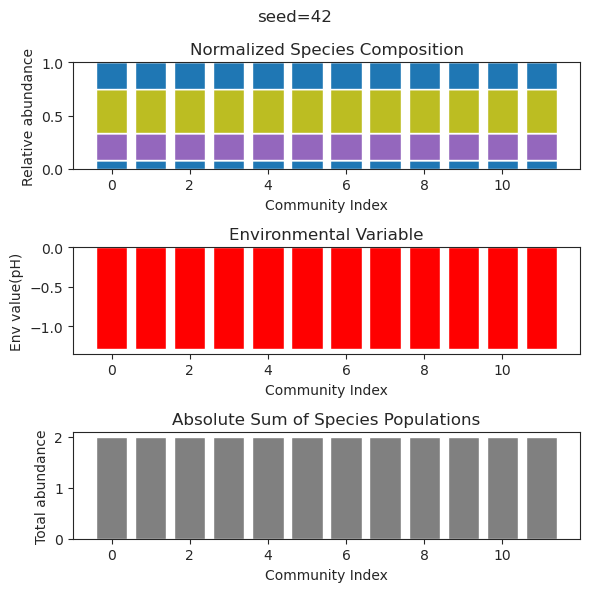

{'species': array([ 3.70637451e-002,  9.47019991e-002,  4.36769081e-052,
        3.21102669e-001, -3.47260257e-107,  7.31744777e-001,
        5.27867436e-011,  7.97500132e-040,  4.80848808e-001,
       -1.20367212e-043, -4.67233044e-103,  7.19333502e-007]), 'env': array([-0.92690604])}
{'species': array([ 2.59826346e-05,  1.16611760e-01, -3.07418721e-36,  2.75291989e-01,
       -3.85807584e-33,  7.28077791e-01,  7.35974985e-02,  1.57517932e-54,
        4.69280327e-01, -2.61426375e-72, -1.45923704e-62,  5.30774229e-02]), 'env': array([-0.68848081])}
{'species': array([ 3.70639361e-02,  9.47018694e-02,  2.59731518e-52,  3.21102434e-01,
        6.82575136e-83,  7.31744814e-01,  3.11975190e-10, -8.06052674e-25,
        4.80849085e-01, -7.06313791e-33,  4.92146743e-88,  4.47016598e-07]), 'env': array([-0.92690674])}
{'species': array([ 3.70560885e-02,  9.47071982e-02, -2.80073942e-42,  3.21112054e-01,
        1.78018624e-76,  7.31743328e-01,  7.61806206e-09, -4.73237036e-37,
        4.80837

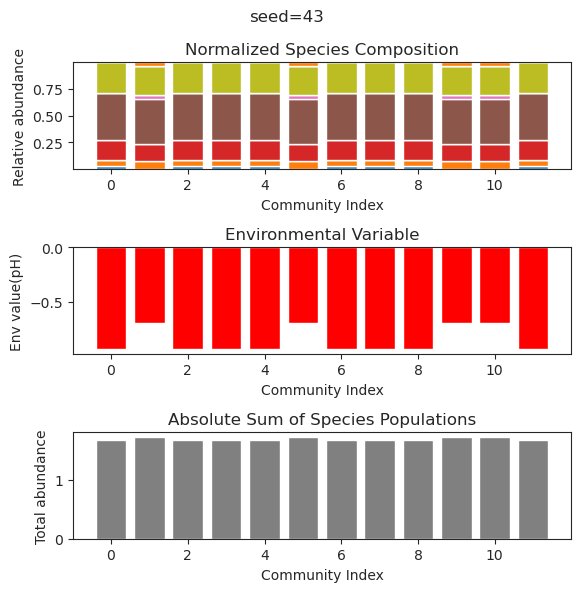

{'species': array([ 1.93721028e-01,  1.49296772e-21,  1.09751873e-24, -4.38828737e-52,
        5.52653737e-53, -1.23747289e-39,  1.07911411e+00, -2.66098236e-47,
       -5.61897820e-53, -5.15398754e-37, -6.62308507e-53,  1.65806917e-28]), 'env': array([-1.90672951])}
{'species': array([ 1.93721028e-01,  1.08639328e-21, -4.93944522e-27,  2.72888951e-57,
       -2.09826542e-53, -8.53533526e-42,  1.07911411e+00,  6.60466529e-51,
       -7.96304666e-59, -1.17091795e-37, -1.18110839e-58, -1.15907688e-30]), 'env': array([-1.90672951])}
{'species': array([ 1.93721028e-01, -2.97360861e-21, -2.09379099e-24, -5.94090541e-50,
        6.20699766e-47, -4.84241676e-37,  1.07911411e+00,  5.65432946e-44,
       -1.07112786e-49, -3.08783737e-33, -8.74128358e-50, -1.39512195e-28]), 'env': array([-1.90672951])}
{'species': array([ 1.97637350e-81, -6.45182690e-75, -2.06397594e-48,  1.93892134e-77,
        5.24859784e-01,  1.49082343e-01, -8.62367998e-82,  7.21941954e-02,
        8.02072037e-01,  1.1140900

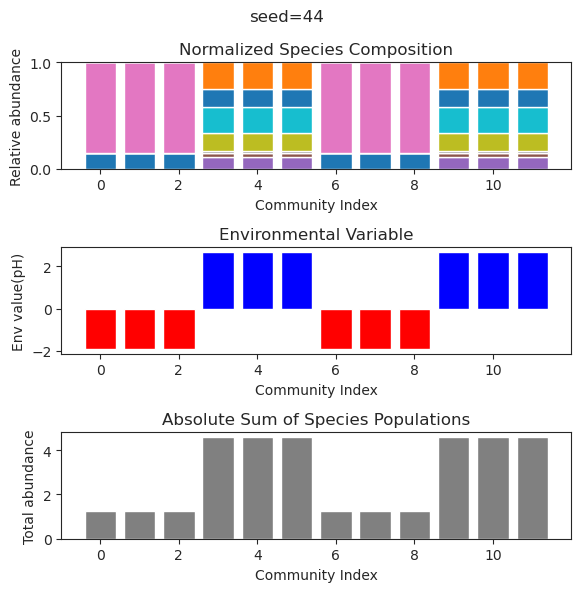

{'species': array([ 1.65415388e-001, -2.61444512e-030,  4.74858776e-100,
        1.36321722e-038,  1.43132933e-026,  4.23041579e-001,
        2.75380819e-019,  9.18862801e-056,  4.97670645e-001,
        3.32591798e-103,  3.57163847e-001,  6.74400436e-059]), 'env': array([-1.35532321])}
{'species': array([ 1.65415388e-001, -1.74342253e-027, -2.15084556e-132,
       -1.98478715e-044, -5.32947971e-029,  4.23041579e-001,
       -6.39398755e-017, -2.36245795e-075,  4.97670645e-001,
       -1.53987253e-136,  3.57163847e-001,  9.47724967e-070]), 'env': array([-1.35532321])}
{'species': array([ 1.65415388e-001,  2.15166058e-043, -1.37899161e-119,
        1.40935721e-051,  2.93640736e-040,  4.23041579e-001,
        2.22985612e-024,  8.97293939e-079,  4.97670645e-001,
       -1.28687072e-123,  3.57163847e-001, -1.63102655e-069]), 'env': array([-1.35532321])}
{'species': array([ 1.65415388e-001, -2.28701841e-026,  1.73139017e-129,
       -1.04292145e-039, -6.50175027e-023,  4.23041579e-001,
     

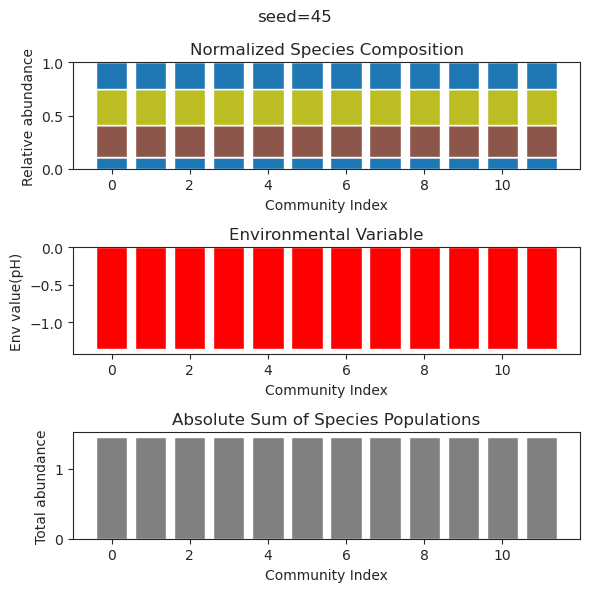

{'species': array([ 1.42735984e-01,  2.24228053e-01, -1.52584418e-24,  6.58798994e-59,
        3.71925201e-57,  2.11329452e-89, -8.05692881e-87, -5.01073246e-93,
        7.84352179e-44,  1.53395552e-62,  4.07810065e-62, -2.33842937e-81]), 'env': array([-3.57458245])}
{'species': array([ 1.42735984e-01,  2.24228053e-01,  3.92949282e-28, -1.34822244e-43,
       -1.55277063e-41,  8.28722865e-57,  2.38301635e-54,  1.51384606e-52,
        3.29362330e-37, -2.61053590e-43, -3.11514331e-45,  4.43825342e-51]), 'env': array([-3.57458245])}
{'species': array([ 1.42735984e-01,  2.24228053e-01, -4.67856504e-28,  5.99783275e-61,
       -4.41818236e-53, -9.40090028e-87, -1.63604229e-82, -1.06382214e-88,
        3.79367539e-42, -1.40118820e-59,  1.18042414e-64, -6.78113866e-78]), 'env': array([-3.57458245])}
{'species': array([ 1.42735984e-01,  2.24228053e-01,  2.36328576e-26, -1.28738910e-46,
        4.61473801e-44, -1.39814890e-60,  2.66283755e-61, -9.53754667e-55,
        3.80651654e-37, -2.7522696

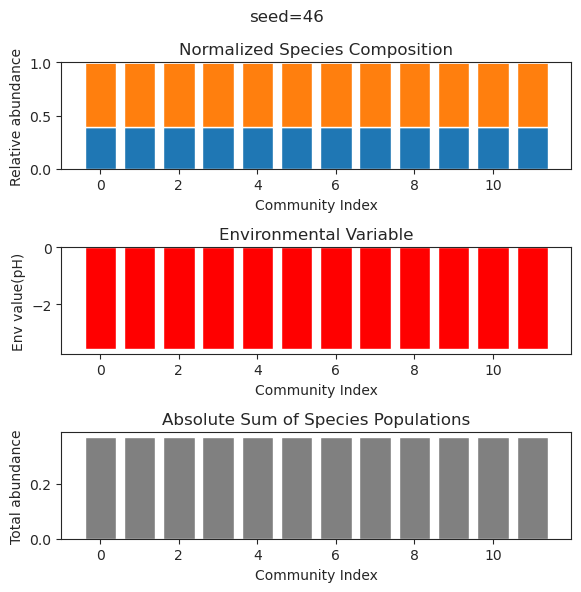

{'species': array([-2.70921514e-49,  2.66745012e-01,  8.56702059e-41,  1.24644904e-45,
        1.25604242e+00, -8.29023172e-51, -3.58830578e-20, -2.02981626e-30,
        2.98131620e-49,  2.10506749e-01,  8.91713419e-44,  1.37274074e-37]), 'env': array([-2.36754003])}
{'species': array([-1.83645196e-54,  2.66745012e-01, -1.28518465e-39,  7.65653129e-42,
        1.25604242e+00, -3.91782353e-51,  5.18162893e-20,  7.06547665e-27,
       -2.60425463e-49,  2.10506749e-01,  4.70852770e-46,  4.81039748e-36]), 'env': array([-2.36754003])}
{'species': array([ 3.65323377e-47,  2.66745012e-01,  2.65049927e-38, -8.15619284e-43,
        1.25604242e+00,  1.38054541e-49, -3.19820233e-19,  9.96187593e-28,
        1.93354164e-46,  2.10506749e-01, -8.47396445e-42,  3.13640898e-35]), 'env': array([-2.36754003])}
{'species': array([ 2.96907414e-48,  2.66745012e-01,  6.18547371e-41, -1.38742584e-39,
        1.25604242e+00, -4.80519190e-51, -1.37162309e-20, -1.21412898e-28,
        1.46903786e-48,  2.1050674

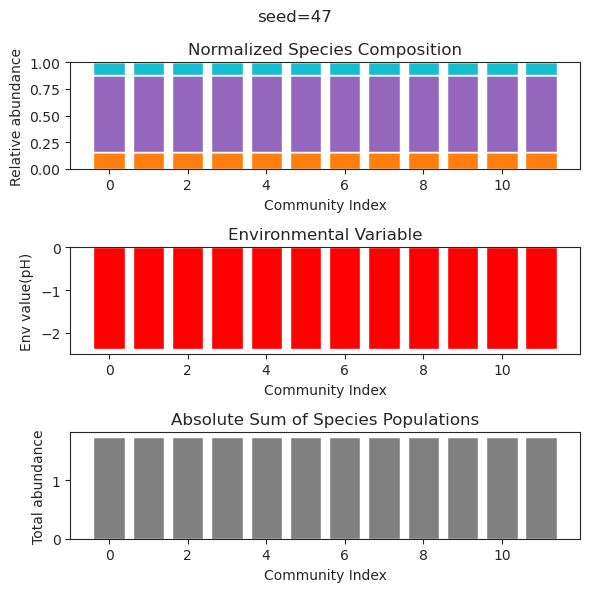

{'species': array([ 7.38946471e-22,  2.18727783e-01, -1.23591662e-45,  1.90655241e-35,
       -3.79960599e-42,  6.28043919e-01,  3.60472631e-01,  3.72134139e-01,
        3.06768169e-21,  9.79936038e-44, -4.25586613e-28,  3.88747026e-28]), 'env': array([-1.38137804])}
{'species': array([ 7.99762140e-22,  2.18727783e-01,  9.89333825e-51,  3.69184577e-38,
       -1.37052354e-45,  6.28043919e-01,  3.60472631e-01,  3.72134139e-01,
        2.60408540e-22,  8.42202109e-47, -6.43641190e-28, -1.14790721e-25]), 'env': array([-1.38137804])}
{'species': array([ 4.43359351e-19,  2.18727783e-01, -4.41475350e-48,  6.65971007e-36,
       -7.72741415e-42,  6.28043919e-01,  3.60472631e-01,  3.72134139e-01,
        8.92376809e-20, -2.76055913e-46, -7.52149694e-27,  2.69601920e-24]), 'env': array([-1.38137804])}
{'species': array([ 5.52469468e-20,  2.18727783e-01, -1.66520964e-48,  4.16804122e-38,
        1.88629535e-45,  6.28043919e-01,  3.60472631e-01,  3.72134139e-01,
        2.96418814e-21,  6.8420812

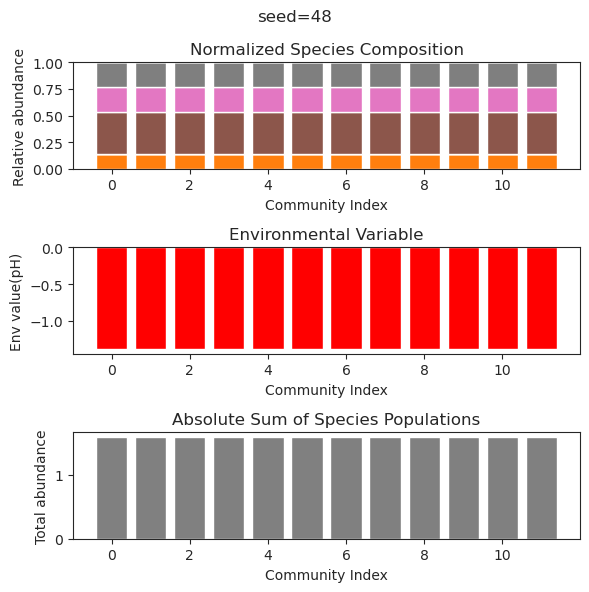

{'species': array([-5.70125622e-43, -3.91067811e-43,  6.94517771e-01,  8.46874185e-48,
        3.42961470e-01,  1.86898927e-01,  6.69659608e-01,  4.98834597e-01,
        5.53739002e-30,  2.65940084e-60,  8.40903658e-54, -1.81321960e-16]), 'env': array([0.4773813])}
{'species': array([ 2.05233327e-36,  1.20252187e-36,  6.94517771e-01,  5.74488921e-41,
        3.42961470e-01,  1.86898927e-01,  6.69659608e-01,  4.98834597e-01,
       -1.37998158e-23,  2.84532090e-55,  2.25875153e-42, -1.66686074e-13]), 'env': array([0.4773813])}
{'species': array([ 4.73729226e-40,  2.94800596e-37,  6.94517771e-01, -7.70534143e-37,
        3.42961470e-01,  1.86898927e-01,  6.69659608e-01,  4.98834597e-01,
       -2.98884285e-22, -4.80277575e-65, -4.53978283e-41,  9.98084826e-17]), 'env': array([0.4773813])}
{'species': array([ 2.51606185e-41,  9.43074933e-44,  6.94517771e-01,  4.04794977e-53,
        3.42961470e-01,  1.86898927e-01,  6.69659608e-01,  4.98834597e-01,
        3.39328130e-37, -1.18782677e-56,

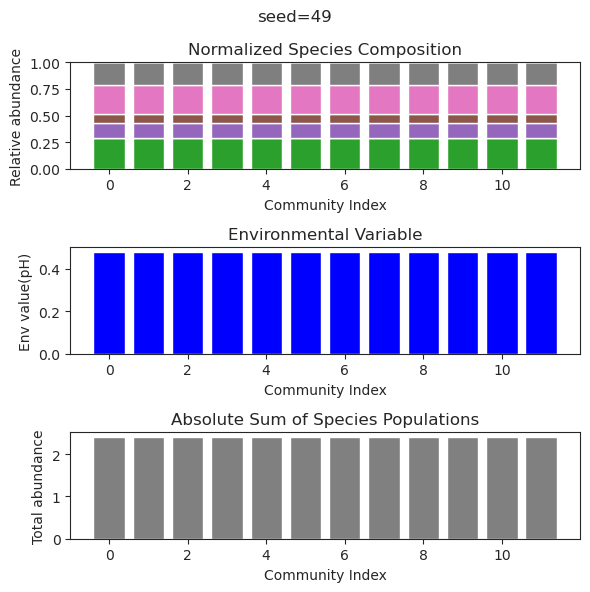

{'species': array([ 1.83611694e-01,  3.93639132e-32, -1.49797773e-72,  2.61670418e-33,
        1.22255632e-01,  1.56963311e-01,  3.75898622e-01, -9.05628398e-34,
        1.44716854e-02,  2.78487981e-01, -1.15001798e-56,  4.29274722e-01]), 'env': array([-1.06024593])}
{'species': array([ 1.83611694e-01,  2.40160802e-35,  8.28832719e-97, -1.01846748e-22,
        1.22255632e-01,  1.56963311e-01,  3.75898622e-01, -6.32662358e-41,
        1.44716854e-02,  2.78487981e-01,  2.35006241e-82,  4.29274722e-01]), 'env': array([-1.06024593])}
{'species': array([ 1.83611694e-01,  9.64224303e-34, -2.42598680e-78,  3.05819723e-24,
        1.22255632e-01,  1.56963311e-01,  3.75898622e-01, -2.96774367e-37,
        1.44716854e-02,  2.78487981e-01,  7.19992855e-61,  4.29274722e-01]), 'env': array([-1.06024593])}
{'species': array([ 1.83611694e-01, -4.03212473e-27,  1.93484639e-59, -1.06989729e-27,
        1.22255632e-01,  1.56963311e-01,  3.75898622e-01, -1.54160992e-30,
        1.44716854e-02,  2.7848798

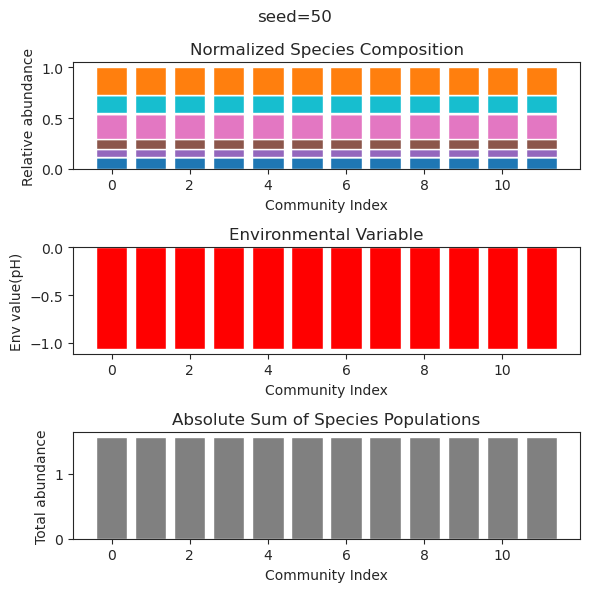

{'species': array([ 2.71522970e-01,  1.00406074e-01, -1.20131957e-92,  2.86437778e-30,
       -5.96755551e-46,  1.59066134e-59,  1.03971369e-59,  2.99520524e-56,
        1.98930571e-32,  7.02917821e-62, -2.16923882e-46,  1.43663179e-94]), 'env': array([-3.61993828])}
{'species': array([ 2.71522970e-01,  1.00406074e-01,  2.68420528e-59,  5.47457723e-27,
        1.37306325e-33,  6.31401556e-38,  2.51744039e-37,  4.77680182e-37,
       -2.21302420e-28,  7.21508350e-40,  7.85702427e-34,  2.91460767e-58]), 'env': array([-3.61993828])}
{'species': array([ 2.71522970e-01,  1.00406074e-01,  4.45034679e-78,  1.55562521e-28,
       -3.30937434e-39,  3.76963882e-51,  5.56683419e-51, -1.63534586e-47,
        2.04614554e-29,  8.32429168e-55, -1.22214676e-41,  2.04517031e-79]), 'env': array([-3.61993828])}
{'species': array([ 2.71522970e-01,  1.00406074e-01, -3.68916990e-75,  1.56515442e-29,
        1.94637222e-39,  3.50752235e-50,  1.30470712e-50,  1.41767261e-48,
       -5.14268265e-32,  9.1491389

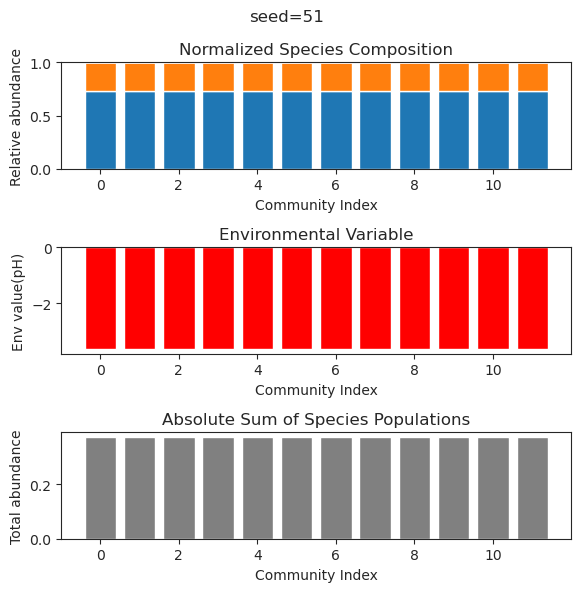

{'species': array([ 3.24313946e-01, -8.28550999e-39,  5.66663239e-54,  1.82702900e-01,
        8.12363503e-01, -7.25456882e-50,  3.26778020e-01, -1.09061561e-53,
        7.61363273e-27, -4.89325206e-36, -1.44341791e-44, -4.28030411e-43]), 'env': array([-2.32622876])}
{'species': array([ 3.24313946e-01, -4.23618028e-56, -3.74957531e-72,  1.82702900e-01,
        8.12363503e-01, -1.55505931e-73,  3.26778020e-01, -5.56714266e-76,
       -4.38135129e-29,  4.49435077e-51, -1.43207885e-52,  2.28860127e-66]), 'env': array([-2.32622876])}
{'species': array([ 3.24313946e-01, -1.77275301e-64,  2.84030422e-80,  1.82702900e-01,
        8.12363503e-01, -1.69248353e-81,  3.26778020e-01,  8.75243456e-84,
       -6.83687400e-30, -6.77330987e-57,  1.13292784e-53, -6.03192401e-73]), 'env': array([-2.32622876])}
{'species': array([ 3.24313946e-01,  1.10220887e-43,  4.70912431e-61,  1.82702900e-01,
        8.12363503e-01, -2.60784166e-59,  3.26778020e-01, -6.10225229e-57,
        4.55304300e-24,  1.1092327

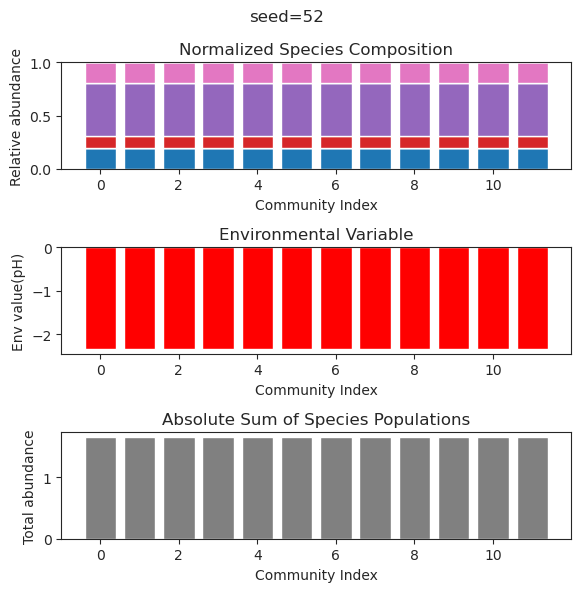

{'species': array([ 1.49434133e-01, -3.66561250e-46, -7.68725264e-47,  6.73742042e-01,
       -7.16715929e-22,  5.51643297e-73, -6.89139553e-22, -6.73507391e-78,
        6.78509122e-01,  7.94296740e-46,  5.90605525e-01, -7.04458552e-23]), 'env': array([-1.04641312])}
{'species': array([ 1.49434133e-01, -9.98072931e-39, -1.23140922e-40,  6.73742042e-01,
        1.67426735e-20,  4.09188209e-57, -8.18975089e-23, -2.99366616e-62,
        6.78509122e-01, -2.45714447e-42,  5.90605525e-01,  3.74301965e-29]), 'env': array([-1.04641312])}
{'species': array([ 1.49434133e-01,  4.51930422e-48,  2.00569617e-49,  6.73742042e-01,
        2.48470507e-19,  1.32576398e-68, -3.95714625e-26,  2.17926086e-76,
        6.78509122e-01, -1.45462442e-43,  5.90605525e-01,  2.59733045e-28]), 'env': array([-1.04641312])}
{'species': array([ 1.49434133e-01, -8.59254314e-42, -1.38162286e-44,  6.73742042e-01,
       -3.75005451e-18,  4.76400977e-62, -2.58383140e-20, -1.04074583e-64,
        6.78509122e-01,  6.5751347

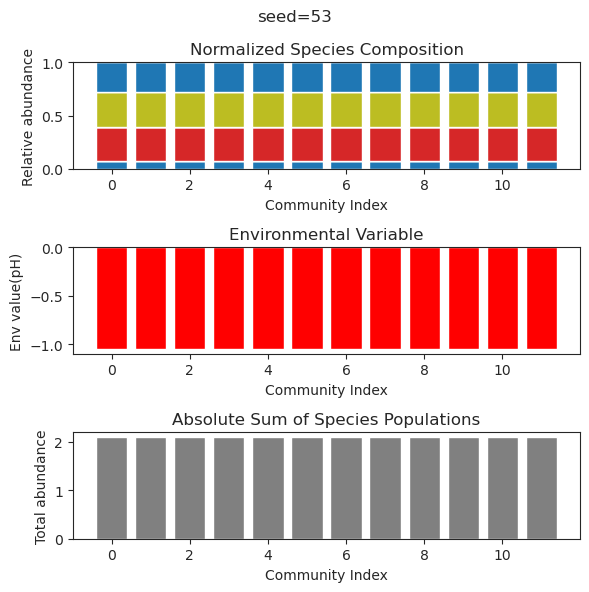

{'species': array([-4.68409762e-43,  2.79648916e-01, -8.99092628e-59, -3.55016982e-15,
       -1.69811967e-37,  4.55161611e-01, -1.24621300e-70, -1.03097112e-40,
       -8.04503656e-67,  1.29529608e-64,  1.15012755e-23,  3.85113997e-01]), 'env': array([-2.71016514])}
{'species': array([ 3.40865870e-54,  2.79648916e-01, -2.36212755e-67, -2.49237713e-16,
        1.36354163e-44,  4.55161611e-01, -3.70698114e-87, -1.97294638e-50,
       -3.79086286e-81,  3.87523761e-80,  5.74291805e-29,  3.85113997e-01]), 'env': array([-2.71016514])}
{'species': array([ 3.38824489e-41,  2.79648916e-01, -3.86105028e-53, -2.07066540e-14,
        6.52554066e-40,  4.55161611e-01,  1.27999720e-30, -2.85920644e-39,
       -4.82277419e-63,  2.79259819e-56, -2.15045946e-20,  3.85113997e-01]), 'env': array([-2.71016514])}
{'species': array([ 1.80534954e-37, -5.07383336e-39, -8.58983747e-85,  7.05570052e-11,
        4.91105759e-01,  1.85633435e-01,  4.21680989e-01,  8.12678826e-01,
        4.98987686e-01,  1.0325476

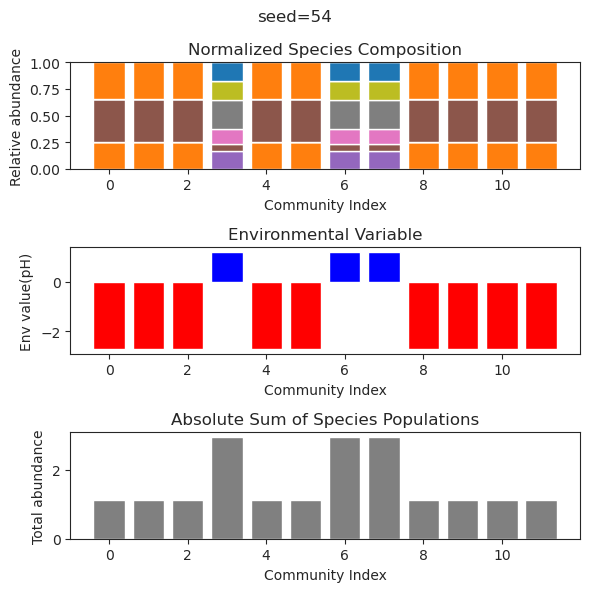

{'species': array([ 1.89845510e-01,  5.66280472e-56,  7.85624941e-01,  5.19391996e-01,
        6.60558185e-53,  3.60965262e-60,  6.36073784e-55, -5.19518826e-42,
        2.35601374e-01,  7.21281663e-32,  1.17624347e-59,  9.10761368e-49]), 'env': array([-1.39265398])}
{'species': array([ 1.89845510e-01, -1.12298625e-58,  7.85624941e-01,  5.19391996e-01,
       -3.98600321e-54,  4.11600551e-60, -2.41136592e-57, -4.41496974e-43,
        2.35601374e-01,  1.57457504e-32, -1.43058204e-58,  2.08255839e-52]), 'env': array([-1.39265398])}
{'species': array([ 1.89845510e-01,  1.02652681e-56,  7.85624941e-01,  5.19391996e-01,
       -1.23043749e-53,  2.40262451e-57, -3.25827571e-54, -3.24273919e-40,
        2.35601374e-01, -6.76721973e-32,  2.62481354e-58,  2.81859437e-44]), 'env': array([-1.39265398])}
{'species': array([ 1.89845510e-01, -1.82869818e-54,  7.85624941e-01,  5.19391996e-01,
        5.76861904e-50,  1.49878242e-56,  1.42184263e-53,  5.38147349e-42,
        2.35601374e-01,  4.7312796

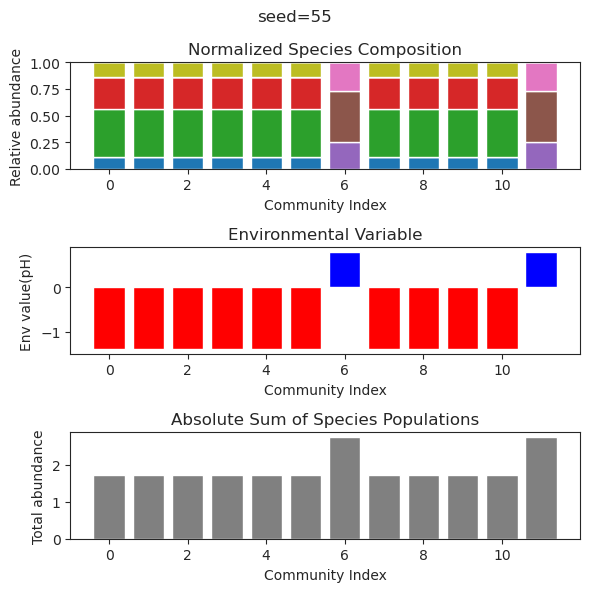

{'species': array([ 2.05647123e-01, -7.67229426e-44, -3.14572735e-24,  2.28088839e-19,
        6.17838615e-01, -4.43888333e-59,  8.37945295e-01,  8.86994899e-19,
        3.21417343e-24,  2.42727266e-44,  1.59225779e-50, -2.12798400e-30]), 'env': array([-1.83838899])}
{'species': array([ 2.05647123e-01, -1.30097092e-42, -6.98128978e-30, -2.80788785e-20,
        6.17838615e-01,  5.30339108e-61,  8.37945295e-01, -4.15954182e-20,
       -1.57178012e-23, -4.03834602e-48,  4.52997563e-52, -4.04587444e-30]), 'env': array([-1.83838899])}
{'species': array([ 2.05647123e-01,  1.97209948e-38,  2.92880186e-24, -8.51501981e-21,
        6.17838615e-01,  1.32464416e-53,  8.37945295e-01, -1.29850634e-19,
       -6.34097851e-21,  5.47681226e-36, -1.53500905e-42,  2.25168949e-27]), 'env': array([-1.83838899])}
{'species': array([ 2.05647123e-01,  6.62323705e-46,  1.31392120e-30, -1.60558008e-21,
        6.17838615e-01, -1.28637391e-64,  8.37945295e-01, -1.11330520e-20,
       -3.50151303e-24, -1.1565225

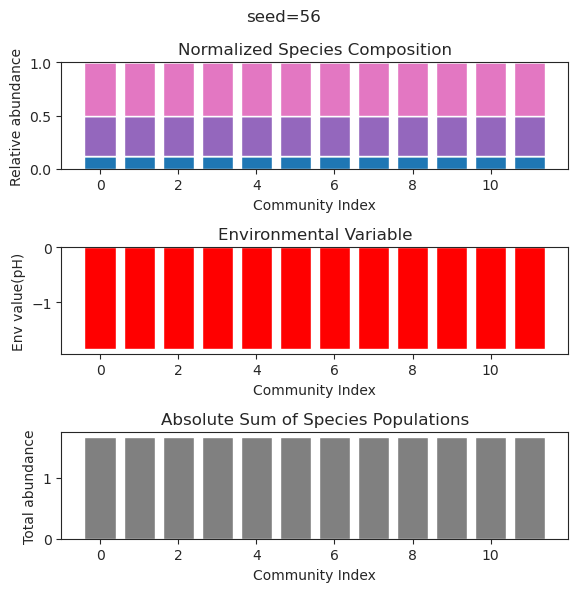

{'species': array([-2.40318279e-021,  3.63361845e-001, -3.11139587e-110,
        1.16150293e-001,  4.73166312e-036, -5.71365966e-115,
        1.60005646e-026, -7.12610855e-106,  1.26608549e-059,
        1.00710839e+000, -5.28235187e-068, -3.41613644e-112]), 'env': array([-2.66065866])}
{'species': array([-5.02975817e-29,  3.63361845e-01,  4.08834918e-67,  1.16150293e-01,
       -1.83899633e-38, -9.34789036e-71, -9.03837427e-32,  2.17921286e-71,
        1.95362015e-47,  1.00710839e+00, -7.83286995e-52,  1.14376972e-67]), 'env': array([-2.66065866])}
{'species': array([ 2.12252842e-23,  3.63361845e-01,  2.27122595e-74,  1.16150293e-01,
       -3.27389882e-35,  9.61080294e-73,  1.85137097e-22,  3.03706153e-83,
        3.49446441e-45,  1.00710839e+00,  3.31713431e-54,  2.00458483e-71]), 'env': array([-2.66065866])}
{'species': array([ 6.64377368e-21,  3.63361845e-01,  2.41226115e-85,  1.16150293e-01,
        3.31874958e-41,  1.01775370e-83, -1.18011889e-28, -1.45435794e-89,
       -6.94132

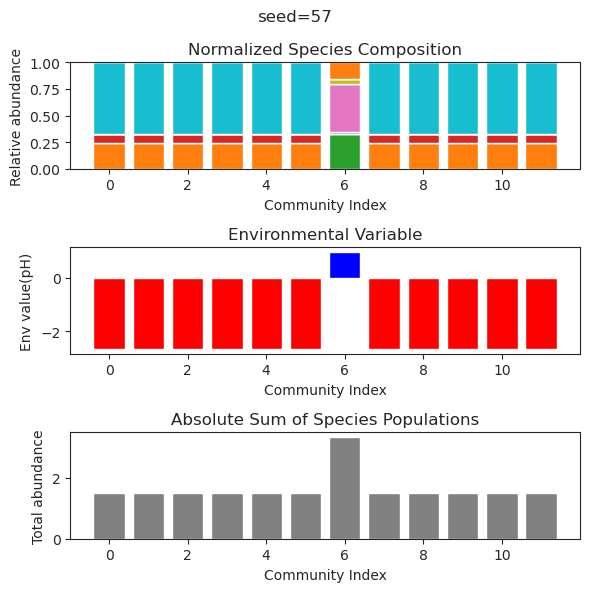

{'species': array([ 1.08581536e-25,  2.59634563e-01, -1.44356620e-47,  3.44924637e-35,
       -2.22887877e-45,  7.01260954e-27, -1.80178574e-43, -1.87358944e-40,
        7.86565487e-01,  8.49587982e-27,  1.64764166e-45,  4.03153186e-01]), 'env': array([-1.98461469])}
{'species': array([-3.83544010e-31,  2.59634563e-01, -6.45013780e-53,  2.15274137e-46,
        5.14836360e-56,  1.35637438e-24, -1.54017001e-54, -5.16788944e-48,
        7.86565487e-01, -2.86353832e-26, -2.56145393e-53,  4.03153186e-01]), 'env': array([-1.98461469])}
{'species': array([ 2.25981924e-85, -9.85731465e-85,  4.60259863e+00,  2.91146366e-68,
        4.91263588e-85,  2.95812250e+00,  6.60069441e-60, -1.92738986e-59,
        1.54742018e-58,  3.08589618e+00,  2.38901811e-01,  2.15993198e-82]), 'env': array([6.86816846])}
{'species': array([-4.82099234e-23,  2.59634563e-01,  1.53854243e-38, -2.58858669e-32,
       -1.89039205e-40,  2.90121833e-28, -7.22691266e-36,  4.17382380e-31,
        7.86565487e-01, -4.98798914

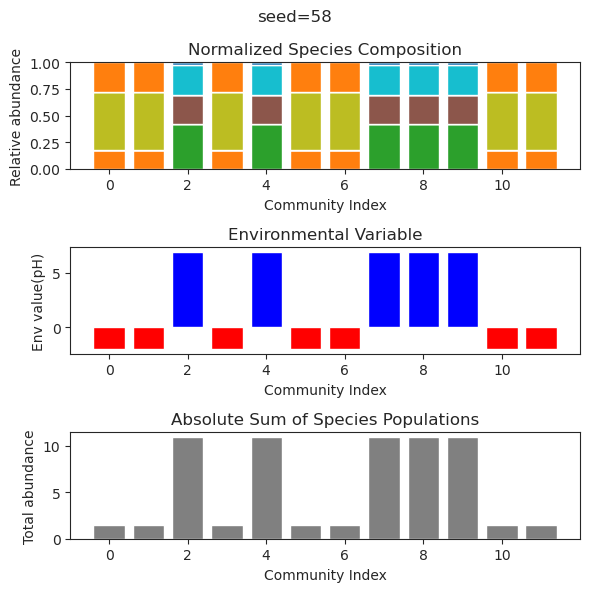

{'species': array([-1.55487565e-32,  2.50610839e-01,  6.88994671e-02,  8.09344565e-51,
        3.69640607e-48, -1.20323357e-56,  2.21425479e-45,  3.97678472e-01,
        5.00151071e-26,  6.76860949e-01, -3.13208392e-43, -2.34317834e-62]), 'env': array([-2.03466633])}
{'species': array([ 5.26031026e-32,  2.50610839e-01,  6.88994671e-02, -6.37049511e-48,
       -6.42347095e-38, -2.15124745e-54,  3.17074550e-43,  3.97678472e-01,
       -5.71317148e-24,  6.76860949e-01, -1.61235624e-35, -1.12889685e-58]), 'env': array([-2.03466633])}
{'species': array([-6.87513160e-036,  2.50610839e-001,  6.88994671e-002,
        4.15294878e-083, -1.52205944e-057, -1.49319353e-102,
       -3.39306023e-072,  3.97678472e-001, -4.77884722e-027,
        6.76860949e-001,  1.05816908e-054, -3.18647008e-089]), 'env': array([-2.03466633])}
{'species': array([-1.35305198e-29,  2.50610839e-01,  6.88994671e-02, -2.39135848e-47,
        4.50224794e-42, -6.80504320e-56,  1.57921437e-45,  3.97678472e-01,
        1.67081

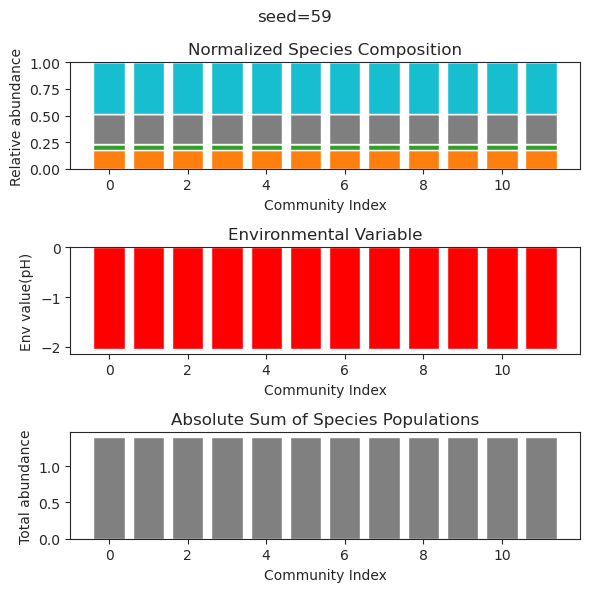

{'species': array([ 1.24652952e-01,  2.58714867e-01,  5.53900284e-01,  1.27314955e-28,
        3.91401255e-48, -2.09694400e-19,  4.26182769e-42,  6.08912939e-46,
       -1.84177942e-35,  5.02857012e-01,  3.05428950e-51,  4.06941544e-49]), 'env': array([-2.92960594])}
{'species': array([ 1.24652952e-01,  2.58714867e-01,  5.53900284e-01,  1.22277228e-27,
       -1.66061771e-44,  5.74636238e-19,  8.42396260e-39,  2.55279985e-43,
        3.35182461e-31,  5.02857012e-01, -1.05772914e-49, -3.38366971e-47]), 'env': array([-2.92960594])}
{'species': array([ 1.24652952e-01,  2.58714867e-01,  5.53900284e-01,  8.82152037e-28,
       -2.60137675e-44,  2.83799406e-19, -1.55427576e-37,  1.86504830e-42,
       -6.34730296e-32,  5.02857012e-01,  1.14764973e-50, -5.54212473e-46]), 'env': array([-2.92960594])}
{'species': array([ 1.24652952e-01,  2.58714867e-01,  5.53900284e-01, -4.61787209e-30,
        1.29747658e-47,  2.72111573e-22, -9.84174792e-42,  9.93150068e-45,
        5.29076049e-33,  5.0285701

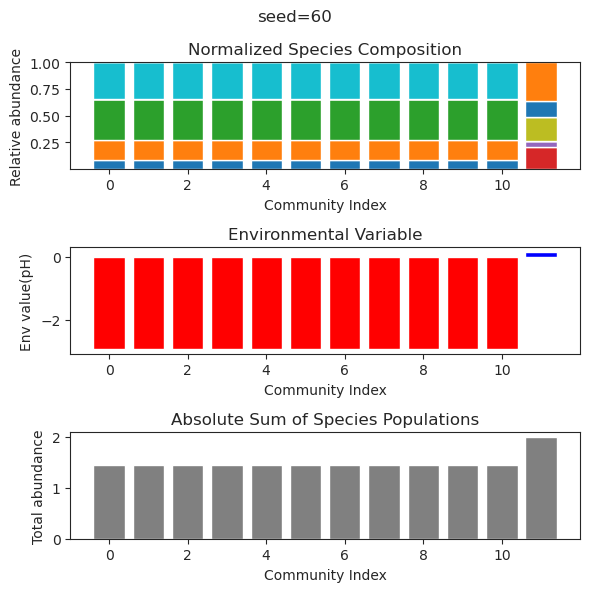

{'species': array([ 7.31579985e-02, -1.07240505e-59, -1.03488136e-25,  4.17369582e-01,
        4.34891241e-01,  7.58058592e-02, -4.82183120e-17, -4.81713997e-72,
        4.57216927e-01,  1.32902744e-01, -6.46391390e-60,  1.15002850e-01]), 'env': array([-0.28995595])}
{'species': array([ 7.31579985e-02,  5.71451025e-52,  4.18424627e-32,  4.17369582e-01,
        4.34891241e-01,  7.58058592e-02,  3.91541435e-22, -3.71471727e-67,
        4.57216927e-01,  1.32902744e-01,  4.18953954e-55,  1.15002850e-01]), 'env': array([-0.28995595])}
{'species': array([ 1.33907715e-089,  6.28210147e-033,  5.42264459e-001,
        1.11194987e-016,  7.93225033e-001,  4.99930126e-002,
        4.60080434e-062,  1.27853706e-001,  4.18937496e-001,
        1.55359911e-026, -5.19199123e-073, -1.36945949e-115]), 'env': array([0.46452164])}
{'species': array([ 7.31579985e-02, -1.47543560e-56, -2.44464743e-24,  4.17369582e-01,
        4.34891241e-01,  7.58058592e-02,  3.00470983e-17, -1.07928393e-66,
        4.572169

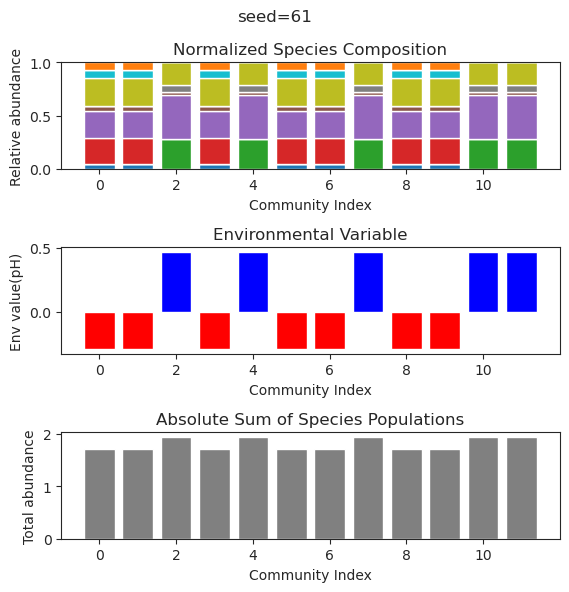

{'species': array([ 9.17053020e-32,  2.00656323e-01,  5.06644839e-01, -2.04866865e-41,
        5.11725003e-01,  6.23498393e-60,  2.19647967e-01, -8.67559025e-58,
       -2.26185341e-40, -4.87169905e-29,  9.09122633e-56,  1.39561452e-51]), 'env': array([-1.39995615])}
{'species': array([ 5.33310334e-34,  2.00656323e-01,  5.06644839e-01,  1.08572278e-39,
        5.11725003e-01, -1.05519829e-58,  2.19647967e-01,  5.21684230e-61,
       -4.44736745e-39, -1.25791817e-32, -5.35893018e-55, -3.34709638e-54]), 'env': array([-1.39995615])}
{'species': array([ 1.43898133e-64, -8.60800694e-31,  3.40237724e-77,  1.20463001e+00,
       -2.73052874e-44,  7.51650002e-01, -1.13876843e-54,  7.11307186e-49,
        1.48038319e+00, -7.92693502e-31,  2.40720931e+00,  7.21773591e-01]), 'env': array([2.90109328])}
{'species': array([-9.15045668e-30,  2.00656323e-01,  5.06644839e-01,  2.42452713e-34,
        5.11725003e-01,  5.74046502e-44,  2.19647967e-01, -1.19407739e-45,
       -1.19392929e-37,  2.26113811

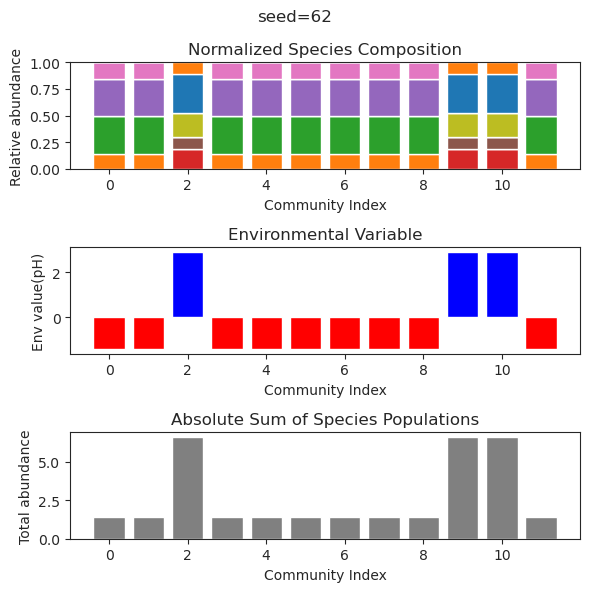

{'species': array([ 1.42025653e-01, -8.10862894e-70,  1.41481884e-63,  8.04843223e-01,
        2.40129056e-71,  1.63126232e-83,  3.24575655e-01, -2.65728430e-59,
       -3.44405534e-34,  3.19902540e-01, -1.76703139e-68,  1.84272450e-01]), 'env': array([-0.98136654])}
{'species': array([ 1.42025653e-01,  2.23826661e-61,  5.62615543e-58,  8.04843223e-01,
       -3.88041143e-61, -1.07888187e-72,  3.24575655e-01,  1.33416733e-54,
       -2.42791102e-29,  3.19902540e-01,  1.90420660e-60,  1.84272450e-01]), 'env': array([-0.98136654])}
{'species': array([ 1.42025653e-01, -2.51344453e-69,  4.20678332e-62,  8.04843223e-01,
        2.23944296e-67, -3.81843579e-94,  3.24575655e-01,  1.46036818e-61,
        2.62451786e-33,  3.19902540e-01,  1.25009077e-71,  1.84272450e-01]), 'env': array([-0.98136654])}
{'species': array([ 1.42025653e-01,  5.82992155e-35, -6.77012170e-31,  8.04843223e-01,
       -1.96174756e-35,  2.03136714e-39,  3.24575655e-01,  6.70878619e-27,
       -2.07460808e-19,  3.1990254

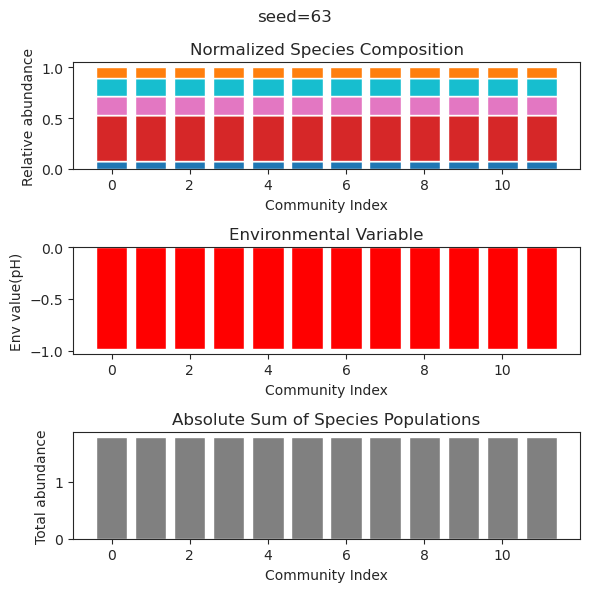

{'species': array([ 1.91595882e-01, -1.00743989e-24, -1.10240324e-70,  6.31565176e-21,
       -4.04052580e-47,  4.75372120e-01,  5.79578592e-01,  2.58930094e-72,
        3.20120327e-01,  2.21743661e-60,  2.47603972e-27, -1.46394378e-18]), 'env': array([-1.54369621])}
{'species': array([ 1.91595882e-01, -2.23044193e-23, -8.76156723e-71, -9.98744011e-19,
       -3.92366359e-68,  4.75372120e-01,  5.79578592e-01, -2.90590603e-66,
        3.20120327e-01, -1.24277087e-66, -2.36627803e-28, -1.16699442e-16]), 'env': array([-1.54369621])}
{'species': array([ 1.91595882e-01,  4.05927667e-19,  8.38018037e-63, -2.39790490e-16,
       -1.82028335e-63,  4.75372120e-01,  5.79578592e-01,  3.17660286e-59,
        3.20120327e-01,  5.33878165e-58, -1.30281270e-23, -1.01807194e-14]), 'env': array([-1.54369621])}
{'species': array([ 1.91595882e-001, -9.78201045e-021,  1.39917164e-106,
       -6.46785908e-017, -4.00035789e-109,  4.75372120e-001,
        5.79578592e-001, -7.76879569e-095,  3.20120327e-001,
 

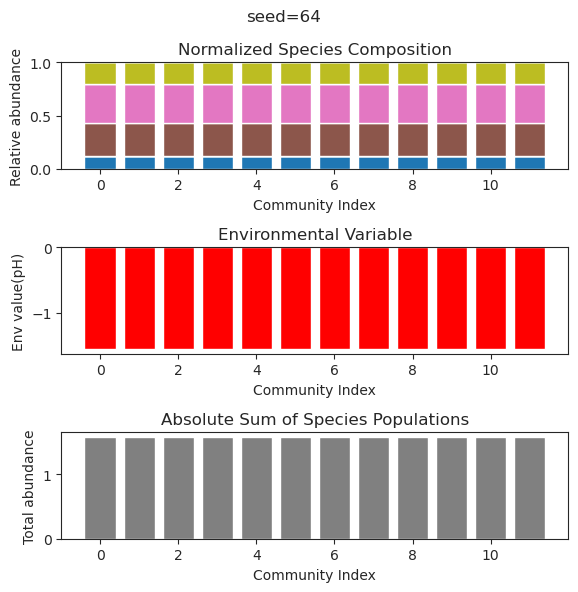

{'species': array([-1.34224116e-36,  2.16196025e-01, -1.81210804e-21,  3.50017936e-01,
       -5.82028759e-35,  7.46499102e-32,  1.21686783e+00,  3.97612131e-41,
        2.49494925e-33, -2.27004295e-52, -1.68320959e-53,  1.74670254e-40]), 'env': array([-2.11688393])}
{'species': array([ 6.95701205e-36,  2.16196025e-01, -1.13330931e-19,  3.50017936e-01,
       -3.27490819e-28,  8.43560146e-28,  1.21686783e+00,  1.56561470e-32,
       -2.58194091e-28,  7.64763792e-46,  8.60373009e-50, -7.47669919e-33]), 'env': array([-2.11688393])}
{'species': array([-3.70465243e-34,  2.16196025e-01, -2.93757538e-20,  3.50017936e-01,
        9.07509131e-27,  3.50058944e-25,  1.21686783e+00,  1.14397736e-31,
        2.10180520e-27, -1.94637442e-45, -4.92426770e-48, -3.61510749e-33]), 'env': array([-2.11688393])}
{'species': array([-6.01125956e-33,  2.16196025e-01,  2.03207741e-20,  3.50017936e-01,
        3.70238038e-36,  2.89159177e-30,  1.21686783e+00, -8.59492757e-35,
        5.34900789e-34,  2.2620443

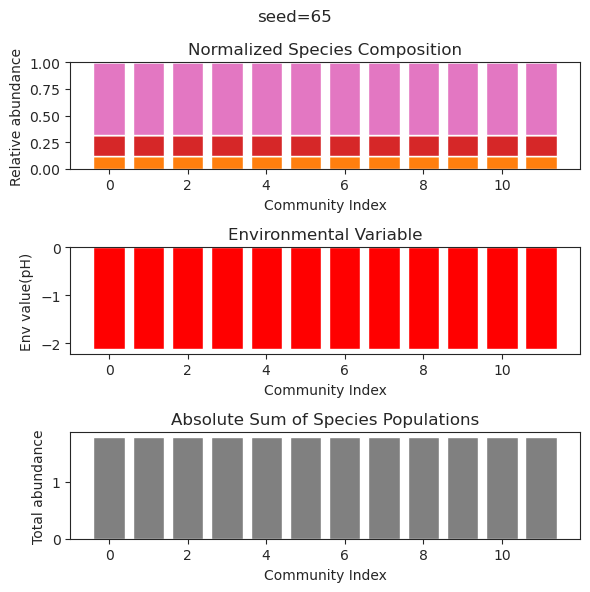

{'species': array([-2.70560417e-039,  0.00000000e+000,  3.31323314e+000,
        4.90107730e-076,  2.69957716e+000, -1.35991906e-281,
        5.75724079e-279, -5.90470986e-104,  2.82127590e-001,
        0.00000000e+000, -1.86329270e-059, -2.42913886e-089]), 'env': array([2.56084017])}
{'species': array([-2.70560417e-039,  0.00000000e+000,  3.31323314e+000,
        4.90107730e-076,  2.69957716e+000, -1.35991906e-281,
        5.75724079e-279, -5.90470986e-104,  2.82127590e-001,
        0.00000000e+000, -1.86329270e-059, -2.42913886e-089]), 'env': array([2.56084017])}
{'species': array([-2.70560417e-039,  0.00000000e+000,  3.31323314e+000,
        4.90107730e-076,  2.69957716e+000, -1.35991906e-281,
        5.75724079e-279, -5.90470986e-104,  2.82127590e-001,
        0.00000000e+000, -1.86329270e-059, -2.42913886e-089]), 'env': array([2.56084017])}
{'species': array([-2.70560417e-039,  0.00000000e+000,  3.31323314e+000,
        4.90107730e-076,  2.69957716e+000, -1.35991906e-281,
        

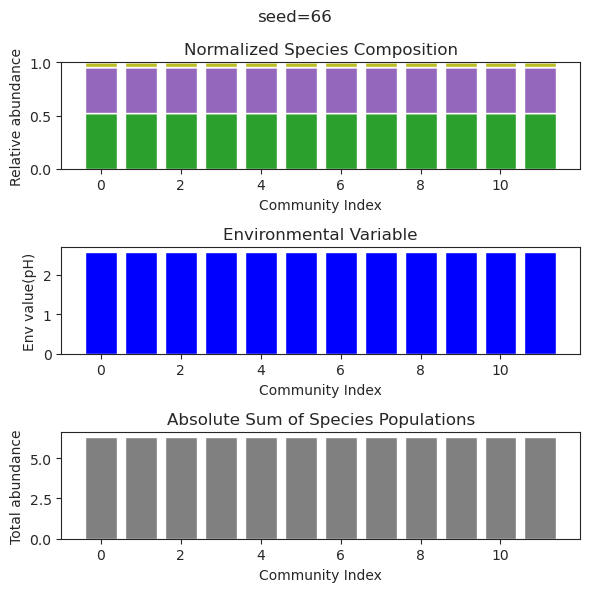

{'species': array([ 1.31416750e-056,  1.49881745e-001,  9.64459817e-058,
       -1.49632156e-196,  2.54420824e-003, -2.10426379e-098,
       -6.92073554e-059,  5.95152641e-001, -2.71822500e-047,
        7.63113429e-047,  1.65298345e-001,  7.37796168e-001]), 'env': array([-0.73797057])}
{'species': array([-4.23910290e-062,  1.49881899e-001, -7.93671912e-197,
       -5.64246851e-190,  2.53087983e-003,  3.07503515e-103,
        5.76468236e-078,  5.95154090e-001, -2.44723946e-067,
       -1.72423278e-104,  1.65301447e-001,  7.37797727e-001]), 'env': array([-0.73797367])}
{'species': array([-3.50017965e-047,  1.49881811e-001, -1.12565018e-181,
       -2.02166744e-171,  2.53851012e-003, -8.24233531e-061,
        4.78313325e-061,  5.95153260e-001,  6.58703858e-105,
       -6.09902637e-050,  1.65299671e-001,  7.37796834e-001]), 'env': array([-0.73797189])}
{'species': array([ 2.87883702e-070,  1.49881742e-001,  2.10312851e-181,
       -2.74148602e-176,  2.54453968e-003,  1.38161796e-069,
     

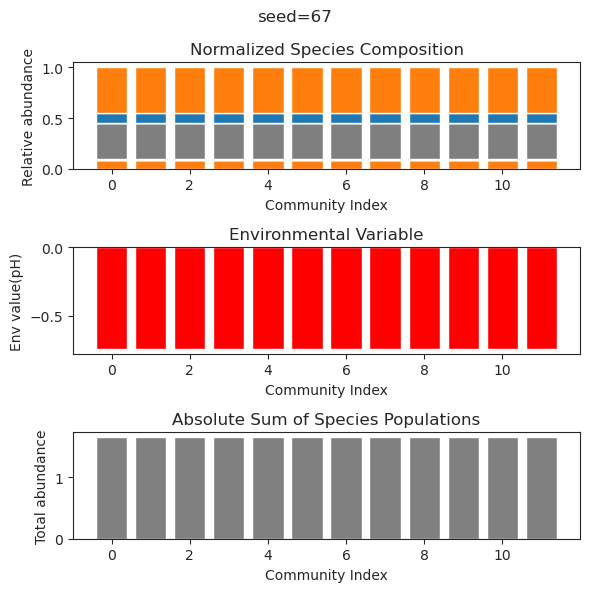

{'species': array([ 3.45451819e-062,  1.81557171e-001,  7.11007781e-002,
        3.82782940e-001, -5.53891234e-122,  2.70175013e-084,
        3.37615909e-001,  5.27482209e-023, -1.97509197e-051,
        7.02635036e-001,  4.35343086e-023, -1.64207912e-122]), 'env': array([-0.99263947])}
{'species': array([-2.27078707e-061,  1.81557171e-001,  7.11007781e-002,
        3.82782940e-001, -2.50315539e-126,  6.37982329e-086,
        3.37615909e-001,  2.50758729e-023, -1.96328044e-051,
        7.02635036e-001,  1.79874626e-024, -2.02493301e-126]), 'env': array([-0.99263947])}
{'species': array([-2.17085261e-060,  1.81557171e-001,  7.11007781e-002,
        3.82782940e-001,  4.93297101e-114, -6.68175020e-081,
        3.37615909e-001,  1.39373971e-021,  1.71401614e-049,
        7.02635036e-001,  1.50698408e-022,  4.91014238e-115]), 'env': array([-0.99263947])}
{'species': array([-9.31398169e-059,  1.81557171e-001,  7.11007781e-002,
        3.82782940e-001,  1.40061557e-110,  1.11102308e-081,
     

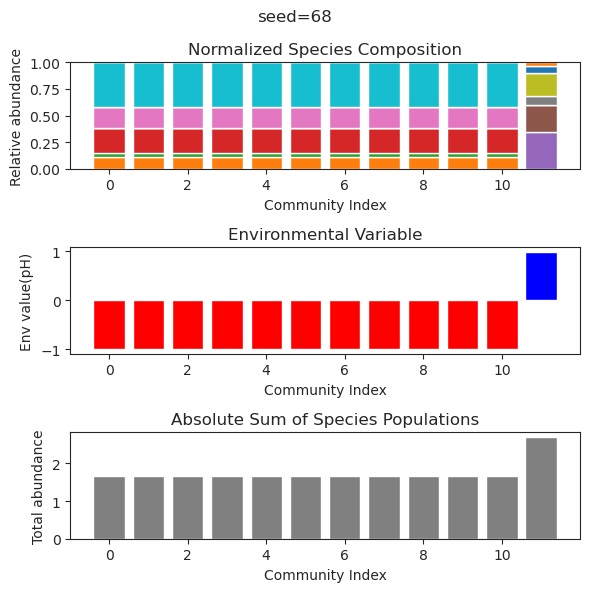

{'species': array([4.63205229e-002, 9.55941928e-002, 6.13410095e-001, 3.65329781e-001,
       6.10003514e-002, 1.71127145e-033, 7.16431768e-109, 2.02014306e-001,
       2.25753074e-002, 3.34802033e-152, 2.59027890e-001, 4.31955963e-166]), 'env': array([-0.61015344])}
{'species': array([ 4.63205251e-002,  9.55941859e-002,  6.13410111e-001,
        3.65329794e-001,  6.10003356e-002,  1.90966628e-029,
       -2.63778705e-084,  2.02014261e-001,  2.25753322e-002,
        7.18503037e-123,  2.59027875e-001,  5.86705626e-176]), 'env': array([-0.61015345])}
{'species': array([ 1.92132499e-01,  2.03027226e-29,  8.64779268e-01,  4.06395184e-32,
        1.62219476e-01,  5.22619559e-02,  5.84052938e-29,  7.16233935e-62,
        9.58090549e-04,  8.47282266e-30,  1.51182592e-01, -6.08732759e-27]), 'env': array([-1.44615817])}
{'species': array([-7.93571950e-42, -2.51760820e-62,  4.54103188e-82,  1.12386289e+00,
        4.43386655e-73, -9.67528822e-56,  1.06646459e+00,  1.71755071e+00,
        4.96234

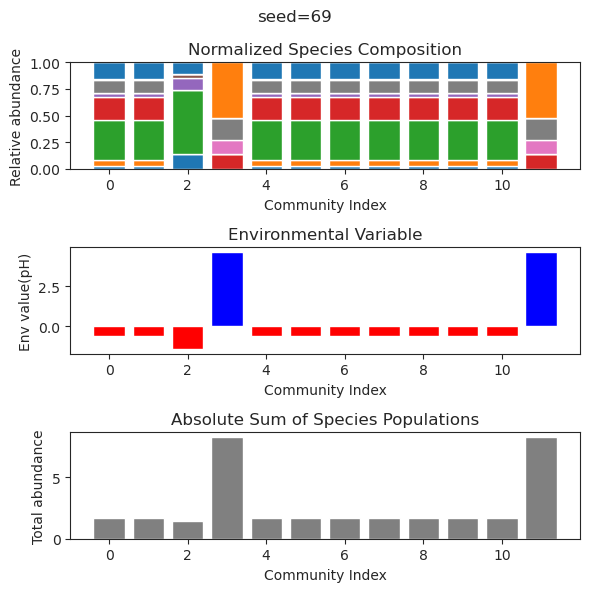

{'species': array([ 1.10512569e-39,  2.75404114e-01,  4.64327713e-59,  8.45639651e-42,
       -1.26982948e-31,  1.15084901e-01,  5.16109152e-64,  1.41815249e+00,
        3.22745341e-57,  3.57615832e-64, -8.57427250e-67, -5.14823683e-29]), 'env': array([-2.62018265])}
{'species': array([ 8.03007862e-35,  2.75404114e-01, -5.01086097e-45,  1.02208295e-34,
        6.51438601e-28,  1.15084901e-01, -8.30895764e-44,  1.41815249e+00,
       -1.05510113e-44, -1.74119710e-45, -1.85109085e-47,  1.65072895e-28]), 'env': array([-2.62018265])}
{'species': array([-3.59271309e-29,  2.75404114e-01, -1.13859831e-38, -6.79115118e-28,
       -6.15610826e-25,  1.15084901e-01,  1.53706094e-38,  1.41815249e+00,
       -4.32653340e-39, -3.65900869e-38, -6.26715089e-40, -5.37711703e-23]), 'env': array([-2.62018265])}
{'species': array([-9.43385454e-37,  2.75404114e-01, -2.17967476e-55, -1.88612745e-35,
       -7.43974554e-27,  1.15084901e-01, -1.03395392e-51,  1.41815249e+00,
       -8.10051597e-51, -5.3535299

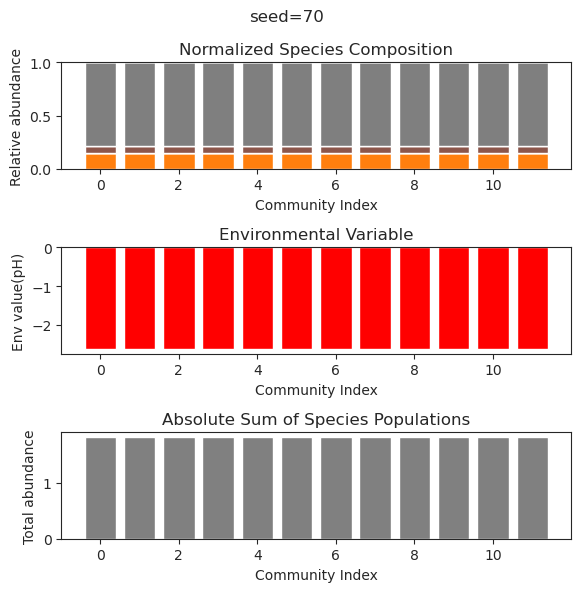

{'species': array([-8.76438681e-132,  1.36719415e-001,  2.28990281e-001,
        2.22530238e-133,  7.68295385e-043, -3.74069297e-110,
        3.96797926e-001,  3.99785176e-001, -1.48374659e-108,
       -5.99103994e-063, -3.76824622e-130,  5.18140256e-001]), 'env': array([-0.98371936])}
{'species': array([ 4.22006666e-134,  1.36719415e-001,  2.28990281e-001,
        6.28756571e-133,  6.94877219e-043, -7.07775823e-112,
        3.96797926e-001,  3.99785176e-001,  9.20492887e-107,
       -4.69384605e-064, -3.10645777e-130,  5.18140256e-001]), 'env': array([-0.98371936])}
{'species': array([-5.20176358e-135,  1.36719415e-001,  2.28990281e-001,
        6.45333293e-130, -1.07242033e-042, -2.69526772e-106,
        3.96797926e-001,  3.99785176e-001,  8.87401095e-105,
        1.61603836e-063, -2.71564479e-131,  5.18140256e-001]), 'env': array([-0.98371936])}
{'species': array([-2.69001497e-125,  1.36719415e-001,  2.28990281e-001,
       -3.46325207e-116,  1.73638039e-039, -6.11973083e-100,
     

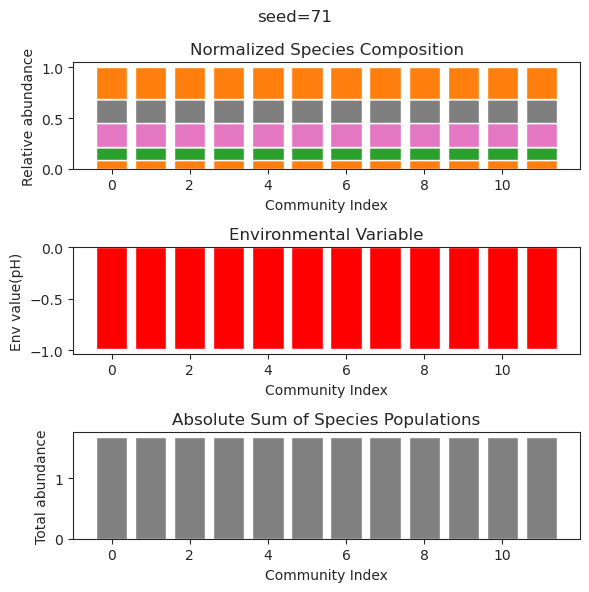

{'species': array([ 1.19652153e-01,  1.70921313e-03, -1.03888261e-22,  8.56776706e-38,
       -1.74913404e-83, -6.11870062e-28,  7.44855630e-01,  2.07150388e-46,
        6.47288546e-01,  1.59519968e-01, -3.17769852e-77, -2.00627358e-64]), 'env': array([-1.11368369])}
{'species': array([ 1.19652332e-01,  1.70893753e-03, -3.77504237e-15, -7.81396593e-30,
       -7.77385457e-26, -1.02141116e-34,  7.44855560e-01,  9.36254575e-39,
        6.47287992e-01,  1.59520606e-01,  1.09865118e-50,  1.13335227e-33]), 'env': array([-1.1136826])}
{'species': array([ 1.19652951e-01,  1.70798861e-03, -5.62316067e-26,  5.13427054e-80,
        1.09665231e-74, -8.82325555e-61,  7.44855318e-01,  5.16151894e-35,
        6.47286084e-01,  1.59522800e-01, -2.10309408e-64,  5.41566182e-53]), 'env': array([-1.11367886])}
{'species': array([ 1.19652932e-01,  1.70801680e-03,  4.26727306e-28,  3.25225448e-56,
        8.51620245e-57, -1.40764441e-45,  7.44855325e-01,  2.45282103e-34,
        6.47286140e-01,  1.59522735

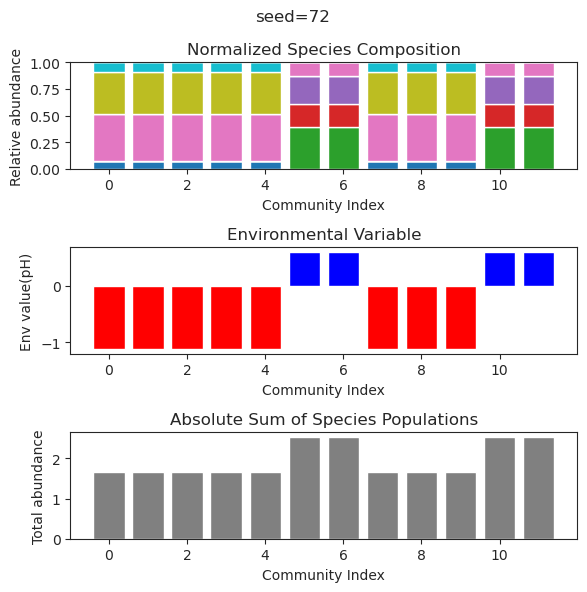

{'species': array([ 7.06399578e-002, -6.42243013e-092, -1.85637969e-057,
        6.21699179e-001, -6.28383225e-176,  5.46204639e-001,
       -1.44200616e-069,  3.30922000e-126,  2.42184216e-001,
        2.87528502e-001,  2.35954298e-001,  7.30238245e-100]), 'env': array([-0.30522734])}
{'species': array([ 7.06399578e-002, -6.09951096e-076, -2.10751686e-041,
        6.21699179e-001,  9.29642394e-155,  5.46204639e-001,
        4.58276919e-051, -3.78960575e-112,  2.42184216e-001,
        2.87528502e-001,  2.35954298e-001, -9.79139162e-086]), 'env': array([-0.30522734])}
{'species': array([ 7.06399578e-002,  1.01930179e-072, -2.53478869e-041,
        6.21699179e-001, -1.30227915e-149,  5.46204639e-001,
       -3.05826922e-051, -2.20529281e-109,  2.42184216e-001,
        2.87528502e-001,  2.35954298e-001,  2.17527339e-087]), 'env': array([-0.30522734])}
{'species': array([ 7.06399578e-002,  1.12686381e-075, -6.03134629e-039,
        6.21699179e-001,  1.59617478e-156,  5.46204639e-001,
     

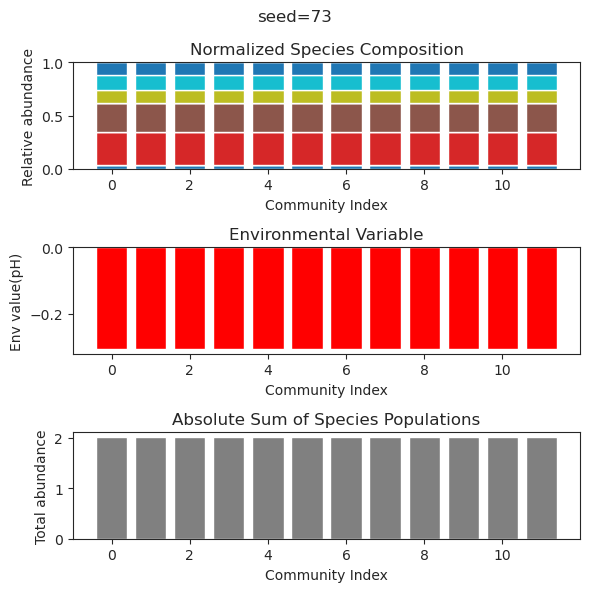

{'species': array([ 2.25448675e-22,  2.52574786e-01,  1.83807389e-01,  8.65403599e-01,
        2.68806484e-39, -3.68828684e-51,  2.13369031e-01, -6.96105686e-30,
       -4.12231981e-45,  5.64725350e-01,  7.71535432e-34, -2.43837556e-38]), 'env': array([-1.47334525])}
{'species': array([-1.70606531e-27,  2.52574786e-01,  1.83807389e-01,  8.65403599e-01,
        1.69079229e-40,  8.32606043e-48,  2.13369031e-01, -2.52180116e-29,
        5.28457758e-43,  5.64725350e-01,  2.64582372e-32,  1.42094543e-35]), 'env': array([-1.47334525])}
{'species': array([ 8.19111750e-25,  2.52574786e-01,  1.83807389e-01,  8.65403599e-01,
        3.41850637e-43, -2.10061056e-45,  2.13369031e-01,  7.07857074e-30,
        1.03333956e-43,  5.64725350e-01, -7.63804646e-35, -6.09865234e-35]), 'env': array([-1.47334525])}
{'species': array([ 3.83770207e-22,  2.52574786e-01,  1.83807389e-01,  8.65403599e-01,
        1.19236766e-40, -3.89682419e-50,  2.13369031e-01, -2.59567375e-29,
       -1.78163982e-46,  5.6472535

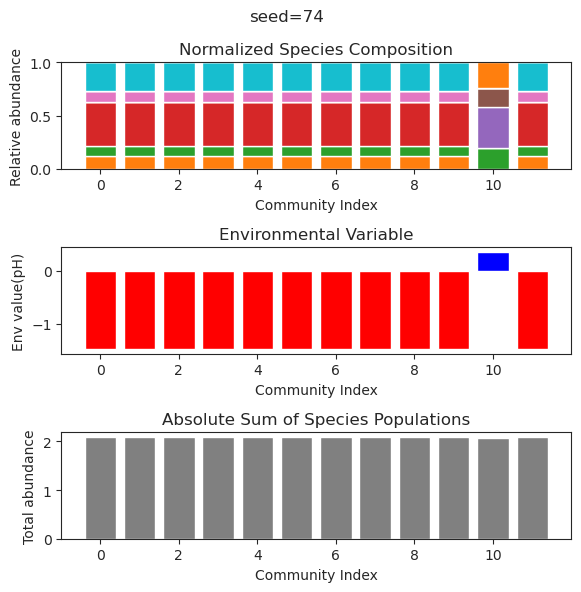

{'species': array([ 1.13742427e-51,  2.72406099e-01, -1.03549990e-27,  4.08552220e-01,
       -1.54027239e-19, -1.67912202e-69, -2.60064316e-68,  8.14840768e-62,
        1.29478366e-70,  6.50402058e-52,  7.91495737e-01, -2.63759727e-58]), 'env': array([-2.24186042])}
{'species': array([-2.94603304e-39,  2.72406099e-01, -2.69721799e-24,  4.08552220e-01,
        1.20514310e-18, -1.09121547e-50, -1.01998066e-50, -2.41609808e-47,
        5.39081173e-60,  1.14398602e-45,  7.91495737e-01,  1.24375217e-50]), 'env': array([-2.24186042])}
{'species': array([ 6.44511670e-40,  2.72406099e-01,  9.94443688e-27,  4.08552220e-01,
       -4.39721370e-18,  1.61158110e-52,  4.94484809e-50, -1.19816674e-47,
       -1.41293567e-58,  1.12609156e-46,  7.91495737e-01,  1.15138294e-52]), 'env': array([-2.24186042])}
{'species': array([ 1.16093454e-39,  2.72406099e-01, -2.46985812e-31,  4.08552220e-01,
        9.16284767e-17,  5.21664865e-46,  2.10247760e-42,  4.46343660e-42,
       -2.29746320e-45,  9.8234693

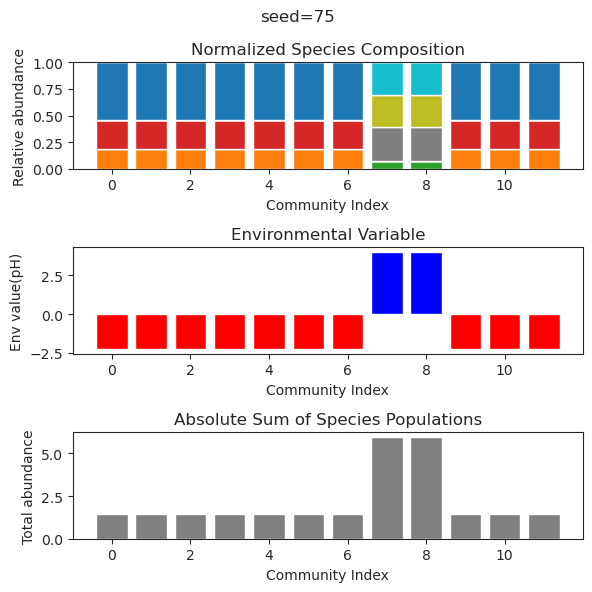

{'species': array([ 2.26038731e-70, -1.06552277e-55,  1.90282872e-35,  5.40681540e-01,
        5.01723933e-43,  2.09913884e-53,  7.24834386e-01,  1.74801117e+00,
        1.02633949e+00,  1.54382885e-59, -1.68663523e-66, -1.78949397e-63]), 'env': array([1.79631142])}
{'species': array([ 2.40096217e-38,  1.85097735e-54, -6.10954861e-37,  5.40681540e-01,
       -1.28165599e-44, -1.24733620e-53,  7.24834386e-01,  1.74801117e+00,
        1.02633949e+00, -8.52498207e-68,  4.42098719e-71, -3.46769489e-69]), 'env': array([1.79631142])}
{'species': array([ 1.49290406e-53, -1.05201149e-40,  9.32570223e-37,  5.40681540e-01,
        8.43206067e-41,  3.54904447e-44,  7.24834386e-01,  1.74801117e+00,
        1.02633949e+00,  3.33888822e-46,  4.12763250e-52,  2.35049972e-50]), 'env': array([1.79631142])}
{'species': array([ 3.11895292e-63,  3.91363693e-48, -6.30062503e-39,  5.40681540e-01,
       -2.99395334e-38, -2.40834706e-41,  7.24834386e-01,  1.74801117e+00,
        1.02633949e+00, -7.58582281e-

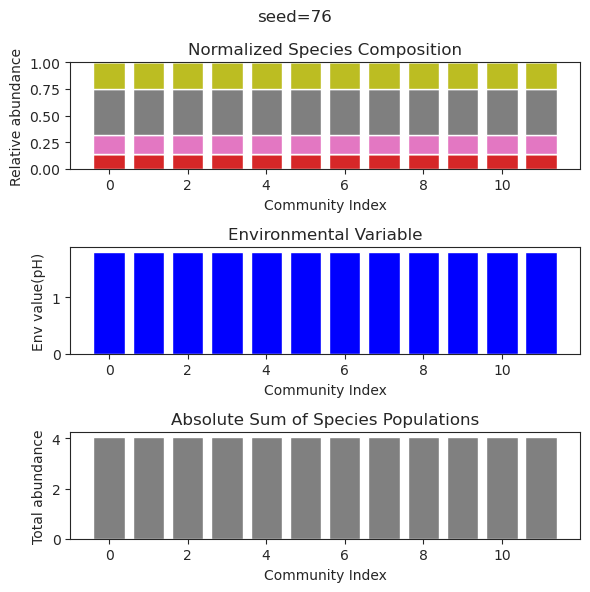

{'species': array([ 4.68997232e-20,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
        1.97909915e-51, -5.64596347e-25,  3.64542721e-39,  1.29757920e-01,
       -2.38658588e-48,  1.54274597e-58, -1.48349484e-58,  4.48744115e-59]), 'env': array([-1.3936028])}
{'species': array([ 2.46764198e-25,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
       -3.85266420e-63, -2.75103022e-32, -2.12263299e-38,  1.29757920e-01,
       -6.04869681e-54,  4.33154617e-69, -9.52749250e-63, -6.32871199e-65]), 'env': array([-1.3936028])}
{'species': array([-2.37130583e-23,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
        1.70594375e-45,  1.70991900e-24, -5.75840731e-27,  1.29757920e-01,
       -4.76296347e-36, -2.49246356e-51, -1.63663127e-44, -3.22171983e-49]), 'env': array([-1.3936028])}
{'species': array([-5.19264776e-26,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
       -1.20334206e-63, -4.55342950e-31, -1.54446434e-36,  1.29757920e-01,
       -6.78598990e-53, -2.30835035e-

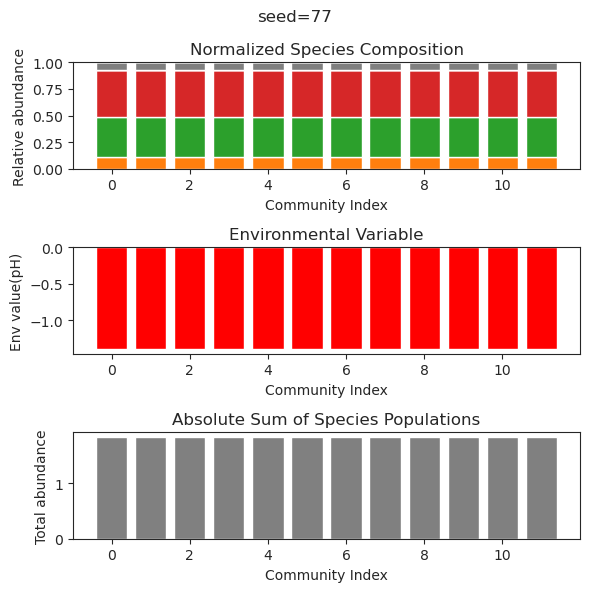

{'species': array([ 4.50975116e-25,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
       -5.63154558e-62, -8.52872449e-29,  1.82448615e-34,  1.29757920e-01,
        3.63114858e-47,  1.55704214e-64,  1.44631370e-57,  3.43940610e-59]), 'env': array([-1.3936028])}
{'species': array([ 4.50975116e-25,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
       -5.63154558e-62, -8.52872449e-29,  1.82448615e-34,  1.29757920e-01,
        3.63114858e-47,  1.55704214e-64,  1.44631370e-57,  3.43940610e-59]), 'env': array([-1.3936028])}
{'species': array([ 5.47896340e-47,  5.80676259e-37, -1.19573778e-70,  7.76812680e-77,
        6.22951076e-75,  4.90369765e+00,  3.67834960e-42, -2.24089001e-54,
       -5.57007846e-72,  6.50060265e+00, -1.70705729e-78,  2.77681450e-73]), 'env': array([6.96083421])}
{'species': array([-2.93735204e-79, -2.05857076e-33, -2.52690923e-79,  2.13266992e-85,
       -3.89938903e-85,  4.90369765e+00, -1.00614269e-46, -3.10803335e-58,
       -1.02422009e-76,  6.50060265e+

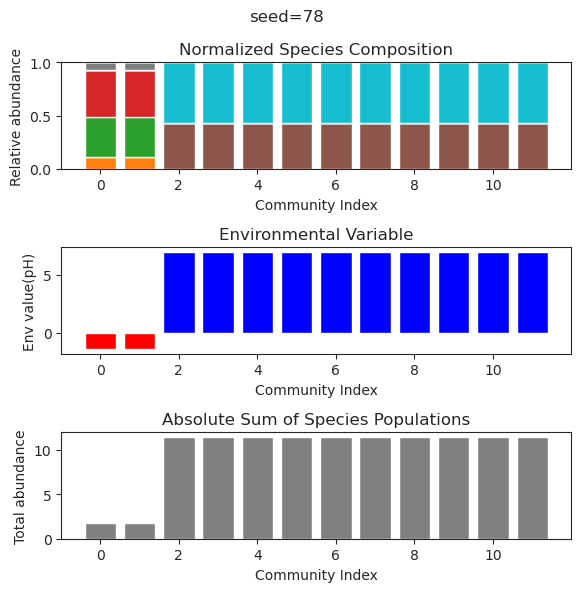

{'species': array([-1.37544366e-34,  2.41782295e-01, -9.88486892e-53,  6.34984580e-01,
       -2.17537228e-28,  1.27330215e-29,  1.56381723e-01,  2.28008734e-01,
        7.70505337e-40, -2.71763653e-30, -1.18566308e-42,  5.66015337e-01]), 'env': array([-1.56206125])}
{'species': array([-2.55376423e-36,  2.41782295e-01, -1.17089132e-56,  6.34984580e-01,
        1.47490417e-28,  3.60774017e-28,  1.56381723e-01,  2.28008734e-01,
       -1.69480785e-43,  9.60068611e-32, -2.18677702e-48,  5.66015337e-01]), 'env': array([-1.56206125])}
{'species': array([-4.07460327e-35,  2.41782295e-01,  2.00241290e-56,  6.34984580e-01,
       -9.26849997e-29,  8.17098872e-31,  1.56381723e-01,  2.28008734e-01,
        2.27464738e-44,  6.67090717e-34,  5.29860711e-49,  5.66015337e-01]), 'env': array([-1.56206125])}
{'species': array([-9.84420450e-34,  2.41782295e-01, -8.35871048e-50,  6.34984580e-01,
       -3.66173594e-27,  2.34135024e-30,  1.56381723e-01,  2.28008734e-01,
       -1.22435244e-40,  2.6981426

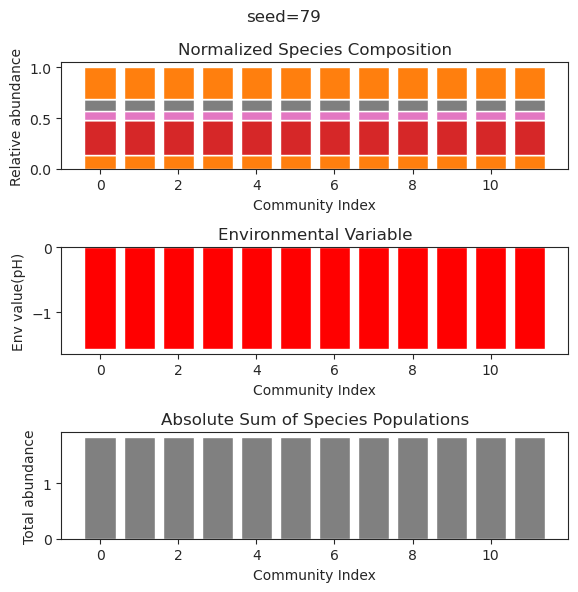

{'species': array([ 2.99685080e-01, -1.34434774e-33, -3.08765998e-35, -5.23703592e-49,
        2.77171412e-19,  2.33158665e-40,  3.01928058e-01,  2.21565009e-26,
        6.20341597e-01,  5.96300235e-26, -8.77329204e-44,  2.89302153e-01]), 'env': array([-2.23661261])}
{'species': array([ 2.99685080e-01, -1.82980978e-32,  1.28976077e-41, -3.39189792e-53,
       -7.07630073e-20, -1.16410504e-38,  3.01928058e-01, -5.08125162e-26,
        6.20341597e-01,  8.28073302e-30,  3.60195136e-46,  2.89302153e-01]), 'env': array([-2.23661261])}
{'species': array([ 2.99685080e-01, -1.29989498e-34,  3.52218670e-43,  8.08073020e-63,
       -3.26006959e-19, -8.70032850e-45,  3.01928058e-01,  7.37561075e-25,
        6.20341597e-01, -1.54383592e-29,  3.13098806e-53,  2.89302153e-01]), 'env': array([-2.23661261])}
{'species': array([ 2.99685080e-01, -1.97138103e-36,  6.49170876e-46,  4.26321489e-66,
        6.12854982e-21,  1.31791110e-45,  3.01928058e-01, -7.07927205e-26,
        6.20341597e-01,  5.2698100

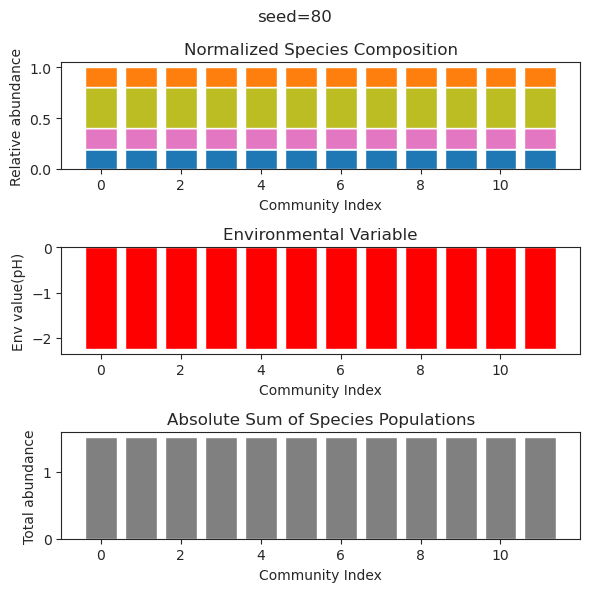

{'species': array([5.42490649e-002, 1.82622185e-063, 5.90776000e-090, 3.07921479e-092,
       2.20541251e-001, 6.69765962e-001, 1.20367293e-003, 4.02379873e-127,
       5.59638804e-006, 9.64276584e-028, 1.14958376e-001, 1.12677334e+000]), 'env': array([1.26421143])}
{'species': array([1.46785051e-001, 1.07607355e-061, 1.14522077e-089, 1.05690685e-089,
       1.49010790e-001, 6.28834689e-003, 1.59969134e-003, 4.85983372e-128,
       3.31487670e-001, 1.67035910e-025, 1.08132364e+000, 2.02786896e-002]), 'env': array([-1.68466702])}
{'species': array([-1.01683704e-62,  1.16779824e-70,  9.24580178e-01,  2.80892219e-02,
        9.62746083e-66,  1.29894928e+00,  5.29925295e-53,  2.65368857e+00,
       -1.31868846e-56,  6.66511117e-01, -2.71253070e-67, -5.08190597e-55]), 'env': array([3.71775164])}
{'species': array([-3.18537321e-42, -2.32409547e-45,  9.24580178e-01,  2.80892219e-02,
       -5.77290402e-62,  1.29894928e+00, -1.70087349e-42,  2.65368857e+00,
       -5.68533967e-57,  6.66511117e

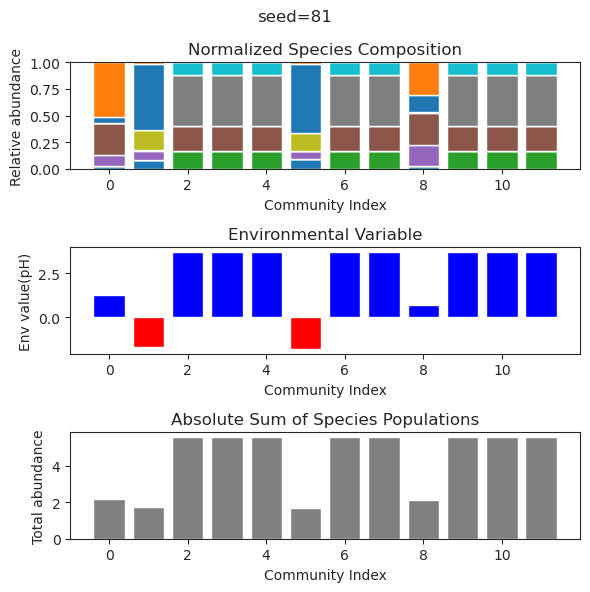

{'species': array([ 4.41758128e-27,  1.54246125e-01,  4.89807687e-01,  1.06880414e-02,
        1.37242256e-57,  7.61775605e-01,  1.55959799e-02,  3.99568889e-80,
       -1.17971294e-38,  1.10667262e-01,  3.10957583e-02,  4.83987012e-03]), 'env': array([-0.96400528])}
{'species': array([-3.38969240e-028,  1.53242644e-001,  4.91427105e-001,
        1.67955790e-002,  2.42586043e-074,  7.46229804e-001,
        1.60961399e-002,  9.39156531e-186,  1.66343950e-031,
        1.22677399e-001,  2.81753402e-002,  2.33259078e-003]), 'env': array([-0.95335834])}
{'species': array([-5.62785064e-028,  1.54261586e-001,  4.89797759e-001,
        1.06076021e-002,  9.05931003e-067,  7.61965190e-001,
        1.54937981e-002,  2.71559473e-122, -1.31761433e-031,
        1.10589443e-001,  3.11961240e-002,  4.72242428e-003]), 'env': array([-0.96419249])}
{'species': array([-3.61615927e-30,  1.54322726e-01,  4.89671748e-01,  1.02559921e-02,
       -1.00013711e-61,  7.63021583e-01,  1.57631092e-02,  2.91965174e-

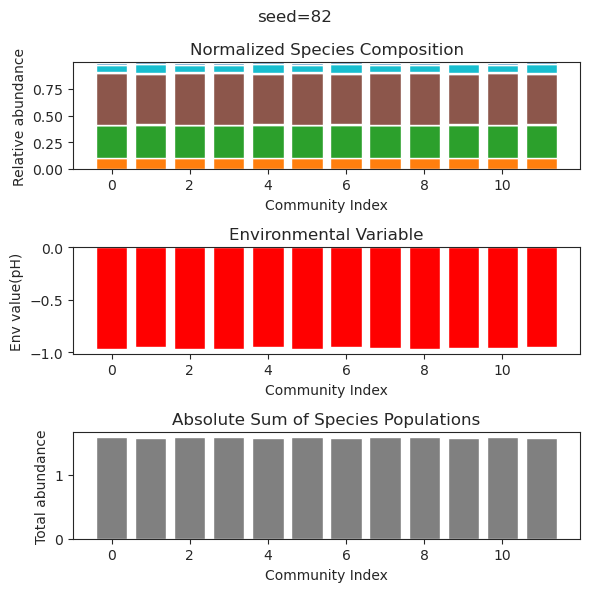

{'species': array([ 1.94432063e-65,  1.98466753e-01,  7.76387244e-01,  8.12678708e-01,
        2.04159902e-36,  2.59706190e-33,  1.60864293e-61,  5.14586840e-23,
       -1.35907525e-69,  3.08783621e-22, -8.15244237e-54, -6.35643629e-59]), 'env': array([-1.46673504])}
{'species': array([ 2.10212475e-61,  1.98466753e-01,  7.76387244e-01,  8.12678708e-01,
        4.05031956e-34, -4.64292712e-32, -1.64680733e-59, -2.00738876e-25,
        8.58535235e-65, -1.39283217e-24, -6.93804626e-57, -1.68534001e-60]), 'env': array([-1.46673504])}
{'species': array([7.26254522e-002, 3.92707256e-003, 5.66479155e-001, 5.39200696e-132,
       5.48551226e-208, 4.42358094e-005, 8.73426437e-002, 4.67337289e-001,
       1.52023614e-298, 3.54104448e-001, 0.00000000e+000, 2.10317976e-001]), 'env': array([-0.26745161])}
{'species': array([-1.89355974e-59,  1.98466753e-01,  7.76387244e-01,  8.12678708e-01,
        1.27726894e-32,  3.10214473e-30,  8.32920212e-56,  2.48293978e-23,
        8.58982271e-60,  2.1586938

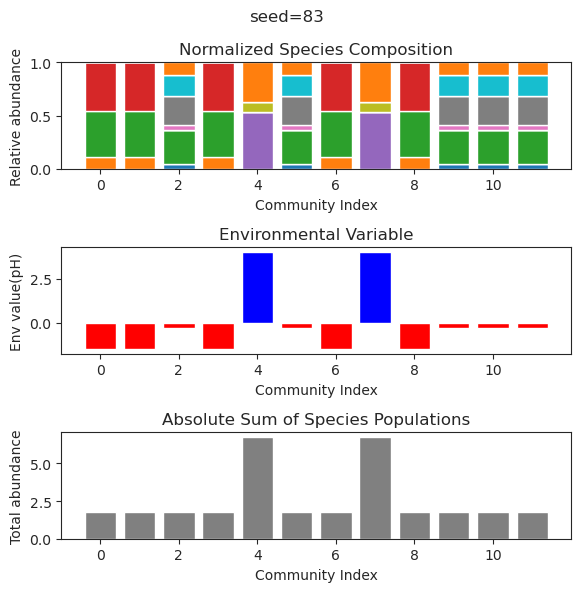

{'species': array([ 2.22294234e-01, -4.37890198e-43, -2.42955414e-49,  1.60210131e-68,
       -1.42239331e-57, -3.48801086e-56,  1.81205366e-01, -1.55835910e-21,
        4.60487053e-01,  1.35930699e-78,  5.29079559e-09,  3.68853353e-01]), 'env': array([-1.85443928])}
{'species': array([ 2.22294234e-01, -9.27520289e-38,  4.02034519e-41,  1.18833652e-57,
       -3.79725835e-49,  3.29336851e-48,  1.81205366e-01, -4.40584058e-21,
        4.60487053e-01, -2.78299399e-61,  6.01134720e-09,  3.68853353e-01]), 'env': array([-1.85443928])}
{'species': array([ 2.22294234e-01, -8.69235037e-45, -7.97384021e-55,  5.35166360e-69,
        1.41627830e-47, -2.64916735e-58,  1.81205366e-01,  8.34281464e-28,
        4.60487050e-01,  3.59513626e-78,  1.28511550e-08,  3.68853353e-01]), 'env': array([-1.85443927])}
{'species': array([ 2.22294234e-01,  4.00302887e-38, -9.12521785e-45,  1.73131256e-55,
       -2.91002079e-45, -5.07954875e-48,  1.81205366e-01, -6.61937356e-16,
        4.60487053e-01, -1.0761082

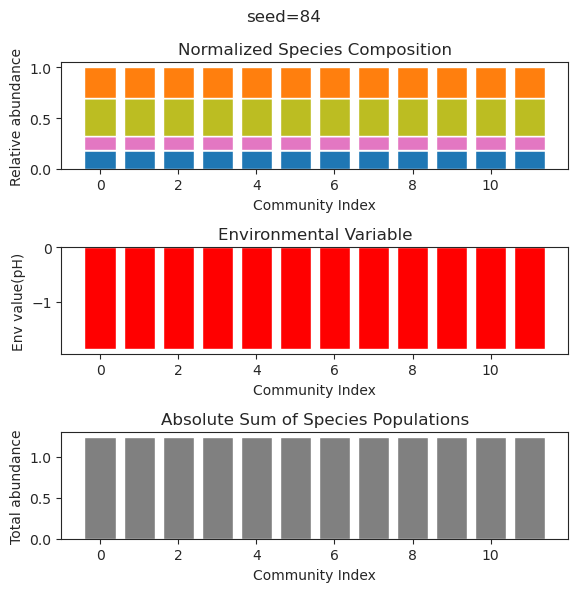

{'species': array([ 3.91155747e-08,  2.28258496e-01,  5.35453233e-01, -3.05801115e-30,
        4.44292942e-40, -3.41211629e-22,  1.81809639e-01,  3.38275377e-43,
        3.09721377e-01,  1.66507234e-61, -6.77959608e-47,  4.56679579e-01]), 'env': array([-1.65676946])}
{'species': array([ 1.49677557e-08,  2.28258512e-01,  5.35453227e-01,  3.76330300e-20,
        1.93456700e-35,  2.83299789e-17,  1.81809628e-01,  3.47049646e-39,
        3.09721406e-01,  2.75338635e-32, -1.31492968e-35,  4.56679595e-01]), 'env': array([-1.65676938])}
{'species': array([ 3.26806481e-08,  2.28258500e-01,  5.35453231e-01,  2.21069362e-15,
       -2.56355402e-37, -2.90239973e-15,  1.81809636e-01, -5.93662407e-41,
        3.09721385e-01,  1.94363063e-51,  1.02730112e-40,  4.56679584e-01]), 'env': array([-1.65676944])}
{'species': array([ 2.22049277e-08,  2.28258507e-01,  5.35453229e-01,  4.69266427e-19,
       -8.08875850e-36,  1.95626906e-19,  1.81809631e-01, -2.83897729e-41,
        3.09721397e-01, -4.1164384

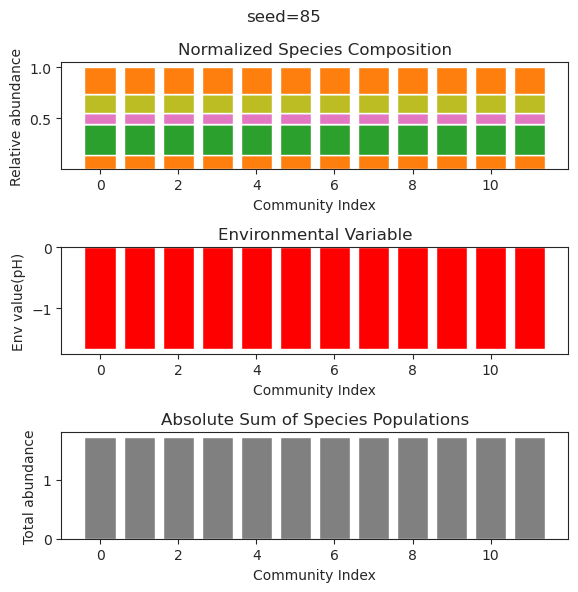

{'species': array([ 2.32487188e-01, -1.38060721e-31,  1.91919401e-01,  6.17616568e-32,
       -1.45136411e-39, -4.05365487e-45,  5.70420216e-57,  2.71370510e-74,
        5.00311009e-75,  6.92333258e-01,  1.13580757e-20,  7.83664183e-50]), 'env': array([-2.00611793])}
{'species': array([ 2.32487188e-01, -3.09257226e-31,  1.91919401e-01, -4.09699509e-31,
        3.66461964e-42,  8.82489723e-47,  1.75284010e-60, -2.70268546e-81,
        1.13482491e-78,  6.92333258e-01, -1.26770571e-20,  2.33110274e-48]), 'env': array([-2.00611793])}
{'species': array([ 2.32487188e-01, -1.18182708e-33,  1.91919401e-01, -7.11761462e-28,
       -1.98468914e-42, -3.60147132e-50, -4.43539008e-56,  1.25450051e-74,
       -1.18750451e-70,  6.92333258e-01,  2.02940664e-22,  4.52660142e-40]), 'env': array([-2.00611793])}
{'species': array([ 2.32487188e-01, -4.43472034e-33,  1.91919401e-01,  3.49724975e-32,
        1.68450439e-41,  8.40812090e-47, -1.83137538e-53,  3.06524962e-76,
        3.82663150e-75,  6.9233325

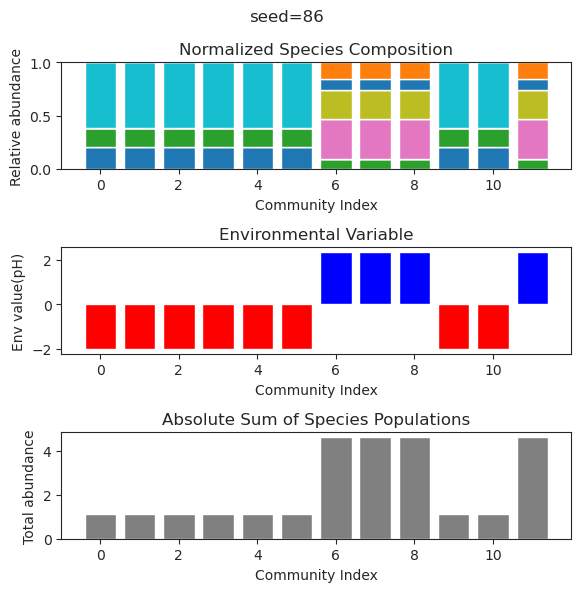

{'species': array([ 1.47227533e-02,  1.14621697e-01,  1.63181590e-89,  6.41465733e-01,
       -1.60939189e-90,  4.48713977e-01,  2.33778546e-02,  8.71704353e-02,
        2.01310788e-01, -1.08430357e-38,  1.44592988e-79, -1.64935555e-64]), 'env': array([-0.80729879])}
{'species': array([ 1.47227411e-02,  1.14621709e-01,  4.99851826e-36,  6.41465743e-01,
        1.93534590e-78,  4.48713980e-01,  2.33778384e-02,  8.71704451e-02,
        2.01310780e-01, -1.27254942e-37, -3.13627127e-70,  1.16387562e-60]), 'env': array([-0.8072988])}
{'species': array([ 1.47080719e-02,  1.14636032e-01,  8.87971165e-32,  6.41477899e-01,
        1.13582435e-31,  4.48717478e-01,  2.33583642e-02,  8.71822108e-02,
        2.01300579e-01,  1.27196172e-51, -3.63264961e-80, -7.33659881e-72]), 'env': array([-0.80730666])}
{'species': array([ 1.47227521e-02,  1.14621698e-01,  6.87588428e-95,  6.41465734e-01,
        2.11245081e-93,  4.48713977e-01,  2.33778529e-02,  8.71704363e-02,
        2.01310788e-01,  1.20716397

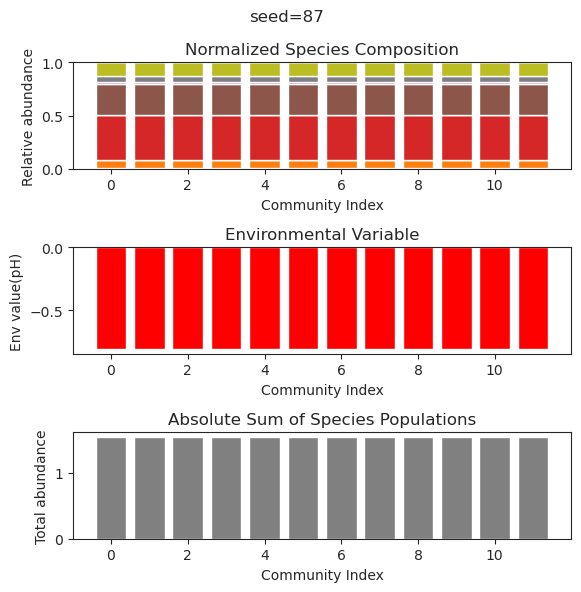

{'species': array([-4.25936744e-63,  8.24906829e-46, -9.20347199e-78,  6.35667479e-01,
        1.24933748e+00,  1.27752650e+00,  1.17151216e-54,  6.77402097e-45,
        3.37344512e-01,  3.50902662e-64,  2.01248078e-48, -1.12623592e-33]), 'env': array([0.71784227])}
{'species': array([-4.25936744e-63,  8.24906829e-46, -9.20347199e-78,  6.35667479e-01,
        1.24933748e+00,  1.27752650e+00,  1.17151216e-54,  6.77402097e-45,
        3.37344512e-01,  3.50902662e-64,  2.01248078e-48, -1.12623592e-33]), 'env': array([0.71784227])}
{'species': array([-2.02076347e-165, -8.35003654e-073,  2.34344572e-118,
        3.90169469e-001,  8.97712110e-001,  1.11015609e+000,
        1.72186240e-001,  3.64531887e-001,  1.95189408e-001,
       -4.27537260e-160, -1.02476121e-127,  4.36392963e-051]), 'env': array([0.59845328])}
{'species': array([-1.97194209e-87,  1.48791240e-41,  4.68588474e-72,  3.90169469e-01,
        8.97712110e-01,  1.11015609e+00,  1.72186240e-01,  3.64531887e-01,
        1.95189408

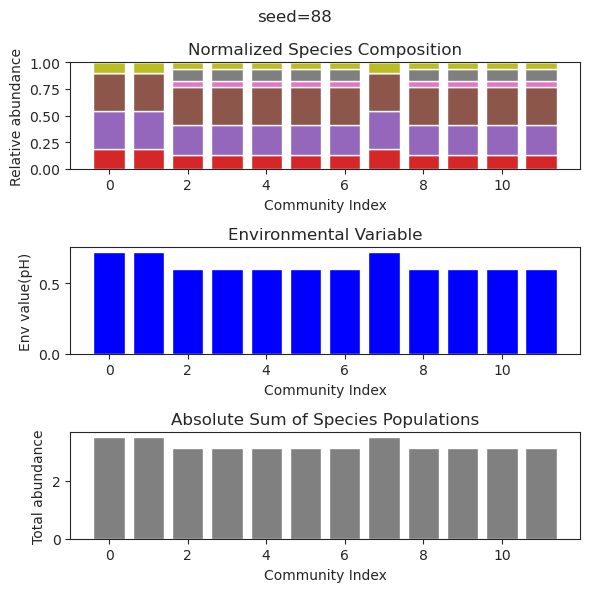

{'species': array([ 1.43445336e-01,  1.94395665e-13,  2.89765013e-01,  3.70880334e-96,
       -2.85890442e-48,  9.81561464e-64,  7.18910433e-01,  4.12768509e-01,
        1.74925856e-52, -1.45626689e-85,  3.78788243e-01, -6.20881235e-83]), 'env': array([-0.63876252])}
{'species': array([ 1.43445336e-001,  5.41008212e-012,  2.89765013e-001,
       -1.87044714e-120,  2.53328055e-053, -3.22942878e-071,
        7.18910433e-001,  4.12768509e-001,  2.70870821e-060,
        7.46786781e-093,  3.78788243e-001,  5.92213111e-101]), 'env': array([-0.63876252])}
{'species': array([ 1.43445336e-001,  1.57782297e-011,  2.89765013e-001,
       -2.59002112e-106, -7.88111915e-055, -3.86835386e-070,
        7.18910433e-001,  4.12768509e-001,  2.96777977e-047,
       -1.59912900e-085,  3.78788243e-001, -3.99308731e-092]), 'env': array([-0.63876252])}
{'species': array([ 1.43445336e-01, -7.01249187e-15,  2.89765013e-01,  4.29583555e-92,
        4.27458259e-46, -9.84176177e-60,  7.18910433e-01,  4.12768509e-

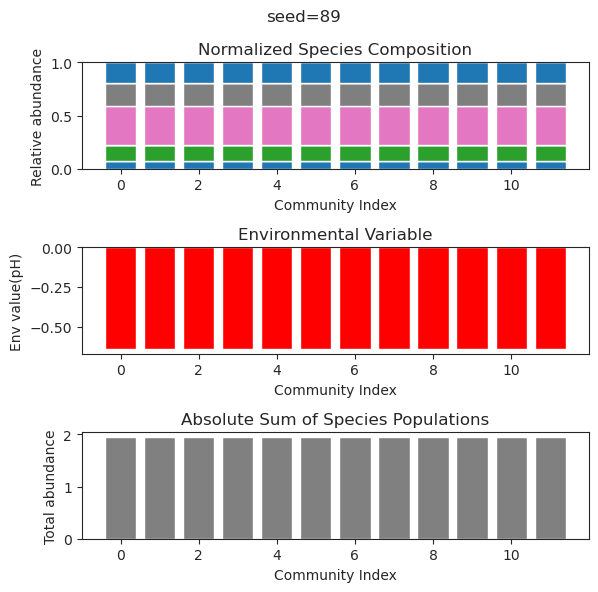

{'species': array([ 1.20237958e-01,  7.95641238e-30, -9.40002255e-34, -1.90574565e-37,
       -1.60710110e-23,  5.38545960e-40, -8.57556660e-40,  8.02038778e-01,
        8.39767469e-01,  1.04966534e-06,  2.22605863e-56,  1.28660326e-43]), 'env': array([-0.75825038])}
{'species': array([ 1.20237959e-01, -3.25753873e-35,  1.28971319e-33, -2.01097928e-39,
       -3.68156216e-41, -4.56382677e-42,  1.65657612e-37,  8.02038187e-01,
        8.39767349e-01,  1.75370901e-06, -3.71010008e-73,  2.97881395e-48]), 'env': array([-0.7582502])}
{'species': array([2.68064561e-065, 3.13813714e-001, 6.42783094e-124, 8.31601272e-003,
       4.44304767e-296, 2.78295315e-001, 1.76440299e-278, 3.11660977e-181,
       3.04393533e-067, 3.95893282e-001, 5.68468321e-001, 2.20702073e-001]), 'env': array([-0.1288903])}
{'species': array([ 2.82032277e-065,  4.26943555e-002,  4.07829782e-117,
        4.54437223e-001,  6.70121500e-308,  1.27814202e-002,
       -8.66595924e-302,  1.73661811e-177,  1.73356162e-063,
   

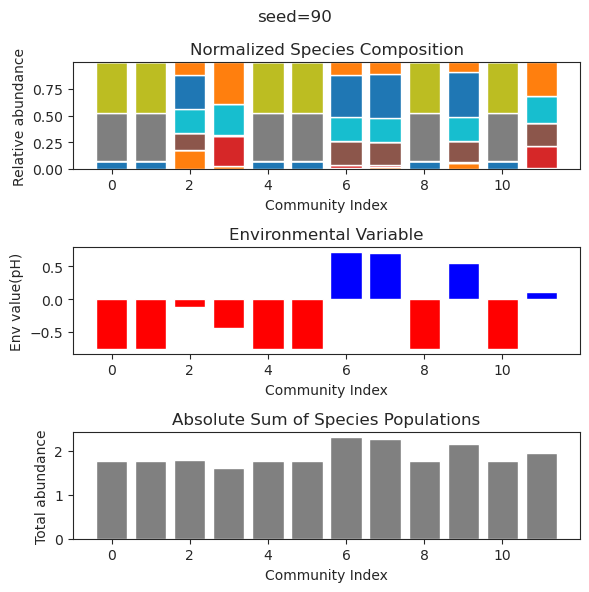

{'species': array([ 2.16655653e-01, -3.03299629e-21, -3.90290564e-35,  4.69260871e-01,
        2.48677395e-48,  5.54885970e-53,  1.22339070e-01, -7.23395331e-38,
       -6.32584535e-39,  6.28287996e-01,  2.83488368e-47,  1.62940163e-33]), 'env': array([-1.32774088])}
{'species': array([ 2.16655653e-01,  2.18890137e-20,  5.48579093e-35,  4.69260871e-01,
        5.85305043e-50,  7.47774286e-56,  1.22339070e-01, -1.20789546e-39,
       -2.42057543e-38,  6.28287996e-01,  1.15730204e-49, -6.37612562e-32]), 'env': array([-1.32774088])}
{'species': array([ 2.16655653e-01, -3.93378172e-20, -1.53826822e-33,  4.69260871e-01,
       -3.69531107e-47,  9.11348873e-54,  1.22339070e-01,  1.13906780e-38,
       -7.59297529e-37,  6.28287996e-01,  1.85419461e-48,  1.63088991e-32]), 'env': array([-1.32774088])}
{'species': array([ 2.16655653e-01, -4.81519869e-20,  1.01763771e-29,  4.69260871e-01,
        1.48490288e-44, -1.20411151e-50,  1.22339070e-01,  2.13654026e-33,
       -1.31695025e-30,  6.2828799

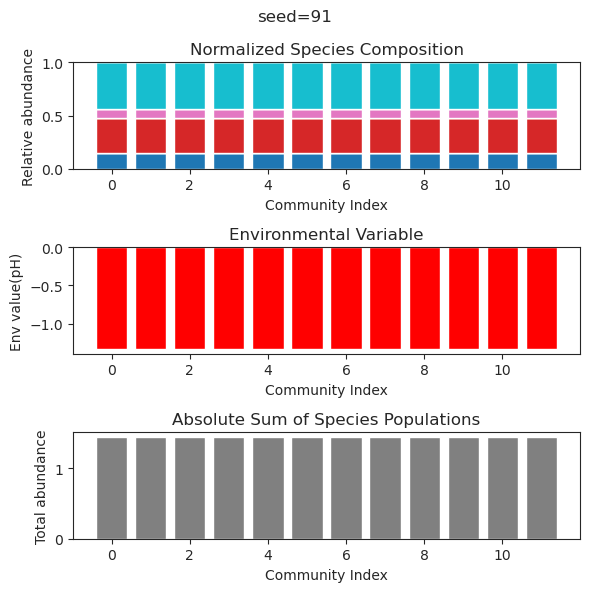

{'species': array([ 1.65574050e-01,  5.10121351e-34,  2.79638660e-55,  1.07561026e-60,
       -4.79022512e-27, -1.09663103e-33, -1.73159944e-60, -5.95411300e-18,
        1.11874149e+00,  1.28486090e-62,  1.83127727e-42, -8.78670906e-62]), 'env': array([-1.70377709])}
{'species': array([ 1.65574050e-01,  7.13959227e-43,  3.60596885e-75, -2.42817675e-73,
       -5.29534106e-27, -1.64632440e-37, -2.44437621e-70, -8.86607244e-19,
        1.11874149e+00, -1.01555982e-80,  6.62441221e-55, -4.81275575e-78]), 'env': array([-1.70377709])}
{'species': array([ 1.65574050e-01, -8.82707903e-42, -9.12153295e-71, -1.26965062e-63,
        1.83799315e-25, -7.76551511e-36, -9.08716077e-59, -8.99680399e-18,
        1.11874149e+00, -2.08656000e-66, -7.21278132e-52,  4.35010034e-66]), 'env': array([-1.70377709])}
{'species': array([ 1.65574050e-01,  8.66697780e-33,  5.14465219e-49,  4.06386256e-54,
       -3.98071959e-26,  9.89230239e-35,  2.42640419e-51, -8.92409047e-19,
        1.11874149e+00,  1.0215873

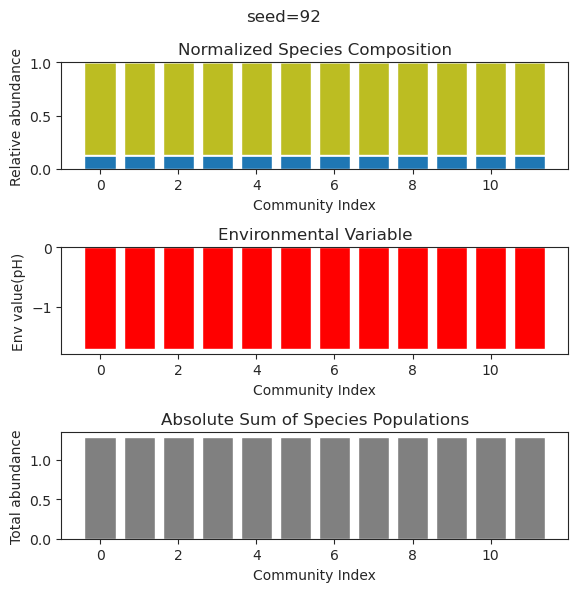

{'species': array([-2.88151043e-43,  3.75517669e-57, -2.15653421e-87,  1.18554075e-46,
        4.75207673e-67,  1.49012672e+00, -3.78992061e-17,  7.13665743e-88,
        2.36551071e+00,  1.28594482e+00, -1.15511779e-81,  6.02437439e-78]), 'env': array([2.73999692])}
{'species': array([ 1.46307112e-001,  3.94815494e-025,  2.37258553e-001,
        1.69149284e-001,  2.25798851e-001,  4.39178126e-137,
        1.05801885e-063,  1.85439741e-001,  2.84107027e-213,
       -4.94065646e-324,  4.91152683e-001,  1.82858230e-001]), 'env': array([-0.82977596])}
{'species': array([ 1.46307113e-001,  2.32233321e-024,  2.37258553e-001,
        1.69149284e-001,  2.25798851e-001, -9.23269450e-140,
        1.42323649e-059,  1.85439741e-001, -2.09021041e-211,
        4.94065646e-324,  4.91152683e-001,  1.82858230e-001]), 'env': array([-0.82977596])}
{'species': array([ 1.09699521e-81, -6.30216184e-57,  1.48337919e-76,  1.47198059e-56,
       -5.62645588e-63,  1.49012672e+00,  2.94687025e-21,  2.39583234e-7

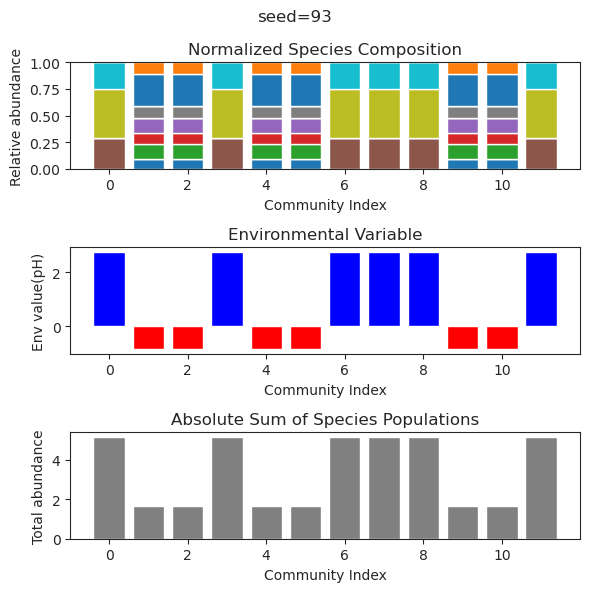

{'species': array([ 2.49671157e-031,  3.12730398e-001,  5.11702573e-001,
       -2.80068787e-032,  1.73624455e-074,  8.61918754e-041,
        7.21205170e-002,  1.75657475e-006,  3.94321790e-038,
        6.11871345e-024,  7.50548044e-001,  5.20661816e-120]), 'env': array([-2.42379038])}
{'species': array([-3.59031806e-42,  3.12731490e-01,  5.11697190e-01,  1.01402021e-50,
        3.67403434e-32, -8.45343568e-31,  7.21260907e-02,  3.45415871e-12,
        1.74387187e-29, -3.53636362e-16,  7.50550920e-01,  5.83148324e-48]), 'env': array([-2.42379619])}
{'species': array([ 1.41319223e-49,  2.92286457e-01,  5.75170367e-01,  1.37291706e-49,
        4.43563808e-40, -1.96830947e-62, -2.74288292e-14,  6.30336631e-02,
       -1.34850020e-40, -6.86986344e-23,  7.09902688e-01, -4.04083915e-63]), 'env': array([-2.28720231])}
{'species': array([-3.01095210e-32, -1.42117913e-21,  6.49814328e-01,  3.27502187e-01,
       -3.82826581e-38, -4.71338070e-17,  2.27876437e-65,  3.79145853e-01,
        4.28542

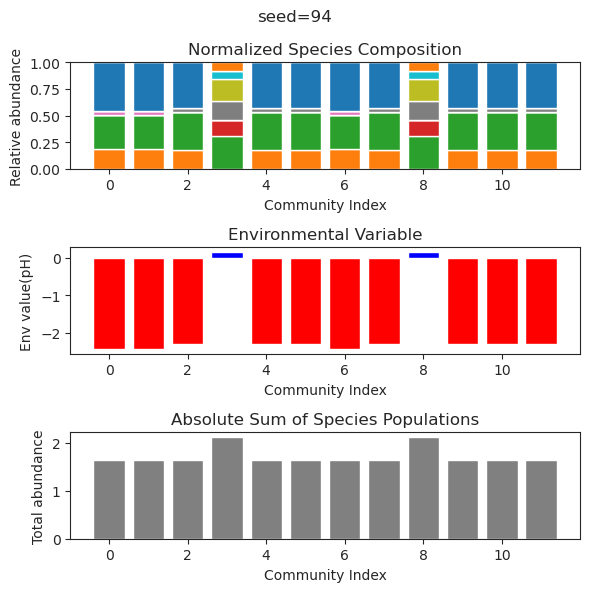

{'species': array([ 5.22326210e-34,  3.65173942e-01,  8.08292263e-32,  5.06558677e-40,
        2.85981726e-38,  1.16955550e-39,  2.74785063e-43,  9.15092389e-20,
       -4.27771840e-28,  1.09200265e-25,  4.99276595e-28,  1.00497743e+00]), 'env': array([-2.92173375])}
{'species': array([-7.71374064e-42,  3.65173942e-01,  1.63557447e-36,  4.46183049e-46,
        1.96067016e-46,  2.54155291e-46,  1.77248922e-49, -7.86329550e-21,
       -9.76518359e-31, -1.36255740e-28, -3.96387855e-32,  1.00497743e+00]), 'env': array([-2.92173375])}
{'species': array([ 7.05404272e-40,  3.65173942e-01, -2.79279597e-36,  1.49501306e-41,
        1.47877316e-42, -1.94593809e-44, -7.95876596e-45, -3.96646596e-22,
       -1.52569766e-31, -1.05127996e-28, -7.06312294e-30,  1.00497743e+00]), 'env': array([-2.92173375])}
{'species': array([ 9.68417803e-41,  3.65173942e-01,  5.77557599e-34,  5.10101045e-41,
        1.47692652e-40, -6.41229479e-42, -5.63066883e-43,  3.46500781e-21,
        1.86140017e-30,  1.1132482

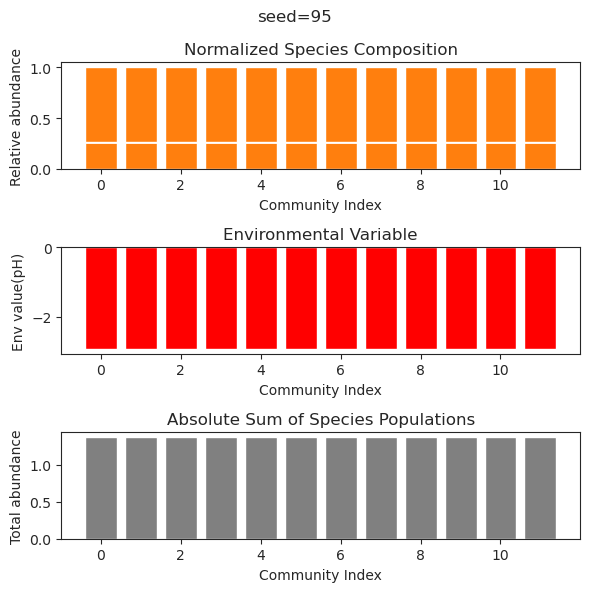

{'species': array([ 3.06206029e-01,  4.48969995e-18,  1.62680380e-38, -1.02539615e-46,
       -9.24094523e-53, -2.90948421e-51,  6.08377125e-29, -1.27438530e-40,
        2.19202924e-55,  7.90575606e-39,  5.81659185e-25,  5.65680693e-01]), 'env': array([-2.6464187])}
{'species': array([ 3.06206029e-01, -1.97489887e-20, -9.63813634e-56,  3.70452296e-77,
       -2.87723008e-84,  1.74754730e-80,  1.27352615e-40,  2.67424801e-58,
       -3.68086367e-92,  1.31438524e-53, -2.39689214e-29,  5.65680693e-01]), 'env': array([-2.6464187])}
{'species': array([ 3.06206029e-01,  1.13507811e-18,  7.54180536e-39,  4.23415796e-52,
       -1.89895931e-59,  7.32306707e-58, -1.05138575e-29,  9.82999184e-45,
        1.14686909e-59,  3.97230744e-40, -2.48331801e-28,  5.65680693e-01]), 'env': array([-2.6464187])}
{'species': array([ 3.06206029e-01, -2.23779237e-19,  5.75946988e-56,  4.10838674e-74,
        4.14952933e-75,  5.38387367e-72, -6.78950957e-38, -3.77517588e-57,
       -5.44970669e-83,  7.86456132e-

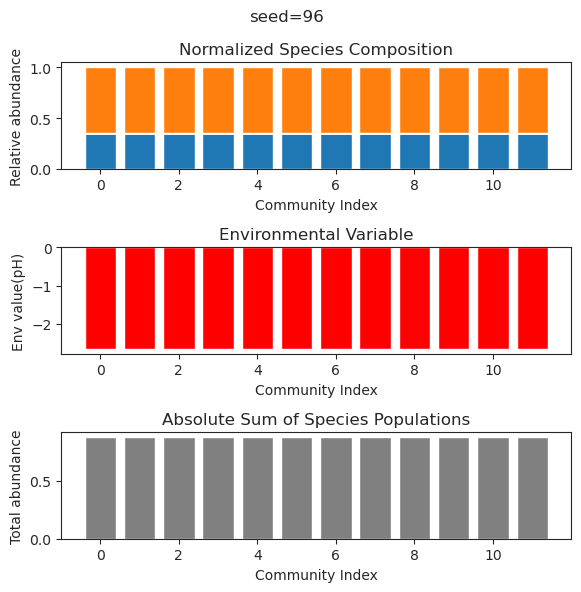

{'species': array([ 2.83758091e-43,  2.95137958e-01,  3.76034645e-59,  6.96242257e-01,
        2.27640624e-01,  2.21587543e-14,  6.53060285e-25, -3.48480743e-50,
        1.29288666e-54,  1.83673079e-59, -3.68898956e-20, -2.01676622e-50]), 'env': array([-2.66309159])}
{'species': array([-5.01984578e-47,  2.95137958e-01, -4.77873976e-73,  6.96242257e-01,
        2.27640624e-01, -8.33359172e-14,  2.24449599e-23, -3.51133821e-53,
        3.98543538e-58, -5.70405134e-74, -6.43100594e-19,  6.62178589e-59]), 'env': array([-2.66309159])}
{'species': array([-7.35049345e-47,  2.95137958e-01,  5.06283921e-58,  6.96242257e-01,
        2.27640624e-01,  2.99756971e-14,  2.51179444e-22,  4.09591841e-46,
        1.67940037e-51, -7.86444916e-61,  1.99711116e-19,  4.03848846e-48]), 'env': array([-2.66309159])}
{'species': array([ 1.90473032e-48,  2.95137958e-01,  1.21647371e-75,  6.96242257e-01,
        2.27640624e-01,  2.66267816e-14, -2.38994991e-24,  4.09064556e-56,
       -9.38585902e-64,  1.0805564

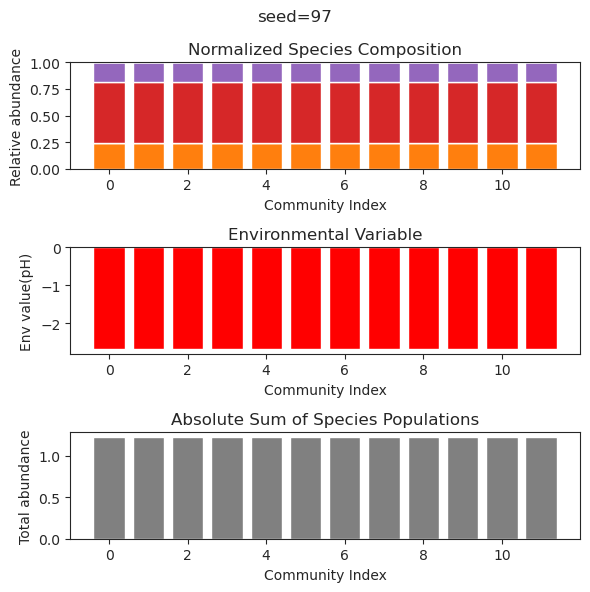

{'species': array([ 1.74438963e-001, -9.88131292e-324,  9.88131292e-324,
        1.58161700e-001,  5.40978511e-001,  5.15933485e-001,
        9.88131292e-324,  8.57578567e-222,  3.43193670e-001,
        3.38285268e-168,  7.60861095e-322,  1.49416971e-001]), 'env': array([0.04680571])}
{'species': array([ 1.49653958e-002, -9.88131292e-324, -1.48219694e-323,
        8.60828325e-001,  1.52885608e-002,  5.45866693e-002,
        2.02566915e-322,  1.07353533e-220,  5.13300321e-001,
        4.48654152e-168,  1.20057952e-321,  4.12905898e-001]), 'env': array([-0.06143089])}
{'species': array([ 1.41980341e-002,  7.90505033e-323, -1.67982320e-322,
        8.33609811e-001,  1.91308776e-002,  7.83080930e-002,
        2.86558075e-322,  1.06811835e-222,  5.36002551e-001,
        1.21487264e-167,  2.47032823e-323,  3.94526214e-001]), 'env': array([0.05454416])}
{'species': array([ 3.02027012e-001, -9.88131292e-324,  4.94065646e-324,
        1.93600951e-001,  3.64148737e-001,  2.68634553e-001,
       

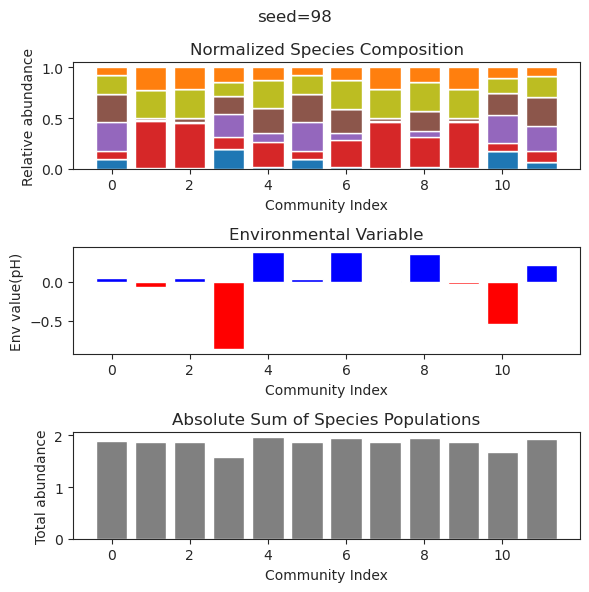

{'species': array([ 1.19675197e-001, -9.88131292e-324,  9.88131292e-324,
        2.10818191e-001,  4.85495835e-001,  5.58120752e-001,
       -6.91691904e-323,  2.37752812e-217,  4.05547644e-001,
        2.29479305e-168, -1.53654416e-321,  1.58297556e-001]), 'env': array([0.21728699])}
{'species': array([ 1.19675197e-001, -9.88131292e-324,  9.88131292e-324,
        2.10818191e-001,  4.85495835e-001,  5.58120752e-001,
       -6.91691904e-323,  2.37752812e-217,  4.05547644e-001,
        2.29479305e-168, -1.53654416e-321,  1.58297556e-001]), 'env': array([0.21728699])}
{'species': array([-1.25433292e-89, -8.32443699e-33,  1.07772932e+00, -5.46639327e-22,
       -8.37608218e-31,  9.56910470e-01, -1.39574892e-92,  7.44185743e-01,
       -2.50085257e-81,  1.43735074e-61, -5.77503677e-63,  1.58403814e+00]), 'env': array([1.85416692])}
{'species': array([-3.36523103e-035, -1.24540557e-039,  1.07772932e+000,
        5.77280484e-026,  1.54104710e-026,  9.56910470e-001,
       -1.53784134e-101,  7

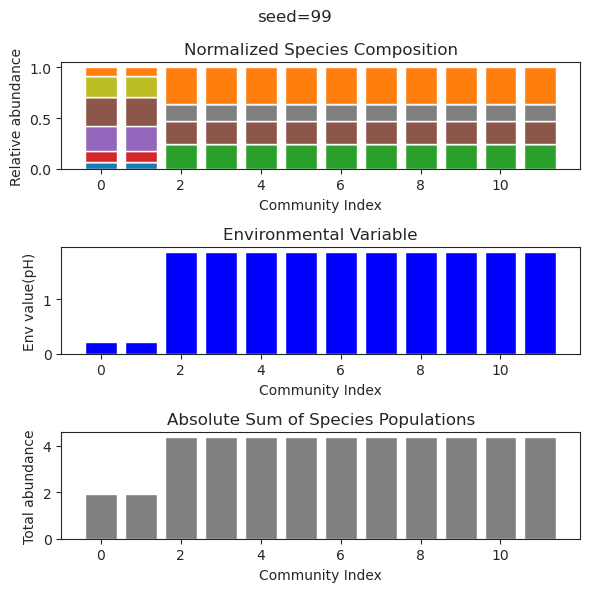

In [ ]:
    session_path='Results_ptailed/Session_Test4'
    to_save={}
    description=''
    simulated_result={}
    
    for seed_num in range(100):
        if not os.path.isdir(session_path):
            os.mkdir(session_path)
        # functions for uniform 

        f_I = lambda : uniform_distribution(0.5,0.5)
        f_g = lambda : np.ones(1)
        f_k = lambda : np.ones(1)
        f_p = lambda : custom_distribution(-2,1)
        f_q = lambda : uniform_distribution(0.5,0.5)
        f_beta = lambda : np.ones(1)
        seed_num=seed_num
        to_plot=True

        np.random.seed(seed_num)

        N=12
        N_env=1


        I = np.zeros((N, N))
        for i in range(N):
            for j in range(N):
                I[i,j] = f_I()
        for i in range(N):
            I[i,i] =1

        g = np.zeros((N))
        for i in range(N):
            g[i] = f_g()

        k = np.zeros((N))
        for i in range(N):
            k[i] = f_k()   

        p = np.zeros((N_env, N))
        for i in range(N_env):
            for j in range(N):
                p[i,j] = f_p()

        p[0,0]=-10
        p[0,1]=-10
        #p[0,2]=-10

        q = np.zeros((N, N_env))
        for i in range(N):
            for j in range(N_env):
                q[i,j] = f_q()

        q[0,0]=0.2
        q[1,0]=0.2
        #q[2,0]=0.2



        beta = np.zeros(N_env)
        for i in range(N_env):
            beta[i]=f_beta()

        delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
        migration_rate=0#1e-7
        system_config = {
            'I': I,
            'g': g,
            'k': k,
            'p': p,
            'q': q,
            'beta': beta,
            'delta': delta,
            'migration_rate' : migration_rate,
            'N': N,
            'N_env': N_env,
            'seed_num':seed_num,
        } 

        file_path = f'{session_path}/system_config.json'

        label="test"
        sys
        ##

        y_out_list=[]
        system_config['beta'] = np.array([0.99])*delta

        for i in range(N):

            species_index=np.arange(0,N)
            env_index=np.array([0])
            y0_species=one_hot_vector(N,i)
            y0_env=[0]
            t=np.linspace(0, 2000, 10000)

            y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False)

            y_out_list.append(y_out)

        num_datasets = len(y_out_list)

        # Prepare subplots
        fig, axs = plt.subplots(3, 1, figsize=(6, 6))

        # Data for plots
        species_matrix = np.array([y_out['species'] for y_out in y_out_list])
        env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

        # Normalize species data
        species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
        species_sums = np.sum(species_matrix, axis=1, keepdims=True)
        normalized_species = species_matrix / species_sums

        # Absolute sums of species data (sum across all species for each dataset)
        absolute_sums = np.sum(species_matrix, axis=1)
        simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

        if to_plot:
            plt.suptitle(f'seed={seed_num}')

            # Plotting species composition as stacked bars
            bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
            for i in range(normalized_species.shape[1]):  # Loop through each species
                axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
                bottom_values += normalized_species[:, i]  # Update bottom values for stacking

            axs[0].set_title('Normalized Species Composition')
            axs[0].set_xlabel('Community Index')
            axs[0].set_ylabel('Relative abundance')
            #axs[0].legend()

            # Plotting environmental factors
            colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
            axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
            axs[1].set_title('Environmental Variable')
            axs[1].set_xlabel('Community Index')
            axs[1].set_ylabel('Env value(pH)')

            # Plotting absolute sums of species data
            axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
            axs[2].set_title('Absolute Sum of Species Populations')
            axs[2].set_xlabel('Community Index')
            axs[2].set_ylabel('Total abundance')

            plt.tight_layout()
            plt.savefig(session_path+f'/diagram_{seed_num}.png')

            #if to_plot:
            #    plt.savefig()


            plt.show()
    #simulated_result = {'a': 1, 'b': 2, 'c': 3}  # Your existing dictionary
    #description = "This is a description of the simulated result."

    # Combine both into a new dictionary
    data_to_save = {
        'result': simulated_result,
        'description': description
    }
    # Serialize the combined data to a pickle file
    with open(session_path+'/result_and_description.pkl', 'wb') as file:
        pickle.dump(data_to_save, file)